In [ ]:
Rank-2397 Total Participation-7327

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec

In [2]:
data_train= pd.read_csv('train.csv')
data_test=pd.read_csv('test.csv')
#data_original=pd.read_csv('original.csv')

In [3]:
data_train.head()

,Id,AB,AF,AH,AM,AR,AX,AY,AZ,BC,...,FL,FR,FS,GB,GE,GF,GH,GI,GL,Class
0,000ff2bfdfe9,0.209377,3109.03329,85.200147,22.394407,8.138688,0.699861,0.025578,9.812214,5.555634,...,7.298162,1.73855,0.094822,11.339138,72.611063,2003.810319,22.136229,69.834944,0.120343,1
1,007255e47698,0.145282,978.76416,85.200147,36.968889,8.138688,3.632190,0.025578,13.517790,1.229900,...,0.173229,0.49706,0.568932,9.292698,72.611063,27981.562750,29.135430,32.131996,21.978000,0
2,013f2bd269f5,0.470030,2635.10654,85.200147,32.360553,8.138688,6.732840,0.025578,12.824570,1.229900,...,7.709560,0.97556,1.198821,37.077772,88.609437,13676.957810,28.022851,35.192676,0.196941,0
3,043ac50845d5,0.252107,3819.65177,120.201618,77.112203,8.138688,3.685344,0.025578,11.053708,1.229900,...,6.122162,0.49706,0.284466,18.529584,82.416803,2094.262452,39.948656,90.493248,0.155829,0
4,044fb8a146ec,0.380297,3733.04844,85.200147,14.103738,8.138688,3.942255,0.054810,3.396778,102.151980,...,8.153058,48.50134,0.121914,16.408728,146.109943,8524.370502,45.381316,36.262628,0.096614,1


In [4]:
data_train['FD ']

0      10.265073
1       0.296850
2       8.745201
3       7.884336
4       4.274640
         ...    
612     0.296850
613     6.067614
614     0.296850
615     6.192291
616     0.296850
Name: FD , Length: 617, dtype: float64

In [5]:
data_test.head()

,Id,AB,AF,AH,AM,AR,AX,AY,AZ,BC,...,FI,FL,FR,FS,GB,GE,GF,GH,GI,GL
0,00eed32682bb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,010ebe33f668,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,02fa521e1838,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,040e15f562a2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,046e85c7cc7f,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [2]:
numerical_features_train[0:int(len(numerical_features_train)/2)+1]

In [ ]:
data_train[numerical_features_train[0:int(len(numerical_features_train)/4)+1]].describe()

In [ ]:
Good amount of outliers present in
AH,AR,AY,BC,BR

In [47]:
data_train[numerical_features_train[int(len(numerical_features_train)/4+1):
                        int(2*len(numerical_features_train)/4)+1]].describe()

,BZ,CB,CC,CD,CF,CH,CL,CR,CS,CU,CW,DA,DE,DF
count,617.000000,615.000000,614.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000,617.000000
mean,550.632525,77.104151,0.688801,90.251735,11.241064,0.030615,1.403761,0.742262,36.917590,1.383792,27.165653,51.128326,401.901299,0.633884
std,2076.371275,159.049302,0.263994,51.585130,13.571133,0.014808,1.922210,0.281195,17.266347,0.538717,14.645993,21.210888,317.745623,1.912384
min,257.432377,12.499760,0.176874,23.387600,0.510888,0.003184,1.050225,0.069225,13.784111,0.137925,7.030640,6.906400,35.998895,0.238680
25%,257.432377,23.317567,0.563688,64.724192,5.066306,0.023482,1.050225,0.589575,29.782467,1.070298,7.030640,37.942520,188.815690,0.238680
50%,257.432377,42.554330,0.658715,79.819104,9.123000,0.027860,1.050225,0.730800,34.835130,1.351665,36.019104,49.180940,307.509595,0.238680
75%,257.432377,77.310097,0.772206,99.813520,13.565901,0.034427,1.228445,0.859350,40.529401,1.660617,37.935832,61.408760,507.896200,0.238680
max,50092.459300,2271.436167,4.103032,633.534408,200.967526,0.224074,31.688153,3.039675,267.942823,4.951507,64.521624,210.330920,2103.405190,37.895013


In [ ]:
Good amount of outliers present in
BZ,CL,DF

In [41]:
data_train[numerical_features_train[int(2*len(numerical_features_train)/4)+1:
                        int(3*len(numerical_features_train)/4)+1]].describe()

,DH,DI,DL,DN,DU,DY,EB,EE,EG,EH,EL,EP,EU
count,617.000000,617.000000,617.000000,617.000000,616.000000,617.000000,617.000000,617.000000,617.000000,617.000000,557.000000,617.000000,617.000000
mean,0.367002,146.972099,94.795377,26.370568,1.802900,26.388989,9.072700,3.064778,1731.248215,0.305107,69.582596,105.060712,69.117005
std,0.112989,86.084419,28.243187,8.038825,9.034721,18.116679,6.200281,2.058344,1790.227476,1.847499,38.555707,68.445620,390.187057
min,0.040995,60.232470,10.345600,6.339496,0.005518,0.804068,4.926396,0.286201,185.594100,0.003042,5.394675,78.526968,3.828384
25%,0.295164,102.703553,78.232240,20.888264,0.005518,14.715792,5.965392,1.648679,1111.160625,0.003042,30.927468,78.526968,4.324656
50%,0.358023,130.050630,96.264960,25.248800,0.251741,21.642456,8.149404,2.616119,1493.817413,0.085176,71.949306,78.526968,22.641144
75%,0.426348,165.836955,110.640680,30.544224,1.058690,34.058344,10.503048,3.910070,1905.701475,0.237276,109.125159,112.766654,49.085352
max,1.060404,1049.168078,326.236200,62.808096,161.355315,152.355164,94.958580,18.324926,30243.758780,42.569748,109.125159,1063.594578,6501.264480


In [ ]:
Good amount of outliers present in
DU,EH,EU

In [34]:
data_train[numerical_features_train[3*int(len(numerical_features_train)/4)+2:]].describe()

,FC,FD,FE,FI,FL,FR,FS,GB,GE,GF,GH,GI,GL
count,616.000000,617.000000,617.000000,617.000000,616.000000,617.000000,615.000000,617.000000,617.000000,617.000000,617.000000,617.000000,616.000000
mean,71.341526,6.930086,10306.810737,10.111079,5.433199,3.533905,0.421501,20.724856,131.714987,14679.595398,31.489716,50.584437,8.530961
std,165.551545,64.754262,11331.294051,2.934025,11.496257,50.181948,1.305365,9.991907,144.181524,19352.959387,9.864239,36.266251,10.327010
min,7.534128,0.296850,1563.136688,3.583450,0.173229,0.497060,0.067730,4.102182,72.611063,13.038894,9.432735,0.897628,0.001129
25%,25.815384,0.296850,5164.666260,8.523098,0.173229,0.497060,0.067730,14.036718,72.611063,2798.992584,25.034888,23.011684,0.124392
50%,36.394008,1.870155,7345.143424,9.945452,3.028141,1.131000,0.250601,18.771436,72.611063,7838.273610,30.608946,41.007968,0.337827
75%,56.714448,4.880214,10647.951650,11.516657,6.238814,1.512060,0.535067,25.608406,127.591671,19035.709240,36.863947,67.931664,21.978000
max,3030.655824,1578.654237,143224.682300,35.851039,137.932739,1244.227020,31.365763,135.781294,1497.351958,143790.071200,81.210825,191.194764,21.978000


In [ ]:
Good amount of outliers present in
FC,FD,FR,GE

In [130]:
suspicious=['AH','AR','AY','BC','BR','BZ','CL','DF','DU','EH','EU','FC','FD','FR','GE']

In [7]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 617 entries, 0 to 616
Data columns (total 58 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Id      617 non-null    object 
 1   AB      617 non-null    float64
 2   AF      617 non-null    float64
 3   AH      617 non-null    float64
 4   AM      617 non-null    float64
 5   AR      617 non-null    float64
 6   AX      617 non-null    float64
 7   AY      617 non-null    float64
 8   AZ      617 non-null    float64
 9   BC      617 non-null    float64
 10  BD      617 non-null    float64
 11  BN      617 non-null    float64
 12  BP      617 non-null    float64
 13  BQ      557 non-null    float64
 14  BR      617 non-null    float64
 15  BZ      617 non-null    float64
 16  CB      615 non-null    float64
 17  CC      614 non-null    float64
 18  CD      617 non-null    float64
 19  CF      617 non-null    float64
 20  CH      617 non-null    float64
 21  CL      617 non-null    float64
 22  CR

C:\Users\Shirshak\AppData\Local\Temp\ipykernel_20868\2905914177.py:8: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data=(data_train.corr(method='spearman')).round(2),cmap='rocket',annot=True,annot_kws={'size':16})


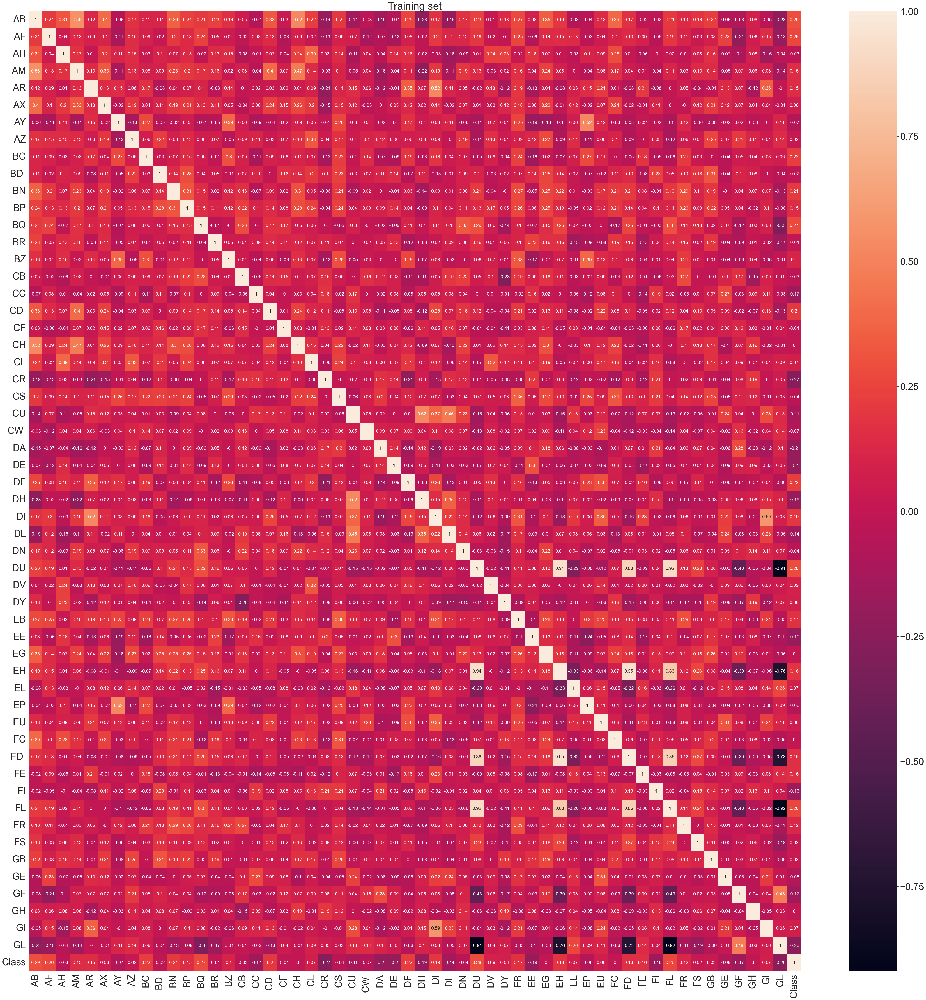

In [8]:
# 'Spearson relation'- When the relation between two variables is not linearly dependent or monotnic in nature i.e both
# variable move in same direction but not at constant rate.

# 'Pearson relation'- When the relation between two variables is linearly dependent i.e both variable move in same direction
#at constant rate.
plt.figure(figsize=(60,60))
sns.set_theme(font_scale=3)
sns.heatmap(data=(data_train.corr(method='spearman')).round(2),cmap='rocket',annot=True,annot_kws={'size':16})
plt.title('Training set')
plt.show()

In [9]:
#Similar correlation for both

In [10]:
for feature in data_train.columns:
    print(f'{feature}:{len(data_train[feature].unique())}')

Id:617
AB:217
AF:599
AH:227
AM:605
AR:130
AX:427
AY:148
AZ:484
BC:259
BD :617
BN:53
BP:612
BQ:516
BR:566
BZ:115
CB:554
CC:603
CD :584
CF:586
CH:135
CL:123
CR:595
CS:576
CU:307
CW :426
DA:611
DE:616
DF:137
DH:191
DI:571
DL:604
DN:576
DU:254
DV:39
DY:590
EB:439
EE:513
EG:610
EH:127
EJ:2
EL:312
EP:275
EU:455
FC:601
FD :337
FE:615
FI:498
FL:389
FR:435
FS:162
GB:560
GE:264
GF:611
GH:596
GI:615
GL:356
Class:2


In [6]:
data_train.rename(columns={'FD ':'FD','CW ':'CW','BD ':"BD",},inplace=True)
df_train=data_train.copy()
df_test=data_test.copy()
#df_original=data_original.copy()

In [7]:
df_train.columns

Index(['Id', 'AB', 'AF', 'AH', 'AM', 'AR', 'AX', 'AY', 'AZ', 'BC', 'BD', 'BN',
       'BP', 'BQ', 'BR', 'BZ', 'CB', 'CC', 'CD ', 'CF', 'CH', 'CL', 'CR', 'CS',
       'CU', 'CW', 'DA', 'DE', 'DF', 'DH', 'DI', 'DL', 'DN', 'DU', 'DV', 'DY',
       'EB', 'EE', 'EG', 'EH', 'EJ', 'EL', 'EP', 'EU', 'FC', 'FD', 'FE', 'FI',
       'FL', 'FR', 'FS', 'GB', 'GE', 'GF', 'GH', 'GI', 'GL', 'Class'],
      dtype='object')

In [8]:
numerical_features_train=[ feature for feature in df_train.columns 
if df_train[feature].dtype!='object'and len(df_train[feature].unique())>40]
len(numerical_features_train)

54

In [9]:
categorical_features_train=[ feature for feature in df_train.columns 
if df_train[feature].dtype=='object' or df_train[feature].dtype=='int64' and len(df_train[feature].unique())<=40]
len(categorical_features_train)

3

### Numerical

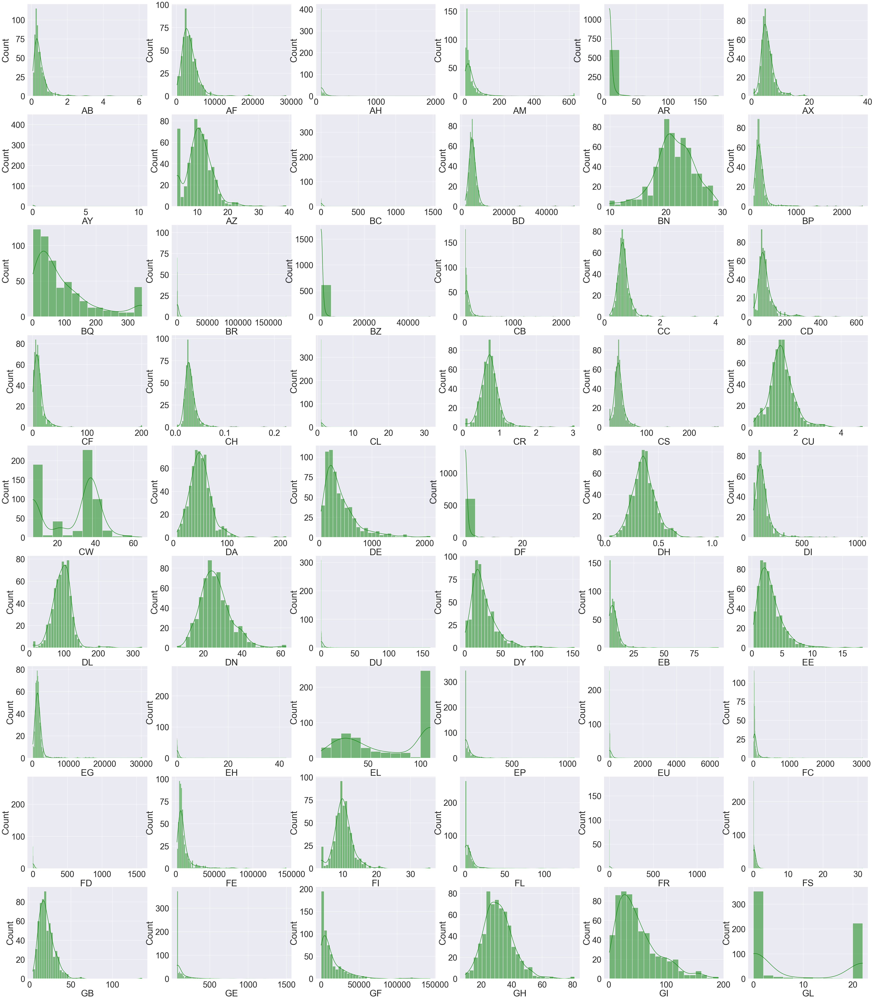

In [13]:
fig,ax=plt.subplots(9,6,figsize=(60,70))
features_train=numerical_features_train
i=0
j=0
for y in features_train:
    axes=ax[j,i]
    if y=='id':
        continue
    sns.histplot(df_train[y], kde=True, ax=axes, label='Train',color='green')
    i+=1
    if i%6==0:
        j+=1
        i=0       
plt.show()

In [133]:
suspicious=list(suspicious)
suspicious

['AH',
 'AR',
 'AY',
 'BC',
 'BR',
 'BZ',
 'CL',
 'DF',
 'DU',
 'EH',
 'EU',
 'FC',
 'FD',
 'FR',
 'GE']

In [134]:
suspicious.extend(['FS','CB','EP','FL','GL','EL','CW'])

In [169]:
percentiles=[0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99]
values=[]
distribution=[]
for feat in suspicious:
    for percent in percentiles:
        val=df_train[feat].quantile(percent)
        values.append(val)
    distribution.append(values)
    values=[]
        

In [170]:
distribution=pd.DataFrame(distribution,columns=percentiles)
distribution['Features']=suspicious

In [171]:
distribution

,0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99,Features
0,85.200147,85.200147,85.200147,85.200147,85.200147,113.739540,164.476432,209.993150,541.428776,AH
1,8.138688,8.138688,8.138688,8.138688,8.138688,8.138688,13.061755,17.119562,34.467239,AR
2,0.025578,0.025578,0.025578,0.025578,0.025578,0.036845,0.089279,0.123992,0.214405,AY
3,1.229900,1.229900,1.229900,1.229900,1.229900,5.081244,9.241820,11.996796,50.660495,BC
4,51.216883,51.216883,252.907480,424.990642,627.417402,975.649259,1575.588474,2096.116417,5138.893834,BR
5,257.432377,257.432377,257.432377,257.432377,257.432377,257.432377,1216.594239,1516.081741,2983.909004,BZ
6,1.050225,1.050225,1.050225,1.050225,1.050225,1.228445,1.568336,1.889132,5.685727,CL
7,0.238680,0.238680,0.238680,0.238680,0.238680,0.238680,1.231027,2.038327,5.744606,DF
8,0.005518,0.005518,0.005518,0.005518,0.251741,1.058690,3.965775,6.077981,17.693564,DU
9,0.003042,0.003042,0.003042,0.003042,0.085176,0.237276,0.511056,0.936936,1.868518,EH


In [103]:
#Seems for most columns majority of the outliers lie in the top 10-5% of the data
#However for majority of the columns the value remains constant for upto 25 percent of the data

In [107]:
fig,ax=plt.subplots(9,6,figsize=(120,120))
features_train=numerical_features_train
cdict={0:'black',1:'orange'}
j=0
i=0
for x in features_train:
    axes=ax[j,i]
    if x=='id':
        continue
    sns.boxplot(x=df_train['Class'],y=df_train[x],ax=axes)
    ax[j,i].set_xlabel('Class',fontsize=50)
    ax[j,i].set_ylabel(x,fontsize=50)
    ax[j,i].set_xticklabels([0,1],fontsize=20)
    i+=1
    if i%6==0:
        j+=1
        i=0
plt.title('Class')
plt.show()

In [ ]:
#Box plot analysis

#Parts of boxplot
lower end of whisker- min value of columns
upper end of whisker- max value of columns
the line in middle- median
Points above max value- outliers

#Explanation of regions
lower whisker to starting of box- 1st Quertile 25% data lies in the region
starting of box(lower quertile) to median- 2nd Quertile 25% more data lies in the region(i.e from lower quertile 
to median 50% of data lies)
median to end of box(upper quertile)- 3rd Quertile 25% more data lies in the region (i.e from lower quertile
to end of box 75% of data lies)
end of box to upper whisker- 4th Quertile 25% more data lies in the region (i.e from lower quertile to 
upper whisker,100% of data lies)

Inter Quertile Range- The Box represents our IQR i.e distance between 1st and 3rd quertile
Lower whisker- It represents 1st Quertile - 1.5xIQR
Upper whisker- It represents 3rd Quertile + 1.5xIQR

In [183]:
#Checking no of outlier coulumns
index=set()
for feat in suspicious:
    d=df_train.loc[df_train[feat]>df_train[feat].quantile(0.95)]
    index.update(tuple(d.index))
index=np.array(list(index))
print(f"Columns to drop:{index.shape[0]}")

Columns to drop:291


In [184]:
# WAY TOO MANY ):
#BUT LET'S DROP AND SEE ANYWAY (:

In [185]:
df_train.drop(index,inplace=True)
df_train.shape

(326, 58)

In [186]:
#Checking distribution again

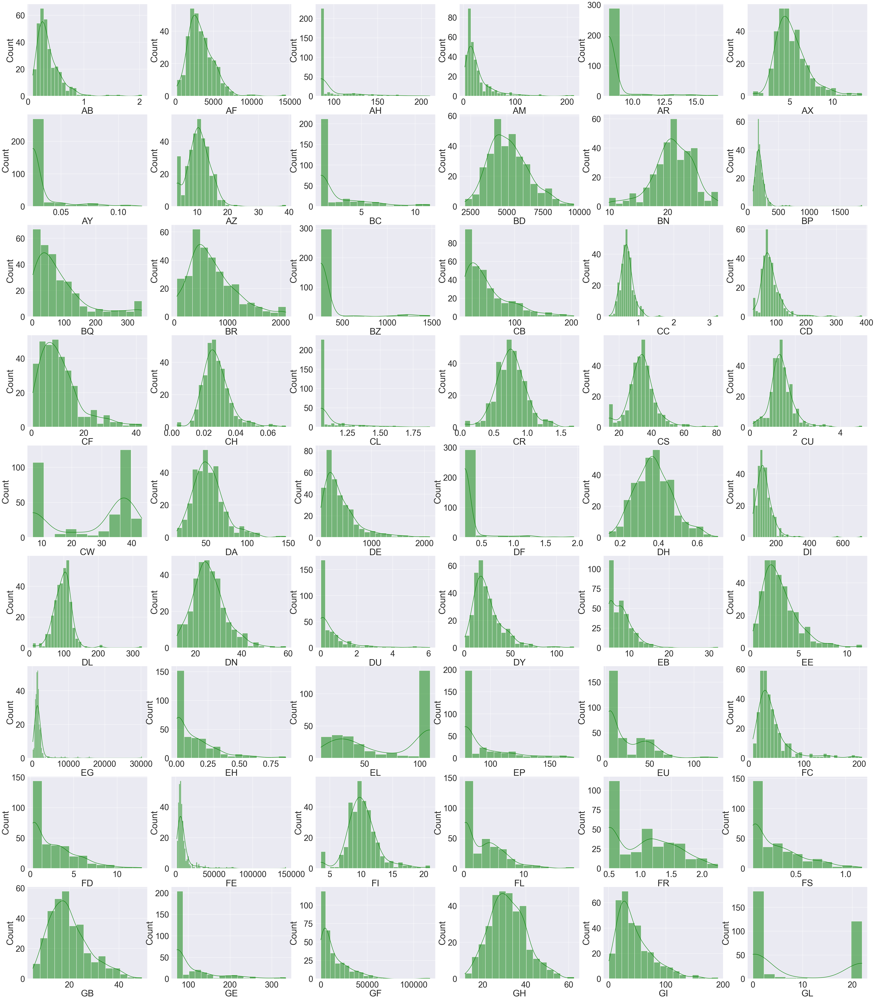

In [187]:
fig,ax=plt.subplots(9,6,figsize=(60,70))
features_train=numerical_features_train
i=0
j=0
for y in features_train:
    axes=ax[j,i]
    if y=='id':
        continue
    sns.histplot(df_train[y], kde=True, ax=axes, label='Train',color='green')
    i+=1
    if i%6==0:
        j+=1
        i=0       
plt.show()

In [188]:
#Good Improvement except for the fact we have lost 50% data

In [126]:
np.array(suspicious)

array(['AH', 'AR', 'AY', 'BC', 'BR', 'BZ', 'CL', 'DF', 'DU', 'EH', 'EU',
       'FC', 'FD', 'FR', 'GE', 'FS', 'CB', 'EP', 'FL'], dtype='<U2')

In [192]:
fig,ax=plt.subplots(9,6,figsize=(120,120))
features_train=numerical_features_train
cdict={0:'black',1:'orange'}
j=0
i=0
for x in features_train:
    axes=ax[j,i]
    if x=='id':
        continue
    sns.boxplot(x=df_train['Class'],y=df_train[x],ax=axes)
    ax[j,i].set_xlabel('Class',fontsize=25)
    ax[j,i].set_ylabel(x,fontsize=25)
    i+=1
    if i%6==0:
        j+=1
        i=0
plt.title('Training set')
plt.show()

### Categorical

In [13]:
df_train=data_train.copy()

In [15]:
for feat in categorical_features_train:
    print(f"{feat}:{len(df_train[feat].unique())}")

Id:617
EJ:2
Class:2


In [11]:
data_train['EJ'].value_counts()[0]

395

In [26]:
def calc_percent(data,feat):
    percent=[]
    for i in range(len(data[feat].unique())):
        total=data[feat].value_counts()[i]
        percent.append(total/data.shape[0])
    return percent

In [47]:
def plot_pie(colors=None,data=None,wp=None,labels=None,explode=None,axes=None,title=None,feat=None):
    x=calc_percent(data,feat)
    wedges, texts, autotexts=axes.pie(x=x,labels=labels,explode=explode,shadow=True,colors=colors,
    wedgeprops = wp,autopct='%1.1f%%',textprops={'fontsize': 20})
    
    plt.setp(autotexts, size=15)
    axes.set_title(title,fontsize=20)

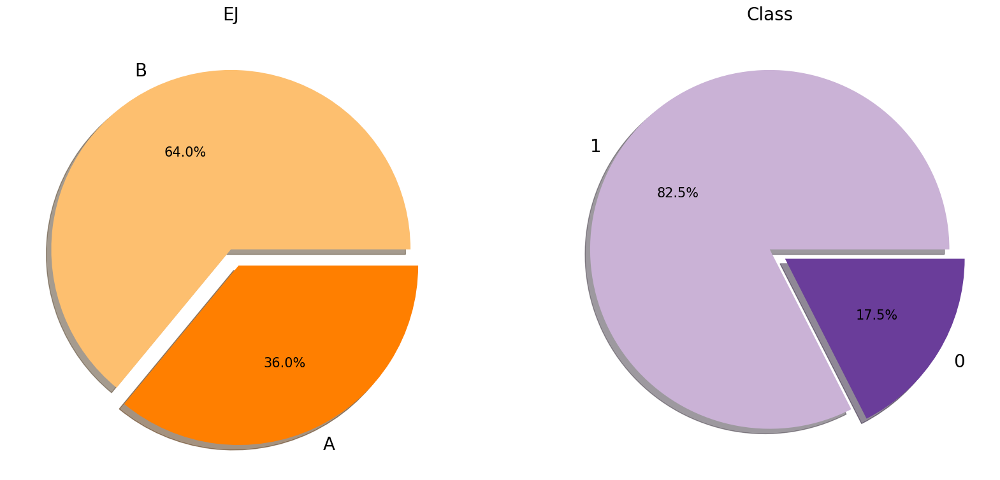

In [49]:
fig,ax=plt.subplots(1,2,figsize=(20,10))
color1 = sns.color_palette('Paired')[6:8]
color2 = sns.color_palette('Paired')[8:10]
# wp = { 'linewidth' : 1, 'edgecolor' : "black" }
plot_pie(color1,df_train,explode=[0,0.1],axes=ax[0],title=categorical_features_train[1],
         labels=df_train[categorical_features_train[1]].unique(),feat=categorical_features_train[1])
plot_pie(color2,df_train,explode=[0,0.1],axes=ax[1],title=categorical_features_train[2],
         labels=df_train[categorical_features_train[2]].unique(),feat=categorical_features_train[2])

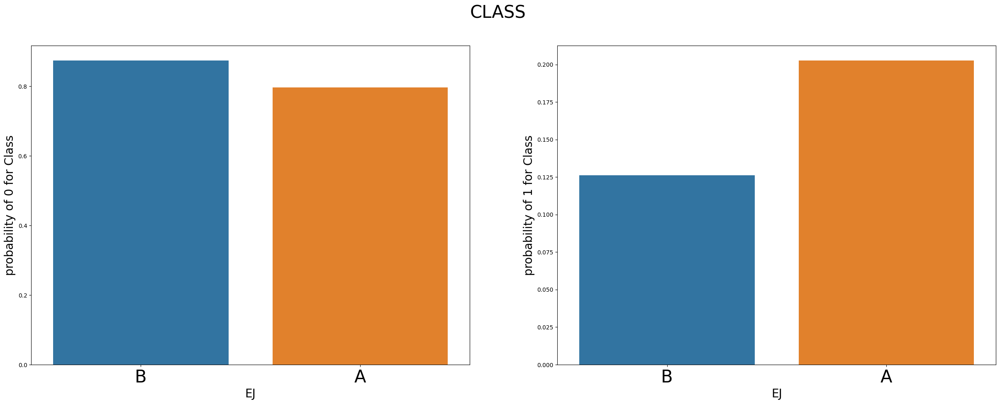

In [24]:
fig,ax=plt.subplots(1,2,figsize=(30,10))
i=0
j=0
feat='EJ'
for val in df_train['Class'].unique():  
    if feat in ['Id','Class']:
        continue
    prob=[]
    x=df_train[feat].value_counts()
    value1=np.where(df_train['Class']==i,df_train[feat],9)
    value1=[x for x in value1 if x!=9]
    k=np.sort(np.array(df_train[feat].unique()))
    for l in k:
        p=value1.count(l)/x[l]
        prob.append(p)
    axes=ax[i]
    sns.barplot(data=df_train,x=k, y=prob,ax=axes)
    ax[i].set_xlabel(feat,fontsize=20)
    ax[i].set_ylabel(f'probability of {i} for Class',fontsize=20)
    ax[i].set_xticklabels(df_train[feat].unique(),fontsize=30)
    i+=1
fig. suptitle("CLASS", fontsize=30)
plt.show()

In [25]:
#Having a value of A seems to affect the likelines of having a disease more

## Feature enginnering

In [28]:
df_train=data_train.copy()

In [50]:
#Checking for null values
null_vals=df_train.isnull().sum() 
for k in null_vals.keys():
    if null_vals[k]>0:
        print(f"{k}:{null_vals[k]},{len(df_train[k].unique())}")

BQ:60,516
CB:2,554
CC:3,603
DU:1,254
EL:60,312
FC:1,601
FL:1,389
FS:2,162
GL:1,356


In [38]:
#Checking for duplicate samples
duplicate=df_train[df_train.duplicated()]
duplicate

,Id,AB,AF,AH,AM,AR,AX,AY,AZ,BC,...,FL,FR,FS,GB,GE,GF,GH,GI,GL,Class


In [51]:
#Handling Null Values

#Methods Used
# BQ:Replace with median
# CB:Replace with median
# CC:Replace with median
# DU:Replace with median
# EL:Replace with median
# FC:Replace with median
# FL:Replace with median
# FS:Replace with median
# GL:Replace with median

for feat in null_vals.keys():
     if null_vals[feat]>0:
        df_train[feat].fillna(df_train[feat].median(),inplace=True)

In [20]:
#Training data
for feature in df_train.columns:
    print(f'{feature}:{df_train[feature].isnull().sum()}')

id:0
BertzCT:0
Chi1:0
Chi1n:0
Chi1v:0
Chi2n:0
Chi2v:0
Chi3v:0
Chi4n:0
EState_VSA1:0
EState_VSA2:0
ExactMolWt:0
FpDensityMorgan1:0
FpDensityMorgan2:0
FpDensityMorgan3:0
HallKierAlpha:0
HeavyAtomMolWt:0
Kappa3:0
MaxAbsEStateIndex:0
MinEStateIndex:0
NumHeteroatoms:0
PEOE_VSA10:0
PEOE_VSA14:0
PEOE_VSA6:0
PEOE_VSA7:0
PEOE_VSA8:0
SMR_VSA10:0
SMR_VSA5:0
SlogP_VSA3:0
VSA_EState9:0
fr_COO:0
fr_COO2:0
EC1:0
EC2:0
EC3:0
EC4:0
EC5:0
EC6:0


In [21]:
#Test data
for feature in df_test.columns:
    print(f'{feature}:{df_test[feature].isnull().sum()}')

id:0
BertzCT:0
Chi1:0
Chi1n:0
Chi1v:0
Chi2n:0
Chi2v:0
Chi3v:0
Chi4n:0
EState_VSA1:0
EState_VSA2:0
ExactMolWt:0
FpDensityMorgan1:0
FpDensityMorgan2:0
FpDensityMorgan3:0
HallKierAlpha:0
HeavyAtomMolWt:0
Kappa3:0
MaxAbsEStateIndex:0
MinEStateIndex:0
NumHeteroatoms:0
PEOE_VSA10:0
PEOE_VSA14:0
PEOE_VSA6:0
PEOE_VSA7:0
PEOE_VSA8:0
SMR_VSA10:0
SMR_VSA5:0
SlogP_VSA3:0
VSA_EState9:0
fr_COO:0
fr_COO2:0


In [26]:
#No null values

In [20]:
# modified_train['Power']=modified_train['Rotational speed [rpm]']*modified_train['Torque [Nm]']

# temp_diff=abs(modified_train['Air temperature [K]']-modified_train['Process temperature [K]'])
# modified_train['Temperature difference']=temp_diff

# temp_ratio=modified_train['Air temperature [K]']/modified_train['Process temperature [K]']
# modified_train['Temperature ratio']=temp_ratio

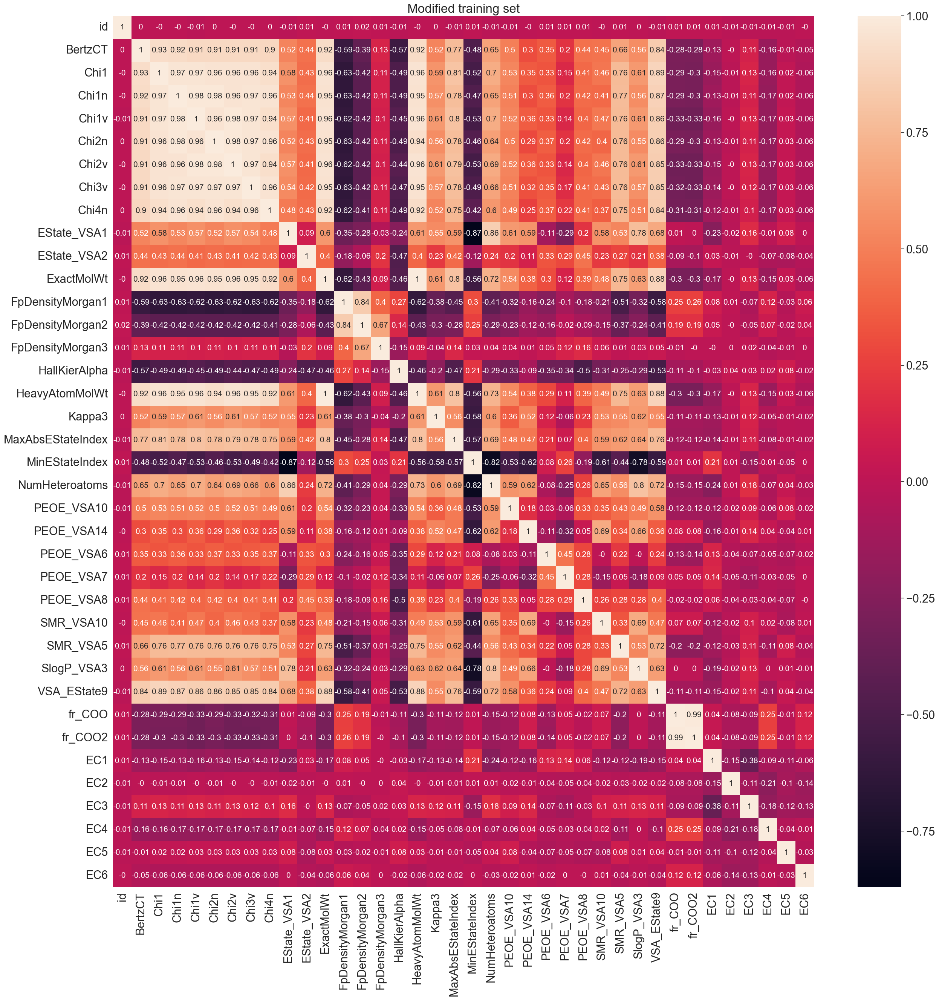

In [28]:
plt.figure(figsize=(30,30))
sns.set_theme(font_scale=2)
sns.heatmap(data=(df_train.corr(method='spearman')).round(2),cmap='rocket',annot=True,annot_kws={'size':15})
plt.title('Modified training set')
plt.show()

In [16]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler,MinMaxScaler,OrdinalEncoder
from sklearn.compose import make_column_transformer

In [17]:
features_scale=[feature for feature in df_train.columns]

In [18]:
features_scale

['id',
 'BertzCT',
 'Chi1',
 'Chi1n',
 'Chi1v',
 'Chi2n',
 'Chi2v',
 'Chi3v',
 'Chi4n',
 'EState_VSA1',
 'EState_VSA2',
 'ExactMolWt',
 'FpDensityMorgan1',
 'FpDensityMorgan2',
 'FpDensityMorgan3',
 'HallKierAlpha',
 'HeavyAtomMolWt',
 'Kappa3',
 'MaxAbsEStateIndex',
 'MinEStateIndex',
 'NumHeteroatoms',
 'PEOE_VSA10',
 'PEOE_VSA14',
 'PEOE_VSA6',
 'PEOE_VSA7',
 'PEOE_VSA8',
 'SMR_VSA10',
 'SMR_VSA5',
 'SlogP_VSA3',
 'VSA_EState9',
 'fr_COO',
 'fr_COO2',
 'EC1',
 'EC2',
 'EC3',
 'EC4',
 'EC5',
 'EC6']

In [19]:
def scale(data,feature_scale):
    
    ohe=OneHotEncoder()
    scaler=MinMaxScaler(copy=True,feature_range=(0,1))
    
    ct=make_column_transformer((scaler,features_scale),remainder='passthrough')
    transformed=ct.fit_transform(data)
    #features_scale.extend(['H','L','M'])
    
    for column in data.columns:
        if column not in features_scale: #and column!='Type':
            features_scale.append(column)
    data=pd.DataFrame(transformed, columns=features_scale)
    #data.drop(['Product ID'],axis=1,inplace=True)
    return data

In [20]:
scaler=MinMaxScaler(copy=True,feature_range=(0,1))

In [21]:
data=scale(df_train,features_scale)

In [22]:
data

,id,BertzCT,Chi1,Chi1n,Chi1v,Chi2n,Chi2v,Chi3v,Chi4n,EState_VSA1,...,SlogP_VSA3,VSA_EState9,fr_COO,fr_COO2,EC1,EC2,EC3,EC4,EC5,EC6
0,0.000000,0.079458,0.142053,0.117103,0.109964,0.133707,0.124489,0.120385,0.108830,0.000000,...,0.041545,0.105052,0.00,0.00,1.0,1.0,0.0,0.0,0.0,0.0
1,0.000067,0.067255,0.104370,0.088520,0.109204,0.102035,0.129709,0.096210,0.080246,0.124099,...,0.119800,0.128598,0.00,0.00,0.0,1.0,1.0,0.0,0.0,0.0
2,0.000135,0.128169,0.156882,0.169964,0.206821,0.207026,0.275301,0.254572,0.110160,0.043017,...,0.155663,0.131042,0.00,0.00,1.0,1.0,0.0,0.0,1.0,0.0
3,0.000202,0.139419,0.179053,0.141289,0.240188,0.201210,0.317477,0.345903,0.190830,0.262958,...,0.276952,0.238382,0.00,0.00,1.0,1.0,0.0,0.0,0.0,0.0
4,0.000270,0.027708,0.063474,0.057125,0.053643,0.058258,0.054242,0.045298,0.045273,0.049437,...,0.083090,0.099425,0.25,0.25,1.0,0.0,1.0,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14832,0.999730,0.155335,0.156882,0.131141,0.171807,0.144542,0.174383,0.160419,0.110160,0.090654,...,0.164181,0.171353,0.00,0.00,1.0,1.0,0.0,0.0,0.0,0.0
14833,0.999798,0.015373,0.037997,0.028837,0.027079,0.027317,0.025434,0.007632,0.000000,0.000000,...,0.000000,0.039578,0.00,0.00,0.0,1.0,0.0,1.0,0.0,0.0
14834,0.999865,0.241115,0.148999,0.122497,0.115029,0.146002,0.135936,0.133948,0.132764,0.047424,...,0.000000,0.184921,0.00,0.00,1.0,1.0,0.0,0.0,0.0,0.0
14835,0.999933,0.073507,0.143048,0.131337,0.146895,0.163892,0.158373,0.173900,0.143088,0.125441,...,0.078755,0.130845,0.00,0.00,0.0,1.0,1.0,0.0,0.0,0.0


In [15]:
#Performing pricipal component analysis
from sklearn.decomposition import PCA

In [23]:
pca=PCA()
corr_features=[ "BertzCT","ExactMolWt","HeavyAtomMolWt","Chi1", "Chi1n","Chi1v","Chi2n","Chi2v",
                "Chi3v","Chi4n",]
X=data[corr_features]
X=pca.fit_transform(X)

In [24]:
explained_variance = pca.explained_variance_ratio_
explained_variance

array([9.44306543e-01, 2.44439707e-02, 1.29074349e-02, 6.93957633e-03,
       4.76296128e-03, 2.26392343e-03, 2.11354201e-03, 1.36175526e-03,
       5.18978442e-04, 3.81314970e-04])

In [26]:
#Reducing to one component as it covers 94.4% of the variance in data
pca=PCA(n_components=1)
X=data[corr_features]
X=pca.fit_transform(X)

In [28]:
modified_data=data.copy()
modified_data.drop(corr_features,axis=1,inplace=True)
modified_data['pca_feat']=X

In [40]:
modified_data.shape #Dimensionality reduced by 9 features

(14837, 29)

## Feature selection

### Filter methods

In [28]:
from sklearn.feature_selection import mutual_info_classif, chi2, SelectKBest,VarianceThreshold,RFE
from skfeature.function.similarity_based import fisher_score

In [23]:
#1) Information gain
X=data.copy()
X.drop('EC1',axis=1,inplace=True)
Y=data[['EC1']]

Y=np.array(Y).astype('int32')
Y=Y.reshape((Y.shape[0],))

# X=np.array(X).astype('int32')

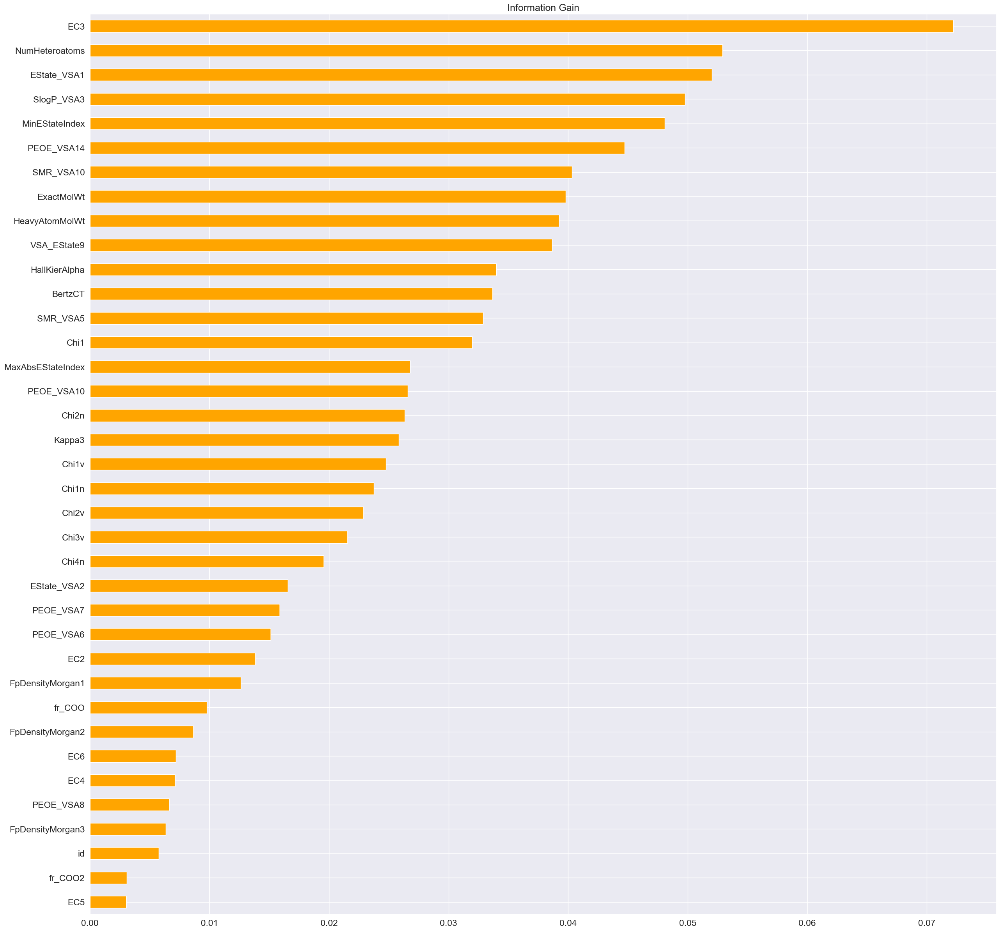

In [24]:
imp=mutual_info_classif(X,Y)
plt.figure(figsize=(30,30))
sns.set_theme(font_scale=1.5)
plot_imp=pd.Series(imp, X.columns)
plot_imp.sort_values().plot(kind='barh',color='orange')
plt.title('Information Gain')
plt.show()

In [25]:
gini_feat=plot_imp.sort_values(ascending=False)[0:21]
gini_feat

EC3                  0.072207
NumHeteroatoms       0.052893
EState_VSA1          0.052032
SlogP_VSA3           0.049787
MinEStateIndex       0.048061
PEOE_VSA14           0.044721
SMR_VSA10            0.040304
ExactMolWt           0.039800
HeavyAtomMolWt       0.039248
VSA_EState9          0.038652
HallKierAlpha        0.034000
BertzCT              0.033673
SMR_VSA5             0.032895
Chi1                 0.031958
MaxAbsEStateIndex    0.026796
PEOE_VSA10           0.026578
Chi2n                0.026318
Kappa3               0.025838
Chi1v                0.024763
Chi1n                0.023755
Chi2v                0.022858
dtype: float64

In [191]:
X=data.copy()
X.drop('EC2',axis=1,inplace=True)
Y=data[['EC2']]

Y=np.array(Y).astype('int32')
Y=Y.reshape((Y.shape[0],))


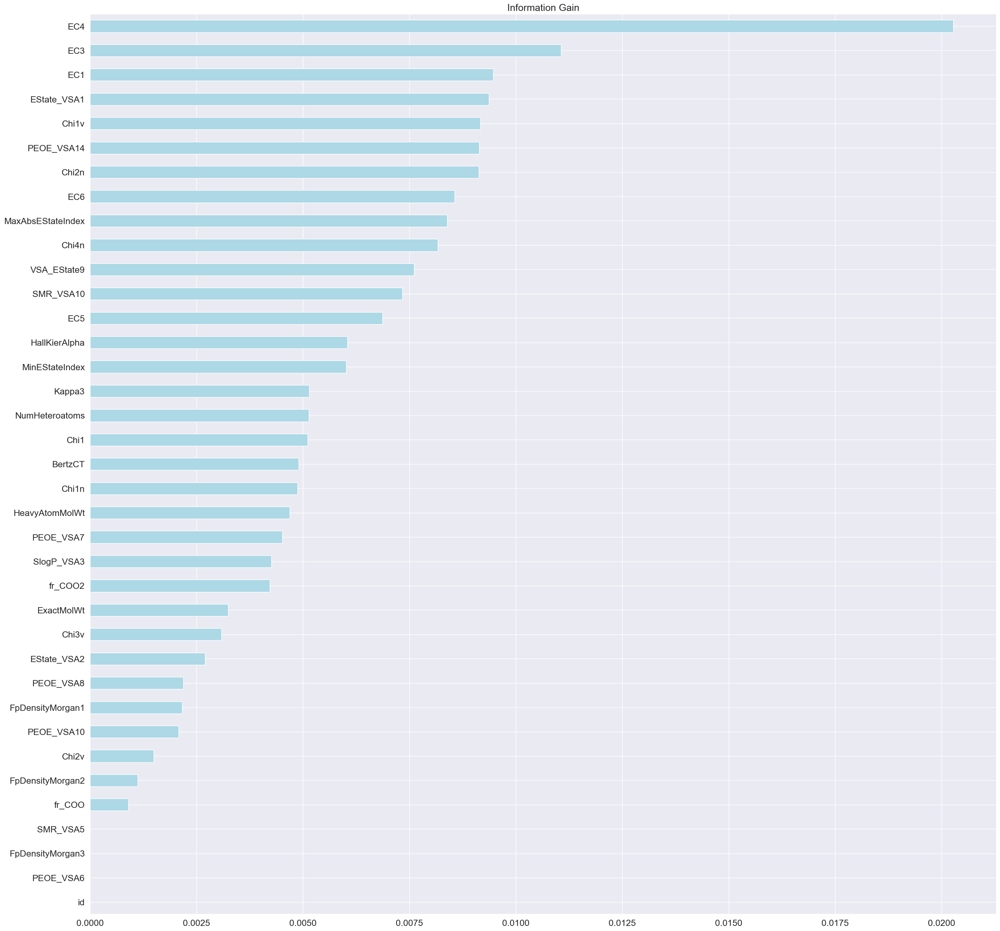

In [192]:
imp=mutual_info_classif(X,Y)
plt.figure(figsize=(30,30))
sns.set_theme(font_scale=1.5)
plot_imp=pd.Series(imp, X.columns)
plot_imp.sort_values().plot(kind='barh',color='lightblue')
plt.title('Information Gain')
plt.show()

In [193]:
gini_feat=plot_imp.sort_values(ascending=False)[0:21]
gini_feat

EC4                  0.020275
EC3                  0.011067
EC1                  0.009473
EState_VSA1          0.009366
Chi1v                0.009172
PEOE_VSA14           0.009138
Chi2n                0.009131
EC6                  0.008561
MaxAbsEStateIndex    0.008388
Chi4n                0.008172
VSA_EState9          0.007609
SMR_VSA10            0.007335
EC5                  0.006870
HallKierAlpha        0.006048
MinEStateIndex       0.006016
Kappa3               0.005151
NumHeteroatoms       0.005140
Chi1                 0.005116
BertzCT              0.004901
Chi1n                0.004870
HeavyAtomMolWt       0.004688
dtype: float64

In [143]:
#Chi square test
chi_features=SelectKBest(chi2, k=8)
Best_features=chi_features.fit_transform(X,Y)

Best_features.shape

(136429, 8)

In [26]:
#Correlation
corr_feat=abs(data.corr()['EC1']).sort_values(ascending=False)[0:21]
corr_feat

EC1                  1.000000
EC3                  0.375570
MinEStateIndex       0.208827
EState_VSA1          0.173752
EC2                  0.146059
NumHeteroatoms       0.127448
PEOE_VSA14           0.123488
MaxAbsEStateIndex    0.122893
PEOE_VSA10           0.115469
EC5                  0.112205
SlogP_VSA3           0.109439
VSA_EState9          0.093636
EC4                  0.091273
PEOE_VSA6            0.084942
PEOE_VSA7            0.083718
HeavyAtomMolWt       0.078682
ExactMolWt           0.075954
Chi1                 0.069660
Chi1v                0.065679
Chi2v                0.064649
EC6                  0.063344
Name: EC1, dtype: float64

In [39]:
rfe = RFE(GBC, n_features_to_select=23)
rfe.fit(X_train, Y_train)
X_selection = rfe.transform(X_train)

In [54]:
x=data.columns
x=list(x)
x=[y for y in x if y[0:2]!='EC' and y!='id']

In [55]:
x

['BertzCT',
 'Chi1',
 'Chi1n',
 'Chi1v',
 'Chi2n',
 'Chi2v',
 'Chi3v',
 'Chi4n',
 'EState_VSA1',
 'EState_VSA2',
 'ExactMolWt',
 'FpDensityMorgan1',
 'FpDensityMorgan2',
 'FpDensityMorgan3',
 'HallKierAlpha',
 'HeavyAtomMolWt',
 'Kappa3',
 'MaxAbsEStateIndex',
 'MinEStateIndex',
 'NumHeteroatoms',
 'PEOE_VSA10',
 'PEOE_VSA14',
 'PEOE_VSA6',
 'PEOE_VSA7',
 'PEOE_VSA8',
 'SMR_VSA10',
 'SMR_VSA5',
 'SlogP_VSA3',
 'VSA_EState9',
 'fr_COO',
 'fr_COO2']

In [56]:
rfe.get_feature_names_out(x)

array(['BertzCT', 'Chi1v', 'Chi2v', 'EState_VSA1', 'EState_VSA2',
       'ExactMolWt', 'FpDensityMorgan1', 'FpDensityMorgan2',
       'FpDensityMorgan3', 'HallKierAlpha', 'HeavyAtomMolWt', 'Kappa3',
       'MaxAbsEStateIndex', 'MinEStateIndex', 'NumHeteroatoms',
       'PEOE_VSA10', 'PEOE_VSA14', 'PEOE_VSA7', 'PEOE_VSA8', 'SMR_VSA10',
       'SMR_VSA5', 'SlogP_VSA3', 'VSA_EState9'], dtype=object)

In [41]:
X_selection.shape

(14838, 23)

In [27]:
#Lasso Regression
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel
pd.pandas.set_option("display.max_columns",None)

In [28]:
def LassoSelection(data):
    X_train=data.copy()
    X_train.drop(['EC2'],axis=1,inplace=True)

    Y_train=data['EC2']
    
    feature_sel_model=SelectFromModel(Lasso(alpha=0.0005,random_state=0))
    feature_sel_model.fit(X_train,Y_train)
    
    selected_feature = X_train.columns[(feature_sel_model.get_support())]

    print('total features: {}'.format((X_train.shape[1])))
    print('selected features: {}'.format(len(selected_feature)))
    print('features with coefficients shrank to zero: {}'.format(np.sum(feature_sel_model.estimator_.coef_ == 0)))
    return selected_feature

In [29]:
selected_feature=LassoSelection(data)
selected_feature

total features: 37
selected features: 14
features with coefficients shrank to zero: 23


Index(['id', 'Chi3v', 'Chi4n', 'EState_VSA2', 'HallKierAlpha',
       'MaxAbsEStateIndex', 'PEOE_VSA7', 'PEOE_VSA8', 'SMR_VSA10', 'EC1',
       'EC3', 'EC4', 'EC5', 'EC6'],
      dtype='object')

In [30]:
c=np.array(corr_feat.index)
c=[x for x in c if  x[0:2]!='EC' and x not in selected_feature ] #x[0:1]!='EC' and

g=np.array(gini_feat.index)
g=[x for x in g if  x[0:2]!='EC' and (x not in selected_feature and x not in c)]

g,c

(['BertzCT', 'SMR_VSA5', 'Chi2n', 'Kappa3', 'Chi1n'],
 ['MinEStateIndex',
  'EState_VSA1',
  'NumHeteroatoms',
  'PEOE_VSA14',
  'PEOE_VSA10',
  'SlogP_VSA3',
  'VSA_EState9',
  'PEOE_VSA6',
  'HeavyAtomMolWt',
  'ExactMolWt',
  'Chi1',
  'Chi1v',
  'Chi2v'])

In [31]:
selected_feature=list(selected_feature)
selected_feature=[x for x in selected_feature if x[0:2]!='EC' and x!='id']
selected_feature.extend(g)
selected_feature.extend(c)
len(selected_feature)

26

In [201]:
# Getting top selected features
X_train=data[selected_feature]
Y_train=data['EC2']

In [102]:
X_train=modified_data.copy()
X_train.drop(['id','EC1','EC2','EC3','EC4','EC5','EC6'],axis=1,inplace=True)
X_train

Y_train=df_train['EC1']

X_train=np.array(X_train).astype('float32')
Y_train=np.array(Y_train).astype('float32')

## Training model

In [78]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, HistGradientBoostingClassifier,StackingClassifier
from sklearn.model_selection import cross_validate, train_test_split,StratifiedKFold
from sklearn.metrics import roc_auc_score,classification_report
from sklearn import metrics
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from statistics import mean
from optuna.integration import LightGBMPruningCallback
import optuna

#Boosting models
import xgboost as xgb
import lightgbm as LGBM
from catboost import CatBoostClassifier as CBC

In [83]:
LR=LogisticRegression(C=1.5,max_iter=1000)
svc=SVC(probability=True,max_iter=1000)
# rfc=RandomForestClassifier(n_estimators= 922,
#  min_samples_split= 4,                                                           
#  min_samples_leaf=8,
#  max_features='auto',
#  max_depth= 10,
#  criterion= 'entropy',
#  class_weight= {0: 1, 1: 2})
rfc=RandomForestClassifier()

# XGBC_1=xgb.XGBClassifier(eval_metric='auc', learning_rate =0.1, n_estimators=352, max_depth=2,
#  min_child_weight=5, gamma=0.2, subsample=0.8, colsample_bytree=0.85,
#  objective= 'binary:logistic', scale_pos_weight=1, seed=27)

XGBC=xgb.XGBClassifier()
LGBMC=LGBM.LGBMClassifier()

# LGBMC_1=LGBM.LGBMClassifier(n_estimators=95,learning_rate=0.1,num_leaves=18,max_depth=5,lambda_l1=0,
# lambda_l2=0,min_child_weight=1,min_child_samples= 65,bagging_fraction= 0.6,bagging_freq= 1,feature_fraction= 0.3,
# scale_pos_weight= 1,objective= 'binary',metric="auc")

# cbc= CBC(learning_rate=0.1,iterations=772,bootstrap_type='MVS',subsample=0.6,depth=4,random_strength=3,l2_leaf_reg=3,
# custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',eval_metric='AUC',cat_features=categorical_features_indices,
# scale_pos_weight=1,thread_count=-1)

HGBC=HistGradientBoostingClassifier(max_iter= 453,
 learning_rate= 0.05976021943556376,
 max_leaf_nodes= 90,
 max_depth= 5,
 l2_regularization= 0.4906726453773932,
 min_samples_leaf= 148)
# cbc= CBC(custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',
#     eval_metric='AUC',
#     bagging_temperature= 0.3584575315974837,
#     bootstrap_type= 'Bayesian',
#     depth= 8,
#     iterations= 248,
#     l2_leaf_reg= 4,
#     learning_rate= 0.0708156092644885,
#     min_data_in_leaf= 61.213333325891035,
#     od_type= 'IncToDec',
#     od_wait= 34,
#     random_strength= 6.29771970997386,
#     scale_pos_weight= 2.405191377837658)

cbc= CBC(custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',    #For EC2
    eval_metric='AUC',
    bagging_temperature=2.443272044270869,
    bootstrap_type= 'Bayesian',
    depth= 6,
    iterations= 287,
    l2_leaf_reg= 4,
    learning_rate=0.08311659249536664,
    min_data_in_leaf= 57.22671000596033,
    od_type= 'Iter',
    od_wait= 47,
    random_strength= 7.210024844233634,
    scale_pos_weight= 1.2479553383669229)

# estimators=[('XGBC',XGBC),("LGMBC",LGBMC)]
# StackedModel=StackingClassifier(estimators=estimators,final_estimator=cbc,stack_method='predict_proba')
models=[cbc]

In [1]:
study.best_params

In [85]:
#Stratified cross validation
def StratifiedKfold(models,X_train,Y_train):
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=1) 
    for model in models:
        lst_accu_stratified = []
        train_auc=[]
        for train_index, test_index in skf.split(X_train, Y_train): 
            X_train_fold, X_test_fold = X_train[train_index], X_train[test_index] 
            y_train_fold, y_test_fold = Y_train[train_index], Y_train[test_index]
            if model=='cbc':
                model.fit(X_train_fold, y_train_fold)#,eval_set=(X_test_fold,y_test_fold)) 
            else:
                model.fit(X_train_fold, y_train_fold,eval_set=(X_test_fold,y_test_fold)) 
            y_train_prob=model.predict_proba(X_train_fold)[:,1]
            y_pred_prob=model.predict_proba(X_test_fold)[:,1]
            lst_accu_stratified.append(roc_auc_score(y_test_fold,y_pred_prob))
            train_auc.append(roc_auc_score(y_train_fold,y_train_prob))
        print(f'{model}:')
        print('Maximum AUC:',f'test:{max(lst_accu_stratified)}',f'train:{max(train_auc)}') 
        print('Minimum AUC:',f'test:{min(lst_accu_stratified)}',f'train:{min(train_auc)}') 
        print('Overall AUC:',f'test:{mean(lst_accu_stratified)}',f'train:{mean(train_auc)}')

In [86]:
StratifiedKfold(models,X_train,Y_train)

0:	learn: 0.5591838	test: 0.5531612	best: 0.5531612 (0)	total: 7.25ms	remaining: 2.07s
1:	learn: 0.5663421	test: 0.5537984	best: 0.5537984 (1)	total: 14.5ms	remaining: 2.06s
2:	learn: 0.5940891	test: 0.5867249	best: 0.5867249 (2)	total: 21.7ms	remaining: 2.05s
3:	learn: 0.5968533	test: 0.5927536	best: 0.5927536 (3)	total: 28.8ms	remaining: 2.04s
4:	learn: 0.5992443	test: 0.5903276	best: 0.5927536 (3)	total: 35.8ms	remaining: 2.02s
5:	learn: 0.5995763	test: 0.5889708	best: 0.5927536 (3)	total: 43.2ms	remaining: 2.02s
6:	learn: 0.6015615	test: 0.5883021	best: 0.5927536 (3)	total: 51.4ms	remaining: 2.06s
7:	learn: 0.6054436	test: 0.5839291	best: 0.5927536 (3)	total: 58.9ms	remaining: 2.06s
8:	learn: 0.6062212	test: 0.5822385	best: 0.5927536 (3)	total: 66.2ms	remaining: 2.04s
9:	learn: 0.6079646	test: 0.5868076	best: 0.5927536 (3)	total: 73.7ms	remaining: 2.04s
10:	learn: 0.6082574	test: 0.5888404	best: 0.5927536 (3)	total: 81.5ms	remaining: 2.04s
11:	learn: 0.6077644	test: 0.5889948	best:

96:	learn: 0.6949626	test: 0.6031366	best: 0.6037456 (93)	total: 627ms	remaining: 1.23s
97:	learn: 0.6963856	test: 0.6029939	best: 0.6037456 (93)	total: 634ms	remaining: 1.22s
98:	learn: 0.6971022	test: 0.6026717	best: 0.6037456 (93)	total: 640ms	remaining: 1.22s
99:	learn: 0.6976172	test: 0.6034213	best: 0.6037456 (93)	total: 647ms	remaining: 1.21s
100:	learn: 0.6981834	test: 0.6037011	best: 0.6037456 (93)	total: 653ms	remaining: 1.2s
101:	learn: 0.6991374	test: 0.6036000	best: 0.6037456 (93)	total: 660ms	remaining: 1.2s
102:	learn: 0.7001286	test: 0.6037004	best: 0.6037456 (93)	total: 667ms	remaining: 1.19s
103:	learn: 0.7009519	test: 0.6038501	best: 0.6038501 (103)	total: 673ms	remaining: 1.18s
104:	learn: 0.7010892	test: 0.6044965	best: 0.6044965 (104)	total: 680ms	remaining: 1.18s
105:	learn: 0.7016271	test: 0.6043807	best: 0.6044965 (104)	total: 686ms	remaining: 1.17s
106:	learn: 0.7024128	test: 0.6037668	best: 0.6044965 (104)	total: 693ms	remaining: 1.17s
107:	learn: 0.7028862	t

66:	learn: 0.6765528	test: 0.5622263	best: 0.5661486 (22)	total: 413ms	remaining: 1.36s
67:	learn: 0.6774169	test: 0.5622496	best: 0.5661486 (22)	total: 420ms	remaining: 1.35s
68:	learn: 0.6770190	test: 0.5624728	best: 0.5661486 (22)	total: 427ms	remaining: 1.35s
69:	learn: 0.6766531	test: 0.5626495	best: 0.5661486 (22)	total: 433ms	remaining: 1.34s
Stopped by overfitting detector  (47 iterations wait)

bestTest = 0.5661486117
bestIteration = 22

Shrink model to first 23 iterations.
0:	learn: 0.5547033	test: 0.5615268	best: 0.5615268 (0)	total: 7.39ms	remaining: 2.11s
1:	learn: 0.5615193	test: 0.5550652	best: 0.5615268 (0)	total: 14.5ms	remaining: 2.07s
2:	learn: 0.5937182	test: 0.5874889	best: 0.5874889 (2)	total: 21.1ms	remaining: 2s
3:	learn: 0.5951296	test: 0.5891070	best: 0.5891070 (3)	total: 27.5ms	remaining: 1.95s
4:	learn: 0.5964279	test: 0.5918237	best: 0.5918237 (4)	total: 33.9ms	remaining: 1.91s
5:	learn: 0.5995001	test: 0.5890192	best: 0.5918237 (4)	total: 40.5ms	remaining:

5:	learn: 0.6026990	test: 0.5661348	best: 0.5687439 (2)	total: 41.1ms	remaining: 1.93s
6:	learn: 0.6048944	test: 0.5663143	best: 0.5687439 (2)	total: 48.1ms	remaining: 1.92s
7:	learn: 0.6105315	test: 0.5677922	best: 0.5687439 (2)	total: 55.7ms	remaining: 1.94s
8:	learn: 0.6109313	test: 0.5683477	best: 0.5687439 (2)	total: 62.5ms	remaining: 1.93s
9:	learn: 0.6127032	test: 0.5692100	best: 0.5692100 (9)	total: 69.1ms	remaining: 1.91s
10:	learn: 0.6154434	test: 0.5687315	best: 0.5692100 (9)	total: 75.5ms	remaining: 1.89s
11:	learn: 0.6162994	test: 0.5712448	best: 0.5712448 (11)	total: 81.9ms	remaining: 1.88s
12:	learn: 0.6174231	test: 0.5708295	best: 0.5712448 (11)	total: 88.2ms	remaining: 1.86s
13:	learn: 0.6177057	test: 0.5735520	best: 0.5735520 (13)	total: 94.8ms	remaining: 1.85s
14:	learn: 0.6181534	test: 0.5739672	best: 0.5739672 (14)	total: 101ms	remaining: 1.83s
15:	learn: 0.6192090	test: 0.5725615	best: 0.5739672 (14)	total: 107ms	remaining: 1.82s
16:	learn: 0.6197130	test: 0.57162

101:	learn: 0.6918112	test: 0.5772770	best: 0.5781485 (98)	total: 657ms	remaining: 1.19s
102:	learn: 0.6928884	test: 0.5774679	best: 0.5781485 (98)	total: 664ms	remaining: 1.19s
103:	learn: 0.6932012	test: 0.5772007	best: 0.5781485 (98)	total: 671ms	remaining: 1.18s
104:	learn: 0.6941427	test: 0.5776622	best: 0.5781485 (98)	total: 678ms	remaining: 1.17s
105:	learn: 0.6944513	test: 0.5775824	best: 0.5781485 (98)	total: 684ms	remaining: 1.17s
106:	learn: 0.6953223	test: 0.5775915	best: 0.5781485 (98)	total: 690ms	remaining: 1.16s
107:	learn: 0.6958834	test: 0.5773717	best: 0.5781485 (98)	total: 696ms	remaining: 1.15s
108:	learn: 0.6965076	test: 0.5775774	best: 0.5781485 (98)	total: 702ms	remaining: 1.15s
109:	learn: 0.6970198	test: 0.5773371	best: 0.5781485 (98)	total: 707ms	remaining: 1.14s
110:	learn: 0.6980882	test: 0.5774332	best: 0.5781485 (98)	total: 713ms	remaining: 1.13s
111:	learn: 0.6991181	test: 0.5781153	best: 0.5781485 (98)	total: 719ms	remaining: 1.12s
112:	learn: 0.7000263

In [103]:
X_train,X_test,Y_train,Y_test=train_test_split(X_train,Y_train,test_size=0.2,random_state=42,stratify=Y_train)

In [107]:
categorical_features_indices=[]

In [108]:
cbc= CBC(learning_rate=0.15,custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',eval_metric='AUC',
         cat_features=categorical_features_indices)

In [110]:
cbc.select_features(
                X_train,
                Y_train,
                eval_set=(X_test,Y_test),
                features_for_select='0-21',
                num_features_to_select=10,
                steps=5,
                train_final_model=False,
                verbose=50,
                plot=True,)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Step #1 out of 5
0:	learn: 0.6817477	test: 0.6870828	best: 0.6870828 (0)	total: 7.67ms	remaining: 7.66s
50:	learn: 0.7512426	test: 0.7209994	best: 0.7215369 (35)	total: 400ms	remaining: 7.45s
100:	learn: 0.7954837	test: 0.7146343	best: 0.7219553 (53)	total: 749ms	remaining: 6.67s
150:	learn: 0.8369249	test: 0.7115311	best: 0.7219553 (53)	total: 1.15s	remaining: 6.49s
200:	learn: 0.8689442	test: 0.7053553	best: 0.7219553 (53)	total: 1.58s	remaining: 6.28s
250:	learn: 0.8937192	test: 0.6991463	best: 0.7219553 (53)	total: 2.06s	remaining: 6.14s
300:	learn: 0.9129195	test: 0.6999931	best: 0.7219553 (53)	total: 2.46s	remaining: 5.71s
350:	learn: 0.9288066	test: 0.6947195	best: 0.7219553 (53)	total: 2.85s	remaining: 5.27s
400:	learn: 0.9412870	test: 0.6917434	best: 0.7219553 (53)	total: 3.24s	remaining: 4.84s
450:	learn: 0.9512357	test: 0.6910511	best: 0.7219553 (53)	total: 3.63s	remaining: 4.42s
500:	learn: 0.9598655	test: 0.6876605	best: 0.7219553 (53)	total: 4s	remaining: 3.98s
550:	learn

100:	learn: 0.7817364	test: 0.7163518	best: 0.7232074 (27)	total: 790ms	remaining: 7.03s
150:	learn: 0.8156237	test: 0.7105215	best: 0.7232074 (27)	total: 1.16s	remaining: 6.54s
200:	learn: 0.8406579	test: 0.7081704	best: 0.7232074 (27)	total: 1.57s	remaining: 6.23s
250:	learn: 0.8637057	test: 0.7042196	best: 0.7232074 (27)	total: 1.88s	remaining: 5.6s
300:	learn: 0.8818218	test: 0.7028978	best: 0.7232074 (27)	total: 2.3s	remaining: 5.34s
350:	learn: 0.8971313	test: 0.6979343	best: 0.7232074 (27)	total: 2.66s	remaining: 4.92s
400:	learn: 0.9105032	test: 0.6969482	best: 0.7232074 (27)	total: 3.04s	remaining: 4.55s
450:	learn: 0.9228508	test: 0.6954180	best: 0.7232074 (27)	total: 3.52s	remaining: 4.28s
500:	learn: 0.9338024	test: 0.6931501	best: 0.7232074 (27)	total: 3.9s	remaining: 3.89s
550:	learn: 0.9422465	test: 0.6909605	best: 0.7232074 (27)	total: 4.3s	remaining: 3.5s
600:	learn: 0.9502031	test: 0.6896368	best: 0.7232074 (27)	total: 4.78s	remaining: 3.17s
650:	learn: 0.9570361	test

{'selected_features': [0, 7, 8, 9, 10, 11, 12, 15, 17, 21],
 'eliminated_features_names': ['', '', '', '', '', '', '', '', '', '', '', ''],
 'loss_graph': {'main_indices': [0, 3, 6, 8, 10],
  'removed_features_count': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
  'loss_values': [0.5651669429196484,
   0.5661120667601833,
   0.5666528126114843,
   0.5664504953893016,
   0.5662652525240485,
   0.5660565261237694,
   0.5656885465119188,
   0.5667981788228196,
   0.5680035661629661,
   0.5667836265748963,
   0.564788047563081,
   0.5655607788580788,
   0.566571904777201]},
 'eliminated_features': [5, 16, 4, 19, 2, 20, 1, 18, 14, 13, 6, 3],
 'selected_features_names': ['', '', '', '', '', '', '', '', '', '']}

In [114]:
k=modified_data.columns
feat=[0, 7, 8, 9, 10, 11, 12, 15, 17, 21]
select_feat=[k[x] for x in feat]
select_feat

['id',
 'Kappa3',
 'MaxAbsEStateIndex',
 'MinEStateIndex',
 'NumHeteroatoms',
 'PEOE_VSA10',
 'PEOE_VSA14',
 'PEOE_VSA8',
 'SMR_VSA5',
 'fr_COO2']

In [14]:
#For EC1
k=df_train.columns
feat=[2,3,5,7,8,9,12,15,16,17,18,19,20,21,22,23,24,25,27,28]
select_feat=[k[x] for x in feat]
select_feat

['Chi1',
 'Chi1n',
 'Chi2n',
 'Chi3v',
 'Chi4n',
 'EState_VSA1',
 'FpDensityMorgan1',
 'HallKierAlpha',
 'HeavyAtomMolWt',
 'Kappa3',
 'MaxAbsEStateIndex',
 'MinEStateIndex',
 'NumHeteroatoms',
 'PEOE_VSA10',
 'PEOE_VSA14',
 'PEOE_VSA6',
 'PEOE_VSA7',
 'PEOE_VSA8',
 'SMR_VSA5',
 'SlogP_VSA3']

In [53]:
feat_1=[1,2,5,6,8,9,10,13,15,16,17,19,20,21,22,23,25,28,29,30]
select_feat_EC2=[k[x] for x in feat_1]
select_feat_EC2

['BertzCT',
 'Chi1',
 'Chi2n',
 'Chi2v',
 'Chi4n',
 'EState_VSA1',
 'EState_VSA2',
 'FpDensityMorgan2',
 'HallKierAlpha',
 'HeavyAtomMolWt',
 'Kappa3',
 'MinEStateIndex',
 'NumHeteroatoms',
 'PEOE_VSA10',
 'PEOE_VSA14',
 'PEOE_VSA6',
 'PEOE_VSA8',
 'SlogP_VSA3',
 'VSA_EState9',
 'fr_COO']

In [ ]:
cbc.fit(X_train,Y_train,cat_features=categorical_features_indices,eval_set=(X_test,Y_test),plot=True)

In [ ]:
0.08
bestTest = 0.9770928884, 0.968-0.05
bestIteration = 896

Shrink model to first 897 iterations.

In [57]:
LGBMC.fit(X_train,Y_train)

LGBMClassifier()

In [91]:
cbc.fit(X_train,Y_train)

0:	learn: 0.6533318	total: 39ms	remaining: 9.63s
1:	learn: 0.6820551	total: 75.1ms	remaining: 9.24s
2:	learn: 0.6943110	total: 111ms	remaining: 9.1s
3:	learn: 0.6940907	total: 146ms	remaining: 8.89s
4:	learn: 0.7001763	total: 184ms	remaining: 8.92s
5:	learn: 0.7045059	total: 219ms	remaining: 8.82s
6:	learn: 0.7046856	total: 256ms	remaining: 8.82s
7:	learn: 0.7085771	total: 297ms	remaining: 8.92s
8:	learn: 0.7076180	total: 334ms	remaining: 8.88s
9:	learn: 0.7090113	total: 371ms	remaining: 8.82s
10:	learn: 0.7088306	total: 407ms	remaining: 8.77s
11:	learn: 0.7089464	total: 444ms	remaining: 8.74s
12:	learn: 0.7097810	total: 481ms	remaining: 8.7s
13:	learn: 0.7101152	total: 518ms	remaining: 8.65s
14:	learn: 0.7123845	total: 555ms	remaining: 8.63s
15:	learn: 0.7124126	total: 592ms	remaining: 8.59s
16:	learn: 0.7122921	total: 631ms	remaining: 8.57s
17:	learn: 0.7129439	total: 669ms	remaining: 8.55s
18:	learn: 0.7146294	total: 707ms	remaining: 8.52s
19:	learn: 0.7168676	total: 746ms	remaining

166:	learn: 0.7828132	total: 6.41s	remaining: 3.11s
167:	learn: 0.7833548	total: 6.46s	remaining: 3.07s
168:	learn: 0.7839810	total: 6.5s	remaining: 3.04s
169:	learn: 0.7845306	total: 6.54s	remaining: 3s
170:	learn: 0.7847739	total: 6.58s	remaining: 2.96s
171:	learn: 0.7852660	total: 6.62s	remaining: 2.92s
172:	learn: 0.7861294	total: 6.66s	remaining: 2.89s
173:	learn: 0.7867008	total: 6.7s	remaining: 2.85s
174:	learn: 0.7871163	total: 6.74s	remaining: 2.81s
175:	learn: 0.7876385	total: 6.78s	remaining: 2.77s
176:	learn: 0.7881457	total: 6.82s	remaining: 2.74s
177:	learn: 0.7888361	total: 6.86s	remaining: 2.7s
178:	learn: 0.7892524	total: 6.9s	remaining: 2.66s
179:	learn: 0.7902203	total: 6.94s	remaining: 2.62s
180:	learn: 0.7910639	total: 6.98s	remaining: 2.58s
181:	learn: 0.7914262	total: 7.02s	remaining: 2.54s
182:	learn: 0.7920943	total: 7.06s	remaining: 2.51s
183:	learn: 0.7927118	total: 7.1s	remaining: 2.47s
184:	learn: 0.7936721	total: 7.14s	remaining: 2.43s
185:	learn: 0.794541

In [92]:
for model in models:
    y_pred_train=model.predict_proba(X_train)[:,1]
    score=roc_auc_score(Y_train,y_pred_train)
    print(f'{model}:{score}')

<catboost.core.CatBoostClassifier object at 0x0000020CB9796310>:0.8311454675320753


In [93]:
for model in models:
    y_pred_test=model.predict_proba(X_test)[:,1]
    score=roc_auc_score(Y_test,y_pred_test)
    print(f'{str(model)}:{score}')

<catboost.core.CatBoostClassifier object at 0x0000020CB9796310>:0.7020389386834451


In [107]:
Y_test=np.array(Y_test).astype("float32")

In [228]:
y_pred_test=cbc.predict(X_test)
score=roc_auc_score(Y_test,y_pred_test)
print(f'XGBC:{score}')
print(classification_report(Y_test,y_pred_test))

XGBC:0.894070945524479
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     28789
         1.0       0.96      0.79      0.87       497

    accuracy                           1.00     29286
   macro avg       0.98      0.89      0.93     29286
weighted avg       1.00      1.00      1.00     29286



In [ ]:
Whole Dataset:{'XG':0.9486330195149324,'LGBM':0.9503853454427057}

Modified Dataset:{'XG':0.9528659309599518,'LGBM':0.9524459477246434} 
    
Smote:{'XG':0.9393881493720169,'LGBM':0.9451870787178475}
    
ADASYSN:{'XG':0.9336158478292496,'LGBM':0.9392250919633394}

Extended:{'XG':0.9611162756175107,'LGBM':0.9601246368062137}

In [276]:
def modelfit(alg, X_train, Y_train,useTrainCV=True, cv_folds=5, early_stopping_rounds=50):
    
    if useTrainCV:
        xgb_param = alg.get_xgb_params()
        xgtrain = xgb.DMatrix(np.array(X_train), label=np.array(Y_train))
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics='auc', early_stopping_rounds=early_stopping_rounds)
        alg.set_params(n_estimators=cvresult.shape[0])
        print(cvresult.shape[0])
    #Fit the algorithm on the data
    alg.fit(np.array(X_train), np.array(Y_train))
        
    #Predict training set:
    dtrain_predictions = alg.predict(X_train)
    dtrain_predprob = alg.predict_proba(X_train)[:,1]
    dtest_predprob = alg.predict_proba(X_test)[:,1]
        
    #Print model report:
    print ("\nModel Report")
    print ("Accuracy : %.4g" % metrics.accuracy_score(np.array(Y_train), dtrain_predictions))
    print ("AUC Score (Train): %f" % metrics.roc_auc_score(Y_train, dtrain_predprob))
    print ("AUC Score (Test): %f" % metrics.roc_auc_score(Y_test, dtest_predprob))
                    
    feat_imp = pd.Series(alg.get_booster().get_fscore()).sort_values(ascending=False)
    feat_imp.plot(kind='bar', title='Feature Importances')
    plt.ylabel('Feature Importance Score')

158

Model Report
Accuracy : 0.9967
AUC Score (Train): 0.990700
AUC Score (Test): 0.988638


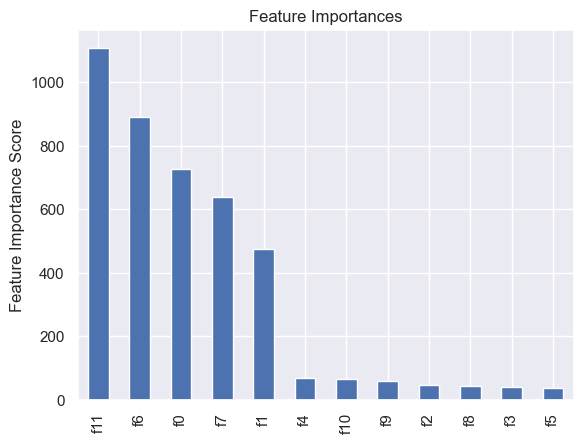

In [281]:
modelfit(XGBC_ex,X_train,Y_train)

In [280]:
XGBC_ex=xgb.XGBClassifier(eval_metric='auc',learning_rate =0.1,
 n_estimators=1000,
 max_depth=6,
 min_child_weight=3,
 gamma=0.3,
 subsample=0.8,
 colsample_bytree=0.3,
 objective= 'binary:logistic',
 reg_lambda=0.005,
 nthread=4,
 scale_pos_weight=4,       
 seed=27)

In [159]:
#Optimizing XGBOOST
params_xgb={
    'n_estimators':[int(x) for x in np.linspace(start=100, stop=400 , num=5)],
    'booster':['gbtree','gblinear','dart'],
    'eta':[0.05,0.1,0.2,0.3],
    'gamma':[0.0,0.1,0.2,0.3],
    'max_depth':[x for x in range(1,20,1)],
    'min_child_weight':[1,3,5,7],
    'subsample':[0.5,0.6,0.7,1],
    'colsample_bytree':[0.3,0.5,0.7,0.8,1],
    'reg_lambda':[0,0.5,1,3,5,8],
    'tree_method':['gpu_hist']
}

In [160]:
X_train.shape

(146429, 12)

In [151]:
l=[x for x in range(1,20,1)]
l

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]

In [69]:
param_grid={"lambda_l1":[x/100 for x in range(0,10,1)],"lambda_l2":[x/100 for x in range(0,10,1)]}

In [77]:
params_cat={
    'l2_leaf_reg':[0,0.1,0.001,0.0001],
    'bootstrap_type':["Bayesian","Bernoulli","MVS","Poisson"],
    'bagging_temperature':[0,1,2,3],
    'subsample':[0.5,0.6,0.7,0.8],
    'colsample_bytree':[0.3,0.5,0.7,0.8,1],
    'random_strength':[1,2,3,4],
    'depth':[2,4,6,8,10],
    'min_data_in_leaf':[1,2,3,4],
}

In [213]:
param_grid={'scale_pos_weight':[0.5,1]}

In [249]:
gsc=GridSearchCV(estimator=xgb.XGBClassifier( n_estimators=158,learning_rate=0.1,max_depth=6,min_child_weight= 3,subsample=0.8,
 colsample_bytree=0.3,gamma=0.3,objective= 'binary:logistic',reg_lambda=0.005,seed=27), 
 param_grid = param_grid, scoring='roc_auc', cv=5,n_jobs=-1)

In [70]:
gsc=GridSearchCV(estimator=LGBM.LGBMClassifier(n_estimators=95,learning_rate=0.1,num_leaves=18,max_depth=5,lambda_l1=0,
lambda_l2=0,min_child_weight=1,min_child_samples= 65,bagging_fraction= 0.6,bagging_freq= 1,feature_fraction= 0.3,
scale_pos_weight= 1,objective= 'binary',eval_metric="auc"),
param_grid = param_grid, scoring='roc_auc', cv=5,n_jobs=-1)

In [ ]:
l2_leaf_reg=0.1

In [214]:
gsc=GridSearchCV(estimator=CBC(learning_rate=0.1,iterations=772,bootstrap_type='MVS',subsample=0.6,depth=4,random_strength=3,l2_leaf_reg=3,
custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',eval_metric='AUC',cat_features=categorical_features_indices,
scale_pos_weight=1,thread_count=-1),
param_grid = param_grid, scoring='roc_auc', cv=5,n_jobs=-1)

In [215]:
X_train.shape

(146429, 10)

In [216]:
gsc.fit(X_train,Y_train)

0:	learn: 0.6634291	total: 96.6ms	remaining: 1m 14s
1:	learn: 0.7958390	total: 227ms	remaining: 1m 27s
2:	learn: 0.8645433	total: 355ms	remaining: 1m 31s
3:	learn: 0.9024551	total: 495ms	remaining: 1m 34s
4:	learn: 0.9024556	total: 621ms	remaining: 1m 35s
5:	learn: 0.9024557	total: 728ms	remaining: 1m 32s
6:	learn: 0.9186508	total: 852ms	remaining: 1m 33s
7:	learn: 0.9186507	total: 965ms	remaining: 1m 32s
8:	learn: 0.9186506	total: 1.08s	remaining: 1m 31s
9:	learn: 0.9186509	total: 1.2s	remaining: 1m 31s
10:	learn: 0.9186513	total: 1.31s	remaining: 1m 30s
11:	learn: 0.9412065	total: 1.45s	remaining: 1m 31s
12:	learn: 0.9412099	total: 1.58s	remaining: 1m 32s
13:	learn: 0.9418721	total: 1.71s	remaining: 1m 32s
14:	learn: 0.9418691	total: 1.85s	remaining: 1m 33s
15:	learn: 0.9452159	total: 1.98s	remaining: 1m 33s
16:	learn: 0.9491545	total: 2.11s	remaining: 1m 33s
17:	learn: 0.9581886	total: 2.23s	remaining: 1m 33s
18:	learn: 0.9682747	total: 2.35s	remaining: 1m 33s
19:	learn: 0.9704143	t

158:	learn: 0.9789396	total: 20.2s	remaining: 1m 18s
159:	learn: 0.9789401	total: 20.4s	remaining: 1m 17s
160:	learn: 0.9789411	total: 20.5s	remaining: 1m 17s
161:	learn: 0.9789705	total: 20.6s	remaining: 1m 17s
162:	learn: 0.9789872	total: 20.7s	remaining: 1m 17s
163:	learn: 0.9789887	total: 20.9s	remaining: 1m 17s
164:	learn: 0.9789962	total: 21s	remaining: 1m 17s
165:	learn: 0.9790078	total: 21.1s	remaining: 1m 17s
166:	learn: 0.9790143	total: 21.2s	remaining: 1m 16s
167:	learn: 0.9790089	total: 21.3s	remaining: 1m 16s
168:	learn: 0.9790188	total: 21.5s	remaining: 1m 16s
169:	learn: 0.9790191	total: 21.6s	remaining: 1m 16s
170:	learn: 0.9790230	total: 21.7s	remaining: 1m 16s
171:	learn: 0.9790251	total: 21.8s	remaining: 1m 16s
172:	learn: 0.9790252	total: 22s	remaining: 1m 16s
173:	learn: 0.9790340	total: 22.1s	remaining: 1m 15s
174:	learn: 0.9790399	total: 22.2s	remaining: 1m 15s
175:	learn: 0.9790451	total: 22.3s	remaining: 1m 15s
176:	learn: 0.9790482	total: 22.5s	remaining: 1m 1

316:	learn: 0.9803650	total: 40.4s	remaining: 58s
317:	learn: 0.9803647	total: 40.5s	remaining: 57.8s
318:	learn: 0.9803641	total: 40.6s	remaining: 57.7s
319:	learn: 0.9803649	total: 40.8s	remaining: 57.6s
320:	learn: 0.9804050	total: 40.9s	remaining: 57.5s
321:	learn: 0.9804069	total: 41s	remaining: 57.3s
322:	learn: 0.9804066	total: 41.2s	remaining: 57.2s
323:	learn: 0.9804157	total: 41.3s	remaining: 57.1s
324:	learn: 0.9804765	total: 41.4s	remaining: 57s
325:	learn: 0.9804775	total: 41.6s	remaining: 56.9s
326:	learn: 0.9804767	total: 41.7s	remaining: 56.7s
327:	learn: 0.9805122	total: 41.8s	remaining: 56.6s
328:	learn: 0.9805140	total: 41.9s	remaining: 56.4s
329:	learn: 0.9805292	total: 42s	remaining: 56.3s
330:	learn: 0.9805319	total: 42.2s	remaining: 56.2s
331:	learn: 0.9805420	total: 42.3s	remaining: 56s
332:	learn: 0.9805457	total: 42.4s	remaining: 55.9s
333:	learn: 0.9805509	total: 42.5s	remaining: 55.8s
334:	learn: 0.9805701	total: 42.7s	remaining: 55.6s
335:	learn: 0.9806167	

476:	learn: 0.9815592	total: 1m	remaining: 37.6s
477:	learn: 0.9815916	total: 1m	remaining: 37.5s
478:	learn: 0.9815918	total: 1m 1s	remaining: 37.4s
479:	learn: 0.9815930	total: 1m 1s	remaining: 37.3s
480:	learn: 0.9815943	total: 1m 1s	remaining: 37.1s
481:	learn: 0.9815960	total: 1m 1s	remaining: 37s
482:	learn: 0.9816038	total: 1m 1s	remaining: 36.9s
483:	learn: 0.9816089	total: 1m 1s	remaining: 36.7s
484:	learn: 0.9816089	total: 1m 1s	remaining: 36.6s
485:	learn: 0.9816113	total: 1m 2s	remaining: 36.5s
486:	learn: 0.9816106	total: 1m 2s	remaining: 36.4s
487:	learn: 0.9816177	total: 1m 2s	remaining: 36.2s
488:	learn: 0.9816206	total: 1m 2s	remaining: 36.1s
489:	learn: 0.9816210	total: 1m 2s	remaining: 36s
490:	learn: 0.9816473	total: 1m 2s	remaining: 35.8s
491:	learn: 0.9816603	total: 1m 2s	remaining: 35.7s
492:	learn: 0.9816737	total: 1m 2s	remaining: 35.6s
493:	learn: 0.9816759	total: 1m 3s	remaining: 35.5s
494:	learn: 0.9816771	total: 1m 3s	remaining: 35.3s
495:	learn: 0.9816780	

634:	learn: 0.9829488	total: 1m 21s	remaining: 17.6s
635:	learn: 0.9829533	total: 1m 21s	remaining: 17.5s
636:	learn: 0.9829561	total: 1m 22s	remaining: 17.4s
637:	learn: 0.9829575	total: 1m 22s	remaining: 17.3s
638:	learn: 0.9829610	total: 1m 22s	remaining: 17.1s
639:	learn: 0.9829920	total: 1m 22s	remaining: 17s
640:	learn: 0.9830032	total: 1m 22s	remaining: 16.9s
641:	learn: 0.9830231	total: 1m 22s	remaining: 16.7s
642:	learn: 0.9830233	total: 1m 22s	remaining: 16.6s
643:	learn: 0.9830302	total: 1m 22s	remaining: 16.5s
644:	learn: 0.9830308	total: 1m 23s	remaining: 16.4s
645:	learn: 0.9830385	total: 1m 23s	remaining: 16.2s
646:	learn: 0.9830487	total: 1m 23s	remaining: 16.1s
647:	learn: 0.9830493	total: 1m 23s	remaining: 16s
648:	learn: 0.9830488	total: 1m 23s	remaining: 15.8s
649:	learn: 0.9830489	total: 1m 23s	remaining: 15.7s
650:	learn: 0.9830494	total: 1m 23s	remaining: 15.6s
651:	learn: 0.9830604	total: 1m 23s	remaining: 15.5s
652:	learn: 0.9830606	total: 1m 24s	remaining: 15.

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x000001D9B10F8610>,
             n_jobs=-1, param_grid={'scale_pos_weight': [0.5, 1]},
             scoring='roc_auc')

In [217]:
gsc.best_params_,gsc.best_score_

({'scale_pos_weight': 1}, 0.9816380949199811)

In [109]:
gsc.best_params_,gsc.best_score_

({'depth': 4}, 0.981613031009854)

In [52]:
X_train.shape

(146429, 12)

In [60]:
import optuna

In [61]:
def objective(trial, X, y):
#     param_grid = {
#         # "device_type": trial.suggest_categorical("device_type", ['gpu']),
#         "max_iter": trial.suggest_int("max_iter", 50,1000),
#         "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
#         "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 10, 100, step=10),
#         "max_depth": trial.suggest_int("max_depth", 3, 12,step=1),
#         "l2_regularization": trial.suggest_float("l2_regularization", 0, 0.5),
#         "min_samples_leaf":trial.suggest_int("min_samples_leaf",10,300),
#     }
    param_grid={
        'iterations':trial.suggest_int('iterations',1,300),
        'learning_rate':trial.suggest_float("learning_rate", 1e-3, 1e-1, log=True),
        'l2_leaf_reg':trial.suggest_int('l2_leaf_reg',0,10),
        'bootstrap_type':trial.suggest_categorical('bootstrap_type',["Bayesian"]),
        'bagging_temperature':trial.suggest_float("bagging_temperature", 0.0, 10.0),
        'random_strength':trial.suggest_float('random_strength',0,10),
        'depth':trial.suggest_int('depth',1,12),
        'min_data_in_leaf':trial.suggest_float('min_data_in_leaf',1,300),
        'scale_pos_weight':trial.suggest_float('scale_pos_weight',1,5),
        'od_type':trial.suggest_categorical("od_type", ["IncToDec", "Iter"]),
        'od_wait':trial.suggest_int("od_wait", 10, 50),
    }

    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = CBC(custom_metric = 'AUC:hints=skip_train~false',loss_function='Logloss',
        eval_metric='AUC', **param_grid,task_type = 'GPU')
        model.fit(X_train,y_train,eval_set=(X_test,y_test),early_stopping_rounds=100)
        preds = model.predict_proba(X_test)[:,1]
        cv_scores[idx] = roc_auc_score(y_test, preds)

    return np.mean(cv_scores)

In [63]:
study = optuna.create_study(direction="maximize", study_name="CBC Classifier",storage='sqlite:///cbc_2.db')
func = lambda trial: objective(trial, X_train, Y_train)
study.optimize(func, n_trials=100)

[I 2023-07-08 01:49:15,365] A new study created in RDB with name: CBC Classifier
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5150499	best: 0.5150499 (0)	total: 50.2ms	remaining: 9.5s
1:	total: 63.2ms	remaining: 5.94s
2:	total: 75.6ms	remaining: 4.71s
3:	total: 85.4ms	remaining: 3.97s
4:	total: 93ms	remaining: 3.44s
5:	test: 0.5646618	best: 0.5730689 (1)	total: 104ms	remaining: 3.18s
6:	total: 115ms	remaining: 3s
7:	total: 132ms	remaining: 2.99s
8:	total: 141ms	remaining: 2.83s
9:	total: 150ms	remaining: 2.7s
10:	test: 0.5748866	best: 0.5773684 (6)	total: 158ms	remaining: 2.56s
11:	total: 168ms	remaining: 2.49s
12:	total: 179ms	remaining: 2.44s
13:	total: 187ms	remaining: 2.35s
14:	total: 198ms	remaining: 2.31s
15:	test: 0.5812929	best: 0.5812929 (15)	total: 212ms	remaining: 2.31s
16:	total: 225ms	remaining: 2.29s
17:	total: 237ms	remaining: 2.26s
18:	total: 248ms	remaining: 2.23s
19:	total: 258ms	remaining: 2.2s
20:	test: 0.5810552	best: 0.5829616 (19)	total: 274ms	remaining: 2.2s
21:	total: 285ms	remaining: 2.18s
22:	total: 296ms	remaining: 2.15s
23:	total: 307ms	remaining: 2.13s
24:	total: 318ms

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5286219	best: 0.5286219 (0)	total: 14.2ms	remaining: 2.69s
1:	total: 26.9ms	remaining: 2.53s
2:	total: 38ms	remaining: 2.37s
3:	total: 50.8ms	remaining: 2.36s
4:	total: 63.2ms	remaining: 2.34s
5:	test: 0.5682694	best: 0.5687368 (3)	total: 80.6ms	remaining: 2.47s
6:	total: 94ms	remaining: 2.46s
7:	total: 106ms	remaining: 2.41s
8:	total: 120ms	remaining: 2.42s
9:	total: 134ms	remaining: 2.42s
10:	test: 0.5756188	best: 0.5756188 (10)	total: 148ms	remaining: 2.4s
11:	total: 159ms	remaining: 2.36s
12:	total: 171ms	remaining: 2.33s
13:	total: 184ms	remaining: 2.31s
14:	total: 197ms	remaining: 2.3s
15:	test: 0.5841269	best: 0.5841466 (14)	total: 208ms	remaining: 2.26s
16:	total: 223ms	remaining: 2.27s
17:	total: 238ms	remaining: 2.27s
18:	total: 254ms	remaining: 2.28s
19:	total: 273ms	remaining: 2.32s
20:	test: 0.5836143	best: 0.5859641 (18)	total: 282ms	remaining: 2.27s
21:	total: 294ms	remaining: 2.25s
22:	total: 306ms	remaining: 2.22s
23:	total: 319ms	remaining: 2.21s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5278187	best: 0.5278187 (0)	total: 22.4ms	remaining: 4.22s
1:	total: 35.2ms	remaining: 3.31s
2:	total: 45.6ms	remaining: 2.84s
3:	total: 58.4ms	remaining: 2.71s
4:	total: 71.6ms	remaining: 2.65s
5:	test: 0.5768732	best: 0.5925431 (3)	total: 84.8ms	remaining: 2.6s
6:	total: 97.5ms	remaining: 2.55s
7:	total: 111ms	remaining: 2.52s
8:	total: 122ms	remaining: 2.46s
9:	total: 138ms	remaining: 2.48s
10:	test: 0.5795189	best: 0.5925431 (3)	total: 150ms	remaining: 2.44s
11:	total: 161ms	remaining: 2.39s
12:	total: 173ms	remaining: 2.36s
13:	total: 185ms	remaining: 2.33s
14:	total: 198ms	remaining: 2.31s
15:	test: 0.5782459	best: 0.5925431 (3)	total: 213ms	remaining: 2.32s
16:	total: 229ms	remaining: 2.33s
17:	total: 245ms	remaining: 2.34s
18:	total: 256ms	remaining: 2.3s
19:	total: 272ms	remaining: 2.31s
20:	test: 0.5870588	best: 0.5925431 (3)	total: 285ms	remaining: 2.29s
21:	total: 300ms	remaining: 2.29s
22:	total: 313ms	remaining: 2.27s
23:	total: 324ms	remaining: 2.24s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5402815	best: 0.5402815 (0)	total: 17.9ms	remaining: 3.38s
1:	total: 31.2ms	remaining: 2.93s
2:	total: 43.5ms	remaining: 2.71s
3:	total: 58.6ms	remaining: 2.73s
4:	total: 72.2ms	remaining: 2.67s
5:	test: 0.5770089	best: 0.5794107 (4)	total: 86.7ms	remaining: 2.66s
6:	total: 101ms	remaining: 2.64s
7:	total: 115ms	remaining: 2.61s
8:	total: 132ms	remaining: 2.66s
9:	total: 145ms	remaining: 2.61s
10:	test: 0.5846756	best: 0.5846756 (10)	total: 157ms	remaining: 2.56s
11:	total: 199ms	remaining: 2.96s
12:	total: 215ms	remaining: 2.92s
13:	total: 226ms	remaining: 2.84s
14:	total: 235ms	remaining: 2.74s
15:	test: 0.5958598	best: 0.5958598 (15)	total: 244ms	remaining: 2.65s
16:	total: 252ms	remaining: 2.56s
17:	total: 260ms	remaining: 2.48s
18:	total: 270ms	remaining: 2.43s
19:	total: 284ms	remaining: 2.41s
20:	test: 0.6006839	best: 0.6006839 (20)	total: 296ms	remaining: 2.38s
21:	total: 308ms	remaining: 2.35s
22:	total: 324ms	remaining: 2.35s
23:	total: 336ms	remaining: 2.33s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5292973	best: 0.5292973 (0)	total: 15.8ms	remaining: 2.99s
1:	total: 31.6ms	remaining: 2.97s
2:	total: 43.4ms	remaining: 2.71s
3:	total: 55.2ms	remaining: 2.56s
4:	total: 66.7ms	remaining: 2.47s
5:	test: 0.5407879	best: 0.5407879 (5)	total: 81.5ms	remaining: 2.5s
6:	total: 92.1ms	remaining: 2.41s
7:	total: 104ms	remaining: 2.36s
8:	total: 117ms	remaining: 2.35s
9:	total: 127ms	remaining: 2.29s
10:	test: 0.5457312	best: 0.5469002 (8)	total: 143ms	remaining: 2.33s
11:	total: 158ms	remaining: 2.34s
12:	total: 179ms	remaining: 2.43s
13:	total: 192ms	remaining: 2.42s
14:	total: 204ms	remaining: 2.38s
15:	test: 0.5418734	best: 0.5469002 (8)	total: 219ms	remaining: 2.38s
16:	total: 235ms	remaining: 2.39s
17:	total: 248ms	remaining: 2.37s
18:	total: 262ms	remaining: 2.36s
19:	total: 275ms	remaining: 2.33s
20:	test: 0.5453154	best: 0.5469002 (8)	total: 288ms	remaining: 2.32s
21:	total: 300ms	remaining: 2.29s
22:	total: 308ms	remaining: 2.24s
23:	total: 319ms	remaining: 2.2s
24:	total

[I 2023-07-08 01:49:30,525] Trial 0 finished with value: 0.5871585142017881 and parameters: {'iterations': 190, 'learning_rate': 0.013448404942495171, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.966185480944478, 'random_strength': 8.166684959840612, 'depth': 5, 'min_data_in_leaf': 100.95065148469872, 'scale_pos_weight': 1.1809550660090702, 'od_type': 'IncToDec', 'od_wait': 21}. Best is trial 0 with value: 0.5871585142017881.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5478620	best: 0.5478620 (0)	total: 45.7ms	remaining: 13.5s
1:	total: 83.4ms	remaining: 12.3s
2:	total: 122ms	remaining: 11.9s
3:	total: 159ms	remaining: 11.6s
4:	total: 197ms	remaining: 11.5s
5:	test: 0.5638759	best: 0.5644987 (4)	total: 236ms	remaining: 11.4s
6:	total: 274ms	remaining: 11.3s
7:	total: 299ms	remaining: 10.8s
8:	total: 326ms	remaining: 10.4s
9:	total: 357ms	remaining: 10.2s
10:	test: 0.5684213	best: 0.5707802 (6)	total: 387ms	remaining: 10s
11:	total: 415ms	remaining: 9.82s
12:	total: 446ms	remaining: 9.7s
13:	total: 477ms	remaining: 9.61s
14:	total: 506ms	remaining: 9.47s
15:	test: 0.5687089	best: 0.5707802 (6)	total: 532ms	remaining: 9.3s
16:	total: 555ms	remaining: 9.11s
17:	total: 578ms	remaining: 8.93s
18:	total: 608ms	remaining: 8.86s
19:	total: 636ms	remaining: 8.78s
20:	test: 0.5731296	best: 0.5731296 (20)	total: 664ms	remaining: 8.7s
21:	total: 692ms	remaining: 8.62s
22:	total: 723ms	remaining: 8.58s
23:	total: 752ms	remaining: 8.53s
24:	total: 781ms

196:	total: 5.91s	remaining: 2.97s
197:	total: 5.95s	remaining: 2.94s
198:	total: 5.97s	remaining: 2.91s
199:	total: 6s	remaining: 2.88s
200:	test: 0.5886183	best: 0.5887698 (138)	total: 6.03s	remaining: 2.85s
201:	total: 6.06s	remaining: 2.82s
202:	total: 6.09s	remaining: 2.79s
203:	total: 6.12s	remaining: 2.76s
204:	total: 6.15s	remaining: 2.73s
205:	test: 0.5883007	best: 0.5887698 (138)	total: 6.18s	remaining: 2.7s
206:	total: 6.21s	remaining: 2.67s
207:	total: 6.24s	remaining: 2.64s
208:	total: 6.27s	remaining: 2.61s
209:	total: 6.3s	remaining: 2.58s
210:	test: 0.5879538	best: 0.5887698 (138)	total: 6.32s	remaining: 2.55s
211:	total: 6.36s	remaining: 2.52s
212:	total: 6.39s	remaining: 2.49s
213:	total: 6.42s	remaining: 2.46s
214:	total: 6.45s	remaining: 2.43s
215:	test: 0.5886006	best: 0.5890149 (213)	total: 6.48s	remaining: 2.4s
216:	total: 6.51s	remaining: 2.37s
217:	total: 6.54s	remaining: 2.34s
218:	total: 6.57s	remaining: 2.31s
219:	total: 6.59s	remaining: 2.28s
220:	test: 0.5

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5320116	best: 0.5320116 (0)	total: 33ms	remaining: 9.74s
1:	total: 61.5ms	remaining: 9.04s
2:	total: 91.4ms	remaining: 8.93s
3:	total: 121ms	remaining: 8.83s
4:	total: 151ms	remaining: 8.79s
5:	test: 0.5724987	best: 0.5724987 (5)	total: 184ms	remaining: 8.91s
6:	total: 219ms	remaining: 9.02s
7:	total: 246ms	remaining: 8.85s
8:	total: 272ms	remaining: 8.68s
9:	total: 295ms	remaining: 8.44s
10:	test: 0.5746058	best: 0.5755355 (6)	total: 327ms	remaining: 8.47s
11:	total: 358ms	remaining: 8.47s
12:	total: 382ms	remaining: 8.32s
13:	total: 412ms	remaining: 8.3s
14:	total: 438ms	remaining: 8.21s
15:	test: 0.5760162	best: 0.5809191 (14)	total: 469ms	remaining: 8.21s
16:	total: 502ms	remaining: 8.24s
17:	total: 533ms	remaining: 8.23s
18:	total: 565ms	remaining: 8.24s
19:	total: 605ms	remaining: 8.35s
20:	test: 0.5727742	best: 0.5809191 (14)	total: 636ms	remaining: 8.33s
21:	total: 662ms	remaining: 8.24s
22:	total: 695ms	remaining: 8.25s
23:	total: 728ms	remaining: 8.26s
24:	total: 7

199:	total: 6.1s	remaining: 2.93s
200:	test: 0.5806125	best: 0.5833183 (161)	total: 6.13s	remaining: 2.9s
201:	total: 6.16s	remaining: 2.86s
202:	total: 6.18s	remaining: 2.83s
203:	total: 6.21s	remaining: 2.8s
204:	total: 6.24s	remaining: 2.77s
205:	test: 0.5808139	best: 0.5833183 (161)	total: 6.27s	remaining: 2.74s
206:	total: 6.3s	remaining: 2.71s
207:	total: 6.33s	remaining: 2.68s
208:	total: 6.37s	remaining: 2.65s
209:	total: 6.4s	remaining: 2.62s
210:	test: 0.5816829	best: 0.5833183 (161)	total: 6.42s	remaining: 2.59s
211:	total: 6.45s	remaining: 2.56s
212:	total: 6.48s	remaining: 2.52s
213:	total: 6.51s	remaining: 2.49s
214:	total: 6.54s	remaining: 2.46s
215:	test: 0.5814695	best: 0.5833183 (161)	total: 6.57s	remaining: 2.43s
216:	total: 6.6s	remaining: 2.4s
217:	total: 6.64s	remaining: 2.37s
218:	total: 6.67s	remaining: 2.34s
219:	total: 6.7s	remaining: 2.31s
220:	test: 0.5810565	best: 0.5833183 (161)	total: 6.72s	remaining: 2.28s
221:	total: 6.75s	remaining: 2.25s
222:	total: 6

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5525321	best: 0.5525321 (0)	total: 32.3ms	remaining: 9.53s
1:	total: 60.4ms	remaining: 8.88s
2:	total: 89.1ms	remaining: 8.7s
3:	total: 115ms	remaining: 8.43s
4:	total: 146ms	remaining: 8.51s
5:	test: 0.5856935	best: 0.5868811 (4)	total: 176ms	remaining: 8.53s
6:	total: 205ms	remaining: 8.46s
7:	total: 234ms	remaining: 8.43s
8:	total: 266ms	remaining: 8.48s
9:	total: 294ms	remaining: 8.42s
10:	test: 0.5990765	best: 0.5992188 (9)	total: 322ms	remaining: 8.34s
11:	total: 351ms	remaining: 8.3s
12:	total: 380ms	remaining: 8.27s
13:	total: 412ms	remaining: 8.3s
14:	total: 442ms	remaining: 8.28s
15:	test: 0.6041896	best: 0.6043987 (14)	total: 472ms	remaining: 8.25s
16:	total: 502ms	remaining: 8.24s
17:	total: 532ms	remaining: 8.22s
18:	total: 562ms	remaining: 8.2s
19:	total: 590ms	remaining: 8.14s
20:	test: 0.6041832	best: 0.6057477 (19)	total: 622ms	remaining: 8.15s
21:	total: 652ms	remaining: 8.12s
22:	total: 685ms	remaining: 8.13s
23:	total: 714ms	remaining: 8.09s
24:	total: 74

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5428790	best: 0.5428790 (0)	total: 31.8ms	remaining: 9.38s
1:	total: 63.4ms	remaining: 9.31s
2:	total: 93.4ms	remaining: 9.12s
3:	total: 122ms	remaining: 8.88s
4:	total: 149ms	remaining: 8.69s
5:	test: 0.5731932	best: 0.5749829 (4)	total: 180ms	remaining: 8.69s
6:	total: 219ms	remaining: 9.02s
7:	total: 250ms	remaining: 8.98s
8:	total: 277ms	remaining: 8.83s
9:	total: 307ms	remaining: 8.77s
10:	test: 0.5885543	best: 0.5885543 (10)	total: 336ms	remaining: 8.71s
11:	total: 368ms	remaining: 8.72s
12:	total: 405ms	remaining: 8.81s
13:	total: 433ms	remaining: 8.73s
14:	total: 465ms	remaining: 8.7s
15:	test: 0.5835091	best: 0.5885543 (10)	total: 496ms	remaining: 8.69s
16:	total: 523ms	remaining: 8.59s
17:	total: 548ms	remaining: 8.47s
18:	total: 579ms	remaining: 8.44s
19:	total: 610ms	remaining: 8.42s
20:	test: 0.5876029	best: 0.5885543 (10)	total: 643ms	remaining: 8.41s
21:	total: 672ms	remaining: 8.37s
22:	total: 701ms	remaining: 8.32s
23:	total: 728ms	remaining: 8.26s
24:	total

200:	test: 0.5957430	best: 0.6006853 (142)	total: 5.83s	remaining: 2.75s
201:	total: 5.86s	remaining: 2.73s
202:	total: 5.89s	remaining: 2.7s
203:	total: 5.92s	remaining: 2.67s
204:	total: 5.95s	remaining: 2.64s
205:	test: 0.5958686	best: 0.6006853 (142)	total: 5.97s	remaining: 2.61s
206:	total: 6s	remaining: 2.58s
207:	total: 6.03s	remaining: 2.55s
208:	total: 6.06s	remaining: 2.52s
209:	total: 6.09s	remaining: 2.49s
210:	test: 0.5959447	best: 0.6006853 (142)	total: 6.12s	remaining: 2.46s
211:	total: 6.15s	remaining: 2.44s
212:	total: 6.19s	remaining: 2.41s
213:	total: 6.21s	remaining: 2.38s
214:	total: 6.25s	remaining: 2.35s
215:	test: 0.5959659	best: 0.6006853 (142)	total: 6.27s	remaining: 2.32s
216:	total: 6.3s	remaining: 2.29s
217:	total: 6.33s	remaining: 2.27s
218:	total: 6.36s	remaining: 2.24s
219:	total: 6.39s	remaining: 2.21s
220:	test: 0.5955555	best: 0.6006853 (142)	total: 6.42s	remaining: 2.18s
221:	total: 6.45s	remaining: 2.15s
222:	total: 6.48s	remaining: 2.12s
223:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5285231	best: 0.5285231 (0)	total: 33.8ms	remaining: 9.96s
1:	total: 64ms	remaining: 9.4s
2:	total: 94.7ms	remaining: 9.25s
3:	total: 126ms	remaining: 9.22s
4:	total: 156ms	remaining: 9.07s
5:	test: 0.5285412	best: 0.5293635 (1)	total: 186ms	remaining: 8.97s
6:	total: 218ms	remaining: 9.02s
7:	total: 248ms	remaining: 8.95s
8:	total: 276ms	remaining: 8.79s
9:	total: 303ms	remaining: 8.67s
10:	test: 0.5392544	best: 0.5392544 (10)	total: 331ms	remaining: 8.58s
11:	total: 358ms	remaining: 8.48s
12:	total: 385ms	remaining: 8.38s
13:	total: 409ms	remaining: 8.24s
14:	total: 437ms	remaining: 8.19s
15:	test: 0.5413218	best: 0.5428323 (14)	total: 473ms	remaining: 8.27s
16:	total: 506ms	remaining: 8.31s
17:	total: 538ms	remaining: 8.3s
18:	total: 568ms	remaining: 8.28s
19:	total: 597ms	remaining: 8.24s
20:	test: 0.5449365	best: 0.5449365 (20)	total: 630ms	remaining: 8.26s
21:	total: 662ms	remaining: 8.24s
22:	total: 695ms	remaining: 8.24s
23:	total: 724ms	remaining: 8.2s
24:	total: 75

[I 2023-07-08 01:50:05,915] Trial 1 finished with value: 0.5871031056861626 and parameters: {'iterations': 296, 'learning_rate': 0.01560410813824633, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 9.75791331266122, 'random_strength': 5.14759149422125, 'depth': 10, 'min_data_in_leaf': 158.16303416578128, 'scale_pos_weight': 1.9642850148645858, 'od_type': 'Iter', 'od_wait': 30}. Best is trial 0 with value: 0.5871585142017881.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5479566	best: 0.5479566 (0)	total: 43ms	remaining: 6.53s
1:	total: 86.6ms	remaining: 6.54s
2:	total: 126ms	remaining: 6.3s
3:	total: 168ms	remaining: 6.27s
4:	total: 212ms	remaining: 6.28s
5:	test: 0.5690240	best: 0.5694867 (4)	total: 253ms	remaining: 6.2s
6:	total: 296ms	remaining: 6.17s
7:	total: 337ms	remaining: 6.1s
8:	total: 382ms	remaining: 6.11s
9:	total: 425ms	remaining: 6.07s
10:	test: 0.5655531	best: 0.5724196 (8)	total: 466ms	remaining: 6.01s
11:	total: 507ms	remaining: 5.96s
12:	total: 551ms	remaining: 5.93s
13:	total: 600ms	remaining: 5.95s
14:	total: 641ms	remaining: 5.89s
15:	test: 0.5603351	best: 0.5724196 (8)	total: 683ms	remaining: 5.84s
16:	total: 725ms	remaining: 5.8s
17:	total: 764ms	remaining: 5.73s
18:	total: 806ms	remaining: 5.69s
19:	total: 848ms	remaining: 5.64s
20:	test: 0.5473011	best: 0.5724196 (8)	total: 891ms	remaining: 5.6s
21:	total: 934ms	remaining: 5.56s
22:	total: 978ms	remaining: 5.53s
23:	total: 1.02s	remaining: 5.48s
24:	total: 1.06s	re

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5388923	best: 0.5388923 (0)	total: 46.3ms	remaining: 7.03s
1:	total: 89.7ms	remaining: 6.77s
2:	total: 130ms	remaining: 6.49s
3:	total: 168ms	remaining: 6.26s
4:	total: 206ms	remaining: 6.1s
5:	test: 0.5600606	best: 0.5614015 (4)	total: 244ms	remaining: 5.99s
6:	total: 287ms	remaining: 5.98s
7:	total: 323ms	remaining: 5.86s
8:	total: 360ms	remaining: 5.76s
9:	total: 399ms	remaining: 5.71s
10:	test: 0.5570673	best: 0.5639091 (7)	total: 441ms	remaining: 5.7s
11:	total: 485ms	remaining: 5.69s
12:	total: 526ms	remaining: 5.67s
13:	total: 570ms	remaining: 5.66s
14:	total: 609ms	remaining: 5.6s
15:	test: 0.5563237	best: 0.5639091 (7)	total: 652ms	remaining: 5.58s
16:	total: 697ms	remaining: 5.58s
17:	total: 739ms	remaining: 5.54s
18:	total: 781ms	remaining: 5.51s
19:	total: 824ms	remaining: 5.48s
20:	test: 0.5539829	best: 0.5639091 (7)	total: 867ms	remaining: 5.45s
21:	total: 918ms	remaining: 5.47s
22:	total: 957ms	remaining: 5.41s
23:	total: 999ms	remaining: 5.37s
24:	total: 1.04

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5856101	best: 0.5856101 (0)	total: 41.4ms	remaining: 6.3s
1:	total: 80.3ms	remaining: 6.07s
2:	total: 121ms	remaining: 6.05s
3:	total: 162ms	remaining: 6.04s
4:	total: 210ms	remaining: 6.22s
5:	test: 0.5828146	best: 0.5879704 (4)	total: 251ms	remaining: 6.15s
6:	total: 295ms	remaining: 6.14s
7:	total: 342ms	remaining: 6.19s
8:	total: 387ms	remaining: 6.2s
9:	total: 429ms	remaining: 6.13s
10:	test: 0.5779159	best: 0.5879704 (4)	total: 477ms	remaining: 6.16s
11:	total: 518ms	remaining: 6.09s
12:	total: 564ms	remaining: 6.07s
13:	total: 602ms	remaining: 5.98s
14:	total: 644ms	remaining: 5.92s
15:	test: 0.5791321	best: 0.5879704 (4)	total: 689ms	remaining: 5.9s
16:	total: 730ms	remaining: 5.84s
17:	total: 772ms	remaining: 5.79s
18:	total: 810ms	remaining: 5.71s
19:	total: 849ms	remaining: 5.65s
20:	test: 0.5833611	best: 0.5879704 (4)	total: 892ms	remaining: 5.61s
21:	total: 932ms	remaining: 5.55s
22:	total: 974ms	remaining: 5.5s
23:	total: 1.02s	remaining: 5.46s
24:	total: 1.06s

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5578229	best: 0.5578229 (0)	total: 57ms	remaining: 8.67s
1:	total: 98ms	remaining: 7.4s
2:	total: 138ms	remaining: 6.9s
3:	total: 180ms	remaining: 6.69s
4:	total: 222ms	remaining: 6.57s
5:	test: 0.5505383	best: 0.5578229 (0)	total: 263ms	remaining: 6.45s
6:	total: 306ms	remaining: 6.38s
7:	total: 347ms	remaining: 6.28s
8:	total: 395ms	remaining: 6.31s
9:	total: 436ms	remaining: 6.23s
10:	test: 0.5388103	best: 0.5578229 (0)	total: 477ms	remaining: 6.16s
11:	total: 519ms	remaining: 6.1s
12:	total: 567ms	remaining: 6.11s
13:	total: 612ms	remaining: 6.07s
14:	total: 657ms	remaining: 6.04s
15:	test: 0.5384190	best: 0.5578229 (0)	total: 697ms	remaining: 5.97s
16:	total: 738ms	remaining: 5.9s
17:	total: 776ms	remaining: 5.82s
18:	total: 818ms	remaining: 5.77s
19:	total: 861ms	remaining: 5.72s
20:	test: 0.5384678	best: 0.5578229 (0)	total: 921ms	remaining: 5.79s
21:	total: 967ms	remaining: 5.76s
22:	total: 1.01s	remaining: 5.71s
23:	total: 1.05s	remaining: 5.65s
24:	total: 1.09s	rem

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5476486	best: 0.5476486 (0)	total: 65.9ms	remaining: 10s
1:	total: 110ms	remaining: 8.28s
2:	total: 151ms	remaining: 7.55s
3:	total: 197ms	remaining: 7.34s
4:	total: 262ms	remaining: 7.75s
5:	test: 0.5244676	best: 0.5476486 (0)	total: 301ms	remaining: 7.38s
6:	total: 342ms	remaining: 7.13s
7:	total: 392ms	remaining: 7.11s
8:	total: 433ms	remaining: 6.92s
9:	total: 473ms	remaining: 6.76s
10:	test: 0.5232691	best: 0.5476486 (0)	total: 518ms	remaining: 6.69s
11:	total: 556ms	remaining: 6.53s
12:	total: 594ms	remaining: 6.4s
13:	total: 633ms	remaining: 6.28s
14:	total: 678ms	remaining: 6.24s
15:	test: 0.5263018	best: 0.5476486 (0)	total: 724ms	remaining: 6.2s
16:	total: 764ms	remaining: 6.11s
17:	total: 809ms	remaining: 6.07s
18:	total: 844ms	remaining: 5.96s
19:	total: 886ms	remaining: 5.89s
20:	test: 0.5198052	best: 0.5476486 (0)	total: 935ms	remaining: 5.88s
21:	total: 975ms	remaining: 5.8s
22:	total: 1.02s	remaining: 5.76s
23:	total: 1.06s	remaining: 5.72s
24:	total: 1.1s	re

[I 2023-07-08 01:50:32,671] Trial 2 finished with value: 0.5678645685882777 and parameters: {'iterations': 153, 'learning_rate': 0.001715816604390836, 'l2_leaf_reg': 0, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.729922869561286, 'random_strength': 6.842910346886701, 'depth': 11, 'min_data_in_leaf': 46.702604782392726, 'scale_pos_weight': 3.0026769920104055, 'od_type': 'Iter', 'od_wait': 34}. Best is trial 0 with value: 0.5871585142017881.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5252440	best: 0.5252440 (0)	total: 15.4ms	remaining: 4.14s
1:	total: 25.5ms	remaining: 3.4s
2:	total: 35.2ms	remaining: 3.12s
3:	total: 45.4ms	remaining: 3.01s
4:	total: 55.2ms	remaining: 2.91s
5:	test: 0.5270020	best: 0.5340756 (4)	total: 75.4ms	remaining: 3.3s
6:	total: 84ms	remaining: 3.14s
7:	total: 89.7ms	remaining: 2.92s
8:	total: 100ms	remaining: 2.89s
9:	total: 111ms	remaining: 2.87s
10:	test: 0.5619748	best: 0.5685874 (9)	total: 121ms	remaining: 2.83s
11:	total: 131ms	remaining: 2.8s
12:	total: 142ms	remaining: 2.79s
13:	total: 153ms	remaining: 2.78s
14:	total: 161ms	remaining: 2.72s
15:	test: 0.5604767	best: 0.5685874 (9)	total: 173ms	remaining: 2.74s
16:	total: 182ms	remaining: 2.69s
17:	total: 193ms	remaining: 2.69s
18:	total: 204ms	remaining: 2.69s
19:	total: 214ms	remaining: 2.67s
20:	test: 0.5588017	best: 0.5685874 (9)	total: 224ms	remaining: 2.65s
21:	total: 234ms	remaining: 2.63s
22:	total: 248ms	remaining: 2.65s
23:	total: 259ms	remaining: 2.65s
24:	total: 

203:	total: 2.29s	remaining: 728ms
204:	total: 2.3s	remaining: 717ms
205:	test: 0.5825310	best: 0.5826539 (192)	total: 2.31s	remaining: 706ms
206:	total: 2.32s	remaining: 695ms
207:	total: 2.33s	remaining: 683ms
208:	total: 2.34s	remaining: 672ms
209:	total: 2.36s	remaining: 662ms
210:	test: 0.5823529	best: 0.5826539 (192)	total: 2.37s	remaining: 651ms
211:	total: 2.38s	remaining: 640ms
212:	total: 2.39s	remaining: 629ms
213:	total: 2.4s	remaining: 617ms
214:	total: 2.41s	remaining: 606ms
215:	test: 0.5830735	best: 0.5831435 (214)	total: 2.42s	remaining: 595ms
216:	total: 2.44s	remaining: 585ms
217:	total: 2.45s	remaining: 574ms
218:	total: 2.46s	remaining: 563ms
219:	total: 2.47s	remaining: 551ms
220:	test: 0.5830714	best: 0.5833014 (218)	total: 2.48s	remaining: 540ms
221:	total: 2.5s	remaining: 529ms
222:	total: 2.51s	remaining: 518ms
223:	total: 2.52s	remaining: 507ms
224:	total: 2.53s	remaining: 495ms
225:	test: 0.5828178	best: 0.5833014 (218)	total: 2.55s	remaining: 485ms
226:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5240871	best: 0.5240871 (0)	total: 13.6ms	remaining: 3.64s
1:	total: 26.6ms	remaining: 3.55s
2:	total: 36.1ms	remaining: 3.2s
3:	total: 46.5ms	remaining: 3.08s
4:	total: 55.3ms	remaining: 2.92s
5:	test: 0.5594686	best: 0.5606463 (4)	total: 67.8ms	remaining: 2.97s
6:	total: 80.1ms	remaining: 3s
7:	total: 92.7ms	remaining: 3.02s
8:	total: 105ms	remaining: 3.04s
9:	total: 118ms	remaining: 3.06s
10:	test: 0.5720498	best: 0.5720498 (10)	total: 128ms	remaining: 2.99s
11:	total: 136ms	remaining: 2.91s
12:	total: 148ms	remaining: 2.91s
13:	total: 161ms	remaining: 2.93s
14:	total: 173ms	remaining: 2.93s
15:	test: 0.5759283	best: 0.5759283 (15)	total: 183ms	remaining: 2.9s
16:	total: 195ms	remaining: 2.89s
17:	total: 205ms	remaining: 2.86s
18:	total: 215ms	remaining: 2.83s
19:	total: 226ms	remaining: 2.81s
20:	test: 0.5744033	best: 0.5764115 (16)	total: 236ms	remaining: 2.79s
21:	total: 246ms	remaining: 2.76s
22:	total: 255ms	remaining: 2.73s
23:	total: 263ms	remaining: 2.68s
24:	tota

206:	total: 2.3s	remaining: 688ms
207:	total: 2.31s	remaining: 679ms
208:	total: 2.33s	remaining: 669ms
209:	total: 2.35s	remaining: 659ms
210:	test: 0.5891269	best: 0.5891269 (210)	total: 2.36s	remaining: 649ms
211:	total: 2.37s	remaining: 638ms
212:	total: 2.38s	remaining: 627ms
213:	total: 2.4s	remaining: 616ms
214:	total: 2.41s	remaining: 604ms
215:	test: 0.5896381	best: 0.5896381 (215)	total: 2.42s	remaining: 593ms
216:	total: 2.43s	remaining: 582ms
217:	total: 2.44s	remaining: 571ms
218:	total: 2.45s	remaining: 559ms
219:	total: 2.46s	remaining: 549ms
220:	test: 0.5899383	best: 0.5900118 (217)	total: 2.48s	remaining: 538ms
221:	total: 2.49s	remaining: 527ms
222:	total: 2.5s	remaining: 515ms
223:	total: 2.51s	remaining: 504ms
224:	total: 2.52s	remaining: 493ms
225:	test: 0.5902993	best: 0.5903749 (224)	total: 2.53s	remaining: 482ms
226:	total: 2.54s	remaining: 471ms
227:	total: 2.55s	remaining: 459ms
228:	total: 2.56s	remaining: 447ms
229:	total: 2.57s	remaining: 435ms
230:	test: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5162290	best: 0.5162290 (0)	total: 14.2ms	remaining: 3.82s
1:	total: 25.5ms	remaining: 3.4s
2:	total: 39.9ms	remaining: 3.54s
3:	total: 54.7ms	remaining: 3.62s
4:	total: 68.9ms	remaining: 3.64s
5:	test: 0.5839499	best: 0.5839499 (5)	total: 83.3ms	remaining: 3.65s
6:	total: 95ms	remaining: 3.55s
7:	total: 105ms	remaining: 3.41s
8:	total: 114ms	remaining: 3.3s
9:	total: 122ms	remaining: 3.16s
10:	test: 0.5786273	best: 0.5889051 (6)	total: 135ms	remaining: 3.15s
11:	total: 147ms	remaining: 3.14s
12:	total: 156ms	remaining: 3.08s
13:	total: 166ms	remaining: 3.02s
14:	total: 176ms	remaining: 2.98s
15:	test: 0.5776157	best: 0.5889051 (6)	total: 187ms	remaining: 2.95s
16:	total: 205ms	remaining: 3.03s
17:	total: 214ms	remaining: 2.99s
18:	total: 223ms	remaining: 2.94s
19:	total: 234ms	remaining: 2.91s
20:	test: 0.5744387	best: 0.5889051 (6)	total: 248ms	remaining: 2.93s
21:	total: 262ms	remaining: 2.94s
22:	total: 276ms	remaining: 2.96s
23:	total: 288ms	remaining: 2.94s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5307339	best: 0.5307339 (0)	total: 15.3ms	remaining: 4.09s
1:	total: 26.7ms	remaining: 3.57s
2:	total: 38.3ms	remaining: 3.39s
3:	total: 49.7ms	remaining: 3.29s
4:	total: 61.2ms	remaining: 3.23s
5:	test: 0.5425598	best: 0.5425598 (5)	total: 71.3ms	remaining: 3.12s
6:	total: 82ms	remaining: 3.07s
7:	total: 92ms	remaining: 3s
8:	total: 102ms	remaining: 2.96s
9:	total: 112ms	remaining: 2.91s
10:	test: 0.5421225	best: 0.5425627 (9)	total: 124ms	remaining: 2.92s
11:	total: 135ms	remaining: 2.88s
12:	total: 145ms	remaining: 2.85s
13:	total: 155ms	remaining: 2.83s
14:	total: 165ms	remaining: 2.79s
15:	test: 0.5692604	best: 0.5697954 (14)	total: 175ms	remaining: 2.76s
16:	total: 183ms	remaining: 2.71s
17:	total: 191ms	remaining: 2.67s
18:	total: 219ms	remaining: 2.88s
19:	total: 229ms	remaining: 2.85s
20:	test: 0.5859805	best: 0.5882840 (19)	total: 239ms	remaining: 2.82s
21:	total: 248ms	remaining: 2.79s
22:	total: 257ms	remaining: 2.75s
23:	total: 267ms	remaining: 2.72s
24:	total: 

205:	test: 0.6031207	best: 0.6031207 (205)	total: 2.09s	remaining: 640ms
206:	total: 2.1s	remaining: 630ms
207:	total: 2.11s	remaining: 620ms
208:	total: 2.12s	remaining: 609ms
209:	total: 2.13s	remaining: 599ms
210:	test: 0.6025694	best: 0.6032714 (206)	total: 2.14s	remaining: 589ms
211:	total: 2.15s	remaining: 578ms
212:	total: 2.16s	remaining: 568ms
213:	total: 2.17s	remaining: 558ms
214:	total: 2.18s	remaining: 548ms
215:	test: 0.6028033	best: 0.6032714 (206)	total: 2.19s	remaining: 537ms
216:	total: 2.2s	remaining: 527ms
217:	total: 2.21s	remaining: 517ms
218:	total: 2.22s	remaining: 508ms
219:	total: 2.23s	remaining: 498ms
220:	test: 0.6023579	best: 0.6032714 (206)	total: 2.24s	remaining: 487ms
221:	total: 2.25s	remaining: 477ms
222:	total: 2.26s	remaining: 467ms
223:	total: 2.28s	remaining: 457ms
224:	total: 2.29s	remaining: 447ms
225:	test: 0.6021027	best: 0.6032714 (206)	total: 2.3s	remaining: 437ms
226:	total: 2.31s	remaining: 427ms
227:	total: 2.32s	remaining: 417ms
228:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5364117	best: 0.5364117 (0)	total: 10.6ms	remaining: 2.84s
1:	total: 20.1ms	remaining: 2.69s
2:	total: 31.5ms	remaining: 2.79s
3:	total: 42.7ms	remaining: 2.83s
4:	total: 51.6ms	remaining: 2.73s
5:	test: 0.5354957	best: 0.5386660 (3)	total: 62.3ms	remaining: 2.73s
6:	total: 72.5ms	remaining: 2.71s
7:	total: 81.8ms	remaining: 2.67s
8:	total: 91ms	remaining: 2.63s
9:	total: 99.5ms	remaining: 2.58s
10:	test: 0.5382067	best: 0.5409981 (8)	total: 109ms	remaining: 2.55s
11:	total: 120ms	remaining: 2.58s
12:	total: 130ms	remaining: 2.55s
13:	total: 139ms	remaining: 2.53s
14:	total: 148ms	remaining: 2.51s
15:	test: 0.5438782	best: 0.5438782 (15)	total: 159ms	remaining: 2.51s
16:	total: 170ms	remaining: 2.52s
17:	total: 183ms	remaining: 2.55s
18:	total: 195ms	remaining: 2.57s
19:	total: 208ms	remaining: 2.58s
20:	test: 0.5481570	best: 0.5481900 (18)	total: 223ms	remaining: 2.64s
21:	total: 238ms	remaining: 2.67s
22:	total: 250ms	remaining: 2.67s
23:	total: 261ms	remaining: 2.66s
24:	

198:	total: 2.28s	remaining: 803ms
199:	total: 2.3s	remaining: 792ms
200:	test: 0.5568899	best: 0.5571503 (181)	total: 2.31s	remaining: 781ms
201:	total: 2.32s	remaining: 770ms
202:	total: 2.33s	remaining: 759ms
203:	total: 2.35s	remaining: 748ms
204:	total: 2.36s	remaining: 736ms
205:	test: 0.5577136	best: 0.5578470 (204)	total: 2.37s	remaining: 724ms
206:	total: 2.38s	remaining: 713ms
207:	total: 2.39s	remaining: 702ms
208:	total: 2.4s	remaining: 690ms
209:	total: 2.41s	remaining: 678ms
210:	test: 0.5577950	best: 0.5580589 (207)	total: 2.43s	remaining: 667ms
211:	total: 2.44s	remaining: 656ms
212:	total: 2.45s	remaining: 645ms
213:	total: 2.46s	remaining: 633ms
214:	total: 2.48s	remaining: 622ms
215:	test: 0.5585150	best: 0.5585150 (215)	total: 2.49s	remaining: 611ms
216:	total: 2.5s	remaining: 599ms
217:	total: 2.51s	remaining: 587ms
218:	total: 2.52s	remaining: 575ms
219:	total: 2.53s	remaining: 563ms
220:	test: 0.5579464	best: 0.5585150 (215)	total: 2.54s	remaining: 552ms
221:	tot

[I 2023-07-08 01:50:49,298] Trial 3 finished with value: 0.5876544603808258 and parameters: {'iterations': 269, 'learning_rate': 0.07260126501888688, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.816748808579905, 'random_strength': 7.954047468520323, 'depth': 3, 'min_data_in_leaf': 2.3892062133987775, 'scale_pos_weight': 1.9463750527805868, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5217596	best: 0.5217596 (0)	total: 12.8ms	remaining: 2.4s
1:	total: 21.6ms	remaining: 2.02s
2:	total: 30.5ms	remaining: 1.89s
3:	total: 39.1ms	remaining: 1.81s
4:	total: 49.1ms	remaining: 1.81s
5:	test: 0.5764369	best: 0.5774620 (4)	total: 61.4ms	remaining: 1.87s
6:	total: 73ms	remaining: 1.9s
7:	total: 83.7ms	remaining: 1.89s
8:	total: 92.9ms	remaining: 1.86s
9:	total: 104ms	remaining: 1.85s
10:	test: 0.5755613	best: 0.5774620 (4)	total: 116ms	remaining: 1.87s
11:	total: 125ms	remaining: 1.84s
12:	total: 134ms	remaining: 1.82s
13:	total: 148ms	remaining: 1.85s
14:	total: 160ms	remaining: 1.86s
15:	test: 0.5864632	best: 0.5864632 (15)	total: 171ms	remaining: 1.84s
16:	total: 187ms	remaining: 1.89s
17:	total: 200ms	remaining: 1.9s
18:	total: 212ms	remaining: 1.9s
19:	total: 225ms	remaining: 1.9s
20:	test: 0.5853134	best: 0.5866190 (17)	total: 238ms	remaining: 1.9s
21:	total: 247ms	remaining: 1.88s
22:	total: 257ms	remaining: 1.85s
23:	total: 267ms	remaining: 1.83s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5226092	best: 0.5226092 (0)	total: 12.5ms	remaining: 2.35s
1:	total: 21.6ms	remaining: 2.02s
2:	total: 35.1ms	remaining: 2.18s
3:	total: 45.9ms	remaining: 2.12s
4:	total: 57.2ms	remaining: 2.1s
5:	test: 0.5533449	best: 0.5580913 (4)	total: 67.4ms	remaining: 2.05s
6:	total: 78.8ms	remaining: 2.05s
7:	total: 89.7ms	remaining: 2.03s
8:	total: 99.6ms	remaining: 1.99s
9:	total: 108ms	remaining: 1.93s
10:	test: 0.5687340	best: 0.5687340 (10)	total: 115ms	remaining: 1.85s
11:	total: 121ms	remaining: 1.78s
12:	total: 131ms	remaining: 1.77s
13:	total: 141ms	remaining: 1.76s
14:	total: 151ms	remaining: 1.75s
15:	test: 0.5751293	best: 0.5761625 (14)	total: 164ms	remaining: 1.77s
16:	total: 175ms	remaining: 1.77s
17:	total: 187ms	remaining: 1.77s
18:	total: 200ms	remaining: 1.79s
19:	total: 207ms	remaining: 1.75s
20:	test: 0.5766644	best: 0.5774472 (18)	total: 219ms	remaining: 1.75s
21:	total: 232ms	remaining: 1.76s
22:	total: 243ms	remaining: 1.76s
23:	total: 255ms	remaining: 1.75s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5217257	best: 0.5217257 (0)	total: 13.5ms	remaining: 2.53s
1:	total: 23.3ms	remaining: 2.18s
2:	total: 33.6ms	remaining: 2.08s
3:	total: 42.6ms	remaining: 1.97s
4:	total: 51.4ms	remaining: 1.89s
5:	test: 0.5887002	best: 0.5902990 (3)	total: 65.6ms	remaining: 2s
6:	total: 75.2ms	remaining: 1.96s
7:	total: 83.9ms	remaining: 1.9s
8:	total: 95.5ms	remaining: 1.91s
9:	total: 107ms	remaining: 1.92s
10:	test: 0.5881093	best: 0.5902990 (3)	total: 120ms	remaining: 1.94s
11:	total: 132ms	remaining: 1.95s
12:	total: 144ms	remaining: 1.95s
13:	total: 154ms	remaining: 1.93s
14:	total: 167ms	remaining: 1.93s
15:	test: 0.5940726	best: 0.5962125 (14)	total: 179ms	remaining: 1.94s
16:	total: 192ms	remaining: 1.95s
17:	total: 205ms	remaining: 1.95s
18:	total: 215ms	remaining: 1.92s
19:	total: 228ms	remaining: 1.93s
20:	test: 0.5962651	best: 0.5968533 (16)	total: 244ms	remaining: 1.95s
21:	total: 256ms	remaining: 1.94s
22:	total: 266ms	remaining: 1.92s
23:	total: 275ms	remaining: 1.89s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5376678	best: 0.5376678 (0)	total: 12.9ms	remaining: 2.42s
1:	total: 24.6ms	remaining: 2.3s
2:	total: 33.8ms	remaining: 2.09s
3:	total: 45.3ms	remaining: 2.09s
4:	total: 57.1ms	remaining: 2.1s
5:	test: 0.5808798	best: 0.5825520 (3)	total: 68.6ms	remaining: 2.09s
6:	total: 78.6ms	remaining: 2.04s
7:	total: 87.9ms	remaining: 1.99s
8:	total: 98.4ms	remaining: 1.97s
9:	total: 108ms	remaining: 1.94s
10:	test: 0.5826991	best: 0.5846289 (8)	total: 123ms	remaining: 1.99s
11:	total: 134ms	remaining: 1.98s
12:	total: 145ms	remaining: 1.96s
13:	total: 155ms	remaining: 1.94s
14:	total: 169ms	remaining: 1.96s
15:	test: 0.5946030	best: 0.5954476 (14)	total: 187ms	remaining: 2.02s
16:	total: 196ms	remaining: 1.99s
17:	total: 205ms	remaining: 1.95s
18:	total: 217ms	remaining: 1.94s
19:	total: 232ms	remaining: 1.96s
20:	test: 0.5987346	best: 0.5987346 (20)	total: 245ms	remaining: 1.96s
21:	total: 257ms	remaining: 1.95s
22:	total: 262ms	remaining: 1.89s
23:	total: 268ms	remaining: 1.84s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5236987	best: 0.5236987 (0)	total: 15.9ms	remaining: 2.98s
1:	total: 27.6ms	remaining: 2.58s
2:	total: 38.9ms	remaining: 2.41s
3:	total: 51.2ms	remaining: 2.37s
4:	total: 62.6ms	remaining: 2.3s
5:	test: 0.5436160	best: 0.5436160 (5)	total: 74.1ms	remaining: 2.26s
6:	total: 89.1ms	remaining: 2.32s
7:	total: 102ms	remaining: 2.31s
8:	total: 109ms	remaining: 2.18s
9:	total: 117ms	remaining: 2.09s
10:	test: 0.5424484	best: 0.5436160 (5)	total: 124ms	remaining: 2.01s
11:	total: 136ms	remaining: 2.01s
12:	total: 150ms	remaining: 2.03s
13:	total: 162ms	remaining: 2.03s
14:	total: 171ms	remaining: 1.99s
15:	test: 0.5437947	best: 0.5476783 (14)	total: 181ms	remaining: 1.96s
16:	total: 190ms	remaining: 1.93s
17:	total: 199ms	remaining: 1.89s
18:	total: 206ms	remaining: 1.85s
19:	total: 215ms	remaining: 1.82s
20:	test: 0.5459311	best: 0.5476783 (14)	total: 225ms	remaining: 1.8s
21:	total: 236ms	remaining: 1.79s
22:	total: 245ms	remaining: 1.77s
23:	total: 254ms	remaining: 1.75s
24:	tot

[I 2023-07-08 01:51:01,659] Trial 4 finished with value: 0.5851480244214855 and parameters: {'iterations': 189, 'learning_rate': 0.0011484741930008837, 'l2_leaf_reg': 0, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.3655041184119416, 'random_strength': 6.866070710015183, 'depth': 3, 'min_data_in_leaf': 147.25603584928857, 'scale_pos_weight': 2.541960185476667, 'od_type': 'IncToDec', 'od_wait': 15}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5446645	best: 0.5446645 (0)	total: 19.8ms	remaining: 2.81s
1:	total: 35.1ms	remaining: 2.47s
2:	total: 61.2ms	remaining: 2.85s
3:	total: 75.7ms	remaining: 2.63s
4:	total: 89.4ms	remaining: 2.47s
5:	test: 0.5851050	best: 0.5914668 (2)	total: 102ms	remaining: 2.34s
6:	total: 122ms	remaining: 2.36s
7:	total: 135ms	remaining: 2.28s
8:	total: 150ms	remaining: 2.23s
9:	total: 163ms	remaining: 2.17s
10:	test: 0.5854869	best: 0.5914668 (2)	total: 178ms	remaining: 2.13s
11:	total: 190ms	remaining: 2.07s
12:	total: 201ms	remaining: 2.01s
13:	total: 214ms	remaining: 1.97s
14:	total: 228ms	remaining: 1.95s
15:	test: 0.5842703	best: 0.5914668 (2)	total: 240ms	remaining: 1.91s
16:	total: 255ms	remaining: 1.89s
17:	total: 270ms	remaining: 1.88s
18:	total: 283ms	remaining: 1.85s
19:	total: 296ms	remaining: 1.82s
20:	test: 0.5877737	best: 0.5914668 (2)	total: 310ms	remaining: 1.8s
21:	total: 327ms	remaining: 1.79s
22:	total: 343ms	remaining: 1.79s
23:	total: 355ms	remaining: 1.76s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5554000	best: 0.5554000 (0)	total: 22.5ms	remaining: 3.19s
1:	total: 38.5ms	remaining: 2.72s
2:	total: 54.1ms	remaining: 2.52s
3:	total: 83.5ms	remaining: 2.9s
4:	total: 103ms	remaining: 2.83s
5:	test: 0.5842865	best: 0.5844985 (4)	total: 119ms	remaining: 2.71s
6:	total: 132ms	remaining: 2.56s
7:	total: 145ms	remaining: 2.45s
8:	total: 167ms	remaining: 2.49s
9:	total: 182ms	remaining: 2.42s
10:	test: 0.5791371	best: 0.5858860 (7)	total: 197ms	remaining: 2.36s
11:	total: 212ms	remaining: 2.31s
12:	total: 224ms	remaining: 2.24s
13:	total: 238ms	remaining: 2.19s
14:	total: 252ms	remaining: 2.15s
15:	test: 0.5843925	best: 0.5858860 (7)	total: 269ms	remaining: 2.14s
16:	total: 282ms	remaining: 2.09s
17:	total: 294ms	remaining: 2.04s
18:	total: 306ms	remaining: 2s
19:	total: 320ms	remaining: 1.97s
20:	test: 0.5832145	best: 0.5858860 (7)	total: 335ms	remaining: 1.95s
21:	total: 350ms	remaining: 1.93s
22:	total: 364ms	remaining: 1.9s
23:	total: 372ms	remaining: 1.85s
24:	total: 383m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5423466	best: 0.5423466 (0)	total: 15.7ms	remaining: 2.23s
1:	total: 26.1ms	remaining: 1.84s
2:	total: 35.9ms	remaining: 1.67s
3:	total: 45.2ms	remaining: 1.57s
4:	total: 59.5ms	remaining: 1.64s
5:	test: 0.5961072	best: 0.6007060 (2)	total: 72.7ms	remaining: 1.66s
6:	total: 87.4ms	remaining: 1.7s
7:	total: 100ms	remaining: 1.69s
8:	total: 115ms	remaining: 1.72s
9:	total: 127ms	remaining: 1.7s
10:	test: 0.6044595	best: 0.6044595 (10)	total: 142ms	remaining: 1.7s
11:	total: 155ms	remaining: 1.7s
12:	total: 170ms	remaining: 1.7s
13:	total: 184ms	remaining: 1.69s
14:	total: 201ms	remaining: 1.71s
15:	test: 0.6066015	best: 0.6072956 (13)	total: 220ms	remaining: 1.75s
16:	total: 236ms	remaining: 1.75s
17:	total: 254ms	remaining: 1.77s
18:	total: 268ms	remaining: 1.75s
19:	total: 281ms	remaining: 1.73s
20:	test: 0.6063775	best: 0.6072956 (13)	total: 292ms	remaining: 1.7s
21:	total: 307ms	remaining: 1.69s
22:	total: 322ms	remaining: 1.68s
23:	total: 336ms	remaining: 1.67s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5435014	best: 0.5435014 (0)	total: 17.5ms	remaining: 2.48s
1:	total: 31.5ms	remaining: 2.22s
2:	total: 44.7ms	remaining: 2.08s
3:	total: 58.3ms	remaining: 2.03s
4:	total: 71.6ms	remaining: 1.98s
5:	test: 0.5848607	best: 0.5873474 (4)	total: 85.3ms	remaining: 1.95s
6:	total: 99.5ms	remaining: 1.93s
7:	total: 115ms	remaining: 1.94s
8:	total: 131ms	remaining: 1.94s
9:	total: 144ms	remaining: 1.91s
10:	test: 0.5957752	best: 0.5957752 (10)	total: 155ms	remaining: 1.86s
11:	total: 165ms	remaining: 1.8s
12:	total: 180ms	remaining: 1.79s
13:	total: 196ms	remaining: 1.8s
14:	total: 212ms	remaining: 1.81s
15:	test: 0.5936105	best: 0.5957752 (10)	total: 230ms	remaining: 1.83s
16:	total: 242ms	remaining: 1.79s
17:	total: 265ms	remaining: 1.84s
18:	total: 278ms	remaining: 1.81s
19:	total: 297ms	remaining: 1.83s
20:	test: 0.5938058	best: 0.5957752 (10)	total: 312ms	remaining: 1.81s
21:	total: 328ms	remaining: 1.8s
22:	total: 344ms	remaining: 1.79s
23:	total: 360ms	remaining: 1.78s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5279237	best: 0.5279237 (0)	total: 18.8ms	remaining: 2.67s
1:	total: 32.5ms	remaining: 2.29s
2:	total: 47.9ms	remaining: 2.23s
3:	total: 61.4ms	remaining: 2.13s
4:	total: 74.3ms	remaining: 2.05s
5:	test: 0.5445006	best: 0.5472714 (3)	total: 92.9ms	remaining: 2.12s
6:	total: 107ms	remaining: 2.08s
7:	total: 123ms	remaining: 2.07s
8:	total: 133ms	remaining: 1.99s
9:	total: 145ms	remaining: 1.93s
10:	test: 0.5481404	best: 0.5492773 (9)	total: 158ms	remaining: 1.9s
11:	total: 171ms	remaining: 1.86s
12:	total: 184ms	remaining: 1.84s
13:	total: 199ms	remaining: 1.83s
14:	total: 214ms	remaining: 1.83s
15:	test: 0.5477639	best: 0.5497999 (13)	total: 232ms	remaining: 1.84s
16:	total: 246ms	remaining: 1.82s
17:	total: 261ms	remaining: 1.81s
18:	total: 275ms	remaining: 1.8s
19:	total: 289ms	remaining: 1.77s
20:	test: 0.5474855	best: 0.5497999 (13)	total: 307ms	remaining: 1.78s
21:	total: 316ms	remaining: 1.74s
22:	total: 329ms	remaining: 1.72s
23:	total: 341ms	remaining: 1.69s
24:	tota

[I 2023-07-08 01:51:13,204] Trial 5 finished with value: 0.5870816831495037 and parameters: {'iterations': 143, 'learning_rate': 0.0010349669485090374, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.515834821727331, 'random_strength': 4.876879169332571, 'depth': 6, 'min_data_in_leaf': 210.31539130114734, 'scale_pos_weight': 3.5222305355325707, 'od_type': 'IncToDec', 'od_wait': 18}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5209829	best: 0.5209829 (0)	total: 29.5ms	remaining: 5.3s
1:	total: 56.7ms	remaining: 5.07s
2:	total: 81.5ms	remaining: 4.83s
3:	total: 107ms	remaining: 4.73s
4:	total: 131ms	remaining: 4.61s
5:	test: 0.5574933	best: 0.5591115 (4)	total: 157ms	remaining: 4.57s
6:	total: 179ms	remaining: 4.44s
7:	total: 205ms	remaining: 4.44s
8:	total: 230ms	remaining: 4.39s
9:	total: 255ms	remaining: 4.36s
10:	test: 0.5543403	best: 0.5607491 (7)	total: 300ms	remaining: 4.63s
11:	total: 324ms	remaining: 4.56s
12:	total: 348ms	remaining: 4.5s
13:	total: 373ms	remaining: 4.45s
14:	total: 399ms	remaining: 4.42s
15:	test: 0.5528437	best: 0.5607491 (7)	total: 422ms	remaining: 4.35s
16:	total: 443ms	remaining: 4.28s
17:	total: 467ms	remaining: 4.23s
18:	total: 495ms	remaining: 4.22s
19:	total: 516ms	remaining: 4.16s
20:	test: 0.5532064	best: 0.5607491 (7)	total: 543ms	remaining: 4.14s
21:	total: 572ms	remaining: 4.13s
22:	total: 596ms	remaining: 4.1s
23:	total: 621ms	remaining: 4.06s
24:	total: 645

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5536360	best: 0.5536360 (0)	total: 25.7ms	remaining: 4.63s
1:	total: 48.8ms	remaining: 4.36s
2:	total: 71.9ms	remaining: 4.26s
3:	total: 96.6ms	remaining: 4.28s
4:	total: 119ms	remaining: 4.18s
5:	test: 0.5601270	best: 0.5616933 (3)	total: 145ms	remaining: 4.24s
6:	total: 167ms	remaining: 4.16s
7:	total: 192ms	remaining: 4.15s
8:	total: 216ms	remaining: 4.12s
9:	total: 237ms	remaining: 4.06s
10:	test: 0.5652521	best: 0.5652521 (10)	total: 260ms	remaining: 4.02s
11:	total: 284ms	remaining: 3.99s
12:	total: 306ms	remaining: 3.96s
13:	total: 330ms	remaining: 3.94s
14:	total: 358ms	remaining: 3.97s
15:	test: 0.5614085	best: 0.5666534 (11)	total: 379ms	remaining: 3.9s
16:	total: 398ms	remaining: 3.84s
17:	total: 421ms	remaining: 3.81s
18:	total: 447ms	remaining: 3.81s
19:	total: 472ms	remaining: 3.8s
20:	test: 0.5617321	best: 0.5666534 (11)	total: 505ms	remaining: 3.85s
21:	total: 527ms	remaining: 3.81s
22:	total: 550ms	remaining: 3.78s
23:	total: 574ms	remaining: 3.75s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5411244	best: 0.5411244 (0)	total: 27.1ms	remaining: 4.88s
1:	total: 58.9ms	remaining: 5.27s
2:	total: 105ms	remaining: 6.23s
3:	total: 128ms	remaining: 5.65s
4:	total: 151ms	remaining: 5.3s
5:	test: 0.5836429	best: 0.5836429 (5)	total: 172ms	remaining: 5.03s
6:	total: 196ms	remaining: 4.88s
7:	total: 216ms	remaining: 4.68s
8:	total: 240ms	remaining: 4.59s
9:	total: 264ms	remaining: 4.52s
10:	test: 0.5837214	best: 0.5837214 (10)	total: 288ms	remaining: 4.45s
11:	total: 315ms	remaining: 4.44s
12:	total: 341ms	remaining: 4.4s
13:	total: 368ms	remaining: 4.38s
14:	total: 396ms	remaining: 4.38s
15:	test: 0.5850262	best: 0.5874494 (14)	total: 420ms	remaining: 4.33s
16:	total: 443ms	remaining: 4.28s
17:	total: 464ms	remaining: 4.2s
18:	total: 491ms	remaining: 4.19s
19:	total: 515ms	remaining: 4.14s
20:	test: 0.5892456	best: 0.5892456 (20)	total: 535ms	remaining: 4.08s
21:	total: 561ms	remaining: 4.05s
22:	total: 583ms	remaining: 4s
23:	total: 605ms	remaining: 3.96s
24:	total: 633m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5727555	best: 0.5727555 (0)	total: 25.6ms	remaining: 4.61s
1:	total: 49.8ms	remaining: 4.46s
2:	total: 76.1ms	remaining: 4.51s
3:	total: 101ms	remaining: 4.49s
4:	total: 124ms	remaining: 4.36s
5:	test: 0.5752436	best: 0.5846682 (2)	total: 148ms	remaining: 4.31s
6:	total: 167ms	remaining: 4.15s
7:	total: 190ms	remaining: 4.11s
8:	total: 213ms	remaining: 4.06s
9:	total: 238ms	remaining: 4.07s
10:	test: 0.5794857	best: 0.5846682 (2)	total: 263ms	remaining: 4.06s
11:	total: 285ms	remaining: 4.01s
12:	total: 306ms	remaining: 3.95s
13:	total: 326ms	remaining: 3.89s
14:	total: 349ms	remaining: 3.86s
15:	test: 0.5624213	best: 0.5846682 (2)	total: 373ms	remaining: 3.85s
16:	total: 394ms	remaining: 3.81s
17:	total: 419ms	remaining: 3.79s
18:	total: 441ms	remaining: 3.76s
19:	total: 466ms	remaining: 3.75s
20:	test: 0.5626244	best: 0.5846682 (2)	total: 489ms	remaining: 3.73s
21:	total: 512ms	remaining: 3.7s
22:	total: 537ms	remaining: 3.69s
23:	total: 557ms	remaining: 3.65s
24:	total: 5

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5526570	best: 0.5526570 (0)	total: 31.2ms	remaining: 5.62s
1:	total: 57.2ms	remaining: 5.12s
2:	total: 82.6ms	remaining: 4.9s
3:	total: 107ms	remaining: 4.75s
4:	total: 132ms	remaining: 4.64s
5:	test: 0.5477965	best: 0.5526570 (0)	total: 155ms	remaining: 4.52s
6:	total: 178ms	remaining: 4.41s
7:	total: 201ms	remaining: 4.36s
8:	total: 220ms	remaining: 4.21s
9:	total: 238ms	remaining: 4.07s
10:	test: 0.5491697	best: 0.5550610 (6)	total: 255ms	remaining: 3.95s
11:	total: 278ms	remaining: 3.91s
12:	total: 302ms	remaining: 3.91s
13:	total: 328ms	remaining: 3.92s
14:	total: 349ms	remaining: 3.87s
15:	test: 0.5468256	best: 0.5550610 (6)	total: 371ms	remaining: 3.83s
16:	total: 391ms	remaining: 3.77s
17:	total: 413ms	remaining: 3.74s
18:	total: 433ms	remaining: 3.69s
19:	total: 456ms	remaining: 3.67s
20:	test: 0.5442596	best: 0.5550610 (6)	total: 478ms	remaining: 3.64s
21:	total: 495ms	remaining: 3.57s
22:	total: 513ms	remaining: 3.52s
23:	total: 536ms	remaining: 3.5s
24:	total: 55

[I 2023-07-08 01:51:33,328] Trial 6 finished with value: 0.578882080558676 and parameters: {'iterations': 181, 'learning_rate': 0.0017169526705686534, 'l2_leaf_reg': 0, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.291158786182089, 'random_strength': 0.696138897927695, 'depth': 9, 'min_data_in_leaf': 109.27056553845847, 'scale_pos_weight': 2.578335576120603, 'od_type': 'IncToDec', 'od_wait': 40}. Best is trial 3 with value: 0.5876544603808258.


105:	test: 0.5450274	best: 0.5550610 (6)	total: 2.39s	remaining: 1.69s
106:	total: 2.41s	remaining: 1.67s
bestTest = 0.5550609529
bestIteration = 6
Shrink model to first 7 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5207911	best: 0.5207911 (0)	total: 15.9ms	remaining: 2.06s
1:	total: 27.7ms	remaining: 1.79s
2:	total: 39.9ms	remaining: 1.7s
3:	total: 51.8ms	remaining: 1.65s
4:	total: 63.9ms	remaining: 1.61s
5:	test: 0.5670875	best: 0.5736287 (4)	total: 74.7ms	remaining: 1.56s
6:	total: 84.9ms	remaining: 1.5s
7:	total: 93.9ms	remaining: 1.44s
8:	total: 103ms	remaining: 1.4s
9:	total: 112ms	remaining: 1.35s
10:	test: 0.5776606	best: 0.5776606 (10)	total: 121ms	remaining: 1.32s
11:	total: 133ms	remaining: 1.32s
12:	total: 145ms	remaining: 1.32s
13:	total: 156ms	remaining: 1.3s
14:	total: 165ms	remaining: 1.28s
15:	test: 0.5786917	best: 0.5800897 (13)	total: 174ms	remaining: 1.25s
16:	total: 183ms	remaining: 1.23s
17:	total: 192ms	remaining: 1.21s
18:	total: 201ms	remaining: 1.19s
19:	total: 210ms	remaining: 1.17s
20:	test: 0.5788622	best: 0.5800897 (13)	total: 221ms	remaining: 1.16s
21:	total: 231ms	remaining: 1.15s
22:	total: 240ms	remaining: 1.13s
23:	total: 250ms	remaining: 1.11s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5344087	best: 0.5344087 (0)	total: 14.7ms	remaining: 1.91s
1:	total: 25.1ms	remaining: 1.62s
2:	total: 35.6ms	remaining: 1.52s
3:	total: 45.1ms	remaining: 1.43s
4:	total: 54.5ms	remaining: 1.37s
5:	test: 0.5571598	best: 0.5571598 (5)	total: 69.5ms	remaining: 1.45s
6:	total: 83.4ms	remaining: 1.48s
7:	total: 97.5ms	remaining: 1.5s
8:	total: 107ms	remaining: 1.46s
9:	total: 119ms	remaining: 1.44s
10:	test: 0.5524968	best: 0.5571598 (5)	total: 133ms	remaining: 1.45s
11:	total: 145ms	remaining: 1.44s
12:	total: 157ms	remaining: 1.43s
13:	total: 169ms	remaining: 1.41s
14:	total: 178ms	remaining: 1.37s
15:	test: 0.5626505	best: 0.5635930 (13)	total: 188ms	remaining: 1.35s
16:	total: 200ms	remaining: 1.34s
17:	total: 211ms	remaining: 1.32s
18:	total: 222ms	remaining: 1.31s
19:	total: 227ms	remaining: 1.26s
20:	test: 0.5642595	best: 0.5653853 (17)	total: 236ms	remaining: 1.24s
21:	total: 244ms	remaining: 1.21s
22:	total: 256ms	remaining: 1.2s
23:	total: 264ms	remaining: 1.18s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5498938	best: 0.5498938 (0)	total: 14.5ms	remaining: 1.88s
1:	total: 27ms	remaining: 1.74s
2:	total: 38.8ms	remaining: 1.65s
3:	total: 48.3ms	remaining: 1.53s
4:	total: 58.2ms	remaining: 1.47s
5:	test: 0.5910019	best: 0.5910019 (5)	total: 69.4ms	remaining: 1.45s
6:	total: 89ms	remaining: 1.57s
7:	total: 98.6ms	remaining: 1.51s
8:	total: 104ms	remaining: 1.41s
9:	total: 115ms	remaining: 1.4s
10:	test: 0.5898069	best: 0.5910768 (8)	total: 128ms	remaining: 1.39s
11:	total: 137ms	remaining: 1.35s
12:	total: 146ms	remaining: 1.33s
13:	total: 156ms	remaining: 1.3s
14:	total: 168ms	remaining: 1.3s
15:	test: 0.5921019	best: 0.5921019 (15)	total: 182ms	remaining: 1.31s
16:	total: 193ms	remaining: 1.29s
17:	total: 205ms	remaining: 1.28s
18:	total: 213ms	remaining: 1.25s
19:	total: 226ms	remaining: 1.25s
20:	test: 0.5940609	best: 0.5940609 (20)	total: 239ms	remaining: 1.25s
21:	total: 254ms	remaining: 1.26s
22:	total: 260ms	remaining: 1.22s
23:	total: 270ms	remaining: 1.2s
24:	total: 2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5308768	best: 0.5308768 (0)	total: 12.7ms	remaining: 1.66s
1:	total: 21.7ms	remaining: 1.4s
2:	total: 29.5ms	remaining: 1.26s
3:	total: 42.1ms	remaining: 1.34s
4:	total: 52.3ms	remaining: 1.32s
5:	test: 0.5792759	best: 0.5846098 (1)	total: 61.7ms	remaining: 1.28s
6:	total: 72.5ms	remaining: 1.28s
7:	total: 87.4ms	remaining: 1.34s
8:	total: 99.2ms	remaining: 1.34s
9:	total: 111ms	remaining: 1.35s
10:	test: 0.5842252	best: 0.5846098 (1)	total: 128ms	remaining: 1.39s
11:	total: 140ms	remaining: 1.39s
12:	total: 149ms	remaining: 1.35s
13:	total: 159ms	remaining: 1.33s
14:	total: 171ms	remaining: 1.32s
15:	test: 0.5890805	best: 0.5895273 (14)	total: 181ms	remaining: 1.3s
16:	total: 190ms	remaining: 1.27s
17:	total: 200ms	remaining: 1.25s
18:	total: 208ms	remaining: 1.23s
19:	total: 220ms	remaining: 1.22s
20:	test: 0.5904006	best: 0.5921092 (19)	total: 235ms	remaining: 1.23s
21:	total: 247ms	remaining: 1.23s
22:	total: 256ms	remaining: 1.2s
23:	total: 264ms	remaining: 1.18s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5224030	best: 0.5224030 (0)	total: 13.7ms	remaining: 1.77s
1:	total: 22.2ms	remaining: 1.43s
2:	total: 31.7ms	remaining: 1.35s
3:	total: 40.9ms	remaining: 1.3s
4:	total: 54ms	remaining: 1.36s
5:	test: 0.5322719	best: 0.5362865 (1)	total: 66.7ms	remaining: 1.39s
6:	total: 79.7ms	remaining: 1.41s
7:	total: 90.1ms	remaining: 1.39s
8:	total: 108ms	remaining: 1.46s
9:	total: 118ms	remaining: 1.43s
10:	test: 0.5261500	best: 0.5362865 (1)	total: 129ms	remaining: 1.41s
11:	total: 139ms	remaining: 1.38s
12:	total: 148ms	remaining: 1.35s
13:	total: 162ms	remaining: 1.35s
14:	total: 172ms	remaining: 1.33s
15:	test: 0.5366329	best: 0.5366329 (15)	total: 182ms	remaining: 1.31s
16:	total: 194ms	remaining: 1.3s
17:	total: 206ms	remaining: 1.29s
18:	total: 219ms	remaining: 1.29s
19:	total: 229ms	remaining: 1.27s
20:	test: 0.5377460	best: 0.5377460 (20)	total: 242ms	remaining: 1.26s
21:	total: 251ms	remaining: 1.24s
22:	total: 262ms	remaining: 1.23s
23:	total: 273ms	remaining: 1.22s
24:	tota

[I 2023-07-08 01:51:42,765] Trial 7 finished with value: 0.5808583049722119 and parameters: {'iterations': 131, 'learning_rate': 0.006387335783019531, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.386612110911891, 'random_strength': 0.6828332395155079, 'depth': 3, 'min_data_in_leaf': 223.6913953012427, 'scale_pos_weight': 1.454003336742169, 'od_type': 'Iter', 'od_wait': 24}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5123922	best: 0.5123922 (0)	total: 11.1ms	remaining: 2.15s
1:	total: 19.8ms	remaining: 1.91s
2:	total: 27.9ms	remaining: 1.79s
3:	total: 36.7ms	remaining: 1.75s
4:	total: 45ms	remaining: 1.71s
5:	test: 0.5409700	best: 0.5413787 (4)	total: 53.8ms	remaining: 1.69s
6:	total: 65.3ms	remaining: 1.75s
7:	total: 75.1ms	remaining: 1.75s
8:	total: 85.5ms	remaining: 1.77s
9:	total: 93.3ms	remaining: 1.73s
10:	test: 0.5791480	best: 0.5797538 (9)	total: 102ms	remaining: 1.71s
11:	total: 109ms	remaining: 1.67s
12:	total: 120ms	remaining: 1.67s
13:	total: 125ms	remaining: 1.61s
14:	total: 130ms	remaining: 1.56s
15:	test: 0.5755793	best: 0.5797538 (9)	total: 136ms	remaining: 1.52s
16:	total: 144ms	remaining: 1.51s
17:	total: 154ms	remaining: 1.51s
18:	total: 165ms	remaining: 1.53s
19:	total: 176ms	remaining: 1.53s
20:	test: 0.5705001	best: 0.5797538 (9)	total: 187ms	remaining: 1.54s
21:	total: 195ms	remaining: 1.53s
22:	total: 204ms	remaining: 1.53s
23:	total: 214ms	remaining: 1.52s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5001819	best: 0.5001819 (0)	total: 13ms	remaining: 2.52s
1:	total: 23.4ms	remaining: 2.26s
2:	total: 33.4ms	remaining: 2.14s
3:	total: 43.5ms	remaining: 2.08s
4:	total: 52.2ms	remaining: 1.98s
5:	test: 0.5489980	best: 0.5489980 (5)	total: 62.3ms	remaining: 1.96s
6:	total: 70.9ms	remaining: 1.9s
7:	total: 80.9ms	remaining: 1.89s
8:	total: 91.3ms	remaining: 1.89s
9:	total: 99.2ms	remaining: 1.83s
10:	test: 0.5644965	best: 0.5644965 (10)	total: 109ms	remaining: 1.82s
11:	total: 117ms	remaining: 1.78s
12:	total: 128ms	remaining: 1.8s
13:	total: 138ms	remaining: 1.78s
14:	total: 147ms	remaining: 1.76s
15:	test: 0.5652087	best: 0.5659798 (11)	total: 156ms	remaining: 1.75s
16:	total: 168ms	remaining: 1.76s
17:	total: 177ms	remaining: 1.74s
18:	total: 185ms	remaining: 1.71s
19:	total: 195ms	remaining: 1.71s
20:	test: 0.5676591	best: 0.5686262 (18)	total: 208ms	remaining: 1.72s
21:	total: 216ms	remaining: 1.7s
22:	total: 228ms	remaining: 1.7s
23:	total: 240ms	remaining: 1.71s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5225075	best: 0.5225075 (0)	total: 10.8ms	remaining: 2.1s
1:	total: 18ms	remaining: 1.74s
2:	total: 27.1ms	remaining: 1.73s
3:	total: 38.1ms	remaining: 1.82s
4:	total: 48.9ms	remaining: 1.86s
5:	test: 0.5331836	best: 0.5390919 (1)	total: 59.6ms	remaining: 1.88s
6:	total: 64.9ms	remaining: 1.74s
7:	total: 70.2ms	remaining: 1.64s
8:	total: 76.4ms	remaining: 1.58s
9:	total: 82.8ms	remaining: 1.53s
10:	test: 0.5421311	best: 0.5435412 (8)	total: 90.4ms	remaining: 1.51s
11:	total: 97.7ms	remaining: 1.49s
12:	total: 106ms	remaining: 1.48s
13:	total: 114ms	remaining: 1.47s
14:	total: 122ms	remaining: 1.46s
15:	test: 0.5853413	best: 0.5853413 (15)	total: 133ms	remaining: 1.48s
16:	total: 143ms	remaining: 1.5s
17:	total: 151ms	remaining: 1.49s
18:	total: 157ms	remaining: 1.46s
19:	total: 168ms	remaining: 1.47s
20:	test: 0.5800700	best: 0.5853413 (15)	total: 178ms	remaining: 1.47s
21:	total: 186ms	remaining: 1.47s
22:	total: 196ms	remaining: 1.47s
23:	total: 205ms	remaining: 1.46s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5416693	best: 0.5416693 (0)	total: 13.1ms	remaining: 2.54s
1:	total: 22.1ms	remaining: 2.13s
2:	total: 30ms	remaining: 1.92s
3:	total: 40.6ms	remaining: 1.94s
4:	total: 51.1ms	remaining: 1.94s
5:	test: 0.5516628	best: 0.5516628 (5)	total: 63.4ms	remaining: 2s
6:	total: 73.5ms	remaining: 1.98s
7:	total: 81.2ms	remaining: 1.9s
8:	total: 87.8ms	remaining: 1.81s
9:	total: 94.3ms	remaining: 1.74s
10:	test: 0.5642141	best: 0.5642141 (10)	total: 105ms	remaining: 1.76s
11:	total: 112ms	remaining: 1.7s
12:	total: 117ms	remaining: 1.64s
13:	total: 125ms	remaining: 1.62s
14:	total: 134ms	remaining: 1.61s
15:	test: 0.5643712	best: 0.5654766 (14)	total: 141ms	remaining: 1.57s
16:	total: 147ms	remaining: 1.53s
17:	total: 153ms	remaining: 1.5s
18:	total: 161ms	remaining: 1.49s
19:	total: 172ms	remaining: 1.51s
20:	test: 0.5809498	best: 0.5809498 (20)	total: 184ms	remaining: 1.52s
21:	total: 195ms	remaining: 1.53s
22:	total: 206ms	remaining: 1.54s
23:	total: 217ms	remaining: 1.55s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4783245	best: 0.4783245 (0)	total: 13.1ms	remaining: 2.54s
1:	total: 21.9ms	remaining: 2.11s
2:	total: 30.2ms	remaining: 1.93s
3:	total: 40.9ms	remaining: 1.95s
4:	total: 49.7ms	remaining: 1.89s
5:	test: 0.5293090	best: 0.5293090 (5)	total: 62.7ms	remaining: 1.97s
6:	total: 70.7ms	remaining: 1.9s
7:	total: 79.1ms	remaining: 1.85s
8:	total: 87.7ms	remaining: 1.81s
9:	total: 96.7ms	remaining: 1.79s
10:	test: 0.5292704	best: 0.5298457 (9)	total: 105ms	remaining: 1.76s
11:	total: 114ms	remaining: 1.74s
12:	total: 121ms	remaining: 1.7s
13:	total: 130ms	remaining: 1.68s
14:	total: 140ms	remaining: 1.68s
15:	test: 0.5286615	best: 0.5309989 (14)	total: 150ms	remaining: 1.68s
16:	total: 159ms	remaining: 1.66s
17:	total: 167ms	remaining: 1.64s
18:	total: 176ms	remaining: 1.63s
19:	total: 188ms	remaining: 1.65s
20:	test: 0.5415589	best: 0.5415589 (20)	total: 199ms	remaining: 1.65s
21:	total: 211ms	remaining: 1.66s
22:	total: 221ms	remaining: 1.65s
23:	total: 232ms	remaining: 1.65s
24:	

[I 2023-07-08 01:51:52,515] Trial 8 finished with value: 0.5788748670904703 and parameters: {'iterations': 195, 'learning_rate': 0.008825945544750354, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.935187358704159, 'random_strength': 8.617772521322301, 'depth': 2, 'min_data_in_leaf': 209.7357321334197, 'scale_pos_weight': 2.185048487902918, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5546190	best: 0.5546190 (0)	total: 28.9ms	remaining: 0us
bestTest = 0.5546190143
bestIteration = 0


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5295852	best: 0.5295852 (0)	total: 26ms	remaining: 0us
bestTest = 0.5295852423
bestIteration = 0


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5246844	best: 0.5246844 (0)	total: 27.2ms	remaining: 0us
bestTest = 0.5246844441
bestIteration = 0


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5250591	best: 0.5250591 (0)	total: 25.7ms	remaining: 0us
bestTest = 0.5250591487
bestIteration = 0


Default metric period is 5 because AUC is/are not implemented for GPU
[I 2023-07-08 01:51:54,931] Trial 9 finished with value: 0.5336632413698696 and parameters: {'iterations': 1, 'learning_rate': 0.01920242991459129, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.24578647829879, 'random_strength': 6.045504184153888, 'depth': 9, 'min_data_in_leaf': 44.35162895260235, 'scale_pos_weight': 2.748097888091247, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 3 with value: 0.5876544603808258.


0:	test: 0.5343684	best: 0.5343684 (0)	total: 28.1ms	remaining: 0us
bestTest = 0.534368366
bestIteration = 0


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5099916	best: 0.5099916 (0)	total: 14ms	remaining: 3.95s
1:	total: 24.6ms	remaining: 3.46s
2:	total: 34.1ms	remaining: 3.2s
3:	total: 43.2ms	remaining: 3.02s
4:	total: 51.3ms	remaining: 2.86s
5:	test: 0.5203347	best: 0.5203347 (5)	total: 62.5ms	remaining: 2.9s
6:	total: 80ms	remaining: 3.17s
7:	total: 89.3ms	remaining: 3.08s
8:	total: 97.7ms	remaining: 2.98s
9:	total: 107ms	remaining: 2.93s
10:	test: 0.5736209	best: 0.5736209 (10)	total: 117ms	remaining: 2.91s
11:	total: 127ms	remaining: 2.88s
12:	total: 134ms	remaining: 2.8s
13:	total: 141ms	remaining: 2.73s
14:	total: 150ms	remaining: 2.69s
15:	test: 0.5793585	best: 0.5793585 (15)	total: 162ms	remaining: 2.71s
16:	total: 170ms	remaining: 2.66s
17:	total: 179ms	remaining: 2.65s
18:	total: 188ms	remaining: 2.63s
19:	total: 199ms	remaining: 2.62s
20:	test: 0.5731487	best: 0.5793585 (15)	total: 211ms	remaining: 2.64s
21:	total: 221ms	remaining: 2.63s
22:	total: 229ms	remaining: 2.6s
23:	total: 240ms	remaining: 2.6s
24:	total: 

200:	test: 0.5817266	best: 0.5837927 (149)	total: 1.84s	remaining: 762ms
201:	total: 1.85s	remaining: 753ms
202:	total: 1.86s	remaining: 743ms
203:	total: 1.87s	remaining: 733ms
204:	total: 1.88s	remaining: 724ms
205:	test: 0.5818263	best: 0.5837927 (149)	total: 1.89s	remaining: 715ms
206:	total: 1.9s	remaining: 706ms
207:	total: 1.91s	remaining: 698ms
208:	total: 1.92s	remaining: 689ms
209:	total: 1.93s	remaining: 680ms
210:	test: 0.5811544	best: 0.5837927 (149)	total: 1.94s	remaining: 671ms
211:	total: 1.95s	remaining: 662ms
212:	total: 1.96s	remaining: 653ms
213:	total: 1.97s	remaining: 643ms
214:	total: 1.98s	remaining: 634ms
215:	test: 0.5814666	best: 0.5837927 (149)	total: 1.99s	remaining: 625ms
216:	total: 1.99s	remaining: 616ms
217:	total: 2.01s	remaining: 609ms
218:	total: 2.02s	remaining: 600ms
219:	total: 2.03s	remaining: 591ms
220:	test: 0.5813897	best: 0.5837927 (149)	total: 2.04s	remaining: 582ms
221:	total: 2.05s	remaining: 573ms
222:	total: 2.06s	remaining: 564ms
223:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5194152	best: 0.5194152 (0)	total: 14.5ms	remaining: 4.09s
1:	total: 23.7ms	remaining: 3.34s
2:	total: 32ms	remaining: 3s
3:	total: 39.5ms	remaining: 2.77s
4:	total: 47.4ms	remaining: 2.64s
5:	test: 0.5468923	best: 0.5468923 (5)	total: 57.2ms	remaining: 2.65s
6:	total: 64.7ms	remaining: 2.56s
7:	total: 73ms	remaining: 2.52s
8:	total: 79.9ms	remaining: 2.44s
9:	total: 88.8ms	remaining: 2.43s
10:	test: 0.5759011	best: 0.5759011 (10)	total: 96.6ms	remaining: 2.4s
11:	total: 103ms	remaining: 2.34s
12:	total: 108ms	remaining: 2.25s
13:	total: 113ms	remaining: 2.17s
14:	total: 120ms	remaining: 2.16s
15:	test: 0.5732080	best: 0.5759011 (10)	total: 129ms	remaining: 2.17s
16:	total: 139ms	remaining: 2.17s
17:	total: 148ms	remaining: 2.19s
18:	total: 158ms	remaining: 2.21s
19:	total: 164ms	remaining: 2.17s
20:	test: 0.5670063	best: 0.5759011 (10)	total: 170ms	remaining: 2.12s
21:	total: 174ms	remaining: 2.07s
22:	total: 179ms	remaining: 2.03s
23:	total: 185ms	remaining: 2s
24:	total: 

213:	total: 1.88s	remaining: 614ms
214:	total: 1.89s	remaining: 607ms
215:	test: 0.5842894	best: 0.5852399 (184)	total: 1.9s	remaining: 598ms
216:	total: 1.91s	remaining: 589ms
217:	total: 1.92s	remaining: 580ms
218:	total: 1.93s	remaining: 572ms
219:	total: 1.94s	remaining: 564ms
220:	test: 0.5844165	best: 0.5852399 (184)	total: 1.95s	remaining: 556ms
221:	total: 1.96s	remaining: 547ms
222:	total: 1.96s	remaining: 537ms
223:	total: 1.97s	remaining: 528ms
224:	total: 1.98s	remaining: 519ms
225:	test: 0.5846864	best: 0.5852399 (184)	total: 1.99s	remaining: 510ms
226:	total: 2s	remaining: 501ms
227:	total: 2.01s	remaining: 493ms
228:	total: 2.01s	remaining: 484ms
229:	total: 2.02s	remaining: 474ms
230:	test: 0.5845306	best: 0.5852399 (184)	total: 2.03s	remaining: 466ms
231:	total: 2.04s	remaining: 456ms
232:	total: 2.04s	remaining: 447ms
233:	total: 2.05s	remaining: 438ms
234:	total: 2.06s	remaining: 429ms
235:	test: 0.5844904	best: 0.5852399 (184)	total: 2.07s	remaining: 420ms
236:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5310674	best: 0.5310674 (0)	total: 11.4ms	remaining: 3.23s
1:	total: 21.2ms	remaining: 2.99s
2:	total: 28.7ms	remaining: 2.69s
3:	total: 36.5ms	remaining: 2.56s
4:	total: 44.1ms	remaining: 2.46s
5:	test: 0.5572111	best: 0.5620098 (3)	total: 52.2ms	remaining: 2.42s
6:	total: 60.8ms	remaining: 2.4s
7:	total: 69.9ms	remaining: 2.41s
8:	total: 77.3ms	remaining: 2.36s
9:	total: 85.6ms	remaining: 2.35s
10:	test: 0.6050660	best: 0.6050660 (10)	total: 94ms	remaining: 2.33s
11:	total: 103ms	remaining: 2.34s
12:	total: 111ms	remaining: 2.3s
13:	total: 118ms	remaining: 2.28s
14:	total: 126ms	remaining: 2.25s
15:	test: 0.6058837	best: 0.6058837 (15)	total: 137ms	remaining: 2.29s
16:	total: 146ms	remaining: 2.3s
17:	total: 156ms	remaining: 2.31s
18:	total: 163ms	remaining: 2.28s
19:	total: 171ms	remaining: 2.26s
20:	test: 0.6050631	best: 0.6058837 (15)	total: 179ms	remaining: 2.25s
21:	total: 189ms	remaining: 2.25s
22:	total: 198ms	remaining: 2.24s
23:	total: 205ms	remaining: 2.22s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5036667	best: 0.5036667 (0)	total: 8.28ms	remaining: 2.34s
1:	total: 16.3ms	remaining: 2.3s
2:	total: 27.7ms	remaining: 2.59s
3:	total: 38.8ms	remaining: 2.71s
4:	total: 47.8ms	remaining: 2.67s
5:	test: 0.5198413	best: 0.5198413 (5)	total: 56.9ms	remaining: 2.63s
6:	total: 64.3ms	remaining: 2.55s
7:	total: 72.8ms	remaining: 2.51s
8:	total: 80.2ms	remaining: 2.45s
9:	total: 87.5ms	remaining: 2.4s
10:	test: 0.5744206	best: 0.5744206 (10)	total: 94ms	remaining: 2.33s
11:	total: 102ms	remaining: 2.31s
12:	total: 112ms	remaining: 2.33s
13:	total: 122ms	remaining: 2.35s
14:	total: 132ms	remaining: 2.36s
15:	test: 0.5777127	best: 0.5778843 (14)	total: 140ms	remaining: 2.35s
16:	total: 150ms	remaining: 2.35s
17:	total: 163ms	remaining: 2.41s
18:	total: 172ms	remaining: 2.4s
19:	total: 179ms	remaining: 2.37s
20:	test: 0.5845522	best: 0.5846204 (19)	total: 188ms	remaining: 2.36s
21:	total: 199ms	remaining: 2.37s
22:	total: 209ms	remaining: 2.37s
23:	total: 218ms	remaining: 2.36s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5116480	best: 0.5116480 (0)	total: 11.2ms	remaining: 3.18s
1:	total: 19.1ms	remaining: 2.7s
2:	total: 26.8ms	remaining: 2.51s
3:	total: 34.5ms	remaining: 2.41s
4:	total: 43.4ms	remaining: 2.42s
5:	test: 0.5257827	best: 0.5257827 (5)	total: 51.7ms	remaining: 2.4s
6:	total: 60.1ms	remaining: 2.38s
7:	total: 68.3ms	remaining: 2.35s
8:	total: 79.3ms	remaining: 2.42s
9:	total: 93.8ms	remaining: 2.57s
10:	test: 0.5442582	best: 0.5442582 (10)	total: 103ms	remaining: 2.56s
11:	total: 109ms	remaining: 2.48s
12:	total: 117ms	remaining: 2.43s
13:	total: 126ms	remaining: 2.43s
14:	total: 138ms	remaining: 2.48s
15:	test: 0.5426359	best: 0.5455656 (14)	total: 146ms	remaining: 2.44s
16:	total: 150ms	remaining: 2.36s
17:	total: 157ms	remaining: 2.32s
18:	total: 164ms	remaining: 2.29s
19:	total: 174ms	remaining: 2.29s
20:	test: 0.5438591	best: 0.5455656 (14)	total: 183ms	remaining: 2.29s
21:	total: 196ms	remaining: 2.33s
22:	total: 201ms	remaining: 2.28s
23:	total: 211ms	remaining: 2.29s
24:

216:	total: 1.87s	remaining: 576ms
217:	total: 1.88s	remaining: 569ms
218:	total: 1.89s	remaining: 560ms
219:	total: 1.9s	remaining: 552ms
220:	test: 0.5524009	best: 0.5524009 (220)	total: 1.91s	remaining: 543ms
221:	total: 1.91s	remaining: 534ms
222:	total: 1.92s	remaining: 526ms
223:	total: 1.93s	remaining: 517ms
224:	total: 1.94s	remaining: 509ms
225:	test: 0.5523644	best: 0.5524716 (222)	total: 1.95s	remaining: 500ms
226:	total: 1.96s	remaining: 492ms
227:	total: 1.97s	remaining: 483ms
228:	total: 1.98s	remaining: 474ms
229:	total: 1.98s	remaining: 466ms
230:	test: 0.5524571	best: 0.5526637 (229)	total: 1.99s	remaining: 457ms
231:	total: 2s	remaining: 448ms
232:	total: 2.01s	remaining: 440ms
233:	total: 2.02s	remaining: 432ms
234:	total: 2.04s	remaining: 425ms
235:	test: 0.5531188	best: 0.5531188 (235)	total: 2.05s	remaining: 417ms
236:	total: 2.06s	remaining: 408ms
237:	total: 2.06s	remaining: 399ms
238:	total: 2.08s	remaining: 391ms
239:	total: 2.09s	remaining: 383ms
240:	test: 0

[I 2023-07-08 01:52:07,160] Trial 10 finished with value: 0.5849287045244556 and parameters: {'iterations': 284, 'learning_rate': 0.07401220631215095, 'l2_leaf_reg': 10, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.5057138849710396, 'random_strength': 9.914539808809394, 'depth': 1, 'min_data_in_leaf': 6.288188018319426, 'scale_pos_weight': 3.444006664770543, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 3 with value: 0.5876544603808258.


282:	total: 2.5s	remaining: 8.82ms
283:	test: 0.5537005	best: 0.5540019 (261)	total: 2.51s	remaining: 0us
bestTest = 0.5540019274
bestIteration = 261
Shrink model to first 262 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5159754	best: 0.5159754 (0)	total: 17.9ms	remaining: 4.32s
1:	total: 34.8ms	remaining: 4.19s
2:	total: 50ms	remaining: 4s
3:	total: 66.2ms	remaining: 3.96s
4:	total: 80.1ms	remaining: 3.81s
5:	test: 0.5499076	best: 0.5508468 (4)	total: 98.1ms	remaining: 3.88s
6:	total: 113ms	remaining: 3.81s
7:	total: 126ms	remaining: 3.71s
8:	total: 139ms	remaining: 3.62s
9:	total: 152ms	remaining: 3.55s
10:	test: 0.5645089	best: 0.5674941 (7)	total: 167ms	remaining: 3.53s
11:	total: 182ms	remaining: 3.49s
12:	total: 198ms	remaining: 3.51s
13:	total: 212ms	remaining: 3.47s
14:	total: 226ms	remaining: 3.43s
15:	test: 0.5778305	best: 0.5778305 (15)	total: 243ms	remaining: 3.45s
16:	total: 259ms	remaining: 3.44s
17:	total: 279ms	remaining: 3.49s
18:	total: 292ms	remaining: 3.44s
19:	total: 307ms	remaining: 3.43s
20:	test: 0.5804688	best: 0.5804688 (20)	total: 324ms	remaining: 3.42s
21:	total: 338ms	remaining: 3.39s
22:	total: 352ms	remaining: 3.37s
23:	total: 366ms	remaining: 3.34s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5568882	best: 0.5568882 (0)	total: 18.9ms	remaining: 4.57s
1:	total: 32.8ms	remaining: 3.95s
2:	total: 46ms	remaining: 3.68s
3:	total: 59.9ms	remaining: 3.58s
4:	total: 72.1ms	remaining: 3.43s
5:	test: 0.5633072	best: 0.5640769 (4)	total: 85.3ms	remaining: 3.37s
6:	total: 98.6ms	remaining: 3.32s
7:	total: 115ms	remaining: 3.37s
8:	total: 134ms	remaining: 3.48s
9:	total: 151ms	remaining: 3.52s
10:	test: 0.5692800	best: 0.5692800 (10)	total: 176ms	remaining: 3.72s
11:	total: 191ms	remaining: 3.67s
12:	total: 208ms	remaining: 3.68s
13:	total: 226ms	remaining: 3.69s
14:	total: 249ms	remaining: 3.79s
15:	test: 0.5710310	best: 0.5710310 (15)	total: 264ms	remaining: 3.75s
16:	total: 285ms	remaining: 3.79s
17:	total: 298ms	remaining: 3.73s
18:	total: 311ms	remaining: 3.67s
19:	total: 325ms	remaining: 3.62s
20:	test: 0.5717636	best: 0.5743839 (19)	total: 341ms	remaining: 3.61s
21:	total: 355ms	remaining: 3.57s
22:	total: 373ms	remaining: 3.57s
23:	total: 385ms	remaining: 3.51s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5509701	best: 0.5509701 (0)	total: 20.1ms	remaining: 4.86s
1:	total: 37.9ms	remaining: 4.57s
2:	total: 53.4ms	remaining: 4.27s
3:	total: 67.9ms	remaining: 4.05s
4:	total: 80.3ms	remaining: 3.82s
5:	test: 0.5653899	best: 0.5694747 (2)	total: 98.6ms	remaining: 3.89s
6:	total: 111ms	remaining: 3.75s
7:	total: 125ms	remaining: 3.67s
8:	total: 141ms	remaining: 3.67s
9:	total: 157ms	remaining: 3.66s
10:	test: 0.5848591	best: 0.5848839 (9)	total: 176ms	remaining: 3.7s
11:	total: 192ms	remaining: 3.69s
12:	total: 207ms	remaining: 3.66s
13:	total: 227ms	remaining: 3.71s
14:	total: 237ms	remaining: 3.61s
15:	test: 0.5907751	best: 0.5907751 (15)	total: 251ms	remaining: 3.56s
16:	total: 266ms	remaining: 3.53s
17:	total: 279ms	remaining: 3.49s
18:	total: 313ms	remaining: 3.69s
19:	total: 329ms	remaining: 3.66s
20:	test: 0.5935296	best: 0.5964350 (16)	total: 343ms	remaining: 3.62s
21:	total: 358ms	remaining: 3.59s
22:	total: 372ms	remaining: 3.56s
23:	total: 385ms	remaining: 3.52s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5319422	best: 0.5319422 (0)	total: 16.3ms	remaining: 3.94s
1:	total: 30.1ms	remaining: 3.63s
2:	total: 42.7ms	remaining: 3.42s
3:	total: 57.8ms	remaining: 3.46s
4:	total: 86.3ms	remaining: 4.11s
5:	test: 0.5846091	best: 0.5863118 (3)	total: 99.2ms	remaining: 3.92s
6:	total: 115ms	remaining: 3.86s
7:	total: 128ms	remaining: 3.77s
8:	total: 140ms	remaining: 3.65s
9:	total: 153ms	remaining: 3.57s
10:	test: 0.5860021	best: 0.5865616 (9)	total: 168ms	remaining: 3.54s
11:	total: 193ms	remaining: 3.71s
12:	total: 209ms	remaining: 3.69s
13:	total: 222ms	remaining: 3.64s
14:	total: 235ms	remaining: 3.57s
15:	test: 0.5845670	best: 0.5871238 (13)	total: 248ms	remaining: 3.52s
16:	total: 261ms	remaining: 3.47s
17:	total: 273ms	remaining: 3.42s
18:	total: 286ms	remaining: 3.37s
19:	total: 299ms	remaining: 3.33s
20:	test: 0.5844839	best: 0.5871238 (13)	total: 313ms	remaining: 3.31s
21:	total: 327ms	remaining: 3.29s
22:	total: 341ms	remaining: 3.26s
23:	total: 355ms	remaining: 3.24s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5279227	best: 0.5279227 (0)	total: 22.3ms	remaining: 5.4s
1:	total: 38.3ms	remaining: 4.62s
2:	total: 54.2ms	remaining: 4.33s
3:	total: 68.5ms	remaining: 4.09s
4:	total: 80.5ms	remaining: 3.83s
5:	test: 0.5517792	best: 0.5529412 (2)	total: 95.7ms	remaining: 3.78s
6:	total: 108ms	remaining: 3.64s
7:	total: 121ms	remaining: 3.56s
8:	total: 133ms	remaining: 3.45s
9:	total: 143ms	remaining: 3.33s
10:	test: 0.5528095	best: 0.5540508 (8)	total: 154ms	remaining: 3.26s
11:	total: 170ms	remaining: 3.28s
12:	total: 186ms	remaining: 3.3s
13:	total: 203ms	remaining: 3.32s
14:	total: 220ms	remaining: 3.34s
15:	test: 0.5515149	best: 0.5540508 (8)	total: 238ms	remaining: 3.37s
16:	total: 255ms	remaining: 3.39s
17:	total: 270ms	remaining: 3.38s
18:	total: 285ms	remaining: 3.36s
19:	total: 300ms	remaining: 3.34s
20:	test: 0.5550252	best: 0.5550252 (20)	total: 314ms	remaining: 3.32s
21:	total: 327ms	remaining: 3.28s
22:	total: 342ms	remaining: 3.27s
23:	total: 354ms	remaining: 3.23s
24:	total

[I 2023-07-08 01:52:21,885] Trial 11 finished with value: 0.5872041799420915 and parameters: {'iterations': 243, 'learning_rate': 0.09858337077960659, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.368876624801947, 'random_strength': 8.422696508504588, 'depth': 6, 'min_data_in_leaf': 85.84498926944589, 'scale_pos_weight': 1.099910797866164, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 3 with value: 0.5876544603808258.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5267261	best: 0.5267261 (0)	total: 16.1ms	remaining: 3.99s
1:	total: 29.8ms	remaining: 3.67s
2:	total: 41ms	remaining: 3.35s
3:	total: 55.3ms	remaining: 3.37s
4:	total: 67ms	remaining: 3.26s
5:	test: 0.5480630	best: 0.5497493 (4)	total: 82.9ms	remaining: 3.34s
6:	total: 95.1ms	remaining: 3.27s
7:	total: 110ms	remaining: 3.29s
8:	total: 128ms	remaining: 3.4s
9:	total: 139ms	remaining: 3.31s
10:	test: 0.5741833	best: 0.5769491 (7)	total: 149ms	remaining: 3.21s
11:	total: 157ms	remaining: 3.09s
12:	total: 174ms	remaining: 3.15s
13:	total: 188ms	remaining: 3.15s
14:	total: 202ms	remaining: 3.14s
15:	test: 0.5785790	best: 0.5799022 (13)	total: 216ms	remaining: 3.13s
16:	total: 228ms	remaining: 3.1s
17:	total: 242ms	remaining: 3.09s
18:	total: 252ms	remaining: 3.04s
19:	total: 265ms	remaining: 3.02s
20:	test: 0.5819478	best: 0.5819478 (20)	total: 279ms	remaining: 3.01s
21:	total: 296ms	remaining: 3.04s
22:	total: 308ms	remaining: 3.02s
23:	total: 322ms	remaining: 3.01s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5234739	best: 0.5234739 (0)	total: 18.3ms	remaining: 4.52s
1:	total: 31.9ms	remaining: 3.92s
2:	total: 46.3ms	remaining: 3.78s
3:	total: 58.2ms	remaining: 3.55s
4:	total: 83.4ms	remaining: 4.05s
5:	test: 0.5745062	best: 0.5745062 (5)	total: 98.2ms	remaining: 3.96s
6:	total: 112ms	remaining: 3.85s
7:	total: 126ms	remaining: 3.77s
8:	total: 140ms	remaining: 3.71s
9:	total: 157ms	remaining: 3.73s
10:	test: 0.5805698	best: 0.5805698 (10)	total: 168ms	remaining: 3.63s
11:	total: 181ms	remaining: 3.56s
12:	total: 196ms	remaining: 3.54s
13:	total: 210ms	remaining: 3.52s
14:	total: 232ms	remaining: 3.6s
15:	test: 0.5865003	best: 0.5865003 (15)	total: 246ms	remaining: 3.57s
16:	total: 259ms	remaining: 3.52s
17:	total: 272ms	remaining: 3.48s
18:	total: 288ms	remaining: 3.47s
19:	total: 298ms	remaining: 3.4s
20:	test: 0.5853607	best: 0.5878072 (16)	total: 310ms	remaining: 3.35s
21:	total: 318ms	remaining: 3.26s
22:	total: 329ms	remaining: 3.22s
23:	total: 341ms	remaining: 3.18s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5314298	best: 0.5314298 (0)	total: 18.5ms	remaining: 4.58s
1:	total: 33.9ms	remaining: 4.17s
2:	total: 48.7ms	remaining: 3.97s
3:	total: 61.7ms	remaining: 3.77s
4:	total: 72.9ms	remaining: 3.54s
5:	test: 0.5862067	best: 0.5895116 (3)	total: 88ms	remaining: 3.55s
6:	total: 105ms	remaining: 3.6s
7:	total: 119ms	remaining: 3.57s
8:	total: 133ms	remaining: 3.54s
9:	total: 147ms	remaining: 3.49s
10:	test: 0.5964406	best: 0.6006586 (7)	total: 159ms	remaining: 3.42s
11:	total: 172ms	remaining: 3.38s
12:	total: 187ms	remaining: 3.37s
13:	total: 199ms	remaining: 3.32s
14:	total: 210ms	remaining: 3.26s
15:	test: 0.6019112	best: 0.6019112 (15)	total: 221ms	remaining: 3.21s
16:	total: 234ms	remaining: 3.18s
17:	total: 247ms	remaining: 3.15s
18:	total: 261ms	remaining: 3.14s
19:	total: 273ms	remaining: 3.11s
20:	test: 0.5998293	best: 0.6042468 (16)	total: 289ms	remaining: 3.12s
21:	total: 302ms	remaining: 3.1s
22:	total: 316ms	remaining: 3.09s
23:	total: 327ms	remaining: 3.05s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5393174	best: 0.5393174 (0)	total: 19.1ms	remaining: 4.72s
1:	total: 33.9ms	remaining: 4.17s
2:	total: 49.2ms	remaining: 4.02s
3:	total: 62.5ms	remaining: 3.81s
4:	total: 73.2ms	remaining: 3.56s
5:	test: 0.5851724	best: 0.5872780 (3)	total: 84.9ms	remaining: 3.42s
6:	total: 97.8ms	remaining: 3.37s
7:	total: 110ms	remaining: 3.3s
8:	total: 126ms	remaining: 3.34s
9:	total: 140ms	remaining: 3.33s
10:	test: 0.5899349	best: 0.5899349 (10)	total: 152ms	remaining: 3.27s
11:	total: 167ms	remaining: 3.28s
12:	total: 179ms	remaining: 3.24s
13:	total: 196ms	remaining: 3.27s
14:	total: 211ms	remaining: 3.27s
15:	test: 0.5986657	best: 0.5986657 (15)	total: 226ms	remaining: 3.27s
16:	total: 242ms	remaining: 3.29s
17:	total: 256ms	remaining: 3.27s
18:	total: 267ms	remaining: 3.21s
19:	total: 278ms	remaining: 3.17s
20:	test: 0.6033135	best: 0.6033135 (20)	total: 293ms	remaining: 3.17s
21:	total: 308ms	remaining: 3.16s
22:	total: 323ms	remaining: 3.16s
23:	total: 338ms	remaining: 3.15s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5475863	best: 0.5475863 (0)	total: 19.1ms	remaining: 4.71s
1:	total: 34.2ms	remaining: 4.21s
2:	total: 48.7ms	remaining: 3.98s
3:	total: 63.7ms	remaining: 3.89s
4:	total: 74.7ms	remaining: 3.63s
5:	test: 0.5485346	best: 0.5507124 (2)	total: 89.7ms	remaining: 3.62s
6:	total: 110ms	remaining: 3.78s
7:	total: 123ms	remaining: 3.68s
8:	total: 135ms	remaining: 3.6s
9:	total: 150ms	remaining: 3.56s
10:	test: 0.5540168	best: 0.5540168 (10)	total: 166ms	remaining: 3.57s
11:	total: 178ms	remaining: 3.51s
12:	total: 192ms	remaining: 3.47s
13:	total: 205ms	remaining: 3.43s
14:	total: 218ms	remaining: 3.38s
15:	test: 0.5480937	best: 0.5540168 (10)	total: 230ms	remaining: 3.33s
16:	total: 243ms	remaining: 3.31s
17:	total: 257ms	remaining: 3.28s
18:	total: 269ms	remaining: 3.24s
19:	total: 281ms	remaining: 3.2s
20:	test: 0.5524409	best: 0.5540168 (10)	total: 293ms	remaining: 3.17s
21:	total: 305ms	remaining: 3.13s
22:	total: 317ms	remaining: 3.1s
23:	total: 332ms	remaining: 3.1s
24:	total

[I 2023-07-08 01:52:35,789] Trial 12 finished with value: 0.5917767185522883 and parameters: {'iterations': 248, 'learning_rate': 0.08533028424425801, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.240997448831189, 'random_strength': 9.917247422876715, 'depth': 5, 'min_data_in_leaf': 3.955923758282327, 'scale_pos_weight': 1.049374760518233, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 12 with value: 0.5917767185522883.


179:	total: 2.52s	remaining: 952ms
bestTest = 0.5613926947
bestIteration = 79
Shrink model to first 80 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5243174	best: 0.5243174 (0)	total: 14.6ms	remaining: 3.6s
1:	total: 26.6ms	remaining: 3.27s
2:	total: 40.7ms	remaining: 3.33s
3:	total: 52.8ms	remaining: 3.22s
4:	total: 63.3ms	remaining: 3.08s
5:	test: 0.5735506	best: 0.5735506 (5)	total: 74.6ms	remaining: 3.01s
6:	total: 82.6ms	remaining: 2.84s
7:	total: 89.9ms	remaining: 2.7s
8:	total: 97.8ms	remaining: 2.6s
9:	total: 105ms	remaining: 2.49s
10:	test: 0.5810859	best: 0.5811240 (9)	total: 114ms	remaining: 2.46s
11:	total: 125ms	remaining: 2.46s
12:	total: 136ms	remaining: 2.46s
13:	total: 147ms	remaining: 2.46s
14:	total: 161ms	remaining: 2.5s
15:	test: 0.5788163	best: 0.5824953 (13)	total: 171ms	remaining: 2.48s
16:	total: 182ms	remaining: 2.47s
17:	total: 193ms	remaining: 2.46s
18:	total: 202ms	remaining: 2.43s
19:	total: 213ms	remaining: 2.43s
20:	test: 0.5824614	best: 0.5824953 (13)	total: 226ms	remaining: 2.44s
21:	total: 242ms	remaining: 2.48s
22:	total: 252ms	remaining: 2.47s
23:	total: 262ms	remaining: 2.45s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5243856	best: 0.5243856 (0)	total: 15.4ms	remaining: 3.81s
1:	total: 27.1ms	remaining: 3.34s
2:	total: 39ms	remaining: 3.18s
3:	total: 48.9ms	remaining: 2.98s
4:	total: 60.9ms	remaining: 2.96s
5:	test: 0.5711049	best: 0.5713101 (2)	total: 73ms	remaining: 2.94s
6:	total: 84.8ms	remaining: 2.92s
7:	total: 97.8ms	remaining: 2.93s
8:	total: 108ms	remaining: 2.87s
9:	total: 123ms	remaining: 2.93s
10:	test: 0.5763341	best: 0.5763341 (10)	total: 138ms	remaining: 2.97s
11:	total: 152ms	remaining: 2.98s
12:	total: 162ms	remaining: 2.93s
13:	total: 174ms	remaining: 2.9s
14:	total: 186ms	remaining: 2.89s
15:	test: 0.5761621	best: 0.5771890 (12)	total: 203ms	remaining: 2.94s
16:	total: 217ms	remaining: 2.95s
17:	total: 228ms	remaining: 2.91s
18:	total: 241ms	remaining: 2.9s
19:	total: 252ms	remaining: 2.87s
20:	test: 0.5719039	best: 0.5771890 (12)	total: 262ms	remaining: 2.83s
21:	total: 272ms	remaining: 2.8s
22:	total: 284ms	remaining: 2.78s
23:	total: 298ms	remaining: 2.78s
24:	total:

205:	test: 0.5876009	best: 0.5876009 (205)	total: 2.5s	remaining: 510ms
206:	total: 2.51s	remaining: 498ms
207:	total: 2.53s	remaining: 486ms
208:	total: 2.54s	remaining: 473ms
209:	total: 2.55s	remaining: 461ms
210:	test: 0.5881555	best: 0.5881555 (210)	total: 2.56s	remaining: 450ms
211:	total: 2.58s	remaining: 437ms
212:	total: 2.59s	remaining: 426ms
213:	total: 2.6s	remaining: 413ms
214:	total: 2.61s	remaining: 401ms
215:	test: 0.5886843	best: 0.5886843 (215)	total: 2.63s	remaining: 389ms
216:	total: 2.64s	remaining: 377ms
217:	total: 2.65s	remaining: 365ms
218:	total: 2.66s	remaining: 353ms
219:	total: 2.68s	remaining: 341ms
220:	test: 0.5888147	best: 0.5888147 (220)	total: 2.69s	remaining: 329ms
221:	total: 2.7s	remaining: 317ms
222:	total: 2.71s	remaining: 304ms
223:	total: 2.73s	remaining: 292ms
224:	total: 2.74s	remaining: 280ms
225:	test: 0.5899839	best: 0.5899839 (225)	total: 2.75s	remaining: 268ms
226:	total: 2.77s	remaining: 256ms
227:	total: 2.78s	remaining: 244ms
228:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5210118	best: 0.5210118 (0)	total: 17.4ms	remaining: 4.29s
1:	total: 29.7ms	remaining: 3.65s
2:	total: 66.7ms	remaining: 5.44s
3:	total: 79.1ms	remaining: 4.82s
4:	total: 93.7ms	remaining: 4.55s
5:	test: 0.5659187	best: 0.5710190 (3)	total: 107ms	remaining: 4.31s
6:	total: 119ms	remaining: 4.09s
7:	total: 130ms	remaining: 3.9s
8:	total: 140ms	remaining: 3.71s
9:	total: 150ms	remaining: 3.57s
10:	test: 0.5884494	best: 0.5887440 (9)	total: 160ms	remaining: 3.45s
11:	total: 170ms	remaining: 3.34s
12:	total: 180ms	remaining: 3.25s
13:	total: 190ms	remaining: 3.17s
14:	total: 204ms	remaining: 3.17s
15:	test: 0.5915278	best: 0.5963802 (12)	total: 222ms	remaining: 3.22s
16:	total: 237ms	remaining: 3.23s
17:	total: 248ms	remaining: 3.17s
18:	total: 258ms	remaining: 3.11s
19:	total: 278ms	remaining: 3.17s
20:	test: 0.5880262	best: 0.5963802 (12)	total: 300ms	remaining: 3.24s
21:	total: 312ms	remaining: 3.21s
22:	total: 326ms	remaining: 3.19s
23:	total: 336ms	remaining: 3.13s
24:	tota

205:	test: 0.5986063	best: 0.5994273 (158)	total: 2.66s	remaining: 542ms
206:	total: 2.68s	remaining: 530ms
207:	total: 2.69s	remaining: 517ms
208:	total: 2.7s	remaining: 504ms
209:	total: 2.72s	remaining: 492ms
210:	test: 0.5984601	best: 0.5994273 (158)	total: 2.73s	remaining: 478ms
211:	total: 2.74s	remaining: 466ms
212:	total: 2.75s	remaining: 453ms
213:	total: 2.77s	remaining: 440ms
214:	total: 2.78s	remaining: 427ms
215:	test: 0.5984442	best: 0.5994273 (158)	total: 2.8s	remaining: 414ms
216:	total: 2.81s	remaining: 401ms
217:	total: 2.82s	remaining: 388ms
218:	total: 2.84s	remaining: 376ms
219:	total: 2.85s	remaining: 363ms
220:	test: 0.5981097	best: 0.5994273 (158)	total: 2.87s	remaining: 350ms
221:	total: 2.88s	remaining: 337ms
222:	total: 2.89s	remaining: 324ms
223:	total: 2.9s	remaining: 311ms
224:	total: 2.92s	remaining: 298ms
225:	test: 0.5978427	best: 0.5994273 (158)	total: 2.93s	remaining: 285ms
226:	total: 2.94s	remaining: 272ms
227:	total: 2.95s	remaining: 259ms
228:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5214784	best: 0.5214784 (0)	total: 14ms	remaining: 3.45s
1:	total: 25.9ms	remaining: 3.18s
2:	total: 40.7ms	remaining: 3.32s
3:	total: 51.6ms	remaining: 3.15s
4:	total: 62.5ms	remaining: 3.04s
5:	test: 0.5509774	best: 0.5514098 (4)	total: 74.6ms	remaining: 3.01s
6:	total: 85.1ms	remaining: 2.93s
7:	total: 95.3ms	remaining: 2.86s
8:	total: 106ms	remaining: 2.82s
9:	total: 116ms	remaining: 2.77s
10:	test: 0.5893911	best: 0.5893911 (10)	total: 128ms	remaining: 2.77s
11:	total: 137ms	remaining: 2.7s
12:	total: 148ms	remaining: 2.67s
13:	total: 158ms	remaining: 2.65s
14:	total: 168ms	remaining: 2.62s
15:	test: 0.5862077	best: 0.5893911 (10)	total: 181ms	remaining: 2.62s
16:	total: 194ms	remaining: 2.64s
17:	total: 207ms	remaining: 2.65s
18:	total: 221ms	remaining: 2.66s
19:	total: 232ms	remaining: 2.64s
20:	test: 0.5911797	best: 0.5911797 (20)	total: 240ms	remaining: 2.6s
21:	total: 250ms	remaining: 2.57s
22:	total: 261ms	remaining: 2.55s
23:	total: 272ms	remaining: 2.54s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5229772	best: 0.5229772 (0)	total: 12.5ms	remaining: 3.08s
1:	total: 26.3ms	remaining: 3.23s
2:	total: 37.9ms	remaining: 3.1s
3:	total: 49.8ms	remaining: 3.04s
4:	total: 61.1ms	remaining: 2.97s
5:	test: 0.5408038	best: 0.5460210 (2)	total: 71.5ms	remaining: 2.88s
6:	total: 83.2ms	remaining: 2.87s
7:	total: 95.5ms	remaining: 2.86s
8:	total: 106ms	remaining: 2.82s
9:	total: 115ms	remaining: 2.73s
10:	test: 0.5481514	best: 0.5481514 (10)	total: 126ms	remaining: 2.71s
11:	total: 137ms	remaining: 2.7s
12:	total: 147ms	remaining: 2.65s
13:	total: 157ms	remaining: 2.63s
14:	total: 168ms	remaining: 2.61s
15:	test: 0.5455858	best: 0.5491683 (11)	total: 182ms	remaining: 2.64s
16:	total: 195ms	remaining: 2.65s
17:	total: 208ms	remaining: 2.65s
18:	total: 228ms	remaining: 2.75s
19:	total: 239ms	remaining: 2.73s
20:	test: 0.5518729	best: 0.5518729 (20)	total: 251ms	remaining: 2.71s
21:	total: 258ms	remaining: 2.65s
22:	total: 268ms	remaining: 2.62s
23:	total: 278ms	remaining: 2.59s
24:	t

[I 2023-07-08 01:52:50,410] Trial 13 finished with value: 0.5865244664080633 and parameters: {'iterations': 248, 'learning_rate': 0.04130827378802235, 'l2_leaf_reg': 10, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.162566021996816, 'random_strength': 9.64734513069858, 'depth': 4, 'min_data_in_leaf': 22.280372611211625, 'scale_pos_weight': 4.409981583791359, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5166766	best: 0.5166766 (0)	total: 21.1ms	remaining: 1.86s
1:	total: 38.2ms	remaining: 1.66s
2:	total: 56.5ms	remaining: 1.62s
3:	total: 73.4ms	remaining: 1.56s
4:	total: 94.2ms	remaining: 1.58s
5:	test: 0.5649391	best: 0.5667558 (4)	total: 110ms	remaining: 1.52s
6:	total: 130ms	remaining: 1.52s
7:	total: 145ms	remaining: 1.47s
8:	total: 163ms	remaining: 1.45s
9:	total: 181ms	remaining: 1.43s
10:	test: 0.5658519	best: 0.5711695 (6)	total: 202ms	remaining: 1.43s
11:	total: 222ms	remaining: 1.43s
12:	total: 241ms	remaining: 1.41s
13:	total: 259ms	remaining: 1.39s
14:	total: 277ms	remaining: 1.37s
15:	test: 0.5729738	best: 0.5750713 (13)	total: 296ms	remaining: 1.35s
16:	total: 324ms	remaining: 1.37s
17:	total: 351ms	remaining: 1.38s
18:	total: 369ms	remaining: 1.36s
19:	total: 386ms	remaining: 1.33s
20:	test: 0.5693842	best: 0.5750713 (13)	total: 408ms	remaining: 1.32s
21:	total: 426ms	remaining: 1.3s
22:	total: 443ms	remaining: 1.27s
23:	total: 460ms	remaining: 1.25s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5239243	best: 0.5239243 (0)	total: 19.2ms	remaining: 1.69s
1:	total: 36.3ms	remaining: 1.58s
2:	total: 52.8ms	remaining: 1.51s
3:	total: 68.1ms	remaining: 1.45s
4:	total: 86.2ms	remaining: 1.45s
5:	test: 0.5634870	best: 0.5637431 (4)	total: 109ms	remaining: 1.51s
6:	total: 131ms	remaining: 1.54s
7:	total: 144ms	remaining: 1.46s
8:	total: 159ms	remaining: 1.41s
9:	total: 174ms	remaining: 1.37s
10:	test: 0.5698399	best: 0.5698399 (10)	total: 192ms	remaining: 1.36s
11:	total: 211ms	remaining: 1.35s
12:	total: 227ms	remaining: 1.33s
13:	total: 244ms	remaining: 1.31s
14:	total: 262ms	remaining: 1.29s
15:	test: 0.5711363	best: 0.5726132 (13)	total: 281ms	remaining: 1.28s
16:	total: 304ms	remaining: 1.29s
17:	total: 318ms	remaining: 1.25s
18:	total: 335ms	remaining: 1.23s
19:	total: 352ms	remaining: 1.21s
20:	test: 0.5736739	best: 0.5759520 (18)	total: 371ms	remaining: 1.2s
21:	total: 394ms	remaining: 1.2s
22:	total: 409ms	remaining: 1.17s
23:	total: 425ms	remaining: 1.15s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5607865	best: 0.5607865 (0)	total: 18.2ms	remaining: 1.6s
1:	total: 32.9ms	remaining: 1.43s
2:	total: 49ms	remaining: 1.41s
3:	total: 66.3ms	remaining: 1.41s
4:	total: 83.7ms	remaining: 1.41s
5:	test: 0.5859089	best: 0.5859089 (5)	total: 102ms	remaining: 1.41s
6:	total: 121ms	remaining: 1.41s
7:	total: 139ms	remaining: 1.4s
8:	total: 155ms	remaining: 1.38s
9:	total: 172ms	remaining: 1.36s
10:	test: 0.5859870	best: 0.5878796 (6)	total: 187ms	remaining: 1.32s
11:	total: 204ms	remaining: 1.31s
12:	total: 221ms	remaining: 1.29s
13:	total: 236ms	remaining: 1.26s
14:	total: 252ms	remaining: 1.24s
15:	test: 0.5920443	best: 0.5920443 (15)	total: 267ms	remaining: 1.22s
16:	total: 281ms	remaining: 1.19s
17:	total: 295ms	remaining: 1.16s
18:	total: 309ms	remaining: 1.14s
19:	total: 323ms	remaining: 1.11s
20:	test: 0.5999539	best: 0.5999539 (20)	total: 338ms	remaining: 1.1s
21:	total: 353ms	remaining: 1.07s
22:	total: 369ms	remaining: 1.06s
23:	total: 386ms	remaining: 1.05s
24:	total: 4

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5326668	best: 0.5326668 (0)	total: 17.9ms	remaining: 1.57s
1:	total: 32.7ms	remaining: 1.42s
2:	total: 48.5ms	remaining: 1.39s
3:	total: 63.8ms	remaining: 1.36s
4:	total: 75.5ms	remaining: 1.27s
5:	test: 0.5664199	best: 0.5664199 (5)	total: 90.2ms	remaining: 1.25s
6:	total: 107ms	remaining: 1.25s
7:	total: 125ms	remaining: 1.27s
8:	total: 145ms	remaining: 1.29s
9:	total: 162ms	remaining: 1.28s
10:	test: 0.5706701	best: 0.5720670 (9)	total: 176ms	remaining: 1.25s
11:	total: 196ms	remaining: 1.25s
12:	total: 217ms	remaining: 1.27s
13:	total: 235ms	remaining: 1.26s
14:	total: 252ms	remaining: 1.24s
15:	test: 0.5822197	best: 0.5822197 (15)	total: 269ms	remaining: 1.23s
16:	total: 282ms	remaining: 1.19s
17:	total: 297ms	remaining: 1.17s
18:	total: 312ms	remaining: 1.15s
19:	total: 329ms	remaining: 1.13s
20:	test: 0.5900259	best: 0.5900259 (20)	total: 345ms	remaining: 1.12s
21:	total: 362ms	remaining: 1.1s
22:	total: 378ms	remaining: 1.08s
23:	total: 395ms	remaining: 1.07s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5360420	best: 0.5360420 (0)	total: 19.5ms	remaining: 1.72s
1:	total: 37.8ms	remaining: 1.65s
2:	total: 54.8ms	remaining: 1.57s
3:	total: 76.5ms	remaining: 1.63s
4:	total: 90.8ms	remaining: 1.52s
5:	test: 0.5421632	best: 0.5476610 (3)	total: 113ms	remaining: 1.56s
6:	total: 128ms	remaining: 1.5s
7:	total: 144ms	remaining: 1.46s
8:	total: 161ms	remaining: 1.43s
9:	total: 176ms	remaining: 1.39s
10:	test: 0.5464703	best: 0.5476610 (3)	total: 196ms	remaining: 1.39s
11:	total: 215ms	remaining: 1.38s
12:	total: 235ms	remaining: 1.37s
13:	total: 258ms	remaining: 1.38s
14:	total: 274ms	remaining: 1.35s
15:	test: 0.5420146	best: 0.5476610 (3)	total: 292ms	remaining: 1.33s
16:	total: 306ms	remaining: 1.3s
17:	total: 323ms	remaining: 1.27s
18:	total: 343ms	remaining: 1.26s
19:	total: 357ms	remaining: 1.23s
20:	test: 0.5482763	best: 0.5482763 (20)	total: 373ms	remaining: 1.21s
21:	total: 389ms	remaining: 1.18s
22:	total: 404ms	remaining: 1.16s
23:	total: 421ms	remaining: 1.14s
24:	total:

[I 2023-07-08 01:53:00,415] Trial 14 finished with value: 0.5843694157852461 and parameters: {'iterations': 89, 'learning_rate': 0.045500795445512984, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.942800682233485, 'random_strength': 9.924905983526633, 'depth': 7, 'min_data_in_leaf': 4.730827168251977, 'scale_pos_weight': 1.6549848348852079, 'od_type': 'IncToDec', 'od_wait': 37}. Best is trial 12 with value: 0.5917767185522883.


86:	total: 1.52s	remaining: 34.9ms
87:	total: 1.54s	remaining: 17.5ms
88:	test: 0.5537249	best: 0.5562459 (33)	total: 1.56s	remaining: 0us
bestTest = 0.556245923
bestIteration = 33
Shrink model to first 34 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5163128	best: 0.5163128 (0)	total: 14.3ms	remaining: 3.53s
1:	total: 23.8ms	remaining: 2.93s
2:	total: 30ms	remaining: 2.45s
3:	total: 36.1ms	remaining: 2.2s
4:	total: 41.8ms	remaining: 2.03s
5:	test: 0.5513371	best: 0.5513371 (5)	total: 47.5ms	remaining: 1.92s
6:	total: 53.4ms	remaining: 1.84s
7:	total: 58.6ms	remaining: 1.76s
8:	total: 63.8ms	remaining: 1.7s
9:	total: 70.3ms	remaining: 1.67s
10:	test: 0.5825790	best: 0.5825790 (10)	total: 78.3ms	remaining: 1.69s
11:	total: 87.5ms	remaining: 1.72s
12:	total: 96.8ms	remaining: 1.75s
13:	total: 104ms	remaining: 1.74s
14:	total: 115ms	remaining: 1.79s
15:	test: 0.5843286	best: 0.5882251 (13)	total: 123ms	remaining: 1.78s
16:	total: 130ms	remaining: 1.76s
17:	total: 137ms	remaining: 1.75s
18:	total: 144ms	remaining: 1.73s
19:	total: 152ms	remaining: 1.74s
20:	test: 0.5856249	best: 0.5882251 (13)	total: 162ms	remaining: 1.75s
21:	total: 170ms	remaining: 1.75s
22:	total: 181ms	remaining: 1.77s
23:	total: 190ms	remaining: 1.78s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4986796	best: 0.4986796 (0)	total: 11.8ms	remaining: 2.92s
1:	total: 23ms	remaining: 2.83s
2:	total: 34.7ms	remaining: 2.84s
3:	total: 42.9ms	remaining: 2.62s
4:	total: 56.6ms	remaining: 2.75s
5:	test: 0.5366637	best: 0.5366637 (5)	total: 63.2ms	remaining: 2.55s
6:	total: 68.5ms	remaining: 2.36s
7:	total: 76.4ms	remaining: 2.29s
8:	total: 84ms	remaining: 2.23s
9:	total: 94.3ms	remaining: 2.24s
10:	test: 0.5599112	best: 0.5610606 (8)	total: 105ms	remaining: 2.26s
11:	total: 114ms	remaining: 2.23s
12:	total: 121ms	remaining: 2.19s
13:	total: 130ms	remaining: 2.17s
14:	total: 143ms	remaining: 2.22s
15:	test: 0.5637095	best: 0.5637095 (15)	total: 158ms	remaining: 2.28s
16:	total: 164ms	remaining: 2.23s
17:	total: 173ms	remaining: 2.21s
18:	total: 185ms	remaining: 2.23s
19:	total: 194ms	remaining: 2.22s
20:	test: 0.5640105	best: 0.5651288 (18)	total: 205ms	remaining: 2.21s
21:	total: 212ms	remaining: 2.17s
22:	total: 221ms	remaining: 2.17s
23:	total: 234ms	remaining: 2.18s
24:	to

209:	total: 1.86s	remaining: 338ms
210:	test: 0.5797312	best: 0.5804762 (198)	total: 1.88s	remaining: 329ms
211:	total: 1.89s	remaining: 320ms
212:	total: 1.9s	remaining: 312ms
213:	total: 1.9s	remaining: 302ms
214:	total: 1.91s	remaining: 293ms
215:	test: 0.5806288	best: 0.5806288 (215)	total: 1.93s	remaining: 286ms
216:	total: 1.93s	remaining: 276ms
217:	total: 1.94s	remaining: 267ms
218:	total: 1.96s	remaining: 260ms
219:	total: 1.97s	remaining: 251ms
220:	test: 0.5807549	best: 0.5807627 (219)	total: 1.98s	remaining: 242ms
221:	total: 2s	remaining: 234ms
222:	total: 2.01s	remaining: 225ms
223:	total: 2.02s	remaining: 216ms
224:	total: 2.02s	remaining: 207ms
225:	test: 0.5811357	best: 0.5812812 (222)	total: 2.04s	remaining: 198ms
226:	total: 2.04s	remaining: 189ms
227:	total: 2.05s	remaining: 180ms
228:	total: 2.06s	remaining: 171ms
229:	total: 2.07s	remaining: 162ms
230:	test: 0.5803985	best: 0.5812812 (222)	total: 2.08s	remaining: 153ms
231:	total: 2.09s	remaining: 144ms
232:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5187285	best: 0.5187285 (0)	total: 13.1ms	remaining: 3.23s
1:	total: 21.2ms	remaining: 2.61s
2:	total: 29.2ms	remaining: 2.38s
3:	total: 38.6ms	remaining: 2.35s
4:	total: 48ms	remaining: 2.33s
5:	test: 0.5439955	best: 0.5445507 (4)	total: 58.7ms	remaining: 2.37s
6:	total: 67.6ms	remaining: 2.33s
7:	total: 77.2ms	remaining: 2.31s
8:	total: 85.8ms	remaining: 2.28s
9:	total: 94.5ms	remaining: 2.25s
10:	test: 0.5896257	best: 0.5896257 (10)	total: 103ms	remaining: 2.22s
11:	total: 113ms	remaining: 2.22s
12:	total: 121ms	remaining: 2.19s
13:	total: 130ms	remaining: 2.17s
14:	total: 137ms	remaining: 2.12s
15:	test: 0.5947981	best: 0.5947981 (15)	total: 145ms	remaining: 2.1s
16:	total: 153ms	remaining: 2.08s
17:	total: 162ms	remaining: 2.07s
18:	total: 171ms	remaining: 2.06s
19:	total: 179ms	remaining: 2.04s
20:	test: 0.5898765	best: 0.5949143 (17)	total: 189ms	remaining: 2.04s
21:	total: 199ms	remaining: 2.04s
22:	total: 211ms	remaining: 2.06s
23:	total: 222ms	remaining: 2.07s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5118593	best: 0.5118593 (0)	total: 9.85ms	remaining: 2.43s
1:	total: 18.1ms	remaining: 2.23s
2:	total: 25.6ms	remaining: 2.09s
3:	total: 34.2ms	remaining: 2.08s
4:	total: 40.7ms	remaining: 1.98s
5:	test: 0.5428511	best: 0.5428511 (5)	total: 49.4ms	remaining: 1.99s
6:	total: 60.2ms	remaining: 2.07s
7:	total: 68.3ms	remaining: 2.05s
8:	total: 75.4ms	remaining: 2s
9:	total: 81.9ms	remaining: 1.95s
10:	test: 0.5841789	best: 0.5841789 (10)	total: 87.3ms	remaining: 1.88s
11:	total: 94.4ms	remaining: 1.86s
12:	total: 101ms	remaining: 1.83s
13:	total: 109ms	remaining: 1.83s
14:	total: 117ms	remaining: 1.81s
15:	test: 0.5853886	best: 0.5853886 (15)	total: 127ms	remaining: 1.84s
16:	total: 137ms	remaining: 1.86s
17:	total: 144ms	remaining: 1.84s
18:	total: 152ms	remaining: 1.84s
19:	total: 160ms	remaining: 1.82s
20:	test: 0.5842475	best: 0.5854855 (19)	total: 170ms	remaining: 1.83s
21:	total: 175ms	remaining: 1.8s
22:	total: 183ms	remaining: 1.78s
23:	total: 191ms	remaining: 1.78s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4972989	best: 0.4972989 (0)	total: 11.1ms	remaining: 2.74s
1:	total: 19.9ms	remaining: 2.45s
2:	total: 27.5ms	remaining: 2.25s
3:	total: 36.1ms	remaining: 2.2s
4:	total: 43.4ms	remaining: 2.11s
5:	test: 0.5329775	best: 0.5329775 (5)	total: 51.5ms	remaining: 2.08s
6:	total: 59ms	remaining: 2.03s
7:	total: 67ms	remaining: 2.01s
8:	total: 74.1ms	remaining: 1.97s
9:	total: 82.2ms	remaining: 1.96s
10:	test: 0.5480389	best: 0.5480389 (10)	total: 89.7ms	remaining: 1.93s
11:	total: 97.5ms	remaining: 1.92s
12:	total: 106ms	remaining: 1.92s
13:	total: 116ms	remaining: 1.93s
14:	total: 125ms	remaining: 1.94s
15:	test: 0.5445246	best: 0.5480389 (10)	total: 134ms	remaining: 1.94s
16:	total: 142ms	remaining: 1.93s
17:	total: 152ms	remaining: 1.94s
18:	total: 161ms	remaining: 1.94s
19:	total: 171ms	remaining: 1.94s
20:	test: 0.5421395	best: 0.5480389 (10)	total: 182ms	remaining: 1.97s
21:	total: 189ms	remaining: 1.94s
22:	total: 197ms	remaining: 1.92s
23:	total: 205ms	remaining: 1.91s
24:	

206:	total: 1.85s	remaining: 367ms
207:	total: 1.86s	remaining: 358ms
208:	total: 1.87s	remaining: 349ms
209:	total: 1.88s	remaining: 341ms
210:	test: 0.5556844	best: 0.5560605 (191)	total: 1.89s	remaining: 332ms
211:	total: 1.9s	remaining: 323ms
212:	total: 1.91s	remaining: 314ms
213:	total: 1.92s	remaining: 306ms
214:	total: 1.93s	remaining: 297ms
215:	test: 0.5556943	best: 0.5560605 (191)	total: 1.94s	remaining: 288ms
216:	total: 1.95s	remaining: 279ms
217:	total: 1.96s	remaining: 270ms
218:	total: 1.97s	remaining: 261ms
219:	total: 1.98s	remaining: 252ms
220:	test: 0.5559055	best: 0.5560605 (191)	total: 1.99s	remaining: 243ms
221:	total: 2s	remaining: 234ms
222:	total: 2s	remaining: 225ms
223:	total: 2.01s	remaining: 216ms
224:	total: 2.02s	remaining: 206ms
225:	test: 0.5557031	best: 0.5561146 (223)	total: 2.03s	remaining: 198ms
226:	total: 2.04s	remaining: 189ms
227:	total: 2.05s	remaining: 180ms
228:	total: 2.06s	remaining: 171ms
229:	total: 2.07s	remaining: 162ms
230:	test: 0.55

[I 2023-07-08 01:53:11,867] Trial 15 finished with value: 0.5857513623160114 and parameters: {'iterations': 248, 'learning_rate': 0.059734545361457926, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.349584236275698, 'random_strength': 8.037381546761257, 'depth': 1, 'min_data_in_leaf': 49.10595116568583, 'scale_pos_weight': 1.0189925327071543, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5224880	best: 0.5224880 (0)	total: 22.8ms	remaining: 5.43s
1:	total: 37.1ms	remaining: 4.4s
2:	total: 57.7ms	remaining: 4.54s
3:	total: 71.7ms	remaining: 4.21s
4:	total: 86.3ms	remaining: 4.04s
5:	test: 0.5540627	best: 0.5567854 (4)	total: 103ms	remaining: 4s
6:	total: 118ms	remaining: 3.9s
7:	total: 134ms	remaining: 3.88s
8:	total: 152ms	remaining: 3.87s
9:	total: 174ms	remaining: 3.98s
10:	test: 0.5708912	best: 0.5709399 (9)	total: 193ms	remaining: 4s
11:	total: 210ms	remaining: 3.97s
12:	total: 226ms	remaining: 3.93s
13:	total: 243ms	remaining: 3.91s
14:	total: 261ms	remaining: 3.9s
15:	test: 0.5831668	best: 0.5831668 (15)	total: 276ms	remaining: 3.84s
16:	total: 290ms	remaining: 3.79s
17:	total: 305ms	remaining: 3.74s
18:	total: 321ms	remaining: 3.72s
19:	total: 334ms	remaining: 3.65s
20:	test: 0.5795768	best: 0.5831668 (15)	total: 352ms	remaining: 3.66s
21:	total: 370ms	remaining: 3.65s
22:	total: 388ms	remaining: 3.64s
23:	total: 405ms	remaining: 3.63s
24:	total: 422ms

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5154127	best: 0.5154127 (0)	total: 18.5ms	remaining: 4.39s
1:	total: 33.8ms	remaining: 4s
2:	total: 50.2ms	remaining: 3.95s
3:	total: 65.1ms	remaining: 3.82s
4:	total: 77.1ms	remaining: 3.61s
5:	test: 0.5600850	best: 0.5600850 (5)	total: 90.7ms	remaining: 3.52s
6:	total: 106ms	remaining: 3.51s
7:	total: 124ms	remaining: 3.57s
8:	total: 140ms	remaining: 3.56s
9:	total: 155ms	remaining: 3.54s
10:	test: 0.5673450	best: 0.5673450 (10)	total: 170ms	remaining: 3.52s
11:	total: 186ms	remaining: 3.51s
12:	total: 208ms	remaining: 3.62s
13:	total: 226ms	remaining: 3.63s
14:	total: 243ms	remaining: 3.62s
15:	test: 0.5739141	best: 0.5739141 (15)	total: 262ms	remaining: 3.65s
16:	total: 275ms	remaining: 3.59s
17:	total: 288ms	remaining: 3.54s
18:	total: 304ms	remaining: 3.52s
19:	total: 322ms	remaining: 3.53s
20:	test: 0.5756351	best: 0.5769103 (17)	total: 337ms	remaining: 3.5s
21:	total: 356ms	remaining: 3.52s
22:	total: 370ms	remaining: 3.48s
23:	total: 384ms	remaining: 3.44s
24:	total

202:	total: 3.38s	remaining: 600ms
203:	total: 3.4s	remaining: 584ms
204:	total: 3.42s	remaining: 568ms
205:	test: 0.5911351	best: 0.5916158 (161)	total: 3.44s	remaining: 551ms
206:	total: 3.45s	remaining: 534ms
207:	total: 3.47s	remaining: 517ms
208:	total: 3.48s	remaining: 500ms
209:	total: 3.5s	remaining: 483ms
210:	test: 0.5905232	best: 0.5916158 (161)	total: 3.52s	remaining: 467ms
211:	total: 3.54s	remaining: 451ms
212:	total: 3.56s	remaining: 435ms
213:	total: 3.58s	remaining: 418ms
214:	total: 3.6s	remaining: 402ms
215:	test: 0.5907437	best: 0.5916158 (161)	total: 3.62s	remaining: 385ms
216:	total: 3.63s	remaining: 369ms
217:	total: 3.65s	remaining: 352ms
218:	total: 3.67s	remaining: 335ms
219:	total: 3.69s	remaining: 318ms
220:	test: 0.5906864	best: 0.5916158 (161)	total: 3.71s	remaining: 302ms
221:	total: 3.73s	remaining: 285ms
222:	total: 3.75s	remaining: 269ms
223:	total: 3.77s	remaining: 252ms
224:	total: 3.78s	remaining: 236ms
225:	test: 0.5908758	best: 0.5916158 (161)	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5344645	best: 0.5344645 (0)	total: 19ms	remaining: 4.51s
1:	total: 33.6ms	remaining: 3.98s
2:	total: 49.6ms	remaining: 3.9s
3:	total: 64.5ms	remaining: 3.79s
4:	total: 79.9ms	remaining: 3.74s
5:	test: 0.5437948	best: 0.5451844 (3)	total: 93.7ms	remaining: 3.64s
6:	total: 112ms	remaining: 3.7s
7:	total: 130ms	remaining: 3.74s
8:	total: 145ms	remaining: 3.7s
9:	total: 160ms	remaining: 3.66s
10:	test: 0.5719572	best: 0.5719572 (10)	total: 176ms	remaining: 3.64s
11:	total: 191ms	remaining: 3.61s
12:	total: 206ms	remaining: 3.58s
13:	total: 224ms	remaining: 3.6s
14:	total: 242ms	remaining: 3.62s
15:	test: 0.5916508	best: 0.5916508 (15)	total: 259ms	remaining: 3.61s
16:	total: 276ms	remaining: 3.6s
17:	total: 293ms	remaining: 3.6s
18:	total: 305ms	remaining: 3.53s
19:	total: 319ms	remaining: 3.49s
20:	test: 0.5927448	best: 0.5954689 (16)	total: 335ms	remaining: 3.47s
21:	total: 355ms	remaining: 3.5s
22:	total: 372ms	remaining: 3.49s
23:	total: 394ms	remaining: 3.53s
24:	total: 410

197:	total: 3.46s	remaining: 717ms
198:	total: 3.48s	remaining: 700ms
199:	total: 3.5s	remaining: 682ms
200:	test: 0.6059035	best: 0.6061868 (199)	total: 3.52s	remaining: 665ms
201:	total: 3.53s	remaining: 647ms
202:	total: 3.55s	remaining: 630ms
203:	total: 3.57s	remaining: 612ms
204:	total: 3.59s	remaining: 595ms
205:	test: 0.6067583	best: 0.6067583 (205)	total: 3.61s	remaining: 578ms
206:	total: 3.62s	remaining: 560ms
207:	total: 3.65s	remaining: 543ms
208:	total: 3.66s	remaining: 525ms
209:	total: 3.69s	remaining: 509ms
210:	test: 0.6054845	best: 0.6067632 (206)	total: 3.71s	remaining: 492ms
211:	total: 3.72s	remaining: 474ms
212:	total: 3.74s	remaining: 457ms
213:	total: 3.76s	remaining: 439ms
214:	total: 3.78s	remaining: 422ms
215:	test: 0.6057537	best: 0.6067632 (206)	total: 3.8s	remaining: 405ms
216:	total: 3.82s	remaining: 387ms
217:	total: 3.83s	remaining: 369ms
218:	total: 3.85s	remaining: 352ms
219:	total: 3.87s	remaining: 334ms
220:	test: 0.6055446	best: 0.6067632 (206)	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5388496	best: 0.5388496 (0)	total: 17.9ms	remaining: 4.27s
1:	total: 34.2ms	remaining: 4.05s
2:	total: 48.3ms	remaining: 3.8s
3:	total: 63.4ms	remaining: 3.72s
4:	total: 80.5ms	remaining: 3.77s
5:	test: 0.5803377	best: 0.5875972 (4)	total: 95.6ms	remaining: 3.71s
6:	total: 110ms	remaining: 3.64s
7:	total: 127ms	remaining: 3.66s
8:	total: 142ms	remaining: 3.64s
9:	total: 155ms	remaining: 3.55s
10:	test: 0.5822013	best: 0.5875972 (4)	total: 168ms	remaining: 3.48s
11:	total: 179ms	remaining: 3.39s
12:	total: 191ms	remaining: 3.32s
13:	total: 208ms	remaining: 3.34s
14:	total: 222ms	remaining: 3.32s
15:	test: 0.5862742	best: 0.5879602 (11)	total: 242ms	remaining: 3.37s
16:	total: 254ms	remaining: 3.31s
17:	total: 266ms	remaining: 3.27s
18:	total: 280ms	remaining: 3.24s
19:	total: 292ms	remaining: 3.2s
20:	test: 0.5886038	best: 0.5886038 (20)	total: 304ms	remaining: 3.15s
21:	total: 319ms	remaining: 3.14s
22:	total: 333ms	remaining: 3.13s
23:	total: 348ms	remaining: 3.12s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5348552	best: 0.5348552 (0)	total: 20.3ms	remaining: 4.83s
1:	total: 37.3ms	remaining: 4.42s
2:	total: 54.6ms	remaining: 4.29s
3:	total: 71ms	remaining: 4.17s
4:	total: 88.2ms	remaining: 4.13s
5:	test: 0.5493834	best: 0.5611811 (3)	total: 107ms	remaining: 4.14s
6:	total: 124ms	remaining: 4.11s
7:	total: 136ms	remaining: 3.94s
8:	total: 150ms	remaining: 3.84s
9:	total: 168ms	remaining: 3.84s
10:	test: 0.5510977	best: 0.5611811 (3)	total: 188ms	remaining: 3.89s
11:	total: 207ms	remaining: 3.91s
12:	total: 230ms	remaining: 4s
13:	total: 249ms	remaining: 4s
14:	total: 267ms	remaining: 3.98s
15:	test: 0.5522406	best: 0.5611811 (3)	total: 284ms	remaining: 3.95s
16:	total: 302ms	remaining: 3.95s
17:	total: 319ms	remaining: 3.92s
18:	total: 336ms	remaining: 3.89s
19:	total: 353ms	remaining: 3.86s
20:	test: 0.5528899	best: 0.5611811 (3)	total: 368ms	remaining: 3.83s
21:	total: 386ms	remaining: 3.81s
22:	total: 400ms	remaining: 3.75s
23:	total: 415ms	remaining: 3.71s
24:	total: 434ms	

[I 2023-07-08 01:53:29,252] Trial 16 finished with value: 0.588668936092159 and parameters: {'iterations': 239, 'learning_rate': 0.031702623010119495, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.998504545016338, 'random_strength': 8.961986805297657, 'depth': 7, 'min_data_in_leaf': 298.8895900269483, 'scale_pos_weight': 1.7968423871659214, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5395051	best: 0.5395051 (0)	total: 20.6ms	remaining: 4.54s
1:	total: 38.7ms	remaining: 4.23s
2:	total: 66.1ms	remaining: 4.8s
3:	total: 85.9ms	remaining: 4.66s
4:	total: 104ms	remaining: 4.5s
5:	test: 0.5810530	best: 0.5851152 (4)	total: 125ms	remaining: 4.47s
6:	total: 143ms	remaining: 4.37s
7:	total: 160ms	remaining: 4.27s
8:	total: 178ms	remaining: 4.19s
9:	total: 196ms	remaining: 4.13s
10:	test: 0.5819732	best: 0.5851152 (4)	total: 215ms	remaining: 4.1s
11:	total: 233ms	remaining: 4.05s
12:	total: 254ms	remaining: 4.06s
13:	total: 271ms	remaining: 4.01s
14:	total: 292ms	remaining: 4.01s
15:	test: 0.5838365	best: 0.5858475 (14)	total: 313ms	remaining: 4.01s
16:	total: 335ms	remaining: 4.01s
17:	total: 349ms	remaining: 3.94s
18:	total: 369ms	remaining: 3.92s
19:	total: 386ms	remaining: 3.88s
20:	test: 0.5887214	best: 0.5887214 (20)	total: 407ms	remaining: 3.88s
21:	total: 426ms	remaining: 3.85s
22:	total: 446ms	remaining: 3.84s
23:	total: 464ms	remaining: 3.81s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5627830	best: 0.5627830 (0)	total: 22.2ms	remaining: 4.87s
1:	total: 44.4ms	remaining: 4.86s
2:	total: 69.8ms	remaining: 5.08s
3:	total: 86.4ms	remaining: 4.69s
4:	total: 103ms	remaining: 4.46s
5:	test: 0.5903714	best: 0.5905123 (4)	total: 120ms	remaining: 4.32s
6:	total: 138ms	remaining: 4.21s
7:	total: 154ms	remaining: 4.1s
8:	total: 170ms	remaining: 4s
9:	total: 186ms	remaining: 3.93s
10:	test: 0.5882339	best: 0.5915907 (7)	total: 211ms	remaining: 4.02s
11:	total: 234ms	remaining: 4.08s
12:	total: 255ms	remaining: 4.07s
13:	total: 269ms	remaining: 3.98s
14:	total: 285ms	remaining: 3.91s
15:	test: 0.5878323	best: 0.5915907 (7)	total: 303ms	remaining: 3.88s
16:	total: 321ms	remaining: 3.85s
17:	total: 333ms	remaining: 3.76s
18:	total: 351ms	remaining: 3.73s
19:	total: 371ms	remaining: 3.73s
20:	test: 0.5918263	best: 0.5924456 (19)	total: 391ms	remaining: 3.72s
21:	total: 406ms	remaining: 3.67s
22:	total: 423ms	remaining: 3.64s
23:	total: 441ms	remaining: 3.62s
24:	total: 45

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5376001	best: 0.5376001 (0)	total: 26.1ms	remaining: 5.74s
1:	total: 45ms	remaining: 4.93s
2:	total: 63.3ms	remaining: 4.6s
3:	total: 84ms	remaining: 4.55s
4:	total: 107ms	remaining: 4.62s
5:	test: 0.5887536	best: 0.5887536 (5)	total: 126ms	remaining: 4.51s
6:	total: 144ms	remaining: 4.39s
7:	total: 163ms	remaining: 4.35s
8:	total: 180ms	remaining: 4.24s
9:	total: 202ms	remaining: 4.25s
10:	test: 0.5938052	best: 0.5941531 (9)	total: 220ms	remaining: 4.2s
11:	total: 239ms	remaining: 4.16s
12:	total: 261ms	remaining: 4.17s
13:	total: 279ms	remaining: 4.12s
14:	total: 298ms	remaining: 4.09s
15:	test: 0.5944092	best: 0.5948578 (13)	total: 311ms	remaining: 3.99s
16:	total: 327ms	remaining: 3.92s
17:	total: 343ms	remaining: 3.87s
18:	total: 362ms	remaining: 3.85s
19:	total: 376ms	remaining: 3.78s
20:	test: 0.5975562	best: 0.5981023 (19)	total: 394ms	remaining: 3.76s
21:	total: 413ms	remaining: 3.73s
22:	total: 438ms	remaining: 3.77s
23:	total: 459ms	remaining: 3.77s
24:	total: 477

204:	total: 4.1s	remaining: 320ms
205:	test: 0.5991853	best: 0.6038423 (156)	total: 4.12s	remaining: 300ms
206:	total: 4.14s	remaining: 280ms
207:	total: 4.16s	remaining: 260ms
208:	total: 4.19s	remaining: 241ms
209:	total: 4.21s	remaining: 221ms
210:	test: 0.5999780	best: 0.6038423 (156)	total: 4.24s	remaining: 201ms
211:	total: 4.26s	remaining: 181ms
212:	total: 4.28s	remaining: 161ms
213:	total: 4.3s	remaining: 141ms
214:	total: 4.32s	remaining: 121ms
215:	test: 0.6003422	best: 0.6038423 (156)	total: 4.34s	remaining: 100ms
216:	total: 4.36s	remaining: 80.4ms
217:	total: 4.38s	remaining: 60.3ms
218:	total: 4.4s	remaining: 40.2ms
219:	total: 4.42s	remaining: 20.1ms
220:	test: 0.6003863	best: 0.6038423 (156)	total: 4.43s	remaining: 0us
bestTest = 0.6038423479
bestIteration = 156
Shrink model to first 157 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5482020	best: 0.5482020 (0)	total: 21.2ms	remaining: 4.66s
1:	total: 39.1ms	remaining: 4.28s
2:	total: 56.9ms	remaining: 4.14s
3:	total: 85.4ms	remaining: 4.63s
4:	total: 102ms	remaining: 4.41s
5:	test: 0.5899908	best: 0.5899908 (5)	total: 121ms	remaining: 4.34s
6:	total: 139ms	remaining: 4.24s
7:	total: 155ms	remaining: 4.13s
8:	total: 172ms	remaining: 4.06s
9:	total: 185ms	remaining: 3.9s
10:	test: 0.5832610	best: 0.5933926 (6)	total: 200ms	remaining: 3.81s
11:	total: 219ms	remaining: 3.82s
12:	total: 236ms	remaining: 3.78s
13:	total: 249ms	remaining: 3.69s
14:	total: 265ms	remaining: 3.63s
15:	test: 0.5860839	best: 0.5933926 (6)	total: 283ms	remaining: 3.62s
16:	total: 302ms	remaining: 3.62s
17:	total: 320ms	remaining: 3.6s
18:	total: 338ms	remaining: 3.59s
19:	total: 350ms	remaining: 3.52s
20:	test: 0.5874546	best: 0.5933926 (6)	total: 362ms	remaining: 3.45s
21:	total: 379ms	remaining: 3.43s
22:	total: 397ms	remaining: 3.41s
23:	total: 413ms	remaining: 3.39s
24:	total: 4

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5239796	best: 0.5239796 (0)	total: 24.6ms	remaining: 5.42s
1:	total: 46.6ms	remaining: 5.1s
2:	total: 67.3ms	remaining: 4.89s
3:	total: 87.5ms	remaining: 4.75s
4:	total: 103ms	remaining: 4.45s
5:	test: 0.5398803	best: 0.5398803 (5)	total: 126ms	remaining: 4.5s
6:	total: 150ms	remaining: 4.58s
7:	total: 172ms	remaining: 4.58s
8:	total: 193ms	remaining: 4.54s
9:	total: 215ms	remaining: 4.54s
10:	test: 0.5467159	best: 0.5477653 (9)	total: 235ms	remaining: 4.49s
11:	total: 251ms	remaining: 4.37s
12:	total: 270ms	remaining: 4.31s
13:	total: 290ms	remaining: 4.29s
14:	total: 313ms	remaining: 4.3s
15:	test: 0.5486630	best: 0.5486630 (15)	total: 333ms	remaining: 4.27s
16:	total: 354ms	remaining: 4.25s
17:	total: 376ms	remaining: 4.24s
18:	total: 392ms	remaining: 4.17s
19:	total: 410ms	remaining: 4.12s
20:	test: 0.5474129	best: 0.5486630 (15)	total: 431ms	remaining: 4.1s
21:	total: 451ms	remaining: 4.08s
22:	total: 469ms	remaining: 4.04s
23:	total: 485ms	remaining: 3.98s
24:	total: 5

[I 2023-07-08 01:53:45,976] Trial 17 finished with value: 0.5871552970340851 and parameters: {'iterations': 221, 'learning_rate': 0.02964101655372152, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.1429280840952796, 'random_strength': 9.159813008117613, 'depth': 8, 'min_data_in_leaf': 289.43453221730726, 'scale_pos_weight': 1.5009176127443569, 'od_type': 'IncToDec', 'od_wait': 29}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5335927	best: 0.5335927 (0)	total: 101ms	remaining: 9.06s
1:	total: 208ms	remaining: 9.25s
2:	total: 278ms	remaining: 8.14s
3:	total: 351ms	remaining: 7.63s
4:	total: 422ms	remaining: 7.26s
5:	test: 0.5674104	best: 0.5682154 (4)	total: 497ms	remaining: 7.04s
6:	total: 563ms	remaining: 6.75s
7:	total: 633ms	remaining: 6.56s
8:	total: 708ms	remaining: 6.45s
9:	total: 775ms	remaining: 6.27s
10:	test: 0.5596403	best: 0.5692917 (6)	total: 843ms	remaining: 6.13s
11:	total: 915ms	remaining: 6.02s
12:	total: 990ms	remaining: 5.94s
13:	total: 1.06s	remaining: 5.82s
14:	total: 1.13s	remaining: 5.72s
15:	test: 0.5747824	best: 0.5750282 (14)	total: 1.19s	remaining: 5.59s
16:	total: 1.26s	remaining: 5.5s
17:	total: 1.33s	remaining: 5.41s
18:	total: 1.4s	remaining: 5.32s
19:	total: 1.47s	remaining: 5.22s
20:	test: 0.5725132	best: 0.5753292 (16)	total: 1.54s	remaining: 5.13s
21:	total: 1.6s	remaining: 5.03s
22:	total: 1.67s	remaining: 4.95s
23:	total: 1.74s	remaining: 4.85s
24:	total: 1.81

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5622507	best: 0.5622507 (0)	total: 67.3ms	remaining: 6.06s
1:	total: 135ms	remaining: 5.99s
2:	total: 207ms	remaining: 6.07s
3:	total: 275ms	remaining: 5.97s
4:	total: 343ms	remaining: 5.9s
5:	test: 0.5804052	best: 0.5804052 (5)	total: 413ms	remaining: 5.84s
6:	total: 482ms	remaining: 5.79s
7:	total: 549ms	remaining: 5.69s
8:	total: 621ms	remaining: 5.65s
9:	total: 685ms	remaining: 5.55s
10:	test: 0.5762462	best: 0.5807245 (7)	total: 755ms	remaining: 5.49s
11:	total: 831ms	remaining: 5.47s
12:	total: 900ms	remaining: 5.4s
13:	total: 968ms	remaining: 5.32s
14:	total: 1.04s	remaining: 5.26s
15:	test: 0.5822177	best: 0.5822177 (15)	total: 1.11s	remaining: 5.2s
16:	total: 1.18s	remaining: 5.13s
17:	total: 1.25s	remaining: 5.05s
18:	total: 1.32s	remaining: 4.99s
19:	total: 1.39s	remaining: 4.92s
20:	test: 0.5800873	best: 0.5847825 (17)	total: 1.45s	remaining: 4.84s
21:	total: 1.52s	remaining: 4.76s
22:	total: 1.58s	remaining: 4.67s
23:	total: 1.64s	remaining: 4.58s
24:	total: 1.7

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350575	best: 0.5350575 (0)	total: 68.9ms	remaining: 6.2s
1:	total: 143ms	remaining: 6.37s
2:	total: 214ms	remaining: 6.29s
3:	total: 283ms	remaining: 6.16s
4:	total: 350ms	remaining: 6.01s
5:	test: 0.5822247	best: 0.5822247 (5)	total: 416ms	remaining: 5.9s
6:	total: 481ms	remaining: 5.77s
7:	total: 552ms	remaining: 5.72s
8:	total: 619ms	remaining: 5.64s
9:	total: 685ms	remaining: 5.55s
10:	test: 0.5900626	best: 0.5951584 (8)	total: 755ms	remaining: 5.49s
11:	total: 825ms	remaining: 5.43s
12:	total: 892ms	remaining: 5.35s
13:	total: 976ms	remaining: 5.37s
14:	total: 1.04s	remaining: 5.3s
15:	test: 0.5956219	best: 0.5956219 (15)	total: 1.12s	remaining: 5.26s
16:	total: 1.19s	remaining: 5.18s
17:	total: 1.25s	remaining: 5.09s
18:	total: 1.32s	remaining: 5.02s
19:	total: 1.39s	remaining: 4.93s
20:	test: 0.5959108	best: 0.5981143 (17)	total: 1.47s	remaining: 4.89s
21:	total: 1.53s	remaining: 4.81s
22:	total: 1.61s	remaining: 4.75s
23:	total: 1.68s	remaining: 4.68s
24:	total: 1.7

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5566751	best: 0.5566751 (0)	total: 72.6ms	remaining: 6.53s
1:	total: 142ms	remaining: 6.31s
2:	total: 209ms	remaining: 6.14s
3:	total: 272ms	remaining: 5.92s
4:	total: 339ms	remaining: 5.83s
5:	test: 0.5773082	best: 0.5773082 (5)	total: 410ms	remaining: 5.81s
6:	total: 482ms	remaining: 5.78s
7:	total: 553ms	remaining: 5.74s
8:	total: 622ms	remaining: 5.67s
9:	total: 697ms	remaining: 5.65s
10:	test: 0.5787225	best: 0.5797811 (8)	total: 769ms	remaining: 5.59s
11:	total: 834ms	remaining: 5.49s
12:	total: 900ms	remaining: 5.4s
13:	total: 967ms	remaining: 5.32s
14:	total: 1.04s	remaining: 5.25s
15:	test: 0.5786882	best: 0.5797811 (8)	total: 1.11s	remaining: 5.2s
16:	total: 1.18s	remaining: 5.12s
17:	total: 1.25s	remaining: 5.05s
18:	total: 1.31s	remaining: 4.98s
19:	total: 1.38s	remaining: 4.91s
20:	test: 0.5858946	best: 0.5858946 (20)	total: 1.46s	remaining: 4.85s
21:	total: 1.53s	remaining: 4.79s
22:	total: 1.6s	remaining: 4.72s
23:	total: 1.66s	remaining: 4.64s
24:	total: 1.73

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5432254	best: 0.5432254 (0)	total: 75.7ms	remaining: 6.81s
1:	total: 147ms	remaining: 6.55s
2:	total: 214ms	remaining: 6.29s
3:	total: 287ms	remaining: 6.25s
4:	total: 356ms	remaining: 6.12s
5:	test: 0.5371374	best: 0.5432254 (0)	total: 425ms	remaining: 6.02s
6:	total: 492ms	remaining: 5.9s
7:	total: 566ms	remaining: 5.87s
8:	total: 642ms	remaining: 5.85s
9:	total: 713ms	remaining: 5.78s
10:	test: 0.5370295	best: 0.5432254 (0)	total: 779ms	remaining: 5.67s
11:	total: 842ms	remaining: 5.54s
12:	total: 918ms	remaining: 5.5s
13:	total: 987ms	remaining: 5.43s
14:	total: 1.05s	remaining: 5.34s
15:	test: 0.5394359	best: 0.5432254 (0)	total: 1.12s	remaining: 5.26s
16:	total: 1.19s	remaining: 5.19s
17:	total: 1.26s	remaining: 5.11s
18:	total: 1.33s	remaining: 5.04s
19:	total: 1.4s	remaining: 4.97s
20:	test: 0.5414053	best: 0.5432254 (0)	total: 1.47s	remaining: 4.89s
21:	total: 1.53s	remaining: 4.81s
22:	total: 1.6s	remaining: 4.73s
23:	total: 1.67s	remaining: 4.65s
24:	total: 1.73s	

[I 2023-07-08 01:54:20,459] Trial 18 finished with value: 0.5825630246602393 and parameters: {'iterations': 91, 'learning_rate': 0.031223563407727525, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.287105078103769, 'random_strength': 9.101497842965166, 'depth': 12, 'min_data_in_leaf': 299.2390247448843, 'scale_pos_weight': 1.7572677546351279, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5225530	best: 0.5225530 (0)	total: 17.3ms	remaining: 3.8s
1:	total: 31.2ms	remaining: 3.41s
2:	total: 45.6ms	remaining: 3.31s
3:	total: 59.3ms	remaining: 3.21s
4:	total: 72.6ms	remaining: 3.14s
5:	test: 0.5428492	best: 0.5428492 (5)	total: 86.5ms	remaining: 3.1s
6:	total: 104ms	remaining: 3.18s
7:	total: 118ms	remaining: 3.13s
8:	total: 129ms	remaining: 3.04s
9:	total: 143ms	remaining: 3.02s
10:	test: 0.5568575	best: 0.5574336 (9)	total: 162ms	remaining: 3.09s
11:	total: 180ms	remaining: 3.13s
12:	total: 195ms	remaining: 3.13s
13:	total: 211ms	remaining: 3.11s
14:	total: 225ms	remaining: 3.09s
15:	test: 0.5711543	best: 0.5711543 (15)	total: 241ms	remaining: 3.09s
16:	total: 258ms	remaining: 3.1s
17:	total: 273ms	remaining: 3.07s
18:	total: 285ms	remaining: 3.03s
19:	total: 299ms	remaining: 3.01s
20:	test: 0.5727407	best: 0.5727439 (16)	total: 318ms	remaining: 3.03s
21:	total: 335ms	remaining: 3.03s
22:	total: 353ms	remaining: 3.04s
23:	total: 368ms	remaining: 3.02s
24:	total

208:	total: 3.42s	remaining: 196ms
209:	total: 3.43s	remaining: 180ms
210:	test: 0.5786800	best: 0.5786920 (209)	total: 3.45s	remaining: 163ms
211:	total: 3.46s	remaining: 147ms
212:	total: 3.48s	remaining: 131ms
213:	total: 3.5s	remaining: 114ms
214:	total: 3.51s	remaining: 98.1ms
215:	test: 0.5783486	best: 0.5786920 (209)	total: 3.53s	remaining: 81.8ms
216:	total: 3.55s	remaining: 65.4ms
217:	total: 3.56s	remaining: 49ms
218:	total: 3.59s	remaining: 32.8ms
219:	total: 3.61s	remaining: 16.4ms
220:	test: 0.5784574	best: 0.5786920 (209)	total: 3.62s	remaining: 0us
bestTest = 0.5786919892
bestIteration = 209
Shrink model to first 210 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5411777	best: 0.5411777 (0)	total: 19.8ms	remaining: 4.35s
1:	total: 36.6ms	remaining: 4.01s
2:	total: 51.7ms	remaining: 3.75s
3:	total: 67.3ms	remaining: 3.65s
4:	total: 84.2ms	remaining: 3.64s
5:	test: 0.5633312	best: 0.5633312 (5)	total: 103ms	remaining: 3.67s
6:	total: 119ms	remaining: 3.64s
7:	total: 136ms	remaining: 3.62s
8:	total: 153ms	remaining: 3.6s
9:	total: 169ms	remaining: 3.57s
10:	test: 0.5629826	best: 0.5650462 (6)	total: 187ms	remaining: 3.57s
11:	total: 204ms	remaining: 3.55s
12:	total: 222ms	remaining: 3.55s
13:	total: 251ms	remaining: 3.7s
14:	total: 278ms	remaining: 3.82s
15:	test: 0.5678374	best: 0.5679649 (13)	total: 293ms	remaining: 3.75s
16:	total: 309ms	remaining: 3.71s
17:	total: 323ms	remaining: 3.65s
18:	total: 338ms	remaining: 3.59s
19:	total: 352ms	remaining: 3.54s
20:	test: 0.5698608	best: 0.5715563 (17)	total: 366ms	remaining: 3.48s
21:	total: 375ms	remaining: 3.39s
22:	total: 398ms	remaining: 3.43s
23:	total: 416ms	remaining: 3.41s
24:	total

202:	total: 3.4s	remaining: 301ms
203:	total: 3.42s	remaining: 285ms
204:	total: 3.44s	remaining: 268ms
205:	test: 0.5869026	best: 0.5890898 (142)	total: 3.45s	remaining: 251ms
206:	total: 3.47s	remaining: 235ms
207:	total: 3.48s	remaining: 218ms
208:	total: 3.5s	remaining: 201ms
209:	total: 3.52s	remaining: 184ms
210:	test: 0.5868934	best: 0.5890898 (142)	total: 3.53s	remaining: 167ms
211:	total: 3.54s	remaining: 151ms
212:	total: 3.56s	remaining: 134ms
213:	total: 3.58s	remaining: 117ms
214:	total: 3.59s	remaining: 100ms
215:	test: 0.5869125	best: 0.5890898 (142)	total: 3.61s	remaining: 83.5ms
216:	total: 3.62s	remaining: 66.8ms
217:	total: 3.64s	remaining: 50ms
218:	total: 3.65s	remaining: 33.4ms
219:	total: 3.67s	remaining: 16.7ms
220:	test: 0.5872975	best: 0.5890898 (142)	total: 3.69s	remaining: 0us
bestTest = 0.5890898108
bestIteration = 142
Shrink model to first 143 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5327795	best: 0.5327795 (0)	total: 21.2ms	remaining: 4.67s
1:	total: 36.9ms	remaining: 4.04s
2:	total: 58.9ms	remaining: 4.28s
3:	total: 79.1ms	remaining: 4.29s
4:	total: 98.4ms	remaining: 4.25s
5:	test: 0.5522047	best: 0.5597699 (3)	total: 113ms	remaining: 4.04s
6:	total: 127ms	remaining: 3.89s
7:	total: 145ms	remaining: 3.87s
8:	total: 164ms	remaining: 3.85s
9:	total: 180ms	remaining: 3.8s
10:	test: 0.5729406	best: 0.5729406 (10)	total: 196ms	remaining: 3.74s
11:	total: 214ms	remaining: 3.73s
12:	total: 227ms	remaining: 3.63s
13:	total: 239ms	remaining: 3.53s
14:	total: 253ms	remaining: 3.48s
15:	test: 0.5936610	best: 0.5936610 (15)	total: 270ms	remaining: 3.46s
16:	total: 284ms	remaining: 3.41s
17:	total: 298ms	remaining: 3.36s
18:	total: 312ms	remaining: 3.31s
19:	total: 323ms	remaining: 3.24s
20:	test: 0.5943891	best: 0.5976731 (16)	total: 341ms	remaining: 3.24s
21:	total: 354ms	remaining: 3.2s
22:	total: 366ms	remaining: 3.15s
23:	total: 382ms	remaining: 3.14s
24:	tota

203:	total: 3.43s	remaining: 286ms
204:	total: 3.45s	remaining: 269ms
205:	test: 0.6036746	best: 0.6036753 (203)	total: 3.48s	remaining: 253ms
206:	total: 3.5s	remaining: 237ms
207:	total: 3.52s	remaining: 220ms
208:	total: 3.53s	remaining: 203ms
209:	total: 3.55s	remaining: 186ms
210:	test: 0.6029391	best: 0.6036753 (203)	total: 3.56s	remaining: 169ms
211:	total: 3.58s	remaining: 152ms
212:	total: 3.6s	remaining: 135ms
213:	total: 3.62s	remaining: 118ms
214:	total: 3.64s	remaining: 102ms
215:	test: 0.6028212	best: 0.6036753 (203)	total: 3.66s	remaining: 84.6ms
216:	total: 3.67s	remaining: 67.7ms
217:	total: 3.69s	remaining: 50.8ms
218:	total: 3.7s	remaining: 33.8ms
219:	total: 3.73s	remaining: 16.9ms
220:	test: 0.6022694	best: 0.6036753 (203)	total: 3.76s	remaining: 0us
bestTest = 0.603675276
bestIteration = 203
Shrink model to first 204 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5443555	best: 0.5443555 (0)	total: 32.6ms	remaining: 7.17s
1:	total: 46.3ms	remaining: 5.07s
2:	total: 61.8ms	remaining: 4.49s
3:	total: 77.2ms	remaining: 4.19s
4:	total: 89.4ms	remaining: 3.86s
5:	test: 0.5809937	best: 0.5901805 (1)	total: 106ms	remaining: 3.81s
6:	total: 122ms	remaining: 3.72s
7:	total: 136ms	remaining: 3.62s
8:	total: 150ms	remaining: 3.53s
9:	total: 176ms	remaining: 3.71s
10:	test: 0.5797882	best: 0.5901805 (1)	total: 191ms	remaining: 3.65s
11:	total: 205ms	remaining: 3.58s
12:	total: 219ms	remaining: 3.5s
13:	total: 233ms	remaining: 3.44s
14:	total: 258ms	remaining: 3.54s
15:	test: 0.5905004	best: 0.5905004 (15)	total: 275ms	remaining: 3.52s
16:	total: 288ms	remaining: 3.46s
17:	total: 304ms	remaining: 3.43s
18:	total: 322ms	remaining: 3.42s
19:	total: 339ms	remaining: 3.41s
20:	test: 0.5925805	best: 0.5925805 (20)	total: 355ms	remaining: 3.38s
21:	total: 371ms	remaining: 3.36s
22:	total: 386ms	remaining: 3.32s
23:	total: 401ms	remaining: 3.29s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5348284	best: 0.5348284 (0)	total: 18.3ms	remaining: 4.03s
1:	total: 33ms	remaining: 3.62s
2:	total: 47.6ms	remaining: 3.46s
3:	total: 62.9ms	remaining: 3.41s
4:	total: 78.9ms	remaining: 3.41s
5:	test: 0.5442328	best: 0.5546257 (3)	total: 96ms	remaining: 3.44s
6:	total: 114ms	remaining: 3.48s
7:	total: 131ms	remaining: 3.48s
8:	total: 149ms	remaining: 3.5s
9:	total: 163ms	remaining: 3.44s
10:	test: 0.5450989	best: 0.5546257 (3)	total: 187ms	remaining: 3.57s
11:	total: 203ms	remaining: 3.53s
12:	total: 222ms	remaining: 3.56s
13:	total: 236ms	remaining: 3.48s
14:	total: 250ms	remaining: 3.44s
15:	test: 0.5500603	best: 0.5546257 (3)	total: 267ms	remaining: 3.42s
16:	total: 294ms	remaining: 3.52s
17:	total: 311ms	remaining: 3.5s
18:	total: 325ms	remaining: 3.45s
19:	total: 341ms	remaining: 3.42s
20:	test: 0.5499754	best: 0.5546257 (3)	total: 354ms	remaining: 3.37s
21:	total: 364ms	remaining: 3.29s
22:	total: 380ms	remaining: 3.27s
23:	total: 398ms	remaining: 3.27s
24:	total: 412

[I 2023-07-08 01:54:38,180] Trial 19 finished with value: 0.585237995353443 and parameters: {'iterations': 221, 'learning_rate': 0.025228386945527835, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.908347827754012, 'random_strength': 7.464092707015395, 'depth': 7, 'min_data_in_leaf': 257.6885159806997, 'scale_pos_weight': 1.4367896888683065, 'od_type': 'IncToDec', 'od_wait': 40}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5524028	best: 0.5524028 (0)	total: 17.1ms	remaining: 3.77s
1:	total: 29.9ms	remaining: 3.28s
2:	total: 41.8ms	remaining: 3.04s
3:	total: 54.9ms	remaining: 2.98s
4:	total: 73.1ms	remaining: 3.16s
5:	test: 0.5526639	best: 0.5576971 (2)	total: 94ms	remaining: 3.37s
6:	total: 108ms	remaining: 3.3s
7:	total: 119ms	remaining: 3.17s
8:	total: 129ms	remaining: 3.05s
9:	total: 141ms	remaining: 2.98s
10:	test: 0.5765302	best: 0.5765302 (10)	total: 153ms	remaining: 2.92s
11:	total: 166ms	remaining: 2.89s
12:	total: 184ms	remaining: 2.95s
13:	total: 201ms	remaining: 2.97s
14:	total: 212ms	remaining: 2.91s
15:	test: 0.5758555	best: 0.5765302 (10)	total: 227ms	remaining: 2.9s
16:	total: 242ms	remaining: 2.9s
17:	total: 257ms	remaining: 2.9s
18:	total: 270ms	remaining: 2.88s
19:	total: 283ms	remaining: 2.84s
20:	test: 0.5731822	best: 0.5765302 (10)	total: 297ms	remaining: 2.83s
21:	total: 311ms	remaining: 2.82s
22:	total: 326ms	remaining: 2.8s
23:	total: 339ms	remaining: 2.79s
24:	total: 3

197:	total: 2.77s	remaining: 321ms
198:	total: 2.78s	remaining: 307ms
199:	total: 2.79s	remaining: 293ms
200:	test: 0.5817863	best: 0.5819100 (199)	total: 2.8s	remaining: 279ms
201:	total: 2.81s	remaining: 265ms
202:	total: 2.83s	remaining: 251ms
203:	total: 2.84s	remaining: 237ms
204:	total: 2.86s	remaining: 223ms
205:	test: 0.5818443	best: 0.5819100 (199)	total: 2.87s	remaining: 209ms
206:	total: 2.88s	remaining: 195ms
207:	total: 2.9s	remaining: 181ms
208:	total: 2.91s	remaining: 167ms
209:	total: 2.92s	remaining: 153ms
210:	test: 0.5819001	best: 0.5819100 (199)	total: 2.94s	remaining: 139ms
211:	total: 2.95s	remaining: 125ms
212:	total: 2.97s	remaining: 112ms
213:	total: 2.98s	remaining: 97.6ms
214:	total: 3s	remaining: 83.6ms
215:	test: 0.5825416	best: 0.5825416 (215)	total: 3.01s	remaining: 69.7ms
216:	total: 3.02s	remaining: 55.8ms
217:	total: 3.04s	remaining: 41.8ms
218:	total: 3.05s	remaining: 27.9ms
219:	total: 3.06s	remaining: 13.9ms
220:	test: 0.5826821	best: 0.5826821 (220

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5286219	best: 0.5286219 (0)	total: 17.7ms	remaining: 3.9s
1:	total: 32.7ms	remaining: 3.58s
2:	total: 45.9ms	remaining: 3.33s
3:	total: 57.7ms	remaining: 3.13s
4:	total: 72.3ms	remaining: 3.12s
5:	test: 0.5765630	best: 0.5765630 (5)	total: 84.9ms	remaining: 3.04s
6:	total: 98.1ms	remaining: 3s
7:	total: 111ms	remaining: 2.95s
8:	total: 123ms	remaining: 2.9s
9:	total: 137ms	remaining: 2.88s
10:	test: 0.5826129	best: 0.5826129 (10)	total: 153ms	remaining: 2.92s
11:	total: 171ms	remaining: 2.98s
12:	total: 186ms	remaining: 2.98s
13:	total: 200ms	remaining: 2.96s
14:	total: 216ms	remaining: 2.97s
15:	test: 0.5789506	best: 0.5826129 (10)	total: 233ms	remaining: 2.98s
16:	total: 248ms	remaining: 2.97s
17:	total: 263ms	remaining: 2.97s
18:	total: 275ms	remaining: 2.92s
19:	total: 289ms	remaining: 2.9s
20:	test: 0.5798308	best: 0.5826129 (10)	total: 302ms	remaining: 2.88s
21:	total: 317ms	remaining: 2.87s
22:	total: 331ms	remaining: 2.85s
23:	total: 343ms	remaining: 2.82s
24:	total:

198:	total: 2.71s	remaining: 299ms
199:	total: 2.72s	remaining: 286ms
200:	test: 0.5859047	best: 0.5878242 (167)	total: 2.74s	remaining: 273ms
201:	total: 2.75s	remaining: 259ms
202:	total: 2.77s	remaining: 245ms
203:	total: 2.78s	remaining: 232ms
204:	total: 2.8s	remaining: 219ms
205:	test: 0.5864967	best: 0.5878242 (167)	total: 2.81s	remaining: 205ms
206:	total: 2.83s	remaining: 191ms
207:	total: 2.84s	remaining: 178ms
208:	total: 2.86s	remaining: 164ms
209:	total: 2.87s	remaining: 150ms
210:	test: 0.5875939	best: 0.5878242 (167)	total: 2.88s	remaining: 137ms
211:	total: 2.9s	remaining: 123ms
212:	total: 2.91s	remaining: 109ms
213:	total: 2.93s	remaining: 95.8ms
214:	total: 2.94s	remaining: 82.1ms
215:	test: 0.5870767	best: 0.5878242 (167)	total: 2.96s	remaining: 68.4ms
216:	total: 2.97s	remaining: 54.8ms
217:	total: 2.98s	remaining: 41.1ms
218:	total: 3s	remaining: 27.4ms
219:	total: 3.02s	remaining: 13.7ms
220:	test: 0.5867878	best: 0.5878242 (167)	total: 3.03s	remaining: 0us
bestT

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5268491	best: 0.5268491 (0)	total: 13.3ms	remaining: 2.93s
1:	total: 24.3ms	remaining: 2.66s
2:	total: 41.2ms	remaining: 2.99s
3:	total: 57.1ms	remaining: 3.1s
4:	total: 71.8ms	remaining: 3.1s
5:	test: 0.5856645	best: 0.5858556 (4)	total: 87ms	remaining: 3.12s
6:	total: 103ms	remaining: 3.16s
7:	total: 116ms	remaining: 3.09s
8:	total: 127ms	remaining: 2.99s
9:	total: 138ms	remaining: 2.91s
10:	test: 0.5796916	best: 0.5858556 (4)	total: 151ms	remaining: 2.88s
11:	total: 163ms	remaining: 2.83s
12:	total: 174ms	remaining: 2.79s
13:	total: 186ms	remaining: 2.75s
14:	total: 198ms	remaining: 2.72s
15:	test: 0.5896518	best: 0.5896518 (15)	total: 209ms	remaining: 2.68s
16:	total: 221ms	remaining: 2.65s
17:	total: 237ms	remaining: 2.67s
18:	total: 250ms	remaining: 2.66s
19:	total: 264ms	remaining: 2.65s
20:	test: 0.5962672	best: 0.5983163 (16)	total: 276ms	remaining: 2.63s
21:	total: 289ms	remaining: 2.61s
22:	total: 304ms	remaining: 2.62s
23:	total: 316ms	remaining: 2.59s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5561132	best: 0.5561132 (0)	total: 16.7ms	remaining: 3.68s
1:	total: 29.1ms	remaining: 3.19s
2:	total: 41.4ms	remaining: 3s
3:	total: 53.3ms	remaining: 2.89s
4:	total: 66.3ms	remaining: 2.86s
5:	test: 0.5874663	best: 0.5874663 (5)	total: 79.7ms	remaining: 2.85s
6:	total: 97.2ms	remaining: 2.97s
7:	total: 108ms	remaining: 2.88s
8:	total: 121ms	remaining: 2.85s
9:	total: 136ms	remaining: 2.88s
10:	test: 0.5899310	best: 0.5899310 (10)	total: 148ms	remaining: 2.82s
11:	total: 159ms	remaining: 2.76s
12:	total: 174ms	remaining: 2.78s
13:	total: 185ms	remaining: 2.73s
14:	total: 198ms	remaining: 2.72s
15:	test: 0.5955980	best: 0.5955980 (15)	total: 210ms	remaining: 2.69s
16:	total: 220ms	remaining: 2.64s
17:	total: 232ms	remaining: 2.61s
18:	total: 244ms	remaining: 2.6s
19:	total: 257ms	remaining: 2.58s
20:	test: 0.6031423	best: 0.6031423 (20)	total: 270ms	remaining: 2.57s
21:	total: 282ms	remaining: 2.56s
22:	total: 294ms	remaining: 2.53s
23:	total: 306ms	remaining: 2.51s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5293412	best: 0.5293412 (0)	total: 15.8ms	remaining: 3.47s
1:	total: 28.3ms	remaining: 3.1s
2:	total: 39.7ms	remaining: 2.88s
3:	total: 50.8ms	remaining: 2.75s
4:	total: 62.8ms	remaining: 2.71s
5:	test: 0.5439292	best: 0.5444981 (4)	total: 74.4ms	remaining: 2.67s
6:	total: 85.2ms	remaining: 2.6s
7:	total: 96.1ms	remaining: 2.56s
8:	total: 109ms	remaining: 2.56s
9:	total: 122ms	remaining: 2.57s
10:	test: 0.5450260	best: 0.5465454 (8)	total: 133ms	remaining: 2.54s
11:	total: 144ms	remaining: 2.51s
12:	total: 155ms	remaining: 2.47s
13:	total: 167ms	remaining: 2.48s
14:	total: 178ms	remaining: 2.45s
15:	test: 0.5472399	best: 0.5472399 (15)	total: 190ms	remaining: 2.44s
16:	total: 202ms	remaining: 2.42s
17:	total: 212ms	remaining: 2.4s
18:	total: 225ms	remaining: 2.39s
19:	total: 235ms	remaining: 2.36s
20:	test: 0.5518768	best: 0.5518768 (20)	total: 263ms	remaining: 2.5s
21:	total: 280ms	remaining: 2.54s
22:	total: 293ms	remaining: 2.52s
23:	total: 307ms	remaining: 2.52s
24:	tota

[I 2023-07-08 01:54:53,055] Trial 20 finished with value: 0.588909744905639 and parameters: {'iterations': 221, 'learning_rate': 0.09423498944086767, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.6186859659104655, 'random_strength': 9.986386765337697, 'depth': 5, 'min_data_in_leaf': 172.29043947079884, 'scale_pos_weight': 2.2021018650728768, 'od_type': 'IncToDec', 'od_wait': 34}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5524028	best: 0.5524028 (0)	total: 34.3ms	remaining: 7.55s
1:	total: 46.9ms	remaining: 5.14s
2:	total: 58.1ms	remaining: 4.22s
3:	total: 68.8ms	remaining: 3.73s
4:	total: 82.4ms	remaining: 3.56s
5:	test: 0.5738068	best: 0.5819456 (3)	total: 96.1ms	remaining: 3.44s
6:	total: 108ms	remaining: 3.31s
7:	total: 120ms	remaining: 3.2s
8:	total: 133ms	remaining: 3.14s
9:	total: 150ms	remaining: 3.17s
10:	test: 0.5800301	best: 0.5819456 (3)	total: 167ms	remaining: 3.19s
11:	total: 185ms	remaining: 3.22s
12:	total: 198ms	remaining: 3.16s
13:	total: 209ms	remaining: 3.09s
14:	total: 222ms	remaining: 3.04s
15:	test: 0.5786609	best: 0.5819456 (3)	total: 238ms	remaining: 3.05s
16:	total: 258ms	remaining: 3.09s
17:	total: 269ms	remaining: 3.04s
18:	total: 281ms	remaining: 2.99s
19:	total: 293ms	remaining: 2.94s
20:	test: 0.5757379	best: 0.5819456 (3)	total: 305ms	remaining: 2.9s
21:	total: 320ms	remaining: 2.89s
22:	total: 332ms	remaining: 2.86s
23:	total: 343ms	remaining: 2.81s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5286219	best: 0.5286219 (0)	total: 16ms	remaining: 3.52s
1:	total: 28.4ms	remaining: 3.11s
2:	total: 40.8ms	remaining: 2.97s
3:	total: 52.7ms	remaining: 2.86s
4:	total: 64ms	remaining: 2.77s
5:	test: 0.5766160	best: 0.5766160 (5)	total: 80.1ms	remaining: 2.87s
6:	total: 92.2ms	remaining: 2.82s
7:	total: 103ms	remaining: 2.75s
8:	total: 114ms	remaining: 2.68s
9:	total: 129ms	remaining: 2.73s
10:	test: 0.5825613	best: 0.5825613 (10)	total: 147ms	remaining: 2.81s
11:	total: 164ms	remaining: 2.85s
12:	total: 175ms	remaining: 2.8s
13:	total: 187ms	remaining: 2.77s
14:	total: 203ms	remaining: 2.78s
15:	test: 0.5788549	best: 0.5825613 (10)	total: 218ms	remaining: 2.8s
16:	total: 234ms	remaining: 2.81s
17:	total: 247ms	remaining: 2.79s
18:	total: 262ms	remaining: 2.78s
19:	total: 273ms	remaining: 2.74s
20:	test: 0.5804751	best: 0.5825613 (10)	total: 285ms	remaining: 2.71s
21:	total: 298ms	remaining: 2.7s
22:	total: 310ms	remaining: 2.67s
23:	total: 322ms	remaining: 2.64s
24:	total: 

207:	total: 2.73s	remaining: 170ms
208:	total: 2.74s	remaining: 157ms
209:	total: 2.75s	remaining: 144ms
210:	test: 0.5863420	best: 0.5863420 (210)	total: 2.77s	remaining: 131ms
211:	total: 2.79s	remaining: 118ms
212:	total: 2.8s	remaining: 105ms
213:	total: 2.82s	remaining: 92.2ms
214:	total: 2.83s	remaining: 79ms
215:	test: 0.5857359	best: 0.5863420 (210)	total: 2.85s	remaining: 65.9ms
216:	total: 2.86s	remaining: 52.8ms
217:	total: 2.88s	remaining: 39.6ms
218:	total: 2.89s	remaining: 26.4ms
219:	total: 2.9s	remaining: 13.2ms
220:	test: 0.5850478	best: 0.5863420 (210)	total: 2.92s	remaining: 0us
bestTest = 0.5863420367
bestIteration = 210
Shrink model to first 211 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5268491	best: 0.5268491 (0)	total: 18.1ms	remaining: 3.98s
1:	total: 30.8ms	remaining: 3.37s
2:	total: 43.8ms	remaining: 3.18s
3:	total: 55.6ms	remaining: 3.01s
4:	total: 68.9ms	remaining: 2.97s
5:	test: 0.5820714	best: 0.5857828 (4)	total: 83.7ms	remaining: 3s
6:	total: 98ms	remaining: 3s
7:	total: 110ms	remaining: 2.94s
8:	total: 126ms	remaining: 2.97s
9:	total: 140ms	remaining: 2.95s
10:	test: 0.5817542	best: 0.5857828 (4)	total: 151ms	remaining: 2.88s
11:	total: 161ms	remaining: 2.81s
12:	total: 170ms	remaining: 2.71s
13:	total: 178ms	remaining: 2.63s
14:	total: 192ms	remaining: 2.63s
15:	test: 0.5915035	best: 0.5915035 (15)	total: 207ms	remaining: 2.65s
16:	total: 221ms	remaining: 2.66s
17:	total: 235ms	remaining: 2.65s
18:	total: 258ms	remaining: 2.74s
19:	total: 268ms	remaining: 2.69s
20:	test: 0.5970867	best: 0.5995078 (16)	total: 280ms	remaining: 2.66s
21:	total: 294ms	remaining: 2.66s
22:	total: 305ms	remaining: 2.62s
23:	total: 317ms	remaining: 2.6s
24:	total: 328

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5561132	best: 0.5561132 (0)	total: 19ms	remaining: 4.19s
1:	total: 32.7ms	remaining: 3.58s
2:	total: 49.5ms	remaining: 3.6s
3:	total: 86.5ms	remaining: 4.69s
4:	total: 97.6ms	remaining: 4.22s
5:	test: 0.5853401	best: 0.5867728 (1)	total: 123ms	remaining: 4.4s
6:	total: 155ms	remaining: 4.73s
7:	total: 168ms	remaining: 4.47s
8:	total: 181ms	remaining: 4.27s
9:	total: 195ms	remaining: 4.11s
10:	test: 0.5834691	best: 0.5867728 (1)	total: 211ms	remaining: 4.03s
11:	total: 226ms	remaining: 3.94s
12:	total: 234ms	remaining: 3.75s
13:	total: 244ms	remaining: 3.61s
14:	total: 253ms	remaining: 3.48s
15:	test: 0.5919475	best: 0.5919475 (15)	total: 262ms	remaining: 3.35s
16:	total: 270ms	remaining: 3.24s
17:	total: 282ms	remaining: 3.18s
18:	total: 296ms	remaining: 3.15s
19:	total: 309ms	remaining: 3.11s
20:	test: 0.5997717	best: 0.5997717 (20)	total: 326ms	remaining: 3.1s
21:	total: 340ms	remaining: 3.08s
22:	total: 352ms	remaining: 3.03s
23:	total: 365ms	remaining: 3s
24:	total: 375m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5293412	best: 0.5293412 (0)	total: 15.7ms	remaining: 3.44s
1:	total: 28.2ms	remaining: 3.09s
2:	total: 39.9ms	remaining: 2.9s
3:	total: 51.8ms	remaining: 2.81s
4:	total: 65.6ms	remaining: 2.83s
5:	test: 0.5451800	best: 0.5451800 (5)	total: 82ms	remaining: 2.94s
6:	total: 96ms	remaining: 2.94s
7:	total: 111ms	remaining: 2.96s
8:	total: 122ms	remaining: 2.88s
9:	total: 133ms	remaining: 2.81s
10:	test: 0.5464898	best: 0.5488371 (7)	total: 146ms	remaining: 2.78s
11:	total: 159ms	remaining: 2.76s
12:	total: 170ms	remaining: 2.73s
13:	total: 182ms	remaining: 2.69s
14:	total: 198ms	remaining: 2.72s
15:	test: 0.5491308	best: 0.5491308 (15)	total: 211ms	remaining: 2.7s
16:	total: 227ms	remaining: 2.72s
17:	total: 240ms	remaining: 2.71s
18:	total: 252ms	remaining: 2.68s
19:	total: 265ms	remaining: 2.66s
20:	test: 0.5534730	best: 0.5534730 (20)	total: 276ms	remaining: 2.63s
21:	total: 291ms	remaining: 2.63s
22:	total: 307ms	remaining: 2.64s
23:	total: 319ms	remaining: 2.62s
24:	total: 

[I 2023-07-08 01:55:06,805] Trial 21 finished with value: 0.588216974940818 and parameters: {'iterations': 221, 'learning_rate': 0.08819718007443796, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.635580542006819, 'random_strength': 9.149220311392037, 'depth': 5, 'min_data_in_leaf': 168.80530974833212, 'scale_pos_weight': 2.103541561904583, 'od_type': 'IncToDec', 'od_wait': 38}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5261260	best: 0.5261260 (0)	total: 15.5ms	remaining: 4.09s
1:	total: 29.3ms	remaining: 3.86s
2:	total: 41.8ms	remaining: 3.65s
3:	total: 53.3ms	remaining: 3.48s
4:	total: 67.3ms	remaining: 3.5s
5:	test: 0.5537348	best: 0.5584286 (4)	total: 79.6ms	remaining: 3.43s
6:	total: 93.1ms	remaining: 3.43s
7:	total: 108ms	remaining: 3.48s
8:	total: 123ms	remaining: 3.5s
9:	total: 135ms	remaining: 3.44s
10:	test: 0.5799569	best: 0.5807948 (9)	total: 147ms	remaining: 3.4s
11:	total: 158ms	remaining: 3.34s
12:	total: 174ms	remaining: 3.38s
13:	total: 184ms	remaining: 3.3s
14:	total: 192ms	remaining: 3.21s
15:	test: 0.5782819	best: 0.5807948 (9)	total: 209ms	remaining: 3.25s
16:	total: 222ms	remaining: 3.24s
17:	total: 241ms	remaining: 3.3s
18:	total: 254ms	remaining: 3.29s
19:	total: 269ms	remaining: 3.29s
20:	test: 0.5738163	best: 0.5807948 (9)	total: 282ms	remaining: 3.28s
21:	total: 296ms	remaining: 3.27s
22:	total: 311ms	remaining: 3.27s
23:	total: 324ms	remaining: 3.25s
24:	total: 3

204:	total: 2.73s	remaining: 798ms
205:	test: 0.5836196	best: 0.5860114 (172)	total: 2.74s	remaining: 786ms
206:	total: 2.76s	remaining: 773ms
207:	total: 2.77s	remaining: 760ms
208:	total: 2.79s	remaining: 747ms
209:	total: 2.8s	remaining: 733ms
210:	test: 0.5838259	best: 0.5860114 (172)	total: 2.81s	remaining: 720ms
211:	total: 2.83s	remaining: 706ms
212:	total: 2.84s	remaining: 692ms
213:	total: 2.85s	remaining: 679ms
214:	total: 2.86s	remaining: 666ms
215:	test: 0.5843098	best: 0.5860114 (172)	total: 2.88s	remaining: 652ms
216:	total: 2.89s	remaining: 638ms
217:	total: 2.9s	remaining: 625ms
218:	total: 2.91s	remaining: 612ms
219:	total: 2.93s	remaining: 599ms
220:	test: 0.5847602	best: 0.5860114 (172)	total: 2.94s	remaining: 585ms
221:	total: 2.95s	remaining: 572ms
222:	total: 2.97s	remaining: 559ms
223:	total: 2.98s	remaining: 546ms
224:	total: 2.99s	remaining: 532ms
225:	test: 0.5846465	best: 0.5860114 (172)	total: 3s	remaining: 518ms
226:	total: 3.02s	remaining: 506ms
227:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5313836	best: 0.5313836 (0)	total: 15.6ms	remaining: 4.13s
1:	total: 29.1ms	remaining: 3.83s
2:	total: 42.4ms	remaining: 3.71s
3:	total: 56.4ms	remaining: 3.68s
4:	total: 68ms	remaining: 3.53s
5:	test: 0.5697011	best: 0.5697011 (5)	total: 81.1ms	remaining: 3.5s
6:	total: 91.6ms	remaining: 3.38s
7:	total: 103ms	remaining: 3.31s
8:	total: 119ms	remaining: 3.37s
9:	total: 133ms	remaining: 3.39s
10:	test: 0.5748781	best: 0.5748781 (10)	total: 145ms	remaining: 3.35s
11:	total: 159ms	remaining: 3.36s
12:	total: 171ms	remaining: 3.31s
13:	total: 182ms	remaining: 3.27s
14:	total: 194ms	remaining: 3.23s
15:	test: 0.5792148	best: 0.5801388 (13)	total: 206ms	remaining: 3.21s
16:	total: 220ms	remaining: 3.21s
17:	total: 232ms	remaining: 3.18s
18:	total: 245ms	remaining: 3.18s
19:	total: 259ms	remaining: 3.18s
20:	test: 0.5798315	best: 0.5804917 (18)	total: 278ms	remaining: 3.23s
21:	total: 290ms	remaining: 3.2s
22:	total: 300ms	remaining: 3.16s
23:	total: 311ms	remaining: 3.12s
24:	tota

199:	total: 2.69s	remaining: 873ms
200:	test: 0.5856981	best: 0.5870623 (176)	total: 2.7s	remaining: 860ms
201:	total: 2.71s	remaining: 846ms
202:	total: 2.73s	remaining: 833ms
203:	total: 2.74s	remaining: 820ms
204:	total: 2.75s	remaining: 807ms
205:	test: 0.5850273	best: 0.5870623 (176)	total: 2.77s	remaining: 794ms
206:	total: 2.79s	remaining: 780ms
207:	total: 2.8s	remaining: 767ms
208:	total: 2.82s	remaining: 755ms
209:	total: 2.83s	remaining: 741ms
210:	test: 0.5844042	best: 0.5870623 (176)	total: 2.84s	remaining: 727ms
211:	total: 2.85s	remaining: 714ms
212:	total: 2.87s	remaining: 700ms
213:	total: 2.88s	remaining: 687ms
214:	total: 2.9s	remaining: 674ms
215:	test: 0.5840411	best: 0.5870623 (176)	total: 2.91s	remaining: 661ms
216:	total: 2.93s	remaining: 648ms
217:	total: 2.94s	remaining: 635ms
218:	total: 2.96s	remaining: 621ms
219:	total: 2.97s	remaining: 608ms
220:	test: 0.5838439	best: 0.5870623 (176)	total: 3s	remaining: 597ms
221:	total: 3.01s	remaining: 583ms
222:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5481764	best: 0.5481764 (0)	total: 16.2ms	remaining: 4.28s
1:	total: 28.6ms	remaining: 3.76s
2:	total: 40ms	remaining: 3.5s
3:	total: 51.5ms	remaining: 3.36s
4:	total: 67.4ms	remaining: 3.5s
5:	test: 0.5643061	best: 0.5659519 (4)	total: 79.5ms	remaining: 3.43s
6:	total: 91.4ms	remaining: 3.37s
7:	total: 101ms	remaining: 3.24s
8:	total: 112ms	remaining: 3.19s
9:	total: 126ms	remaining: 3.21s
10:	test: 0.5707103	best: 0.5707103 (10)	total: 138ms	remaining: 3.2s
11:	total: 160ms	remaining: 3.37s
12:	total: 174ms	remaining: 3.37s
13:	total: 184ms	remaining: 3.31s
14:	total: 193ms	remaining: 3.22s
15:	test: 0.5728940	best: 0.5739403 (11)	total: 205ms	remaining: 3.19s
16:	total: 216ms	remaining: 3.15s
17:	total: 231ms	remaining: 3.16s
18:	total: 245ms	remaining: 3.17s
19:	total: 253ms	remaining: 3.1s
20:	test: 0.5863851	best: 0.5875296 (16)	total: 268ms	remaining: 3.12s
21:	total: 286ms	remaining: 3.16s
22:	total: 297ms	remaining: 3.12s
23:	total: 305ms	remaining: 3.06s
24:	total:

199:	total: 2.54s	remaining: 826ms
200:	test: 0.6078265	best: 0.6083373 (189)	total: 2.56s	remaining: 814ms
201:	total: 2.57s	remaining: 802ms
202:	total: 2.58s	remaining: 789ms
203:	total: 2.6s	remaining: 777ms
204:	total: 2.61s	remaining: 765ms
205:	test: 0.6082906	best: 0.6085757 (202)	total: 2.63s	remaining: 753ms
206:	total: 2.64s	remaining: 740ms
207:	total: 2.66s	remaining: 729ms
208:	total: 2.67s	remaining: 717ms
209:	total: 2.69s	remaining: 704ms
210:	test: 0.6074665	best: 0.6085757 (202)	total: 2.7s	remaining: 691ms
211:	total: 2.71s	remaining: 679ms
212:	total: 2.73s	remaining: 666ms
213:	total: 2.74s	remaining: 653ms
214:	total: 2.76s	remaining: 642ms
215:	test: 0.6074648	best: 0.6085757 (202)	total: 2.78s	remaining: 630ms
216:	total: 2.79s	remaining: 618ms
217:	total: 2.81s	remaining: 605ms
218:	total: 2.82s	remaining: 592ms
219:	total: 2.83s	remaining: 579ms
220:	test: 0.6073306	best: 0.6085757 (202)	total: 2.84s	remaining: 566ms
221:	total: 2.85s	remaining: 553ms
222:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5372075	best: 0.5372075 (0)	total: 14.1ms	remaining: 3.73s
1:	total: 27.7ms	remaining: 3.64s
2:	total: 41.5ms	remaining: 3.63s
3:	total: 55.2ms	remaining: 3.6s
4:	total: 67.7ms	remaining: 3.52s
5:	test: 0.5515747	best: 0.5521967 (4)	total: 80.3ms	remaining: 3.46s
6:	total: 94ms	remaining: 3.46s
7:	total: 112ms	remaining: 3.59s
8:	total: 132ms	remaining: 3.75s
9:	total: 143ms	remaining: 3.64s
10:	test: 0.5672404	best: 0.5744589 (8)	total: 153ms	remaining: 3.53s
11:	total: 164ms	remaining: 3.45s
12:	total: 174ms	remaining: 3.38s
13:	total: 187ms	remaining: 3.35s
14:	total: 203ms	remaining: 3.38s
15:	test: 0.5877585	best: 0.5879065 (14)	total: 217ms	remaining: 3.38s
16:	total: 232ms	remaining: 3.39s
17:	total: 245ms	remaining: 3.36s
18:	total: 256ms	remaining: 3.31s
19:	total: 268ms	remaining: 3.28s
20:	test: 0.5940776	best: 0.5940776 (20)	total: 278ms	remaining: 3.23s
21:	total: 290ms	remaining: 3.2s
22:	total: 302ms	remaining: 3.17s
23:	total: 319ms	remaining: 3.2s
24:	total:

197:	total: 2.73s	remaining: 924ms
198:	total: 2.75s	remaining: 911ms
199:	total: 2.76s	remaining: 898ms
200:	test: 0.5993811	best: 0.6007851 (127)	total: 2.78s	remaining: 885ms
201:	total: 2.79s	remaining: 871ms
202:	total: 2.81s	remaining: 858ms
203:	total: 2.82s	remaining: 844ms
204:	total: 2.84s	remaining: 830ms
205:	test: 0.5989572	best: 0.6007851 (127)	total: 2.85s	remaining: 817ms
206:	total: 2.87s	remaining: 804ms
207:	total: 2.88s	remaining: 790ms
208:	total: 2.9s	remaining: 776ms
209:	total: 2.91s	remaining: 762ms
210:	test: 0.5974824	best: 0.6007851 (127)	total: 2.92s	remaining: 749ms
211:	total: 2.94s	remaining: 735ms
212:	total: 2.96s	remaining: 722ms
213:	total: 2.98s	remaining: 709ms
214:	total: 3s	remaining: 698ms
215:	test: 0.5969397	best: 0.6007851 (127)	total: 3.02s	remaining: 684ms
216:	total: 3.03s	remaining: 670ms
217:	total: 3.04s	remaining: 656ms
218:	total: 3.06s	remaining: 642ms
219:	total: 3.07s	remaining: 628ms
220:	test: 0.5969287	best: 0.6007851 (127)	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5389161	best: 0.5389161 (0)	total: 17.8ms	remaining: 4.71s
1:	total: 34.5ms	remaining: 4.53s
2:	total: 49.3ms	remaining: 4.31s
3:	total: 63.5ms	remaining: 4.14s
4:	total: 74.5ms	remaining: 3.88s
5:	test: 0.5519504	best: 0.5583636 (2)	total: 87.4ms	remaining: 3.77s
6:	total: 102ms	remaining: 3.75s
7:	total: 114ms	remaining: 3.66s
8:	total: 125ms	remaining: 3.56s
9:	total: 136ms	remaining: 3.47s
10:	test: 0.5495756	best: 0.5583636 (2)	total: 147ms	remaining: 3.4s
11:	total: 159ms	remaining: 3.35s
12:	total: 180ms	remaining: 3.48s
13:	total: 193ms	remaining: 3.46s
14:	total: 206ms	remaining: 3.43s
15:	test: 0.5530968	best: 0.5583636 (2)	total: 217ms	remaining: 3.38s
16:	total: 232ms	remaining: 3.38s
17:	total: 245ms	remaining: 3.37s
18:	total: 259ms	remaining: 3.35s
19:	total: 267ms	remaining: 3.27s
20:	test: 0.5548971	best: 0.5583636 (2)	total: 280ms	remaining: 3.25s
21:	total: 290ms	remaining: 3.2s
22:	total: 301ms	remaining: 3.17s
23:	total: 313ms	remaining: 3.15s
24:	total:

[I 2023-07-08 01:55:25,909] Trial 22 finished with value: 0.5887768895466305 and parameters: {'iterations': 265, 'learning_rate': 0.05109220465677771, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.432199065601222, 'random_strength': 9.829560136500977, 'depth': 5, 'min_data_in_leaf': 247.9029478609454, 'scale_pos_weight': 2.241976850083527, 'od_type': 'IncToDec', 'od_wait': 44}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5526416	best: 0.5526416 (0)	total: 17.2ms	remaining: 4.66s
1:	total: 33.9ms	remaining: 4.58s
2:	total: 48.2ms	remaining: 4.32s
3:	total: 62.1ms	remaining: 4.16s
4:	total: 76.4ms	remaining: 4.08s
5:	test: 0.5732875	best: 0.5819018 (3)	total: 102ms	remaining: 4.51s
6:	total: 122ms	remaining: 4.6s
7:	total: 139ms	remaining: 4.59s
8:	total: 152ms	remaining: 4.45s
9:	total: 166ms	remaining: 4.35s
10:	test: 0.5796118	best: 0.5819018 (3)	total: 177ms	remaining: 4.21s
11:	total: 193ms	remaining: 4.17s
12:	total: 213ms	remaining: 4.24s
13:	total: 230ms	remaining: 4.24s
14:	total: 248ms	remaining: 4.25s
15:	test: 0.5775426	best: 0.5819018 (3)	total: 262ms	remaining: 4.2s
16:	total: 277ms	remaining: 4.15s
17:	total: 290ms	remaining: 4.1s
18:	total: 305ms	remaining: 4.06s
19:	total: 321ms	remaining: 4.05s
20:	test: 0.5749343	best: 0.5819018 (3)	total: 343ms	remaining: 4.11s
21:	total: 356ms	remaining: 4.05s
22:	total: 372ms	remaining: 4.02s
23:	total: 387ms	remaining: 3.99s
24:	total: 4

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5286255	best: 0.5286255 (0)	total: 15.6ms	remaining: 4.23s
1:	total: 28.5ms	remaining: 3.85s
2:	total: 40.4ms	remaining: 3.62s
3:	total: 52.6ms	remaining: 3.52s
4:	total: 65.2ms	remaining: 3.48s
5:	test: 0.5675237	best: 0.5675237 (5)	total: 81.9ms	remaining: 3.63s
6:	total: 92.6ms	remaining: 3.5s
7:	total: 103ms	remaining: 3.41s
8:	total: 116ms	remaining: 3.39s
9:	total: 129ms	remaining: 3.39s
10:	test: 0.5783458	best: 0.5783458 (10)	total: 141ms	remaining: 3.34s
11:	total: 154ms	remaining: 3.33s
12:	total: 166ms	remaining: 3.31s
13:	total: 179ms	remaining: 3.29s
14:	total: 190ms	remaining: 3.26s
15:	test: 0.5779015	best: 0.5786206 (14)	total: 207ms	remaining: 3.31s
16:	total: 228ms	remaining: 3.42s
17:	total: 239ms	remaining: 3.38s
18:	total: 251ms	remaining: 3.35s
19:	total: 263ms	remaining: 3.32s
20:	test: 0.5773610	best: 0.5786206 (14)	total: 275ms	remaining: 3.28s
21:	total: 287ms	remaining: 3.26s
22:	total: 297ms	remaining: 3.21s
23:	total: 307ms	remaining: 3.17s
24:	t

207:	total: 2.75s	remaining: 847ms
208:	total: 2.77s	remaining: 836ms
209:	total: 2.79s	remaining: 823ms
210:	test: 0.5859429	best: 0.5859429 (210)	total: 2.8s	remaining: 810ms
211:	total: 2.82s	remaining: 797ms
212:	total: 2.83s	remaining: 785ms
213:	total: 2.84s	remaining: 771ms
214:	total: 2.86s	remaining: 757ms
215:	test: 0.5861011	best: 0.5861378 (213)	total: 2.87s	remaining: 744ms
216:	total: 2.88s	remaining: 731ms
217:	total: 2.9s	remaining: 718ms
218:	total: 2.91s	remaining: 705ms
219:	total: 2.93s	remaining: 692ms
220:	test: 0.5861788	best: 0.5864243 (216)	total: 2.95s	remaining: 680ms
221:	total: 2.96s	remaining: 666ms
222:	total: 2.97s	remaining: 653ms
223:	total: 2.99s	remaining: 640ms
224:	total: 3.01s	remaining: 628ms
225:	test: 0.5857888	best: 0.5864243 (216)	total: 3.02s	remaining: 615ms
226:	total: 3.04s	remaining: 602ms
227:	total: 3.05s	remaining: 589ms
228:	total: 3.06s	remaining: 576ms
229:	total: 3.08s	remaining: 563ms
230:	test: 0.5862820	best: 0.5864243 (216)	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5268554	best: 0.5268554 (0)	total: 14.6ms	remaining: 3.95s
1:	total: 26.1ms	remaining: 3.53s
2:	total: 36.1ms	remaining: 3.24s
3:	total: 45ms	remaining: 3.02s
4:	total: 55ms	remaining: 2.94s
5:	test: 0.5596823	best: 0.5596823 (5)	total: 65.5ms	remaining: 2.9s
6:	total: 75.9ms	remaining: 2.87s
7:	total: 90.2ms	remaining: 2.98s
8:	total: 105ms	remaining: 3.06s
9:	total: 118ms	remaining: 3.08s
10:	test: 0.5651666	best: 0.5692822 (7)	total: 129ms	remaining: 3.06s
11:	total: 141ms	remaining: 3.06s
12:	total: 157ms	remaining: 3.12s
13:	total: 170ms	remaining: 3.13s
14:	total: 178ms	remaining: 3.06s
15:	test: 0.5841541	best: 0.5841541 (15)	total: 190ms	remaining: 3.04s
16:	total: 202ms	remaining: 3.04s
17:	total: 213ms	remaining: 3.01s
18:	total: 222ms	remaining: 2.96s
19:	total: 230ms	remaining: 2.9s
20:	test: 0.5915197	best: 0.5928892 (16)	total: 243ms	remaining: 2.9s
21:	total: 263ms	remaining: 2.99s
22:	total: 275ms	remaining: 2.98s
23:	total: 285ms	remaining: 2.94s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5494666	best: 0.5494666 (0)	total: 15ms	remaining: 4.07s
1:	total: 28.2ms	remaining: 3.8s
2:	total: 41.4ms	remaining: 3.71s
3:	total: 57.1ms	remaining: 3.82s
4:	total: 67.1ms	remaining: 3.58s
5:	test: 0.5872901	best: 0.5872901 (5)	total: 87.3ms	remaining: 3.87s
6:	total: 99.3ms	remaining: 3.76s
7:	total: 110ms	remaining: 3.64s
8:	total: 122ms	remaining: 3.55s
9:	total: 132ms	remaining: 3.46s
10:	test: 0.5895740	best: 0.5895740 (10)	total: 144ms	remaining: 3.42s
11:	total: 156ms	remaining: 3.38s
12:	total: 172ms	remaining: 3.42s
13:	total: 186ms	remaining: 3.42s
14:	total: 198ms	remaining: 3.4s
15:	test: 0.5945354	best: 0.5945354 (15)	total: 209ms	remaining: 3.35s
16:	total: 223ms	remaining: 3.34s
17:	total: 238ms	remaining: 3.35s
18:	total: 252ms	remaining: 3.36s
19:	total: 266ms	remaining: 3.35s
20:	test: 0.5994204	best: 0.5994943 (19)	total: 278ms	remaining: 3.32s
21:	total: 289ms	remaining: 3.28s
22:	total: 302ms	remaining: 3.27s
23:	total: 314ms	remaining: 3.24s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5293525	best: 0.5293525 (0)	total: 15.8ms	remaining: 4.27s
1:	total: 29.2ms	remaining: 3.94s
2:	total: 41.2ms	remaining: 3.69s
3:	total: 53.2ms	remaining: 3.56s
4:	total: 68.7ms	remaining: 3.67s
5:	test: 0.5433354	best: 0.5433354 (5)	total: 80.5ms	remaining: 3.57s
6:	total: 93.2ms	remaining: 3.53s
7:	total: 107ms	remaining: 3.53s
8:	total: 124ms	remaining: 3.63s
9:	total: 136ms	remaining: 3.56s
10:	test: 0.5454552	best: 0.5465825 (6)	total: 151ms	remaining: 3.58s
11:	total: 165ms	remaining: 3.57s
12:	total: 177ms	remaining: 3.52s
13:	total: 191ms	remaining: 3.52s
14:	total: 210ms	remaining: 3.6s
15:	test: 0.5437462	best: 0.5465825 (6)	total: 222ms	remaining: 3.55s
16:	total: 232ms	remaining: 3.49s
17:	total: 241ms	remaining: 3.4s
18:	total: 249ms	remaining: 3.32s
19:	total: 261ms	remaining: 3.29s
20:	test: 0.5488661	best: 0.5488661 (20)	total: 273ms	remaining: 3.27s
21:	total: 282ms	remaining: 3.21s
22:	total: 297ms	remaining: 3.21s
23:	total: 309ms	remaining: 3.19s
24:	tota

[I 2023-07-08 01:55:40,095] Trial 23 finished with value: 0.5867353062867642 and parameters: {'iterations': 272, 'learning_rate': 0.05904752903979928, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.862743870295798, 'random_strength': 9.601008497494707, 'depth': 5, 'min_data_in_leaf': 181.52402619847422, 'scale_pos_weight': 2.2013736094592335, 'od_type': 'IncToDec', 'od_wait': 33}. Best is trial 12 with value: 0.5917767185522883.


155:	test: 0.5541785	best: 0.5577458 (56)	total: 2.08s	remaining: 1.54s
156:	total: 2.09s	remaining: 1.53s
bestTest = 0.5577457845
bestIteration = 56
Shrink model to first 57 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5264068	best: 0.5264068 (0)	total: 18.3ms	remaining: 5.41s
1:	total: 32.7ms	remaining: 4.83s
2:	total: 45.4ms	remaining: 4.45s
3:	total: 57.8ms	remaining: 4.23s
4:	total: 72.1ms	remaining: 4.21s
5:	test: 0.5480245	best: 0.5531701 (4)	total: 84.5ms	remaining: 4.1s
6:	total: 97.3ms	remaining: 4.03s
7:	total: 113ms	remaining: 4.1s
8:	total: 125ms	remaining: 3.99s
9:	total: 139ms	remaining: 3.99s
10:	test: 0.5733949	best: 0.5733949 (10)	total: 154ms	remaining: 4s
11:	total: 173ms	remaining: 4.11s
12:	total: 191ms	remaining: 4.18s
13:	total: 203ms	remaining: 4.11s
14:	total: 215ms	remaining: 4.04s
15:	test: 0.5695948	best: 0.5733949 (10)	total: 228ms	remaining: 4s
16:	total: 241ms	remaining: 3.97s
17:	total: 261ms	remaining: 4.05s
18:	total: 291ms	remaining: 4.25s
19:	total: 300ms	remaining: 4.16s
20:	test: 0.5680303	best: 0.5733949 (10)	total: 312ms	remaining: 4.11s
21:	total: 326ms	remaining: 4.07s
22:	total: 339ms	remaining: 4.04s
23:	total: 348ms	remaining: 3.96s
24:	total: 3

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5344034	best: 0.5344034 (0)	total: 14ms	remaining: 4.14s
1:	total: 25.2ms	remaining: 3.72s
2:	total: 37.1ms	remaining: 3.63s
3:	total: 47.6ms	remaining: 3.49s
4:	total: 60ms	remaining: 3.5s
5:	test: 0.5704358	best: 0.5704358 (5)	total: 73.2ms	remaining: 3.55s
6:	total: 82.8ms	remaining: 3.43s
7:	total: 93.3ms	remaining: 3.37s
8:	total: 103ms	remaining: 3.31s
9:	total: 115ms	remaining: 3.29s
10:	test: 0.5713945	best: 0.5713945 (10)	total: 128ms	remaining: 3.34s
11:	total: 141ms	remaining: 3.36s
12:	total: 152ms	remaining: 3.33s
13:	total: 164ms	remaining: 3.32s
14:	total: 177ms	remaining: 3.32s
15:	test: 0.5693451	best: 0.5735249 (14)	total: 192ms	remaining: 3.36s
16:	total: 204ms	remaining: 3.36s
17:	total: 221ms	remaining: 3.42s
18:	total: 234ms	remaining: 3.42s
19:	total: 246ms	remaining: 3.41s
20:	test: 0.5724560	best: 0.5735249 (14)	total: 260ms	remaining: 3.42s
21:	total: 273ms	remaining: 3.42s
22:	total: 283ms	remaining: 3.38s
23:	total: 294ms	remaining: 3.35s
24:	tota

210:	test: 0.5811791	best: 0.5824208 (176)	total: 2.51s	remaining: 1.02s
211:	total: 2.52s	remaining: 1.01s
212:	total: 2.53s	remaining: 999ms
213:	total: 2.54s	remaining: 987ms
214:	total: 2.56s	remaining: 975ms
215:	test: 0.5810760	best: 0.5824208 (176)	total: 2.57s	remaining: 962ms
216:	total: 2.58s	remaining: 950ms
217:	total: 2.59s	remaining: 937ms
218:	total: 2.6s	remaining: 926ms
219:	total: 2.61s	remaining: 914ms
220:	test: 0.5814589	best: 0.5824208 (176)	total: 2.63s	remaining: 903ms
221:	total: 2.64s	remaining: 892ms
222:	total: 2.65s	remaining: 881ms
223:	total: 2.67s	remaining: 869ms
224:	total: 2.68s	remaining: 857ms
225:	test: 0.5819209	best: 0.5824208 (176)	total: 2.69s	remaining: 845ms
226:	total: 2.71s	remaining: 835ms
227:	total: 2.72s	remaining: 824ms
228:	total: 2.73s	remaining: 812ms
229:	total: 2.75s	remaining: 801ms
230:	test: 0.5807510	best: 0.5824208 (176)	total: 2.76s	remaining: 789ms
231:	total: 2.78s	remaining: 778ms
232:	total: 2.79s	remaining: 767ms
233:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5321455	best: 0.5321455 (0)	total: 13.3ms	remaining: 3.93s
1:	total: 24.1ms	remaining: 3.55s
2:	total: 45.8ms	remaining: 4.49s
3:	total: 57.2ms	remaining: 4.19s
4:	total: 67.5ms	remaining: 3.94s
5:	test: 0.5358711	best: 0.5423473 (2)	total: 79.5ms	remaining: 3.85s
6:	total: 93.1ms	remaining: 3.85s
7:	total: 108ms	remaining: 3.89s
8:	total: 118ms	remaining: 3.79s
9:	total: 126ms	remaining: 3.61s
10:	test: 0.5558755	best: 0.5558755 (10)	total: 143ms	remaining: 3.72s
11:	total: 152ms	remaining: 3.62s
12:	total: 163ms	remaining: 3.57s
13:	total: 173ms	remaining: 3.5s
14:	total: 183ms	remaining: 3.45s
15:	test: 0.5627049	best: 0.5627049 (15)	total: 195ms	remaining: 3.42s
16:	total: 204ms	remaining: 3.37s
17:	total: 216ms	remaining: 3.35s
18:	total: 231ms	remaining: 3.37s
19:	total: 245ms	remaining: 3.39s
20:	test: 0.5800559	best: 0.5800559 (20)	total: 257ms	remaining: 3.38s
21:	total: 267ms	remaining: 3.33s
22:	total: 279ms	remaining: 3.33s
23:	total: 293ms	remaining: 3.33s
24:	t

196:	total: 2.29s	remaining: 1.17s
197:	total: 2.31s	remaining: 1.16s
198:	total: 2.32s	remaining: 1.14s
199:	total: 2.34s	remaining: 1.13s
200:	test: 0.6012154	best: 0.6022814 (195)	total: 2.35s	remaining: 1.12s
201:	total: 2.36s	remaining: 1.11s
202:	total: 2.37s	remaining: 1.1s
203:	total: 2.38s	remaining: 1.08s
204:	total: 2.39s	remaining: 1.07s
205:	test: 0.6024488	best: 0.6024488 (205)	total: 2.4s	remaining: 1.06s
206:	total: 2.41s	remaining: 1.05s
207:	total: 2.42s	remaining: 1.04s
208:	total: 2.44s	remaining: 1.02s
209:	total: 2.45s	remaining: 1.01s
210:	test: 0.6014587	best: 0.6026756 (206)	total: 2.46s	remaining: 1s
211:	total: 2.47s	remaining: 991ms
212:	total: 2.48s	remaining: 978ms
213:	total: 2.49s	remaining: 966ms
214:	total: 2.5s	remaining: 955ms
215:	test: 0.6016021	best: 0.6026756 (206)	total: 2.52s	remaining: 944ms
216:	total: 2.53s	remaining: 933ms
217:	total: 2.54s	remaining: 921ms
218:	total: 2.55s	remaining: 909ms
219:	total: 2.56s	remaining: 896ms
220:	test: 0.6

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329768	best: 0.5329768 (0)	total: 13.9ms	remaining: 4.11s
1:	total: 23.9ms	remaining: 3.53s
2:	total: 36ms	remaining: 3.53s
3:	total: 46.7ms	remaining: 3.42s
4:	total: 74.9ms	remaining: 4.38s
5:	test: 0.5467156	best: 0.5467156 (5)	total: 88.4ms	remaining: 4.29s
6:	total: 113ms	remaining: 4.69s
7:	total: 127ms	remaining: 4.58s
8:	total: 136ms	remaining: 4.36s
9:	total: 147ms	remaining: 4.23s
10:	test: 0.5548504	best: 0.5555354 (8)	total: 158ms	remaining: 4.11s
11:	total: 168ms	remaining: 3.99s
12:	total: 179ms	remaining: 3.91s
13:	total: 188ms	remaining: 3.8s
14:	total: 200ms	remaining: 3.76s
15:	test: 0.5747819	best: 0.5747819 (15)	total: 214ms	remaining: 3.76s
16:	total: 226ms	remaining: 3.73s
17:	total: 239ms	remaining: 3.7s
18:	total: 252ms	remaining: 3.69s
19:	total: 263ms	remaining: 3.64s
20:	test: 0.5895818	best: 0.5895818 (20)	total: 273ms	remaining: 3.59s
21:	total: 286ms	remaining: 3.57s
22:	total: 296ms	remaining: 3.53s
23:	total: 311ms	remaining: 3.54s
24:	total:

205:	test: 0.6031578	best: 0.6043531 (194)	total: 2.52s	remaining: 1.11s
206:	total: 2.54s	remaining: 1.1s
207:	total: 2.56s	remaining: 1.09s
208:	total: 2.57s	remaining: 1.08s
209:	total: 2.58s	remaining: 1.07s
210:	test: 0.6021077	best: 0.6043531 (194)	total: 2.59s	remaining: 1.06s
211:	total: 2.6s	remaining: 1.04s
212:	total: 2.61s	remaining: 1.03s
213:	total: 2.62s	remaining: 1.02s
214:	total: 2.63s	remaining: 1s
215:	test: 0.6017156	best: 0.6043531 (194)	total: 2.64s	remaining: 992ms
216:	total: 2.66s	remaining: 980ms
217:	total: 2.67s	remaining: 967ms
218:	total: 2.68s	remaining: 955ms
219:	total: 2.69s	remaining: 942ms
220:	test: 0.6003513	best: 0.6043531 (194)	total: 2.7s	remaining: 930ms
221:	total: 2.71s	remaining: 917ms
222:	total: 2.72s	remaining: 904ms
223:	total: 2.74s	remaining: 892ms
224:	total: 2.75s	remaining: 879ms
225:	test: 0.5993407	best: 0.6043531 (194)	total: 2.75s	remaining: 866ms
226:	total: 2.77s	remaining: 854ms
227:	total: 2.78s	remaining: 841ms
228:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5380616	best: 0.5380616 (0)	total: 13.3ms	remaining: 3.94s
1:	total: 24.4ms	remaining: 3.6s
2:	total: 36ms	remaining: 3.53s
3:	total: 49ms	remaining: 3.59s
4:	total: 60.7ms	remaining: 3.54s
5:	test: 0.5444256	best: 0.5499251 (2)	total: 76.2ms	remaining: 3.69s
6:	total: 89.7ms	remaining: 3.71s
7:	total: 98.6ms	remaining: 3.56s
8:	total: 112ms	remaining: 3.58s
9:	total: 124ms	remaining: 3.56s
10:	test: 0.5448250	best: 0.5499251 (2)	total: 137ms	remaining: 3.57s
11:	total: 149ms	remaining: 3.53s
12:	total: 163ms	remaining: 3.56s
13:	total: 178ms	remaining: 3.59s
14:	total: 195ms	remaining: 3.67s
15:	test: 0.5408710	best: 0.5499251 (2)	total: 211ms	remaining: 3.7s
16:	total: 226ms	remaining: 3.72s
17:	total: 242ms	remaining: 3.75s
18:	total: 256ms	remaining: 3.75s
19:	total: 269ms	remaining: 3.72s
20:	test: 0.5455246	best: 0.5499251 (2)	total: 284ms	remaining: 3.73s
21:	total: 298ms	remaining: 3.72s
22:	total: 311ms	remaining: 3.71s
23:	total: 320ms	remaining: 3.64s
24:	total: 3

[I 2023-07-08 01:55:58,089] Trial 24 finished with value: 0.5857931606037285 and parameters: {'iterations': 297, 'learning_rate': 0.09516131526547313, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.655895312716201, 'random_strength': 8.72703097731862, 'depth': 4, 'min_data_in_leaf': 130.7589729537057, 'scale_pos_weight': 2.346405156311676, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5200737	best: 0.5200737 (0)	total: 17.3ms	remaining: 4.54s
1:	total: 31.9ms	remaining: 4.18s
2:	total: 45.6ms	remaining: 3.97s
3:	total: 89.6ms	remaining: 5.83s
4:	total: 111ms	remaining: 5.77s
5:	test: 0.5389110	best: 0.5389110 (5)	total: 122ms	remaining: 5.26s
6:	total: 135ms	remaining: 4.96s
7:	total: 147ms	remaining: 4.71s
8:	total: 160ms	remaining: 4.53s
9:	total: 172ms	remaining: 4.37s
10:	test: 0.5685955	best: 0.5755775 (8)	total: 185ms	remaining: 4.26s
11:	total: 199ms	remaining: 4.18s
12:	total: 212ms	remaining: 4.09s
13:	total: 225ms	remaining: 4.02s
14:	total: 238ms	remaining: 3.96s
15:	test: 0.5775821	best: 0.5775821 (15)	total: 250ms	remaining: 3.88s
16:	total: 263ms	remaining: 3.82s
17:	total: 276ms	remaining: 3.77s
18:	total: 290ms	remaining: 3.74s
19:	total: 301ms	remaining: 3.67s
20:	test: 0.5723680	best: 0.5775821 (15)	total: 309ms	remaining: 3.57s
21:	total: 319ms	remaining: 3.51s
22:	total: 332ms	remaining: 3.47s
23:	total: 343ms	remaining: 3.43s
24:	tota

198:	total: 2.53s	remaining: 827ms
199:	total: 2.56s	remaining: 818ms
200:	test: 0.5819234	best: 0.5819234 (200)	total: 2.57s	remaining: 806ms
201:	total: 2.59s	remaining: 794ms
202:	total: 2.6s	remaining: 782ms
203:	total: 2.61s	remaining: 769ms
204:	total: 2.63s	remaining: 756ms
205:	test: 0.5815716	best: 0.5819234 (200)	total: 2.64s	remaining: 743ms
206:	total: 2.65s	remaining: 730ms
207:	total: 2.67s	remaining: 718ms
208:	total: 2.67s	remaining: 704ms
209:	total: 2.69s	remaining: 691ms
210:	test: 0.5809760	best: 0.5819234 (200)	total: 2.7s	remaining: 678ms
211:	total: 2.71s	remaining: 665ms
212:	total: 2.72s	remaining: 652ms
213:	total: 2.73s	remaining: 639ms
214:	total: 2.75s	remaining: 626ms
215:	test: 0.5811876	best: 0.5819234 (200)	total: 2.76s	remaining: 614ms
216:	total: 2.78s	remaining: 602ms
217:	total: 2.79s	remaining: 588ms
218:	total: 2.8s	remaining: 576ms
219:	total: 2.82s	remaining: 564ms
220:	test: 0.5816412	best: 0.5819234 (200)	total: 2.83s	remaining: 552ms
221:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5228600	best: 0.5228600 (0)	total: 14.7ms	remaining: 3.87s
1:	total: 25ms	remaining: 3.27s
2:	total: 35.5ms	remaining: 3.08s
3:	total: 46.5ms	remaining: 3.02s
4:	total: 61.1ms	remaining: 3.16s
5:	test: 0.5648190	best: 0.5648190 (5)	total: 74.9ms	remaining: 3.22s
6:	total: 86.4ms	remaining: 3.17s
7:	total: 97ms	remaining: 3.1s
8:	total: 107ms	remaining: 3.04s
9:	total: 120ms	remaining: 3.04s
10:	test: 0.5751558	best: 0.5751558 (10)	total: 132ms	remaining: 3.03s
11:	total: 141ms	remaining: 2.97s
12:	total: 154ms	remaining: 2.96s
13:	total: 167ms	remaining: 2.98s
14:	total: 180ms	remaining: 2.99s
15:	test: 0.5690342	best: 0.5751558 (10)	total: 193ms	remaining: 2.98s
16:	total: 206ms	remaining: 3s
17:	total: 219ms	remaining: 3s
18:	total: 229ms	remaining: 2.95s
19:	total: 237ms	remaining: 2.9s
20:	test: 0.5798029	best: 0.5798029 (20)	total: 249ms	remaining: 2.89s
21:	total: 261ms	remaining: 2.87s
22:	total: 272ms	remaining: 2.85s
23:	total: 282ms	remaining: 2.82s
24:	total: 295m

199:	total: 2.28s	remaining: 728ms
200:	test: 0.5902817	best: 0.5902817 (200)	total: 2.29s	remaining: 718ms
201:	total: 2.31s	remaining: 708ms
202:	total: 2.32s	remaining: 697ms
203:	total: 2.33s	remaining: 684ms
204:	total: 2.34s	remaining: 673ms
205:	test: 0.5900005	best: 0.5902817 (200)	total: 2.35s	remaining: 663ms
206:	total: 2.37s	remaining: 652ms
207:	total: 2.38s	remaining: 642ms
208:	total: 2.4s	remaining: 631ms
209:	total: 2.41s	remaining: 620ms
210:	test: 0.5899439	best: 0.5902817 (200)	total: 2.43s	remaining: 610ms
211:	total: 2.44s	remaining: 598ms
212:	total: 2.45s	remaining: 587ms
213:	total: 2.46s	remaining: 575ms
214:	total: 2.47s	remaining: 564ms
215:	test: 0.5903283	best: 0.5904999 (213)	total: 2.49s	remaining: 553ms
216:	total: 2.5s	remaining: 541ms
217:	total: 2.51s	remaining: 531ms
218:	total: 2.52s	remaining: 519ms
219:	total: 2.54s	remaining: 509ms
220:	test: 0.5900514	best: 0.5905247 (216)	total: 2.56s	remaining: 498ms
221:	total: 2.58s	remaining: 487ms
222:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5346609	best: 0.5346609 (0)	total: 15.9ms	remaining: 4.19s
1:	total: 31.1ms	remaining: 4.07s
2:	total: 57.1ms	remaining: 4.97s
3:	total: 72.3ms	remaining: 4.7s
4:	total: 87ms	remaining: 4.51s
5:	test: 0.5563421	best: 0.5563421 (5)	total: 103ms	remaining: 4.41s
6:	total: 118ms	remaining: 4.32s
7:	total: 131ms	remaining: 4.2s
8:	total: 148ms	remaining: 4.19s
9:	total: 162ms	remaining: 4.12s
10:	test: 0.5751211	best: 0.5751211 (10)	total: 178ms	remaining: 4.09s
11:	total: 193ms	remaining: 4.05s
12:	total: 212ms	remaining: 4.1s
13:	total: 229ms	remaining: 4.08s
14:	total: 247ms	remaining: 4.09s
15:	test: 0.5932181	best: 0.5932527 (14)	total: 265ms	remaining: 4.11s
16:	total: 280ms	remaining: 4.06s
17:	total: 293ms	remaining: 4.01s
18:	total: 311ms	remaining: 4s
19:	total: 323ms	remaining: 3.94s
20:	test: 0.5982831	best: 0.5990013 (17)	total: 340ms	remaining: 3.93s
21:	total: 356ms	remaining: 3.91s
22:	total: 367ms	remaining: 3.85s
23:	total: 374ms	remaining: 3.74s
24:	total: 385

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5435053	best: 0.5435053 (0)	total: 16.4ms	remaining: 4.31s
1:	total: 27.7ms	remaining: 3.62s
2:	total: 39.5ms	remaining: 3.43s
3:	total: 50.2ms	remaining: 3.27s
4:	total: 65.6ms	remaining: 3.4s
5:	test: 0.5851968	best: 0.5950134 (3)	total: 77.1ms	remaining: 3.32s
6:	total: 89.2ms	remaining: 3.27s
7:	total: 99.7ms	remaining: 3.19s
8:	total: 111ms	remaining: 3.16s
9:	total: 122ms	remaining: 3.1s
10:	test: 0.5869218	best: 0.5950134 (3)	total: 132ms	remaining: 3.04s
11:	total: 143ms	remaining: 3.01s
12:	total: 153ms	remaining: 2.95s
13:	total: 166ms	remaining: 2.96s
14:	total: 176ms	remaining: 2.92s
15:	test: 0.5889290	best: 0.5950134 (3)	total: 188ms	remaining: 2.91s
16:	total: 201ms	remaining: 2.92s
17:	total: 214ms	remaining: 2.92s
18:	total: 224ms	remaining: 2.89s
19:	total: 234ms	remaining: 2.86s
20:	test: 0.5928027	best: 0.5950134 (3)	total: 244ms	remaining: 2.82s
21:	total: 258ms	remaining: 2.83s
22:	total: 268ms	remaining: 2.8s
23:	total: 277ms	remaining: 2.77s
24:	total

206:	total: 2.55s	remaining: 702ms
207:	total: 2.56s	remaining: 690ms
208:	total: 2.57s	remaining: 678ms
209:	total: 2.59s	remaining: 665ms
210:	test: 0.5992650	best: 0.6000618 (201)	total: 2.6s	remaining: 654ms
211:	total: 2.61s	remaining: 641ms
212:	total: 2.63s	remaining: 629ms
213:	total: 2.64s	remaining: 617ms
214:	total: 2.65s	remaining: 604ms
215:	test: 0.6001075	best: 0.6002465 (214)	total: 2.66s	remaining: 592ms
216:	total: 2.68s	remaining: 580ms
217:	total: 2.69s	remaining: 568ms
218:	total: 2.71s	remaining: 556ms
219:	total: 2.72s	remaining: 544ms
220:	test: 0.5996464	best: 0.6002465 (214)	total: 2.74s	remaining: 533ms
221:	total: 2.75s	remaining: 520ms
222:	total: 2.76s	remaining: 508ms
223:	total: 2.77s	remaining: 495ms
224:	total: 2.79s	remaining: 483ms
225:	test: 0.6004709	best: 0.6006103 (223)	total: 2.81s	remaining: 472ms
226:	total: 2.82s	remaining: 460ms
227:	total: 2.83s	remaining: 447ms
228:	total: 2.85s	remaining: 435ms
229:	total: 2.86s	remaining: 422ms
230:	test

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5244711	best: 0.5244711 (0)	total: 15.6ms	remaining: 4.11s
1:	total: 27.8ms	remaining: 3.64s
2:	total: 39.3ms	remaining: 3.42s
3:	total: 51.3ms	remaining: 3.33s
4:	total: 61.8ms	remaining: 3.2s
5:	test: 0.5413105	best: 0.5413105 (5)	total: 72.9ms	remaining: 3.13s
6:	total: 81.3ms	remaining: 2.99s
7:	total: 90.6ms	remaining: 2.9s
8:	total: 103ms	remaining: 2.91s
9:	total: 114ms	remaining: 2.89s
10:	test: 0.5420351	best: 0.5422053 (6)	total: 126ms	remaining: 2.9s
11:	total: 139ms	remaining: 2.91s
12:	total: 152ms	remaining: 2.93s
13:	total: 163ms	remaining: 2.9s
14:	total: 177ms	remaining: 2.93s
15:	test: 0.5461307	best: 0.5461307 (15)	total: 189ms	remaining: 2.92s
16:	total: 202ms	remaining: 2.93s
17:	total: 211ms	remaining: 2.89s
18:	total: 222ms	remaining: 2.86s
19:	total: 236ms	remaining: 2.88s
20:	test: 0.5500199	best: 0.5500199 (20)	total: 243ms	remaining: 2.81s
21:	total: 253ms	remaining: 2.78s
22:	total: 265ms	remaining: 2.78s
23:	total: 275ms	remaining: 2.75s
24:	tota

204:	total: 2.56s	remaining: 737ms
205:	test: 0.5617989	best: 0.5617989 (205)	total: 2.58s	remaining: 725ms
206:	total: 2.59s	remaining: 712ms
207:	total: 2.6s	remaining: 700ms
208:	total: 2.61s	remaining: 687ms
209:	total: 2.62s	remaining: 674ms
210:	test: 0.5617076	best: 0.5617989 (205)	total: 2.64s	remaining: 663ms
211:	total: 2.65s	remaining: 650ms
212:	total: 2.66s	remaining: 637ms
213:	total: 2.67s	remaining: 624ms
214:	total: 2.68s	remaining: 612ms
215:	test: 0.5612830	best: 0.5617989 (205)	total: 2.7s	remaining: 601ms
216:	total: 2.71s	remaining: 588ms
217:	total: 2.73s	remaining: 575ms
218:	total: 2.74s	remaining: 562ms
219:	total: 2.76s	remaining: 551ms
220:	test: 0.5610452	best: 0.5617989 (205)	total: 2.77s	remaining: 539ms
221:	total: 2.78s	remaining: 526ms
222:	total: 2.79s	remaining: 513ms
223:	total: 2.81s	remaining: 502ms
224:	total: 2.83s	remaining: 490ms
225:	test: 0.5613233	best: 0.5617989 (205)	total: 2.84s	remaining: 478ms
226:	total: 2.85s	remaining: 465ms
227:	to

[I 2023-07-08 01:56:16,229] Trial 25 finished with value: 0.5890367032499446 and parameters: {'iterations': 264, 'learning_rate': 0.048879320541397785, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 8.23815991182655, 'random_strength': 9.963412016885343, 'depth': 4, 'min_data_in_leaf': 196.04068670192538, 'scale_pos_weight': 1.3416204328062813, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5241652	best: 0.5241652 (0)	total: 16.6ms	remaining: 2.76s
1:	total: 28.8ms	remaining: 2.37s
2:	total: 39.1ms	remaining: 2.14s
3:	total: 51.2ms	remaining: 2.09s
4:	total: 63.8ms	remaining: 2.07s
5:	test: 0.5445804	best: 0.5445804 (5)	total: 77.5ms	remaining: 2.08s
6:	total: 91.1ms	remaining: 2.08s
7:	total: 102ms	remaining: 2.03s
8:	total: 117ms	remaining: 2.05s
9:	total: 129ms	remaining: 2.03s
10:	test: 0.5762095	best: 0.5790548 (8)	total: 140ms	remaining: 1.99s
11:	total: 151ms	remaining: 1.95s
12:	total: 162ms	remaining: 1.92s
13:	total: 174ms	remaining: 1.9s
14:	total: 185ms	remaining: 1.87s
15:	test: 0.5745380	best: 0.5790548 (8)	total: 199ms	remaining: 1.88s
16:	total: 211ms	remaining: 1.86s
17:	total: 221ms	remaining: 1.83s
18:	total: 233ms	remaining: 1.81s
19:	total: 246ms	remaining: 1.81s
20:	test: 0.5694779	best: 0.5790548 (8)	total: 268ms	remaining: 1.86s
21:	total: 278ms	remaining: 1.83s
22:	total: 288ms	remaining: 1.8s
23:	total: 298ms	remaining: 1.77s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5228222	best: 0.5228222 (0)	total: 15ms	remaining: 2.5s
1:	total: 26.8ms	remaining: 2.21s
2:	total: 39.9ms	remaining: 2.18s
3:	total: 51.3ms	remaining: 2.09s
4:	total: 62.6ms	remaining: 2.03s
5:	test: 0.5634767	best: 0.5634767 (5)	total: 73.2ms	remaining: 1.96s
6:	total: 83.9ms	remaining: 1.92s
7:	total: 93.2ms	remaining: 1.85s
8:	total: 104ms	remaining: 1.82s
9:	total: 127ms	remaining: 1.99s
10:	test: 0.5704221	best: 0.5704221 (10)	total: 140ms	remaining: 1.99s
11:	total: 150ms	remaining: 1.94s
12:	total: 163ms	remaining: 1.93s
13:	total: 174ms	remaining: 1.9s
14:	total: 183ms	remaining: 1.85s
15:	test: 0.5731586	best: 0.5731586 (15)	total: 196ms	remaining: 1.85s
16:	total: 211ms	remaining: 1.86s
17:	total: 224ms	remaining: 1.85s
18:	total: 235ms	remaining: 1.83s
19:	total: 250ms	remaining: 1.84s
20:	test: 0.5773998	best: 0.5773998 (20)	total: 266ms	remaining: 1.85s
21:	total: 279ms	remaining: 1.84s
22:	total: 291ms	remaining: 1.82s
23:	total: 303ms	remaining: 1.8s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5317986	best: 0.5317986 (0)	total: 14.9ms	remaining: 2.48s
1:	total: 28ms	remaining: 2.31s
2:	total: 39.7ms	remaining: 2.17s
3:	total: 63.2ms	remaining: 2.58s
4:	total: 83.4ms	remaining: 2.7s
5:	test: 0.5376619	best: 0.5376619 (5)	total: 95.7ms	remaining: 2.57s
6:	total: 106ms	remaining: 2.43s
7:	total: 118ms	remaining: 2.34s
8:	total: 133ms	remaining: 2.33s
9:	total: 146ms	remaining: 2.29s
10:	test: 0.5613457	best: 0.5613457 (10)	total: 160ms	remaining: 2.26s
11:	total: 172ms	remaining: 2.23s
12:	total: 183ms	remaining: 2.17s
13:	total: 198ms	remaining: 2.16s
14:	total: 211ms	remaining: 2.14s
15:	test: 0.5890386	best: 0.5894113 (14)	total: 221ms	remaining: 2.09s
16:	total: 231ms	remaining: 2.03s
17:	total: 240ms	remaining: 1.99s
18:	total: 252ms	remaining: 1.97s
19:	total: 263ms	remaining: 1.93s
20:	test: 0.5943760	best: 0.5968395 (16)	total: 274ms	remaining: 1.9s
21:	total: 286ms	remaining: 1.88s
22:	total: 297ms	remaining: 1.86s
23:	total: 308ms	remaining: 1.83s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5335298	best: 0.5335298 (0)	total: 14.7ms	remaining: 2.44s
1:	total: 26.3ms	remaining: 2.17s
2:	total: 38.1ms	remaining: 2.08s
3:	total: 49.9ms	remaining: 2.03s
4:	total: 60.5ms	remaining: 1.96s
5:	test: 0.5852513	best: 0.5903213 (3)	total: 71.2ms	remaining: 1.91s
6:	total: 80.3ms	remaining: 1.83s
7:	total: 91.7ms	remaining: 1.82s
8:	total: 103ms	remaining: 1.8s
9:	total: 114ms	remaining: 1.78s
10:	test: 0.5923997	best: 0.5923997 (10)	total: 125ms	remaining: 1.77s
11:	total: 137ms	remaining: 1.77s
12:	total: 151ms	remaining: 1.79s
13:	total: 161ms	remaining: 1.76s
14:	total: 173ms	remaining: 1.75s
15:	test: 0.5944997	best: 0.5969114 (13)	total: 186ms	remaining: 1.75s
16:	total: 198ms	remaining: 1.75s
17:	total: 208ms	remaining: 1.72s
18:	total: 221ms	remaining: 1.72s
19:	total: 236ms	remaining: 1.73s
20:	test: 0.5985100	best: 0.5985100 (20)	total: 246ms	remaining: 1.71s
21:	total: 259ms	remaining: 1.71s
22:	total: 272ms	remaining: 1.7s
23:	total: 281ms	remaining: 1.68s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5246671	best: 0.5246671 (0)	total: 14ms	remaining: 2.33s
1:	total: 25.6ms	remaining: 2.11s
2:	total: 36.7ms	remaining: 2.01s
3:	total: 57.4ms	remaining: 2.34s
4:	total: 71.1ms	remaining: 2.3s
5:	test: 0.5436390	best: 0.5449142 (4)	total: 80.9ms	remaining: 2.17s
6:	total: 92.5ms	remaining: 2.12s
7:	total: 101ms	remaining: 2.01s
8:	total: 108ms	remaining: 1.9s
9:	total: 116ms	remaining: 1.82s
10:	test: 0.5442940	best: 0.5464123 (7)	total: 124ms	remaining: 1.76s
11:	total: 136ms	remaining: 1.75s
12:	total: 145ms	remaining: 1.72s
13:	total: 154ms	remaining: 1.69s
14:	total: 165ms	remaining: 1.67s
15:	test: 0.5506211	best: 0.5506211 (15)	total: 178ms	remaining: 1.68s
16:	total: 191ms	remaining: 1.68s
17:	total: 210ms	remaining: 1.74s
18:	total: 223ms	remaining: 1.73s
19:	total: 233ms	remaining: 1.71s
20:	test: 0.5543855	best: 0.5543855 (20)	total: 245ms	remaining: 1.7s
21:	total: 257ms	remaining: 1.69s
22:	total: 269ms	remaining: 1.69s
23:	total: 281ms	remaining: 1.67s
24:	total:

[I 2023-07-08 01:56:27,405] Trial 26 finished with value: 0.5855162418950334 and parameters: {'iterations': 167, 'learning_rate': 0.09990992375905686, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 8.741077672676045, 'random_strength': 7.597315062820422, 'depth': 4, 'min_data_in_leaf': 179.44055291627092, 'scale_pos_weight': 1.3847591793406795, 'od_type': 'Iter', 'od_wait': 25}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5306820	best: 0.5306820 (0)	total: 13.4ms	remaining: 2.87s
1:	total: 22.6ms	remaining: 2.41s
2:	total: 32.8ms	remaining: 2.32s
3:	total: 43.2ms	remaining: 2.28s
4:	total: 53.6ms	remaining: 2.25s
5:	test: 0.5412720	best: 0.5412720 (5)	total: 65.2ms	remaining: 2.27s
6:	total: 74.9ms	remaining: 2.23s
7:	total: 84.5ms	remaining: 2.19s
8:	total: 93.9ms	remaining: 2.15s
9:	total: 103ms	remaining: 2.12s
10:	test: 0.5811537	best: 0.5822296 (9)	total: 115ms	remaining: 2.13s
11:	total: 126ms	remaining: 2.13s
12:	total: 141ms	remaining: 2.19s
13:	total: 154ms	remaining: 2.2s
14:	total: 167ms	remaining: 2.23s
15:	test: 0.5758728	best: 0.5822296 (9)	total: 181ms	remaining: 2.25s
16:	total: 192ms	remaining: 2.24s
17:	total: 204ms	remaining: 2.23s
18:	total: 215ms	remaining: 2.22s
19:	total: 224ms	remaining: 2.18s
20:	test: 0.5737372	best: 0.5822296 (9)	total: 234ms	remaining: 2.16s
21:	total: 246ms	remaining: 2.15s
22:	total: 258ms	remaining: 2.15s
23:	total: 272ms	remaining: 2.16s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5009446	best: 0.5009446 (0)	total: 13ms	remaining: 2.77s
1:	total: 22.6ms	remaining: 2.4s
2:	total: 32.5ms	remaining: 2.29s
3:	total: 41.1ms	remaining: 2.17s
4:	total: 49.2ms	remaining: 2.06s
5:	test: 0.5569578	best: 0.5569578 (5)	total: 58.3ms	remaining: 2.03s
6:	total: 68.5ms	remaining: 2.04s
7:	total: 78.5ms	remaining: 2.03s
8:	total: 89.6ms	remaining: 2.05s
9:	total: 98.5ms	remaining: 2.02s
10:	test: 0.5737654	best: 0.5737654 (10)	total: 107ms	remaining: 1.98s
11:	total: 116ms	remaining: 1.95s
12:	total: 124ms	remaining: 1.92s
13:	total: 131ms	remaining: 1.89s
14:	total: 137ms	remaining: 1.83s
15:	test: 0.5747478	best: 0.5772261 (14)	total: 148ms	remaining: 1.84s
16:	total: 158ms	remaining: 1.84s
17:	total: 170ms	remaining: 1.86s
18:	total: 178ms	remaining: 1.84s
19:	total: 186ms	remaining: 1.81s
20:	test: 0.5790664	best: 0.5793596 (19)	total: 199ms	remaining: 1.84s
21:	total: 211ms	remaining: 1.85s
22:	total: 220ms	remaining: 1.84s
23:	total: 231ms	remaining: 1.84s
24:	

202:	total: 2.04s	remaining: 121ms
203:	total: 2.06s	remaining: 111ms
204:	total: 2.07s	remaining: 101ms
205:	test: 0.5868599	best: 0.5870675 (174)	total: 2.08s	remaining: 90.7ms
206:	total: 2.09s	remaining: 80.6ms
207:	total: 2.1s	remaining: 70.5ms
208:	total: 2.11s	remaining: 60.5ms
209:	total: 2.12s	remaining: 50.4ms
210:	test: 0.5877376	best: 0.5877376 (210)	total: 2.13s	remaining: 40.4ms
211:	total: 2.13s	remaining: 30.2ms
212:	total: 2.14s	remaining: 20.1ms
213:	total: 2.15s	remaining: 10ms
214:	test: 0.5877186	best: 0.5880654 (213)	total: 2.16s	remaining: 0us
bestTest = 0.5880654454
bestIteration = 213
Shrink model to first 214 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5224446	best: 0.5224446 (0)	total: 12.5ms	remaining: 2.67s
1:	total: 22ms	remaining: 2.34s
2:	total: 31.3ms	remaining: 2.21s
3:	total: 42.8ms	remaining: 2.25s
4:	total: 51.9ms	remaining: 2.18s
5:	test: 0.5411385	best: 0.5432381 (4)	total: 62.1ms	remaining: 2.16s
6:	total: 71ms	remaining: 2.11s
7:	total: 79.6ms	remaining: 2.06s
8:	total: 89.2ms	remaining: 2.04s
9:	total: 99.5ms	remaining: 2.04s
10:	test: 0.5603499	best: 0.5603499 (10)	total: 111ms	remaining: 2.06s
11:	total: 123ms	remaining: 2.08s
12:	total: 134ms	remaining: 2.08s
13:	total: 143ms	remaining: 2.04s
14:	total: 151ms	remaining: 2.01s
15:	test: 0.5901481	best: 0.5901481 (15)	total: 157ms	remaining: 1.95s
16:	total: 163ms	remaining: 1.89s
17:	total: 171ms	remaining: 1.87s
18:	total: 182ms	remaining: 1.87s
19:	total: 193ms	remaining: 1.88s
20:	test: 0.5873120	best: 0.5901481 (15)	total: 205ms	remaining: 1.9s
21:	total: 213ms	remaining: 1.87s
22:	total: 224ms	remaining: 1.87s
23:	total: 237ms	remaining: 1.88s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5284085	best: 0.5284085 (0)	total: 15.1ms	remaining: 3.22s
1:	total: 25.6ms	remaining: 2.72s
2:	total: 34.8ms	remaining: 2.46s
3:	total: 44.3ms	remaining: 2.34s
4:	total: 55.6ms	remaining: 2.33s
5:	test: 0.5370961	best: 0.5422516 (3)	total: 67.2ms	remaining: 2.34s
6:	total: 76.5ms	remaining: 2.27s
7:	total: 84.3ms	remaining: 2.18s
8:	total: 92.3ms	remaining: 2.11s
9:	total: 101ms	remaining: 2.06s
10:	test: 0.5493948	best: 0.5495005 (8)	total: 111ms	remaining: 2.06s
11:	total: 119ms	remaining: 2.01s
12:	total: 142ms	remaining: 2.2s
13:	total: 153ms	remaining: 2.2s
14:	total: 165ms	remaining: 2.2s
15:	test: 0.5656351	best: 0.5683779 (14)	total: 174ms	remaining: 2.17s
16:	total: 183ms	remaining: 2.13s
17:	total: 193ms	remaining: 2.11s
18:	total: 203ms	remaining: 2.09s
19:	total: 210ms	remaining: 2.04s
20:	test: 0.5714308	best: 0.5714308 (20)	total: 221ms	remaining: 2.04s
21:	total: 233ms	remaining: 2.04s
22:	total: 243ms	remaining: 2.03s
23:	total: 252ms	remaining: 2.01s
24:	to

197:	total: 1.87s	remaining: 160ms
198:	total: 1.88s	remaining: 151ms
199:	total: 1.89s	remaining: 141ms
200:	test: 0.5957204	best: 0.5957204 (200)	total: 1.9s	remaining: 132ms
201:	total: 1.91s	remaining: 123ms
202:	total: 1.92s	remaining: 113ms
203:	total: 1.92s	remaining: 104ms
204:	total: 1.93s	remaining: 94.4ms
205:	test: 0.5957285	best: 0.5961114 (204)	total: 1.95s	remaining: 85ms
206:	total: 1.96s	remaining: 75.6ms
207:	total: 1.97s	remaining: 66.2ms
208:	total: 1.98s	remaining: 56.8ms
209:	total: 1.99s	remaining: 47.3ms
210:	test: 0.5951999	best: 0.5961114 (204)	total: 2s	remaining: 37.9ms
211:	total: 2.01s	remaining: 28.4ms
212:	total: 2.02s	remaining: 19ms
213:	total: 2.03s	remaining: 9.5ms
214:	test: 0.5948581	best: 0.5961114 (204)	total: 2.04s	remaining: 0us
bestTest = 0.5961113572
bestIteration = 204
Shrink model to first 205 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4783245	best: 0.4783245 (0)	total: 16.2ms	remaining: 3.46s
1:	total: 33.8ms	remaining: 3.6s
2:	total: 43.7ms	remaining: 3.09s
3:	total: 51.6ms	remaining: 2.72s
4:	total: 58.4ms	remaining: 2.45s
5:	test: 0.5298903	best: 0.5298903 (5)	total: 68.7ms	remaining: 2.39s
6:	total: 79.6ms	remaining: 2.37s
7:	total: 87.9ms	remaining: 2.27s
8:	total: 97.2ms	remaining: 2.23s
9:	total: 109ms	remaining: 2.23s
10:	test: 0.5357787	best: 0.5357787 (10)	total: 121ms	remaining: 2.25s
11:	total: 130ms	remaining: 2.19s
12:	total: 137ms	remaining: 2.13s
13:	total: 148ms	remaining: 2.12s
14:	total: 163ms	remaining: 2.17s
15:	test: 0.5384745	best: 0.5384745 (15)	total: 172ms	remaining: 2.14s
16:	total: 180ms	remaining: 2.1s
17:	total: 189ms	remaining: 2.07s
18:	total: 200ms	remaining: 2.07s
19:	total: 213ms	remaining: 2.08s
20:	test: 0.5395332	best: 0.5395332 (20)	total: 231ms	remaining: 2.13s
21:	total: 246ms	remaining: 2.15s
22:	total: 262ms	remaining: 2.19s
23:	total: 271ms	remaining: 2.16s
24:	

204:	total: 2.08s	remaining: 102ms
205:	test: 0.5570148	best: 0.5574376 (196)	total: 2.1s	remaining: 91.7ms
206:	total: 2.11s	remaining: 81.5ms
207:	total: 2.12s	remaining: 71.3ms
208:	total: 2.13s	remaining: 61.1ms
209:	total: 2.14s	remaining: 50.9ms
210:	test: 0.5570983	best: 0.5574376 (196)	total: 2.15s	remaining: 40.7ms
211:	total: 2.15s	remaining: 30.5ms
212:	total: 2.16s	remaining: 20.3ms
213:	total: 2.17s	remaining: 10.1ms
214:	test: 0.5575314	best: 0.5575314 (214)	total: 2.18s	remaining: 0us
bestTest = 0.5575313568
bestIteration = 214


[I 2023-07-08 01:56:39,023] Trial 27 finished with value: 0.5845097534506148 and parameters: {'iterations': 215, 'learning_rate': 0.06220013759071431, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 8.456290574974908, 'random_strength': 9.095411584424404, 'depth': 2, 'min_data_in_leaf': 133.69727865376564, 'scale_pos_weight': 1.0161549669770134, 'od_type': 'IncToDec', 'od_wait': 28}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5263623	best: 0.5263623 (0)	total: 17.6ms	remaining: 2.11s
1:	total: 32.1ms	remaining: 1.91s
2:	total: 44.6ms	remaining: 1.75s
3:	total: 61.6ms	remaining: 1.8s
4:	total: 74.9ms	remaining: 1.74s
5:	test: 0.5662016	best: 0.5732988 (2)	total: 88.5ms	remaining: 1.7s
6:	total: 102ms	remaining: 1.67s
7:	total: 120ms	remaining: 1.69s
8:	total: 135ms	remaining: 1.68s
9:	total: 150ms	remaining: 1.67s
10:	test: 0.5726510	best: 0.5767439 (8)	total: 164ms	remaining: 1.64s
11:	total: 179ms	remaining: 1.63s
12:	total: 197ms	remaining: 1.63s
13:	total: 210ms	remaining: 1.61s
14:	total: 227ms	remaining: 1.6s
15:	test: 0.5789827	best: 0.5789827 (15)	total: 241ms	remaining: 1.58s
16:	total: 256ms	remaining: 1.56s
17:	total: 269ms	remaining: 1.54s
18:	total: 293ms	remaining: 1.57s
19:	total: 322ms	remaining: 1.63s
20:	test: 0.5769778	best: 0.5789827 (15)	total: 335ms	remaining: 1.59s
21:	total: 347ms	remaining: 1.56s
22:	total: 359ms	remaining: 1.53s
23:	total: 371ms	remaining: 1.5s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5411993	best: 0.5411993 (0)	total: 15.8ms	remaining: 1.89s
1:	total: 28.4ms	remaining: 1.69s
2:	total: 40.6ms	remaining: 1.6s
3:	total: 57.7ms	remaining: 1.69s
4:	total: 67.3ms	remaining: 1.56s
5:	test: 0.5806980	best: 0.5847881 (4)	total: 79.8ms	remaining: 1.53s
6:	total: 92.3ms	remaining: 1.5s
7:	total: 106ms	remaining: 1.5s
8:	total: 130ms	remaining: 1.62s
9:	total: 142ms	remaining: 1.57s
10:	test: 0.5764995	best: 0.5847881 (4)	total: 154ms	remaining: 1.54s
11:	total: 166ms	remaining: 1.51s
12:	total: 182ms	remaining: 1.51s
13:	total: 194ms	remaining: 1.48s
14:	total: 209ms	remaining: 1.47s
15:	test: 0.5808503	best: 0.5847881 (4)	total: 225ms	remaining: 1.47s
16:	total: 236ms	remaining: 1.44s
17:	total: 248ms	remaining: 1.42s
18:	total: 261ms	remaining: 1.4s
19:	total: 276ms	remaining: 1.4s
20:	test: 0.5813745	best: 0.5847881 (4)	total: 292ms	remaining: 1.39s
21:	total: 307ms	remaining: 1.38s
22:	total: 320ms	remaining: 1.36s
23:	total: 334ms	remaining: 1.35s
24:	total: 3

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5225823	best: 0.5225823 (0)	total: 19.1ms	remaining: 2.29s
1:	total: 34.7ms	remaining: 2.06s
2:	total: 51.1ms	remaining: 2.01s
3:	total: 67.5ms	remaining: 1.97s
4:	total: 84ms	remaining: 1.95s
5:	test: 0.5307325	best: 0.5307325 (5)	total: 99.4ms	remaining: 1.9s
6:	total: 113ms	remaining: 1.84s
7:	total: 126ms	remaining: 1.79s
8:	total: 141ms	remaining: 1.75s
9:	total: 153ms	remaining: 1.7s
10:	test: 0.5583453	best: 0.5583453 (10)	total: 168ms	remaining: 1.68s
11:	total: 182ms	remaining: 1.65s
12:	total: 198ms	remaining: 1.64s
13:	total: 211ms	remaining: 1.61s
14:	total: 228ms	remaining: 1.61s
15:	test: 0.5772501	best: 0.5772501 (15)	total: 246ms	remaining: 1.61s
16:	total: 262ms	remaining: 1.6s
17:	total: 276ms	remaining: 1.58s
18:	total: 285ms	remaining: 1.53s
19:	total: 300ms	remaining: 1.51s
20:	test: 0.5893092	best: 0.5893523 (19)	total: 330ms	remaining: 1.57s
21:	total: 356ms	remaining: 1.6s
22:	total: 369ms	remaining: 1.57s
23:	total: 384ms	remaining: 1.55s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5407479	best: 0.5407479 (0)	total: 16.6ms	remaining: 1.99s
1:	total: 33.2ms	remaining: 1.98s
2:	total: 46.6ms	remaining: 1.83s
3:	total: 63.5ms	remaining: 1.86s
4:	total: 76.5ms	remaining: 1.77s
5:	test: 0.5838463	best: 0.5868849 (3)	total: 92.3ms	remaining: 1.77s
6:	total: 109ms	remaining: 1.77s
7:	total: 122ms	remaining: 1.73s
8:	total: 138ms	remaining: 1.72s
9:	total: 148ms	remaining: 1.65s
10:	test: 0.5879694	best: 0.5907491 (9)	total: 158ms	remaining: 1.58s
11:	total: 173ms	remaining: 1.57s
12:	total: 189ms	remaining: 1.57s
13:	total: 206ms	remaining: 1.57s
14:	total: 221ms	remaining: 1.56s
15:	test: 0.5876864	best: 0.5927036 (13)	total: 235ms	remaining: 1.54s
16:	total: 253ms	remaining: 1.55s
17:	total: 270ms	remaining: 1.55s
18:	total: 286ms	remaining: 1.54s
19:	total: 301ms	remaining: 1.52s
20:	test: 0.5947021	best: 0.5947021 (20)	total: 316ms	remaining: 1.5s
21:	total: 330ms	remaining: 1.48s
22:	total: 345ms	remaining: 1.47s
23:	total: 357ms	remaining: 1.44s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5275009	best: 0.5275009 (0)	total: 19.4ms	remaining: 2.33s
1:	total: 35.1ms	remaining: 2.09s
2:	total: 48ms	remaining: 1.89s
3:	total: 60.5ms	remaining: 1.77s
4:	total: 75.5ms	remaining: 1.75s
5:	test: 0.5288879	best: 0.5351539 (3)	total: 91.8ms	remaining: 1.76s
6:	total: 105ms	remaining: 1.71s
7:	total: 119ms	remaining: 1.68s
8:	total: 134ms	remaining: 1.67s
9:	total: 150ms	remaining: 1.66s
10:	test: 0.5423553	best: 0.5423553 (10)	total: 165ms	remaining: 1.65s
11:	total: 180ms	remaining: 1.63s
12:	total: 197ms	remaining: 1.64s
13:	total: 209ms	remaining: 1.59s
14:	total: 219ms	remaining: 1.55s
15:	test: 0.5444383	best: 0.5445717 (14)	total: 232ms	remaining: 1.52s
16:	total: 250ms	remaining: 1.53s
17:	total: 267ms	remaining: 1.53s
18:	total: 281ms	remaining: 1.51s
19:	total: 294ms	remaining: 1.48s
20:	test: 0.5455465	best: 0.5455465 (20)	total: 305ms	remaining: 1.45s
21:	total: 318ms	remaining: 1.43s
22:	total: 330ms	remaining: 1.41s
23:	total: 345ms	remaining: 1.4s
24:	tota

[I 2023-07-08 01:56:50,356] Trial 28 finished with value: 0.5852918056570594 and parameters: {'iterations': 121, 'learning_rate': 0.0400522622568513, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.955235725070809, 'random_strength': 8.417284345621184, 'depth': 6, 'min_data_in_leaf': 184.7584434248347, 'scale_pos_weight': 1.2903330806842217, 'od_type': 'IncToDec', 'od_wait': 34}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5279310	best: 0.5279310 (0)	total: 17.8ms	remaining: 3.61s
1:	total: 29.5ms	remaining: 2.98s
2:	total: 40.1ms	remaining: 2.69s
3:	total: 50.4ms	remaining: 2.52s
4:	total: 63.5ms	remaining: 2.53s
5:	test: 0.5428701	best: 0.5470269 (4)	total: 77.1ms	remaining: 2.54s
6:	total: 90.7ms	remaining: 2.55s
7:	total: 103ms	remaining: 2.53s
8:	total: 114ms	remaining: 2.47s
9:	total: 123ms	remaining: 2.39s
10:	test: 0.5721183	best: 0.5721183 (10)	total: 133ms	remaining: 2.33s
11:	total: 142ms	remaining: 2.27s
12:	total: 152ms	remaining: 2.23s
13:	total: 164ms	remaining: 2.22s
14:	total: 177ms	remaining: 2.22s
15:	test: 0.5779474	best: 0.5783373 (13)	total: 190ms	remaining: 2.23s
16:	total: 205ms	remaining: 2.26s
17:	total: 218ms	remaining: 2.25s
18:	total: 230ms	remaining: 2.24s
19:	total: 240ms	remaining: 2.21s
20:	test: 0.5766867	best: 0.5783373 (13)	total: 250ms	remaining: 2.18s
21:	total: 260ms	remaining: 2.15s
22:	total: 271ms	remaining: 2.13s
23:	total: 280ms	remaining: 2.1s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5285047	best: 0.5285047 (0)	total: 17.7ms	remaining: 3.6s
1:	total: 34.1ms	remaining: 3.44s
2:	total: 48.6ms	remaining: 3.25s
3:	total: 61.7ms	remaining: 3.08s
4:	total: 76.4ms	remaining: 3.04s
5:	test: 0.5688841	best: 0.5746704 (4)	total: 93ms	remaining: 3.07s
6:	total: 105ms	remaining: 2.96s
7:	total: 118ms	remaining: 2.9s
8:	total: 131ms	remaining: 2.84s
9:	total: 146ms	remaining: 2.82s
10:	test: 0.5716545	best: 0.5746704 (4)	total: 160ms	remaining: 2.8s
11:	total: 177ms	remaining: 2.83s
12:	total: 188ms	remaining: 2.76s
13:	total: 198ms	remaining: 2.68s
14:	total: 207ms	remaining: 2.61s
15:	test: 0.5774044	best: 0.5774044 (15)	total: 220ms	remaining: 2.58s
16:	total: 236ms	remaining: 2.59s
17:	total: 247ms	remaining: 2.55s
18:	total: 261ms	remaining: 2.54s
19:	total: 277ms	remaining: 2.55s
20:	test: 0.5779127	best: 0.5784536 (16)	total: 288ms	remaining: 2.51s
21:	total: 298ms	remaining: 2.46s
22:	total: 308ms	remaining: 2.43s
23:	total: 320ms	remaining: 2.4s
24:	total: 3

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5341084	best: 0.5341084 (0)	total: 15.8ms	remaining: 3.2s
1:	total: 28.7ms	remaining: 2.9s
2:	total: 40ms	remaining: 2.68s
3:	total: 52.1ms	remaining: 2.6s
4:	total: 68ms	remaining: 2.71s
5:	test: 0.5518719	best: 0.5619313 (3)	total: 89.8ms	remaining: 2.96s
6:	total: 104ms	remaining: 2.94s
7:	total: 120ms	remaining: 2.93s
8:	total: 132ms	remaining: 2.85s
9:	total: 146ms	remaining: 2.82s
10:	test: 0.5625043	best: 0.5639692 (7)	total: 159ms	remaining: 2.79s
11:	total: 170ms	remaining: 2.72s
12:	total: 181ms	remaining: 2.66s
13:	total: 193ms	remaining: 2.62s
14:	total: 206ms	remaining: 2.6s
15:	test: 0.5820580	best: 0.5820580 (15)	total: 222ms	remaining: 2.61s
16:	total: 233ms	remaining: 2.57s
17:	total: 247ms	remaining: 2.56s
18:	total: 260ms	remaining: 2.53s
19:	total: 273ms	remaining: 2.51s
20:	test: 0.5847652	best: 0.5847652 (20)	total: 287ms	remaining: 2.5s
21:	total: 298ms	remaining: 2.46s
22:	total: 306ms	remaining: 2.41s
23:	total: 318ms	remaining: 2.39s
24:	total: 331m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518623	best: 0.5518623 (0)	total: 15.5ms	remaining: 3.14s
1:	total: 29.7ms	remaining: 3s
2:	total: 40ms	remaining: 2.68s
3:	total: 50ms	remaining: 2.5s
4:	total: 59.1ms	remaining: 2.35s
5:	test: 0.5709684	best: 0.5709684 (5)	total: 68.7ms	remaining: 2.27s
6:	total: 78.7ms	remaining: 2.21s
7:	total: 89.5ms	remaining: 2.19s
8:	total: 99.8ms	remaining: 2.16s
9:	total: 112ms	remaining: 2.17s
10:	test: 0.5763507	best: 0.5785120 (9)	total: 123ms	remaining: 2.15s
11:	total: 133ms	remaining: 2.12s
12:	total: 143ms	remaining: 2.1s
13:	total: 153ms	remaining: 2.08s
14:	total: 163ms	remaining: 2.05s
15:	test: 0.5915937	best: 0.5922140 (14)	total: 173ms	remaining: 2.04s
16:	total: 184ms	remaining: 2.02s
17:	total: 194ms	remaining: 2.01s
18:	total: 206ms	remaining: 2s
19:	total: 216ms	remaining: 1.99s
20:	test: 0.6012797	best: 0.6012797 (20)	total: 231ms	remaining: 2.01s
21:	total: 242ms	remaining: 2s
22:	total: 254ms	remaining: 2s
23:	total: 264ms	remaining: 1.98s
24:	total: 274ms	rema

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5267550	best: 0.5267550 (0)	total: 14.9ms	remaining: 3.03s
1:	total: 27.3ms	remaining: 2.75s
2:	total: 39.2ms	remaining: 2.63s
3:	total: 50.8ms	remaining: 2.54s
4:	total: 62.3ms	remaining: 2.48s
5:	test: 0.5371297	best: 0.5398615 (3)	total: 76.4ms	remaining: 2.52s
6:	total: 96.5ms	remaining: 2.71s
7:	total: 107ms	remaining: 2.62s
8:	total: 115ms	remaining: 2.49s
9:	total: 125ms	remaining: 2.42s
10:	test: 0.5391171	best: 0.5398615 (3)	total: 141ms	remaining: 2.47s
11:	total: 153ms	remaining: 2.44s
12:	total: 160ms	remaining: 2.35s
13:	total: 171ms	remaining: 2.32s
14:	total: 186ms	remaining: 2.34s
15:	test: 0.5375196	best: 0.5398615 (3)	total: 201ms	remaining: 2.36s
16:	total: 210ms	remaining: 2.31s
17:	total: 221ms	remaining: 2.28s
18:	total: 234ms	remaining: 2.28s
19:	total: 246ms	remaining: 2.26s
20:	test: 0.5442727	best: 0.5442727 (20)	total: 273ms	remaining: 2.38s
21:	total: 288ms	remaining: 2.38s
22:	total: 309ms	remaining: 2.43s
23:	total: 320ms	remaining: 2.4s
24:	tot

[I 2023-07-08 01:57:03,515] Trial 29 finished with value: 0.58609044569919 and parameters: {'iterations': 204, 'learning_rate': 0.06733639541633205, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.172925540430854, 'random_strength': 9.99146297420183, 'depth': 4, 'min_data_in_leaf': 103.52604841367348, 'scale_pos_weight': 1.6561530726842164, 'od_type': 'IncToDec', 'od_wait': 25}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5193043	best: 0.5193043 (0)	total: 18.2ms	remaining: 4.7s
1:	total: 31.2ms	remaining: 4.01s
2:	total: 42.8ms	remaining: 3.65s
3:	total: 56.2ms	remaining: 3.58s
4:	total: 68.7ms	remaining: 3.49s
5:	test: 0.5605343	best: 0.5660720 (1)	total: 80.7ms	remaining: 3.4s
6:	total: 91.4ms	remaining: 3.29s
7:	total: 106ms	remaining: 3.33s
8:	total: 121ms	remaining: 3.35s
9:	total: 135ms	remaining: 3.37s
10:	test: 0.5744942	best: 0.5760700 (8)	total: 150ms	remaining: 3.37s
11:	total: 159ms	remaining: 3.28s
12:	total: 174ms	remaining: 3.28s
13:	total: 191ms	remaining: 3.35s
14:	total: 210ms	remaining: 3.42s
15:	test: 0.5781794	best: 0.5787828 (14)	total: 225ms	remaining: 3.42s
16:	total: 239ms	remaining: 3.4s
17:	total: 253ms	remaining: 3.39s
18:	total: 265ms	remaining: 3.35s
19:	total: 280ms	remaining: 3.35s
20:	test: 0.5731989	best: 0.5787828 (14)	total: 293ms	remaining: 3.32s
21:	total: 307ms	remaining: 3.31s
22:	total: 319ms	remaining: 3.27s
23:	total: 331ms	remaining: 3.24s
24:	tota

196:	total: 2.75s	remaining: 865ms
197:	total: 2.76s	remaining: 851ms
198:	total: 2.78s	remaining: 837ms
199:	total: 2.79s	remaining: 823ms
200:	test: 0.5851590	best: 0.5854105 (198)	total: 2.8s	remaining: 809ms
201:	total: 2.82s	remaining: 795ms
202:	total: 2.83s	remaining: 780ms
203:	total: 2.84s	remaining: 766ms
204:	total: 2.85s	remaining: 752ms
205:	test: 0.5850580	best: 0.5854105 (198)	total: 2.87s	remaining: 738ms
206:	total: 2.88s	remaining: 723ms
207:	total: 2.89s	remaining: 709ms
208:	total: 2.9s	remaining: 695ms
209:	total: 2.92s	remaining: 681ms
210:	test: 0.5844815	best: 0.5854105 (198)	total: 2.93s	remaining: 667ms
211:	total: 2.95s	remaining: 653ms
212:	total: 2.96s	remaining: 640ms
213:	total: 2.97s	remaining: 626ms
214:	total: 2.98s	remaining: 611ms
215:	test: 0.5842071	best: 0.5854105 (198)	total: 3s	remaining: 597ms
216:	total: 3.01s	remaining: 582ms
217:	total: 3.02s	remaining: 568ms
218:	total: 3.03s	remaining: 553ms
219:	total: 3.04s	remaining: 539ms
220:	test: 0.

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5161312	best: 0.5161312 (0)	total: 11.5ms	remaining: 2.96s
1:	total: 22.7ms	remaining: 2.92s
2:	total: 33.4ms	remaining: 2.85s
3:	total: 45ms	remaining: 2.87s
4:	total: 57ms	remaining: 2.9s
5:	test: 0.5546286	best: 0.5573728 (4)	total: 68.3ms	remaining: 2.88s
6:	total: 82.1ms	remaining: 2.96s
7:	total: 98.2ms	remaining: 3.08s
8:	total: 109ms	remaining: 3.02s
9:	total: 123ms	remaining: 3.06s
10:	test: 0.5653005	best: 0.5653005 (10)	total: 136ms	remaining: 3.07s
11:	total: 147ms	remaining: 3.03s
12:	total: 159ms	remaining: 3.01s
13:	total: 173ms	remaining: 3.02s
14:	total: 185ms	remaining: 3.01s
15:	test: 0.5642740	best: 0.5653005 (10)	total: 201ms	remaining: 3.06s
16:	total: 216ms	remaining: 3.08s
17:	total: 230ms	remaining: 3.08s
18:	total: 245ms	remaining: 3.09s
19:	total: 257ms	remaining: 3.07s
20:	test: 0.5667947	best: 0.5684743 (19)	total: 266ms	remaining: 3.02s
21:	total: 275ms	remaining: 2.96s
22:	total: 291ms	remaining: 2.99s
23:	total: 304ms	remaining: 2.97s
24:	tota

203:	total: 2.69s	remaining: 726ms
204:	total: 2.71s	remaining: 714ms
205:	test: 0.5865049	best: 0.5870206 (181)	total: 2.73s	remaining: 701ms
206:	total: 2.74s	remaining: 689ms
207:	total: 2.76s	remaining: 677ms
208:	total: 2.78s	remaining: 665ms
209:	total: 2.79s	remaining: 652ms
210:	test: 0.5874636	best: 0.5874636 (210)	total: 2.81s	remaining: 639ms
211:	total: 2.83s	remaining: 627ms
212:	total: 2.85s	remaining: 615ms
213:	total: 2.86s	remaining: 602ms
214:	total: 2.88s	remaining: 589ms
215:	test: 0.5879468	best: 0.5879920 (214)	total: 2.89s	remaining: 576ms
216:	total: 2.91s	remaining: 563ms
217:	total: 2.92s	remaining: 550ms
218:	total: 2.94s	remaining: 537ms
219:	total: 2.96s	remaining: 524ms
220:	test: 0.5880598	best: 0.5882774 (218)	total: 2.97s	remaining: 511ms
221:	total: 2.98s	remaining: 497ms
222:	total: 3s	remaining: 484ms
223:	total: 3.01s	remaining: 471ms
224:	total: 3.03s	remaining: 457ms
225:	test: 0.5882011	best: 0.5882774 (218)	total: 3.04s	remaining: 444ms
226:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5520722	best: 0.5520722 (0)	total: 17.3ms	remaining: 4.45s
1:	total: 30.6ms	remaining: 3.93s
2:	total: 44.5ms	remaining: 3.8s
3:	total: 56.4ms	remaining: 3.6s
4:	total: 68.5ms	remaining: 3.48s
5:	test: 0.5524279	best: 0.5609702 (3)	total: 81.7ms	remaining: 3.44s
6:	total: 96.7ms	remaining: 3.48s
7:	total: 108ms	remaining: 3.38s
8:	total: 121ms	remaining: 3.35s
9:	total: 133ms	remaining: 3.32s
10:	test: 0.5699141	best: 0.5699141 (10)	total: 147ms	remaining: 3.32s
11:	total: 160ms	remaining: 3.28s
12:	total: 168ms	remaining: 3.18s
13:	total: 182ms	remaining: 3.19s
14:	total: 195ms	remaining: 3.17s
15:	test: 0.5882986	best: 0.5882986 (15)	total: 211ms	remaining: 3.2s
16:	total: 225ms	remaining: 3.2s
17:	total: 239ms	remaining: 3.2s
18:	total: 250ms	remaining: 3.16s
19:	total: 263ms	remaining: 3.14s
20:	test: 0.5954583	best: 0.5961489 (16)	total: 276ms	remaining: 3.13s
21:	total: 290ms	remaining: 3.13s
22:	total: 304ms	remaining: 3.12s
23:	total: 335ms	remaining: 3.28s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5403403	best: 0.5403403 (0)	total: 15.8ms	remaining: 4.09s
1:	total: 29ms	remaining: 3.73s
2:	total: 42.1ms	remaining: 3.59s
3:	total: 58ms	remaining: 3.7s
4:	total: 69.9ms	remaining: 3.55s
5:	test: 0.5836382	best: 0.5874670 (3)	total: 84.7ms	remaining: 3.57s
6:	total: 96.5ms	remaining: 3.47s
7:	total: 108ms	remaining: 3.4s
8:	total: 119ms	remaining: 3.31s
9:	total: 133ms	remaining: 3.31s
10:	test: 0.5892124	best: 0.5906847 (9)	total: 146ms	remaining: 3.3s
11:	total: 157ms	remaining: 3.23s
12:	total: 169ms	remaining: 3.19s
13:	total: 180ms	remaining: 3.15s
14:	total: 191ms	remaining: 3.11s
15:	test: 0.5959104	best: 0.5959104 (15)	total: 208ms	remaining: 3.16s
16:	total: 223ms	remaining: 3.17s
17:	total: 234ms	remaining: 3.14s
18:	total: 247ms	remaining: 3.12s
19:	total: 269ms	remaining: 3.21s
20:	test: 0.5967592	best: 0.5967592 (20)	total: 281ms	remaining: 3.19s
21:	total: 295ms	remaining: 3.17s
22:	total: 306ms	remaining: 3.14s
23:	total: 314ms	remaining: 3.08s
24:	total: 3

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5362819	best: 0.5362819 (0)	total: 16.8ms	remaining: 4.34s
1:	total: 29.4ms	remaining: 3.78s
2:	total: 41ms	remaining: 3.5s
3:	total: 56.2ms	remaining: 3.58s
4:	total: 70.3ms	remaining: 3.57s
5:	test: 0.5373377	best: 0.5403746 (4)	total: 91.5ms	remaining: 3.86s
6:	total: 105ms	remaining: 3.77s
7:	total: 128ms	remaining: 4.01s
8:	total: 142ms	remaining: 3.94s
9:	total: 153ms	remaining: 3.8s
10:	test: 0.5445303	best: 0.5445303 (10)	total: 169ms	remaining: 3.81s
11:	total: 188ms	remaining: 3.86s
12:	total: 202ms	remaining: 3.83s
13:	total: 214ms	remaining: 3.75s
14:	total: 227ms	remaining: 3.69s
15:	test: 0.5492635	best: 0.5510443 (11)	total: 243ms	remaining: 3.69s
16:	total: 256ms	remaining: 3.65s
17:	total: 271ms	remaining: 3.63s
18:	total: 285ms	remaining: 3.6s
19:	total: 297ms	remaining: 3.55s
20:	test: 0.5542556	best: 0.5542744 (18)	total: 309ms	remaining: 3.5s
21:	total: 322ms	remaining: 3.47s
22:	total: 333ms	remaining: 3.42s
23:	total: 345ms	remaining: 3.38s
24:	total: 

[I 2023-07-08 01:57:18,965] Trial 30 finished with value: 0.5883854482733746 and parameters: {'iterations': 259, 'learning_rate': 0.048095724885289834, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.72206378688948, 'random_strength': 8.221832926865305, 'depth': 5, 'min_data_in_leaf': 78.13210120065567, 'scale_pos_weight': 1.2532653656660842, 'od_type': 'IncToDec', 'od_wait': 22}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5292023	best: 0.5292023 (0)	total: 18.5ms	remaining: 5.12s
1:	total: 32.1ms	remaining: 4.43s
2:	total: 44.8ms	remaining: 4.11s
3:	total: 57.1ms	remaining: 3.91s
4:	total: 69ms	remaining: 3.77s
5:	test: 0.5491962	best: 0.5511273 (4)	total: 82.5ms	remaining: 3.74s
6:	total: 103ms	remaining: 4s
7:	total: 118ms	remaining: 3.97s
8:	total: 129ms	remaining: 3.86s
9:	total: 145ms	remaining: 3.88s
10:	test: 0.5699989	best: 0.5699989 (10)	total: 160ms	remaining: 3.89s
11:	total: 172ms	remaining: 3.82s
12:	total: 189ms	remaining: 3.85s
13:	total: 206ms	remaining: 3.88s
14:	total: 222ms	remaining: 3.89s
15:	test: 0.5693136	best: 0.5699989 (10)	total: 237ms	remaining: 3.88s
16:	total: 251ms	remaining: 3.86s
17:	total: 265ms	remaining: 3.83s
18:	total: 279ms	remaining: 3.8s
19:	total: 291ms	remaining: 3.76s
20:	test: 0.5693157	best: 0.5699989 (10)	total: 303ms	remaining: 3.71s
21:	total: 318ms	remaining: 3.7s
22:	total: 332ms	remaining: 3.68s
23:	total: 345ms	remaining: 3.65s
24:	total: 3

199:	total: 3s	remaining: 1.17s
200:	test: 0.5816083	best: 0.5835313 (135)	total: 3.03s	remaining: 1.16s
201:	total: 3.05s	remaining: 1.15s
202:	total: 3.06s	remaining: 1.13s
203:	total: 3.08s	remaining: 1.11s
204:	total: 3.09s	remaining: 1.1s
205:	test: 0.5819156	best: 0.5835313 (135)	total: 3.1s	remaining: 1.08s
206:	total: 3.11s	remaining: 1.07s
207:	total: 3.13s	remaining: 1.05s
208:	total: 3.14s	remaining: 1.04s
209:	total: 3.16s	remaining: 1.02s
210:	test: 0.5815539	best: 0.5835313 (135)	total: 3.17s	remaining: 1.01s
211:	total: 3.19s	remaining: 992ms
212:	total: 3.2s	remaining: 977ms
213:	total: 3.21s	remaining: 961ms
214:	total: 3.23s	remaining: 946ms
215:	test: 0.5817432	best: 0.5835313 (135)	total: 3.25s	remaining: 931ms
216:	total: 3.26s	remaining: 916ms
217:	total: 3.27s	remaining: 901ms
218:	total: 3.29s	remaining: 885ms
219:	total: 3.3s	remaining: 870ms
220:	test: 0.5818987	best: 0.5835313 (135)	total: 3.32s	remaining: 856ms
221:	total: 3.33s	remaining: 841ms
222:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5333627	best: 0.5333627 (0)	total: 14.9ms	remaining: 4.14s
1:	total: 28.2ms	remaining: 3.89s
2:	total: 41.1ms	remaining: 3.77s
3:	total: 53.7ms	remaining: 3.68s
4:	total: 66.8ms	remaining: 3.64s
5:	test: 0.5758619	best: 0.5758619 (5)	total: 79.7ms	remaining: 3.61s
6:	total: 93.3ms	remaining: 3.61s
7:	total: 106ms	remaining: 3.58s
8:	total: 120ms	remaining: 3.6s
9:	total: 134ms	remaining: 3.6s
10:	test: 0.5805942	best: 0.5805942 (10)	total: 149ms	remaining: 3.61s
11:	total: 161ms	remaining: 3.57s
12:	total: 175ms	remaining: 3.56s
13:	total: 189ms	remaining: 3.57s
14:	total: 204ms	remaining: 3.57s
15:	test: 0.5800156	best: 0.5835108 (14)	total: 216ms	remaining: 3.54s
16:	total: 227ms	remaining: 3.48s
17:	total: 238ms	remaining: 3.44s
18:	total: 251ms	remaining: 3.42s
19:	total: 266ms	remaining: 3.43s
20:	test: 0.5824112	best: 0.5835108 (14)	total: 281ms	remaining: 3.44s
21:	total: 296ms	remaining: 3.44s
22:	total: 310ms	remaining: 3.43s
23:	total: 320ms	remaining: 3.39s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5555399	best: 0.5555399 (0)	total: 12.6ms	remaining: 3.49s
1:	total: 25.9ms	remaining: 3.57s
2:	total: 39ms	remaining: 3.57s
3:	total: 51.3ms	remaining: 3.51s
4:	total: 67.2ms	remaining: 3.67s
5:	test: 0.5631878	best: 0.5653178 (4)	total: 84.5ms	remaining: 3.83s
6:	total: 94.8ms	remaining: 3.67s
7:	total: 106ms	remaining: 3.59s
8:	total: 117ms	remaining: 3.49s
9:	total: 131ms	remaining: 3.51s
10:	test: 0.5693359	best: 0.5707799 (6)	total: 147ms	remaining: 3.56s
11:	total: 154ms	remaining: 3.41s
12:	total: 161ms	remaining: 3.29s
13:	total: 170ms	remaining: 3.2s
14:	total: 182ms	remaining: 3.2s
15:	test: 0.5807955	best: 0.5807955 (15)	total: 196ms	remaining: 3.21s
16:	total: 210ms	remaining: 3.22s
17:	total: 225ms	remaining: 3.25s
18:	total: 242ms	remaining: 3.29s
19:	total: 257ms	remaining: 3.31s
20:	test: 0.5857270	best: 0.5882400 (16)	total: 272ms	remaining: 3.33s
21:	total: 284ms	remaining: 3.31s
22:	total: 296ms	remaining: 3.29s
23:	total: 311ms	remaining: 3.29s
24:	total

200:	test: 0.6013566	best: 0.6045001 (128)	total: 2.75s	remaining: 1.05s
201:	total: 2.77s	remaining: 1.04s
202:	total: 2.78s	remaining: 1.03s
203:	total: 2.79s	remaining: 1.01s
204:	total: 2.81s	remaining: 1s
205:	test: 0.6024439	best: 0.6045001 (128)	total: 2.82s	remaining: 987ms
206:	total: 2.83s	remaining: 973ms
207:	total: 2.85s	remaining: 959ms
208:	total: 2.86s	remaining: 945ms
209:	total: 2.87s	remaining: 931ms
210:	test: 0.6015290	best: 0.6045001 (128)	total: 2.89s	remaining: 917ms
211:	total: 2.9s	remaining: 903ms
212:	total: 2.92s	remaining: 890ms
213:	total: 2.93s	remaining: 876ms
214:	total: 2.95s	remaining: 863ms
215:	test: 0.6016639	best: 0.6045001 (128)	total: 2.97s	remaining: 852ms
216:	total: 2.98s	remaining: 839ms
217:	total: 3s	remaining: 824ms
218:	total: 3.01s	remaining: 811ms
219:	total: 3.02s	remaining: 797ms
220:	test: 0.6019165	best: 0.6045001 (128)	total: 3.04s	remaining: 783ms
221:	total: 3.05s	remaining: 769ms
222:	total: 3.06s	remaining: 755ms
223:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5402815	best: 0.5402815 (0)	total: 15.6ms	remaining: 4.32s
1:	total: 28.1ms	remaining: 3.87s
2:	total: 44.4ms	remaining: 4.07s
3:	total: 57ms	remaining: 3.91s
4:	total: 70.8ms	remaining: 3.87s
5:	test: 0.5569408	best: 0.5569408 (5)	total: 84.8ms	remaining: 3.85s
6:	total: 95.5ms	remaining: 3.7s
7:	total: 106ms	remaining: 3.57s
8:	total: 117ms	remaining: 3.49s
9:	total: 128ms	remaining: 3.44s
10:	test: 0.5761583	best: 0.5761583 (10)	total: 143ms	remaining: 3.46s
11:	total: 156ms	remaining: 3.45s
12:	total: 169ms	remaining: 3.44s
13:	total: 183ms	remaining: 3.45s
14:	total: 196ms	remaining: 3.44s
15:	test: 0.5823535	best: 0.5823535 (15)	total: 212ms	remaining: 3.48s
16:	total: 225ms	remaining: 3.46s
17:	total: 238ms	remaining: 3.44s
18:	total: 254ms	remaining: 3.46s
19:	total: 266ms	remaining: 3.43s
20:	test: 0.5968293	best: 0.5968293 (20)	total: 280ms	remaining: 3.42s
21:	total: 291ms	remaining: 3.38s
22:	total: 300ms	remaining: 3.33s
23:	total: 310ms	remaining: 3.28s
24:	tot

196:	total: 2.75s	remaining: 1.13s
197:	total: 2.76s	remaining: 1.11s
198:	total: 2.77s	remaining: 1.1s
199:	total: 2.79s	remaining: 1.09s
200:	test: 0.6014018	best: 0.6039175 (173)	total: 2.82s	remaining: 1.08s
201:	total: 2.83s	remaining: 1.06s
202:	total: 2.85s	remaining: 1.05s
203:	total: 2.86s	remaining: 1.04s
204:	total: 2.87s	remaining: 1.02s
205:	test: 0.6015936	best: 0.6039175 (173)	total: 2.89s	remaining: 1.01s
206:	total: 2.9s	remaining: 996ms
207:	total: 2.92s	remaining: 981ms
208:	total: 2.93s	remaining: 968ms
209:	total: 2.94s	remaining: 954ms
210:	test: 0.6015511	best: 0.6039175 (173)	total: 2.96s	remaining: 941ms
211:	total: 2.98s	remaining: 927ms
212:	total: 2.99s	remaining: 913ms
213:	total: 3.01s	remaining: 899ms
214:	total: 3.02s	remaining: 885ms
215:	test: 0.6020518	best: 0.6039175 (173)	total: 3.03s	remaining: 871ms
216:	total: 3.05s	remaining: 857ms
217:	total: 3.06s	remaining: 842ms
218:	total: 3.07s	remaining: 828ms
219:	total: 3.08s	remaining: 813ms
220:	test:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5555245	best: 0.5555245 (0)	total: 16.3ms	remaining: 4.53s
1:	total: 28.8ms	remaining: 3.98s
2:	total: 42.9ms	remaining: 3.93s
3:	total: 55ms	remaining: 3.77s
4:	total: 66.5ms	remaining: 3.63s
5:	test: 0.5516493	best: 0.5606797 (2)	total: 83.7ms	remaining: 3.8s
6:	total: 96.6ms	remaining: 3.74s
7:	total: 106ms	remaining: 3.59s
8:	total: 116ms	remaining: 3.46s
9:	total: 130ms	remaining: 3.48s
10:	test: 0.5507948	best: 0.5606797 (2)	total: 143ms	remaining: 3.46s
11:	total: 155ms	remaining: 3.43s
12:	total: 165ms	remaining: 3.37s
13:	total: 177ms	remaining: 3.34s
14:	total: 192ms	remaining: 3.36s
15:	test: 0.5501381	best: 0.5606797 (2)	total: 206ms	remaining: 3.37s
16:	total: 218ms	remaining: 3.35s
17:	total: 227ms	remaining: 3.27s
18:	total: 239ms	remaining: 3.25s
19:	total: 252ms	remaining: 3.26s
20:	test: 0.5553829	best: 0.5606797 (2)	total: 267ms	remaining: 3.27s
21:	total: 281ms	remaining: 3.27s
22:	total: 293ms	remaining: 3.24s
23:	total: 305ms	remaining: 3.22s
24:	total:

[I 2023-07-08 01:57:36,590] Trial 31 finished with value: 0.5883149480751432 and parameters: {'iterations': 278, 'learning_rate': 0.049511338405620164, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.715868848672003, 'random_strength': 9.948938855066057, 'depth': 5, 'min_data_in_leaf': 241.2705444885746, 'scale_pos_weight': 1.8639982844726875, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5210874	best: 0.5210874 (0)	total: 18.8ms	remaining: 4.87s
1:	total: 33.3ms	remaining: 4.3s
2:	total: 50.7ms	remaining: 4.34s
3:	total: 71.3ms	remaining: 4.56s
4:	total: 83.8ms	remaining: 4.28s
5:	test: 0.5595894	best: 0.5673789 (2)	total: 97.5ms	remaining: 4.13s
6:	total: 119ms	remaining: 4.29s
7:	total: 133ms	remaining: 4.19s
8:	total: 147ms	remaining: 4.1s
9:	total: 159ms	remaining: 3.97s
10:	test: 0.5691991	best: 0.5727195 (6)	total: 177ms	remaining: 4.01s
11:	total: 195ms	remaining: 4.03s
12:	total: 207ms	remaining: 3.93s
13:	total: 219ms	remaining: 3.85s
14:	total: 233ms	remaining: 3.81s
15:	test: 0.5743034	best: 0.5768181 (13)	total: 248ms	remaining: 3.77s
16:	total: 259ms	remaining: 3.7s
17:	total: 271ms	remaining: 3.64s
18:	total: 282ms	remaining: 3.57s
19:	total: 291ms	remaining: 3.5s
20:	test: 0.5751943	best: 0.5768181 (13)	total: 303ms	remaining: 3.45s
21:	total: 316ms	remaining: 3.41s
22:	total: 327ms	remaining: 3.37s
23:	total: 340ms	remaining: 3.34s
24:	total:

200:	test: 0.5786715	best: 0.5820601 (123)	total: 2.74s	remaining: 805ms
201:	total: 2.76s	remaining: 792ms
202:	total: 2.77s	remaining: 779ms
203:	total: 2.79s	remaining: 765ms
204:	total: 2.8s	remaining: 751ms
205:	test: 0.5772112	best: 0.5820601 (123)	total: 2.81s	remaining: 737ms
206:	total: 2.83s	remaining: 724ms
207:	total: 2.84s	remaining: 710ms
208:	total: 2.85s	remaining: 697ms
209:	total: 2.87s	remaining: 683ms
210:	test: 0.5761303	best: 0.5820601 (123)	total: 2.89s	remaining: 671ms
211:	total: 2.9s	remaining: 657ms
212:	total: 2.91s	remaining: 643ms
213:	total: 2.92s	remaining: 629ms
214:	total: 2.94s	remaining: 615ms
215:	test: 0.5764694	best: 0.5820601 (123)	total: 2.96s	remaining: 602ms
216:	total: 2.97s	remaining: 589ms
217:	total: 2.98s	remaining: 575ms
218:	total: 3s	remaining: 561ms
219:	total: 3.02s	remaining: 549ms
220:	test: 0.5760844	best: 0.5820601 (123)	total: 3.04s	remaining: 536ms
221:	total: 3.05s	remaining: 523ms
222:	total: 3.07s	remaining: 509ms
223:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5363144	best: 0.5363144 (0)	total: 12ms	remaining: 3.11s
1:	total: 23.2ms	remaining: 2.99s
2:	total: 33.6ms	remaining: 2.88s
3:	total: 42.4ms	remaining: 2.71s
4:	total: 52.8ms	remaining: 2.69s
5:	test: 0.5673019	best: 0.5673019 (5)	total: 66.8ms	remaining: 2.83s
6:	total: 78.5ms	remaining: 2.84s
7:	total: 88.5ms	remaining: 2.79s
8:	total: 102ms	remaining: 2.84s
9:	total: 116ms	remaining: 2.9s
10:	test: 0.5718495	best: 0.5718495 (10)	total: 127ms	remaining: 2.88s
11:	total: 140ms	remaining: 2.89s
12:	total: 155ms	remaining: 2.94s
13:	total: 168ms	remaining: 2.95s
14:	total: 180ms	remaining: 2.93s
15:	test: 0.5813706	best: 0.5813706 (15)	total: 193ms	remaining: 2.94s
16:	total: 205ms	remaining: 2.92s
17:	total: 218ms	remaining: 2.93s
18:	total: 229ms	remaining: 2.9s
19:	total: 244ms	remaining: 2.93s
20:	test: 0.5828305	best: 0.5836189 (18)	total: 256ms	remaining: 2.92s
21:	total: 268ms	remaining: 2.9s
22:	total: 278ms	remaining: 2.87s
23:	total: 289ms	remaining: 2.84s
24:	tota

201:	total: 2.6s	remaining: 746ms
202:	total: 2.62s	remaining: 736ms
203:	total: 2.63s	remaining: 723ms
204:	total: 2.64s	remaining: 710ms
205:	test: 0.5907737	best: 0.5907737 (205)	total: 2.65s	remaining: 696ms
206:	total: 2.67s	remaining: 683ms
207:	total: 2.68s	remaining: 670ms
208:	total: 2.69s	remaining: 657ms
209:	total: 2.71s	remaining: 645ms
210:	test: 0.5906416	best: 0.5908090 (209)	total: 2.73s	remaining: 633ms
211:	total: 2.74s	remaining: 620ms
212:	total: 2.75s	remaining: 607ms
213:	total: 2.76s	remaining: 594ms
214:	total: 2.77s	remaining: 581ms
215:	test: 0.5915890	best: 0.5917161 (214)	total: 2.79s	remaining: 568ms
216:	total: 2.8s	remaining: 556ms
217:	total: 2.82s	remaining: 543ms
218:	total: 2.83s	remaining: 531ms
219:	total: 2.85s	remaining: 517ms
220:	test: 0.5907758	best: 0.5917161 (214)	total: 2.86s	remaining: 505ms
221:	total: 2.87s	remaining: 492ms
222:	total: 2.89s	remaining: 479ms
223:	total: 2.91s	remaining: 467ms
224:	total: 2.92s	remaining: 454ms
225:	test:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5259995	best: 0.5259995 (0)	total: 19.3ms	remaining: 5.01s
1:	total: 33.3ms	remaining: 4.3s
2:	total: 46.3ms	remaining: 3.96s
3:	total: 62.7ms	remaining: 4.01s
4:	total: 75.6ms	remaining: 3.85s
5:	test: 0.5690296	best: 0.5797739 (3)	total: 87.4ms	remaining: 3.7s
6:	total: 101ms	remaining: 3.64s
7:	total: 135ms	remaining: 4.24s
8:	total: 149ms	remaining: 4.15s
9:	total: 164ms	remaining: 4.09s
10:	test: 0.5762907	best: 0.5797739 (3)	total: 200ms	remaining: 4.52s
11:	total: 212ms	remaining: 4.39s
12:	total: 224ms	remaining: 4.25s
13:	total: 235ms	remaining: 4.13s
14:	total: 250ms	remaining: 4.08s
15:	test: 0.5899609	best: 0.5899609 (15)	total: 260ms	remaining: 3.96s
16:	total: 268ms	remaining: 3.83s
17:	total: 279ms	remaining: 3.75s
18:	total: 291ms	remaining: 3.69s
19:	total: 304ms	remaining: 3.65s
20:	test: 0.5956547	best: 0.5956547 (20)	total: 315ms	remaining: 3.58s
21:	total: 327ms	remaining: 3.53s
22:	total: 338ms	remaining: 3.49s
23:	total: 351ms	remaining: 3.45s
24:	tota

209:	total: 2.98s	remaining: 709ms
210:	test: 0.6051553	best: 0.6075022 (148)	total: 2.99s	remaining: 695ms
211:	total: 3.01s	remaining: 681ms
212:	total: 3.03s	remaining: 668ms
213:	total: 3.04s	remaining: 654ms
214:	total: 3.05s	remaining: 639ms
215:	test: 0.6047703	best: 0.6075022 (148)	total: 3.07s	remaining: 625ms
216:	total: 3.08s	remaining: 610ms
217:	total: 3.09s	remaining: 596ms
218:	total: 3.1s	remaining: 581ms
219:	total: 3.12s	remaining: 567ms
220:	test: 0.6049843	best: 0.6075022 (148)	total: 3.13s	remaining: 552ms
221:	total: 3.15s	remaining: 540ms
222:	total: 3.17s	remaining: 526ms
223:	total: 3.18s	remaining: 512ms
224:	total: 3.2s	remaining: 498ms
225:	test: 0.6035718	best: 0.6075022 (148)	total: 3.22s	remaining: 484ms
226:	total: 3.23s	remaining: 470ms
227:	total: 3.24s	remaining: 455ms
228:	total: 3.25s	remaining: 441ms
229:	total: 3.27s	remaining: 426ms
230:	test: 0.6029801	best: 0.6075022 (148)	total: 3.28s	remaining: 412ms
231:	total: 3.3s	remaining: 398ms
232:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5402164	best: 0.5402164 (0)	total: 15.6ms	remaining: 4.04s
1:	total: 29.1ms	remaining: 3.76s
2:	total: 41.3ms	remaining: 3.54s
3:	total: 55.3ms	remaining: 3.54s
4:	total: 68.1ms	remaining: 3.47s
5:	test: 0.5803490	best: 0.5845245 (1)	total: 83.2ms	remaining: 3.52s
6:	total: 95.4ms	remaining: 3.45s
7:	total: 108ms	remaining: 3.4s
8:	total: 120ms	remaining: 3.34s
9:	total: 131ms	remaining: 3.27s
10:	test: 0.5900266	best: 0.5926997 (9)	total: 147ms	remaining: 3.32s
11:	total: 161ms	remaining: 3.32s
12:	total: 175ms	remaining: 3.32s
13:	total: 188ms	remaining: 3.31s
14:	total: 203ms	remaining: 3.32s
15:	test: 0.5952689	best: 0.5952689 (15)	total: 218ms	remaining: 3.33s
16:	total: 228ms	remaining: 3.25s
17:	total: 251ms	remaining: 3.37s
18:	total: 266ms	remaining: 3.38s
19:	total: 280ms	remaining: 3.36s
20:	test: 0.5991458	best: 0.5991458 (20)	total: 292ms	remaining: 3.33s
21:	total: 305ms	remaining: 3.3s
22:	total: 317ms	remaining: 3.27s
23:	total: 327ms	remaining: 3.21s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5293412	best: 0.5293412 (0)	total: 17.3ms	remaining: 4.49s
1:	total: 31ms	remaining: 4s
2:	total: 42.9ms	remaining: 3.67s
3:	total: 53.8ms	remaining: 3.44s
4:	total: 66.7ms	remaining: 3.4s
5:	test: 0.5337619	best: 0.5339898 (4)	total: 81.6ms	remaining: 3.45s
6:	total: 99.7ms	remaining: 3.6s
7:	total: 111ms	remaining: 3.48s
8:	total: 118ms	remaining: 3.29s
9:	total: 130ms	remaining: 3.26s
10:	test: 0.5415571	best: 0.5417712 (8)	total: 144ms	remaining: 3.26s
11:	total: 157ms	remaining: 3.24s
12:	total: 169ms	remaining: 3.22s
13:	total: 180ms	remaining: 3.17s
14:	total: 194ms	remaining: 3.17s
15:	test: 0.5424307	best: 0.5424307 (15)	total: 207ms	remaining: 3.16s
16:	total: 222ms	remaining: 3.17s
17:	total: 235ms	remaining: 3.16s
18:	total: 249ms	remaining: 3.16s
19:	total: 269ms	remaining: 3.22s
20:	test: 0.5470471	best: 0.5470471 (20)	total: 280ms	remaining: 3.19s
21:	total: 292ms	remaining: 3.15s
22:	total: 303ms	remaining: 3.13s
23:	total: 317ms	remaining: 3.12s
24:	total: 3

198:	total: 2.7s	remaining: 829ms
199:	total: 2.72s	remaining: 816ms
200:	test: 0.5530438	best: 0.5544754 (148)	total: 2.74s	remaining: 803ms
201:	total: 2.75s	remaining: 791ms
202:	total: 2.77s	remaining: 777ms
203:	total: 2.78s	remaining: 764ms
204:	total: 2.79s	remaining: 750ms
205:	test: 0.5533289	best: 0.5544754 (148)	total: 2.81s	remaining: 736ms
206:	total: 2.82s	remaining: 722ms
207:	total: 2.83s	remaining: 708ms
208:	total: 2.84s	remaining: 694ms
209:	total: 2.86s	remaining: 681ms
210:	test: 0.5539110	best: 0.5544754 (148)	total: 2.87s	remaining: 668ms
211:	total: 2.89s	remaining: 654ms
212:	total: 2.9s	remaining: 640ms
213:	total: 2.91s	remaining: 625ms
214:	total: 2.93s	remaining: 613ms
215:	test: 0.5538915	best: 0.5544754 (148)	total: 2.94s	remaining: 599ms
216:	total: 2.95s	remaining: 586ms
217:	total: 2.97s	remaining: 572ms
218:	total: 2.98s	remaining: 558ms
219:	total: 2.99s	remaining: 544ms
220:	test: 0.5533700	best: 0.5544754 (148)	total: 3s	remaining: 530ms
221:	total

[I 2023-07-08 01:57:55,684] Trial 32 finished with value: 0.5876819154180829 and parameters: {'iterations': 260, 'learning_rate': 0.07492844366373409, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.573575530670314, 'random_strength': 9.448687727665074, 'depth': 5, 'min_data_in_leaf': 197.31626667875506, 'scale_pos_weight': 1.2402587426199059, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5469128	best: 0.5469128 (0)	total: 18.7ms	remaining: 4.32s
1:	total: 35.3ms	remaining: 4.06s
2:	total: 48.7ms	remaining: 3.72s
3:	total: 63.3ms	remaining: 3.61s
4:	total: 77ms	remaining: 3.49s
5:	test: 0.5475451	best: 0.5475451 (5)	total: 91.9ms	remaining: 3.46s
6:	total: 108ms	remaining: 3.48s
7:	total: 120ms	remaining: 3.35s
8:	total: 130ms	remaining: 3.21s
9:	total: 144ms	remaining: 3.19s
10:	test: 0.5676301	best: 0.5684333 (8)	total: 156ms	remaining: 3.13s
11:	total: 171ms	remaining: 3.13s
12:	total: 189ms	remaining: 3.18s
13:	total: 209ms	remaining: 3.26s
14:	total: 226ms	remaining: 3.27s
15:	test: 0.5696160	best: 0.5696160 (15)	total: 243ms	remaining: 3.28s
16:	total: 259ms	remaining: 3.28s
17:	total: 275ms	remaining: 3.27s
18:	total: 291ms	remaining: 3.26s
19:	total: 305ms	remaining: 3.23s
20:	test: 0.5688275	best: 0.5696160 (15)	total: 320ms	remaining: 3.21s
21:	total: 335ms	remaining: 3.2s
22:	total: 350ms	remaining: 3.18s
23:	total: 363ms	remaining: 3.15s
24:	total

200:	test: 0.5819492	best: 0.5819492 (200)	total: 2.99s	remaining: 462ms
201:	total: 3.01s	remaining: 447ms
202:	total: 3.03s	remaining: 432ms
203:	total: 3.04s	remaining: 418ms
204:	total: 3.06s	remaining: 402ms
205:	test: 0.5816723	best: 0.5819492 (200)	total: 3.07s	remaining: 388ms
206:	total: 3.08s	remaining: 372ms
207:	total: 3.1s	remaining: 358ms
208:	total: 3.11s	remaining: 343ms
209:	total: 3.13s	remaining: 328ms
210:	test: 0.5807619	best: 0.5819492 (200)	total: 3.14s	remaining: 313ms
211:	total: 3.16s	remaining: 298ms
212:	total: 3.17s	remaining: 283ms
213:	total: 3.19s	remaining: 268ms
214:	total: 3.21s	remaining: 254ms
215:	test: 0.5812042	best: 0.5819492 (200)	total: 3.23s	remaining: 239ms
216:	total: 3.24s	remaining: 224ms
217:	total: 3.25s	remaining: 209ms
218:	total: 3.27s	remaining: 194ms
219:	total: 3.29s	remaining: 179ms
220:	test: 0.5816083	best: 0.5819492 (200)	total: 3.3s	remaining: 164ms
221:	total: 3.32s	remaining: 150ms
222:	total: 3.34s	remaining: 135ms
223:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5380120	best: 0.5380120 (0)	total: 16.6ms	remaining: 3.84s
1:	total: 29.2ms	remaining: 3.36s
2:	total: 41.9ms	remaining: 3.19s
3:	total: 54.3ms	remaining: 3.1s
4:	total: 67.9ms	remaining: 3.08s
5:	test: 0.5620196	best: 0.5625216 (3)	total: 81ms	remaining: 3.05s
6:	total: 116ms	remaining: 3.74s
7:	total: 130ms	remaining: 3.64s
8:	total: 143ms	remaining: 3.54s
9:	total: 156ms	remaining: 3.46s
10:	test: 0.5742642	best: 0.5742642 (10)	total: 169ms	remaining: 3.4s
11:	total: 184ms	remaining: 3.38s
12:	total: 197ms	remaining: 3.32s
13:	total: 212ms	remaining: 3.3s
14:	total: 227ms	remaining: 3.29s
15:	test: 0.5760915	best: 0.5771102 (14)	total: 241ms	remaining: 3.26s
16:	total: 254ms	remaining: 3.21s
17:	total: 267ms	remaining: 3.18s
18:	total: 279ms	remaining: 3.13s
19:	total: 294ms	remaining: 3.12s
20:	test: 0.5791593	best: 0.5791593 (20)	total: 312ms	remaining: 3.13s
21:	total: 324ms	remaining: 3.09s
22:	total: 341ms	remaining: 3.09s
23:	total: 354ms	remaining: 3.07s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5267961	best: 0.5267961 (0)	total: 20.5ms	remaining: 4.73s
1:	total: 35.9ms	remaining: 4.12s
2:	total: 49ms	remaining: 3.74s
3:	total: 62.4ms	remaining: 3.56s
4:	total: 76.5ms	remaining: 3.47s
5:	test: 0.5810852	best: 0.5853915 (4)	total: 90.8ms	remaining: 3.42s
6:	total: 106ms	remaining: 3.41s
7:	total: 122ms	remaining: 3.41s
8:	total: 137ms	remaining: 3.4s
9:	total: 151ms	remaining: 3.34s
10:	test: 0.5943594	best: 0.5943594 (10)	total: 165ms	remaining: 3.32s
11:	total: 179ms	remaining: 3.29s
12:	total: 197ms	remaining: 3.32s
13:	total: 223ms	remaining: 3.48s
14:	total: 238ms	remaining: 3.45s
15:	test: 0.5955735	best: 0.5963255 (14)	total: 256ms	remaining: 3.45s
16:	total: 272ms	remaining: 3.43s
17:	total: 285ms	remaining: 3.39s
18:	total: 298ms	remaining: 3.34s
19:	total: 313ms	remaining: 3.31s
20:	test: 0.5953947	best: 0.5978433 (16)	total: 330ms	remaining: 3.31s
21:	total: 345ms	remaining: 3.3s
22:	total: 359ms	remaining: 3.26s
23:	total: 374ms	remaining: 3.24s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5396015	best: 0.5396015 (0)	total: 17.6ms	remaining: 4.07s
1:	total: 31.8ms	remaining: 3.65s
2:	total: 46.8ms	remaining: 3.57s
3:	total: 59.8ms	remaining: 3.41s
4:	total: 75.4ms	remaining: 3.42s
5:	test: 0.5639229	best: 0.5654688 (3)	total: 89.1ms	remaining: 3.35s
6:	total: 104ms	remaining: 3.33s
7:	total: 119ms	remaining: 3.32s
8:	total: 138ms	remaining: 3.41s
9:	total: 151ms	remaining: 3.35s
10:	test: 0.5839591	best: 0.5839591 (10)	total: 168ms	remaining: 3.37s
11:	total: 188ms	remaining: 3.44s
12:	total: 202ms	remaining: 3.4s
13:	total: 216ms	remaining: 3.37s
14:	total: 230ms	remaining: 3.32s
15:	test: 0.5861522	best: 0.5864246 (14)	total: 244ms	remaining: 3.3s
16:	total: 265ms	remaining: 3.35s
17:	total: 282ms	remaining: 3.35s
18:	total: 299ms	remaining: 3.35s
19:	total: 314ms	remaining: 3.33s
20:	test: 0.5939063	best: 0.5939063 (20)	total: 328ms	remaining: 3.3s
21:	total: 343ms	remaining: 3.27s
22:	total: 360ms	remaining: 3.27s
23:	total: 376ms	remaining: 3.26s
24:	tota

205:	test: 0.5975581	best: 0.6010540 (115)	total: 3.23s	remaining: 408ms
206:	total: 3.26s	remaining: 394ms
207:	total: 3.28s	remaining: 378ms
208:	total: 3.29s	remaining: 362ms
209:	total: 3.31s	remaining: 347ms
210:	test: 0.5967911	best: 0.6010540 (115)	total: 3.33s	remaining: 331ms
211:	total: 3.34s	remaining: 315ms
212:	total: 3.36s	remaining: 299ms
213:	total: 3.37s	remaining: 283ms
214:	total: 3.38s	remaining: 267ms
215:	test: 0.5963502	best: 0.6010540 (115)	total: 3.4s	remaining: 252ms
bestTest = 0.6010539532
bestIteration = 115
Shrink model to first 116 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5202478	best: 0.5202478 (0)	total: 15.9ms	remaining: 3.68s
1:	total: 28.7ms	remaining: 3.3s
2:	total: 41ms	remaining: 3.13s
3:	total: 55.3ms	remaining: 3.15s
4:	total: 70.2ms	remaining: 3.19s
5:	test: 0.5241420	best: 0.5251341 (4)	total: 86.5ms	remaining: 3.26s
6:	total: 101ms	remaining: 3.26s
7:	total: 116ms	remaining: 3.25s
8:	total: 131ms	remaining: 3.24s
9:	total: 143ms	remaining: 3.17s
10:	test: 0.5328254	best: 0.5328254 (10)	total: 156ms	remaining: 3.14s
11:	total: 177ms	remaining: 3.25s
12:	total: 193ms	remaining: 3.26s
13:	total: 206ms	remaining: 3.2s
14:	total: 218ms	remaining: 3.16s
15:	test: 0.5368080	best: 0.5368080 (15)	total: 233ms	remaining: 3.15s
16:	total: 248ms	remaining: 3.14s
17:	total: 261ms	remaining: 3.11s
18:	total: 274ms	remaining: 3.07s
19:	total: 290ms	remaining: 3.08s
20:	test: 0.5431193	best: 0.5431193 (20)	total: 308ms	remaining: 3.1s
21:	total: 322ms	remaining: 3.07s
22:	total: 331ms	remaining: 3.01s
23:	total: 344ms	remaining: 2.98s
24:	total:

204:	total: 2.98s	remaining: 393ms
205:	test: 0.5545139	best: 0.5556936 (199)	total: 3s	remaining: 379ms
206:	total: 3.01s	remaining: 364ms
207:	total: 3.03s	remaining: 350ms
208:	total: 3.05s	remaining: 336ms
209:	total: 3.07s	remaining: 321ms
210:	test: 0.5553893	best: 0.5556936 (199)	total: 3.08s	remaining: 307ms
211:	total: 3.1s	remaining: 292ms
212:	total: 3.11s	remaining: 278ms
213:	total: 3.13s	remaining: 263ms
214:	total: 3.14s	remaining: 249ms
215:	test: 0.5552548	best: 0.5556936 (199)	total: 3.16s	remaining: 234ms
216:	total: 3.17s	remaining: 219ms
217:	total: 3.19s	remaining: 205ms
218:	total: 3.2s	remaining: 190ms
219:	total: 3.23s	remaining: 176ms
220:	test: 0.5559044	best: 0.5560849 (218)	total: 3.24s	remaining: 161ms
221:	total: 3.26s	remaining: 147ms
222:	total: 3.27s	remaining: 132ms
223:	total: 3.29s	remaining: 117ms
224:	total: 3.3s	remaining: 103ms
225:	test: 0.5557052	best: 0.5561295 (222)	total: 3.32s	remaining: 88ms
226:	total: 3.33s	remaining: 73.4ms
227:	total:

[I 2023-07-08 01:58:13,326] Trial 33 finished with value: 0.5861315830338432 and parameters: {'iterations': 232, 'learning_rate': 0.05520983410329266, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 9.87813675625245, 'random_strength': 9.33351505537202, 'depth': 6, 'min_data_in_leaf': 155.6143682652666, 'scale_pos_weight': 1.9563921267233337, 'od_type': 'IncToDec', 'od_wait': 37}. Best is trial 12 with value: 0.5917767185522883.


230:	test: 0.5545164	best: 0.5561295 (222)	total: 3.39s	remaining: 14.7ms
231:	test: 0.5545801	best: 0.5561295 (222)	total: 3.41s	remaining: 0us
bestTest = 0.5561295152
bestIteration = 222
Shrink model to first 223 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5153315	best: 0.5153315 (0)	total: 15.9ms	remaining: 4.62s
1:	total: 26.9ms	remaining: 3.88s
2:	total: 40.9ms	remaining: 3.93s
3:	total: 51.7ms	remaining: 3.71s
4:	total: 60.5ms	remaining: 3.46s
5:	test: 0.5312302	best: 0.5312302 (5)	total: 70.3ms	remaining: 3.34s
6:	total: 84.1ms	remaining: 3.41s
7:	total: 102ms	remaining: 3.6s
8:	total: 111ms	remaining: 3.48s
9:	total: 123ms	remaining: 3.45s
10:	test: 0.5716047	best: 0.5745546 (9)	total: 134ms	remaining: 3.4s
11:	total: 141ms	remaining: 3.27s
12:	total: 148ms	remaining: 3.16s
13:	total: 155ms	remaining: 3.06s
14:	total: 165ms	remaining: 3.03s
15:	test: 0.5693560	best: 0.5745546 (9)	total: 177ms	remaining: 3.05s
16:	total: 191ms	remaining: 3.08s
17:	total: 203ms	remaining: 3.07s
18:	total: 214ms	remaining: 3.06s
19:	total: 224ms	remaining: 3.04s
20:	test: 0.5676802	best: 0.5745546 (9)	total: 234ms	remaining: 3s
21:	total: 241ms	remaining: 2.95s
22:	total: 250ms	remaining: 2.92s
23:	total: 261ms	remaining: 2.91s
24:	total: 2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5284061	best: 0.5284061 (0)	total: 20.1ms	remaining: 5.82s
1:	total: 49.4ms	remaining: 7.13s
2:	total: 76.8ms	remaining: 7.38s
3:	total: 88.5ms	remaining: 6.35s
4:	total: 101ms	remaining: 5.76s
5:	test: 0.5610200	best: 0.5610200 (5)	total: 112ms	remaining: 5.31s
6:	total: 122ms	remaining: 4.95s
7:	total: 132ms	remaining: 4.67s
8:	total: 143ms	remaining: 4.49s
9:	total: 153ms	remaining: 4.3s
10:	test: 0.5708858	best: 0.5708858 (10)	total: 162ms	remaining: 4.13s
11:	total: 171ms	remaining: 3.97s
12:	total: 181ms	remaining: 3.87s
13:	total: 191ms	remaining: 3.78s
14:	total: 201ms	remaining: 3.7s
15:	test: 0.5761833	best: 0.5761833 (15)	total: 214ms	remaining: 3.67s
16:	total: 227ms	remaining: 3.66s
17:	total: 238ms	remaining: 3.61s
18:	total: 248ms	remaining: 3.55s
19:	total: 259ms	remaining: 3.52s
20:	test: 0.5801936	best: 0.5801936 (20)	total: 270ms	remaining: 3.48s
21:	total: 280ms	remaining: 3.42s
22:	total: 291ms	remaining: 3.38s
23:	total: 301ms	remaining: 3.34s
24:	total

197:	total: 2.29s	remaining: 1.07s
198:	total: 2.3s	remaining: 1.06s
199:	total: 2.31s	remaining: 1.05s
200:	test: 0.5851502	best: 0.5854812 (115)	total: 2.32s	remaining: 1.04s
201:	total: 2.33s	remaining: 1.03s
202:	total: 2.35s	remaining: 1.02s
203:	total: 2.36s	remaining: 1s
204:	total: 2.37s	remaining: 994ms
205:	test: 0.5849877	best: 0.5854812 (115)	total: 2.38s	remaining: 982ms
206:	total: 2.39s	remaining: 970ms
207:	total: 2.4s	remaining: 957ms
208:	total: 2.41s	remaining: 945ms
209:	total: 2.42s	remaining: 934ms
210:	test: 0.5853575	best: 0.5855063 (209)	total: 2.43s	remaining: 923ms
211:	total: 2.44s	remaining: 911ms
212:	total: 2.46s	remaining: 900ms
213:	total: 2.48s	remaining: 892ms
214:	total: 2.5s	remaining: 883ms
215:	test: 0.5858305	best: 0.5859930 (213)	total: 2.51s	remaining: 872ms
216:	total: 2.52s	remaining: 861ms
217:	total: 2.55s	remaining: 853ms
218:	total: 2.56s	remaining: 842ms
219:	total: 2.57s	remaining: 830ms
220:	test: 0.5855674	best: 0.5861160 (216)	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5281681	best: 0.5281681 (0)	total: 14.1ms	remaining: 4.1s
1:	total: 25ms	remaining: 3.62s
2:	total: 35.8ms	remaining: 3.44s
3:	total: 46.2ms	remaining: 3.31s
4:	total: 54.9ms	remaining: 3.14s
5:	test: 0.5387948	best: 0.5387948 (5)	total: 63ms	remaining: 2.99s
6:	total: 71.9ms	remaining: 2.92s
7:	total: 83.4ms	remaining: 2.95s
8:	total: 93.4ms	remaining: 2.93s
9:	total: 102ms	remaining: 2.87s
10:	test: 0.5576049	best: 0.5576049 (10)	total: 112ms	remaining: 2.84s
11:	total: 121ms	remaining: 2.82s
12:	total: 130ms	remaining: 2.78s
13:	total: 139ms	remaining: 2.75s
14:	total: 148ms	remaining: 2.71s
15:	test: 0.5865564	best: 0.5865564 (15)	total: 171ms	remaining: 2.93s
16:	total: 180ms	remaining: 2.9s
17:	total: 191ms	remaining: 2.9s
18:	total: 206ms	remaining: 2.95s
19:	total: 217ms	remaining: 2.94s
20:	test: 0.5918535	best: 0.5927387 (16)	total: 232ms	remaining: 2.98s
21:	total: 243ms	remaining: 2.97s
22:	total: 253ms	remaining: 2.95s
23:	total: 262ms	remaining: 2.92s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5306518	best: 0.5306518 (0)	total: 15ms	remaining: 4.35s
1:	total: 24.8ms	remaining: 3.58s
2:	total: 35.4ms	remaining: 3.39s
3:	total: 45.7ms	remaining: 3.28s
4:	total: 55.3ms	remaining: 3.17s
5:	test: 0.5548019	best: 0.5585787 (3)	total: 68.6ms	remaining: 3.26s
6:	total: 79.6ms	remaining: 3.23s
7:	total: 90.7ms	remaining: 3.21s
8:	total: 100ms	remaining: 3.13s
9:	total: 112ms	remaining: 3.15s
10:	test: 0.5624510	best: 0.5624510 (10)	total: 123ms	remaining: 3.13s
11:	total: 132ms	remaining: 3.07s
12:	total: 141ms	remaining: 3.02s
13:	total: 154ms	remaining: 3.05s
14:	total: 161ms	remaining: 2.96s
15:	test: 0.5700856	best: 0.5701344 (14)	total: 170ms	remaining: 2.93s
16:	total: 183ms	remaining: 2.95s
17:	total: 195ms	remaining: 2.96s
18:	total: 205ms	remaining: 2.93s
19:	total: 216ms	remaining: 2.93s
20:	test: 0.5784886	best: 0.5784886 (20)	total: 228ms	remaining: 2.93s
21:	total: 238ms	remaining: 2.91s
22:	total: 250ms	remaining: 2.91s
23:	total: 260ms	remaining: 2.89s
24:	t

201:	total: 2.3s	remaining: 1.01s
202:	total: 2.31s	remaining: 1000ms
203:	total: 2.31s	remaining: 987ms
204:	total: 2.32s	remaining: 975ms
205:	test: 0.6010519	best: 0.6021342 (169)	total: 2.33s	remaining: 963ms
206:	total: 2.34s	remaining: 951ms
207:	total: 2.35s	remaining: 939ms
208:	total: 2.36s	remaining: 927ms
209:	total: 2.37s	remaining: 915ms
210:	test: 0.6006287	best: 0.6021342 (169)	total: 2.38s	remaining: 904ms
211:	total: 2.4s	remaining: 895ms
212:	total: 2.42s	remaining: 885ms
213:	total: 2.42s	remaining: 873ms
214:	total: 2.43s	remaining: 860ms
215:	test: 0.6014425	best: 0.6021342 (169)	total: 2.44s	remaining: 849ms
216:	total: 2.46s	remaining: 837ms
217:	total: 2.47s	remaining: 826ms
218:	total: 2.48s	remaining: 814ms
219:	total: 2.49s	remaining: 803ms
220:	test: 0.6020422	best: 0.6021342 (169)	total: 2.5s	remaining: 791ms
221:	total: 2.51s	remaining: 780ms
222:	total: 2.52s	remaining: 770ms
223:	total: 2.54s	remaining: 760ms
224:	total: 2.55s	remaining: 748ms
225:	test:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4938278	best: 0.4938278 (0)	total: 14.2ms	remaining: 4.11s
1:	total: 27.9ms	remaining: 4.03s
2:	total: 39.6ms	remaining: 3.8s
3:	total: 48.8ms	remaining: 3.5s
4:	total: 58.4ms	remaining: 3.34s
5:	test: 0.5319875	best: 0.5335641 (3)	total: 68.4ms	remaining: 3.25s
6:	total: 85.1ms	remaining: 3.45s
7:	total: 96.8ms	remaining: 3.42s
8:	total: 117ms	remaining: 3.65s
9:	total: 128ms	remaining: 3.6s
10:	test: 0.5382530	best: 0.5382530 (10)	total: 143ms	remaining: 3.64s
11:	total: 152ms	remaining: 3.54s
12:	total: 165ms	remaining: 3.53s
13:	total: 177ms	remaining: 3.5s
14:	total: 190ms	remaining: 3.5s
15:	test: 0.5452337	best: 0.5452337 (15)	total: 202ms	remaining: 3.47s
16:	total: 211ms	remaining: 3.4s
17:	total: 227ms	remaining: 3.44s
18:	total: 239ms	remaining: 3.42s
19:	total: 248ms	remaining: 3.36s
20:	test: 0.5511777	best: 0.5511777 (20)	total: 256ms	remaining: 3.29s
21:	total: 263ms	remaining: 3.22s
22:	total: 274ms	remaining: 3.19s
23:	total: 295ms	remaining: 3.29s
24:	total

199:	total: 2.08s	remaining: 948ms
200:	test: 0.5602520	best: 0.5607823 (196)	total: 2.09s	remaining: 938ms
201:	total: 2.11s	remaining: 928ms
202:	total: 2.12s	remaining: 917ms
203:	total: 2.13s	remaining: 907ms
204:	total: 2.13s	remaining: 896ms
205:	test: 0.5603110	best: 0.5607823 (196)	total: 2.15s	remaining: 885ms
206:	total: 2.15s	remaining: 874ms
207:	total: 2.16s	remaining: 864ms
208:	total: 2.17s	remaining: 853ms
209:	total: 2.19s	remaining: 843ms
210:	test: 0.5602721	best: 0.5607823 (196)	total: 2.2s	remaining: 833ms
211:	total: 2.21s	remaining: 823ms
212:	total: 2.22s	remaining: 812ms
213:	total: 2.23s	remaining: 802ms
214:	total: 2.24s	remaining: 791ms
215:	test: 0.5601504	best: 0.5607823 (196)	total: 2.25s	remaining: 782ms
216:	total: 2.26s	remaining: 771ms
217:	total: 2.27s	remaining: 761ms
218:	total: 2.28s	remaining: 750ms
219:	total: 2.3s	remaining: 741ms
220:	test: 0.5599006	best: 0.5607823 (196)	total: 2.31s	remaining: 732ms
221:	total: 2.32s	remaining: 721ms
222:	to

[I 2023-07-08 01:58:29,615] Trial 34 finished with value: 0.5862152253639192 and parameters: {'iterations': 291, 'learning_rate': 0.07687295095308767, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 9.08000250986891, 'random_strength': 8.71280950227634, 'depth': 3, 'min_data_in_leaf': 165.84127813427688, 'scale_pos_weight': 1.551258400130901, 'od_type': 'Iter', 'od_wait': 41}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5505949	best: 0.5505949 (0)	total: 15.5ms	remaining: 4.1s
1:	total: 27.4ms	remaining: 3.61s
2:	total: 39.2ms	remaining: 3.44s
3:	total: 49.7ms	remaining: 3.25s
4:	total: 63.2ms	remaining: 3.3s
5:	test: 0.5580617	best: 0.5650893 (4)	total: 77.4ms	remaining: 3.35s
6:	total: 89.8ms	remaining: 3.32s
7:	total: 102ms	remaining: 3.3s
8:	total: 118ms	remaining: 3.36s
9:	total: 133ms	remaining: 3.41s
10:	test: 0.5781226	best: 0.5796108 (8)	total: 146ms	remaining: 3.37s
11:	total: 158ms	remaining: 3.35s
12:	total: 172ms	remaining: 3.35s
13:	total: 183ms	remaining: 3.3s
14:	total: 197ms	remaining: 3.29s
15:	test: 0.5754814	best: 0.5796108 (8)	total: 210ms	remaining: 3.28s
16:	total: 222ms	remaining: 3.25s
17:	total: 234ms	remaining: 3.22s
18:	total: 245ms	remaining: 3.19s
19:	total: 257ms	remaining: 3.16s
20:	test: 0.5744104	best: 0.5796108 (8)	total: 265ms	remaining: 3.1s
21:	total: 275ms	remaining: 3.05s
22:	total: 286ms	remaining: 3.02s
23:	total: 297ms	remaining: 3s
24:	total: 310m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5474586	best: 0.5474586 (0)	total: 13.9ms	remaining: 3.69s
1:	total: 25ms	remaining: 3.3s
2:	total: 36ms	remaining: 3.16s
3:	total: 45.8ms	remaining: 3s
4:	total: 55.8ms	remaining: 2.91s
5:	test: 0.5649066	best: 0.5668569 (3)	total: 65.5ms	remaining: 2.84s
6:	total: 77.8ms	remaining: 2.88s
7:	total: 88.7ms	remaining: 2.86s
8:	total: 100ms	remaining: 2.87s
9:	total: 110ms	remaining: 2.83s
10:	test: 0.5765811	best: 0.5765811 (10)	total: 124ms	remaining: 2.87s
11:	total: 137ms	remaining: 2.9s
12:	total: 149ms	remaining: 2.9s
13:	total: 159ms	remaining: 2.86s
14:	total: 172ms	remaining: 2.88s
15:	test: 0.5764299	best: 0.5771268 (13)	total: 186ms	remaining: 2.9s
16:	total: 199ms	remaining: 2.92s
17:	total: 206ms	remaining: 2.84s
18:	total: 217ms	remaining: 2.83s
19:	total: 225ms	remaining: 2.77s
20:	test: 0.5805599	best: 0.5805599 (20)	total: 236ms	remaining: 2.75s
21:	total: 243ms	remaining: 2.69s
22:	total: 253ms	remaining: 2.67s
23:	total: 264ms	remaining: 2.66s
24:	total: 278

209:	total: 2.45s	remaining: 652ms
210:	test: 0.5888274	best: 0.5888274 (210)	total: 2.46s	remaining: 641ms
211:	total: 2.48s	remaining: 631ms
212:	total: 2.49s	remaining: 619ms
213:	total: 2.5s	remaining: 608ms
214:	total: 2.52s	remaining: 597ms
215:	test: 0.5893922	best: 0.5893922 (215)	total: 2.53s	remaining: 586ms
216:	total: 2.54s	remaining: 574ms
217:	total: 2.55s	remaining: 562ms
218:	total: 2.57s	remaining: 551ms
219:	total: 2.58s	remaining: 539ms
220:	test: 0.5891365	best: 0.5896854 (216)	total: 2.59s	remaining: 527ms
221:	total: 2.6s	remaining: 516ms
222:	total: 2.61s	remaining: 504ms
223:	total: 2.62s	remaining: 492ms
224:	total: 2.64s	remaining: 481ms
225:	test: 0.5893724	best: 0.5896854 (216)	total: 2.65s	remaining: 470ms
226:	total: 2.67s	remaining: 459ms
227:	total: 2.68s	remaining: 447ms
228:	total: 2.69s	remaining: 435ms
229:	total: 2.71s	remaining: 424ms
230:	test: 0.5893346	best: 0.5896854 (216)	total: 2.72s	remaining: 412ms
231:	total: 2.73s	remaining: 400ms
232:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5352628	best: 0.5352628 (0)	total: 17.6ms	remaining: 4.68s
1:	total: 28.9ms	remaining: 3.82s
2:	total: 39ms	remaining: 3.42s
3:	total: 48.6ms	remaining: 3.18s
4:	total: 60.1ms	remaining: 3.14s
5:	test: 0.5867510	best: 0.5934272 (3)	total: 71ms	remaining: 3.08s
6:	total: 81.2ms	remaining: 3s
7:	total: 94.6ms	remaining: 3.05s
8:	total: 108ms	remaining: 3.08s
9:	total: 122ms	remaining: 3.12s
10:	test: 0.5900160	best: 0.5934272 (3)	total: 135ms	remaining: 3.14s
11:	total: 144ms	remaining: 3.04s
12:	total: 152ms	remaining: 2.96s
13:	total: 162ms	remaining: 2.92s
14:	total: 175ms	remaining: 2.93s
15:	test: 0.5950743	best: 0.5953255 (14)	total: 186ms	remaining: 2.91s
16:	total: 198ms	remaining: 2.9s
17:	total: 211ms	remaining: 2.9s
18:	total: 223ms	remaining: 2.9s
19:	total: 245ms	remaining: 3.02s
20:	test: 0.5991676	best: 0.5991676 (20)	total: 258ms	remaining: 3.01s
21:	total: 268ms	remaining: 2.98s
22:	total: 279ms	remaining: 2.95s
23:	total: 292ms	remaining: 2.94s
24:	total: 304

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518623	best: 0.5518623 (0)	total: 14.3ms	remaining: 3.78s
1:	total: 26.1ms	remaining: 3.44s
2:	total: 37.9ms	remaining: 3.32s
3:	total: 48ms	remaining: 3.14s
4:	total: 58.3ms	remaining: 3.04s
5:	test: 0.5704963	best: 0.5704963 (5)	total: 69.2ms	remaining: 3s
6:	total: 79.9ms	remaining: 2.96s
7:	total: 91.6ms	remaining: 2.95s
8:	total: 103ms	remaining: 2.96s
9:	total: 116ms	remaining: 2.96s
10:	test: 0.5801407	best: 0.5801407 (10)	total: 127ms	remaining: 2.95s
11:	total: 139ms	remaining: 2.94s
12:	total: 148ms	remaining: 2.89s
13:	total: 159ms	remaining: 2.86s
14:	total: 170ms	remaining: 2.85s
15:	test: 0.5824317	best: 0.5824317 (15)	total: 181ms	remaining: 2.83s
16:	total: 194ms	remaining: 2.85s
17:	total: 209ms	remaining: 2.88s
18:	total: 224ms	remaining: 2.92s
19:	total: 236ms	remaining: 2.91s
20:	test: 0.5971102	best: 0.5971102 (20)	total: 247ms	remaining: 2.89s
21:	total: 262ms	remaining: 2.9s
22:	total: 269ms	remaining: 2.85s
23:	total: 286ms	remaining: 2.89s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5263545	best: 0.5263545 (0)	total: 15.9ms	remaining: 4.21s
1:	total: 28.2ms	remaining: 3.72s
2:	total: 39.6ms	remaining: 3.47s
3:	total: 50.6ms	remaining: 3.31s
4:	total: 62.4ms	remaining: 3.26s
5:	test: 0.5342920	best: 0.5383634 (3)	total: 72.5ms	remaining: 3.14s
6:	total: 82.1ms	remaining: 3.04s
7:	total: 96.9ms	remaining: 3.12s
8:	total: 109ms	remaining: 3.1s
9:	total: 119ms	remaining: 3.05s
10:	test: 0.5394837	best: 0.5394837 (10)	total: 131ms	remaining: 3.04s
11:	total: 141ms	remaining: 2.99s
12:	total: 152ms	remaining: 2.95s
13:	total: 158ms	remaining: 2.85s
14:	total: 166ms	remaining: 2.78s
15:	test: 0.5365366	best: 0.5394837 (10)	total: 176ms	remaining: 2.75s
16:	total: 189ms	remaining: 2.77s
17:	total: 203ms	remaining: 2.79s
18:	total: 214ms	remaining: 2.78s
19:	total: 225ms	remaining: 2.77s
20:	test: 0.5412199	best: 0.5412199 (20)	total: 240ms	remaining: 2.79s
21:	total: 253ms	remaining: 2.81s
22:	total: 265ms	remaining: 2.8s
23:	total: 277ms	remaining: 2.79s
24:	t

212:	total: 2.52s	remaining: 627ms
213:	total: 2.53s	remaining: 615ms
214:	total: 2.55s	remaining: 604ms
215:	test: 0.5533901	best: 0.5535268 (214)	total: 2.56s	remaining: 592ms
216:	total: 2.57s	remaining: 581ms
217:	total: 2.58s	remaining: 569ms
218:	total: 2.6s	remaining: 558ms
219:	total: 2.61s	remaining: 547ms
220:	test: 0.5530349	best: 0.5535268 (214)	total: 2.63s	remaining: 535ms
221:	total: 2.64s	remaining: 523ms
222:	total: 2.65s	remaining: 512ms
223:	total: 2.67s	remaining: 501ms
224:	total: 2.68s	remaining: 489ms
225:	test: 0.5537008	best: 0.5537008 (225)	total: 2.7s	remaining: 477ms
226:	total: 2.71s	remaining: 466ms
227:	total: 2.72s	remaining: 454ms
228:	total: 2.74s	remaining: 442ms
229:	total: 2.75s	remaining: 431ms
230:	test: 0.5538105	best: 0.5538105 (230)	total: 2.76s	remaining: 419ms
231:	total: 2.78s	remaining: 407ms
232:	total: 2.79s	remaining: 396ms
233:	total: 2.81s	remaining: 384ms
234:	total: 2.82s	remaining: 372ms
235:	test: 0.5540189	best: 0.5540189 (235)	to

[I 2023-07-08 01:58:43,555] Trial 35 finished with value: 0.5854687068523948 and parameters: {'iterations': 266, 'learning_rate': 0.03693319685531512, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.312514410170334, 'random_strength': 9.995852154729956, 'depth': 4, 'min_data_in_leaf': 192.73151006229023, 'scale_pos_weight': 1.7248755744619577, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5157370	best: 0.5157370 (0)	total: 14.3ms	remaining: 2.42s
1:	total: 23.6ms	remaining: 1.98s
2:	total: 33.2ms	remaining: 1.85s
3:	total: 42.1ms	remaining: 1.75s
4:	total: 51.1ms	remaining: 1.69s
5:	test: 0.5510432	best: 0.5510432 (5)	total: 63.5ms	remaining: 1.74s
6:	total: 72ms	remaining: 1.68s
7:	total: 80.5ms	remaining: 1.63s
8:	total: 90ms	remaining: 1.61s
9:	total: 98.6ms	remaining: 1.58s
10:	test: 0.5715891	best: 0.5724397 (9)	total: 108ms	remaining: 1.56s
11:	total: 119ms	remaining: 1.56s
12:	total: 130ms	remaining: 1.57s
13:	total: 141ms	remaining: 1.57s
14:	total: 148ms	remaining: 1.52s
15:	test: 0.5728579	best: 0.5729399 (14)	total: 154ms	remaining: 1.48s
16:	total: 161ms	remaining: 1.45s
17:	total: 172ms	remaining: 1.45s
18:	total: 183ms	remaining: 1.45s
19:	total: 194ms	remaining: 1.45s
20:	test: 0.5731762	best: 0.5743949 (17)	total: 208ms	remaining: 1.48s
21:	total: 220ms	remaining: 1.48s
22:	total: 231ms	remaining: 1.48s
23:	total: 241ms	remaining: 1.46s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5314644	best: 0.5314644 (0)	total: 12.7ms	remaining: 2.15s
1:	total: 23.3ms	remaining: 1.96s
2:	total: 35ms	remaining: 1.95s
3:	total: 46.1ms	remaining: 1.91s
4:	total: 54.8ms	remaining: 1.81s
5:	test: 0.5595654	best: 0.5595654 (5)	total: 64.1ms	remaining: 1.75s
6:	total: 74.4ms	remaining: 1.73s
7:	total: 85.4ms	remaining: 1.73s
8:	total: 94.1ms	remaining: 1.68s
9:	total: 102ms	remaining: 1.63s
10:	test: 0.5708721	best: 0.5708721 (10)	total: 112ms	remaining: 1.61s
11:	total: 120ms	remaining: 1.59s
12:	total: 129ms	remaining: 1.56s
13:	total: 137ms	remaining: 1.53s
14:	total: 146ms	remaining: 1.51s
15:	test: 0.5826260	best: 0.5826260 (15)	total: 158ms	remaining: 1.52s
16:	total: 168ms	remaining: 1.51s
17:	total: 177ms	remaining: 1.49s
18:	total: 187ms	remaining: 1.49s
19:	total: 199ms	remaining: 1.49s
20:	test: 0.5783384	best: 0.5826260 (15)	total: 210ms	remaining: 1.49s
21:	total: 220ms	remaining: 1.48s
22:	total: 230ms	remaining: 1.47s
23:	total: 240ms	remaining: 1.46s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5300995	best: 0.5300995 (0)	total: 12.3ms	remaining: 2.08s
1:	total: 21.4ms	remaining: 1.8s
2:	total: 30.6ms	remaining: 1.7s
3:	total: 39.2ms	remaining: 1.63s
4:	total: 47ms	remaining: 1.55s
5:	test: 0.5593863	best: 0.5600627 (3)	total: 56.2ms	remaining: 1.54s
6:	total: 64.8ms	remaining: 1.51s
7:	total: 73.4ms	remaining: 1.49s
8:	total: 85.6ms	remaining: 1.53s
9:	total: 93.6ms	remaining: 1.5s
10:	test: 0.5560344	best: 0.5600627 (3)	total: 104ms	remaining: 1.51s
11:	total: 115ms	remaining: 1.52s
12:	total: 123ms	remaining: 1.48s
13:	total: 134ms	remaining: 1.49s
14:	total: 142ms	remaining: 1.47s
15:	test: 0.5574346	best: 0.5600627 (3)	total: 151ms	remaining: 1.45s
16:	total: 171ms	remaining: 1.54s
17:	total: 179ms	remaining: 1.51s
18:	total: 188ms	remaining: 1.49s
19:	total: 196ms	remaining: 1.47s
20:	test: 0.5596240	best: 0.5600627 (3)	total: 204ms	remaining: 1.45s
21:	total: 212ms	remaining: 1.42s
22:	total: 223ms	remaining: 1.42s
23:	total: 232ms	remaining: 1.41s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5277076	best: 0.5277076 (0)	total: 13.4ms	remaining: 2.26s
1:	total: 23.6ms	remaining: 1.99s
2:	total: 33.4ms	remaining: 1.86s
3:	total: 42.3ms	remaining: 1.75s
4:	total: 54ms	remaining: 1.78s
5:	test: 0.5359316	best: 0.5376501 (3)	total: 64ms	remaining: 1.75s
6:	total: 74.8ms	remaining: 1.74s
7:	total: 84.6ms	remaining: 1.71s
8:	total: 95.8ms	remaining: 1.71s
9:	total: 106ms	remaining: 1.7s
10:	test: 0.5465171	best: 0.5484843 (9)	total: 116ms	remaining: 1.68s
11:	total: 130ms	remaining: 1.71s
12:	total: 144ms	remaining: 1.74s
13:	total: 153ms	remaining: 1.71s
14:	total: 173ms	remaining: 1.79s
15:	test: 0.5528835	best: 0.5531733 (14)	total: 183ms	remaining: 1.76s
16:	total: 193ms	remaining: 1.74s
17:	total: 205ms	remaining: 1.73s
18:	total: 216ms	remaining: 1.71s
19:	total: 224ms	remaining: 1.68s
20:	test: 0.5892425	best: 0.5892425 (20)	total: 236ms	remaining: 1.67s
21:	total: 244ms	remaining: 1.64s
22:	total: 255ms	remaining: 1.63s
23:	total: 283ms	remaining: 1.72s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5245988	best: 0.5245988 (0)	total: 14.6ms	remaining: 2.46s
1:	total: 25.8ms	remaining: 2.17s
2:	total: 37.6ms	remaining: 2.09s
3:	total: 46.8ms	remaining: 1.94s
4:	total: 57.7ms	remaining: 1.9s
5:	test: 0.5433011	best: 0.5560181 (2)	total: 68.7ms	remaining: 1.88s
6:	total: 77.6ms	remaining: 1.81s
7:	total: 86.7ms	remaining: 1.75s
8:	total: 96.3ms	remaining: 1.72s
9:	total: 105ms	remaining: 1.68s
10:	test: 0.5360200	best: 0.5560181 (2)	total: 114ms	remaining: 1.64s
11:	total: 123ms	remaining: 1.62s
12:	total: 132ms	remaining: 1.59s
13:	total: 141ms	remaining: 1.57s
14:	total: 149ms	remaining: 1.54s
15:	test: 0.5387343	best: 0.5560181 (2)	total: 159ms	remaining: 1.53s
16:	total: 169ms	remaining: 1.52s
17:	total: 177ms	remaining: 1.49s
18:	total: 187ms	remaining: 1.48s
19:	total: 202ms	remaining: 1.51s
20:	test: 0.5482324	best: 0.5560181 (2)	total: 212ms	remaining: 1.5s
21:	total: 222ms	remaining: 1.49s
22:	total: 235ms	remaining: 1.5s
23:	total: 243ms	remaining: 1.48s
24:	tota

[I 2023-07-08 01:58:53,435] Trial 36 finished with value: 0.5818833313957545 and parameters: {'iterations': 170, 'learning_rate': 0.05184905413336078, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.47256522497679, 'random_strength': 7.547363470225296, 'depth': 2, 'min_data_in_leaf': 144.0507421840461, 'scale_pos_weight': 2.0034760375459855, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5537557	best: 0.5537557 (0)	total: 29.8ms	remaining: 5.98s
1:	total: 54.4ms	remaining: 5.43s
2:	total: 76.2ms	remaining: 5.06s
3:	total: 97.4ms	remaining: 4.82s
4:	total: 116ms	remaining: 4.58s
5:	test: 0.5615477	best: 0.5648374 (4)	total: 139ms	remaining: 4.53s
6:	total: 161ms	remaining: 4.5s
7:	total: 185ms	remaining: 4.49s
8:	total: 208ms	remaining: 4.47s
9:	total: 229ms	remaining: 4.39s
10:	test: 0.5630221	best: 0.5744472 (6)	total: 252ms	remaining: 4.38s
11:	total: 271ms	remaining: 4.29s
12:	total: 291ms	remaining: 4.24s
13:	total: 311ms	remaining: 4.17s
14:	total: 330ms	remaining: 4.11s
15:	test: 0.5703157	best: 0.5744472 (6)	total: 352ms	remaining: 4.09s
16:	total: 373ms	remaining: 4.06s
17:	total: 396ms	remaining: 4.05s
18:	total: 416ms	remaining: 4.01s
19:	total: 438ms	remaining: 3.98s
20:	test: 0.5743906	best: 0.5744472 (6)	total: 461ms	remaining: 3.98s
21:	total: 483ms	remaining: 3.95s
22:	total: 503ms	remaining: 3.92s
23:	total: 524ms	remaining: 3.89s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5274065	best: 0.5274065 (0)	total: 24.9ms	remaining: 5.01s
1:	total: 45.7ms	remaining: 4.57s
2:	total: 72.5ms	remaining: 4.81s
3:	total: 98.2ms	remaining: 4.86s
4:	total: 120ms	remaining: 4.72s
5:	test: 0.5653383	best: 0.5653383 (5)	total: 140ms	remaining: 4.56s
6:	total: 159ms	remaining: 4.42s
7:	total: 179ms	remaining: 4.35s
8:	total: 197ms	remaining: 4.22s
9:	total: 214ms	remaining: 4.11s
10:	test: 0.5678975	best: 0.5678975 (10)	total: 239ms	remaining: 4.15s
11:	total: 260ms	remaining: 4.12s
12:	total: 289ms	remaining: 4.21s
13:	total: 307ms	remaining: 4.12s
14:	total: 322ms	remaining: 4.01s
15:	test: 0.5704284	best: 0.5705397 (14)	total: 343ms	remaining: 3.99s
16:	total: 361ms	remaining: 3.93s
17:	total: 380ms	remaining: 3.88s
18:	total: 399ms	remaining: 3.85s
19:	total: 416ms	remaining: 3.78s
20:	test: 0.5712207	best: 0.5729201 (18)	total: 434ms	remaining: 3.74s
21:	total: 454ms	remaining: 3.72s
22:	total: 473ms	remaining: 3.68s
23:	total: 491ms	remaining: 3.64s
24:	tot

198:	total: 3.86s	remaining: 58.2ms
199:	total: 3.89s	remaining: 38.9ms
200:	test: 0.5824282	best: 0.5824282 (200)	total: 3.92s	remaining: 19.5ms
201:	test: 0.5826369	best: 0.5826369 (201)	total: 3.94s	remaining: 0us
bestTest = 0.5826369226
bestIteration = 201


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5564484	best: 0.5564484 (0)	total: 21.7ms	remaining: 4.35s
1:	total: 40ms	remaining: 4s
2:	total: 59ms	remaining: 3.92s
3:	total: 76.3ms	remaining: 3.78s
4:	total: 95.7ms	remaining: 3.77s
5:	test: 0.5794483	best: 0.5794483 (5)	total: 115ms	remaining: 3.74s
6:	total: 135ms	remaining: 3.75s
7:	total: 155ms	remaining: 3.77s
8:	total: 176ms	remaining: 3.76s
9:	total: 196ms	remaining: 3.77s
10:	test: 0.5861036	best: 0.5892361 (9)	total: 219ms	remaining: 3.8s
11:	total: 243ms	remaining: 3.85s
12:	total: 266ms	remaining: 3.87s
13:	total: 288ms	remaining: 3.87s
14:	total: 305ms	remaining: 3.81s
15:	test: 0.5931043	best: 0.5931043 (15)	total: 330ms	remaining: 3.83s
16:	total: 346ms	remaining: 3.77s
17:	total: 362ms	remaining: 3.7s
18:	total: 384ms	remaining: 3.7s
19:	total: 403ms	remaining: 3.67s
20:	test: 0.5899704	best: 0.5931043 (15)	total: 421ms	remaining: 3.63s
21:	total: 441ms	remaining: 3.61s
22:	total: 458ms	remaining: 3.56s
23:	total: 477ms	remaining: 3.54s
24:	total: 497ms	

200:	test: 0.6064973	best: 0.6086252 (161)	total: 4.08s	remaining: 20.3ms
201:	test: 0.6064471	best: 0.6086252 (161)	total: 4.1s	remaining: 0us
bestTest = 0.6086251736
bestIteration = 161
Shrink model to first 162 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5680036	best: 0.5680036 (0)	total: 23.4ms	remaining: 4.7s
1:	total: 46.5ms	remaining: 4.65s
2:	total: 67.9ms	remaining: 4.5s
3:	total: 97.6ms	remaining: 4.83s
4:	total: 119ms	remaining: 4.67s
5:	test: 0.5784745	best: 0.5849534 (1)	total: 154ms	remaining: 5.03s
6:	total: 173ms	remaining: 4.83s
7:	total: 190ms	remaining: 4.61s
8:	total: 208ms	remaining: 4.46s
9:	total: 228ms	remaining: 4.38s
10:	test: 0.5866217	best: 0.5866217 (10)	total: 250ms	remaining: 4.34s
11:	total: 269ms	remaining: 4.26s
12:	total: 288ms	remaining: 4.19s
13:	total: 311ms	remaining: 4.18s
14:	total: 333ms	remaining: 4.15s
15:	test: 0.5857049	best: 0.5874645 (12)	total: 353ms	remaining: 4.11s
16:	total: 374ms	remaining: 4.07s
17:	total: 394ms	remaining: 4.03s
18:	total: 416ms	remaining: 4s
19:	total: 437ms	remaining: 3.97s
20:	test: 0.5931187	best: 0.5931187 (20)	total: 460ms	remaining: 3.96s
21:	total: 491ms	remaining: 4.02s
22:	total: 512ms	remaining: 3.99s
23:	total: 530ms	remaining: 3.93s
24:	total: 5

198:	total: 4.28s	remaining: 64.5ms
199:	total: 4.31s	remaining: 43.1ms
200:	test: 0.6000265	best: 0.6017772 (178)	total: 4.33s	remaining: 21.6ms
201:	test: 0.6001256	best: 0.6017772 (178)	total: 4.35s	remaining: 0us
bestTest = 0.6017771959
bestIteration = 178
Shrink model to first 179 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5348351	best: 0.5348351 (0)	total: 23.9ms	remaining: 4.81s
1:	total: 42.7ms	remaining: 4.26s
2:	total: 60.6ms	remaining: 4.02s
3:	total: 79ms	remaining: 3.91s
4:	total: 97ms	remaining: 3.82s
5:	test: 0.5492306	best: 0.5521461 (4)	total: 120ms	remaining: 3.91s
6:	total: 136ms	remaining: 3.79s
7:	total: 155ms	remaining: 3.76s
8:	total: 178ms	remaining: 3.81s
9:	total: 200ms	remaining: 3.83s
10:	test: 0.5513557	best: 0.5528962 (7)	total: 224ms	remaining: 3.88s
11:	total: 246ms	remaining: 3.89s
12:	total: 269ms	remaining: 3.91s
13:	total: 292ms	remaining: 3.92s
14:	total: 313ms	remaining: 3.9s
15:	test: 0.5526323	best: 0.5528962 (7)	total: 334ms	remaining: 3.88s
16:	total: 352ms	remaining: 3.83s
17:	total: 372ms	remaining: 3.8s
18:	total: 392ms	remaining: 3.78s
19:	total: 412ms	remaining: 3.75s
20:	test: 0.5562300	best: 0.5563188 (19)	total: 431ms	remaining: 3.72s
21:	total: 449ms	remaining: 3.67s
22:	total: 468ms	remaining: 3.65s
23:	total: 486ms	remaining: 3.61s
24:	total: 504

[I 2023-07-08 01:59:15,335] Trial 37 finished with value: 0.5886874484676493 and parameters: {'iterations': 202, 'learning_rate': 0.02196655375244569, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.184892189967918, 'random_strength': 9.375207590380425, 'depth': 8, 'min_data_in_leaf': 236.60129701917458, 'scale_pos_weight': 2.3602690731391576, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5167575	best: 0.5167575 (0)	total: 11.4ms	remaining: 137ms
1:	total: 20.1ms	remaining: 110ms
2:	total: 30.3ms	remaining: 101ms
3:	total: 42.4ms	remaining: 95.3ms
4:	total: 51.3ms	remaining: 82.1ms
5:	test: 0.5491241	best: 0.5491241 (5)	total: 58.9ms	remaining: 68.7ms
6:	total: 66.6ms	remaining: 57.1ms
7:	total: 73.7ms	remaining: 46.1ms
8:	total: 83.5ms	remaining: 37.1ms
9:	total: 92.3ms	remaining: 27.7ms
10:	test: 0.5822847	best: 0.5822847 (10)	total: 101ms	remaining: 18.4ms
11:	total: 112ms	remaining: 9.36ms
12:	test: 0.5777665	best: 0.5822847 (10)	total: 125ms	remaining: 0us
bestTest = 0.5822847486
bestIteration = 10
Shrink model to first 11 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5316177	best: 0.5316177 (0)	total: 16.6ms	remaining: 199ms
1:	total: 31.8ms	remaining: 175ms
2:	total: 44.4ms	remaining: 148ms
3:	total: 57.3ms	remaining: 129ms
4:	total: 68.7ms	remaining: 110ms
5:	test: 0.5624788	best: 0.5624788 (5)	total: 84.1ms	remaining: 98.1ms
6:	total: 96.3ms	remaining: 82.5ms
7:	total: 104ms	remaining: 65.3ms
8:	total: 113ms	remaining: 50ms
9:	total: 125ms	remaining: 37.5ms
10:	test: 0.5681988	best: 0.5681988 (10)	total: 139ms	remaining: 25.2ms
11:	total: 151ms	remaining: 12.6ms
12:	test: 0.5679957	best: 0.5702613 (11)	total: 164ms	remaining: 0us
bestTest = 0.5702613294
bestIteration = 11
Shrink model to first 12 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5300776	best: 0.5300776 (0)	total: 12.6ms	remaining: 151ms
1:	total: 22.6ms	remaining: 124ms
2:	total: 32.2ms	remaining: 107ms
3:	total: 44.1ms	remaining: 99.2ms
4:	total: 56.7ms	remaining: 90.7ms
5:	test: 0.5321790	best: 0.5414938 (1)	total: 69.4ms	remaining: 81ms
6:	total: 78.8ms	remaining: 67.5ms
7:	total: 88.8ms	remaining: 55.5ms
8:	total: 100ms	remaining: 44.6ms
9:	total: 112ms	remaining: 33.6ms
10:	test: 0.5554767	best: 0.5554767 (10)	total: 126ms	remaining: 23ms
11:	total: 136ms	remaining: 11.3ms
12:	test: 0.5570486	best: 0.5570486 (12)	total: 145ms	remaining: 0us
bestTest = 0.5570485592
bestIteration = 12


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5327142	best: 0.5327142 (0)	total: 16.7ms	remaining: 201ms
1:	total: 27.9ms	remaining: 153ms
2:	total: 37.5ms	remaining: 125ms
3:	total: 45.8ms	remaining: 103ms
4:	total: 52.6ms	remaining: 84.1ms
5:	test: 0.5458268	best: 0.5493360 (3)	total: 62.3ms	remaining: 72.7ms
6:	total: 72.7ms	remaining: 62.3ms
7:	total: 86.9ms	remaining: 54.3ms
8:	total: 96.9ms	remaining: 43.1ms
9:	total: 106ms	remaining: 31.9ms
10:	test: 0.5555931	best: 0.5555931 (10)	total: 114ms	remaining: 20.6ms
11:	total: 120ms	remaining: 9.99ms
12:	test: 0.5636944	best: 0.5636944 (12)	total: 133ms	remaining: 0us
bestTest = 0.5636943579
bestIteration = 12


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.4937104	best: 0.4937104 (0)	total: 11.6ms	remaining: 139ms
1:	total: 21.3ms	remaining: 117ms
2:	total: 35.3ms	remaining: 118ms
3:	total: 45.7ms	remaining: 103ms
4:	total: 55.2ms	remaining: 88.3ms
5:	test: 0.5333394	best: 0.5333394 (5)	total: 65.3ms	remaining: 76.1ms
6:	total: 76ms	remaining: 65.1ms
7:	total: 86.1ms	remaining: 53.8ms
8:	total: 95ms	remaining: 42.2ms
9:	total: 107ms	remaining: 32.2ms
10:	test: 0.5358003	best: 0.5358003 (10)	total: 119ms	remaining: 21.6ms
11:	total: 129ms	remaining: 10.7ms
12:	test: 0.5390286	best: 0.5390286 (12)	total: 141ms	remaining: 0us
bestTest = 0.5390286446
bestIteration = 12


[I 2023-07-08 01:59:18,241] Trial 38 finished with value: 0.562463527564443 and parameters: {'iterations': 13, 'learning_rate': 0.07704617043214837, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.577705686648658, 'random_strength': 8.050190035245466, 'depth': 3, 'min_data_in_leaf': 202.99478061576895, 'scale_pos_weight': 1.187073637807233, 'od_type': 'Iter', 'od_wait': 35}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5344779	best: 0.5344779 (0)	total: 17.5ms	remaining: 5.21s
1:	total: 34.5ms	remaining: 5.13s
2:	total: 50.1ms	remaining: 4.94s
3:	total: 64ms	remaining: 4.72s
4:	total: 74.8ms	remaining: 4.4s
5:	test: 0.5596508	best: 0.5666414 (2)	total: 87ms	remaining: 4.25s
6:	total: 101ms	remaining: 4.21s
7:	total: 115ms	remaining: 4.2s
8:	total: 132ms	remaining: 4.27s
9:	total: 140ms	remaining: 4.05s
10:	test: 0.5712754	best: 0.5746047 (8)	total: 151ms	remaining: 3.95s
11:	total: 159ms	remaining: 3.81s
12:	total: 172ms	remaining: 3.79s
13:	total: 188ms	remaining: 3.82s
14:	total: 204ms	remaining: 3.87s
15:	test: 0.5789332	best: 0.5789332 (15)	total: 220ms	remaining: 3.9s
16:	total: 234ms	remaining: 3.88s
17:	total: 247ms	remaining: 3.85s
18:	total: 262ms	remaining: 3.86s
19:	total: 274ms	remaining: 3.83s
20:	test: 0.5760720	best: 0.5789332 (15)	total: 288ms	remaining: 3.81s
21:	total: 303ms	remaining: 3.82s
22:	total: 319ms	remaining: 3.83s
23:	total: 331ms	remaining: 3.79s
24:	total: 34

200:	test: 0.5861940	best: 0.5865416 (190)	total: 3.26s	remaining: 1.59s
201:	total: 3.28s	remaining: 1.58s
202:	total: 3.31s	remaining: 1.56s
203:	total: 3.33s	remaining: 1.55s
204:	total: 3.35s	remaining: 1.53s
205:	test: 0.5864201	best: 0.5865416 (190)	total: 3.37s	remaining: 1.52s
206:	total: 3.39s	remaining: 1.51s
207:	total: 3.41s	remaining: 1.49s
208:	total: 3.43s	remaining: 1.48s
209:	total: 3.45s	remaining: 1.46s
210:	test: 0.5858026	best: 0.5865416 (190)	total: 3.48s	remaining: 1.45s
211:	total: 3.49s	remaining: 1.43s
212:	total: 3.5s	remaining: 1.42s
213:	total: 3.53s	remaining: 1.4s
214:	total: 3.54s	remaining: 1.38s
215:	test: 0.5857306	best: 0.5865416 (190)	total: 3.56s	remaining: 1.37s
216:	total: 3.58s	remaining: 1.35s
217:	total: 3.6s	remaining: 1.34s
218:	total: 3.62s	remaining: 1.32s
219:	total: 3.63s	remaining: 1.3s
220:	test: 0.5864250	best: 0.5865416 (190)	total: 3.65s	remaining: 1.29s
221:	total: 3.67s	remaining: 1.27s
222:	total: 3.68s	remaining: 1.25s
223:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5210090	best: 0.5210090 (0)	total: 17.1ms	remaining: 5.08s
1:	total: 30.2ms	remaining: 4.48s
2:	total: 43.1ms	remaining: 4.25s
3:	total: 56.3ms	remaining: 4.15s
4:	total: 69.4ms	remaining: 4.08s
5:	test: 0.5553107	best: 0.5604859 (3)	total: 81.7ms	remaining: 3.99s
6:	total: 95.9ms	remaining: 4s
7:	total: 109ms	remaining: 3.98s
8:	total: 124ms	remaining: 3.99s
9:	total: 137ms	remaining: 3.96s
10:	test: 0.5646862	best: 0.5646862 (10)	total: 155ms	remaining: 4.06s
11:	total: 170ms	remaining: 4.06s
12:	total: 185ms	remaining: 4.07s
13:	total: 198ms	remaining: 4.04s
14:	total: 214ms	remaining: 4.05s
15:	test: 0.5633761	best: 0.5646862 (10)	total: 229ms	remaining: 4.05s
16:	total: 244ms	remaining: 4.05s
17:	total: 260ms	remaining: 4.05s
18:	total: 276ms	remaining: 4.07s
19:	total: 292ms	remaining: 4.08s
20:	test: 0.5687371	best: 0.5687371 (20)	total: 307ms	remaining: 4.06s
21:	total: 323ms	remaining: 4.07s
22:	total: 337ms	remaining: 4.05s
23:	total: 355ms	remaining: 4.07s
24:	tot

205:	test: 0.5849057	best: 0.5851724 (160)	total: 3.17s	remaining: 1.43s
206:	total: 3.19s	remaining: 1.42s
207:	total: 3.2s	remaining: 1.4s
208:	total: 3.22s	remaining: 1.39s
209:	total: 3.24s	remaining: 1.37s
210:	test: 0.5851735	best: 0.5852244 (208)	total: 3.25s	remaining: 1.36s
211:	total: 3.27s	remaining: 1.34s
212:	total: 3.28s	remaining: 1.32s
213:	total: 3.3s	remaining: 1.31s
214:	total: 3.31s	remaining: 1.29s
215:	test: 0.5854568	best: 0.5854568 (215)	total: 3.33s	remaining: 1.28s
216:	total: 3.34s	remaining: 1.26s
217:	total: 3.36s	remaining: 1.25s
218:	total: 3.37s	remaining: 1.23s
219:	total: 3.39s	remaining: 1.22s
220:	test: 0.5854437	best: 0.5856885 (218)	total: 3.4s	remaining: 1.2s
221:	total: 3.42s	remaining: 1.19s
222:	total: 3.44s	remaining: 1.17s
223:	total: 3.45s	remaining: 1.16s
224:	total: 3.47s	remaining: 1.14s
225:	test: 0.5855776	best: 0.5856885 (218)	total: 3.48s	remaining: 1.13s
226:	total: 3.5s	remaining: 1.11s
227:	total: 3.52s	remaining: 1.09s
228:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5971966	best: 0.5971966 (0)	total: 15.5ms	remaining: 4.62s
1:	total: 27.3ms	remaining: 4.05s
2:	total: 42.1ms	remaining: 4.16s
3:	total: 56.4ms	remaining: 4.16s
4:	total: 68.9ms	remaining: 4.05s
5:	test: 0.5828648	best: 0.5971966 (0)	total: 82.3ms	remaining: 4.02s
6:	total: 97ms	remaining: 4.04s
7:	total: 110ms	remaining: 3.98s
8:	total: 130ms	remaining: 4.19s
9:	total: 144ms	remaining: 4.16s
10:	test: 0.5875808	best: 0.5971966 (0)	total: 157ms	remaining: 4.11s
11:	total: 172ms	remaining: 4.11s
12:	total: 188ms	remaining: 4.13s
13:	total: 206ms	remaining: 4.19s
14:	total: 221ms	remaining: 4.18s
15:	test: 0.5995664	best: 0.5995664 (15)	total: 239ms	remaining: 4.24s
16:	total: 255ms	remaining: 4.24s
17:	total: 274ms	remaining: 4.28s
18:	total: 289ms	remaining: 4.26s
19:	total: 303ms	remaining: 4.22s
20:	test: 0.6025378	best: 0.6048667 (16)	total: 316ms	remaining: 4.18s
21:	total: 328ms	remaining: 4.13s
22:	total: 345ms	remaining: 4.14s
23:	total: 359ms	remaining: 4.12s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5403714	best: 0.5403714 (0)	total: 16.9ms	remaining: 5.05s
1:	total: 29.6ms	remaining: 4.4s
2:	total: 46.4ms	remaining: 4.57s
3:	total: 62.2ms	remaining: 4.59s
4:	total: 75.9ms	remaining: 4.46s
5:	test: 0.5843809	best: 0.5900206 (1)	total: 91.2ms	remaining: 4.45s
6:	total: 106ms	remaining: 4.41s
7:	total: 119ms	remaining: 4.33s
8:	total: 134ms	remaining: 4.32s
9:	total: 149ms	remaining: 4.29s
10:	test: 0.5920399	best: 0.5930890 (9)	total: 160ms	remaining: 4.19s
11:	total: 182ms	remaining: 4.35s
12:	total: 197ms	remaining: 4.33s
13:	total: 211ms	remaining: 4.29s
14:	total: 225ms	remaining: 4.26s
15:	test: 0.5931073	best: 0.5931852 (13)	total: 236ms	remaining: 4.18s
16:	total: 251ms	remaining: 4.17s
17:	total: 266ms	remaining: 4.16s
18:	total: 280ms	remaining: 4.12s
19:	total: 293ms	remaining: 4.09s
20:	test: 0.5984364	best: 0.5984364 (20)	total: 305ms	remaining: 4.04s
21:	total: 328ms	remaining: 4.13s
22:	total: 345ms	remaining: 4.13s
23:	total: 358ms	remaining: 4.11s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5239612	best: 0.5239612 (0)	total: 18.3ms	remaining: 5.47s
1:	total: 31.6ms	remaining: 4.69s
2:	total: 45.2ms	remaining: 4.46s
3:	total: 59ms	remaining: 4.35s
4:	total: 76.1ms	remaining: 4.47s
5:	test: 0.5398272	best: 0.5410490 (4)	total: 91.6ms	remaining: 4.47s
6:	total: 109ms	remaining: 4.53s
7:	total: 124ms	remaining: 4.53s
8:	total: 138ms	remaining: 4.46s
9:	total: 151ms	remaining: 4.37s
10:	test: 0.5478496	best: 0.5478496 (10)	total: 165ms	remaining: 4.32s
11:	total: 177ms	remaining: 4.24s
12:	total: 191ms	remaining: 4.21s
13:	total: 205ms	remaining: 4.18s
14:	total: 223ms	remaining: 4.22s
15:	test: 0.5473850	best: 0.5478496 (10)	total: 240ms	remaining: 4.25s
16:	total: 258ms	remaining: 4.28s
17:	total: 274ms	remaining: 4.28s
18:	total: 293ms	remaining: 4.32s
19:	total: 305ms	remaining: 4.26s
20:	test: 0.5510952	best: 0.5510952 (20)	total: 315ms	remaining: 4.17s
21:	total: 327ms	remaining: 4.11s
22:	total: 341ms	remaining: 4.09s
23:	total: 357ms	remaining: 4.09s
24:	tot

199:	total: 2.98s	remaining: 1.48s
200:	test: 0.5568057	best: 0.5571397 (181)	total: 3s	remaining: 1.46s
201:	total: 3.02s	remaining: 1.45s
202:	total: 3.03s	remaining: 1.43s
203:	total: 3.05s	remaining: 1.42s
204:	total: 3.06s	remaining: 1.4s
205:	test: 0.5563810	best: 0.5571397 (181)	total: 3.08s	remaining: 1.39s
206:	total: 3.1s	remaining: 1.38s
207:	total: 3.11s	remaining: 1.36s
208:	total: 3.13s	remaining: 1.35s
209:	total: 3.15s	remaining: 1.33s
210:	test: 0.5566394	best: 0.5571397 (181)	total: 3.17s	remaining: 1.32s
211:	total: 3.18s	remaining: 1.3s
212:	total: 3.2s	remaining: 1.29s
213:	total: 3.21s	remaining: 1.28s
214:	total: 3.23s	remaining: 1.26s
215:	test: 0.5561964	best: 0.5571397 (181)	total: 3.25s	remaining: 1.25s
216:	total: 3.27s	remaining: 1.23s
217:	total: 3.28s	remaining: 1.22s
218:	total: 3.3s	remaining: 1.21s
219:	total: 3.32s	remaining: 1.19s
220:	test: 0.5560870	best: 0.5571397 (181)	total: 3.33s	remaining: 1.18s
221:	total: 3.35s	remaining: 1.16s
222:	total: 3

[I 2023-07-08 01:59:38,645] Trial 39 finished with value: 0.5875295133441943 and parameters: {'iterations': 299, 'learning_rate': 0.013765953815213679, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 8.343731817123837, 'random_strength': 8.735076885967672, 'depth': 6, 'min_data_in_leaf': 123.44282558094541, 'scale_pos_weight': 1.57048968775156, 'od_type': 'IncToDec', 'od_wait': 17}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5089111	best: 0.5089111 (0)	total: 13.9ms	remaining: 3.56s
1:	total: 23.3ms	remaining: 2.98s
2:	total: 33.8ms	remaining: 2.86s
3:	total: 43.9ms	remaining: 2.78s
4:	total: 53.6ms	remaining: 2.7s
5:	test: 0.5382218	best: 0.5382218 (5)	total: 66.4ms	remaining: 2.78s
6:	total: 76.4ms	remaining: 2.73s
7:	total: 90.9ms	remaining: 2.83s
8:	total: 102ms	remaining: 2.82s
9:	total: 116ms	remaining: 2.87s
10:	test: 0.5561284	best: 0.5561284 (10)	total: 127ms	remaining: 2.85s
11:	total: 136ms	remaining: 2.79s
12:	total: 149ms	remaining: 2.79s
13:	total: 159ms	remaining: 2.76s
14:	total: 171ms	remaining: 2.77s
15:	test: 0.5852000	best: 0.5854271 (14)	total: 185ms	remaining: 2.78s
16:	total: 196ms	remaining: 2.76s
17:	total: 208ms	remaining: 2.77s
18:	total: 220ms	remaining: 2.76s
19:	total: 230ms	remaining: 2.73s
20:	test: 0.5796984	best: 0.5854271 (14)	total: 244ms	remaining: 2.74s
21:	total: 254ms	remaining: 2.71s
22:	total: 264ms	remaining: 2.68s
23:	total: 275ms	remaining: 2.67s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5201846	best: 0.5201846 (0)	total: 13.3ms	remaining: 3.4s
1:	total: 23.7ms	remaining: 3.02s
2:	total: 33.5ms	remaining: 2.83s
3:	total: 44.4ms	remaining: 2.81s
4:	total: 53.6ms	remaining: 2.7s
5:	test: 0.5626703	best: 0.5637940 (4)	total: 65ms	remaining: 2.72s
6:	total: 74.8ms	remaining: 2.67s
7:	total: 91.5ms	remaining: 2.85s
8:	total: 100ms	remaining: 2.77s
9:	total: 110ms	remaining: 2.71s
10:	test: 0.5688152	best: 0.5688152 (10)	total: 119ms	remaining: 2.66s
11:	total: 130ms	remaining: 2.66s
12:	total: 141ms	remaining: 2.65s
13:	total: 154ms	remaining: 2.67s
14:	total: 167ms	remaining: 2.69s
15:	test: 0.5760706	best: 0.5760706 (15)	total: 177ms	remaining: 2.67s
16:	total: 188ms	remaining: 2.65s
17:	total: 204ms	remaining: 2.71s
18:	total: 219ms	remaining: 2.74s
19:	total: 233ms	remaining: 2.76s
20:	test: 0.5785680	best: 0.5801283 (18)	total: 243ms	remaining: 2.73s
21:	total: 257ms	remaining: 2.75s
22:	total: 285ms	remaining: 2.9s
23:	total: 297ms	remaining: 2.88s
24:	tota

215:	test: 0.5896232	best: 0.5896232 (215)	total: 2.35s	remaining: 445ms
216:	total: 2.35s	remaining: 434ms
217:	total: 2.37s	remaining: 424ms
218:	total: 2.38s	remaining: 413ms
219:	total: 2.39s	remaining: 402ms
220:	test: 0.5899443	best: 0.5899443 (220)	total: 2.4s	remaining: 391ms
221:	total: 2.41s	remaining: 381ms
222:	total: 2.42s	remaining: 369ms
223:	total: 2.44s	remaining: 360ms
224:	total: 2.45s	remaining: 349ms
225:	test: 0.5904049	best: 0.5904413 (224)	total: 2.46s	remaining: 337ms
226:	total: 2.47s	remaining: 327ms
227:	total: 2.48s	remaining: 316ms
228:	total: 2.49s	remaining: 305ms
229:	total: 2.5s	remaining: 293ms
230:	test: 0.5897352	best: 0.5904413 (224)	total: 2.51s	remaining: 282ms
231:	total: 2.52s	remaining: 272ms
232:	total: 2.53s	remaining: 261ms
233:	total: 2.54s	remaining: 250ms
234:	total: 2.56s	remaining: 239ms
235:	test: 0.5895247	best: 0.5904413 (224)	total: 2.57s	remaining: 229ms
236:	total: 2.59s	remaining: 218ms
237:	total: 2.6s	remaining: 207ms
238:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5133767	best: 0.5133767 (0)	total: 15.4ms	remaining: 3.94s
1:	total: 25.1ms	remaining: 3.2s
2:	total: 35.2ms	remaining: 2.98s
3:	total: 45.2ms	remaining: 2.86s
4:	total: 56.1ms	remaining: 2.83s
5:	test: 0.5761074	best: 0.5808397 (3)	total: 65.4ms	remaining: 2.73s
6:	total: 76.1ms	remaining: 2.72s
7:	total: 87.6ms	remaining: 2.73s
8:	total: 96.6ms	remaining: 2.66s
9:	total: 105ms	remaining: 2.6s
10:	test: 0.5761699	best: 0.5814751 (6)	total: 115ms	remaining: 2.56s
11:	total: 124ms	remaining: 2.53s
12:	total: 133ms	remaining: 2.5s
13:	total: 152ms	remaining: 2.65s
14:	total: 162ms	remaining: 2.61s
15:	test: 0.5811265	best: 0.5827415 (14)	total: 172ms	remaining: 2.59s
16:	total: 180ms	remaining: 2.54s
17:	total: 189ms	remaining: 2.51s
18:	total: 202ms	remaining: 2.53s
19:	total: 215ms	remaining: 2.55s
20:	test: 0.5887811	best: 0.5887811 (20)	total: 230ms	remaining: 2.58s
21:	total: 238ms	remaining: 2.54s
22:	total: 245ms	remaining: 2.5s
23:	total: 257ms	remaining: 2.5s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5412107	best: 0.5412107 (0)	total: 14.8ms	remaining: 3.78s
1:	total: 28.4ms	remaining: 3.63s
2:	total: 39.5ms	remaining: 3.34s
3:	total: 48.4ms	remaining: 3.06s
4:	total: 58.7ms	remaining: 2.96s
5:	test: 0.5516981	best: 0.5519558 (3)	total: 69ms	remaining: 2.89s
6:	total: 78.3ms	remaining: 2.8s
7:	total: 87.8ms	remaining: 2.73s
8:	total: 96.6ms	remaining: 2.66s
9:	total: 106ms	remaining: 2.62s
10:	test: 0.5628781	best: 0.5647940 (8)	total: 116ms	remaining: 2.6s
11:	total: 127ms	remaining: 2.58s
12:	total: 135ms	remaining: 2.54s
13:	total: 157ms	remaining: 2.72s
14:	total: 170ms	remaining: 2.74s
15:	test: 0.5895609	best: 0.5899947 (14)	total: 181ms	remaining: 2.73s
16:	total: 190ms	remaining: 2.69s
17:	total: 205ms	remaining: 2.72s
18:	total: 219ms	remaining: 2.74s
19:	total: 228ms	remaining: 2.7s
20:	test: 0.5845387	best: 0.5899947 (14)	total: 240ms	remaining: 2.7s
21:	total: 254ms	remaining: 2.72s
22:	total: 271ms	remaining: 2.75s
23:	total: 280ms	remaining: 2.72s
24:	total

209:	total: 2.06s	remaining: 461ms
210:	test: 0.5981845	best: 0.5990350 (206)	total: 2.07s	remaining: 451ms
211:	total: 2.08s	remaining: 441ms
212:	total: 2.08s	remaining: 430ms
213:	total: 2.09s	remaining: 420ms
214:	total: 2.1s	remaining: 410ms
215:	test: 0.5983904	best: 0.5990350 (206)	total: 2.11s	remaining: 401ms
216:	total: 2.12s	remaining: 391ms
217:	total: 2.13s	remaining: 381ms
218:	total: 2.14s	remaining: 371ms
219:	total: 2.14s	remaining: 361ms
220:	test: 0.5981264	best: 0.5990350 (206)	total: 2.17s	remaining: 354ms
221:	total: 2.19s	remaining: 345ms
222:	total: 2.2s	remaining: 335ms
223:	total: 2.21s	remaining: 325ms
224:	total: 2.22s	remaining: 315ms
225:	test: 0.5983238	best: 0.5990350 (206)	total: 2.23s	remaining: 306ms
226:	total: 2.24s	remaining: 296ms
227:	total: 2.25s	remaining: 287ms
228:	total: 2.26s	remaining: 277ms
229:	total: 2.27s	remaining: 266ms
230:	test: 0.5986143	best: 0.5990350 (206)	total: 2.28s	remaining: 257ms
231:	total: 2.29s	remaining: 246ms
232:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5210991	best: 0.5210991 (0)	total: 13.8ms	remaining: 3.53s
1:	total: 23.1ms	remaining: 2.94s
2:	total: 32.1ms	remaining: 2.71s
3:	total: 40.6ms	remaining: 2.56s
4:	total: 49.7ms	remaining: 2.5s
5:	test: 0.5403845	best: 0.5403845 (5)	total: 58.3ms	remaining: 2.44s
6:	total: 67.1ms	remaining: 2.4s
7:	total: 76.1ms	remaining: 2.37s
8:	total: 86.1ms	remaining: 2.37s
9:	total: 98.4ms	remaining: 2.43s
10:	test: 0.5399189	best: 0.5443750 (9)	total: 111ms	remaining: 2.48s
11:	total: 122ms	remaining: 2.49s
12:	total: 131ms	remaining: 2.47s
13:	total: 143ms	remaining: 2.49s
14:	total: 152ms	remaining: 2.45s
15:	test: 0.5461997	best: 0.5465524 (14)	total: 164ms	remaining: 2.47s
16:	total: 174ms	remaining: 2.46s
17:	total: 184ms	remaining: 2.45s
18:	total: 203ms	remaining: 2.54s
19:	total: 213ms	remaining: 2.52s
20:	test: 0.5503200	best: 0.5506459 (18)	total: 224ms	remaining: 2.52s
21:	total: 235ms	remaining: 2.51s
22:	total: 245ms	remaining: 2.49s
23:	total: 255ms	remaining: 2.48s
24:	

209:	total: 2.28s	remaining: 510ms
210:	test: 0.5585423	best: 0.5612678 (119)	total: 2.29s	remaining: 500ms
211:	total: 2.31s	remaining: 489ms
212:	total: 2.32s	remaining: 478ms
213:	total: 2.33s	remaining: 468ms
214:	total: 2.34s	remaining: 457ms
215:	test: 0.5591915	best: 0.5612678 (119)	total: 2.35s	remaining: 446ms
216:	total: 2.36s	remaining: 435ms
217:	total: 2.37s	remaining: 424ms
218:	total: 2.38s	remaining: 413ms
219:	total: 2.39s	remaining: 402ms
bestTest = 0.5612677932
bestIteration = 119
Shrink model to first 120 iterations.


[I 2023-07-08 01:59:52,451] Trial 40 finished with value: 0.5884942734367473 and parameters: {'iterations': 257, 'learning_rate': 0.06329396935981806, 'l2_leaf_reg': 1, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.236346295719406, 'random_strength': 9.4725481232557, 'depth': 3, 'min_data_in_leaf': 155.48155528712599, 'scale_pos_weight': 1.8978887532330972, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5537557	best: 0.5537557 (0)	total: 29ms	remaining: 5.72s
1:	total: 55.2ms	remaining: 5.41s
2:	total: 78.9ms	remaining: 5.13s
3:	total: 111ms	remaining: 5.36s
4:	total: 138ms	remaining: 5.32s
5:	test: 0.5602340	best: 0.5632644 (4)	total: 168ms	remaining: 5.37s
6:	total: 198ms	remaining: 5.39s
7:	total: 220ms	remaining: 5.22s
8:	total: 243ms	remaining: 5.11s
9:	total: 267ms	remaining: 5.03s
10:	test: 0.5646516	best: 0.5733737 (6)	total: 294ms	remaining: 4.99s
11:	total: 318ms	remaining: 4.92s
12:	total: 341ms	remaining: 4.85s
13:	total: 361ms	remaining: 4.74s
14:	total: 391ms	remaining: 4.77s
15:	test: 0.5693125	best: 0.5733737 (6)	total: 422ms	remaining: 4.8s
16:	total: 445ms	remaining: 4.74s
17:	total: 465ms	remaining: 4.65s
18:	total: 484ms	remaining: 4.56s
19:	total: 504ms	remaining: 4.49s
20:	test: 0.5721751	best: 0.5733737 (6)	total: 521ms	remaining: 4.39s
21:	total: 538ms	remaining: 4.3s
22:	total: 560ms	remaining: 4.26s
23:	total: 589ms	remaining: 4.27s
24:	total: 613m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5529945	best: 0.5529945 (0)	total: 21.6ms	remaining: 4.26s
1:	total: 45ms	remaining: 4.41s
2:	total: 67.7ms	remaining: 4.4s
3:	total: 87.3ms	remaining: 4.24s
4:	total: 107ms	remaining: 4.13s
5:	test: 0.5679480	best: 0.5679480 (5)	total: 130ms	remaining: 4.17s
6:	total: 152ms	remaining: 4.15s
7:	total: 171ms	remaining: 4.07s
8:	total: 188ms	remaining: 3.95s
9:	total: 203ms	remaining: 3.82s
10:	test: 0.5711667	best: 0.5711667 (10)	total: 221ms	remaining: 3.75s
11:	total: 236ms	remaining: 3.66s
12:	total: 253ms	remaining: 3.6s
13:	total: 268ms	remaining: 3.52s
14:	total: 285ms	remaining: 3.48s
15:	test: 0.5744288	best: 0.5744288 (15)	total: 309ms	remaining: 3.51s
16:	total: 323ms	remaining: 3.44s
17:	total: 341ms	remaining: 3.41s
18:	total: 361ms	remaining: 3.4s
19:	total: 379ms	remaining: 3.37s
20:	test: 0.5744666	best: 0.5766139 (18)	total: 398ms	remaining: 3.36s
21:	total: 417ms	remaining: 3.33s
22:	total: 434ms	remaining: 3.3s
23:	total: 454ms	remaining: 3.29s
24:	total: 47

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5588423	best: 0.5588423 (0)	total: 24.2ms	remaining: 4.76s
1:	total: 45.1ms	remaining: 4.42s
2:	total: 67.2ms	remaining: 4.37s
3:	total: 88.9ms	remaining: 4.31s
4:	total: 107ms	remaining: 4.12s
5:	test: 0.5939337	best: 0.5939337 (5)	total: 129ms	remaining: 4.13s
6:	total: 149ms	remaining: 4.06s
7:	total: 170ms	remaining: 4.04s
8:	total: 192ms	remaining: 4.02s
9:	total: 221ms	remaining: 4.14s
10:	test: 0.5879446	best: 0.5985979 (7)	total: 249ms	remaining: 4.24s
11:	total: 270ms	remaining: 4.18s
12:	total: 292ms	remaining: 4.16s
13:	total: 312ms	remaining: 4.1s
14:	total: 332ms	remaining: 4.05s
15:	test: 0.5951588	best: 0.5985979 (7)	total: 352ms	remaining: 4.01s
16:	total: 369ms	remaining: 3.92s
17:	total: 389ms	remaining: 3.89s
18:	total: 409ms	remaining: 3.86s
19:	total: 428ms	remaining: 3.81s
20:	test: 0.5950906	best: 0.5985979 (7)	total: 450ms	remaining: 3.79s
21:	total: 472ms	remaining: 3.78s
22:	total: 494ms	remaining: 3.76s
23:	total: 513ms	remaining: 3.72s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5700512	best: 0.5700512 (0)	total: 25.4ms	remaining: 5.01s
1:	total: 42.2ms	remaining: 4.13s
2:	total: 64.9ms	remaining: 4.22s
3:	total: 85.2ms	remaining: 4.13s
4:	total: 103ms	remaining: 3.96s
5:	test: 0.5795639	best: 0.5859353 (1)	total: 123ms	remaining: 3.93s
6:	total: 142ms	remaining: 3.87s
7:	total: 159ms	remaining: 3.77s
8:	total: 176ms	remaining: 3.69s
9:	total: 198ms	remaining: 3.71s
10:	test: 0.5871641	best: 0.5871641 (10)	total: 218ms	remaining: 3.71s
11:	total: 237ms	remaining: 3.67s
12:	total: 257ms	remaining: 3.66s
13:	total: 275ms	remaining: 3.61s
14:	total: 297ms	remaining: 3.62s
15:	test: 0.5859427	best: 0.5878870 (12)	total: 314ms	remaining: 3.57s
16:	total: 334ms	remaining: 3.55s
17:	total: 350ms	remaining: 3.5s
18:	total: 367ms	remaining: 3.46s
19:	total: 383ms	remaining: 3.41s
20:	test: 0.5934608	best: 0.5934608 (20)	total: 401ms	remaining: 3.38s
21:	total: 414ms	remaining: 3.31s
22:	total: 434ms	remaining: 3.3s
23:	total: 452ms	remaining: 3.28s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5348351	best: 0.5348351 (0)	total: 17.7ms	remaining: 3.48s
1:	total: 33.4ms	remaining: 3.27s
2:	total: 50.1ms	remaining: 3.25s
3:	total: 65.8ms	remaining: 3.19s
4:	total: 82.5ms	remaining: 3.19s
5:	test: 0.5446591	best: 0.5476231 (4)	total: 99.7ms	remaining: 3.19s
6:	total: 118ms	remaining: 3.23s
7:	total: 135ms	remaining: 3.19s
8:	total: 153ms	remaining: 3.21s
9:	total: 168ms	remaining: 3.16s
10:	test: 0.5471334	best: 0.5476231 (4)	total: 181ms	remaining: 3.07s
11:	total: 199ms	remaining: 3.08s
12:	total: 223ms	remaining: 3.18s
13:	total: 243ms	remaining: 3.19s
14:	total: 260ms	remaining: 3.18s
15:	test: 0.5462729	best: 0.5476231 (4)	total: 281ms	remaining: 3.19s
16:	total: 298ms	remaining: 3.17s
17:	total: 314ms	remaining: 3.14s
18:	total: 331ms	remaining: 3.12s
19:	total: 351ms	remaining: 3.13s
20:	test: 0.5489680	best: 0.5489680 (20)	total: 368ms	remaining: 3.1s
21:	total: 384ms	remaining: 3.08s
22:	total: 408ms	remaining: 3.1s
23:	total: 429ms	remaining: 3.11s
24:	total

[I 2023-07-08 02:00:14,115] Trial 41 finished with value: 0.5867905540684665 and parameters: {'iterations': 198, 'learning_rate': 0.023086961415188352, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.286252231262138, 'random_strength': 9.45257935702201, 'depth': 8, 'min_data_in_leaf': 230.7897715370537, 'scale_pos_weight': 2.409685219184711, 'od_type': 'IncToDec', 'od_wait': 31}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5324807	best: 0.5324807 (0)	total: 35.4ms	remaining: 8.11s
1:	total: 67.4ms	remaining: 7.68s
2:	total: 103ms	remaining: 7.8s
3:	total: 137ms	remaining: 7.76s
4:	total: 169ms	remaining: 7.61s
5:	test: 0.5554152	best: 0.5554152 (5)	total: 202ms	remaining: 7.54s
6:	total: 231ms	remaining: 7.37s
7:	total: 267ms	remaining: 7.4s
8:	total: 298ms	remaining: 7.33s
9:	total: 326ms	remaining: 7.18s
10:	test: 0.5666131	best: 0.5666131 (10)	total: 364ms	remaining: 7.24s
11:	total: 389ms	remaining: 7.08s
12:	total: 430ms	remaining: 7.18s
13:	total: 460ms	remaining: 7.1s
14:	total: 500ms	remaining: 7.16s
15:	test: 0.5711119	best: 0.5711119 (15)	total: 530ms	remaining: 7.09s
16:	total: 561ms	remaining: 7.02s
17:	total: 593ms	remaining: 6.98s
18:	total: 622ms	remaining: 6.91s
19:	total: 650ms	remaining: 6.82s
20:	test: 0.5718887	best: 0.5728481 (18)	total: 677ms	remaining: 6.74s
21:	total: 706ms	remaining: 6.67s
22:	total: 738ms	remaining: 6.64s
23:	total: 766ms	remaining: 6.57s
24:	total: 7

199:	total: 5.91s	remaining: 886ms
200:	test: 0.5815914	best: 0.5862089 (119)	total: 5.93s	remaining: 856ms
201:	total: 5.96s	remaining: 827ms
202:	total: 6s	remaining: 797ms
203:	total: 6.03s	remaining: 768ms
204:	total: 6.05s	remaining: 738ms
205:	test: 0.5806433	best: 0.5862089 (119)	total: 6.08s	remaining: 708ms
206:	total: 6.1s	remaining: 678ms
207:	total: 6.13s	remaining: 648ms
208:	total: 6.15s	remaining: 618ms
209:	total: 6.18s	remaining: 588ms
210:	test: 0.5805613	best: 0.5862089 (119)	total: 6.21s	remaining: 559ms
211:	total: 6.24s	remaining: 530ms
212:	total: 6.27s	remaining: 501ms
213:	total: 6.3s	remaining: 471ms
214:	total: 6.33s	remaining: 442ms
215:	test: 0.5800230	best: 0.5862089 (119)	total: 6.36s	remaining: 413ms
216:	total: 6.4s	remaining: 383ms
217:	total: 6.43s	remaining: 354ms
218:	total: 6.46s	remaining: 325ms
219:	total: 6.49s	remaining: 295ms
bestTest = 0.5862088501
bestIteration = 119
Shrink model to first 120 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5299021	best: 0.5299021 (0)	total: 30.3ms	remaining: 6.93s
1:	total: 58.8ms	remaining: 6.71s
2:	total: 89.5ms	remaining: 6.77s
3:	total: 117ms	remaining: 6.62s
4:	total: 144ms	remaining: 6.46s
5:	test: 0.5663750	best: 0.5663750 (5)	total: 173ms	remaining: 6.48s
6:	total: 202ms	remaining: 6.44s
7:	total: 232ms	remaining: 6.44s
8:	total: 270ms	remaining: 6.63s
9:	total: 298ms	remaining: 6.56s
10:	test: 0.5774401	best: 0.5774401 (10)	total: 328ms	remaining: 6.54s
11:	total: 356ms	remaining: 6.46s
12:	total: 387ms	remaining: 6.46s
13:	total: 415ms	remaining: 6.4s
14:	total: 445ms	remaining: 6.38s
15:	test: 0.5828139	best: 0.5858690 (14)	total: 474ms	remaining: 6.35s
16:	total: 507ms	remaining: 6.35s
17:	total: 543ms	remaining: 6.39s
18:	total: 574ms	remaining: 6.37s
19:	total: 607ms	remaining: 6.38s
20:	test: 0.5869948	best: 0.5869948 (20)	total: 637ms	remaining: 6.33s
21:	total: 673ms	remaining: 6.36s
22:	total: 703ms	remaining: 6.33s
23:	total: 733ms	remaining: 6.29s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5327576	best: 0.5327576 (0)	total: 30.6ms	remaining: 7.02s
1:	total: 60.9ms	remaining: 6.95s
2:	total: 89.3ms	remaining: 6.75s
3:	total: 116ms	remaining: 6.56s
4:	total: 147ms	remaining: 6.61s
5:	test: 0.5843816	best: 0.5843816 (5)	total: 176ms	remaining: 6.58s
6:	total: 208ms	remaining: 6.63s
7:	total: 237ms	remaining: 6.57s
8:	total: 266ms	remaining: 6.53s
9:	total: 293ms	remaining: 6.44s
10:	test: 0.5846772	best: 0.5885699 (8)	total: 323ms	remaining: 6.43s
11:	total: 355ms	remaining: 6.45s
12:	total: 385ms	remaining: 6.42s
13:	total: 411ms	remaining: 6.34s
14:	total: 437ms	remaining: 6.26s
15:	test: 0.5857348	best: 0.5885699 (8)	total: 467ms	remaining: 6.25s
16:	total: 500ms	remaining: 6.27s
17:	total: 528ms	remaining: 6.21s
18:	total: 557ms	remaining: 6.18s
19:	total: 586ms	remaining: 6.16s
20:	test: 0.5903346	best: 0.5903346 (20)	total: 617ms	remaining: 6.14s
21:	total: 647ms	remaining: 6.12s
22:	total: 681ms	remaining: 6.13s
23:	total: 721ms	remaining: 6.19s
24:	total:

199:	total: 6.05s	remaining: 907ms
200:	test: 0.5932131	best: 0.6001511 (111)	total: 6.08s	remaining: 877ms
201:	total: 6.11s	remaining: 847ms
202:	total: 6.14s	remaining: 817ms
203:	total: 6.17s	remaining: 787ms
204:	total: 6.2s	remaining: 756ms
205:	test: 0.5930952	best: 0.6001511 (111)	total: 6.23s	remaining: 726ms
206:	total: 6.26s	remaining: 695ms
207:	total: 6.29s	remaining: 665ms
208:	total: 6.31s	remaining: 634ms
209:	total: 6.34s	remaining: 604ms
210:	test: 0.5923103	best: 0.6001511 (111)	total: 6.38s	remaining: 574ms
211:	total: 6.4s	remaining: 544ms
bestTest = 0.600151062
bestIteration = 111
Shrink model to first 112 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5474077	best: 0.5474077 (0)	total: 36.8ms	remaining: 8.44s
1:	total: 68.4ms	remaining: 7.8s
2:	total: 96.9ms	remaining: 7.33s
3:	total: 124ms	remaining: 7.01s
4:	total: 153ms	remaining: 6.88s
5:	test: 0.5932917	best: 0.5936791 (4)	total: 183ms	remaining: 6.84s
6:	total: 216ms	remaining: 6.87s
7:	total: 247ms	remaining: 6.85s
8:	total: 274ms	remaining: 6.72s
9:	total: 307ms	remaining: 6.75s
10:	test: 0.5855988	best: 0.5936791 (4)	total: 332ms	remaining: 6.62s
11:	total: 356ms	remaining: 6.46s
12:	total: 388ms	remaining: 6.47s
13:	total: 428ms	remaining: 6.6s
14:	total: 457ms	remaining: 6.55s
15:	test: 0.5932836	best: 0.5936791 (4)	total: 486ms	remaining: 6.5s
16:	total: 515ms	remaining: 6.45s
17:	total: 545ms	remaining: 6.42s
18:	total: 570ms	remaining: 6.33s
19:	total: 598ms	remaining: 6.28s
20:	test: 0.5986465	best: 0.5986465 (20)	total: 631ms	remaining: 6.28s
21:	total: 661ms	remaining: 6.25s
22:	total: 692ms	remaining: 6.22s
23:	total: 719ms	remaining: 6.17s
24:	total: 74

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5341239	best: 0.5341239 (0)	total: 31.2ms	remaining: 7.15s
1:	total: 62.8ms	remaining: 7.16s
2:	total: 94.6ms	remaining: 7.16s
3:	total: 127ms	remaining: 7.15s
4:	total: 157ms	remaining: 7.06s
5:	test: 0.5340432	best: 0.5341239 (0)	total: 189ms	remaining: 7.05s
6:	total: 229ms	remaining: 7.29s
7:	total: 264ms	remaining: 7.32s
8:	total: 295ms	remaining: 7.25s
9:	total: 323ms	remaining: 7.12s
10:	test: 0.5402993	best: 0.5402993 (10)	total: 352ms	remaining: 7.01s
11:	total: 379ms	remaining: 6.89s
12:	total: 410ms	remaining: 6.85s
13:	total: 438ms	remaining: 6.76s
14:	total: 471ms	remaining: 6.75s
15:	test: 0.5422435	best: 0.5432042 (13)	total: 500ms	remaining: 6.69s
16:	total: 528ms	remaining: 6.61s
17:	total: 556ms	remaining: 6.55s
18:	total: 585ms	remaining: 6.49s
19:	total: 617ms	remaining: 6.48s
20:	test: 0.5457599	best: 0.5457599 (20)	total: 647ms	remaining: 6.43s
21:	total: 674ms	remaining: 6.38s
22:	total: 704ms	remaining: 6.33s
23:	total: 732ms	remaining: 6.29s
24:	tota

[I 2023-07-08 02:00:44,292] Trial 42 finished with value: 0.585961251659809 and parameters: {'iterations': 230, 'learning_rate': 0.038281070802761316, 'l2_leaf_reg': 10, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.074496626767152, 'random_strength': 8.916822453769147, 'depth': 10, 'min_data_in_leaf': 216.11673131011855, 'scale_pos_weight': 2.757385235732936, 'od_type': 'IncToDec', 'od_wait': 32}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5227084	best: 0.5227084 (0)	total: 20.8ms	remaining: 4.3s
1:	total: 39.3ms	remaining: 4.05s
2:	total: 57ms	remaining: 3.89s
3:	total: 76.8ms	remaining: 3.92s
4:	total: 92.8ms	remaining: 3.77s
5:	test: 0.5573523	best: 0.5583315 (4)	total: 110ms	remaining: 3.7s
6:	total: 128ms	remaining: 3.68s
7:	total: 145ms	remaining: 3.62s
8:	total: 163ms	remaining: 3.61s
9:	total: 180ms	remaining: 3.57s
10:	test: 0.5630924	best: 0.5676591 (6)	total: 201ms	remaining: 3.59s
11:	total: 220ms	remaining: 3.59s
12:	total: 249ms	remaining: 3.74s
13:	total: 270ms	remaining: 3.74s
14:	total: 290ms	remaining: 3.73s
15:	test: 0.5763666	best: 0.5763666 (15)	total: 310ms	remaining: 3.72s
16:	total: 329ms	remaining: 3.7s
17:	total: 344ms	remaining: 3.63s
18:	total: 356ms	remaining: 3.54s
19:	total: 370ms	remaining: 3.48s
20:	test: 0.5729664	best: 0.5763666 (15)	total: 389ms	remaining: 3.46s
21:	total: 413ms	remaining: 3.49s
22:	total: 433ms	remaining: 3.48s
23:	total: 450ms	remaining: 3.45s
24:	total: 4

199:	total: 3.9s	remaining: 156ms
200:	test: 0.5868058	best: 0.5874508 (183)	total: 3.92s	remaining: 136ms
201:	total: 3.93s	remaining: 117ms
202:	total: 3.95s	remaining: 97.3ms
203:	total: 3.97s	remaining: 77.8ms
204:	total: 3.98s	remaining: 58.3ms
205:	test: 0.5871983	best: 0.5874508 (183)	total: 4s	remaining: 38.9ms
206:	total: 4.03s	remaining: 19.5ms
207:	test: 0.5871273	best: 0.5874508 (183)	total: 4.06s	remaining: 0us
bestTest = 0.5874508023
bestIteration = 183
Shrink model to first 184 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5274093	best: 0.5274093 (0)	total: 22.8ms	remaining: 4.71s
1:	total: 47.1ms	remaining: 4.85s
2:	total: 69.1ms	remaining: 4.72s
3:	total: 88.2ms	remaining: 4.5s
4:	total: 107ms	remaining: 4.32s
5:	test: 0.5685012	best: 0.5685012 (5)	total: 128ms	remaining: 4.29s
6:	total: 146ms	remaining: 4.18s
7:	total: 164ms	remaining: 4.1s
8:	total: 183ms	remaining: 4.05s
9:	total: 202ms	remaining: 4s
10:	test: 0.5857044	best: 0.5857044 (10)	total: 222ms	remaining: 3.98s
11:	total: 240ms	remaining: 3.93s
12:	total: 262ms	remaining: 3.92s
13:	total: 282ms	remaining: 3.9s
14:	total: 301ms	remaining: 3.88s
15:	test: 0.5836867	best: 0.5865730 (11)	total: 319ms	remaining: 3.82s
16:	total: 335ms	remaining: 3.77s
17:	total: 353ms	remaining: 3.72s
18:	total: 370ms	remaining: 3.68s
19:	total: 387ms	remaining: 3.64s
20:	test: 0.5814907	best: 0.5865730 (11)	total: 405ms	remaining: 3.61s
21:	total: 423ms	remaining: 3.57s
22:	total: 441ms	remaining: 3.54s
23:	total: 462ms	remaining: 3.54s
24:	total: 48

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5550249	best: 0.5550249 (0)	total: 21.9ms	remaining: 4.53s
1:	total: 38.7ms	remaining: 3.98s
2:	total: 55.6ms	remaining: 3.8s
3:	total: 73.6ms	remaining: 3.75s
4:	total: 90.7ms	remaining: 3.68s
5:	test: 0.5901690	best: 0.5901690 (5)	total: 111ms	remaining: 3.73s
6:	total: 126ms	remaining: 3.63s
7:	total: 139ms	remaining: 3.47s
8:	total: 160ms	remaining: 3.54s
9:	total: 178ms	remaining: 3.52s
10:	test: 0.5867966	best: 0.5913873 (6)	total: 197ms	remaining: 3.52s
11:	total: 215ms	remaining: 3.5s
12:	total: 231ms	remaining: 3.47s
13:	total: 245ms	remaining: 3.39s
14:	total: 259ms	remaining: 3.33s
15:	test: 0.5970606	best: 0.5970606 (15)	total: 279ms	remaining: 3.35s
16:	total: 294ms	remaining: 3.31s
17:	total: 321ms	remaining: 3.38s
18:	total: 353ms	remaining: 3.51s
19:	total: 367ms	remaining: 3.45s
20:	test: 0.5939175	best: 0.5973135 (16)	total: 386ms	remaining: 3.44s
21:	total: 404ms	remaining: 3.42s
22:	total: 421ms	remaining: 3.39s
23:	total: 439ms	remaining: 3.37s
24:	total

200:	test: 0.6049208	best: 0.6065817 (160)	total: 3.87s	remaining: 135ms
201:	total: 3.89s	remaining: 116ms
202:	total: 3.91s	remaining: 96.3ms
203:	total: 3.93s	remaining: 77.1ms
204:	total: 3.95s	remaining: 57.8ms
205:	test: 0.6048480	best: 0.6065817 (160)	total: 3.97s	remaining: 38.5ms
206:	total: 3.99s	remaining: 19.3ms
207:	test: 0.6047618	best: 0.6065817 (160)	total: 4.01s	remaining: 0us
bestTest = 0.6065816879
bestIteration = 160
Shrink model to first 161 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5680036	best: 0.5680036 (0)	total: 28ms	remaining: 5.8s
1:	total: 43.3ms	remaining: 4.46s
2:	total: 60.1ms	remaining: 4.11s
3:	total: 80.7ms	remaining: 4.11s
4:	total: 104ms	remaining: 4.23s
5:	test: 0.5764608	best: 0.5905329 (1)	total: 124ms	remaining: 4.19s
6:	total: 144ms	remaining: 4.13s
7:	total: 163ms	remaining: 4.07s
8:	total: 182ms	remaining: 4.01s
9:	total: 208ms	remaining: 4.12s
10:	test: 0.5804534	best: 0.5905329 (1)	total: 226ms	remaining: 4.05s
11:	total: 247ms	remaining: 4.04s
12:	total: 266ms	remaining: 3.99s
13:	total: 284ms	remaining: 3.94s
14:	total: 303ms	remaining: 3.9s
15:	test: 0.5818712	best: 0.5905329 (1)	total: 319ms	remaining: 3.83s
16:	total: 340ms	remaining: 3.82s
17:	total: 358ms	remaining: 3.77s
18:	total: 378ms	remaining: 3.76s
19:	total: 397ms	remaining: 3.73s
20:	test: 0.5899434	best: 0.5905329 (1)	total: 416ms	remaining: 3.7s
21:	total: 430ms	remaining: 3.64s
22:	total: 451ms	remaining: 3.63s
23:	total: 472ms	remaining: 3.62s
24:	total: 489m

197:	total: 4.09s	remaining: 207ms
198:	total: 4.11s	remaining: 186ms
199:	total: 4.13s	remaining: 165ms
200:	test: 0.6001422	best: 0.6008311 (179)	total: 4.15s	remaining: 145ms
201:	total: 4.18s	remaining: 124ms
202:	total: 4.2s	remaining: 103ms
203:	total: 4.22s	remaining: 82.7ms
204:	total: 4.24s	remaining: 62ms
205:	test: 0.5998924	best: 0.6008311 (179)	total: 4.26s	remaining: 41.3ms
206:	total: 4.28s	remaining: 20.7ms
207:	test: 0.5998839	best: 0.6008311 (179)	total: 4.3s	remaining: 0us
bestTest = 0.6008310914
bestIteration = 179
Shrink model to first 180 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5493930	best: 0.5493930 (0)	total: 26.7ms	remaining: 5.54s
1:	total: 47.8ms	remaining: 4.93s
2:	total: 67.3ms	remaining: 4.6s
3:	total: 94.2ms	remaining: 4.81s
4:	total: 114ms	remaining: 4.63s
5:	test: 0.5569734	best: 0.5603737 (4)	total: 140ms	remaining: 4.71s
6:	total: 163ms	remaining: 4.68s
7:	total: 189ms	remaining: 4.72s
8:	total: 221ms	remaining: 4.89s
9:	total: 245ms	remaining: 4.85s
10:	test: 0.5510464	best: 0.5603737 (4)	total: 272ms	remaining: 4.87s
11:	total: 294ms	remaining: 4.8s
12:	total: 322ms	remaining: 4.82s
13:	total: 341ms	remaining: 4.73s
14:	total: 363ms	remaining: 4.67s
15:	test: 0.5485328	best: 0.5603737 (4)	total: 384ms	remaining: 4.61s
16:	total: 404ms	remaining: 4.54s
17:	total: 423ms	remaining: 4.46s
18:	total: 440ms	remaining: 4.38s
19:	total: 476ms	remaining: 4.47s
20:	test: 0.5545199	best: 0.5603737 (4)	total: 497ms	remaining: 4.43s
21:	total: 516ms	remaining: 4.36s
22:	total: 534ms	remaining: 4.29s
23:	total: 551ms	remaining: 4.23s
24:	total: 5

[I 2023-07-08 02:01:03,580] Trial 43 finished with value: 0.5883617743949751 and parameters: {'iterations': 208, 'learning_rate': 0.01991433198248949, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.881965535989611, 'random_strength': 9.416805231267041, 'depth': 8, 'min_data_in_leaf': 247.55539116919277, 'scale_pos_weight': 2.161788244446485, 'od_type': 'IncToDec', 'od_wait': 27}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5225067	best: 0.5225067 (0)	total: 28.1ms	remaining: 5.15s
1:	total: 51.9ms	remaining: 4.73s
2:	total: 73.3ms	remaining: 4.42s
3:	total: 95.6ms	remaining: 4.3s
4:	total: 118ms	remaining: 4.24s
5:	test: 0.5515921	best: 0.5569108 (4)	total: 146ms	remaining: 4.34s
6:	total: 173ms	remaining: 4.37s
7:	total: 200ms	remaining: 4.39s
8:	total: 224ms	remaining: 4.36s
9:	total: 251ms	remaining: 4.36s
10:	test: 0.5646001	best: 0.5646001 (10)	total: 274ms	remaining: 4.31s
11:	total: 297ms	remaining: 4.25s
12:	total: 322ms	remaining: 4.23s
13:	total: 346ms	remaining: 4.2s
14:	total: 369ms	remaining: 4.16s
15:	test: 0.5738251	best: 0.5738251 (15)	total: 396ms	remaining: 4.16s
16:	total: 419ms	remaining: 4.12s
17:	total: 450ms	remaining: 4.15s
18:	total: 475ms	remaining: 4.12s
19:	total: 497ms	remaining: 4.08s
20:	test: 0.5743800	best: 0.5743800 (20)	total: 522ms	remaining: 4.05s
21:	total: 543ms	remaining: 4s
22:	total: 564ms	remaining: 3.95s
23:	total: 587ms	remaining: 3.91s
24:	total: 6

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5513265	best: 0.5513265 (0)	total: 25.9ms	remaining: 4.74s
1:	total: 51.9ms	remaining: 4.72s
2:	total: 76.1ms	remaining: 4.59s
3:	total: 95.7ms	remaining: 4.3s
4:	total: 112ms	remaining: 4s
5:	test: 0.5629038	best: 0.5629038 (5)	total: 136ms	remaining: 4.04s
6:	total: 164ms	remaining: 4.15s
7:	total: 187ms	remaining: 4.11s
8:	total: 206ms	remaining: 4s
9:	total: 225ms	remaining: 3.91s
10:	test: 0.5629931	best: 0.5629931 (10)	total: 246ms	remaining: 3.86s
11:	total: 279ms	remaining: 4s
12:	total: 308ms	remaining: 4.05s
13:	total: 332ms	remaining: 4.03s
14:	total: 361ms	remaining: 4.06s
15:	test: 0.5670674	best: 0.5670674 (15)	total: 396ms	remaining: 4.16s
16:	total: 426ms	remaining: 4.19s
17:	total: 451ms	remaining: 4.16s
18:	total: 476ms	remaining: 4.13s
19:	total: 502ms	remaining: 4.12s
20:	test: 0.5685559	best: 0.5685559 (20)	total: 529ms	remaining: 4.1s
21:	total: 554ms	remaining: 4.08s
22:	total: 577ms	remaining: 4.04s
23:	total: 611ms	remaining: 4.08s
24:	total: 638ms	r

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5374528	best: 0.5374528 (0)	total: 29.5ms	remaining: 5.39s
1:	total: 52.9ms	remaining: 4.81s
2:	total: 76.9ms	remaining: 4.64s
3:	total: 101ms	remaining: 4.54s
4:	total: 124ms	remaining: 4.44s
5:	test: 0.5753193	best: 0.5753193 (5)	total: 145ms	remaining: 4.3s
6:	total: 166ms	remaining: 4.2s
7:	total: 189ms	remaining: 4.15s
8:	total: 219ms	remaining: 4.26s
9:	total: 242ms	remaining: 4.21s
10:	test: 0.5930058	best: 0.5949828 (8)	total: 266ms	remaining: 4.19s
11:	total: 291ms	remaining: 4.17s
12:	total: 311ms	remaining: 4.09s
13:	total: 333ms	remaining: 4.05s
14:	total: 353ms	remaining: 3.98s
15:	test: 0.5969469	best: 0.5991722 (14)	total: 376ms	remaining: 3.94s
16:	total: 407ms	remaining: 4s
17:	total: 430ms	remaining: 3.96s
18:	total: 453ms	remaining: 3.93s
19:	total: 479ms	remaining: 3.92s
20:	test: 0.5960698	best: 0.5991722 (14)	total: 501ms	remaining: 3.88s
21:	total: 522ms	remaining: 3.85s
22:	total: 545ms	remaining: 3.81s
23:	total: 568ms	remaining: 3.79s
24:	total: 588

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5413618	best: 0.5413618 (0)	total: 22.9ms	remaining: 4.19s
1:	total: 44.4ms	remaining: 4.04s
2:	total: 64ms	remaining: 3.86s
3:	total: 84.3ms	remaining: 3.79s
4:	total: 106ms	remaining: 3.8s
5:	test: 0.5693828	best: 0.5708077 (4)	total: 130ms	remaining: 3.85s
6:	total: 150ms	remaining: 3.79s
7:	total: 171ms	remaining: 3.76s
8:	total: 193ms	remaining: 3.75s
9:	total: 224ms	remaining: 3.9s
10:	test: 0.5811370	best: 0.5827600 (9)	total: 247ms	remaining: 3.88s
11:	total: 272ms	remaining: 3.9s
12:	total: 293ms	remaining: 3.85s
13:	total: 315ms	remaining: 3.83s
14:	total: 336ms	remaining: 3.78s
15:	test: 0.5831046	best: 0.5831046 (15)	total: 359ms	remaining: 3.77s
16:	total: 383ms	remaining: 3.76s
17:	total: 413ms	remaining: 3.81s
18:	total: 444ms	remaining: 3.85s
19:	total: 468ms	remaining: 3.84s
20:	test: 0.5899590	best: 0.5899590 (20)	total: 494ms	remaining: 3.83s
21:	total: 514ms	remaining: 3.78s
22:	total: 540ms	remaining: 3.78s
23:	total: 562ms	remaining: 3.75s
24:	total: 58

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5450458	best: 0.5450458 (0)	total: 27.7ms	remaining: 5.07s
1:	total: 53ms	remaining: 4.83s
2:	total: 76.9ms	remaining: 4.64s
3:	total: 100ms	remaining: 4.52s
4:	total: 127ms	remaining: 4.56s
5:	test: 0.5477353	best: 0.5539234 (2)	total: 150ms	remaining: 4.44s
6:	total: 171ms	remaining: 4.33s
7:	total: 195ms	remaining: 4.29s
8:	total: 218ms	remaining: 4.24s
9:	total: 242ms	remaining: 4.21s
10:	test: 0.5401991	best: 0.5539234 (2)	total: 267ms	remaining: 4.2s
11:	total: 295ms	remaining: 4.23s
12:	total: 314ms	remaining: 4.13s
13:	total: 334ms	remaining: 4.05s
14:	total: 358ms	remaining: 4.03s
15:	test: 0.5454729	best: 0.5539234 (2)	total: 385ms	remaining: 4.04s
16:	total: 408ms	remaining: 4.01s
17:	total: 428ms	remaining: 3.95s
18:	total: 451ms	remaining: 3.92s
19:	total: 469ms	remaining: 3.85s
20:	test: 0.5490926	best: 0.5539234 (2)	total: 494ms	remaining: 3.84s
21:	total: 516ms	remaining: 3.8s
22:	total: 538ms	remaining: 3.77s
23:	total: 560ms	remaining: 3.73s
24:	total: 584m

[I 2023-07-08 02:01:26,365] Trial 44 finished with value: 0.5860494380422006 and parameters: {'iterations': 184, 'learning_rate': 0.017113144408911575, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.4185699814714, 'random_strength': 8.558421553679135, 'depth': 9, 'min_data_in_leaf': 230.00105349864813, 'scale_pos_weight': 2.409391318113812, 'od_type': 'IncToDec', 'od_wait': 23}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5264153	best: 0.5264153 (0)	total: 16.2ms	remaining: 4.61s
1:	total: 29.2ms	remaining: 4.13s
2:	total: 40.3ms	remaining: 3.79s
3:	total: 55.2ms	remaining: 3.88s
4:	total: 67.4ms	remaining: 3.78s
5:	test: 0.5538988	best: 0.5556508 (4)	total: 83ms	remaining: 3.86s
6:	total: 98.1ms	remaining: 3.89s
7:	total: 109ms	remaining: 3.76s
8:	total: 120ms	remaining: 3.68s
9:	total: 136ms	remaining: 3.74s
10:	test: 0.5773066	best: 0.5773066 (10)	total: 153ms	remaining: 3.82s
11:	total: 165ms	remaining: 3.75s
12:	total: 179ms	remaining: 3.75s
13:	total: 189ms	remaining: 3.66s
14:	total: 200ms	remaining: 3.6s
15:	test: 0.5781360	best: 0.5781360 (15)	total: 211ms	remaining: 3.56s
16:	total: 223ms	remaining: 3.51s
17:	total: 236ms	remaining: 3.5s
18:	total: 247ms	remaining: 3.45s
19:	total: 261ms	remaining: 3.46s
20:	test: 0.5747623	best: 0.5781360 (15)	total: 274ms	remaining: 3.44s
21:	total: 289ms	remaining: 3.45s
22:	total: 300ms	remaining: 3.42s
23:	total: 315ms	remaining: 3.42s
24:	tota

202:	total: 2.74s	remaining: 1.1s
203:	total: 2.75s	remaining: 1.09s
204:	total: 2.77s	remaining: 1.08s
205:	test: 0.5791830	best: 0.5794808 (115)	total: 2.79s	remaining: 1.07s
206:	total: 2.8s	remaining: 1.06s
207:	total: 2.82s	remaining: 1.04s
208:	total: 2.83s	remaining: 1.03s
209:	total: 2.85s	remaining: 1.02s
210:	test: 0.5785549	best: 0.5794808 (115)	total: 2.86s	remaining: 1s
211:	total: 2.87s	remaining: 989ms
212:	total: 2.88s	remaining: 975ms
213:	total: 2.9s	remaining: 961ms
214:	total: 2.91s	remaining: 948ms
215:	test: 0.5792671	best: 0.5794808 (115)	total: 2.93s	remaining: 935ms
bestTest = 0.5794807673
bestIteration = 115
Shrink model to first 116 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5215311	best: 0.5215311 (0)	total: 16.4ms	remaining: 4.64s
1:	total: 30.1ms	remaining: 4.26s
2:	total: 43.6ms	remaining: 4.1s
3:	total: 55.4ms	remaining: 3.89s
4:	total: 67.8ms	remaining: 3.8s
5:	test: 0.5685799	best: 0.5685799 (5)	total: 80ms	remaining: 3.72s
6:	total: 91.2ms	remaining: 3.62s
7:	total: 103ms	remaining: 3.58s
8:	total: 113ms	remaining: 3.47s
9:	total: 121ms	remaining: 3.33s
10:	test: 0.5758326	best: 0.5758326 (10)	total: 132ms	remaining: 3.29s
11:	total: 142ms	remaining: 3.23s
12:	total: 151ms	remaining: 3.17s
13:	total: 162ms	remaining: 3.14s
14:	total: 180ms	remaining: 3.25s
15:	test: 0.5807129	best: 0.5807129 (15)	total: 194ms	remaining: 3.26s
16:	total: 209ms	remaining: 3.29s
17:	total: 223ms	remaining: 3.3s
18:	total: 235ms	remaining: 3.29s
19:	total: 249ms	remaining: 3.3s
20:	test: 0.5798838	best: 0.5809245 (18)	total: 261ms	remaining: 3.28s
21:	total: 275ms	remaining: 3.28s
22:	total: 283ms	remaining: 3.23s
23:	total: 296ms	remaining: 3.21s
24:	total:

204:	total: 2.71s	remaining: 1.06s
205:	test: 0.5856462	best: 0.5863710 (161)	total: 2.74s	remaining: 1.05s
206:	total: 2.75s	remaining: 1.04s
207:	total: 2.77s	remaining: 1.02s
208:	total: 2.78s	remaining: 1.01s
209:	total: 2.79s	remaining: 997ms
210:	test: 0.5855246	best: 0.5863710 (161)	total: 2.8s	remaining: 984ms
211:	total: 2.82s	remaining: 970ms
212:	total: 2.83s	remaining: 956ms
213:	total: 2.84s	remaining: 944ms
214:	total: 2.86s	remaining: 930ms
215:	test: 0.5855387	best: 0.5863710 (161)	total: 2.87s	remaining: 918ms
216:	total: 2.89s	remaining: 904ms
217:	total: 2.9s	remaining: 891ms
218:	total: 2.91s	remaining: 878ms
219:	total: 2.93s	remaining: 865ms
220:	test: 0.5857959	best: 0.5863710 (161)	total: 2.94s	remaining: 852ms
221:	total: 2.95s	remaining: 838ms
222:	total: 2.97s	remaining: 827ms
223:	total: 2.99s	remaining: 815ms
224:	total: 3s	remaining: 801ms
225:	test: 0.5860368	best: 0.5863710 (161)	total: 3.02s	remaining: 788ms
226:	total: 3.03s	remaining: 775ms
227:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5358534	best: 0.5358534 (0)	total: 11.7ms	remaining: 3.32s
1:	total: 22.7ms	remaining: 3.21s
2:	total: 34ms	remaining: 3.19s
3:	total: 43.3ms	remaining: 3.04s
4:	total: 52.9ms	remaining: 2.96s
5:	test: 0.5673171	best: 0.5673171 (5)	total: 63.2ms	remaining: 2.94s
6:	total: 74.5ms	remaining: 2.96s
7:	total: 86.2ms	remaining: 2.98s
8:	total: 97.3ms	remaining: 2.98s
9:	total: 106ms	remaining: 2.92s
10:	test: 0.5727665	best: 0.5757414 (9)	total: 115ms	remaining: 2.87s
11:	total: 124ms	remaining: 2.81s
12:	total: 133ms	remaining: 2.78s
13:	total: 142ms	remaining: 2.74s
14:	total: 150ms	remaining: 2.7s
15:	test: 0.5915593	best: 0.5915593 (15)	total: 158ms	remaining: 2.66s
16:	total: 166ms	remaining: 2.62s
17:	total: 173ms	remaining: 2.57s
18:	total: 181ms	remaining: 2.54s
19:	total: 190ms	remaining: 2.51s
20:	test: 0.5969920	best: 0.6012500 (16)	total: 198ms	remaining: 2.49s
21:	total: 205ms	remaining: 2.45s
22:	total: 218ms	remaining: 2.48s
23:	total: 225ms	remaining: 2.44s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5356361	best: 0.5356361 (0)	total: 9.83ms	remaining: 2.79s
1:	total: 17.3ms	remaining: 2.44s
2:	total: 24.4ms	remaining: 2.29s
3:	total: 32.1ms	remaining: 2.25s
4:	total: 39.1ms	remaining: 2.19s
5:	test: 0.5613088	best: 0.5633398 (4)	total: 46.8ms	remaining: 2.18s
6:	total: 53.6ms	remaining: 2.13s
7:	total: 61.4ms	remaining: 2.13s
8:	total: 69ms	remaining: 2.12s
9:	total: 75.9ms	remaining: 2.09s
10:	test: 0.5761990	best: 0.5794598 (9)	total: 82.2ms	remaining: 2.05s
11:	total: 88.9ms	remaining: 2.02s
12:	total: 95.6ms	remaining: 2s
13:	total: 102ms	remaining: 1.97s
14:	total: 110ms	remaining: 1.98s
15:	test: 0.5935656	best: 0.5949802 (14)	total: 119ms	remaining: 2.01s
16:	total: 138ms	remaining: 2.17s
17:	total: 147ms	remaining: 2.19s
18:	total: 156ms	remaining: 2.18s
19:	total: 163ms	remaining: 2.16s
20:	test: 0.5965331	best: 0.5993096 (19)	total: 169ms	remaining: 2.13s
21:	total: 177ms	remaining: 2.12s
22:	total: 184ms	remaining: 2.1s
23:	total: 194ms	remaining: 2.1s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5382587	best: 0.5382587 (0)	total: 8.19ms	remaining: 2.33s
1:	total: 15.1ms	remaining: 2.13s
2:	total: 21.7ms	remaining: 2.04s
3:	total: 28.5ms	remaining: 2s
4:	total: 36ms	remaining: 2.02s
5:	test: 0.5421643	best: 0.5513415 (2)	total: 44.5ms	remaining: 2.07s
6:	total: 61.8ms	remaining: 2.46s
7:	total: 78.4ms	remaining: 2.71s
8:	total: 88.3ms	remaining: 2.71s
9:	total: 94ms	remaining: 2.58s
10:	test: 0.5483152	best: 0.5513415 (2)	total: 99.9ms	remaining: 2.49s
11:	total: 106ms	remaining: 2.41s
12:	total: 112ms	remaining: 2.34s
13:	total: 119ms	remaining: 2.29s
14:	total: 126ms	remaining: 2.26s
15:	test: 0.5525643	best: 0.5529019 (13)	total: 132ms	remaining: 2.22s
16:	total: 138ms	remaining: 2.18s
17:	total: 145ms	remaining: 2.14s
18:	total: 150ms	remaining: 2.1s
19:	total: 158ms	remaining: 2.09s
20:	test: 0.5563517	best: 0.5563517 (20)	total: 164ms	remaining: 2.06s
21:	total: 170ms	remaining: 2.03s
22:	total: 176ms	remaining: 2s
23:	total: 182ms	remaining: 1.98s
24:	total: 1

[I 2023-07-08 02:01:39,618] Trial 45 finished with value: 0.5870849160824072 and parameters: {'iterations': 285, 'learning_rate': 0.046918596317770456, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.717530268848256, 'random_strength': 6.860785495062209, 'depth': 5, 'min_data_in_leaf': 219.71659476743704, 'scale_pos_weight': 2.6819861470840203, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5621026	best: 0.5621026 (0)	total: 13.8ms	remaining: 3.42s
1:	total: 24.4ms	remaining: 3.01s
2:	total: 33.9ms	remaining: 2.78s
3:	total: 43.4ms	remaining: 2.66s
4:	total: 51.5ms	remaining: 2.51s
5:	test: 0.5660709	best: 0.5669893 (4)	total: 60.7ms	remaining: 2.46s
6:	total: 68.9ms	remaining: 2.38s
7:	total: 78.1ms	remaining: 2.35s
8:	total: 96.5ms	remaining: 2.57s
9:	total: 111ms	remaining: 2.64s
10:	test: 0.5684778	best: 0.5771547 (6)	total: 119ms	remaining: 2.58s
11:	total: 128ms	remaining: 2.52s
12:	total: 136ms	remaining: 2.48s
13:	total: 146ms	remaining: 2.46s
14:	total: 156ms	remaining: 2.43s
15:	test: 0.5701091	best: 0.5771547 (6)	total: 166ms	remaining: 2.42s
16:	total: 178ms	remaining: 2.44s
17:	total: 187ms	remaining: 2.4s
18:	total: 201ms	remaining: 2.43s
19:	total: 212ms	remaining: 2.43s
20:	test: 0.5696813	best: 0.5771547 (6)	total: 223ms	remaining: 2.43s
21:	total: 232ms	remaining: 2.4s
22:	total: 242ms	remaining: 2.37s
23:	total: 250ms	remaining: 2.34s
24:	tot

209:	total: 2.08s	remaining: 386ms
210:	test: 0.5827238	best: 0.5845179 (182)	total: 2.09s	remaining: 376ms
211:	total: 2.1s	remaining: 366ms
212:	total: 2.11s	remaining: 356ms
213:	total: 2.12s	remaining: 346ms
214:	total: 2.13s	remaining: 336ms
215:	test: 0.5828920	best: 0.5845179 (182)	total: 2.13s	remaining: 326ms
216:	total: 2.14s	remaining: 316ms
217:	total: 2.15s	remaining: 306ms
218:	total: 2.16s	remaining: 296ms
219:	total: 2.17s	remaining: 286ms
220:	test: 0.5827980	best: 0.5845179 (182)	total: 2.18s	remaining: 276ms
221:	total: 2.19s	remaining: 266ms
222:	total: 2.2s	remaining: 256ms
223:	total: 2.21s	remaining: 246ms
224:	total: 2.22s	remaining: 236ms
225:	test: 0.5832636	best: 0.5845179 (182)	total: 2.22s	remaining: 226ms
226:	total: 2.23s	remaining: 217ms
227:	total: 2.24s	remaining: 207ms
228:	total: 2.25s	remaining: 197ms
229:	total: 2.26s	remaining: 187ms
230:	test: 0.5835278	best: 0.5845179 (182)	total: 2.27s	remaining: 177ms
231:	total: 2.28s	remaining: 167ms
232:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5463395	best: 0.5463395 (0)	total: 10ms	remaining: 2.49s
1:	total: 19.8ms	remaining: 2.44s
2:	total: 29.1ms	remaining: 2.38s
3:	total: 37.5ms	remaining: 2.3s
4:	total: 45.7ms	remaining: 2.23s
5:	test: 0.5604138	best: 0.5604138 (5)	total: 54.5ms	remaining: 2.21s
6:	total: 63ms	remaining: 2.18s
7:	total: 70.8ms	remaining: 2.13s
8:	total: 79.7ms	remaining: 2.13s
9:	total: 88.1ms	remaining: 2.1s
10:	test: 0.5700137	best: 0.5700137 (10)	total: 96.6ms	remaining: 2.09s
11:	total: 104ms	remaining: 2.06s
12:	total: 112ms	remaining: 2.04s
13:	total: 119ms	remaining: 2s
14:	total: 127ms	remaining: 1.98s
15:	test: 0.5746453	best: 0.5747227 (13)	total: 135ms	remaining: 1.96s
16:	total: 142ms	remaining: 1.94s
17:	total: 150ms	remaining: 1.93s
18:	total: 158ms	remaining: 1.91s
19:	total: 166ms	remaining: 1.9s
20:	test: 0.5800407	best: 0.5801696 (18)	total: 174ms	remaining: 1.88s
21:	total: 182ms	remaining: 1.88s
22:	total: 190ms	remaining: 1.86s
23:	total: 198ms	remaining: 1.85s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5516246	best: 0.5516246 (0)	total: 9.11ms	remaining: 2.26s
1:	total: 19ms	remaining: 2.35s
2:	total: 28.2ms	remaining: 2.31s
3:	total: 36.2ms	remaining: 2.22s
4:	total: 45.3ms	remaining: 2.21s
5:	test: 0.5929133	best: 0.5929133 (5)	total: 53.9ms	remaining: 2.18s
6:	total: 61.9ms	remaining: 2.14s
7:	total: 69.4ms	remaining: 2.09s
8:	total: 77.3ms	remaining: 2.06s
9:	total: 85ms	remaining: 2.03s
10:	test: 0.5857140	best: 0.5929133 (5)	total: 95.3ms	remaining: 2.06s
11:	total: 108ms	remaining: 2.13s
12:	total: 123ms	remaining: 2.24s
13:	total: 132ms	remaining: 2.21s
14:	total: 139ms	remaining: 2.17s
15:	test: 0.5978963	best: 0.5978963 (15)	total: 147ms	remaining: 2.14s
16:	total: 155ms	remaining: 2.11s
17:	total: 163ms	remaining: 2.09s
18:	total: 173ms	remaining: 2.09s
19:	total: 183ms	remaining: 2.1s
20:	test: 0.6008271	best: 0.6035912 (16)	total: 195ms	remaining: 2.12s
21:	total: 203ms	remaining: 2.1s
22:	total: 214ms	remaining: 2.1s
23:	total: 223ms	remaining: 2.09s
24:	tota

197:	total: 1.69s	remaining: 435ms
198:	total: 1.7s	remaining: 427ms
199:	total: 1.71s	remaining: 418ms
200:	test: 0.5992747	best: 0.6055174 (159)	total: 1.71s	remaining: 409ms
201:	total: 1.72s	remaining: 401ms
202:	total: 1.73s	remaining: 392ms
203:	total: 1.74s	remaining: 383ms
204:	total: 1.74s	remaining: 374ms
205:	test: 0.5992287	best: 0.6055174 (159)	total: 1.75s	remaining: 366ms
206:	total: 1.76s	remaining: 357ms
207:	total: 1.77s	remaining: 348ms
208:	total: 1.78s	remaining: 340ms
209:	total: 1.78s	remaining: 331ms
210:	test: 0.5977674	best: 0.6055174 (159)	total: 1.79s	remaining: 323ms
211:	total: 1.8s	remaining: 314ms
212:	total: 1.81s	remaining: 306ms
213:	total: 1.82s	remaining: 298ms
214:	total: 1.83s	remaining: 289ms
215:	test: 0.5980157	best: 0.6055174 (159)	total: 1.84s	remaining: 281ms
216:	total: 1.85s	remaining: 273ms
217:	total: 1.86s	remaining: 264ms
218:	total: 1.86s	remaining: 256ms
219:	total: 1.87s	remaining: 247ms
220:	test: 0.5973948	best: 0.6055174 (159)	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5381023	best: 0.5381023 (0)	total: 10ms	remaining: 2.48s
1:	total: 19.2ms	remaining: 2.37s
2:	total: 27.1ms	remaining: 2.22s
3:	total: 34.8ms	remaining: 2.13s
4:	total: 43ms	remaining: 2.1s
5:	test: 0.5852920	best: 0.5907972 (1)	total: 52.4ms	remaining: 2.12s
6:	total: 61.2ms	remaining: 2.12s
7:	total: 70.4ms	remaining: 2.12s
8:	total: 78.4ms	remaining: 2.09s
9:	total: 86.5ms	remaining: 2.07s
10:	test: 0.5752826	best: 0.5907972 (1)	total: 94.1ms	remaining: 2.04s
11:	total: 102ms	remaining: 2.02s
12:	total: 110ms	remaining: 1.99s
13:	total: 117ms	remaining: 1.97s
14:	total: 126ms	remaining: 1.97s
15:	test: 0.5814944	best: 0.5907972 (1)	total: 135ms	remaining: 1.96s
16:	total: 144ms	remaining: 1.97s
17:	total: 152ms	remaining: 1.95s
18:	total: 159ms	remaining: 1.93s
19:	total: 169ms	remaining: 1.94s
20:	test: 0.5859098	best: 0.5907972 (1)	total: 178ms	remaining: 1.94s
21:	total: 187ms	remaining: 1.93s
22:	total: 196ms	remaining: 1.92s
23:	total: 206ms	remaining: 1.93s
24:	tota

217:	total: 1.87s	remaining: 266ms
218:	total: 1.88s	remaining: 257ms
219:	total: 1.89s	remaining: 249ms
220:	test: 0.5906858	best: 0.5967745 (141)	total: 1.9s	remaining: 240ms
221:	total: 1.9s	remaining: 232ms
222:	total: 1.91s	remaining: 223ms
223:	total: 1.92s	remaining: 215ms
224:	total: 1.93s	remaining: 206ms
225:	test: 0.5919818	best: 0.5967745 (141)	total: 1.94s	remaining: 197ms
226:	total: 1.95s	remaining: 189ms
227:	total: 1.95s	remaining: 180ms
228:	total: 1.96s	remaining: 171ms
229:	total: 1.97s	remaining: 163ms
230:	test: 0.5913690	best: 0.5967745 (141)	total: 1.98s	remaining: 154ms
231:	total: 1.99s	remaining: 146ms
232:	total: 2s	remaining: 137ms
233:	total: 2s	remaining: 129ms
234:	total: 2.01s	remaining: 120ms
235:	test: 0.5910534	best: 0.5967745 (141)	total: 2.02s	remaining: 111ms
236:	total: 2.03s	remaining: 103ms
237:	total: 2.04s	remaining: 94.3ms
238:	total: 2.06s	remaining: 86.1ms
239:	total: 2.07s	remaining: 77.6ms
240:	test: 0.5905382	best: 0.5967745 (141)	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5361690	best: 0.5361690 (0)	total: 11.9ms	remaining: 2.96s
1:	total: 20.8ms	remaining: 2.57s
2:	total: 30ms	remaining: 2.46s
3:	total: 38.6ms	remaining: 2.36s
4:	total: 46.8ms	remaining: 2.29s
5:	test: 0.5415157	best: 0.5461699 (3)	total: 56.5ms	remaining: 2.29s
6:	total: 65.4ms	remaining: 2.26s
7:	total: 74.1ms	remaining: 2.23s
8:	total: 82.4ms	remaining: 2.2s
9:	total: 91.8ms	remaining: 2.19s
10:	test: 0.5454124	best: 0.5461699 (3)	total: 101ms	remaining: 2.19s
11:	total: 109ms	remaining: 2.16s
12:	total: 118ms	remaining: 2.14s
13:	total: 126ms	remaining: 2.11s
14:	total: 134ms	remaining: 2.09s
15:	test: 0.5457960	best: 0.5464640 (12)	total: 143ms	remaining: 2.08s
16:	total: 152ms	remaining: 2.08s
17:	total: 161ms	remaining: 2.06s
18:	total: 168ms	remaining: 2.04s
19:	total: 177ms	remaining: 2.03s
20:	test: 0.5487352	best: 0.5487352 (20)	total: 188ms	remaining: 2.04s
21:	total: 197ms	remaining: 2.03s
22:	total: 206ms	remaining: 2.02s
23:	total: 217ms	remaining: 2.03s
24:	t

[I 2023-07-08 02:01:50,606] Trial 46 finished with value: 0.5855717582778196 and parameters: {'iterations': 249, 'learning_rate': 0.07084502588659852, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.622955387746223, 'random_strength': 9.70590999719235, 'depth': 7, 'min_data_in_leaf': 204.2829618571851, 'scale_pos_weight': 3.053355948059026, 'od_type': 'Iter', 'od_wait': 35}. Best is trial 12 with value: 0.5917767185522883.


166:	total: 1.47s	remaining: 722ms
167:	total: 1.48s	remaining: 714ms
168:	total: 1.49s	remaining: 704ms
169:	total: 1.5s	remaining: 695ms
bestTest = 0.5550839305
bestIteration = 69
Shrink model to first 70 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5289942	best: 0.5289942 (0)	total: 10.6ms	remaining: 2.9s
1:	total: 19.1ms	remaining: 2.61s
2:	total: 27.1ms	remaining: 2.46s
3:	total: 35.7ms	remaining: 2.42s
4:	total: 43.4ms	remaining: 2.34s
5:	test: 0.5533982	best: 0.5641980 (1)	total: 52ms	remaining: 2.33s
6:	total: 59.6ms	remaining: 2.28s
7:	total: 66.6ms	remaining: 2.22s
8:	total: 73.6ms	remaining: 2.17s
9:	total: 80.1ms	remaining: 2.12s
10:	test: 0.5676269	best: 0.5709484 (8)	total: 88.4ms	remaining: 2.12s
11:	total: 95.5ms	remaining: 2.09s
12:	total: 103ms	remaining: 2.08s
13:	total: 115ms	remaining: 2.14s
14:	total: 121ms	remaining: 2.1s
15:	test: 0.5774267	best: 0.5774267 (15)	total: 128ms	remaining: 2.07s
16:	total: 135ms	remaining: 2.05s
17:	total: 142ms	remaining: 2.02s
18:	total: 149ms	remaining: 2s
19:	total: 155ms	remaining: 1.97s
20:	test: 0.5705496	best: 0.5774267 (15)	total: 162ms	remaining: 1.96s
21:	total: 168ms	remaining: 1.94s
22:	total: 178ms	remaining: 1.95s
23:	total: 186ms	remaining: 1.95s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5235834	best: 0.5235834 (0)	total: 9.06ms	remaining: 2.48s
1:	total: 18.2ms	remaining: 2.48s
2:	total: 26.2ms	remaining: 2.37s
3:	total: 34ms	remaining: 2.31s
4:	total: 41.9ms	remaining: 2.26s
5:	test: 0.5562206	best: 0.5599610 (3)	total: 50.4ms	remaining: 2.26s
6:	total: 57.8ms	remaining: 2.21s
7:	total: 64.8ms	remaining: 2.16s
8:	total: 72.1ms	remaining: 2.13s
9:	total: 79.2ms	remaining: 2.1s
10:	test: 0.5681889	best: 0.5681889 (10)	total: 86.6ms	remaining: 2.08s
11:	total: 94.4ms	remaining: 2.07s
12:	total: 102ms	remaining: 2.06s
13:	total: 111ms	remaining: 2.06s
14:	total: 117ms	remaining: 2.02s
15:	test: 0.5719512	best: 0.5719512 (15)	total: 124ms	remaining: 2.01s
16:	total: 131ms	remaining: 1.98s
17:	total: 137ms	remaining: 1.95s
18:	total: 143ms	remaining: 1.92s
19:	total: 150ms	remaining: 1.91s
20:	test: 0.5708442	best: 0.5739894 (17)	total: 158ms	remaining: 1.91s
21:	total: 166ms	remaining: 1.91s
22:	total: 173ms	remaining: 1.9s
23:	total: 180ms	remaining: 1.88s
24:

197:	total: 1.46s	remaining: 567ms
198:	total: 1.47s	remaining: 560ms
199:	total: 1.47s	remaining: 553ms
200:	test: 0.5850788	best: 0.5879633 (166)	total: 1.48s	remaining: 546ms
201:	total: 1.49s	remaining: 538ms
202:	total: 1.5s	remaining: 531ms
203:	total: 1.5s	remaining: 524ms
204:	total: 1.51s	remaining: 516ms
205:	test: 0.5847016	best: 0.5879633 (166)	total: 1.52s	remaining: 509ms
206:	total: 1.52s	remaining: 501ms
207:	total: 1.53s	remaining: 495ms
208:	total: 1.54s	remaining: 487ms
209:	total: 1.55s	remaining: 480ms
210:	test: 0.5858298	best: 0.5879633 (166)	total: 1.56s	remaining: 472ms
211:	total: 1.56s	remaining: 465ms
212:	total: 1.57s	remaining: 457ms
213:	total: 1.58s	remaining: 450ms
214:	total: 1.59s	remaining: 443ms
215:	test: 0.5865554	best: 0.5879633 (166)	total: 1.59s	remaining: 436ms
216:	total: 1.6s	remaining: 428ms
217:	total: 1.61s	remaining: 421ms
218:	total: 1.62s	remaining: 414ms
219:	total: 1.63s	remaining: 406ms
220:	test: 0.5851714	best: 0.5879633 (166)	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5951782	best: 0.5951782 (0)	total: 9.02ms	remaining: 2.47s
1:	total: 17.6ms	remaining: 2.4s
2:	total: 25.2ms	remaining: 2.29s
3:	total: 35.4ms	remaining: 2.4s
4:	total: 43.2ms	remaining: 2.33s
5:	test: 0.5803261	best: 0.5951782 (0)	total: 50.9ms	remaining: 2.28s
6:	total: 58.5ms	remaining: 2.24s
7:	total: 67.3ms	remaining: 2.25s
8:	total: 74.7ms	remaining: 2.21s
9:	total: 82.1ms	remaining: 2.18s
10:	test: 0.5935756	best: 0.5951782 (0)	total: 89.2ms	remaining: 2.14s
11:	total: 97.1ms	remaining: 2.13s
12:	total: 105ms	remaining: 2.13s
13:	total: 113ms	remaining: 2.1s
14:	total: 131ms	remaining: 2.27s
15:	test: 0.6013012	best: 0.6013012 (15)	total: 145ms	remaining: 2.34s
16:	total: 152ms	remaining: 2.31s
17:	total: 158ms	remaining: 2.26s
18:	total: 167ms	remaining: 2.25s
19:	total: 173ms	remaining: 2.21s
20:	test: 0.6022440	best: 0.6042359 (16)	total: 180ms	remaining: 2.18s
21:	total: 187ms	remaining: 2.15s
22:	total: 196ms	remaining: 2.15s
23:	total: 203ms	remaining: 2.12s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5403176	best: 0.5403176 (0)	total: 9.4ms	remaining: 2.58s
1:	total: 17.5ms	remaining: 2.38s
2:	total: 25ms	remaining: 2.27s
3:	total: 32.4ms	remaining: 2.2s
4:	total: 40.3ms	remaining: 2.17s
5:	test: 0.5846788	best: 0.5901982 (3)	total: 49.6ms	remaining: 2.23s
6:	total: 57ms	remaining: 2.18s
7:	total: 64.6ms	remaining: 2.15s
8:	total: 73ms	remaining: 2.16s
9:	total: 82.4ms	remaining: 2.18s
10:	test: 0.5906829	best: 0.5915070 (9)	total: 91.1ms	remaining: 2.19s
11:	total: 98.6ms	remaining: 2.16s
12:	total: 106ms	remaining: 2.15s
13:	total: 115ms	remaining: 2.14s
14:	total: 122ms	remaining: 2.11s
15:	test: 0.5939371	best: 0.5939389 (14)	total: 129ms	remaining: 2.1s
16:	total: 137ms	remaining: 2.08s
17:	total: 145ms	remaining: 2.07s
18:	total: 153ms	remaining: 2.06s
19:	total: 161ms	remaining: 2.05s
20:	test: 0.5978331	best: 0.5978331 (20)	total: 168ms	remaining: 2.03s
21:	total: 175ms	remaining: 2.01s
22:	total: 181ms	remaining: 1.99s
23:	total: 190ms	remaining: 1.98s
24:	total

199:	total: 1.64s	remaining: 615ms
200:	test: 0.5924220	best: 0.6012677 (116)	total: 1.65s	remaining: 607ms
201:	total: 1.66s	remaining: 599ms
202:	total: 1.67s	remaining: 591ms
203:	total: 1.67s	remaining: 582ms
204:	total: 1.68s	remaining: 574ms
205:	test: 0.5905234	best: 0.6012677 (116)	total: 1.69s	remaining: 566ms
206:	total: 1.7s	remaining: 557ms
207:	total: 1.71s	remaining: 550ms
208:	total: 1.71s	remaining: 541ms
209:	total: 1.72s	remaining: 533ms
210:	test: 0.5903988	best: 0.6012677 (116)	total: 1.73s	remaining: 524ms
211:	total: 1.74s	remaining: 516ms
212:	total: 1.74s	remaining: 507ms
213:	total: 1.75s	remaining: 499ms
214:	total: 1.76s	remaining: 491ms
215:	test: 0.5906535	best: 0.6012677 (116)	total: 1.76s	remaining: 482ms
216:	total: 1.77s	remaining: 474ms
bestTest = 0.6012676954
bestIteration = 116
Shrink model to first 117 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5354592	best: 0.5354592 (0)	total: 10.1ms	remaining: 2.78s
1:	total: 19.2ms	remaining: 2.62s
2:	total: 27.3ms	remaining: 2.48s
3:	total: 35.7ms	remaining: 2.42s
4:	total: 45.6ms	remaining: 2.46s
5:	test: 0.5379824	best: 0.5394653 (4)	total: 53.7ms	remaining: 2.4s
6:	total: 62.4ms	remaining: 2.39s
7:	total: 72.2ms	remaining: 2.41s
8:	total: 82.2ms	remaining: 2.43s
9:	total: 90.9ms	remaining: 2.41s
10:	test: 0.5493965	best: 0.5493965 (10)	total: 99.1ms	remaining: 2.38s
11:	total: 107ms	remaining: 2.34s
12:	total: 115ms	remaining: 2.31s
13:	total: 122ms	remaining: 2.27s
14:	total: 129ms	remaining: 2.23s
15:	test: 0.5560336	best: 0.5560336 (15)	total: 136ms	remaining: 2.2s
16:	total: 143ms	remaining: 2.18s
17:	total: 152ms	remaining: 2.17s
18:	total: 161ms	remaining: 2.17s
19:	total: 169ms	remaining: 2.15s
20:	test: 0.5535412	best: 0.5560336 (15)	total: 177ms	remaining: 2.13s
21:	total: 184ms	remaining: 2.12s
22:	total: 191ms	remaining: 2.1s
23:	total: 199ms	remaining: 2.08s
24:

214:	total: 1.84s	remaining: 513ms
215:	test: 0.5579015	best: 0.5608828 (137)	total: 1.85s	remaining: 505ms
216:	total: 1.86s	remaining: 497ms
217:	total: 1.87s	remaining: 488ms
218:	total: 1.87s	remaining: 479ms
219:	total: 1.88s	remaining: 471ms
220:	test: 0.5572936	best: 0.5608828 (137)	total: 1.89s	remaining: 463ms
221:	total: 1.9s	remaining: 454ms
222:	total: 1.91s	remaining: 446ms
223:	total: 1.92s	remaining: 437ms
224:	total: 1.93s	remaining: 429ms
225:	test: 0.5563149	best: 0.5608828 (137)	total: 1.94s	remaining: 420ms
226:	total: 1.95s	remaining: 412ms
227:	total: 1.95s	remaining: 403ms
228:	total: 1.96s	remaining: 394ms
229:	total: 1.97s	remaining: 386ms
230:	test: 0.5561129	best: 0.5608828 (137)	total: 1.98s	remaining: 377ms
231:	total: 1.99s	remaining: 368ms
232:	total: 2s	remaining: 360ms
233:	total: 2s	remaining: 351ms
234:	total: 2.01s	remaining: 343ms
235:	test: 0.5560110	best: 0.5608828 (137)	total: 2.02s	remaining: 334ms
236:	total: 2.03s	remaining: 326ms
237:	total: 

[I 2023-07-08 02:01:59,877] Trial 47 finished with value: 0.5864356873489643 and parameters: {'iterations': 275, 'learning_rate': 0.0888516665610012, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.8591578642590605, 'random_strength': 8.293057019885659, 'depth': 6, 'min_data_in_leaf': 264.76461548035127, 'scale_pos_weight': 1.3541830052698574, 'od_type': 'IncToDec', 'od_wait': 30}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5298240	best: 0.5298240 (0)	total: 28.9ms	remaining: 6.77s
1:	total: 52.4ms	remaining: 6.1s
2:	total: 74.6ms	remaining: 5.77s
3:	total: 104ms	remaining: 6.01s
4:	total: 139ms	remaining: 6.38s
5:	test: 0.5574265	best: 0.5574265 (5)	total: 161ms	remaining: 6.15s
6:	total: 183ms	remaining: 5.97s
7:	total: 208ms	remaining: 5.9s
8:	total: 235ms	remaining: 5.9s
9:	total: 258ms	remaining: 5.8s
10:	test: 0.5740275	best: 0.5740275 (10)	total: 280ms	remaining: 5.7s
11:	total: 302ms	remaining: 5.62s
12:	total: 331ms	remaining: 5.64s
13:	total: 353ms	remaining: 5.57s
14:	total: 374ms	remaining: 5.48s
15:	test: 0.5729583	best: 0.5747471 (14)	total: 395ms	remaining: 5.41s
16:	total: 418ms	remaining: 5.36s
17:	total: 441ms	remaining: 5.31s
18:	total: 467ms	remaining: 5.3s
19:	total: 492ms	remaining: 5.29s
20:	test: 0.5732610	best: 0.5747471 (14)	total: 518ms	remaining: 5.28s
21:	total: 539ms	remaining: 5.22s
22:	total: 563ms	remaining: 5.18s
23:	total: 585ms	remaining: 5.14s
24:	total: 607

205:	test: 0.5744786	best: 0.5765486 (106)	total: 4.49s	remaining: 632ms
206:	total: 4.51s	remaining: 611ms
bestTest = 0.5765485764
bestIteration = 106
Shrink model to first 107 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5341709	best: 0.5341709 (0)	total: 22.2ms	remaining: 5.2s
1:	total: 43.9ms	remaining: 5.11s
2:	total: 65.7ms	remaining: 5.08s
3:	total: 86.8ms	remaining: 5.01s
4:	total: 108ms	remaining: 4.97s
5:	test: 0.5631422	best: 0.5631422 (5)	total: 130ms	remaining: 4.96s
6:	total: 151ms	remaining: 4.92s
7:	total: 171ms	remaining: 4.85s
8:	total: 192ms	remaining: 4.81s
9:	total: 215ms	remaining: 4.84s
10:	test: 0.5765645	best: 0.5765645 (10)	total: 237ms	remaining: 4.83s
11:	total: 256ms	remaining: 4.75s
12:	total: 276ms	remaining: 4.72s
13:	total: 296ms	remaining: 4.68s
14:	total: 315ms	remaining: 4.62s
15:	test: 0.5796793	best: 0.5814056 (12)	total: 336ms	remaining: 4.6s
16:	total: 355ms	remaining: 4.56s
17:	total: 375ms	remaining: 4.52s
18:	total: 394ms	remaining: 4.48s
19:	total: 415ms	remaining: 4.46s
20:	test: 0.5814511	best: 0.5814511 (20)	total: 436ms	remaining: 4.45s
21:	total: 457ms	remaining: 4.42s
22:	total: 477ms	remaining: 4.4s
23:	total: 497ms	remaining: 4.37s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5405486	best: 0.5405486 (0)	total: 22.8ms	remaining: 5.34s
1:	total: 45.8ms	remaining: 5.34s
2:	total: 67.6ms	remaining: 5.23s
3:	total: 89.6ms	remaining: 5.17s
4:	total: 116ms	remaining: 5.36s
5:	test: 0.5877821	best: 0.5877821 (5)	total: 137ms	remaining: 5.23s
6:	total: 158ms	remaining: 5.16s
7:	total: 186ms	remaining: 5.27s
8:	total: 207ms	remaining: 5.2s
9:	total: 227ms	remaining: 5.11s
10:	test: 0.5931475	best: 0.5952446 (7)	total: 248ms	remaining: 5.04s
11:	total: 269ms	remaining: 5.01s
12:	total: 293ms	remaining: 5s
13:	total: 313ms	remaining: 4.95s
14:	total: 334ms	remaining: 4.91s
15:	test: 0.6069466	best: 0.6069466 (15)	total: 358ms	remaining: 4.9s
16:	total: 383ms	remaining: 4.91s
17:	total: 404ms	remaining: 4.87s
18:	total: 424ms	remaining: 4.82s
19:	total: 445ms	remaining: 4.79s
20:	test: 0.6045785	best: 0.6073581 (16)	total: 466ms	remaining: 4.75s
21:	total: 493ms	remaining: 4.78s
22:	total: 526ms	remaining: 4.84s
23:	total: 545ms	remaining: 4.79s
24:	total: 56

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5300471	best: 0.5300471 (0)	total: 21.8ms	remaining: 5.11s
1:	total: 44.8ms	remaining: 5.21s
2:	total: 69.4ms	remaining: 5.37s
3:	total: 91.7ms	remaining: 5.29s
4:	total: 116ms	remaining: 5.32s
5:	test: 0.5566157	best: 0.5566157 (5)	total: 142ms	remaining: 5.43s
6:	total: 163ms	remaining: 5.3s
7:	total: 185ms	remaining: 5.24s
8:	total: 207ms	remaining: 5.19s
9:	total: 228ms	remaining: 5.14s
10:	test: 0.5664776	best: 0.5664776 (10)	total: 250ms	remaining: 5.1s
11:	total: 273ms	remaining: 5.07s
12:	total: 297ms	remaining: 5.07s
13:	total: 319ms	remaining: 5.03s
14:	total: 339ms	remaining: 4.97s
15:	test: 0.5816766	best: 0.5816766 (15)	total: 360ms	remaining: 4.92s
16:	total: 380ms	remaining: 4.87s
17:	total: 399ms	remaining: 4.82s
18:	total: 419ms	remaining: 4.77s
19:	total: 440ms	remaining: 4.73s
20:	test: 0.5902088	best: 0.5909235 (19)	total: 462ms	remaining: 4.71s
21:	total: 483ms	remaining: 4.68s
22:	total: 505ms	remaining: 4.66s
23:	total: 533ms	remaining: 4.68s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5584786	best: 0.5584786 (0)	total: 23.4ms	remaining: 5.48s
1:	total: 47ms	remaining: 5.48s
2:	total: 69.6ms	remaining: 5.38s
3:	total: 91.1ms	remaining: 5.26s
4:	total: 112ms	remaining: 5.14s
5:	test: 0.5480711	best: 0.5603496 (1)	total: 133ms	remaining: 5.07s
6:	total: 155ms	remaining: 5.03s
7:	total: 175ms	remaining: 4.96s
8:	total: 194ms	remaining: 4.86s
9:	total: 215ms	remaining: 4.84s
10:	test: 0.5483467	best: 0.5603496 (1)	total: 235ms	remaining: 4.78s
11:	total: 256ms	remaining: 4.76s
12:	total: 276ms	remaining: 4.71s
13:	total: 296ms	remaining: 4.67s
14:	total: 315ms	remaining: 4.62s
15:	test: 0.5498197	best: 0.5603496 (1)	total: 335ms	remaining: 4.58s
16:	total: 355ms	remaining: 4.55s
17:	total: 377ms	remaining: 4.54s
18:	total: 397ms	remaining: 4.52s
19:	total: 419ms	remaining: 4.5s
20:	test: 0.5486928	best: 0.5603496 (1)	total: 439ms	remaining: 4.47s
21:	total: 460ms	remaining: 4.46s
22:	total: 479ms	remaining: 4.41s
23:	total: 500ms	remaining: 4.4s
24:	total: 521

[I 2023-07-08 02:02:17,503] Trial 48 finished with value: 0.5853170233397462 and parameters: {'iterations': 235, 'learning_rate': 0.03414393013642197, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.229638397184745, 'random_strength': 9.550747779823844, 'depth': 10, 'min_data_in_leaf': 209.02151150224785, 'scale_pos_weight': 2.050631274513344, 'od_type': 'IncToDec', 'od_wait': 20}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5231768	best: 0.5231768 (0)	total: 9.68ms	remaining: 1.4s
1:	total: 28.1ms	remaining: 2.02s
2:	total: 46.1ms	remaining: 2.2s
3:	total: 60.1ms	remaining: 2.13s
4:	total: 68ms	remaining: 1.92s
5:	test: 0.5519991	best: 0.5568052 (4)	total: 74.1ms	remaining: 1.73s
6:	total: 80.7ms	remaining: 1.6s
7:	total: 86.9ms	remaining: 1.5s
8:	total: 92.8ms	remaining: 1.41s
9:	total: 99.4ms	remaining: 1.35s
10:	test: 0.5776782	best: 0.5813031 (6)	total: 107ms	remaining: 1.31s
11:	total: 113ms	remaining: 1.27s
12:	total: 121ms	remaining: 1.24s
13:	total: 127ms	remaining: 1.2s
14:	total: 133ms	remaining: 1.16s
15:	test: 0.5718746	best: 0.5813031 (6)	total: 138ms	remaining: 1.12s
16:	total: 144ms	remaining: 1.09s
17:	total: 150ms	remaining: 1.06s
18:	total: 156ms	remaining: 1.04s
19:	total: 162ms	remaining: 1.02s
20:	test: 0.5705803	best: 0.5813031 (6)	total: 175ms	remaining: 1.04s
21:	total: 190ms	remaining: 1.07s
22:	total: 196ms	remaining: 1.05s
23:	total: 203ms	remaining: 1.03s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5264662	best: 0.5264662 (0)	total: 9.66ms	remaining: 1.4s
1:	total: 17.5ms	remaining: 1.26s
2:	total: 25.1ms	remaining: 1.2s
3:	total: 31.3ms	remaining: 1.11s
4:	total: 38.9ms	remaining: 1.1s
5:	test: 0.5683359	best: 0.5683359 (5)	total: 46.9ms	remaining: 1.09s
6:	total: 54.2ms	remaining: 1.07s
7:	total: 61.4ms	remaining: 1.06s
8:	total: 68.1ms	remaining: 1.04s
9:	total: 73.8ms	remaining: 1s
10:	test: 0.5685510	best: 0.5694478 (8)	total: 80.3ms	remaining: 986ms
11:	total: 86.7ms	remaining: 968ms
12:	total: 94.9ms	remaining: 971ms
13:	total: 100ms	remaining: 944ms
14:	total: 106ms	remaining: 928ms
15:	test: 0.5764475	best: 0.5764475 (15)	total: 112ms	remaining: 910ms
16:	total: 119ms	remaining: 900ms
17:	total: 124ms	remaining: 884ms
18:	total: 130ms	remaining: 869ms
19:	total: 137ms	remaining: 862ms
20:	test: 0.5788820	best: 0.5788820 (20)	total: 144ms	remaining: 855ms
21:	total: 151ms	remaining: 849ms
22:	total: 156ms	remaining: 832ms
23:	total: 163ms	remaining: 828ms
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5346609	best: 0.5346609 (0)	total: 8.85ms	remaining: 1.28s
1:	total: 15.5ms	remaining: 1.11s
2:	total: 21.8ms	remaining: 1.04s
3:	total: 28.8ms	remaining: 1.02s
4:	total: 37.3ms	remaining: 1.05s
5:	test: 0.5475554	best: 0.5494190 (3)	total: 45.6ms	remaining: 1.06s
6:	total: 53.7ms	remaining: 1.07s
7:	total: 60.7ms	remaining: 1.05s
8:	total: 67.8ms	remaining: 1.03s
9:	total: 74.7ms	remaining: 1.01s
10:	test: 0.5691327	best: 0.5691327 (10)	total: 82.5ms	remaining: 1.01s
11:	total: 89.3ms	remaining: 998ms
12:	total: 96.5ms	remaining: 987ms
13:	total: 104ms	remaining: 980ms
14:	total: 118ms	remaining: 1.03s
15:	test: 0.5890213	best: 0.5890213 (15)	total: 125ms	remaining: 1.02s
16:	total: 132ms	remaining: 1s
17:	total: 138ms	remaining: 978ms
18:	total: 143ms	remaining: 958ms
19:	total: 149ms	remaining: 939ms
20:	test: 0.5946710	best: 0.5958034 (16)	total: 159ms	remaining: 947ms
21:	total: 167ms	remaining: 942ms
22:	total: 174ms	remaining: 930ms
23:	total: 181ms	remaining: 922ms
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5428988	best: 0.5428988 (0)	total: 9.17ms	remaining: 1.33s
1:	total: 17.2ms	remaining: 1.24s
2:	total: 24.7ms	remaining: 1.18s
3:	total: 33.4ms	remaining: 1.19s
4:	total: 40.7ms	remaining: 1.15s
5:	test: 0.5859784	best: 0.5904756 (1)	total: 48.9ms	remaining: 1.14s
6:	total: 55ms	remaining: 1.09s
7:	total: 61.2ms	remaining: 1.05s
8:	total: 67.1ms	remaining: 1.02s
9:	total: 73.2ms	remaining: 995ms
10:	test: 0.5928211	best: 0.5928211 (10)	total: 79.5ms	remaining: 976ms
11:	total: 85.6ms	remaining: 956ms
12:	total: 91.3ms	remaining: 934ms
13:	total: 99.1ms	remaining: 934ms
14:	total: 106ms	remaining: 927ms
15:	test: 0.5985351	best: 0.5985351 (15)	total: 113ms	remaining: 920ms
16:	total: 128ms	remaining: 969ms
17:	total: 136ms	remaining: 964ms
18:	total: 146ms	remaining: 974ms
19:	total: 160ms	remaining: 1s
20:	test: 0.6008173	best: 0.6008173 (20)	total: 167ms	remaining: 993ms
21:	total: 172ms	remaining: 971ms
22:	total: 178ms	remaining: 950ms
23:	total: 183ms	remaining: 932ms
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5263379	best: 0.5263379 (0)	total: 9.63ms	remaining: 1.4s
1:	total: 16.9ms	remaining: 1.21s
2:	total: 23.7ms	remaining: 1.13s
3:	total: 30.5ms	remaining: 1.08s
4:	total: 37.2ms	remaining: 1.05s
5:	test: 0.5401096	best: 0.5417899 (4)	total: 43.8ms	remaining: 1.02s
6:	total: 49.5ms	remaining: 982ms
7:	total: 55.5ms	remaining: 957ms
8:	total: 61ms	remaining: 928ms
9:	total: 67ms	remaining: 911ms
10:	test: 0.5387350	best: 0.5417899 (4)	total: 74.1ms	remaining: 909ms
11:	total: 80.6ms	remaining: 900ms
12:	total: 87.8ms	remaining: 898ms
13:	total: 94.3ms	remaining: 889ms
14:	total: 110ms	remaining: 960ms
15:	test: 0.5428135	best: 0.5428135 (15)	total: 123ms	remaining: 1s
16:	total: 130ms	remaining: 987ms
17:	total: 137ms	remaining: 974ms
18:	total: 143ms	remaining: 953ms
19:	total: 148ms	remaining: 931ms
20:	test: 0.5493378	best: 0.5493378 (20)	total: 154ms	remaining: 916ms
21:	total: 162ms	remaining: 912ms
22:	total: 168ms	remaining: 898ms
23:	total: 174ms	remaining: 885ms
24:	to

[I 2023-07-08 02:02:23,070] Trial 49 finished with value: 0.5859514779467629 and parameters: {'iterations': 146, 'learning_rate': 0.027334606738171792, 'l2_leaf_reg': 10, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.317303669781268, 'random_strength': 6.218013646725325, 'depth': 4, 'min_data_in_leaf': 172.9081280518299, 'scale_pos_weight': 1.0142792749655156, 'od_type': 'IncToDec', 'od_wait': 26}. Best is trial 12 with value: 0.5917767185522883.


135:	test: 0.5524698	best: 0.5545865 (35)	total: 851ms	remaining: 62.6ms
bestTest = 0.5545864701
bestIteration = 35
Shrink model to first 36 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5363109	best: 0.5363109 (0)	total: 16.7ms	remaining: 2.67s
1:	total: 29.4ms	remaining: 2.33s
2:	total: 41.3ms	remaining: 2.17s
3:	total: 52.3ms	remaining: 2.05s
4:	total: 63ms	remaining: 1.96s
5:	test: 0.5764730	best: 0.5764730 (5)	total: 74.6ms	remaining: 1.93s
6:	total: 86ms	remaining: 1.89s
7:	total: 99.3ms	remaining: 1.9s
8:	total: 110ms	remaining: 1.86s
9:	total: 121ms	remaining: 1.83s
10:	test: 0.5864367	best: 0.5864367 (10)	total: 134ms	remaining: 1.83s
11:	total: 146ms	remaining: 1.81s
12:	total: 157ms	remaining: 1.78s
13:	total: 168ms	remaining: 1.76s
14:	total: 181ms	remaining: 1.76s
15:	test: 0.5845659	best: 0.5864367 (10)	total: 192ms	remaining: 1.74s
16:	total: 213ms	remaining: 1.8s
17:	total: 224ms	remaining: 1.78s
18:	total: 237ms	remaining: 1.77s
19:	total: 247ms	remaining: 1.74s
20:	test: 0.5854872	best: 0.5867571 (19)	total: 258ms	remaining: 1.72s
21:	total: 269ms	remaining: 1.7s
22:	total: 280ms	remaining: 1.68s
23:	total: 295ms	remaining: 1.68s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5575494	best: 0.5575494 (0)	total: 13.8ms	remaining: 2.21s
1:	total: 25ms	remaining: 1.99s
2:	total: 35.7ms	remaining: 1.88s
3:	total: 46.6ms	remaining: 1.83s
4:	total: 59.1ms	remaining: 1.84s
5:	test: 0.5917059	best: 0.5917059 (5)	total: 73.9ms	remaining: 1.91s
6:	total: 86.4ms	remaining: 1.9s
7:	total: 97.9ms	remaining: 1.87s
8:	total: 109ms	remaining: 1.84s
9:	total: 121ms	remaining: 1.82s
10:	test: 0.5866172	best: 0.5917059 (5)	total: 132ms	remaining: 1.81s
11:	total: 143ms	remaining: 1.77s
12:	total: 153ms	remaining: 1.75s
13:	total: 165ms	remaining: 1.73s
14:	total: 175ms	remaining: 1.7s
15:	test: 0.5871167	best: 0.5917059 (5)	total: 186ms	remaining: 1.69s
16:	total: 197ms	remaining: 1.67s
17:	total: 211ms	remaining: 1.67s
18:	total: 222ms	remaining: 1.66s
19:	total: 232ms	remaining: 1.64s
20:	test: 0.5818298	best: 0.5917059 (5)	total: 246ms	remaining: 1.64s
21:	total: 260ms	remaining: 1.65s
22:	total: 272ms	remaining: 1.63s
23:	total: 285ms	remaining: 1.63s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5277700	best: 0.5277700 (0)	total: 11ms	remaining: 1.76s
1:	total: 22ms	remaining: 1.75s
2:	total: 32.9ms	remaining: 1.73s
3:	total: 43ms	remaining: 1.69s
4:	total: 52.8ms	remaining: 1.65s
5:	test: 0.5604110	best: 0.5604110 (5)	total: 63.4ms	remaining: 1.64s
6:	total: 73.4ms	remaining: 1.61s
7:	total: 83.5ms	remaining: 1.6s
8:	total: 93.2ms	remaining: 1.57s
9:	total: 103ms	remaining: 1.55s
10:	test: 0.5789926	best: 0.5789926 (10)	total: 113ms	remaining: 1.54s
11:	total: 123ms	remaining: 1.52s
12:	total: 133ms	remaining: 1.51s
13:	total: 142ms	remaining: 1.49s
14:	total: 151ms	remaining: 1.47s
15:	test: 0.5928751	best: 0.5928751 (15)	total: 160ms	remaining: 1.45s
16:	total: 174ms	remaining: 1.47s
17:	total: 188ms	remaining: 1.49s
18:	total: 199ms	remaining: 1.48s
19:	total: 208ms	remaining: 1.47s
20:	test: 0.5961146	best: 0.5961146 (20)	total: 220ms	remaining: 1.47s
21:	total: 232ms	remaining: 1.46s
22:	total: 243ms	remaining: 1.46s
23:	total: 252ms	remaining: 1.44s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5474830	best: 0.5474830 (0)	total: 13.8ms	remaining: 2.2s
1:	total: 30.4ms	remaining: 2.42s
2:	total: 52.5ms	remaining: 2.76s
3:	total: 64.2ms	remaining: 2.52s
4:	total: 76.2ms	remaining: 2.38s
5:	test: 0.5784911	best: 0.5822848 (3)	total: 88.2ms	remaining: 2.28s
6:	total: 99.3ms	remaining: 2.18s
7:	total: 111ms	remaining: 2.13s
8:	total: 122ms	remaining: 2.06s
9:	total: 132ms	remaining: 2s
10:	test: 0.5875657	best: 0.5875657 (10)	total: 145ms	remaining: 1.97s
11:	total: 157ms	remaining: 1.95s
12:	total: 167ms	remaining: 1.9s
13:	total: 177ms	remaining: 1.86s
14:	total: 188ms	remaining: 1.83s
15:	test: 0.5881177	best: 0.5903397 (11)	total: 199ms	remaining: 1.8s
16:	total: 209ms	remaining: 1.77s
17:	total: 219ms	remaining: 1.74s
18:	total: 230ms	remaining: 1.72s
19:	total: 243ms	remaining: 1.71s
20:	test: 0.5909809	best: 0.5909809 (20)	total: 256ms	remaining: 1.71s
21:	total: 268ms	remaining: 1.7s
22:	total: 280ms	remaining: 1.68s
23:	total: 292ms	remaining: 1.67s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5257750	best: 0.5257750 (0)	total: 13.8ms	remaining: 2.2s
1:	total: 25.4ms	remaining: 2.02s
2:	total: 37.6ms	remaining: 1.98s
3:	total: 49.6ms	remaining: 1.95s
4:	total: 61.6ms	remaining: 1.92s
5:	test: 0.5543388	best: 0.5543388 (5)	total: 73.2ms	remaining: 1.89s
6:	total: 84.1ms	remaining: 1.85s
7:	total: 96.8ms	remaining: 1.85s
8:	total: 108ms	remaining: 1.82s
9:	total: 118ms	remaining: 1.78s
10:	test: 0.5551200	best: 0.5551218 (7)	total: 128ms	remaining: 1.75s
11:	total: 140ms	remaining: 1.73s
12:	total: 150ms	remaining: 1.71s
13:	total: 161ms	remaining: 1.69s
14:	total: 173ms	remaining: 1.69s
15:	test: 0.5553281	best: 0.5554162 (14)	total: 184ms	remaining: 1.67s
16:	total: 195ms	remaining: 1.65s
17:	total: 204ms	remaining: 1.62s
18:	total: 216ms	remaining: 1.61s
19:	total: 227ms	remaining: 1.6s
20:	test: 0.5569794	best: 0.5569794 (20)	total: 237ms	remaining: 1.58s
21:	total: 249ms	remaining: 1.57s
22:	total: 259ms	remaining: 1.55s
23:	total: 269ms	remaining: 1.54s
24:	to

[I 2023-07-08 02:02:32,787] Trial 50 finished with value: 0.5904329161017332 and parameters: {'iterations': 161, 'learning_rate': 0.03844053322800972, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.8631240760895227, 'random_strength': 9.084887095127263, 'depth': 8, 'min_data_in_leaf': 187.37156134868155, 'scale_pos_weight': 1.7401365848845978, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5289455	best: 0.5289455 (0)	total: 12.2ms	remaining: 1.55s
1:	total: 22.8ms	remaining: 1.44s
2:	total: 32.8ms	remaining: 1.36s
3:	total: 47.5ms	remaining: 1.47s
4:	total: 58.3ms	remaining: 1.43s
5:	test: 0.5536893	best: 0.5536893 (5)	total: 68.7ms	remaining: 1.4s
6:	total: 78.3ms	remaining: 1.35s
7:	total: 89ms	remaining: 1.33s
8:	total: 99.4ms	remaining: 1.31s
9:	total: 110ms	remaining: 1.3s
10:	test: 0.5704496	best: 0.5704496 (10)	total: 122ms	remaining: 1.3s
11:	total: 135ms	remaining: 1.3s
12:	total: 148ms	remaining: 1.31s
13:	total: 159ms	remaining: 1.29s
14:	total: 170ms	remaining: 1.28s
15:	test: 0.5734563	best: 0.5742130 (12)	total: 179ms	remaining: 1.25s
16:	total: 191ms	remaining: 1.25s
17:	total: 202ms	remaining: 1.23s
18:	total: 212ms	remaining: 1.22s
19:	total: 223ms	remaining: 1.2s
20:	test: 0.5757803	best: 0.5757803 (20)	total: 236ms	remaining: 1.2s
21:	total: 247ms	remaining: 1.19s
22:	total: 257ms	remaining: 1.17s
23:	total: 266ms	remaining: 1.15s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5206205	best: 0.5206205 (0)	total: 11.6ms	remaining: 1.47s
1:	total: 22.1ms	remaining: 1.39s
2:	total: 33.5ms	remaining: 1.39s
3:	total: 43.7ms	remaining: 1.35s
4:	total: 53.7ms	remaining: 1.32s
5:	test: 0.5621828	best: 0.5632263 (4)	total: 63.9ms	remaining: 1.3s
6:	total: 76.4ms	remaining: 1.32s
7:	total: 86ms	remaining: 1.29s
8:	total: 96ms	remaining: 1.27s
9:	total: 110ms	remaining: 1.3s
10:	test: 0.5720787	best: 0.5720787 (10)	total: 122ms	remaining: 1.29s
11:	total: 135ms	remaining: 1.3s
12:	total: 150ms	remaining: 1.32s
13:	total: 159ms	remaining: 1.29s
14:	total: 169ms	remaining: 1.27s
15:	test: 0.5739922	best: 0.5742451 (14)	total: 180ms	remaining: 1.26s
16:	total: 189ms	remaining: 1.24s
17:	total: 199ms	remaining: 1.22s
18:	total: 221ms	remaining: 1.27s
19:	total: 230ms	remaining: 1.24s
20:	test: 0.5707834	best: 0.5742451 (14)	total: 239ms	remaining: 1.22s
21:	total: 250ms	remaining: 1.2s
22:	total: 262ms	remaining: 1.2s
23:	total: 274ms	remaining: 1.19s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5229981	best: 0.5229981 (0)	total: 12ms	remaining: 1.53s
1:	total: 23.1ms	remaining: 1.46s
2:	total: 33.7ms	remaining: 1.41s
3:	total: 44.3ms	remaining: 1.37s
4:	total: 56.1ms	remaining: 1.38s
5:	test: 0.5692493	best: 0.5692493 (5)	total: 66.5ms	remaining: 1.35s
6:	total: 76.7ms	remaining: 1.32s
7:	total: 87.1ms	remaining: 1.31s
8:	total: 97.9ms	remaining: 1.29s
9:	total: 107ms	remaining: 1.26s
10:	test: 0.5887966	best: 0.5887966 (10)	total: 117ms	remaining: 1.25s
11:	total: 127ms	remaining: 1.23s
12:	total: 137ms	remaining: 1.21s
13:	total: 148ms	remaining: 1.2s
14:	total: 159ms	remaining: 1.2s
15:	test: 0.5970055	best: 0.5970055 (15)	total: 170ms	remaining: 1.19s
16:	total: 181ms	remaining: 1.18s
17:	total: 191ms	remaining: 1.17s
18:	total: 203ms	remaining: 1.17s
19:	total: 214ms	remaining: 1.15s
20:	test: 0.5974887	best: 0.5987964 (17)	total: 224ms	remaining: 1.14s
21:	total: 235ms	remaining: 1.13s
22:	total: 244ms	remaining: 1.11s
23:	total: 255ms	remaining: 1.1s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5491807	best: 0.5491807 (0)	total: 16.3ms	remaining: 2.07s
1:	total: 29.3ms	remaining: 1.85s
2:	total: 40.2ms	remaining: 1.67s
3:	total: 51.2ms	remaining: 1.59s
4:	total: 62.1ms	remaining: 1.53s
5:	test: 0.5794602	best: 0.5885168 (2)	total: 72.9ms	remaining: 1.48s
6:	total: 84.2ms	remaining: 1.46s
7:	total: 94.7ms	remaining: 1.42s
8:	total: 105ms	remaining: 1.39s
9:	total: 116ms	remaining: 1.37s
10:	test: 0.5823379	best: 0.5885168 (2)	total: 127ms	remaining: 1.35s
11:	total: 140ms	remaining: 1.35s
12:	total: 153ms	remaining: 1.36s
13:	total: 163ms	remaining: 1.33s
14:	total: 176ms	remaining: 1.32s
15:	test: 0.5916510	best: 0.5916510 (15)	total: 187ms	remaining: 1.31s
16:	total: 197ms	remaining: 1.29s
17:	total: 210ms	remaining: 1.28s
18:	total: 222ms	remaining: 1.27s
19:	total: 233ms	remaining: 1.26s
20:	test: 0.5891997	best: 0.5916510 (15)	total: 243ms	remaining: 1.24s
21:	total: 255ms	remaining: 1.23s
22:	total: 268ms	remaining: 1.22s
23:	total: 278ms	remaining: 1.21s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5260623	best: 0.5260623 (0)	total: 12.9ms	remaining: 1.64s
1:	total: 24ms	remaining: 1.51s
2:	total: 37ms	remaining: 1.54s
3:	total: 48.6ms	remaining: 1.51s
4:	total: 61ms	remaining: 1.5s
5:	test: 0.5547938	best: 0.5582864 (3)	total: 73.3ms	remaining: 1.49s
6:	total: 86.2ms	remaining: 1.49s
7:	total: 98.6ms	remaining: 1.48s
8:	total: 111ms	remaining: 1.46s
9:	total: 126ms	remaining: 1.49s
10:	test: 0.5536187	best: 0.5594866 (8)	total: 137ms	remaining: 1.46s
11:	total: 148ms	remaining: 1.44s
12:	total: 160ms	remaining: 1.42s
13:	total: 171ms	remaining: 1.39s
14:	total: 181ms	remaining: 1.36s
15:	test: 0.5600715	best: 0.5611486 (14)	total: 192ms	remaining: 1.34s
16:	total: 203ms	remaining: 1.32s
17:	total: 215ms	remaining: 1.31s
18:	total: 226ms	remaining: 1.3s
19:	total: 237ms	remaining: 1.28s
20:	test: 0.5564653	best: 0.5611486 (14)	total: 248ms	remaining: 1.26s
21:	total: 259ms	remaining: 1.25s
22:	total: 269ms	remaining: 1.23s
23:	total: 280ms	remaining: 1.21s
24:	total: 2

[I 2023-07-08 02:02:41,064] Trial 51 finished with value: 0.5881004707024187 and parameters: {'iterations': 128, 'learning_rate': 0.04230298692740248, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.5528084557367965, 'random_strength': 9.98869672632203, 'depth': 8, 'min_data_in_leaf': 189.85616201592146, 'scale_pos_weight': 1.8056354177556844, 'od_type': 'IncToDec', 'od_wait': 41}. Best is trial 12 with value: 0.5917767185522883.


112:	total: 1.29s	remaining: 171ms
113:	total: 1.3s	remaining: 160ms
114:	total: 1.32s	remaining: 149ms
bestTest = 0.5611485541
bestIteration = 14
Shrink model to first 15 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5307537	best: 0.5307537 (0)	total: 12.1ms	remaining: 2.04s
1:	total: 23ms	remaining: 1.94s
2:	total: 32.7ms	remaining: 1.82s
3:	total: 43.1ms	remaining: 1.79s
4:	total: 52.5ms	remaining: 1.73s
5:	test: 0.5575056	best: 0.5585964 (4)	total: 61.4ms	remaining: 1.68s
6:	total: 71.4ms	remaining: 1.66s
7:	total: 81.2ms	remaining: 1.64s
8:	total: 89.8ms	remaining: 1.61s
9:	total: 101ms	remaining: 1.62s
10:	test: 0.5813314	best: 0.5835850 (8)	total: 115ms	remaining: 1.66s
11:	total: 125ms	remaining: 1.64s
12:	total: 136ms	remaining: 1.65s
13:	total: 146ms	remaining: 1.63s
14:	total: 155ms	remaining: 1.6s
15:	test: 0.5835804	best: 0.5849146 (14)	total: 164ms	remaining: 1.58s
16:	total: 173ms	remaining: 1.56s
17:	total: 183ms	remaining: 1.54s
18:	total: 192ms	remaining: 1.52s
19:	total: 200ms	remaining: 1.5s
20:	test: 0.5848365	best: 0.5860640 (17)	total: 212ms	remaining: 1.5s
21:	total: 224ms	remaining: 1.5s
22:	total: 233ms	remaining: 1.49s
23:	total: 242ms	remaining: 1.47s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5564467	best: 0.5564467 (0)	total: 11ms	remaining: 1.86s
1:	total: 19.5ms	remaining: 1.64s
2:	total: 27.4ms	remaining: 1.53s
3:	total: 35.7ms	remaining: 1.48s
4:	total: 43.9ms	remaining: 1.45s
5:	test: 0.5715874	best: 0.5715874 (5)	total: 53.2ms	remaining: 1.45s
6:	total: 62.4ms	remaining: 1.45s
7:	total: 70.4ms	remaining: 1.43s
8:	total: 78.3ms	remaining: 1.4s
9:	total: 86.1ms	remaining: 1.38s
10:	test: 0.5721105	best: 0.5721105 (10)	total: 95.3ms	remaining: 1.38s
11:	total: 104ms	remaining: 1.37s
12:	total: 114ms	remaining: 1.38s
13:	total: 123ms	remaining: 1.37s
14:	total: 131ms	remaining: 1.36s
15:	test: 0.5745563	best: 0.5747647 (12)	total: 141ms	remaining: 1.35s
16:	total: 150ms	remaining: 1.35s
17:	total: 158ms	remaining: 1.33s
18:	total: 166ms	remaining: 1.32s
19:	total: 175ms	remaining: 1.31s
20:	test: 0.5764648	best: 0.5766047 (18)	total: 184ms	remaining: 1.3s
21:	total: 192ms	remaining: 1.29s
22:	total: 200ms	remaining: 1.28s
23:	total: 215ms	remaining: 1.31s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5180266	best: 0.5180266 (0)	total: 11.7ms	remaining: 1.98s
1:	total: 22.2ms	remaining: 1.86s
2:	total: 33.3ms	remaining: 1.85s
3:	total: 43.9ms	remaining: 1.82s
4:	total: 53.5ms	remaining: 1.77s
5:	test: 0.5670592	best: 0.5670592 (5)	total: 64.4ms	remaining: 1.76s
6:	total: 72.2ms	remaining: 1.68s
7:	total: 80.9ms	remaining: 1.64s
8:	total: 90.6ms	remaining: 1.62s
9:	total: 100ms	remaining: 1.6s
10:	test: 0.5745418	best: 0.5745418 (10)	total: 109ms	remaining: 1.57s
11:	total: 119ms	remaining: 1.56s
12:	total: 128ms	remaining: 1.54s
13:	total: 137ms	remaining: 1.53s
14:	total: 147ms	remaining: 1.51s
15:	test: 0.5878949	best: 0.5878949 (15)	total: 155ms	remaining: 1.49s
16:	total: 166ms	remaining: 1.49s
17:	total: 175ms	remaining: 1.47s
18:	total: 184ms	remaining: 1.46s
19:	total: 193ms	remaining: 1.45s
20:	test: 0.5886377	best: 0.5896847 (19)	total: 204ms	remaining: 1.45s
21:	total: 212ms	remaining: 1.43s
22:	total: 222ms	remaining: 1.42s
23:	total: 231ms	remaining: 1.41s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5405445	best: 0.5405445 (0)	total: 11.6ms	remaining: 1.96s
1:	total: 20.9ms	remaining: 1.76s
2:	total: 30.3ms	remaining: 1.69s
3:	total: 40.7ms	remaining: 1.69s
4:	total: 50.6ms	remaining: 1.67s
5:	test: 0.5740789	best: 0.5781528 (3)	total: 59.4ms	remaining: 1.62s
6:	total: 67.5ms	remaining: 1.57s
7:	total: 75.9ms	remaining: 1.54s
8:	total: 84.3ms	remaining: 1.51s
9:	total: 95.2ms	remaining: 1.52s
10:	test: 0.5930971	best: 0.5930971 (10)	total: 103ms	remaining: 1.49s
11:	total: 112ms	remaining: 1.47s
12:	total: 127ms	remaining: 1.53s
13:	total: 140ms	remaining: 1.56s
14:	total: 148ms	remaining: 1.52s
15:	test: 0.5935942	best: 0.5937135 (14)	total: 157ms	remaining: 1.51s
16:	total: 166ms	remaining: 1.49s
17:	total: 174ms	remaining: 1.47s
18:	total: 182ms	remaining: 1.44s
19:	total: 191ms	remaining: 1.43s
20:	test: 0.5913184	best: 0.5937135 (14)	total: 201ms	remaining: 1.42s
21:	total: 210ms	remaining: 1.41s
22:	total: 219ms	remaining: 1.4s
23:	total: 229ms	remaining: 1.39s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5162832	best: 0.5162832 (0)	total: 13.8ms	remaining: 2.33s
1:	total: 23.6ms	remaining: 1.98s
2:	total: 33ms	remaining: 1.84s
3:	total: 44.6ms	remaining: 1.85s
4:	total: 54.9ms	remaining: 1.81s
5:	test: 0.5422485	best: 0.5422485 (5)	total: 65ms	remaining: 1.78s
6:	total: 74ms	remaining: 1.72s
7:	total: 82.7ms	remaining: 1.68s
8:	total: 92.6ms	remaining: 1.66s
9:	total: 103ms	remaining: 1.65s
10:	test: 0.5458887	best: 0.5482115 (8)	total: 112ms	remaining: 1.62s
11:	total: 120ms	remaining: 1.58s
12:	total: 129ms	remaining: 1.56s
13:	total: 139ms	remaining: 1.55s
14:	total: 150ms	remaining: 1.55s
15:	test: 0.5477721	best: 0.5508398 (12)	total: 159ms	remaining: 1.53s
16:	total: 169ms	remaining: 1.52s
17:	total: 178ms	remaining: 1.5s
18:	total: 194ms	remaining: 1.54s
19:	total: 207ms	remaining: 1.55s
20:	test: 0.5497599	best: 0.5508398 (12)	total: 218ms	remaining: 1.55s
21:	total: 236ms	remaining: 1.59s
22:	total: 252ms	remaining: 1.61s
23:	total: 262ms	remaining: 1.59s
24:	total:

[I 2023-07-08 02:02:49,243] Trial 52 finished with value: 0.5851122940764338 and parameters: {'iterations': 170, 'learning_rate': 0.054817849801915675, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.005777615393267, 'random_strength': 8.972479059056901, 'depth': 7, 'min_data_in_leaf': 163.37155752191367, 'scale_pos_weight': 1.6280235461862935, 'od_type': 'IncToDec', 'od_wait': 39}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5267841	best: 0.5267841 (0)	total: 15.4ms	remaining: 2.91s
1:	total: 31.2ms	remaining: 2.93s
2:	total: 45ms	remaining: 2.8s
3:	total: 60.1ms	remaining: 2.79s
4:	total: 74.4ms	remaining: 2.75s
5:	test: 0.5590447	best: 0.5657127 (4)	total: 88.5ms	remaining: 2.71s
6:	total: 106ms	remaining: 2.77s
7:	total: 121ms	remaining: 2.75s
8:	total: 148ms	remaining: 2.98s
9:	total: 165ms	remaining: 2.97s
10:	test: 0.5626431	best: 0.5659674 (6)	total: 179ms	remaining: 2.92s
11:	total: 193ms	remaining: 2.87s
12:	total: 209ms	remaining: 2.85s
13:	total: 225ms	remaining: 2.82s
14:	total: 239ms	remaining: 2.79s
15:	test: 0.5744281	best: 0.5744281 (15)	total: 254ms	remaining: 2.77s
16:	total: 270ms	remaining: 2.75s
17:	total: 286ms	remaining: 2.74s
18:	total: 302ms	remaining: 2.72s
19:	total: 318ms	remaining: 2.7s
20:	test: 0.5797372	best: 0.5797372 (20)	total: 333ms	remaining: 2.68s
21:	total: 347ms	remaining: 2.65s
22:	total: 361ms	remaining: 2.62s
23:	total: 375ms	remaining: 2.6s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5379018	best: 0.5379018 (0)	total: 18.2ms	remaining: 3.43s
1:	total: 33ms	remaining: 3.1s
2:	total: 48.8ms	remaining: 3.04s
3:	total: 64.3ms	remaining: 2.99s
4:	total: 81ms	remaining: 3s
5:	test: 0.5692935	best: 0.5707541 (4)	total: 97.6ms	remaining: 2.99s
6:	total: 113ms	remaining: 2.95s
7:	total: 131ms	remaining: 2.99s
8:	total: 145ms	remaining: 2.92s
9:	total: 160ms	remaining: 2.88s
10:	test: 0.5636191	best: 0.5707541 (4)	total: 179ms	remaining: 2.91s
11:	total: 195ms	remaining: 2.9s
12:	total: 213ms	remaining: 2.9s
13:	total: 227ms	remaining: 2.85s
14:	total: 242ms	remaining: 2.83s
15:	test: 0.5701497	best: 0.5707541 (4)	total: 258ms	remaining: 2.81s
16:	total: 273ms	remaining: 2.78s
17:	total: 288ms	remaining: 2.75s
18:	total: 303ms	remaining: 2.72s
19:	total: 317ms	remaining: 2.69s
20:	test: 0.5707661	best: 0.5722758 (19)	total: 331ms	remaining: 2.67s
21:	total: 349ms	remaining: 2.66s
22:	total: 363ms	remaining: 2.64s
23:	total: 377ms	remaining: 2.61s
24:	total: 393ms	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5467012	best: 0.5467012 (0)	total: 17.2ms	remaining: 3.24s
1:	total: 32.1ms	remaining: 3.02s
2:	total: 45.7ms	remaining: 2.85s
3:	total: 59.4ms	remaining: 2.76s
4:	total: 73.3ms	remaining: 2.71s
5:	test: 0.5819951	best: 0.5819951 (5)	total: 88.3ms	remaining: 2.71s
6:	total: 101ms	remaining: 2.65s
7:	total: 116ms	remaining: 2.64s
8:	total: 130ms	remaining: 2.62s
9:	total: 145ms	remaining: 2.61s
10:	test: 0.5925914	best: 0.5935788 (7)	total: 158ms	remaining: 2.58s
11:	total: 171ms	remaining: 2.54s
12:	total: 187ms	remaining: 2.54s
13:	total: 201ms	remaining: 2.53s
14:	total: 216ms	remaining: 2.51s
15:	test: 0.5980655	best: 0.5997618 (14)	total: 231ms	remaining: 2.51s
16:	total: 244ms	remaining: 2.48s
17:	total: 257ms	remaining: 2.46s
18:	total: 272ms	remaining: 2.44s
19:	total: 286ms	remaining: 2.43s
20:	test: 0.5984068	best: 0.5997618 (14)	total: 301ms	remaining: 2.42s
21:	total: 317ms	remaining: 2.42s
22:	total: 332ms	remaining: 2.41s
23:	total: 345ms	remaining: 2.38s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5425184	best: 0.5425184 (0)	total: 15.9ms	remaining: 3s
1:	total: 31.7ms	remaining: 2.98s
2:	total: 46.7ms	remaining: 2.91s
3:	total: 60.6ms	remaining: 2.82s
4:	total: 74.9ms	remaining: 2.77s
5:	test: 0.5791973	best: 0.5824316 (4)	total: 88.8ms	remaining: 2.72s
6:	total: 103ms	remaining: 2.68s
7:	total: 118ms	remaining: 2.68s
8:	total: 131ms	remaining: 2.63s
9:	total: 146ms	remaining: 2.63s
10:	test: 0.5873704	best: 0.5885200 (7)	total: 160ms	remaining: 2.61s
11:	total: 175ms	remaining: 2.6s
12:	total: 189ms	remaining: 2.58s
13:	total: 205ms	remaining: 2.58s
14:	total: 219ms	remaining: 2.55s
15:	test: 0.5881124	best: 0.5903380 (12)	total: 236ms	remaining: 2.56s
16:	total: 262ms	remaining: 2.66s
17:	total: 279ms	remaining: 2.66s
18:	total: 298ms	remaining: 2.69s
19:	total: 313ms	remaining: 2.66s
20:	test: 0.5934753	best: 0.5934753 (20)	total: 327ms	remaining: 2.63s
21:	total: 342ms	remaining: 2.61s
22:	total: 355ms	remaining: 2.58s
23:	total: 370ms	remaining: 2.56s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5414166	best: 0.5414166 (0)	total: 17.4ms	remaining: 3.29s
1:	total: 32.8ms	remaining: 3.08s
2:	total: 46.6ms	remaining: 2.9s
3:	total: 62.5ms	remaining: 2.9s
4:	total: 76.2ms	remaining: 2.82s
5:	test: 0.5506505	best: 0.5641016 (2)	total: 90.8ms	remaining: 2.78s
6:	total: 105ms	remaining: 2.74s
7:	total: 120ms	remaining: 2.73s
8:	total: 134ms	remaining: 2.7s
9:	total: 152ms	remaining: 2.74s
10:	test: 0.5494213	best: 0.5641016 (2)	total: 169ms	remaining: 2.75s
11:	total: 185ms	remaining: 2.74s
12:	total: 201ms	remaining: 2.74s
13:	total: 217ms	remaining: 2.72s
14:	total: 231ms	remaining: 2.7s
15:	test: 0.5521118	best: 0.5641016 (2)	total: 248ms	remaining: 2.69s
16:	total: 263ms	remaining: 2.67s
17:	total: 277ms	remaining: 2.65s
18:	total: 291ms	remaining: 2.62s
19:	total: 307ms	remaining: 2.61s
20:	test: 0.5562866	best: 0.5641016 (2)	total: 320ms	remaining: 2.58s
21:	total: 334ms	remaining: 2.55s
22:	total: 347ms	remaining: 2.52s
23:	total: 362ms	remaining: 2.5s
24:	total: 37

[I 2023-07-08 02:03:01,960] Trial 53 finished with value: 0.5859577716992538 and parameters: {'iterations': 190, 'learning_rate': 0.03572261568851956, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.0870889855808255, 'random_strength': 9.136858740897841, 'depth': 9, 'min_data_in_leaf': 191.8504653861691, 'scale_pos_weight': 1.4779275269385816, 'od_type': 'IncToDec', 'od_wait': 43}. Best is trial 12 with value: 0.5917767185522883.


96:	total: 1.49s	remaining: 1.43s
97:	total: 1.51s	remaining: 1.42s
98:	total: 1.52s	remaining: 1.4s
99:	total: 1.54s	remaining: 1.38s
100:	test: 0.5570427	best: 0.5641016 (2)	total: 1.55s	remaining: 1.37s
101:	total: 1.57s	remaining: 1.35s
102:	total: 1.58s	remaining: 1.33s
bestTest = 0.5641016066
bestIteration = 2
Shrink model to first 3 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5362592	best: 0.5362592 (0)	total: 17.8ms	remaining: 4.39s
1:	total: 30.1ms	remaining: 3.69s
2:	total: 42.2ms	remaining: 3.44s
3:	total: 53.9ms	remaining: 3.27s
4:	total: 65.4ms	remaining: 3.17s
5:	test: 0.5735386	best: 0.5735386 (5)	total: 77.4ms	remaining: 3.11s
6:	total: 88.7ms	remaining: 3.04s
7:	total: 99.7ms	remaining: 2.98s
8:	total: 111ms	remaining: 2.94s
9:	total: 123ms	remaining: 2.91s
10:	test: 0.5845822	best: 0.5850513 (9)	total: 135ms	remaining: 2.9s
11:	total: 147ms	remaining: 2.88s
12:	total: 159ms	remaining: 2.87s
13:	total: 173ms	remaining: 2.87s
14:	total: 183ms	remaining: 2.83s
15:	test: 0.5933954	best: 0.5933954 (15)	total: 195ms	remaining: 2.81s
16:	total: 209ms	remaining: 2.83s
17:	total: 222ms	remaining: 2.83s
18:	total: 235ms	remaining: 2.82s
19:	total: 245ms	remaining: 2.79s
20:	test: 0.5922820	best: 0.5941510 (17)	total: 259ms	remaining: 2.78s
21:	total: 271ms	remaining: 2.77s
22:	total: 281ms	remaining: 2.74s
23:	total: 291ms	remaining: 2.7s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5659239	best: 0.5659239 (0)	total: 12ms	remaining: 2.96s
1:	total: 23.7ms	remaining: 2.9s
2:	total: 33.4ms	remaining: 2.72s
3:	total: 43.1ms	remaining: 2.62s
4:	total: 53.6ms	remaining: 2.59s
5:	test: 0.5769798	best: 0.5793713 (4)	total: 64.3ms	remaining: 2.58s
6:	total: 74.9ms	remaining: 2.57s
7:	total: 84.8ms	remaining: 2.53s
8:	total: 103ms	remaining: 2.72s
9:	total: 122ms	remaining: 2.88s
10:	test: 0.5831279	best: 0.5844639 (8)	total: 132ms	remaining: 2.83s
11:	total: 143ms	remaining: 2.8s
12:	total: 154ms	remaining: 2.77s
13:	total: 163ms	remaining: 2.72s
14:	total: 173ms	remaining: 2.68s
15:	test: 0.5858249	best: 0.5858249 (15)	total: 185ms	remaining: 2.67s
16:	total: 196ms	remaining: 2.65s
17:	total: 207ms	remaining: 2.63s
18:	total: 219ms	remaining: 2.63s
19:	total: 231ms	remaining: 2.62s
20:	test: 0.5815179	best: 0.5858249 (15)	total: 242ms	remaining: 2.6s
21:	total: 253ms	remaining: 2.58s
22:	total: 262ms	remaining: 2.55s
23:	total: 273ms	remaining: 2.53s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5277120	best: 0.5277120 (0)	total: 12.4ms	remaining: 3.04s
1:	total: 23.4ms	remaining: 2.86s
2:	total: 35.5ms	remaining: 2.89s
3:	total: 46.6ms	remaining: 2.83s
4:	total: 56.8ms	remaining: 2.75s
5:	test: 0.5828245	best: 0.5828245 (5)	total: 68.3ms	remaining: 2.74s
6:	total: 78.3ms	remaining: 2.68s
7:	total: 88.3ms	remaining: 2.64s
8:	total: 101ms	remaining: 2.67s
9:	total: 115ms	remaining: 2.74s
10:	test: 0.5873678	best: 0.5873678 (10)	total: 127ms	remaining: 2.71s
11:	total: 137ms	remaining: 2.68s
12:	total: 149ms	remaining: 2.69s
13:	total: 160ms	remaining: 2.65s
14:	total: 169ms	remaining: 2.62s
15:	test: 0.5947970	best: 0.5951574 (13)	total: 181ms	remaining: 2.61s
16:	total: 191ms	remaining: 2.58s
17:	total: 204ms	remaining: 2.6s
18:	total: 217ms	remaining: 2.61s
19:	total: 229ms	remaining: 2.6s
20:	test: 0.5957494	best: 0.5962842 (17)	total: 239ms	remaining: 2.58s
21:	total: 251ms	remaining: 2.57s
22:	total: 261ms	remaining: 2.54s
23:	total: 272ms	remaining: 2.53s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518439	best: 0.5518439 (0)	total: 13ms	remaining: 3.19s
1:	total: 24.1ms	remaining: 2.95s
2:	total: 34.1ms	remaining: 2.77s
3:	total: 43.7ms	remaining: 2.66s
4:	total: 54.5ms	remaining: 2.64s
5:	test: 0.5889237	best: 0.5909108 (4)	total: 64.8ms	remaining: 2.6s
6:	total: 74.8ms	remaining: 2.56s
7:	total: 85.7ms	remaining: 2.56s
8:	total: 99.4ms	remaining: 2.63s
9:	total: 112ms	remaining: 2.64s
10:	test: 0.5953535	best: 0.5953535 (10)	total: 123ms	remaining: 2.63s
11:	total: 133ms	remaining: 2.6s
12:	total: 143ms	remaining: 2.57s
13:	total: 155ms	remaining: 2.58s
14:	total: 166ms	remaining: 2.57s
15:	test: 0.5937029	best: 0.5953535 (10)	total: 180ms	remaining: 2.6s
16:	total: 190ms	remaining: 2.58s
17:	total: 203ms	remaining: 2.58s
18:	total: 214ms	remaining: 2.57s
19:	total: 225ms	remaining: 2.56s
20:	test: 0.5951086	best: 0.5953535 (10)	total: 237ms	remaining: 2.55s
21:	total: 246ms	remaining: 2.52s
22:	total: 257ms	remaining: 2.5s
23:	total: 268ms	remaining: 2.49s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5123341	best: 0.5123341 (0)	total: 12.8ms	remaining: 3.15s
1:	total: 23.9ms	remaining: 2.93s
2:	total: 35ms	remaining: 2.85s
3:	total: 46.5ms	remaining: 2.83s
4:	total: 57.1ms	remaining: 2.76s
5:	test: 0.5399872	best: 0.5399872 (5)	total: 68.6ms	remaining: 2.75s
6:	total: 79.6ms	remaining: 2.73s
7:	total: 92.3ms	remaining: 2.76s
8:	total: 107ms	remaining: 2.83s
9:	total: 118ms	remaining: 2.8s
10:	test: 0.5420645	best: 0.5451637 (9)	total: 128ms	remaining: 2.75s
11:	total: 138ms	remaining: 2.69s
12:	total: 147ms	remaining: 2.65s
13:	total: 158ms	remaining: 2.63s
14:	total: 169ms	remaining: 2.61s
15:	test: 0.5431702	best: 0.5451637 (9)	total: 184ms	remaining: 2.65s
16:	total: 199ms	remaining: 2.69s
17:	total: 212ms	remaining: 2.69s
18:	total: 224ms	remaining: 2.68s
19:	total: 235ms	remaining: 2.67s
20:	test: 0.5519335	best: 0.5527222 (19)	total: 245ms	remaining: 2.64s
21:	total: 259ms	remaining: 2.65s
22:	total: 269ms	remaining: 2.62s
23:	total: 279ms	remaining: 2.6s
24:	total

[I 2023-07-08 02:03:11,195] Trial 54 finished with value: 0.5878678543405292 and parameters: {'iterations': 247, 'learning_rate': 0.08172396125478215, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.7486598253081294, 'random_strength': 9.698541288971573, 'depth': 8, 'min_data_in_leaf': 215.3955075335307, 'scale_pos_weight': 2.245299893182777, 'od_type': 'IncToDec', 'od_wait': 36}. Best is trial 12 with value: 0.5917767185522883.


129:	total: 1.49s	remaining: 1.34s
130:	test: 0.5478832	best: 0.5535777 (36)	total: 1.5s	remaining: 1.33s
131:	total: 1.51s	remaining: 1.32s
132:	total: 1.52s	remaining: 1.3s
133:	total: 1.53s	remaining: 1.29s
134:	total: 1.54s	remaining: 1.28s
135:	test: 0.5479203	best: 0.5535777 (36)	total: 1.55s	remaining: 1.27s
136:	total: 1.56s	remaining: 1.25s
bestTest = 0.5535776913
bestIteration = 36
Shrink model to first 37 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5261228	best: 0.5261228 (0)	total: 8.12ms	remaining: 1.26s
1:	total: 15.9ms	remaining: 1.23s
2:	total: 24.3ms	remaining: 1.24s
3:	total: 31.8ms	remaining: 1.21s
4:	total: 38.9ms	remaining: 1.17s
5:	test: 0.5523728	best: 0.5551863 (4)	total: 45.9ms	remaining: 1.15s
6:	total: 53.3ms	remaining: 1.13s
7:	total: 61ms	remaining: 1.13s
8:	total: 68.1ms	remaining: 1.11s
9:	total: 74ms	remaining: 1.08s
10:	test: 0.5749837	best: 0.5775323 (9)	total: 80.4ms	remaining: 1.06s
11:	total: 86.5ms	remaining: 1.04s
12:	total: 93.1ms	remaining: 1.02s
13:	total: 100ms	remaining: 1.01s
14:	total: 108ms	remaining: 1.01s
15:	test: 0.5730572	best: 0.5775323 (9)	total: 114ms	remaining: 996ms
16:	total: 120ms	remaining: 985ms
17:	total: 127ms	remaining: 976ms
18:	total: 134ms	remaining: 969ms
19:	total: 142ms	remaining: 967ms
20:	test: 0.5725839	best: 0.5775323 (9)	total: 149ms	remaining: 961ms
21:	total: 157ms	remaining: 956ms
22:	total: 164ms	remaining: 946ms
23:	total: 171ms	remaining: 940ms
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5184943	best: 0.5184943 (0)	total: 8.51ms	remaining: 1.32s
1:	total: 16.2ms	remaining: 1.25s
2:	total: 23.5ms	remaining: 1.2s
3:	total: 30.1ms	remaining: 1.14s
4:	total: 36.3ms	remaining: 1.09s
5:	test: 0.5707414	best: 0.5707414 (5)	total: 44.7ms	remaining: 1.12s
6:	total: 51.7ms	remaining: 1.1s
7:	total: 58.5ms	remaining: 1.08s
8:	total: 64.6ms	remaining: 1.05s
9:	total: 70.9ms	remaining: 1.03s
10:	test: 0.5758651	best: 0.5758651 (10)	total: 77.1ms	remaining: 1.01s
11:	total: 83.3ms	remaining: 999ms
12:	total: 89.9ms	remaining: 989ms
13:	total: 101ms	remaining: 1.02s
14:	total: 109ms	remaining: 1.03s
15:	test: 0.5779499	best: 0.5784511 (13)	total: 115ms	remaining: 1.01s
16:	total: 122ms	remaining: 994ms
17:	total: 129ms	remaining: 985ms
18:	total: 134ms	remaining: 965ms
19:	total: 141ms	remaining: 962ms
20:	test: 0.5790194	best: 0.5808347 (18)	total: 159ms	remaining: 1.02s
21:	total: 174ms	remaining: 1.06s
22:	total: 181ms	remaining: 1.05s
23:	total: 188ms	remaining: 1.03s


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5481764	best: 0.5481764 (0)	total: 7.19ms	remaining: 1.11s
1:	total: 13.5ms	remaining: 1.04s
2:	total: 20.3ms	remaining: 1.04s
3:	total: 26ms	remaining: 988ms
4:	total: 31.9ms	remaining: 963ms
5:	test: 0.5637858	best: 0.5656551 (3)	total: 37.5ms	remaining: 938ms
6:	total: 43.3ms	remaining: 921ms
7:	total: 48.7ms	remaining: 902ms
8:	total: 54ms	remaining: 883ms
9:	total: 59.6ms	remaining: 870ms
10:	test: 0.5642680	best: 0.5656551 (3)	total: 67.1ms	remaining: 884ms
11:	total: 73.8ms	remaining: 885ms
12:	total: 80.9ms	remaining: 890ms
13:	total: 87.4ms	remaining: 886ms
14:	total: 93.7ms	remaining: 880ms
15:	test: 0.5916105	best: 0.5916105 (15)	total: 100ms	remaining: 879ms
16:	total: 106ms	remaining: 870ms
17:	total: 112ms	remaining: 859ms
18:	total: 118ms	remaining: 848ms
19:	total: 123ms	remaining: 839ms
20:	test: 0.5926935	best: 0.5969797 (16)	total: 129ms	remaining: 832ms
21:	total: 136ms	remaining: 825ms
22:	total: 141ms	remaining: 818ms
23:	total: 151ms	remaining: 829ms
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5495140	best: 0.5495140 (0)	total: 9.17ms	remaining: 1.42s
1:	total: 18.2ms	remaining: 1.4s
2:	total: 25.6ms	remaining: 1.31s
3:	total: 32.6ms	remaining: 1.24s
4:	total: 39.8ms	remaining: 1.2s
5:	test: 0.5796531	best: 0.5806689 (3)	total: 47.1ms	remaining: 1.18s
6:	total: 53.2ms	remaining: 1.13s
7:	total: 59.1ms	remaining: 1.09s
8:	total: 66.5ms	remaining: 1.09s
9:	total: 72.9ms	remaining: 1.06s
10:	test: 0.5858960	best: 0.5858960 (10)	total: 80.7ms	remaining: 1.06s
11:	total: 87.7ms	remaining: 1.05s
12:	total: 94.4ms	remaining: 1.04s
13:	total: 100ms	remaining: 1.02s
14:	total: 107ms	remaining: 1s
15:	test: 0.5930780	best: 0.5930780 (15)	total: 115ms	remaining: 1s
16:	total: 122ms	remaining: 1000ms
17:	total: 129ms	remaining: 990ms
18:	total: 135ms	remaining: 975ms
19:	total: 141ms	remaining: 959ms
20:	test: 0.5925232	best: 0.5930780 (15)	total: 147ms	remaining: 948ms
21:	total: 154ms	remaining: 936ms
22:	total: 160ms	remaining: 925ms
23:	total: 168ms	remaining: 925ms
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5475863	best: 0.5475863 (0)	total: 9.4ms	remaining: 1.46s
1:	total: 18.9ms	remaining: 1.45s
2:	total: 26.3ms	remaining: 1.34s
3:	total: 32.8ms	remaining: 1.25s
4:	total: 38.5ms	remaining: 1.16s
5:	test: 0.5543639	best: 0.5573523 (2)	total: 46.2ms	remaining: 1.15s
6:	total: 54ms	remaining: 1.15s
7:	total: 71.3ms	remaining: 1.32s
8:	total: 87.6ms	remaining: 1.43s
9:	total: 98.1ms	remaining: 1.43s
10:	test: 0.5520113	best: 0.5573523 (2)	total: 107ms	remaining: 1.41s
11:	total: 114ms	remaining: 1.37s
12:	total: 122ms	remaining: 1.34s
13:	total: 131ms	remaining: 1.33s
14:	total: 139ms	remaining: 1.3s
15:	test: 0.5522547	best: 0.5573523 (2)	total: 147ms	remaining: 1.29s
16:	total: 155ms	remaining: 1.26s
17:	total: 161ms	remaining: 1.24s
18:	total: 167ms	remaining: 1.21s
19:	total: 173ms	remaining: 1.18s
20:	test: 0.5543296	best: 0.5573523 (2)	total: 180ms	remaining: 1.16s
21:	total: 186ms	remaining: 1.13s
22:	total: 195ms	remaining: 1.13s
23:	total: 202ms	remaining: 1.11s
24:	tota

[I 2023-07-08 02:03:18,158] Trial 55 finished with value: 0.5864684789658302 and parameters: {'iterations': 156, 'learning_rate': 0.02957976866128147, 'l2_leaf_reg': 8, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.6803957759730865, 'random_strength': 8.551903078997938, 'depth': 5, 'min_data_in_leaf': 176.3020928887072, 'scale_pos_weight': 1.1895719876254964, 'od_type': 'IncToDec', 'od_wait': 48}. Best is trial 12 with value: 0.5917767185522883.


141:	total: 1.06s	remaining: 104ms
142:	total: 1.06s	remaining: 96.6ms
143:	total: 1.07s	remaining: 89.3ms
144:	total: 1.08s	remaining: 81.8ms
145:	test: 0.5586696	best: 0.5595776 (124)	total: 1.08s	remaining: 74.4ms
146:	total: 1.09s	remaining: 66.9ms
147:	total: 1.1s	remaining: 59.4ms
148:	total: 1.11s	remaining: 52ms
149:	total: 1.12s	remaining: 44.8ms
150:	test: 0.5594279	best: 0.5598207 (148)	total: 1.13s	remaining: 37.4ms
151:	total: 1.14s	remaining: 29.9ms
152:	total: 1.14s	remaining: 22.4ms
153:	total: 1.15s	remaining: 15ms
154:	total: 1.17s	remaining: 7.53ms
155:	test: 0.5592333	best: 0.5598207 (148)	total: 1.17s	remaining: 0us
bestTest = 0.559820652
bestIteration = 148
Shrink model to first 149 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5199129	best: 0.5199129 (0)	total: 11.3ms	remaining: 2.38s
1:	total: 20.6ms	remaining: 2.17s
2:	total: 30.3ms	remaining: 2.11s
3:	total: 39ms	remaining: 2.03s
4:	total: 47.1ms	remaining: 1.95s
5:	test: 0.5415256	best: 0.5462915 (4)	total: 55.6ms	remaining: 1.91s
6:	total: 64.2ms	remaining: 1.88s
7:	total: 71.6ms	remaining: 1.82s
8:	total: 78.6ms	remaining: 1.77s
9:	total: 86.9ms	remaining: 1.75s
10:	test: 0.5687781	best: 0.5687781 (10)	total: 95.9ms	remaining: 1.75s
11:	total: 107ms	remaining: 1.78s
12:	total: 114ms	remaining: 1.75s
13:	total: 122ms	remaining: 1.72s
14:	total: 130ms	remaining: 1.7s
15:	test: 0.5705358	best: 0.5705358 (15)	total: 137ms	remaining: 1.68s
16:	total: 145ms	remaining: 1.66s
17:	total: 153ms	remaining: 1.65s
18:	total: 160ms	remaining: 1.62s
19:	total: 167ms	remaining: 1.6s
20:	test: 0.5718166	best: 0.5718166 (20)	total: 176ms	remaining: 1.6s
21:	total: 186ms	remaining: 1.6s
22:	total: 194ms	remaining: 1.59s
23:	total: 202ms	remaining: 1.58s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5352826	best: 0.5352826 (0)	total: 8.98ms	remaining: 1.9s
1:	total: 17.4ms	remaining: 1.83s
2:	total: 25.7ms	remaining: 1.79s
3:	total: 34.9ms	remaining: 1.81s
4:	total: 44.4ms	remaining: 1.84s
5:	test: 0.5658070	best: 0.5658070 (5)	total: 54.4ms	remaining: 1.87s
6:	total: 62.9ms	remaining: 1.84s
7:	total: 71.6ms	remaining: 1.82s
8:	total: 79.7ms	remaining: 1.8s
9:	total: 88.5ms	remaining: 1.79s
10:	test: 0.5731904	best: 0.5731904 (10)	total: 97.1ms	remaining: 1.77s
11:	total: 105ms	remaining: 1.75s
12:	total: 113ms	remaining: 1.73s
13:	total: 121ms	remaining: 1.71s
14:	total: 128ms	remaining: 1.68s
15:	test: 0.5770276	best: 0.5783059 (13)	total: 136ms	remaining: 1.66s
16:	total: 142ms	remaining: 1.63s
17:	total: 150ms	remaining: 1.62s
18:	total: 158ms	remaining: 1.6s
19:	total: 165ms	remaining: 1.58s
20:	test: 0.5805839	best: 0.5807478 (18)	total: 174ms	remaining: 1.58s
21:	total: 183ms	remaining: 1.58s
22:	total: 192ms	remaining: 1.57s
23:	total: 200ms	remaining: 1.57s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5548882	best: 0.5548882 (0)	total: 12.5ms	remaining: 2.64s
1:	total: 23.2ms	remaining: 2.43s
2:	total: 31.7ms	remaining: 2.21s
3:	total: 40.3ms	remaining: 2.1s
4:	total: 48.7ms	remaining: 2.02s
5:	test: 0.5491142	best: 0.5670907 (1)	total: 57.5ms	remaining: 1.98s
6:	total: 65.4ms	remaining: 1.92s
7:	total: 73.2ms	remaining: 1.86s
8:	total: 80.5ms	remaining: 1.82s
9:	total: 89.2ms	remaining: 1.8s
10:	test: 0.5802854	best: 0.5807514 (7)	total: 97.4ms	remaining: 1.78s
11:	total: 105ms	remaining: 1.75s
12:	total: 113ms	remaining: 1.74s
13:	total: 121ms	remaining: 1.71s
14:	total: 129ms	remaining: 1.7s
15:	test: 0.5914293	best: 0.5914293 (15)	total: 141ms	remaining: 1.72s
16:	total: 152ms	remaining: 1.74s
17:	total: 159ms	remaining: 1.71s
18:	total: 165ms	remaining: 1.68s
19:	total: 174ms	remaining: 1.67s
20:	test: 0.5891796	best: 0.5914293 (15)	total: 182ms	remaining: 1.66s
21:	total: 190ms	remaining: 1.64s
22:	total: 197ms	remaining: 1.62s
23:	total: 205ms	remaining: 1.61s
24:	

207:	total: 1.7s	remaining: 32.7ms
208:	total: 1.71s	remaining: 24.5ms
209:	total: 1.72s	remaining: 16.4ms
210:	test: 0.6014259	best: 0.6065612 (160)	total: 1.73s	remaining: 8.18ms
211:	test: 0.6017424	best: 0.6065612 (160)	total: 1.73s	remaining: 0us
bestTest = 0.6065612137
bestIteration = 160
Shrink model to first 161 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5304058	best: 0.5304058 (0)	total: 9.2ms	remaining: 1.94s
1:	total: 17.6ms	remaining: 1.85s
2:	total: 26.6ms	remaining: 1.85s
3:	total: 34.7ms	remaining: 1.81s
4:	total: 42.5ms	remaining: 1.76s
5:	test: 0.5702664	best: 0.5735081 (3)	total: 50.5ms	remaining: 1.73s
6:	total: 58.9ms	remaining: 1.72s
7:	total: 68.2ms	remaining: 1.74s
8:	total: 76.3ms	remaining: 1.72s
9:	total: 84.1ms	remaining: 1.7s
10:	test: 0.5749379	best: 0.5761717 (8)	total: 91.3ms	remaining: 1.67s
11:	total: 98.4ms	remaining: 1.64s
12:	total: 105ms	remaining: 1.61s
13:	total: 112ms	remaining: 1.58s
14:	total: 120ms	remaining: 1.57s
15:	test: 0.5859993	best: 0.5859993 (15)	total: 127ms	remaining: 1.56s
16:	total: 135ms	remaining: 1.54s
17:	total: 141ms	remaining: 1.52s
18:	total: 149ms	remaining: 1.51s
19:	total: 157ms	remaining: 1.5s
20:	test: 0.5924857	best: 0.5931544 (19)	total: 164ms	remaining: 1.49s
21:	total: 171ms	remaining: 1.48s
22:	total: 178ms	remaining: 1.46s
23:	total: 186ms	remaining: 1.46s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5534921	best: 0.5534921 (0)	total: 10.4ms	remaining: 2.2s
1:	total: 18ms	remaining: 1.89s
2:	total: 27.9ms	remaining: 1.94s
3:	total: 46.1ms	remaining: 2.4s
4:	total: 65ms	remaining: 2.69s
5:	test: 0.5539145	best: 0.5591059 (2)	total: 79ms	remaining: 2.71s
6:	total: 86.1ms	remaining: 2.52s
7:	total: 92.9ms	remaining: 2.37s
8:	total: 99.5ms	remaining: 2.25s
9:	total: 106ms	remaining: 2.15s
10:	test: 0.5514434	best: 0.5591059 (2)	total: 114ms	remaining: 2.08s
11:	total: 121ms	remaining: 2.01s
12:	total: 128ms	remaining: 1.96s
13:	total: 134ms	remaining: 1.9s
14:	total: 141ms	remaining: 1.85s
15:	test: 0.5488116	best: 0.5591059 (2)	total: 148ms	remaining: 1.81s
16:	total: 154ms	remaining: 1.77s
17:	total: 163ms	remaining: 1.75s
18:	total: 169ms	remaining: 1.72s
19:	total: 176ms	remaining: 1.69s
20:	test: 0.5525958	best: 0.5591059 (2)	total: 184ms	remaining: 1.67s
21:	total: 191ms	remaining: 1.65s
22:	total: 199ms	remaining: 1.63s
23:	total: 206ms	remaining: 1.61s
24:	total: 213

[I 2023-07-08 02:03:27,235] Trial 56 finished with value: 0.5874804227622695 and parameters: {'iterations': 212, 'learning_rate': 0.06523267500199835, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.70902583438506, 'random_strength': 9.322552371773641, 'depth': 6, 'min_data_in_leaf': 152.59981841886713, 'scale_pos_weight': 2.026324540182949, 'od_type': 'IncToDec', 'od_wait': 10}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5336545	best: 0.5336545 (0)	total: 25.7ms	remaining: 2.85s
1:	total: 47.5ms	remaining: 2.61s
2:	total: 68.8ms	remaining: 2.5s
3:	total: 90.2ms	remaining: 2.44s
4:	total: 115ms	remaining: 2.46s
5:	test: 0.5623831	best: 0.5623831 (5)	total: 139ms	remaining: 2.46s
6:	total: 162ms	remaining: 2.44s
7:	total: 183ms	remaining: 2.37s
8:	total: 204ms	remaining: 2.34s
9:	total: 224ms	remaining: 2.29s
10:	test: 0.5775157	best: 0.5775157 (10)	total: 245ms	remaining: 2.25s
11:	total: 264ms	remaining: 2.2s
12:	total: 284ms	remaining: 2.17s
13:	total: 305ms	remaining: 2.14s
14:	total: 325ms	remaining: 2.1s
15:	test: 0.5786348	best: 0.5786348 (15)	total: 346ms	remaining: 2.07s
16:	total: 367ms	remaining: 2.05s
17:	total: 394ms	remaining: 2.06s
18:	total: 413ms	remaining: 2.02s
19:	total: 434ms	remaining: 2s
20:	test: 0.5775189	best: 0.5786348 (15)	total: 456ms	remaining: 1.98s
21:	total: 476ms	remaining: 1.95s
22:	total: 498ms	remaining: 1.93s
23:	total: 524ms	remaining: 1.92s
24:	total: 55

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5481880	best: 0.5481880 (0)	total: 22.7ms	remaining: 2.51s
1:	total: 43.9ms	remaining: 2.42s
2:	total: 64.5ms	remaining: 2.34s
3:	total: 85.8ms	remaining: 2.31s
4:	total: 114ms	remaining: 2.45s
5:	test: 0.5747838	best: 0.5750374 (4)	total: 153ms	remaining: 2.7s
6:	total: 176ms	remaining: 2.64s
7:	total: 202ms	remaining: 2.63s
8:	total: 225ms	remaining: 2.58s
9:	total: 249ms	remaining: 2.54s
10:	test: 0.5784292	best: 0.5796369 (9)	total: 273ms	remaining: 2.5s
11:	total: 293ms	remaining: 2.44s
12:	total: 314ms	remaining: 2.39s
13:	total: 337ms	remaining: 2.36s
14:	total: 361ms	remaining: 2.33s
15:	test: 0.5791131	best: 0.5816009 (13)	total: 383ms	remaining: 2.29s
16:	total: 402ms	remaining: 2.25s
17:	total: 421ms	remaining: 2.2s
18:	total: 440ms	remaining: 2.15s
19:	total: 465ms	remaining: 2.14s
20:	test: 0.5791053	best: 0.5816009 (13)	total: 485ms	remaining: 2.1s
21:	total: 504ms	remaining: 2.06s
22:	total: 524ms	remaining: 2.02s
23:	total: 544ms	remaining: 1.99s
24:	total: 5

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5399718	best: 0.5399718 (0)	total: 24.6ms	remaining: 2.73s
1:	total: 49.7ms	remaining: 2.73s
2:	total: 70.3ms	remaining: 2.55s
3:	total: 94.3ms	remaining: 2.54s
4:	total: 121ms	remaining: 2.58s
5:	test: 0.5773755	best: 0.5773755 (5)	total: 142ms	remaining: 2.51s
6:	total: 167ms	remaining: 2.51s
7:	total: 197ms	remaining: 2.56s
8:	total: 219ms	remaining: 2.5s
9:	total: 240ms	remaining: 2.45s
10:	test: 0.5898479	best: 0.5898479 (10)	total: 266ms	remaining: 2.44s
11:	total: 292ms	remaining: 2.43s
12:	total: 317ms	remaining: 2.42s
13:	total: 338ms	remaining: 2.37s
14:	total: 361ms	remaining: 2.33s
15:	test: 0.6046862	best: 0.6053881 (14)	total: 388ms	remaining: 2.33s
16:	total: 409ms	remaining: 2.28s
17:	total: 431ms	remaining: 2.25s
18:	total: 452ms	remaining: 2.21s
19:	total: 473ms	remaining: 2.17s
20:	test: 0.6035979	best: 0.6068060 (17)	total: 494ms	remaining: 2.14s
21:	total: 516ms	remaining: 2.11s
22:	total: 538ms	remaining: 2.08s
23:	total: 559ms	remaining: 2.05s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5483004	best: 0.5483004 (0)	total: 36ms	remaining: 3.99s
1:	total: 70.5ms	remaining: 3.88s
2:	total: 95.1ms	remaining: 3.46s
3:	total: 115ms	remaining: 3.11s
4:	total: 136ms	remaining: 2.91s
5:	test: 0.5817420	best: 0.5817420 (5)	total: 156ms	remaining: 2.75s
6:	total: 177ms	remaining: 2.65s
7:	total: 198ms	remaining: 2.57s
8:	total: 221ms	remaining: 2.53s
9:	total: 251ms	remaining: 2.56s
10:	test: 0.5913913	best: 0.5913913 (10)	total: 271ms	remaining: 2.49s
11:	total: 292ms	remaining: 2.43s
12:	total: 311ms	remaining: 2.37s
13:	total: 335ms	remaining: 2.34s
14:	total: 357ms	remaining: 2.31s
15:	test: 0.5935822	best: 0.5935822 (15)	total: 377ms	remaining: 2.26s
16:	total: 396ms	remaining: 2.21s
17:	total: 419ms	remaining: 2.19s
18:	total: 444ms	remaining: 2.17s
19:	total: 465ms	remaining: 2.14s
20:	test: 0.5998177	best: 0.5998177 (20)	total: 487ms	remaining: 2.11s
21:	total: 508ms	remaining: 2.08s
22:	total: 528ms	remaining: 2.04s
23:	total: 549ms	remaining: 2.01s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5578007	best: 0.5578007 (0)	total: 23.4ms	remaining: 2.59s
1:	total: 44.5ms	remaining: 2.44s
2:	total: 66.3ms	remaining: 2.41s
3:	total: 88.7ms	remaining: 2.39s
4:	total: 110ms	remaining: 2.36s
5:	test: 0.5466625	best: 0.5599010 (1)	total: 137ms	remaining: 2.41s
6:	total: 159ms	remaining: 2.39s
7:	total: 181ms	remaining: 2.35s
8:	total: 206ms	remaining: 2.35s
9:	total: 230ms	remaining: 2.34s
10:	test: 0.5523998	best: 0.5599010 (1)	total: 255ms	remaining: 2.34s
11:	total: 275ms	remaining: 2.29s
12:	total: 301ms	remaining: 2.29s
13:	total: 328ms	remaining: 2.3s
14:	total: 352ms	remaining: 2.27s
15:	test: 0.5499496	best: 0.5599010 (1)	total: 372ms	remaining: 2.23s
16:	total: 395ms	remaining: 2.2s
17:	total: 418ms	remaining: 2.18s
18:	total: 440ms	remaining: 2.15s
19:	total: 465ms	remaining: 2.14s
20:	test: 0.5460118	best: 0.5599010 (1)	total: 495ms	remaining: 2.14s
21:	total: 517ms	remaining: 2.11s
22:	total: 536ms	remaining: 2.07s
23:	total: 558ms	remaining: 2.05s
24:	total: 5

[I 2023-07-08 02:03:40,587] Trial 57 finished with value: 0.5866646368200651 and parameters: {'iterations': 112, 'learning_rate': 0.042443074937627834, 'l2_leaf_reg': 9, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.992067113774139, 'random_strength': 7.837416848651337, 'depth': 10, 'min_data_in_leaf': 226.74293950888014, 'scale_pos_weight': 1.7782414438663299, 'od_type': 'Iter', 'od_wait': 42}. Best is trial 12 with value: 0.5917767185522883.


98:	total: 2.16s	remaining: 284ms
99:	total: 2.18s	remaining: 262ms
100:	test: 0.5529259	best: 0.5599010 (1)	total: 2.21s	remaining: 240ms
101:	total: 2.23s	remaining: 219ms
bestTest = 0.5599009693
bestIteration = 1
Shrink model to first 2 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5186416	best: 0.5186416 (0)	total: 18ms	remaining: 4.01s
1:	total: 28.7ms	remaining: 3.18s
2:	total: 38ms	remaining: 2.8s
3:	total: 47.2ms	remaining: 2.6s
4:	total: 57ms	remaining: 2.5s
5:	test: 0.5627759	best: 0.5635580 (4)	total: 68.5ms	remaining: 2.49s
6:	total: 79.5ms	remaining: 2.46s
7:	total: 88.5ms	remaining: 2.39s
8:	total: 97.2ms	remaining: 2.32s
9:	total: 106ms	remaining: 2.27s
10:	test: 0.5717199	best: 0.5717199 (10)	total: 116ms	remaining: 2.25s
11:	total: 124ms	remaining: 2.19s
12:	total: 132ms	remaining: 2.14s
13:	total: 141ms	remaining: 2.12s
14:	total: 150ms	remaining: 2.08s
15:	test: 0.5760208	best: 0.5808934 (13)	total: 169ms	remaining: 2.19s
16:	total: 183ms	remaining: 2.23s
17:	total: 192ms	remaining: 2.2s
18:	total: 202ms	remaining: 2.18s
19:	total: 211ms	remaining: 2.16s
20:	test: 0.5767030	best: 0.5808934 (13)	total: 221ms	remaining: 2.13s
21:	total: 229ms	remaining: 2.1s
22:	total: 238ms	remaining: 2.08s
23:	total: 250ms	remaining: 2.08s
24:	total: 26

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5456627	best: 0.5456627 (0)	total: 13.1ms	remaining: 2.91s
1:	total: 22.2ms	remaining: 2.47s
2:	total: 32.4ms	remaining: 2.39s
3:	total: 43.2ms	remaining: 2.37s
4:	total: 53.3ms	remaining: 2.33s
5:	test: 0.5685001	best: 0.5685001 (5)	total: 62.4ms	remaining: 2.27s
6:	total: 70.2ms	remaining: 2.17s
7:	total: 78.1ms	remaining: 2.11s
8:	total: 86.7ms	remaining: 2.07s
9:	total: 96.3ms	remaining: 2.06s
10:	test: 0.5728912	best: 0.5728912 (10)	total: 105ms	remaining: 2.04s
11:	total: 118ms	remaining: 2.08s
12:	total: 126ms	remaining: 2.04s
13:	total: 147ms	remaining: 2.21s
14:	total: 160ms	remaining: 2.23s
15:	test: 0.5757163	best: 0.5757163 (15)	total: 180ms	remaining: 2.34s
16:	total: 193ms	remaining: 2.35s
17:	total: 203ms	remaining: 2.32s
18:	total: 211ms	remaining: 2.27s
19:	total: 219ms	remaining: 2.24s
20:	test: 0.5772194	best: 0.5803889 (19)	total: 230ms	remaining: 2.22s
21:	total: 241ms	remaining: 2.21s
22:	total: 251ms	remaining: 2.2s
23:	total: 260ms	remaining: 2.17s
24

213:	total: 2.07s	remaining: 96.9ms
214:	total: 2.09s	remaining: 87.4ms
215:	test: 0.5822268	best: 0.5881265 (163)	total: 2.1s	remaining: 77.7ms
216:	total: 2.11s	remaining: 68ms
217:	total: 2.12s	remaining: 58.2ms
218:	total: 2.12s	remaining: 48.5ms
219:	total: 2.13s	remaining: 38.8ms
220:	test: 0.5831643	best: 0.5881265 (163)	total: 2.14s	remaining: 29.1ms
221:	total: 2.15s	remaining: 19.4ms
222:	total: 2.16s	remaining: 9.67ms
223:	test: 0.5823706	best: 0.5881265 (163)	total: 2.17s	remaining: 0us
bestTest = 0.5881265402
bestIteration = 163
Shrink model to first 164 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5180705	best: 0.5180705 (0)	total: 9.28ms	remaining: 2.07s
1:	total: 22.2ms	remaining: 2.46s
2:	total: 33.4ms	remaining: 2.46s
3:	total: 43.5ms	remaining: 2.39s
4:	total: 53.6ms	remaining: 2.35s
5:	test: 0.5760812	best: 0.5837129 (3)	total: 64.2ms	remaining: 2.33s
6:	total: 72.8ms	remaining: 2.25s
7:	total: 81.2ms	remaining: 2.19s
8:	total: 89.8ms	remaining: 2.15s
9:	total: 102ms	remaining: 2.19s
10:	test: 0.5753345	best: 0.5837129 (3)	total: 116ms	remaining: 2.25s
11:	total: 127ms	remaining: 2.25s
12:	total: 137ms	remaining: 2.22s
13:	total: 150ms	remaining: 2.25s
14:	total: 159ms	remaining: 2.22s
15:	test: 0.5895621	best: 0.5895621 (15)	total: 169ms	remaining: 2.2s
16:	total: 180ms	remaining: 2.19s
17:	total: 191ms	remaining: 2.19s
18:	total: 202ms	remaining: 2.17s
19:	total: 211ms	remaining: 2.15s
20:	test: 0.5966056	best: 0.5971206 (19)	total: 221ms	remaining: 2.14s
21:	total: 234ms	remaining: 2.15s
22:	total: 270ms	remaining: 2.36s
23:	total: 284ms	remaining: 2.37s
24:	

197:	total: 2.05s	remaining: 269ms
198:	total: 2.06s	remaining: 258ms
199:	total: 2.06s	remaining: 248ms
200:	test: 0.6035202	best: 0.6080088 (121)	total: 2.08s	remaining: 238ms
201:	total: 2.09s	remaining: 228ms
202:	total: 2.1s	remaining: 218ms
203:	total: 2.11s	remaining: 207ms
204:	total: 2.12s	remaining: 197ms
205:	test: 0.6017904	best: 0.6080088 (121)	total: 2.13s	remaining: 186ms
206:	total: 2.14s	remaining: 176ms
207:	total: 2.15s	remaining: 165ms
208:	total: 2.16s	remaining: 155ms
209:	total: 2.17s	remaining: 145ms
210:	test: 0.6004905	best: 0.6080088 (121)	total: 2.18s	remaining: 134ms
211:	total: 2.19s	remaining: 124ms
212:	total: 2.19s	remaining: 113ms
213:	total: 2.2s	remaining: 103ms
214:	total: 2.21s	remaining: 92.7ms
215:	test: 0.6000376	best: 0.6080088 (121)	total: 2.23s	remaining: 82.5ms
216:	total: 2.24s	remaining: 72.2ms
217:	total: 2.25s	remaining: 61.9ms
218:	total: 2.26s	remaining: 51.5ms
219:	total: 2.27s	remaining: 41.2ms
220:	test: 0.5993545	best: 0.6080088 (1

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5323562	best: 0.5323562 (0)	total: 12.9ms	remaining: 2.88s
1:	total: 21.9ms	remaining: 2.44s
2:	total: 31.7ms	remaining: 2.34s
3:	total: 42.6ms	remaining: 2.34s
4:	total: 51.7ms	remaining: 2.26s
5:	test: 0.5705706	best: 0.5705706 (5)	total: 61.4ms	remaining: 2.23s
6:	total: 71.6ms	remaining: 2.22s
7:	total: 81.9ms	remaining: 2.21s
8:	total: 91.4ms	remaining: 2.18s
9:	total: 101ms	remaining: 2.17s
10:	test: 0.5786832	best: 0.5786832 (10)	total: 111ms	remaining: 2.14s
11:	total: 119ms	remaining: 2.1s
12:	total: 128ms	remaining: 2.07s
13:	total: 137ms	remaining: 2.06s
14:	total: 149ms	remaining: 2.07s
15:	test: 0.5827246	best: 0.5852920 (14)	total: 162ms	remaining: 2.11s
16:	total: 171ms	remaining: 2.09s
17:	total: 180ms	remaining: 2.06s
18:	total: 191ms	remaining: 2.06s
19:	total: 201ms	remaining: 2.05s
20:	test: 0.5887107	best: 0.5887107 (20)	total: 210ms	remaining: 2.03s
21:	total: 219ms	remaining: 2.01s
22:	total: 228ms	remaining: 1.99s
23:	total: 237ms	remaining: 1.97s
24:

203:	total: 1.88s	remaining: 184ms
204:	total: 1.89s	remaining: 175ms
205:	test: 0.5955594	best: 0.5976802 (142)	total: 1.9s	remaining: 166ms
206:	total: 1.91s	remaining: 157ms
207:	total: 1.92s	remaining: 148ms
208:	total: 1.93s	remaining: 138ms
209:	total: 1.94s	remaining: 129ms
210:	test: 0.5946695	best: 0.5976802 (142)	total: 1.95s	remaining: 120ms
211:	total: 1.96s	remaining: 111ms
212:	total: 1.97s	remaining: 102ms
213:	total: 1.98s	remaining: 92.4ms
214:	total: 1.99s	remaining: 83.2ms
215:	test: 0.5950319	best: 0.5976802 (142)	total: 2s	remaining: 74ms
216:	total: 2.01s	remaining: 64.7ms
217:	total: 2.02s	remaining: 55.5ms
218:	total: 2.02s	remaining: 46.3ms
219:	total: 2.03s	remaining: 37ms
220:	test: 0.5945004	best: 0.5976802 (142)	total: 2.04s	remaining: 27.8ms
221:	total: 2.05s	remaining: 18.5ms
222:	total: 2.06s	remaining: 9.26ms
223:	test: 0.5939505	best: 0.5976802 (142)	total: 2.08s	remaining: 0us
bestTest = 0.5976802111
bestIteration = 142
Shrink model to first 143 itera

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5373635	best: 0.5373635 (0)	total: 10.9ms	remaining: 2.43s
1:	total: 20.1ms	remaining: 2.23s
2:	total: 28.6ms	remaining: 2.11s
3:	total: 37.5ms	remaining: 2.06s
4:	total: 46.4ms	remaining: 2.03s
5:	test: 0.5376250	best: 0.5401648 (3)	total: 55.2ms	remaining: 2.01s
6:	total: 63.3ms	remaining: 1.96s
7:	total: 73.9ms	remaining: 2s
8:	total: 83.7ms	remaining: 2s
9:	total: 99.6ms	remaining: 2.13s
10:	test: 0.5497839	best: 0.5517671 (9)	total: 110ms	remaining: 2.12s
11:	total: 121ms	remaining: 2.13s
12:	total: 130ms	remaining: 2.11s
13:	total: 139ms	remaining: 2.09s
14:	total: 149ms	remaining: 2.07s
15:	test: 0.5500313	best: 0.5517671 (9)	total: 159ms	remaining: 2.06s
16:	total: 167ms	remaining: 2.03s
17:	total: 175ms	remaining: 2s
18:	total: 185ms	remaining: 2s
19:	total: 203ms	remaining: 2.07s
20:	test: 0.5524791	best: 0.5524791 (20)	total: 213ms	remaining: 2.06s
21:	total: 223ms	remaining: 2.04s
22:	total: 233ms	remaining: 2.04s
23:	total: 242ms	remaining: 2.02s
24:	total: 251m

[I 2023-07-08 02:03:51,636] Trial 58 finished with value: 0.5891331110065503 and parameters: {'iterations': 224, 'learning_rate': 0.05665517103249548, 'l2_leaf_reg': 7, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.0220413950074, 'random_strength': 8.983218924565584, 'depth': 7, 'min_data_in_leaf': 21.352841410280984, 'scale_pos_weight': 1.3570789467631008, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 12 with value: 0.5917767185522883.


163:	total: 1.45s	remaining: 531ms
164:	total: 1.46s	remaining: 522ms
165:	test: 0.5589629	best: 0.5648248 (65)	total: 1.47s	remaining: 513ms
bestTest = 0.5648248196
bestIteration = 65
Shrink model to first 66 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5196003	best: 0.5196003 (0)	total: 11.8ms	remaining: 390ms
1:	total: 20.7ms	remaining: 331ms
2:	total: 29.3ms	remaining: 303ms
3:	total: 37.8ms	remaining: 283ms
4:	total: 46.4ms	remaining: 269ms
5:	test: 0.5708908	best: 0.5710889 (4)	total: 54.9ms	remaining: 256ms
6:	total: 63.4ms	remaining: 245ms
7:	total: 71.5ms	remaining: 233ms
8:	total: 80ms	remaining: 222ms
9:	total: 88.4ms	remaining: 212ms
10:	test: 0.5678226	best: 0.5730434 (6)	total: 101ms	remaining: 210ms
11:	total: 110ms	remaining: 201ms
12:	total: 120ms	remaining: 195ms
13:	total: 130ms	remaining: 186ms
14:	total: 139ms	remaining: 176ms
15:	test: 0.5793042	best: 0.5793042 (15)	total: 154ms	remaining: 173ms
16:	total: 162ms	remaining: 162ms
17:	total: 172ms	remaining: 153ms
18:	total: 182ms	remaining: 143ms
19:	total: 191ms	remaining: 133ms
20:	test: 0.5781547	best: 0.5808005 (19)	total: 201ms	remaining: 124ms
21:	total: 210ms	remaining: 114ms
22:	total: 221ms	remaining: 106ms
23:	total: 230ms	remaining: 96ms
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5457136	best: 0.5457136 (0)	total: 10ms	remaining: 332ms
1:	total: 19.1ms	remaining: 306ms
2:	total: 28.1ms	remaining: 290ms
3:	total: 37ms	remaining: 278ms
4:	total: 46.4ms	remaining: 269ms
5:	test: 0.5705425	best: 0.5705425 (5)	total: 56.1ms	remaining: 262ms
6:	total: 65.1ms	remaining: 251ms
7:	total: 74.5ms	remaining: 242ms
8:	total: 84.4ms	remaining: 235ms
9:	total: 94.5ms	remaining: 227ms
10:	test: 0.5762540	best: 0.5762540 (10)	total: 104ms	remaining: 218ms
11:	total: 112ms	remaining: 206ms
12:	total: 121ms	remaining: 195ms
13:	total: 131ms	remaining: 186ms
14:	total: 140ms	remaining: 177ms
15:	test: 0.5786224	best: 0.5786224 (15)	total: 150ms	remaining: 169ms
16:	total: 163ms	remaining: 163ms
17:	total: 171ms	remaining: 152ms
18:	total: 178ms	remaining: 141ms
19:	total: 187ms	remaining: 131ms
20:	test: 0.5803628	best: 0.5832007 (19)	total: 196ms	remaining: 122ms
21:	total: 205ms	remaining: 112ms
22:	total: 215ms	remaining: 103ms
23:	total: 224ms	remaining: 93.3ms
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5180818	best: 0.5180818 (0)	total: 8.53ms	remaining: 281ms
1:	total: 16.3ms	remaining: 261ms
2:	total: 24.2ms	remaining: 251ms
3:	total: 32.4ms	remaining: 243ms
4:	total: 40.1ms	remaining: 233ms
5:	test: 0.5868238	best: 0.5877355 (4)	total: 48.1ms	remaining: 224ms
6:	total: 55.9ms	remaining: 216ms
7:	total: 64ms	remaining: 208ms
8:	total: 72.5ms	remaining: 201ms
9:	total: 80.6ms	remaining: 194ms
10:	test: 0.5829456	best: 0.5878793 (6)	total: 88.7ms	remaining: 186ms
11:	total: 97.3ms	remaining: 178ms
12:	total: 113ms	remaining: 182ms
13:	total: 129ms	remaining: 185ms
14:	total: 137ms	remaining: 174ms
15:	test: 0.5903074	best: 0.5903074 (15)	total: 146ms	remaining: 164ms
16:	total: 153ms	remaining: 153ms
17:	total: 161ms	remaining: 143ms
18:	total: 168ms	remaining: 133ms
19:	total: 178ms	remaining: 125ms
20:	test: 0.5980362	best: 0.5980362 (20)	total: 187ms	remaining: 116ms
21:	total: 195ms	remaining: 106ms
22:	total: 203ms	remaining: 97ms
23:	total: 211ms	remaining: 88.1ms
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5312310	best: 0.5312310 (0)	total: 11.1ms	remaining: 367ms
1:	total: 20.7ms	remaining: 331ms
2:	total: 28.7ms	remaining: 297ms
3:	total: 36.6ms	remaining: 275ms
4:	total: 44.7ms	remaining: 259ms
5:	test: 0.5687074	best: 0.5687074 (5)	total: 52.8ms	remaining: 246ms
6:	total: 60.9ms	remaining: 235ms
7:	total: 69.1ms	remaining: 225ms
8:	total: 77.1ms	remaining: 214ms
9:	total: 85.2ms	remaining: 204ms
10:	test: 0.5728822	best: 0.5751311 (9)	total: 94.4ms	remaining: 197ms
11:	total: 103ms	remaining: 188ms
12:	total: 111ms	remaining: 180ms
13:	total: 119ms	remaining: 171ms
14:	total: 127ms	remaining: 161ms
15:	test: 0.5798363	best: 0.5806285 (14)	total: 136ms	remaining: 153ms
16:	total: 144ms	remaining: 144ms
17:	total: 153ms	remaining: 136ms
18:	total: 161ms	remaining: 127ms
19:	total: 171ms	remaining: 119ms
20:	test: 0.5854887	best: 0.5854887 (20)	total: 179ms	remaining: 111ms
21:	total: 188ms	remaining: 102ms
22:	total: 196ms	remaining: 93.7ms
23:	total: 205ms	remaining: 85.3ms

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5351319	best: 0.5351319 (0)	total: 11.7ms	remaining: 384ms
1:	total: 20.7ms	remaining: 331ms
2:	total: 30ms	remaining: 310ms
3:	total: 39.4ms	remaining: 296ms
4:	total: 49ms	remaining: 284ms
5:	test: 0.5506303	best: 0.5506303 (5)	total: 59ms	remaining: 275ms
6:	total: 68.3ms	remaining: 263ms
7:	total: 78.6ms	remaining: 255ms
8:	total: 87.8ms	remaining: 244ms
9:	total: 99.2ms	remaining: 238ms
10:	test: 0.5570392	best: 0.5585423 (9)	total: 108ms	remaining: 225ms
11:	total: 116ms	remaining: 213ms
12:	total: 125ms	remaining: 201ms
13:	total: 132ms	remaining: 189ms
14:	total: 142ms	remaining: 180ms
15:	test: 0.5540150	best: 0.5585423 (9)	total: 150ms	remaining: 169ms
16:	total: 158ms	remaining: 158ms
17:	total: 168ms	remaining: 149ms
18:	total: 181ms	remaining: 143ms
19:	total: 189ms	remaining: 132ms
20:	test: 0.5577171	best: 0.5585423 (9)	total: 196ms	remaining: 122ms
21:	total: 203ms	remaining: 111ms


[I 2023-07-08 02:03:54,395] Trial 59 finished with value: 0.5863242853458034 and parameters: {'iterations': 34, 'learning_rate': 0.08686551431545529, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.926101183651279, 'random_strength': 8.866396537231982, 'depth': 7, 'min_data_in_leaf': 18.709591880173512, 'scale_pos_weight': 1.4026196714562114, 'od_type': 'IncToDec', 'od_wait': 45}. Best is trial 12 with value: 0.5917767185522883.


22:	total: 214ms	remaining: 102ms
23:	total: 224ms	remaining: 93.5ms
24:	total: 235ms	remaining: 84.5ms
25:	test: 0.5584499	best: 0.5585423 (9)	total: 244ms	remaining: 75.2ms
26:	total: 253ms	remaining: 65.6ms
27:	total: 262ms	remaining: 56.1ms
28:	total: 271ms	remaining: 46.7ms
29:	total: 279ms	remaining: 37.1ms
30:	test: 0.5652487	best: 0.5652487 (30)	total: 287ms	remaining: 27.8ms
31:	total: 295ms	remaining: 18.5ms
32:	total: 303ms	remaining: 9.19ms
33:	test: 0.5625225	best: 0.5654791 (32)	total: 312ms	remaining: 0us
bestTest = 0.5654790699
bestIteration = 32
Shrink model to first 33 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350809	best: 0.5350809 (0)	total: 7.54ms	remaining: 1.71s
1:	total: 15ms	remaining: 1.7s
2:	total: 22.7ms	remaining: 1.7s
3:	total: 29.8ms	remaining: 1.67s
4:	total: 36.8ms	remaining: 1.64s
5:	test: 0.5740876	best: 0.5740876 (5)	total: 44ms	remaining: 1.63s
6:	total: 51.1ms	remaining: 1.61s
7:	total: 57.6ms	remaining: 1.58s
8:	total: 63.5ms	remaining: 1.54s
9:	total: 69.2ms	remaining: 1.51s
10:	test: 0.5790131	best: 0.5796351 (9)	total: 74.7ms	remaining: 1.47s
11:	total: 80.6ms	remaining: 1.45s
12:	total: 85.8ms	remaining: 1.42s
13:	total: 91.2ms	remaining: 1.39s
14:	total: 96.8ms	remaining: 1.37s
15:	test: 0.5778795	best: 0.5796351 (9)	total: 102ms	remaining: 1.35s
16:	total: 107ms	remaining: 1.33s
17:	total: 112ms	remaining: 1.3s
18:	total: 117ms	remaining: 1.28s
19:	total: 122ms	remaining: 1.27s
20:	test: 0.5817178	best: 0.5831827 (19)	total: 128ms	remaining: 1.26s
21:	total: 133ms	remaining: 1.25s
22:	total: 139ms	remaining: 1.24s
23:	total: 144ms	remaining: 1.23s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5248434	best: 0.5248434 (0)	total: 7.18ms	remaining: 1.63s
1:	total: 13.3ms	remaining: 1.5s
2:	total: 19.1ms	remaining: 1.43s
3:	total: 25ms	remaining: 1.4s
4:	total: 30.4ms	remaining: 1.36s
5:	test: 0.5606572	best: 0.5606572 (5)	total: 36ms	remaining: 1.33s
6:	total: 41.2ms	remaining: 1.3s
7:	total: 46.5ms	remaining: 1.28s
8:	total: 51.9ms	remaining: 1.26s
9:	total: 57.1ms	remaining: 1.25s
10:	test: 0.5739816	best: 0.5739816 (10)	total: 63ms	remaining: 1.24s
11:	total: 68ms	remaining: 1.22s
12:	total: 73.6ms	remaining: 1.22s
13:	total: 78.7ms	remaining: 1.2s
14:	total: 84ms	remaining: 1.19s
15:	test: 0.5774828	best: 0.5790784 (14)	total: 89.6ms	remaining: 1.19s
16:	total: 94.9ms	remaining: 1.18s
17:	total: 100ms	remaining: 1.17s
18:	total: 105ms	remaining: 1.16s
19:	total: 111ms	remaining: 1.15s
20:	test: 0.5786892	best: 0.5793416 (19)	total: 117ms	remaining: 1.15s
21:	total: 122ms	remaining: 1.15s
22:	total: 127ms	remaining: 1.13s
23:	total: 133ms	remaining: 1.13s
24:	tota

205:	test: 0.5850248	best: 0.5860354 (147)	total: 1.23s	remaining: 132ms
206:	total: 1.24s	remaining: 126ms
207:	total: 1.24s	remaining: 120ms
208:	total: 1.25s	remaining: 114ms
209:	total: 1.25s	remaining: 108ms
210:	test: 0.5841128	best: 0.5860354 (147)	total: 1.26s	remaining: 102ms
211:	total: 1.27s	remaining: 95.7ms
212:	total: 1.27s	remaining: 89.6ms
213:	total: 1.28s	remaining: 83.6ms
214:	total: 1.28s	remaining: 77.6ms
215:	test: 0.5840895	best: 0.5860354 (147)	total: 1.29s	remaining: 71.7ms
216:	total: 1.29s	remaining: 65.7ms
217:	total: 1.3s	remaining: 59.7ms
218:	total: 1.31s	remaining: 53.7ms
219:	total: 1.31s	remaining: 47.7ms
220:	test: 0.5831449	best: 0.5860354 (147)	total: 1.32s	remaining: 41.7ms
221:	total: 1.32s	remaining: 35.8ms
222:	total: 1.33s	remaining: 29.8ms
223:	total: 1.33s	remaining: 23.8ms
224:	total: 1.34s	remaining: 17.9ms
225:	test: 0.5835546	best: 0.5860354 (147)	total: 1.34s	remaining: 11.9ms
226:	total: 1.35s	remaining: 5.95ms
227:	test: 0.5831993	best

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5148938	best: 0.5148938 (0)	total: 6.76ms	remaining: 1.53s
1:	total: 12.3ms	remaining: 1.39s
2:	total: 18.3ms	remaining: 1.37s
3:	total: 23.3ms	remaining: 1.3s
4:	total: 28.6ms	remaining: 1.27s
5:	test: 0.5966491	best: 0.6005944 (3)	total: 35.1ms	remaining: 1.3s
6:	total: 41.1ms	remaining: 1.3s
7:	total: 47.4ms	remaining: 1.3s
8:	total: 52.7ms	remaining: 1.28s
9:	total: 58.3ms	remaining: 1.27s
10:	test: 0.5989345	best: 0.6005944 (3)	total: 64.1ms	remaining: 1.26s
11:	total: 69.6ms	remaining: 1.25s
12:	total: 75.2ms	remaining: 1.24s
13:	total: 81ms	remaining: 1.24s
14:	total: 87ms	remaining: 1.23s
15:	test: 0.6045580	best: 0.6045580 (15)	total: 92.5ms	remaining: 1.23s
16:	total: 97.9ms	remaining: 1.22s
17:	total: 103ms	remaining: 1.21s
18:	total: 108ms	remaining: 1.19s
19:	total: 114ms	remaining: 1.18s
20:	test: 0.6037357	best: 0.6054284 (16)	total: 119ms	remaining: 1.17s
21:	total: 125ms	remaining: 1.17s
22:	total: 130ms	remaining: 1.16s
23:	total: 135ms	remaining: 1.15s
24:

203:	total: 1.21s	remaining: 142ms
204:	total: 1.22s	remaining: 137ms
205:	test: 0.6072295	best: 0.6082422 (133)	total: 1.23s	remaining: 131ms
206:	total: 1.23s	remaining: 125ms
207:	total: 1.24s	remaining: 119ms
208:	total: 1.25s	remaining: 113ms
209:	total: 1.25s	remaining: 107ms
210:	test: 0.6066163	best: 0.6082422 (133)	total: 1.26s	remaining: 102ms
211:	total: 1.27s	remaining: 95.9ms
212:	total: 1.28s	remaining: 90.1ms
213:	total: 1.29s	remaining: 84.2ms
214:	total: 1.29s	remaining: 78.3ms
215:	test: 0.6063676	best: 0.6082422 (133)	total: 1.3s	remaining: 72.4ms
216:	total: 1.31s	remaining: 66.4ms
217:	total: 1.32s	remaining: 60.5ms
218:	total: 1.33s	remaining: 54.5ms
219:	total: 1.33s	remaining: 48.5ms
220:	test: 0.6058848	best: 0.6082422 (133)	total: 1.34s	remaining: 42.4ms
221:	total: 1.34s	remaining: 36.3ms
222:	total: 1.35s	remaining: 30.3ms
223:	total: 1.35s	remaining: 24.2ms
224:	total: 1.36s	remaining: 18.1ms
225:	test: 0.6056477	best: 0.6082422 (133)	total: 1.37s	remaining

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5489942	best: 0.5489942 (0)	total: 8.47ms	remaining: 1.92s
1:	total: 14.2ms	remaining: 1.6s
2:	total: 19.8ms	remaining: 1.49s
3:	total: 25.2ms	remaining: 1.41s
4:	total: 30.8ms	remaining: 1.37s
5:	test: 0.5912289	best: 0.5926562 (4)	total: 36.5ms	remaining: 1.35s
6:	total: 42ms	remaining: 1.32s
7:	total: 47.4ms	remaining: 1.3s
8:	total: 52.7ms	remaining: 1.28s
9:	total: 58.2ms	remaining: 1.27s
10:	test: 0.5932273	best: 0.5932273 (10)	total: 63.8ms	remaining: 1.26s
11:	total: 69.4ms	remaining: 1.25s
12:	total: 75.1ms	remaining: 1.24s
13:	total: 80.5ms	remaining: 1.23s
14:	total: 85.9ms	remaining: 1.22s
15:	test: 0.5968268	best: 0.5976944 (14)	total: 91.8ms	remaining: 1.22s
16:	total: 97.9ms	remaining: 1.22s
17:	total: 104ms	remaining: 1.21s
18:	total: 110ms	remaining: 1.21s
19:	total: 116ms	remaining: 1.2s
20:	test: 0.5982226	best: 0.5982226 (20)	total: 122ms	remaining: 1.2s
21:	total: 127ms	remaining: 1.19s
22:	total: 133ms	remaining: 1.19s
23:	total: 140ms	remaining: 1.19s


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5156586	best: 0.5156586 (0)	total: 8.98ms	remaining: 2.04s
1:	total: 16.7ms	remaining: 1.88s
2:	total: 27.5ms	remaining: 2.06s
3:	total: 45ms	remaining: 2.52s
4:	total: 60.8ms	remaining: 2.71s
5:	test: 0.5470786	best: 0.5483088 (4)	total: 75.5ms	remaining: 2.79s
6:	total: 85.8ms	remaining: 2.71s
7:	total: 90.8ms	remaining: 2.5s
8:	total: 96.8ms	remaining: 2.35s
9:	total: 102ms	remaining: 2.23s
10:	test: 0.5478588	best: 0.5483088 (4)	total: 108ms	remaining: 2.14s
11:	total: 114ms	remaining: 2.05s
12:	total: 120ms	remaining: 1.98s
13:	total: 125ms	remaining: 1.91s
14:	total: 131ms	remaining: 1.85s
15:	test: 0.5494078	best: 0.5498717 (12)	total: 137ms	remaining: 1.81s
16:	total: 142ms	remaining: 1.76s
17:	total: 148ms	remaining: 1.73s
18:	total: 154ms	remaining: 1.69s
19:	total: 160ms	remaining: 1.66s
20:	test: 0.5499531	best: 0.5499531 (20)	total: 167ms	remaining: 1.64s
21:	total: 173ms	remaining: 1.62s
22:	total: 179ms	remaining: 1.6s
23:	total: 185ms	remaining: 1.57s
24:	tot

[I 2023-07-08 02:04:01,632] Trial 60 finished with value: 0.5888336500763607 and parameters: {'iterations': 228, 'learning_rate': 0.05510546119688738, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.0374521617067676, 'random_strength': 9.740517075921687, 'depth': 4, 'min_data_in_leaf': 17.312501540141017, 'scale_pos_weight': 1.1688738154632408, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 12 with value: 0.5917767185522883.


226:	total: 1.44s	remaining: 6.36ms
227:	test: 0.5569405	best: 0.5578495 (194)	total: 1.45s	remaining: 0us
bestTest = 0.5578494668
bestIteration = 194
Shrink model to first 195 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350809	best: 0.5350809 (0)	total: 6.75ms	remaining: 1.53s
1:	total: 11.8ms	remaining: 1.33s
2:	total: 17ms	remaining: 1.27s
3:	total: 22.7ms	remaining: 1.26s
4:	total: 27.9ms	remaining: 1.24s
5:	test: 0.5800208	best: 0.5807136 (3)	total: 33.5ms	remaining: 1.23s
6:	total: 38.5ms	remaining: 1.21s
7:	total: 43.8ms	remaining: 1.2s
8:	total: 49ms	remaining: 1.19s
9:	total: 54.3ms	remaining: 1.18s
10:	test: 0.5834847	best: 0.5854282 (9)	total: 59.6ms	remaining: 1.17s
11:	total: 64.6ms	remaining: 1.16s
12:	total: 69.7ms	remaining: 1.15s
13:	total: 74.9ms	remaining: 1.14s
14:	total: 80.1ms	remaining: 1.13s
15:	test: 0.5837613	best: 0.5854282 (9)	total: 85.3ms	remaining: 1.12s
16:	total: 90.4ms	remaining: 1.12s
17:	total: 95.7ms	remaining: 1.11s
18:	total: 101ms	remaining: 1.1s
19:	total: 106ms	remaining: 1.1s
20:	test: 0.5855391	best: 0.5877186 (19)	total: 113ms	remaining: 1.1s
21:	total: 118ms	remaining: 1.1s
22:	total: 124ms	remaining: 1.1s
23:	total: 129ms	remaining: 1.09s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5214453	best: 0.5214453 (0)	total: 6.91ms	remaining: 1.56s
1:	total: 13.1ms	remaining: 1.47s
2:	total: 20.3ms	remaining: 1.52s
3:	total: 27.2ms	remaining: 1.51s
4:	total: 33.1ms	remaining: 1.47s
5:	test: 0.5594795	best: 0.5594795 (5)	total: 39.6ms	remaining: 1.46s
6:	total: 45.5ms	remaining: 1.43s
7:	total: 51.5ms	remaining: 1.41s
8:	total: 58.2ms	remaining: 1.41s
9:	total: 64ms	remaining: 1.39s
10:	test: 0.5738011	best: 0.5738011 (10)	total: 69.8ms	remaining: 1.37s
11:	total: 76.5ms	remaining: 1.37s
12:	total: 85.2ms	remaining: 1.4s
13:	total: 92.5ms	remaining: 1.41s
14:	total: 100ms	remaining: 1.41s
15:	test: 0.5770431	best: 0.5785698 (14)	total: 107ms	remaining: 1.41s
16:	total: 113ms	remaining: 1.39s
17:	total: 119ms	remaining: 1.38s
18:	total: 126ms	remaining: 1.37s
19:	total: 132ms	remaining: 1.37s
20:	test: 0.5769509	best: 0.5785698 (14)	total: 139ms	remaining: 1.36s
21:	total: 145ms	remaining: 1.35s
22:	total: 152ms	remaining: 1.34s
23:	total: 158ms	remaining: 1.33s


199:	total: 1.22s	remaining: 164ms
200:	test: 0.5837185	best: 0.5852477 (158)	total: 1.22s	remaining: 158ms
201:	total: 1.23s	remaining: 153ms
202:	total: 1.25s	remaining: 148ms
203:	total: 1.26s	remaining: 142ms
204:	total: 1.28s	remaining: 137ms
205:	test: 0.5829365	best: 0.5852477 (158)	total: 1.29s	remaining: 132ms
206:	total: 1.3s	remaining: 125ms
207:	total: 1.3s	remaining: 119ms
208:	total: 1.31s	remaining: 113ms
209:	total: 1.32s	remaining: 107ms
210:	test: 0.5828093	best: 0.5852477 (158)	total: 1.32s	remaining: 100ms
211:	total: 1.33s	remaining: 94.2ms
212:	total: 1.34s	remaining: 87.9ms
213:	total: 1.34s	remaining: 81.6ms
214:	total: 1.35s	remaining: 75.3ms
215:	test: 0.5829658	best: 0.5852477 (158)	total: 1.35s	remaining: 69ms
216:	total: 1.36s	remaining: 62.7ms
217:	total: 1.37s	remaining: 56.4ms
218:	total: 1.37s	remaining: 50.1ms
219:	total: 1.38s	remaining: 43.8ms
220:	test: 0.5826800	best: 0.5852477 (158)	total: 1.38s	remaining: 37.6ms
221:	total: 1.39s	remaining: 31.3m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5148938	best: 0.5148938 (0)	total: 8.83ms	remaining: 2s
1:	total: 16.8ms	remaining: 1.89s
2:	total: 23.9ms	remaining: 1.79s
3:	total: 30.6ms	remaining: 1.7s
4:	total: 37.4ms	remaining: 1.66s
5:	test: 0.5949673	best: 0.5986283 (3)	total: 44.5ms	remaining: 1.64s
6:	total: 58.8ms	remaining: 1.85s
7:	total: 72ms	remaining: 1.97s
8:	total: 77.4ms	remaining: 1.87s
9:	total: 82.6ms	remaining: 1.79s
10:	test: 0.5999229	best: 0.6007572 (9)	total: 88.9ms	remaining: 1.75s
11:	total: 94.3ms	remaining: 1.69s
12:	total: 99.7ms	remaining: 1.64s
13:	total: 105ms	remaining: 1.6s
14:	total: 111ms	remaining: 1.57s
15:	test: 0.6049695	best: 0.6049695 (15)	total: 117ms	remaining: 1.54s
16:	total: 123ms	remaining: 1.52s
17:	total: 129ms	remaining: 1.49s
18:	total: 134ms	remaining: 1.47s
19:	total: 140ms	remaining: 1.45s
20:	test: 0.6053482	best: 0.6058042 (16)	total: 146ms	remaining: 1.43s
21:	total: 152ms	remaining: 1.41s
22:	total: 158ms	remaining: 1.4s
23:	total: 163ms	remaining: 1.38s
24:	tot

196:	total: 1.25s	remaining: 190ms
197:	total: 1.25s	remaining: 183ms
198:	total: 1.26s	remaining: 177ms
199:	total: 1.26s	remaining: 171ms
200:	test: 0.6068311	best: 0.6088865 (130)	total: 1.27s	remaining: 164ms
201:	total: 1.27s	remaining: 158ms
202:	total: 1.28s	remaining: 151ms
203:	total: 1.28s	remaining: 145ms
204:	total: 1.29s	remaining: 138ms
205:	test: 0.6071398	best: 0.6088865 (130)	total: 1.29s	remaining: 132ms
206:	total: 1.3s	remaining: 126ms
207:	total: 1.3s	remaining: 119ms
208:	total: 1.31s	remaining: 113ms
209:	total: 1.32s	remaining: 107ms
210:	test: 0.6070006	best: 0.6088865 (130)	total: 1.32s	remaining: 100ms
211:	total: 1.33s	remaining: 94ms
212:	total: 1.33s	remaining: 87.6ms
213:	total: 1.34s	remaining: 81.3ms
214:	total: 1.34s	remaining: 75ms
215:	test: 0.6065400	best: 0.6088865 (130)	total: 1.35s	remaining: 68.7ms
216:	total: 1.36s	remaining: 62.5ms
217:	total: 1.36s	remaining: 56.2ms
218:	total: 1.37s	remaining: 49.9ms
219:	total: 1.37s	remaining: 43.7ms
220:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5489942	best: 0.5489942 (0)	total: 6.56ms	remaining: 1.48s
1:	total: 12.4ms	remaining: 1.4s
2:	total: 18.2ms	remaining: 1.36s
3:	total: 24ms	remaining: 1.34s
4:	total: 29.3ms	remaining: 1.3s
5:	test: 0.5916344	best: 0.5926081 (4)	total: 34.7ms	remaining: 1.28s
6:	total: 40.3ms	remaining: 1.26s
7:	total: 45.7ms	remaining: 1.25s
8:	total: 50.9ms	remaining: 1.23s
9:	total: 57ms	remaining: 1.24s
10:	test: 0.5930101	best: 0.5930101 (10)	total: 62.6ms	remaining: 1.23s
11:	total: 68.3ms	remaining: 1.22s
12:	total: 74ms	remaining: 1.22s
13:	total: 79.3ms	remaining: 1.21s
14:	total: 84.6ms	remaining: 1.2s
15:	test: 0.5947010	best: 0.5951189 (14)	total: 90ms	remaining: 1.19s
16:	total: 96.3ms	remaining: 1.19s
17:	total: 102ms	remaining: 1.18s
18:	total: 107ms	remaining: 1.17s
19:	total: 113ms	remaining: 1.16s
20:	test: 0.5972454	best: 0.5972454 (20)	total: 118ms	remaining: 1.16s
21:	total: 123ms	remaining: 1.15s
22:	total: 134ms	remaining: 1.18s
23:	total: 139ms	remaining: 1.17s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5156586	best: 0.5156586 (0)	total: 8.19ms	remaining: 1.85s
1:	total: 14.4ms	remaining: 1.62s
2:	total: 19.7ms	remaining: 1.47s
3:	total: 24.9ms	remaining: 1.39s
4:	total: 30.4ms	remaining: 1.35s
5:	test: 0.5467329	best: 0.5479625 (4)	total: 36.3ms	remaining: 1.34s
6:	total: 41.9ms	remaining: 1.32s
7:	total: 47.4ms	remaining: 1.3s
8:	total: 53ms	remaining: 1.28s
9:	total: 58.7ms	remaining: 1.27s
10:	test: 0.5477286	best: 0.5479625 (4)	total: 64ms	remaining: 1.26s
11:	total: 69.6ms	remaining: 1.25s
12:	total: 74.6ms	remaining: 1.23s
13:	total: 79.7ms	remaining: 1.21s
14:	total: 84.7ms	remaining: 1.2s
15:	test: 0.5495589	best: 0.5508415 (12)	total: 90ms	remaining: 1.19s
16:	total: 100ms	remaining: 1.24s
17:	total: 106ms	remaining: 1.23s
18:	total: 111ms	remaining: 1.21s
19:	total: 116ms	remaining: 1.2s
20:	test: 0.5517268	best: 0.5517268 (20)	total: 121ms	remaining: 1.19s
21:	total: 126ms	remaining: 1.17s
22:	total: 131ms	remaining: 1.16s
23:	total: 137ms	remaining: 1.16s
24:	t

[I 2023-07-08 02:04:09,049] Trial 61 finished with value: 0.5890960154899709 and parameters: {'iterations': 227, 'learning_rate': 0.05675301537646966, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.026385873776516, 'random_strength': 9.666068676183086, 'depth': 4, 'min_data_in_leaf': 17.487137133568485, 'scale_pos_weight': 1.0797070914502997, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 12 with value: 0.5917767185522883.


207:	total: 1.24s	remaining: 113ms
208:	total: 1.24s	remaining: 107ms
209:	total: 1.25s	remaining: 101ms
210:	test: 0.5602095	best: 0.5602831 (209)	total: 1.25s	remaining: 95.1ms
211:	total: 1.26s	remaining: 89.2ms
212:	total: 1.27s	remaining: 83.2ms
213:	total: 1.27s	remaining: 77.2ms
214:	total: 1.28s	remaining: 71.2ms
215:	test: 0.5599639	best: 0.5602831 (209)	total: 1.28s	remaining: 65.2ms
216:	total: 1.29s	remaining: 59.3ms
217:	total: 1.29s	remaining: 53.3ms
218:	total: 1.3s	remaining: 47.4ms
219:	total: 1.3s	remaining: 41.4ms
220:	test: 0.5598910	best: 0.5602831 (209)	total: 1.31s	remaining: 35.5ms
221:	total: 1.31s	remaining: 29.5ms
222:	total: 1.32s	remaining: 23.6ms
223:	total: 1.32s	remaining: 17.7ms
224:	total: 1.32s	remaining: 11.8ms
225:	test: 0.5603800	best: 0.5605612 (223)	total: 1.33s	remaining: 5.89ms
226:	test: 0.5602725	best: 0.5605612 (223)	total: 1.34s	remaining: 0us
bestTest = 0.5605611801
bestIteration = 223
Shrink model to first 224 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350809	best: 0.5350809 (0)	total: 7.62ms	remaining: 1.71s
1:	total: 13.3ms	remaining: 1.49s
2:	total: 19.4ms	remaining: 1.44s
3:	total: 25.5ms	remaining: 1.41s
4:	total: 30.4ms	remaining: 1.34s
5:	test: 0.5756528	best: 0.5763327 (3)	total: 35.8ms	remaining: 1.31s
6:	total: 42.1ms	remaining: 1.31s
7:	total: 47.2ms	remaining: 1.29s
8:	total: 52.6ms	remaining: 1.27s
9:	total: 57.8ms	remaining: 1.25s
10:	test: 0.5809707	best: 0.5827154 (9)	total: 63.3ms	remaining: 1.24s
11:	total: 68.6ms	remaining: 1.22s
12:	total: 73.8ms	remaining: 1.21s
13:	total: 79.1ms	remaining: 1.2s
14:	total: 84.5ms	remaining: 1.19s
15:	test: 0.5803035	best: 0.5827154 (9)	total: 89.7ms	remaining: 1.18s
16:	total: 95.6ms	remaining: 1.17s
17:	total: 101ms	remaining: 1.17s
18:	total: 107ms	remaining: 1.16s
19:	total: 112ms	remaining: 1.15s
20:	test: 0.5837348	best: 0.5853236 (19)	total: 117ms	remaining: 1.15s
21:	total: 123ms	remaining: 1.14s
22:	total: 128ms	remaining: 1.13s
23:	total: 133ms	remaining: 1.1

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5214453	best: 0.5214453 (0)	total: 8.48ms	remaining: 1.91s
1:	total: 15.4ms	remaining: 1.73s
2:	total: 21.7ms	remaining: 1.61s
3:	total: 28.1ms	remaining: 1.56s
4:	total: 34.2ms	remaining: 1.51s
5:	test: 0.5595251	best: 0.5595251 (5)	total: 40.5ms	remaining: 1.48s
6:	total: 46.5ms	remaining: 1.45s
7:	total: 52.6ms	remaining: 1.43s
8:	total: 58.7ms	remaining: 1.42s
9:	total: 64.8ms	remaining: 1.4s
10:	test: 0.5738463	best: 0.5738463 (10)	total: 72.3ms	remaining: 1.41s
11:	total: 78ms	remaining: 1.39s
12:	total: 83.6ms	remaining: 1.37s
13:	total: 89.5ms	remaining: 1.36s
14:	total: 95.2ms	remaining: 1.34s
15:	test: 0.5770615	best: 0.5786348 (14)	total: 101ms	remaining: 1.32s
16:	total: 107ms	remaining: 1.31s
17:	total: 112ms	remaining: 1.29s
18:	total: 119ms	remaining: 1.29s
19:	total: 131ms	remaining: 1.34s
20:	test: 0.5770438	best: 0.5786348 (14)	total: 136ms	remaining: 1.32s
21:	total: 141ms	remaining: 1.31s
22:	total: 147ms	remaining: 1.29s
23:	total: 152ms	remaining: 1.28s

206:	total: 1.22s	remaining: 112ms
207:	total: 1.23s	remaining: 106ms
208:	total: 1.23s	remaining: 100ms
209:	total: 1.24s	remaining: 94.4ms
210:	test: 0.5824963	best: 0.5833946 (150)	total: 1.25s	remaining: 89.1ms
211:	total: 1.27s	remaining: 83.7ms
212:	total: 1.27s	remaining: 77.7ms
213:	total: 1.28s	remaining: 71.7ms
214:	total: 1.28s	remaining: 65.7ms
215:	test: 0.5823014	best: 0.5833946 (150)	total: 1.29s	remaining: 59.7ms
216:	total: 1.29s	remaining: 53.6ms
217:	total: 1.3s	remaining: 47.7ms
218:	total: 1.3s	remaining: 41.7ms
219:	total: 1.31s	remaining: 35.7ms
220:	test: 0.5822166	best: 0.5833946 (150)	total: 1.31s	remaining: 29.7ms
221:	total: 1.32s	remaining: 23.8ms
222:	total: 1.32s	remaining: 17.8ms
223:	total: 1.33s	remaining: 11.9ms
224:	total: 1.33s	remaining: 5.93ms
225:	test: 0.5825034	best: 0.5833946 (150)	total: 1.34s	remaining: 0us
bestTest = 0.5833946168
bestIteration = 150
Shrink model to first 151 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5297806	best: 0.5297806 (0)	total: 6.46ms	remaining: 1.45s
1:	total: 11.8ms	remaining: 1.32s
2:	total: 16.9ms	remaining: 1.25s
3:	total: 22.4ms	remaining: 1.24s
4:	total: 28.2ms	remaining: 1.25s
5:	test: 0.5996251	best: 0.6017544 (3)	total: 33.8ms	remaining: 1.24s
6:	total: 38.8ms	remaining: 1.21s
7:	total: 44.7ms	remaining: 1.22s
8:	total: 50.3ms	remaining: 1.21s
9:	total: 55.4ms	remaining: 1.2s
10:	test: 0.6004538	best: 0.6017544 (3)	total: 60.7ms	remaining: 1.19s
11:	total: 65.5ms	remaining: 1.17s
12:	total: 70.5ms	remaining: 1.15s
13:	total: 75.6ms	remaining: 1.15s
14:	total: 81ms	remaining: 1.14s
15:	test: 0.6049865	best: 0.6049865 (15)	total: 86.4ms	remaining: 1.13s
16:	total: 91.9ms	remaining: 1.13s
17:	total: 97.6ms	remaining: 1.13s
18:	total: 103ms	remaining: 1.12s
19:	total: 108ms	remaining: 1.11s
20:	test: 0.6043867	best: 0.6057088 (16)	total: 114ms	remaining: 1.11s
21:	total: 119ms	remaining: 1.1s
22:	total: 124ms	remaining: 1.1s
23:	total: 130ms	remaining: 1.09s

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5489942	best: 0.5489942 (0)	total: 8.86ms	remaining: 1.99s
1:	total: 16ms	remaining: 1.79s
2:	total: 23.4ms	remaining: 1.74s
3:	total: 30.4ms	remaining: 1.69s
4:	total: 37.5ms	remaining: 1.66s
5:	test: 0.5916195	best: 0.5925586 (4)	total: 44.3ms	remaining: 1.62s
6:	total: 51ms	remaining: 1.6s
7:	total: 58.3ms	remaining: 1.59s
8:	total: 64.4ms	remaining: 1.55s
9:	total: 69.8ms	remaining: 1.51s
10:	test: 0.5933366	best: 0.5933366 (10)	total: 75.5ms	remaining: 1.47s
11:	total: 81.4ms	remaining: 1.45s
12:	total: 87.1ms	remaining: 1.43s
13:	total: 93.1ms	remaining: 1.41s
14:	total: 98.8ms	remaining: 1.39s
15:	test: 0.5957246	best: 0.5962402 (14)	total: 104ms	remaining: 1.36s
16:	total: 110ms	remaining: 1.35s
17:	total: 116ms	remaining: 1.33s
18:	total: 122ms	remaining: 1.32s
19:	total: 127ms	remaining: 1.31s
20:	test: 0.5978985	best: 0.5978985 (20)	total: 133ms	remaining: 1.3s
21:	total: 138ms	remaining: 1.28s
22:	total: 143ms	remaining: 1.27s
23:	total: 149ms	remaining: 1.25s
24

212:	total: 1.42s	remaining: 86.8ms
213:	total: 1.43s	remaining: 80.1ms
214:	total: 1.44s	remaining: 73.5ms
215:	test: 0.5986791	best: 0.6039002 (121)	total: 1.44s	remaining: 66.8ms
216:	total: 1.45s	remaining: 60.1ms
217:	total: 1.46s	remaining: 53.4ms
218:	total: 1.46s	remaining: 46.7ms
219:	total: 1.47s	remaining: 40.1ms
220:	test: 0.5984095	best: 0.6039002 (121)	total: 1.48s	remaining: 33.4ms
221:	total: 1.48s	remaining: 26.7ms
bestTest = 0.6039001942
bestIteration = 121
Shrink model to first 122 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5156586	best: 0.5156586 (0)	total: 7.84ms	remaining: 1.76s
1:	total: 14.8ms	remaining: 1.66s
2:	total: 21.5ms	remaining: 1.6s
3:	total: 28.3ms	remaining: 1.57s
4:	total: 34.5ms	remaining: 1.52s
5:	test: 0.5466628	best: 0.5478924 (4)	total: 41.2ms	remaining: 1.51s
6:	total: 47.5ms	remaining: 1.49s
7:	total: 54.2ms	remaining: 1.48s
8:	total: 60.1ms	remaining: 1.45s
9:	total: 65.8ms	remaining: 1.42s
10:	test: 0.5477098	best: 0.5478924 (4)	total: 72.1ms	remaining: 1.41s
11:	total: 77.5ms	remaining: 1.38s
12:	total: 83.6ms	remaining: 1.37s
13:	total: 90.4ms	remaining: 1.37s
14:	total: 96.8ms	remaining: 1.36s
15:	test: 0.5495497	best: 0.5508277 (12)	total: 105ms	remaining: 1.38s
16:	total: 112ms	remaining: 1.38s
17:	total: 119ms	remaining: 1.37s
18:	total: 126ms	remaining: 1.37s
19:	total: 132ms	remaining: 1.36s
20:	test: 0.5506360	best: 0.5508277 (12)	total: 138ms	remaining: 1.35s
21:	total: 144ms	remaining: 1.34s
22:	total: 150ms	remaining: 1.32s
23:	total: 158ms	remaining: 1.33

[I 2023-07-08 02:04:16,746] Trial 62 finished with value: 0.5895417764132052 and parameters: {'iterations': 226, 'learning_rate': 0.05863579792496219, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.9820347174750825, 'random_strength': 9.623713294532974, 'depth': 4, 'min_data_in_leaf': 1.2067731857721355, 'scale_pos_weight': 1.1084288007033194, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 12 with value: 0.5917767185522883.


216:	total: 1.46s	remaining: 60.4ms
217:	total: 1.46s	remaining: 53.7ms
218:	total: 1.47s	remaining: 47ms
219:	total: 1.48s	remaining: 40.3ms
220:	test: 0.5613601	best: 0.5614111 (218)	total: 1.49s	remaining: 33.6ms
221:	total: 1.49s	remaining: 26.9ms
222:	total: 1.5s	remaining: 20.2ms
223:	total: 1.5s	remaining: 13.4ms
224:	total: 1.51s	remaining: 6.73ms
225:	test: 0.5619991	best: 0.5621060 (223)	total: 1.52s	remaining: 0us
bestTest = 0.5621060133
bestIteration = 223
Shrink model to first 224 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350809	best: 0.5350809 (0)	total: 9.96ms	remaining: 2.19s
1:	total: 17.2ms	remaining: 1.89s
2:	total: 24.6ms	remaining: 1.78s
3:	total: 32.3ms	remaining: 1.75s
4:	total: 39.9ms	remaining: 1.72s
5:	test: 0.5809163	best: 0.5820089 (4)	total: 47.5ms	remaining: 1.7s
6:	total: 53.5ms	remaining: 1.64s
7:	total: 59.9ms	remaining: 1.59s
8:	total: 66.2ms	remaining: 1.56s
9:	total: 72.5ms	remaining: 1.53s
10:	test: 0.5793462	best: 0.5820460 (7)	total: 78.6ms	remaining: 1.5s
11:	total: 84.5ms	remaining: 1.47s
12:	total: 90.2ms	remaining: 1.44s
13:	total: 95.8ms	remaining: 1.42s
14:	total: 101ms	remaining: 1.39s
15:	test: 0.5749099	best: 0.5820460 (7)	total: 108ms	remaining: 1.38s
16:	total: 114ms	remaining: 1.37s
17:	total: 122ms	remaining: 1.37s
18:	total: 130ms	remaining: 1.38s
19:	total: 136ms	remaining: 1.36s
20:	test: 0.5790915	best: 0.5820460 (7)	total: 142ms	remaining: 1.35s
21:	total: 149ms	remaining: 1.35s
22:	total: 154ms	remaining: 1.33s
23:	total: 160ms	remaining: 1.31s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5214453	best: 0.5214453 (0)	total: 8.1ms	remaining: 1.78s
1:	total: 15.6ms	remaining: 1.71s
2:	total: 22.8ms	remaining: 1.65s
3:	total: 29.6ms	remaining: 1.61s
4:	total: 36.6ms	remaining: 1.58s
5:	test: 0.5690112	best: 0.5690112 (5)	total: 43.7ms	remaining: 1.57s
6:	total: 50.5ms	remaining: 1.54s
7:	total: 56.8ms	remaining: 1.51s
8:	total: 63.5ms	remaining: 1.5s
9:	total: 69.8ms	remaining: 1.47s
10:	test: 0.5718488	best: 0.5719565 (9)	total: 77ms	remaining: 1.47s
11:	total: 84.6ms	remaining: 1.47s
12:	total: 91.3ms	remaining: 1.46s
13:	total: 98.3ms	remaining: 1.45s
14:	total: 105ms	remaining: 1.44s
15:	test: 0.5752034	best: 0.5763031 (14)	total: 111ms	remaining: 1.42s
16:	total: 118ms	remaining: 1.42s
17:	total: 125ms	remaining: 1.41s
18:	total: 131ms	remaining: 1.39s
19:	total: 137ms	remaining: 1.38s
20:	test: 0.5750332	best: 0.5763031 (14)	total: 143ms	remaining: 1.36s
21:	total: 148ms	remaining: 1.33s
22:	total: 153ms	remaining: 1.31s
23:	total: 158ms	remaining: 1.3s
24:

210:	test: 0.5800862	best: 0.5814815 (140)	total: 1.26s	remaining: 59.6ms
211:	total: 1.26s	remaining: 53.6ms
212:	total: 1.27s	remaining: 47.7ms
213:	total: 1.28s	remaining: 41.8ms
214:	total: 1.28s	remaining: 35.9ms
215:	test: 0.5799689	best: 0.5814815 (140)	total: 1.29s	remaining: 29.9ms
216:	total: 1.3s	remaining: 23.9ms
217:	total: 1.3s	remaining: 18ms
218:	total: 1.31s	remaining: 12ms
219:	total: 1.32s	remaining: 5.99ms
220:	test: 0.5798411	best: 0.5814815 (140)	total: 1.32s	remaining: 0us
bestTest = 0.5814815164
bestIteration = 140
Shrink model to first 141 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5148938	best: 0.5148938 (0)	total: 7.86ms	remaining: 1.73s
1:	total: 14.5ms	remaining: 1.59s
2:	total: 22.7ms	remaining: 1.65s
3:	total: 30.1ms	remaining: 1.63s
4:	total: 38.2ms	remaining: 1.65s
5:	test: 0.5946014	best: 0.5985901 (3)	total: 44.9ms	remaining: 1.61s
6:	total: 52.6ms	remaining: 1.61s
7:	total: 59.6ms	remaining: 1.59s
8:	total: 68ms	remaining: 1.6s
9:	total: 75.9ms	remaining: 1.6s
10:	test: 0.5999811	best: 0.5999811 (10)	total: 83.5ms	remaining: 1.59s
11:	total: 90ms	remaining: 1.57s
12:	total: 97.1ms	remaining: 1.55s
13:	total: 104ms	remaining: 1.54s
14:	total: 112ms	remaining: 1.53s
15:	test: 0.6030295	best: 0.6030295 (15)	total: 122ms	remaining: 1.56s
16:	total: 130ms	remaining: 1.56s
17:	total: 137ms	remaining: 1.55s
18:	total: 146ms	remaining: 1.55s
19:	total: 159ms	remaining: 1.59s
20:	test: 0.6019766	best: 0.6030295 (15)	total: 168ms	remaining: 1.6s
21:	total: 174ms	remaining: 1.57s
22:	total: 180ms	remaining: 1.55s
23:	total: 187ms	remaining: 1.54s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5489942	best: 0.5489942 (0)	total: 8.22ms	remaining: 1.81s
1:	total: 16ms	remaining: 1.75s
2:	total: 22.5ms	remaining: 1.64s
3:	total: 29.4ms	remaining: 1.6s
4:	total: 35.6ms	remaining: 1.54s
5:	test: 0.5869316	best: 0.5921789 (3)	total: 43.2ms	remaining: 1.55s
6:	total: 50.3ms	remaining: 1.54s
7:	total: 58ms	remaining: 1.54s
8:	total: 65.4ms	remaining: 1.54s
9:	total: 71.3ms	remaining: 1.5s
10:	test: 0.5882783	best: 0.5921789 (3)	total: 78.1ms	remaining: 1.49s
11:	total: 84.6ms	remaining: 1.47s
12:	total: 91ms	remaining: 1.46s
13:	total: 97.3ms	remaining: 1.44s
14:	total: 104ms	remaining: 1.43s
15:	test: 0.5866815	best: 0.5921789 (3)	total: 120ms	remaining: 1.54s
16:	total: 128ms	remaining: 1.54s
17:	total: 135ms	remaining: 1.52s
18:	total: 144ms	remaining: 1.53s
19:	total: 150ms	remaining: 1.51s
20:	test: 0.5904554	best: 0.5921789 (3)	total: 158ms	remaining: 1.51s
21:	total: 165ms	remaining: 1.49s
22:	total: 173ms	remaining: 1.49s
23:	total: 180ms	remaining: 1.48s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5156586	best: 0.5156586 (0)	total: 9.37ms	remaining: 2.06s
1:	total: 19.3ms	remaining: 2.12s
2:	total: 26.1ms	remaining: 1.9s
3:	total: 33.8ms	remaining: 1.83s
4:	total: 41.1ms	remaining: 1.77s
5:	test: 0.5491173	best: 0.5498020 (4)	total: 49.3ms	remaining: 1.77s
6:	total: 55.3ms	remaining: 1.69s
7:	total: 62.1ms	remaining: 1.65s
8:	total: 69.1ms	remaining: 1.63s
9:	total: 76ms	remaining: 1.6s
10:	test: 0.5475120	best: 0.5498020 (4)	total: 83.8ms	remaining: 1.6s
11:	total: 91.1ms	remaining: 1.58s
12:	total: 98.8ms	remaining: 1.58s
13:	total: 107ms	remaining: 1.58s
14:	total: 114ms	remaining: 1.57s
15:	test: 0.5528283	best: 0.5535059 (12)	total: 121ms	remaining: 1.55s
16:	total: 127ms	remaining: 1.52s
17:	total: 134ms	remaining: 1.51s
18:	total: 140ms	remaining: 1.49s
19:	total: 147ms	remaining: 1.48s
20:	test: 0.5545836	best: 0.5545836 (20)	total: 154ms	remaining: 1.47s
21:	total: 161ms	remaining: 1.45s
22:	total: 167ms	remaining: 1.44s
23:	total: 174ms	remaining: 1.43s
24:	

[I 2023-07-08 02:04:23,650] Trial 63 finished with value: 0.5856615938424172 and parameters: {'iterations': 221, 'learning_rate': 0.0980050898383392, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.02527706792934, 'random_strength': 8.966891925848307, 'depth': 4, 'min_data_in_leaf': 3.993353807084652, 'scale_pos_weight': 1.0600175612295981, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 12 with value: 0.5917767185522883.


114:	total: 808ms	remaining: 745ms
115:	test: 0.5513656	best: 0.5574157 (27)	total: 815ms	remaining: 738ms
116:	total: 821ms	remaining: 730ms
117:	total: 829ms	remaining: 723ms
118:	total: 834ms	remaining: 715ms
119:	total: 840ms	remaining: 707ms
120:	test: 0.5515050	best: 0.5574157 (27)	total: 846ms	remaining: 699ms
121:	total: 852ms	remaining: 691ms
122:	total: 858ms	remaining: 683ms
123:	total: 864ms	remaining: 676ms
124:	total: 870ms	remaining: 668ms
125:	test: 0.5527671	best: 0.5574157 (27)	total: 875ms	remaining: 660ms
126:	total: 881ms	remaining: 652ms
127:	total: 890ms	remaining: 647ms
bestTest = 0.5574156642
bestIteration = 27
Shrink model to first 28 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5207911	best: 0.5207911 (0)	total: 9.49ms	remaining: 2.27s
1:	total: 16.8ms	remaining: 2s
2:	total: 24.8ms	remaining: 1.96s
3:	total: 39.7ms	remaining: 2.34s
4:	total: 53.5ms	remaining: 2.51s
5:	test: 0.5804932	best: 0.5804932 (5)	total: 60.2ms	remaining: 2.35s
6:	total: 65.7ms	remaining: 2.19s
7:	total: 70.8ms	remaining: 2.05s
8:	total: 76.6ms	remaining: 1.97s
9:	total: 81.9ms	remaining: 1.88s
10:	test: 0.5822162	best: 0.5822162 (10)	total: 88.3ms	remaining: 1.84s
11:	total: 93.9ms	remaining: 1.78s
12:	total: 99.5ms	remaining: 1.74s
13:	total: 105ms	remaining: 1.69s
14:	total: 112ms	remaining: 1.68s
15:	test: 0.5903852	best: 0.5913463 (14)	total: 117ms	remaining: 1.64s
16:	total: 123ms	remaining: 1.61s
17:	total: 129ms	remaining: 1.59s
18:	total: 135ms	remaining: 1.57s
19:	total: 141ms	remaining: 1.55s
20:	test: 0.5890315	best: 0.5913463 (14)	total: 147ms	remaining: 1.54s
21:	total: 154ms	remaining: 1.52s
22:	total: 160ms	remaining: 1.5s
23:	total: 165ms	remaining: 1.48s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5180291	best: 0.5180291 (0)	total: 6.99ms	remaining: 1.67s
1:	total: 13ms	remaining: 1.55s
2:	total: 19.1ms	remaining: 1.51s
3:	total: 25.8ms	remaining: 1.52s
4:	total: 32.1ms	remaining: 1.51s
5:	test: 0.5637756	best: 0.5678586 (4)	total: 38ms	remaining: 1.48s
6:	total: 44ms	remaining: 1.46s
7:	total: 49.3ms	remaining: 1.43s
8:	total: 55.1ms	remaining: 1.42s
9:	total: 60.3ms	remaining: 1.39s
10:	test: 0.5678364	best: 0.5678586 (4)	total: 66ms	remaining: 1.37s
11:	total: 72ms	remaining: 1.37s
12:	total: 77.8ms	remaining: 1.36s
13:	total: 83.1ms	remaining: 1.34s
14:	total: 89.5ms	remaining: 1.34s
15:	test: 0.5786680	best: 0.5786680 (15)	total: 96.1ms	remaining: 1.34s
16:	total: 102ms	remaining: 1.34s
17:	total: 109ms	remaining: 1.35s
18:	total: 115ms	remaining: 1.34s
19:	total: 121ms	remaining: 1.33s
20:	test: 0.5793473	best: 0.5793473 (20)	total: 126ms	remaining: 1.32s
21:	total: 131ms	remaining: 1.3s
22:	total: 137ms	remaining: 1.29s
23:	total: 143ms	remaining: 1.29s
24:	tot

201:	total: 1.24s	remaining: 233ms
202:	total: 1.24s	remaining: 227ms
203:	total: 1.25s	remaining: 221ms
204:	total: 1.26s	remaining: 215ms
205:	test: 0.5833685	best: 0.5852625 (163)	total: 1.26s	remaining: 208ms
206:	total: 1.27s	remaining: 202ms
207:	total: 1.28s	remaining: 196ms
208:	total: 1.28s	remaining: 190ms
209:	total: 1.29s	remaining: 185ms
210:	test: 0.5829524	best: 0.5852625 (163)	total: 1.3s	remaining: 179ms
211:	total: 1.31s	remaining: 173ms
212:	total: 1.31s	remaining: 167ms
213:	total: 1.32s	remaining: 160ms
214:	total: 1.33s	remaining: 154ms
215:	test: 0.5831901	best: 0.5852625 (163)	total: 1.33s	remaining: 148ms
216:	total: 1.34s	remaining: 142ms
217:	total: 1.34s	remaining: 136ms
218:	total: 1.35s	remaining: 129ms
219:	total: 1.35s	remaining: 123ms
220:	test: 0.5824564	best: 0.5852625 (163)	total: 1.36s	remaining: 117ms
221:	total: 1.36s	remaining: 111ms
222:	total: 1.37s	remaining: 105ms
223:	total: 1.38s	remaining: 98.4ms
224:	total: 1.38s	remaining: 92.2ms
225:	te

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5379675	best: 0.5379675 (0)	total: 7.05ms	remaining: 1.68s
1:	total: 12.2ms	remaining: 1.45s
2:	total: 17.5ms	remaining: 1.38s
3:	total: 22.8ms	remaining: 1.35s
4:	total: 28.4ms	remaining: 1.33s
5:	test: 0.5977511	best: 0.5977511 (5)	total: 33.9ms	remaining: 1.32s
6:	total: 39.1ms	remaining: 1.3s
7:	total: 44.7ms	remaining: 1.29s
8:	total: 50.5ms	remaining: 1.29s
9:	total: 55.9ms	remaining: 1.29s
10:	test: 0.5955487	best: 0.5995067 (6)	total: 61.9ms	remaining: 1.29s
11:	total: 68ms	remaining: 1.29s
12:	total: 73.1ms	remaining: 1.27s
13:	total: 78.4ms	remaining: 1.26s
14:	total: 84.3ms	remaining: 1.26s
15:	test: 0.5989091	best: 0.5995067 (6)	total: 90.2ms	remaining: 1.26s
16:	total: 95.7ms	remaining: 1.25s
17:	total: 101ms	remaining: 1.25s
18:	total: 106ms	remaining: 1.24s
19:	total: 111ms	remaining: 1.22s
20:	test: 0.5976357	best: 0.5995067 (6)	total: 117ms	remaining: 1.22s
21:	total: 123ms	remaining: 1.22s
22:	total: 128ms	remaining: 1.21s
23:	total: 136ms	remaining: 1.22s


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5496385	best: 0.5496385 (0)	total: 5.82ms	remaining: 1.39s
1:	total: 10.4ms	remaining: 1.24s
2:	total: 15.9ms	remaining: 1.26s
3:	total: 21.3ms	remaining: 1.25s
4:	total: 26.9ms	remaining: 1.26s
5:	test: 0.5820244	best: 0.5820244 (5)	total: 33.2ms	remaining: 1.29s
6:	total: 39.2ms	remaining: 1.3s
7:	total: 44.8ms	remaining: 1.3s
8:	total: 50.3ms	remaining: 1.29s
9:	total: 56.1ms	remaining: 1.29s
10:	test: 0.5879047	best: 0.5886488 (9)	total: 62.2ms	remaining: 1.29s
11:	total: 67.2ms	remaining: 1.28s
12:	total: 73ms	remaining: 1.27s
13:	total: 78.7ms	remaining: 1.27s
14:	total: 84ms	remaining: 1.26s
15:	test: 0.5935012	best: 0.5943373 (14)	total: 90ms	remaining: 1.26s
16:	total: 95.6ms	remaining: 1.25s
17:	total: 101ms	remaining: 1.25s
18:	total: 107ms	remaining: 1.25s
19:	total: 117ms	remaining: 1.28s
20:	test: 0.5953308	best: 0.5953308 (20)	total: 123ms	remaining: 1.28s
21:	total: 130ms	remaining: 1.29s
22:	total: 136ms	remaining: 1.29s
23:	total: 141ms	remaining: 1.27s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5160256	best: 0.5160256 (0)	total: 8.46ms	remaining: 2.02s
1:	total: 14.3ms	remaining: 1.7s
2:	total: 18.9ms	remaining: 1.49s
3:	total: 24.8ms	remaining: 1.46s
4:	total: 29.6ms	remaining: 1.39s
5:	test: 0.5384838	best: 0.5384838 (5)	total: 35.1ms	remaining: 1.37s
6:	total: 41.1ms	remaining: 1.37s
7:	total: 46.6ms	remaining: 1.35s
8:	total: 51.4ms	remaining: 1.32s
9:	total: 56.3ms	remaining: 1.3s
10:	test: 0.5405476	best: 0.5405476 (10)	total: 61.7ms	remaining: 1.28s
11:	total: 66.7ms	remaining: 1.27s
12:	total: 71.6ms	remaining: 1.25s
13:	total: 76.7ms	remaining: 1.24s
14:	total: 81.7ms	remaining: 1.22s
15:	test: 0.5512584	best: 0.5512584 (15)	total: 87.1ms	remaining: 1.22s
16:	total: 91.6ms	remaining: 1.2s
17:	total: 97.6ms	remaining: 1.2s
18:	total: 105ms	remaining: 1.22s
19:	total: 111ms	remaining: 1.22s
20:	test: 0.5520180	best: 0.5520180 (20)	total: 121ms	remaining: 1.26s
21:	total: 127ms	remaining: 1.25s
22:	total: 132ms	remaining: 1.25s
23:	total: 139ms	remaining: 1.2

218:	total: 1.21s	remaining: 116ms
219:	total: 1.22s	remaining: 111ms
220:	test: 0.5592757	best: 0.5607084 (190)	total: 1.22s	remaining: 105ms
221:	total: 1.23s	remaining: 99.5ms
222:	total: 1.23s	remaining: 93.9ms
223:	total: 1.24s	remaining: 88.4ms
224:	total: 1.24s	remaining: 82.8ms
225:	test: 0.5592535	best: 0.5607084 (190)	total: 1.25s	remaining: 77.3ms
226:	total: 1.25s	remaining: 71.7ms
227:	total: 1.26s	remaining: 66.2ms
228:	total: 1.26s	remaining: 60.7ms
229:	total: 1.27s	remaining: 55.1ms
230:	test: 0.5592067	best: 0.5607084 (190)	total: 1.28s	remaining: 49.8ms
231:	total: 1.29s	remaining: 44.5ms
232:	total: 1.3s	remaining: 39.1ms
233:	total: 1.31s	remaining: 33.7ms
234:	total: 1.32s	remaining: 28.1ms
235:	test: 0.5591731	best: 0.5607084 (190)	total: 1.33s	remaining: 22.5ms
236:	total: 1.33s	remaining: 16.9ms
237:	total: 1.34s	remaining: 11.2ms
238:	total: 1.34s	remaining: 5.61ms
239:	test: 0.5593518	best: 0.5607084 (190)	total: 1.35s	remaining: 0us
bestTest = 0.5607084036
b

[I 2023-07-08 02:04:29,882] Trial 64 finished with value: 0.5874664681891942 and parameters: {'iterations': 240, 'learning_rate': 0.06754330118602585, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.480060228838577, 'random_strength': 9.205042757305256, 'depth': 3, 'min_data_in_leaf': 32.589646562922475, 'scale_pos_weight': 1.3276162348374152, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5295284	best: 0.5295284 (0)	total: 6.69ms	remaining: 1.66s
1:	total: 12.3ms	remaining: 1.52s
2:	total: 17.9ms	remaining: 1.47s
3:	total: 24ms	remaining: 1.47s
4:	total: 29.6ms	remaining: 1.44s
5:	test: 0.5691327	best: 0.5747199 (4)	total: 35.9ms	remaining: 1.45s
6:	total: 41.8ms	remaining: 1.44s
7:	total: 48.4ms	remaining: 1.46s
8:	total: 54.8ms	remaining: 1.46s
9:	total: 62.2ms	remaining: 1.49s
10:	test: 0.5753465	best: 0.5753465 (10)	total: 68.5ms	remaining: 1.48s
11:	total: 74.9ms	remaining: 1.48s
12:	total: 81.2ms	remaining: 1.47s
13:	total: 88.8ms	remaining: 1.49s
14:	total: 94.5ms	remaining: 1.47s
15:	test: 0.5769604	best: 0.5769604 (15)	total: 100ms	remaining: 1.46s
16:	total: 107ms	remaining: 1.46s
17:	total: 113ms	remaining: 1.45s
18:	total: 119ms	remaining: 1.44s
19:	total: 125ms	remaining: 1.43s
20:	test: 0.5756871	best: 0.5769604 (15)	total: 131ms	remaining: 1.42s
21:	total: 137ms	remaining: 1.41s
22:	total: 142ms	remaining: 1.4s
23:	total: 149ms	remaining: 1.39s

227:	total: 1.42s	remaining: 130ms
228:	total: 1.42s	remaining: 124ms
229:	total: 1.43s	remaining: 118ms
230:	test: 0.5838733	best: 0.5848432 (204)	total: 1.43s	remaining: 112ms
231:	total: 1.44s	remaining: 106ms
232:	total: 1.45s	remaining: 99.3ms
233:	total: 1.45s	remaining: 93.1ms
234:	total: 1.46s	remaining: 86.9ms
235:	test: 0.5832071	best: 0.5848432 (204)	total: 1.46s	remaining: 80.7ms
236:	total: 1.47s	remaining: 74.4ms
237:	total: 1.48s	remaining: 68.2ms
238:	total: 1.48s	remaining: 62ms
239:	total: 1.49s	remaining: 55.8ms
240:	test: 0.5838817	best: 0.5848432 (204)	total: 1.49s	remaining: 49.6ms
241:	total: 1.5s	remaining: 43.4ms
242:	total: 1.5s	remaining: 37.2ms
243:	total: 1.51s	remaining: 31ms
244:	total: 1.52s	remaining: 24.8ms
245:	test: 0.5833844	best: 0.5848432 (204)	total: 1.52s	remaining: 18.6ms
246:	total: 1.53s	remaining: 12.4ms
247:	total: 1.54s	remaining: 6.2ms
248:	test: 0.5838344	best: 0.5848432 (204)	total: 1.54s	remaining: 0us
bestTest = 0.5848432183
bestItera

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5488337	best: 0.5488337 (0)	total: 7.44ms	remaining: 1.85s
1:	total: 13.6ms	remaining: 1.68s
2:	total: 20ms	remaining: 1.64s
3:	total: 26.1ms	remaining: 1.6s
4:	total: 32.4ms	remaining: 1.58s
5:	test: 0.5821929	best: 0.5821929 (5)	total: 38.8ms	remaining: 1.57s
6:	total: 44.5ms	remaining: 1.54s
7:	total: 50.5ms	remaining: 1.52s
8:	total: 56.3ms	remaining: 1.5s
9:	total: 61.8ms	remaining: 1.48s
10:	test: 0.5811237	best: 0.5821929 (5)	total: 67.6ms	remaining: 1.46s
11:	total: 72.9ms	remaining: 1.44s
12:	total: 78.2ms	remaining: 1.42s
13:	total: 83.7ms	remaining: 1.4s
14:	total: 89.1ms	remaining: 1.39s
15:	test: 0.5827362	best: 0.5833932 (13)	total: 94.6ms	remaining: 1.38s
16:	total: 100ms	remaining: 1.37s
17:	total: 109ms	remaining: 1.4s
18:	total: 118ms	remaining: 1.42s
19:	total: 126ms	remaining: 1.44s
20:	test: 0.5838951	best: 0.5841664 (17)	total: 132ms	remaining: 1.44s
21:	total: 138ms	remaining: 1.43s
22:	total: 144ms	remaining: 1.42s
23:	total: 150ms	remaining: 1.41s
24

206:	total: 1.41s	remaining: 286ms
207:	total: 1.42s	remaining: 279ms
208:	total: 1.43s	remaining: 273ms
209:	total: 1.44s	remaining: 267ms
210:	test: 0.5894032	best: 0.5939730 (136)	total: 1.44s	remaining: 260ms
211:	total: 1.45s	remaining: 253ms
212:	total: 1.46s	remaining: 246ms
213:	total: 1.46s	remaining: 240ms
214:	total: 1.47s	remaining: 232ms
215:	test: 0.5892403	best: 0.5939730 (136)	total: 1.48s	remaining: 226ms
216:	total: 1.49s	remaining: 219ms
217:	total: 1.49s	remaining: 212ms
218:	total: 1.5s	remaining: 205ms
219:	total: 1.5s	remaining: 198ms
220:	test: 0.5902883	best: 0.5939730 (136)	total: 1.51s	remaining: 191ms
221:	total: 1.51s	remaining: 184ms
222:	total: 1.52s	remaining: 177ms
223:	total: 1.52s	remaining: 170ms
224:	total: 1.53s	remaining: 163ms
225:	test: 0.5910754	best: 0.5939730 (136)	total: 1.54s	remaining: 156ms
226:	total: 1.54s	remaining: 150ms
227:	total: 1.55s	remaining: 143ms
228:	total: 1.55s	remaining: 136ms
229:	total: 1.56s	remaining: 129ms
230:	test:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5208253	best: 0.5208253 (0)	total: 7.82ms	remaining: 1.94s
1:	total: 16ms	remaining: 1.97s
2:	total: 23.2ms	remaining: 1.9s
3:	total: 29.8ms	remaining: 1.83s
4:	total: 36.2ms	remaining: 1.77s
5:	test: 0.5611292	best: 0.5630652 (4)	total: 42.8ms	remaining: 1.73s
6:	total: 49.5ms	remaining: 1.71s
7:	total: 55.9ms	remaining: 1.68s
8:	total: 62.8ms	remaining: 1.68s
9:	total: 70.7ms	remaining: 1.69s
10:	test: 0.5938677	best: 0.5943940 (9)	total: 77.8ms	remaining: 1.68s
11:	total: 84.1ms	remaining: 1.66s
12:	total: 90.7ms	remaining: 1.65s
13:	total: 97.7ms	remaining: 1.64s
14:	total: 104ms	remaining: 1.61s
15:	test: 0.5975632	best: 0.5975632 (15)	total: 110ms	remaining: 1.6s
16:	total: 117ms	remaining: 1.59s
17:	total: 123ms	remaining: 1.57s
18:	total: 129ms	remaining: 1.56s
19:	total: 135ms	remaining: 1.54s
20:	test: 0.5949218	best: 0.5975632 (15)	total: 141ms	remaining: 1.53s
21:	total: 147ms	remaining: 1.51s
22:	total: 153ms	remaining: 1.5s
23:	total: 159ms	remaining: 1.49s
24:

212:	total: 1.44s	remaining: 243ms
213:	total: 1.44s	remaining: 236ms
214:	total: 1.45s	remaining: 230ms
215:	test: 0.5998738	best: 0.6016074 (142)	total: 1.46s	remaining: 223ms
216:	total: 1.47s	remaining: 216ms
217:	total: 1.47s	remaining: 210ms
218:	total: 1.48s	remaining: 203ms
219:	total: 1.49s	remaining: 196ms
220:	test: 0.5995551	best: 0.6016074 (142)	total: 1.5s	remaining: 190ms
221:	total: 1.5s	remaining: 183ms
222:	total: 1.51s	remaining: 176ms
223:	total: 1.52s	remaining: 169ms
224:	total: 1.53s	remaining: 163ms
225:	test: 0.5986558	best: 0.6016074 (142)	total: 1.53s	remaining: 156ms
226:	total: 1.54s	remaining: 149ms
227:	total: 1.55s	remaining: 143ms
228:	total: 1.55s	remaining: 136ms
229:	total: 1.56s	remaining: 129ms
230:	test: 0.5988833	best: 0.6016074 (142)	total: 1.57s	remaining: 122ms
231:	total: 1.57s	remaining: 115ms
232:	total: 1.58s	remaining: 108ms
233:	total: 1.58s	remaining: 102ms
234:	total: 1.59s	remaining: 94.8ms
235:	test: 0.5996442	best: 0.6016074 (142)	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5449432	best: 0.5449432 (0)	total: 8.52ms	remaining: 2.11s
1:	total: 15.9ms	remaining: 1.96s
2:	total: 22.7ms	remaining: 1.86s
3:	total: 28.9ms	remaining: 1.77s
4:	total: 36.7ms	remaining: 1.79s
5:	test: 0.5825180	best: 0.5857984 (3)	total: 44.2ms	remaining: 1.79s
6:	total: 50.6ms	remaining: 1.75s
7:	total: 57.4ms	remaining: 1.73s
8:	total: 64.6ms	remaining: 1.72s
9:	total: 72.2ms	remaining: 1.73s
10:	test: 0.5851282	best: 0.5857984 (3)	total: 80.8ms	remaining: 1.75s
11:	total: 87.6ms	remaining: 1.73s
12:	total: 94.2ms	remaining: 1.71s
13:	total: 111ms	remaining: 1.87s
14:	total: 118ms	remaining: 1.84s
15:	test: 0.5888253	best: 0.5888253 (15)	total: 127ms	remaining: 1.84s
16:	total: 134ms	remaining: 1.82s
17:	total: 143ms	remaining: 1.83s
18:	total: 150ms	remaining: 1.81s
19:	total: 158ms	remaining: 1.81s
20:	test: 0.5892733	best: 0.5914150 (19)	total: 167ms	remaining: 1.81s
21:	total: 174ms	remaining: 1.79s
22:	total: 181ms	remaining: 1.78s
23:	total: 189ms	remaining: 1.78s

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5226729	best: 0.5226729 (0)	total: 8.61ms	remaining: 2.13s
1:	total: 15.9ms	remaining: 1.96s
2:	total: 22.9ms	remaining: 1.87s
3:	total: 29.4ms	remaining: 1.8s
4:	total: 35.4ms	remaining: 1.73s
5:	test: 0.5411308	best: 0.5475927 (2)	total: 41.7ms	remaining: 1.69s
6:	total: 48ms	remaining: 1.66s
7:	total: 54.8ms	remaining: 1.65s
8:	total: 61.5ms	remaining: 1.64s
9:	total: 68.1ms	remaining: 1.63s
10:	test: 0.5431900	best: 0.5475927 (2)	total: 75.3ms	remaining: 1.63s
11:	total: 81.9ms	remaining: 1.62s
12:	total: 88.8ms	remaining: 1.61s
13:	total: 95.7ms	remaining: 1.6s
14:	total: 102ms	remaining: 1.59s
15:	test: 0.5502591	best: 0.5502591 (15)	total: 108ms	remaining: 1.58s
16:	total: 115ms	remaining: 1.56s
17:	total: 121ms	remaining: 1.55s
18:	total: 128ms	remaining: 1.54s
19:	total: 134ms	remaining: 1.53s
20:	test: 0.5482689	best: 0.5502591 (15)	total: 140ms	remaining: 1.52s
21:	total: 145ms	remaining: 1.5s
22:	total: 151ms	remaining: 1.48s
23:	total: 157ms	remaining: 1.47s
24:

207:	total: 1.4s	remaining: 277ms
208:	total: 1.41s	remaining: 270ms
209:	total: 1.42s	remaining: 263ms
210:	test: 0.5555068	best: 0.5558302 (188)	total: 1.42s	remaining: 256ms
211:	total: 1.43s	remaining: 249ms
212:	total: 1.44s	remaining: 243ms
213:	total: 1.44s	remaining: 236ms
214:	total: 1.45s	remaining: 229ms
215:	test: 0.5546611	best: 0.5558302 (188)	total: 1.45s	remaining: 222ms
216:	total: 1.46s	remaining: 215ms
217:	total: 1.47s	remaining: 208ms
218:	total: 1.47s	remaining: 202ms
219:	total: 1.48s	remaining: 195ms
220:	test: 0.5548168	best: 0.5558302 (188)	total: 1.48s	remaining: 188ms
221:	total: 1.49s	remaining: 181ms
222:	total: 1.5s	remaining: 174ms
223:	total: 1.5s	remaining: 168ms
224:	total: 1.51s	remaining: 161ms
225:	test: 0.5553107	best: 0.5558302 (188)	total: 1.52s	remaining: 154ms
226:	total: 1.52s	remaining: 148ms
227:	total: 1.53s	remaining: 141ms
228:	total: 1.54s	remaining: 134ms
229:	total: 1.54s	remaining: 128ms
230:	test: 0.5560987	best: 0.5560987 (230)	tot

[I 2023-07-08 02:04:39,339] Trial 65 finished with value: 0.58691269703306 and parameters: {'iterations': 249, 'learning_rate': 0.060263254836990965, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.7775754317964023, 'random_strength': 8.384646931558567, 'depth': 5, 'min_data_in_leaf': 11.022800975240521, 'scale_pos_weight': 1.5270534258450832, 'od_type': 'IncToDec', 'od_wait': 46}. Best is trial 12 with value: 0.5917767185522883.


239:	total: 1.61s	remaining: 60.5ms
240:	test: 0.5563655	best: 0.5567236 (239)	total: 1.62s	remaining: 53.8ms
241:	total: 1.63s	remaining: 47.1ms
242:	total: 1.64s	remaining: 40.4ms
243:	total: 1.64s	remaining: 33.7ms
244:	total: 1.65s	remaining: 27ms
245:	test: 0.5561854	best: 0.5567236 (239)	total: 1.66s	remaining: 20.2ms
246:	total: 1.67s	remaining: 13.5ms
247:	total: 1.67s	remaining: 6.75ms
248:	test: 0.5564451	best: 0.5567236 (239)	total: 1.68s	remaining: 0us
bestTest = 0.5567235947
bestIteration = 239
Shrink model to first 240 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5265227	best: 0.5265227 (0)	total: 6.09ms	remaining: 366ms
1:	total: 11.7ms	remaining: 344ms
2:	total: 17.6ms	remaining: 339ms
3:	total: 23.2ms	remaining: 330ms
4:	total: 28.8ms	remaining: 322ms
5:	test: 0.5618646	best: 0.5698173 (3)	total: 35.4ms	remaining: 325ms
6:	total: 41.3ms	remaining: 318ms
7:	total: 46.5ms	remaining: 308ms
8:	total: 52.5ms	remaining: 303ms
9:	total: 58.2ms	remaining: 297ms
10:	test: 0.5719459	best: 0.5719459 (10)	total: 64.3ms	remaining: 292ms
11:	total: 69.7ms	remaining: 285ms
12:	total: 76ms	remaining: 281ms
13:	total: 82.6ms	remaining: 277ms
14:	total: 89.3ms	remaining: 274ms
15:	test: 0.5774161	best: 0.5777001 (13)	total: 96.1ms	remaining: 270ms
16:	total: 102ms	remaining: 264ms
17:	total: 107ms	remaining: 257ms
18:	total: 113ms	remaining: 250ms
19:	total: 118ms	remaining: 242ms
20:	test: 0.5772600	best: 0.5780890 (17)	total: 123ms	remaining: 235ms
21:	total: 128ms	remaining: 227ms
22:	total: 135ms	remaining: 223ms
23:	total: 140ms	remaining: 217

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5201846	best: 0.5201846 (0)	total: 7.57ms	remaining: 454ms
1:	total: 14.8ms	remaining: 436ms
2:	total: 21.5ms	remaining: 416ms
3:	total: 28.4ms	remaining: 405ms
4:	total: 34.1ms	remaining: 382ms
5:	test: 0.5709583	best: 0.5709583 (5)	total: 40.1ms	remaining: 368ms
6:	total: 45.9ms	remaining: 354ms
7:	total: 52ms	remaining: 344ms
8:	total: 57.1ms	remaining: 330ms
9:	total: 62.5ms	remaining: 319ms
10:	test: 0.5713638	best: 0.5713638 (10)	total: 68ms	remaining: 309ms
11:	total: 73.9ms	remaining: 302ms
12:	total: 79.3ms	remaining: 293ms
13:	total: 84.4ms	remaining: 283ms
14:	total: 89.9ms	remaining: 276ms
15:	test: 0.5761890	best: 0.5761890 (15)	total: 95.8ms	remaining: 269ms
16:	total: 101ms	remaining: 260ms
17:	total: 106ms	remaining: 254ms
18:	total: 112ms	remaining: 248ms
19:	total: 119ms	remaining: 244ms
20:	test: 0.5760770	best: 0.5775698 (18)	total: 124ms	remaining: 236ms
21:	total: 129ms	remaining: 229ms
22:	total: 135ms	remaining: 222ms
23:	total: 140ms	remaining: 215ms

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5294694	best: 0.5294694 (0)	total: 8.4ms	remaining: 504ms
1:	total: 16ms	remaining: 473ms
2:	total: 23.6ms	remaining: 457ms
3:	total: 31ms	remaining: 442ms
4:	total: 37ms	remaining: 415ms
5:	test: 0.5833876	best: 0.5853671 (4)	total: 43.8ms	remaining: 402ms
6:	total: 49.8ms	remaining: 384ms
7:	total: 56.3ms	remaining: 373ms
8:	total: 63ms	remaining: 364ms
9:	total: 68.4ms	remaining: 349ms
10:	test: 0.5848768	best: 0.5869757 (6)	total: 73.8ms	remaining: 336ms
11:	total: 80.1ms	remaining: 327ms
12:	total: 86.2ms	remaining: 318ms
13:	total: 91.8ms	remaining: 308ms
14:	total: 101ms	remaining: 310ms
15:	test: 0.5903862	best: 0.5903862 (15)	total: 116ms	remaining: 328ms
16:	total: 131ms	remaining: 338ms
17:	total: 143ms	remaining: 342ms
18:	total: 149ms	remaining: 329ms
19:	total: 154ms	remaining: 315ms
20:	test: 0.5896327	best: 0.5927967 (16)	total: 158ms	remaining: 302ms
21:	total: 164ms	remaining: 290ms
22:	total: 170ms	remaining: 281ms
23:	total: 175ms	remaining: 270ms
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5324984	best: 0.5324984 (0)	total: 9.09ms	remaining: 546ms
1:	total: 17.4ms	remaining: 514ms
2:	total: 23.5ms	remaining: 455ms
3:	total: 30.3ms	remaining: 432ms
4:	total: 35.6ms	remaining: 399ms
5:	test: 0.5447352	best: 0.5447352 (5)	total: 41.8ms	remaining: 383ms
6:	total: 47.3ms	remaining: 365ms
7:	total: 53ms	remaining: 351ms
8:	total: 58.7ms	remaining: 339ms
9:	total: 64.5ms	remaining: 329ms
10:	test: 0.5538891	best: 0.5538891 (10)	total: 70.1ms	remaining: 319ms
11:	total: 75.8ms	remaining: 309ms
12:	total: 81.6ms	remaining: 301ms
13:	total: 87ms	remaining: 292ms
14:	total: 93.3ms	remaining: 286ms
15:	test: 0.5832271	best: 0.5836269 (14)	total: 99.7ms	remaining: 280ms
16:	total: 105ms	remaining: 272ms
17:	total: 111ms	remaining: 265ms
18:	total: 117ms	remaining: 258ms
19:	total: 123ms	remaining: 251ms
20:	test: 0.5872423	best: 0.5888367 (19)	total: 129ms	remaining: 246ms
21:	total: 134ms	remaining: 238ms
22:	total: 140ms	remaining: 231ms
23:	total: 146ms	remaining: 225ms

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5360062	best: 0.5360062 (0)	total: 6.4ms	remaining: 384ms
1:	total: 11.6ms	remaining: 342ms
2:	total: 17.6ms	remaining: 340ms
3:	total: 24.5ms	remaining: 350ms
4:	total: 30.4ms	remaining: 341ms
5:	test: 0.5430527	best: 0.5439730 (3)	total: 35.9ms	remaining: 329ms
6:	total: 41.7ms	remaining: 322ms
7:	total: 47.4ms	remaining: 314ms
8:	total: 53.5ms	remaining: 309ms
9:	total: 59.7ms	remaining: 305ms
10:	test: 0.5435615	best: 0.5449942 (8)	total: 65.3ms	remaining: 297ms
11:	total: 70.9ms	remaining: 290ms
12:	total: 78.5ms	remaining: 290ms
13:	total: 84.2ms	remaining: 283ms
14:	total: 90.3ms	remaining: 277ms
15:	test: 0.5495242	best: 0.5495242 (15)	total: 96.8ms	remaining: 272ms
16:	total: 102ms	remaining: 264ms
17:	total: 108ms	remaining: 257ms
18:	total: 113ms	remaining: 249ms
19:	total: 117ms	remaining: 241ms
20:	test: 0.5461636	best: 0.5495242 (15)	total: 122ms	remaining: 233ms
21:	total: 128ms	remaining: 228ms
22:	total: 134ms	remaining: 221ms
23:	total: 140ms	remaining: 216

[I 2023-07-08 02:04:42,523] Trial 66 finished with value: 0.5834204173370493 and parameters: {'iterations': 61, 'learning_rate': 0.07754026971965576, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.288882099355332, 'random_strength': 9.735482298386115, 'depth': 3, 'min_data_in_leaf': 28.514099924140975, 'scale_pos_weight': 1.117274071094017, 'od_type': 'IncToDec', 'od_wait': 49}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5285976	best: 0.5285976 (0)	total: 12.2ms	remaining: 2.18s
1:	total: 21.9ms	remaining: 1.95s
2:	total: 31.2ms	remaining: 1.84s
3:	total: 39.5ms	remaining: 1.74s
4:	total: 48.8ms	remaining: 1.71s
5:	test: 0.5689847	best: 0.5689847 (5)	total: 56.1ms	remaining: 1.63s
6:	total: 63.7ms	remaining: 1.57s
7:	total: 71.3ms	remaining: 1.53s
8:	total: 79ms	remaining: 1.5s
9:	total: 85.5ms	remaining: 1.45s
10:	test: 0.5719950	best: 0.5812639 (6)	total: 92.1ms	remaining: 1.42s
11:	total: 99.6ms	remaining: 1.39s
12:	total: 107ms	remaining: 1.37s
13:	total: 114ms	remaining: 1.34s
14:	total: 121ms	remaining: 1.34s
15:	test: 0.5816033	best: 0.5816033 (15)	total: 129ms	remaining: 1.32s
16:	total: 137ms	remaining: 1.32s
17:	total: 145ms	remaining: 1.3s
18:	total: 151ms	remaining: 1.28s
19:	total: 157ms	remaining: 1.25s
20:	test: 0.5788764	best: 0.5816033 (15)	total: 163ms	remaining: 1.24s
21:	total: 169ms	remaining: 1.21s
22:	total: 176ms	remaining: 1.2s
23:	total: 182ms	remaining: 1.18s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5185643	best: 0.5185643 (0)	total: 9.44ms	remaining: 1.69s
1:	total: 16.6ms	remaining: 1.48s
2:	total: 24.7ms	remaining: 1.46s
3:	total: 31.6ms	remaining: 1.39s
4:	total: 38.3ms	remaining: 1.34s
5:	test: 0.5683514	best: 0.5686848 (4)	total: 44.8ms	remaining: 1.3s
6:	total: 51.2ms	remaining: 1.26s
7:	total: 57.7ms	remaining: 1.24s
8:	total: 63.6ms	remaining: 1.21s
9:	total: 70.2ms	remaining: 1.19s
10:	test: 0.5673245	best: 0.5686848 (4)	total: 76ms	remaining: 1.17s
11:	total: 81.9ms	remaining: 1.15s
12:	total: 88.3ms	remaining: 1.13s
13:	total: 94.6ms	remaining: 1.12s
14:	total: 101ms	remaining: 1.11s
15:	test: 0.5735457	best: 0.5762681 (13)	total: 108ms	remaining: 1.11s
16:	total: 114ms	remaining: 1.09s
17:	total: 120ms	remaining: 1.08s
18:	total: 126ms	remaining: 1.07s
19:	total: 132ms	remaining: 1.06s
20:	test: 0.5720621	best: 0.5762681 (13)	total: 138ms	remaining: 1.05s
21:	total: 145ms	remaining: 1.04s
22:	total: 156ms	remaining: 1.06s
23:	total: 168ms	remaining: 1.09s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5265326	best: 0.5265326 (0)	total: 7.76ms	remaining: 1.39s
1:	total: 13.8ms	remaining: 1.23s
2:	total: 19.6ms	remaining: 1.16s
3:	total: 25ms	remaining: 1.1s
4:	total: 30.3ms	remaining: 1.06s
5:	test: 0.5867712	best: 0.5892841 (3)	total: 36.3ms	remaining: 1.05s
6:	total: 41.7ms	remaining: 1.03s
7:	total: 47.1ms	remaining: 1.01s
8:	total: 52.8ms	remaining: 1s
9:	total: 58.6ms	remaining: 995ms
10:	test: 0.5915042	best: 0.5950016 (9)	total: 64.5ms	remaining: 991ms
11:	total: 69.6ms	remaining: 974ms
12:	total: 74.7ms	remaining: 960ms
13:	total: 80.1ms	remaining: 949ms
14:	total: 87.2ms	remaining: 959ms
15:	test: 0.5961559	best: 0.5961559 (15)	total: 93.9ms	remaining: 963ms
16:	total: 105ms	remaining: 1s
17:	total: 110ms	remaining: 991ms
18:	total: 115ms	remaining: 978ms
19:	total: 122ms	remaining: 976ms
20:	test: 0.5971598	best: 0.5998261 (16)	total: 128ms	remaining: 971ms
21:	total: 133ms	remaining: 958ms
22:	total: 140ms	remaining: 957ms
23:	total: 146ms	remaining: 947ms
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5351485	best: 0.5351485 (0)	total: 7.42ms	remaining: 1.33s
1:	total: 13.4ms	remaining: 1.19s
2:	total: 20.6ms	remaining: 1.21s
3:	total: 27.3ms	remaining: 1.2s
4:	total: 35.4ms	remaining: 1.24s
5:	test: 0.5521086	best: 0.5531096 (4)	total: 43.3ms	remaining: 1.25s
6:	total: 50.1ms	remaining: 1.24s
7:	total: 55.7ms	remaining: 1.2s
8:	total: 61.3ms	remaining: 1.17s
9:	total: 69ms	remaining: 1.17s
10:	test: 0.5868899	best: 0.5868899 (10)	total: 77ms	remaining: 1.18s
11:	total: 83.9ms	remaining: 1.17s
12:	total: 89.8ms	remaining: 1.15s
13:	total: 96ms	remaining: 1.14s
14:	total: 102ms	remaining: 1.12s
15:	test: 0.5918265	best: 0.5948146 (13)	total: 107ms	remaining: 1.1s
16:	total: 113ms	remaining: 1.08s
17:	total: 119ms	remaining: 1.07s
18:	total: 125ms	remaining: 1.06s
19:	total: 132ms	remaining: 1.06s
20:	test: 0.5942244	best: 0.5948146 (13)	total: 138ms	remaining: 1.05s
21:	total: 145ms	remaining: 1.04s
22:	total: 153ms	remaining: 1.04s
23:	total: 159ms	remaining: 1.03s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5203472	best: 0.5203472 (0)	total: 9.44ms	remaining: 1.69s
1:	total: 15.5ms	remaining: 1.38s
2:	total: 22ms	remaining: 1.3s
3:	total: 27.9ms	remaining: 1.23s
4:	total: 34.1ms	remaining: 1.19s
5:	test: 0.5444649	best: 0.5450897 (2)	total: 43.9ms	remaining: 1.27s
6:	total: 61.1ms	remaining: 1.51s
7:	total: 77ms	remaining: 1.66s
8:	total: 83.8ms	remaining: 1.59s
9:	total: 89.5ms	remaining: 1.52s
10:	test: 0.5460047	best: 0.5481033 (8)	total: 95.7ms	remaining: 1.47s
11:	total: 101ms	remaining: 1.42s
12:	total: 107ms	remaining: 1.38s
13:	total: 114ms	remaining: 1.35s
14:	total: 120ms	remaining: 1.32s
15:	test: 0.5563966	best: 0.5563966 (15)	total: 128ms	remaining: 1.31s
16:	total: 134ms	remaining: 1.29s
17:	total: 141ms	remaining: 1.26s
18:	total: 148ms	remaining: 1.25s
19:	total: 153ms	remaining: 1.23s
20:	test: 0.5572016	best: 0.5592400 (17)	total: 158ms	remaining: 1.2s
21:	total: 164ms	remaining: 1.18s
22:	total: 170ms	remaining: 1.16s
23:	total: 177ms	remaining: 1.15s
24:	tot

[I 2023-07-08 02:04:49,211] Trial 67 finished with value: 0.5869842105899254 and parameters: {'iterations': 180, 'learning_rate': 0.04598622514821235, 'l2_leaf_reg': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.488210922792792, 'random_strength': 8.738665025514845, 'depth': 4, 'min_data_in_leaf': 10.109624345982485, 'scale_pos_weight': 1.371650783604255, 'od_type': 'IncToDec', 'od_wait': 47}. Best is trial 12 with value: 0.5917767185522883.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5407241	best: 0.5407241 (0)	total: 7.63ms	remaining: 1.64s
1:	total: 15ms	remaining: 1.61s
2:	total: 22.7ms	remaining: 1.61s
3:	total: 30.8ms	remaining: 1.63s
4:	total: 37.9ms	remaining: 1.6s
5:	test: 0.5817390	best: 0.5917706 (1)	total: 46ms	remaining: 1.61s
6:	total: 53.5ms	remaining: 1.6s
7:	total: 61.4ms	remaining: 1.59s
8:	total: 68.9ms	remaining: 1.58s
9:	total: 76.1ms	remaining: 1.57s
10:	test: 0.5915865	best: 0.5918556 (9)	total: 83.6ms	remaining: 1.56s
11:	total: 90.8ms	remaining: 1.54s
12:	total: 98ms	remaining: 1.53s
13:	total: 105ms	remaining: 1.52s
14:	total: 113ms	remaining: 1.51s
15:	test: 0.5954739	best: 0.5954739 (15)	total: 120ms	remaining: 1.5s
16:	total: 127ms	remaining: 1.49s
17:	total: 134ms	remaining: 1.47s
18:	total: 142ms	remaining: 1.47s
19:	total: 149ms	remaining: 1.46s
20:	test: 0.5951012	best: 0.5975367 (18)	total: 157ms	remaining: 1.45s
21:	total: 164ms	remaining: 1.44s
22:	total: 171ms	remaining: 1.44s
23:	total: 178ms	remaining: 1.43s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5668858	best: 0.5668858 (0)	total: 10ms	remaining: 2.16s
1:	total: 18.4ms	remaining: 1.97s
2:	total: 26.7ms	remaining: 1.9s
3:	total: 34.5ms	remaining: 1.83s
4:	total: 43ms	remaining: 1.81s
5:	test: 0.5875582	best: 0.5910556 (4)	total: 52.4ms	remaining: 1.83s
6:	total: 62.1ms	remaining: 1.85s
7:	total: 71.2ms	remaining: 1.85s
8:	total: 79.9ms	remaining: 1.84s
9:	total: 88.6ms	remaining: 1.82s
10:	test: 0.5847980	best: 0.5910556 (4)	total: 97.7ms	remaining: 1.82s
11:	total: 123ms	remaining: 2.09s
12:	total: 140ms	remaining: 2.19s
13:	total: 150ms	remaining: 2.16s
14:	total: 158ms	remaining: 2.12s
15:	test: 0.5873883	best: 0.5910556 (4)	total: 170ms	remaining: 2.13s
16:	total: 179ms	remaining: 2.09s
17:	total: 189ms	remaining: 2.08s
18:	total: 199ms	remaining: 2.06s
19:	total: 207ms	remaining: 2.03s
20:	test: 0.5888429	best: 0.5910556 (4)	total: 217ms	remaining: 2.01s
21:	total: 225ms	remaining: 1.98s
22:	total: 234ms	remaining: 1.96s
23:	total: 243ms	remaining: 1.94s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5558214	best: 0.5558214 (0)	total: 11.1ms	remaining: 2.39s
1:	total: 20.9ms	remaining: 2.23s
2:	total: 28ms	remaining: 1.99s
3:	total: 35.4ms	remaining: 1.88s
4:	total: 42.7ms	remaining: 1.8s
5:	test: 0.6009706	best: 0.6066033 (2)	total: 50.4ms	remaining: 1.76s
6:	total: 58.8ms	remaining: 1.76s
7:	total: 89.7ms	remaining: 2.33s
8:	total: 116ms	remaining: 2.67s
9:	total: 135ms	remaining: 2.78s
10:	test: 0.6025908	best: 0.6066033 (2)	total: 144ms	remaining: 2.68s
11:	total: 152ms	remaining: 2.58s
12:	total: 159ms	remaining: 2.49s
13:	total: 167ms	remaining: 2.4s
14:	total: 174ms	remaining: 2.33s
15:	test: 0.6010454	best: 0.6066033 (2)	total: 182ms	remaining: 2.27s
16:	total: 191ms	remaining: 2.24s
17:	total: 201ms	remaining: 2.21s
18:	total: 209ms	remaining: 2.17s
19:	total: 216ms	remaining: 2.12s
20:	test: 0.5972340	best: 0.6066033 (2)	total: 224ms	remaining: 2.08s
21:	total: 231ms	remaining: 2.04s
22:	total: 239ms	remaining: 2s
23:	total: 247ms	remaining: 1.98s
24:	total: 25

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5355848	best: 0.5355848 (0)	total: 11ms	remaining: 2.37s
1:	total: 20.5ms	remaining: 2.19s
2:	total: 29.1ms	remaining: 2.07s
3:	total: 36.2ms	remaining: 1.92s
4:	total: 43.2ms	remaining: 1.82s
5:	test: 0.5900474	best: 0.5936562 (3)	total: 51.8ms	remaining: 1.81s
6:	total: 60ms	remaining: 1.79s
7:	total: 67.2ms	remaining: 1.75s
8:	total: 76.2ms	remaining: 1.75s
9:	total: 84.3ms	remaining: 1.74s
10:	test: 0.5983037	best: 0.6009631 (8)	total: 92.3ms	remaining: 1.72s
11:	total: 98.9ms	remaining: 1.68s
12:	total: 106ms	remaining: 1.65s
13:	total: 112ms	remaining: 1.62s
14:	total: 121ms	remaining: 1.62s
15:	test: 0.5984647	best: 0.6009631 (8)	total: 128ms	remaining: 1.6s
16:	total: 137ms	remaining: 1.6s
17:	total: 145ms	remaining: 1.59s
18:	total: 152ms	remaining: 1.57s
19:	total: 160ms	remaining: 1.57s
20:	test: 0.5991380	best: 0.6009631 (8)	total: 167ms	remaining: 1.55s
21:	total: 175ms	remaining: 1.54s
22:	total: 182ms	remaining: 1.53s
23:	total: 189ms	remaining: 1.51s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5332959	best: 0.5332959 (0)	total: 8.48ms	remaining: 1.82s
1:	total: 18.4ms	remaining: 1.97s
2:	total: 25.7ms	remaining: 1.82s
3:	total: 32.6ms	remaining: 1.73s
4:	total: 40ms	remaining: 1.69s
5:	test: 0.5604678	best: 0.5631258 (4)	total: 47.6ms	remaining: 1.67s
6:	total: 54.3ms	remaining: 1.62s
7:	total: 61ms	remaining: 1.58s
8:	total: 67.7ms	remaining: 1.56s
9:	total: 74.6ms	remaining: 1.54s
10:	test: 0.5624149	best: 0.5651811 (9)	total: 81.4ms	remaining: 1.52s
11:	total: 88.2ms	remaining: 1.5s
12:	total: 101ms	remaining: 1.57s
13:	total: 108ms	remaining: 1.56s
14:	total: 116ms	remaining: 1.55s
15:	test: 0.5576386	best: 0.5651811 (9)	total: 124ms	remaining: 1.55s
16:	total: 131ms	remaining: 1.53s
17:	total: 139ms	remaining: 1.52s
18:	total: 146ms	remaining: 1.51s
19:	total: 153ms	remaining: 1.5s
20:	test: 0.5581743	best: 0.5651811 (9)	total: 160ms	remaining: 1.49s
21:	total: 167ms	remaining: 1.47s
22:	total: 173ms	remaining: 1.45s
23:	total: 180ms	remaining: 1.44s
24:	tota

[I 2023-07-08 02:04:55,115] Trial 68 finished with value: 0.5922679512920075 and parameters: {'iterations': 216, 'learning_rate': 0.08342536803218345, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.504602428030748, 'random_strength': 9.640407669307464, 'depth': 6, 'min_data_in_leaf': 35.61405734939409, 'scale_pos_weight': 1.2925099981404353, 'od_type': 'IncToDec', 'od_wait': 50}. Best is trial 68 with value: 0.5922679512920075.


108:	total: 805ms	remaining: 790ms
109:	total: 811ms	remaining: 782ms
bestTest = 0.5651811361
bestIteration = 9
Shrink model to first 10 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5596343	best: 0.5596343 (0)	total: 7.98ms	remaining: 2.04s
1:	total: 15.3ms	remaining: 1.95s
2:	total: 22.6ms	remaining: 1.91s
3:	total: 30.4ms	remaining: 1.93s
4:	total: 38.3ms	remaining: 1.93s
5:	test: 0.5905459	best: 0.5964894 (2)	total: 45.5ms	remaining: 1.9s
6:	total: 52ms	remaining: 1.86s
7:	total: 59.3ms	remaining: 1.84s
8:	total: 66.2ms	remaining: 1.82s
9:	total: 72.7ms	remaining: 1.79s
10:	test: 0.5939687	best: 0.5964894 (2)	total: 79.8ms	remaining: 1.78s
11:	total: 86.4ms	remaining: 1.76s
12:	total: 93.2ms	remaining: 1.75s
13:	total: 100ms	remaining: 1.74s
14:	total: 107ms	remaining: 1.73s
15:	test: 0.5915579	best: 0.5964894 (2)	total: 114ms	remaining: 1.71s
16:	total: 120ms	remaining: 1.7s
17:	total: 128ms	remaining: 1.69s
18:	total: 133ms	remaining: 1.67s
19:	total: 143ms	remaining: 1.69s
20:	test: 0.5946490	best: 0.5964894 (2)	total: 152ms	remaining: 1.7s
21:	total: 159ms	remaining: 1.7s
22:	total: 165ms	remaining: 1.68s
23:	total: 172ms	remaining: 1.67s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5670539	best: 0.5670539 (0)	total: 9.46ms	remaining: 2.42s
1:	total: 16.6ms	remaining: 2.12s
2:	total: 23.5ms	remaining: 1.99s
3:	total: 31ms	remaining: 1.96s
4:	total: 38.5ms	remaining: 1.94s
5:	test: 0.5831244	best: 0.5853561 (4)	total: 45.9ms	remaining: 1.92s
6:	total: 53.1ms	remaining: 1.9s
7:	total: 60.3ms	remaining: 1.88s
8:	total: 67.4ms	remaining: 1.86s
9:	total: 74.2ms	remaining: 1.83s
10:	test: 0.5783854	best: 0.5861827 (7)	total: 81.1ms	remaining: 1.81s
11:	total: 87.6ms	remaining: 1.79s
12:	total: 94.1ms	remaining: 1.76s
13:	total: 101ms	remaining: 1.75s
14:	total: 108ms	remaining: 1.74s
15:	test: 0.5807955	best: 0.5861827 (7)	total: 115ms	remaining: 1.73s
16:	total: 126ms	remaining: 1.77s
17:	total: 134ms	remaining: 1.77s
18:	total: 141ms	remaining: 1.77s
19:	total: 148ms	remaining: 1.76s
20:	test: 0.5804529	best: 0.5861827 (7)	total: 156ms	remaining: 1.75s
21:	total: 162ms	remaining: 1.73s
22:	total: 169ms	remaining: 1.72s
23:	total: 176ms	remaining: 1.71s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5571383	best: 0.5571383 (0)	total: 10.1ms	remaining: 2.59s
1:	total: 17.8ms	remaining: 2.27s
2:	total: 32.7ms	remaining: 2.77s
3:	total: 49.4ms	remaining: 3.13s
4:	total: 65.8ms	remaining: 3.32s
5:	test: 0.5974763	best: 0.6042772 (2)	total: 82.6ms	remaining: 3.45s
6:	total: 95.3ms	remaining: 3.4s
7:	total: 102ms	remaining: 3.16s
8:	total: 108ms	remaining: 2.99s
9:	total: 115ms	remaining: 2.84s
10:	test: 0.6045093	best: 0.6045093 (10)	total: 122ms	remaining: 2.73s
11:	total: 129ms	remaining: 2.63s
12:	total: 135ms	remaining: 2.54s
13:	total: 142ms	remaining: 2.46s
14:	total: 149ms	remaining: 2.4s
15:	test: 0.6029052	best: 0.6048109 (13)	total: 155ms	remaining: 2.33s
16:	total: 161ms	remaining: 2.28s
17:	total: 168ms	remaining: 2.23s
18:	total: 175ms	remaining: 2.19s
19:	total: 182ms	remaining: 2.16s
20:	test: 0.6025022	best: 0.6048109 (13)	total: 189ms	remaining: 2.12s
21:	total: 196ms	remaining: 2.09s
22:	total: 202ms	remaining: 2.06s
23:	total: 211ms	remaining: 2.04s
24:	to

223:	total: 1.64s	remaining: 241ms
224:	total: 1.64s	remaining: 234ms
225:	test: 0.6112709	best: 0.6138078 (148)	total: 1.65s	remaining: 227ms
226:	total: 1.66s	remaining: 219ms
227:	total: 1.67s	remaining: 212ms
228:	total: 1.68s	remaining: 205ms
229:	total: 1.68s	remaining: 198ms
230:	test: 0.6107552	best: 0.6138078 (148)	total: 1.69s	remaining: 190ms
231:	total: 1.7s	remaining: 183ms
232:	total: 1.71s	remaining: 176ms
233:	total: 1.71s	remaining: 168ms
234:	total: 1.72s	remaining: 161ms
235:	test: 0.6114245	best: 0.6138078 (148)	total: 1.73s	remaining: 154ms
236:	total: 1.73s	remaining: 146ms
237:	total: 1.74s	remaining: 139ms
238:	total: 1.75s	remaining: 132ms
239:	total: 1.75s	remaining: 124ms
240:	test: 0.6112589	best: 0.6138078 (148)	total: 1.76s	remaining: 117ms
241:	total: 1.77s	remaining: 110ms
242:	total: 1.77s	remaining: 102ms
243:	total: 1.78s	remaining: 94.9ms
244:	total: 1.79s	remaining: 87.6ms
245:	test: 0.6110590	best: 0.6138078 (148)	total: 1.79s	remaining: 80.3ms
246

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 12.2ms	remaining: 3.12s
1:	total: 20.2ms	remaining: 2.58s
2:	total: 28.7ms	remaining: 2.43s
3:	total: 36.6ms	remaining: 2.31s
4:	total: 45.8ms	remaining: 2.31s
5:	test: 0.5886417	best: 0.5901861 (3)	total: 54.2ms	remaining: 2.27s
6:	total: 62.4ms	remaining: 2.23s
7:	total: 70.9ms	remaining: 2.21s
8:	total: 78.4ms	remaining: 2.16s
9:	total: 88ms	remaining: 2.17s
10:	test: 0.5957678	best: 0.5963951 (9)	total: 98.5ms	remaining: 2.2s
11:	total: 115ms	remaining: 2.34s
12:	total: 134ms	remaining: 2.51s
13:	total: 142ms	remaining: 2.46s
14:	total: 149ms	remaining: 2.4s
15:	test: 0.5934353	best: 0.5963951 (9)	total: 164ms	remaining: 2.48s
16:	total: 175ms	remaining: 2.47s
17:	total: 184ms	remaining: 2.44s
18:	total: 192ms	remaining: 2.4s
19:	total: 200ms	remaining: 2.37s
20:	test: 0.5966057	best: 0.5966057 (20)	total: 209ms	remaining: 2.35s
21:	total: 220ms	remaining: 2.35s
22:	total: 229ms	remaining: 2.33s
23:	total: 239ms	remaining: 2.32s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 11.4ms	remaining: 2.91s
1:	total: 20.9ms	remaining: 2.66s
2:	total: 30ms	remaining: 2.54s
3:	total: 38.6ms	remaining: 2.44s
4:	total: 46.7ms	remaining: 2.35s
5:	test: 0.5601122	best: 0.5625922 (4)	total: 55.2ms	remaining: 2.31s
6:	total: 64.3ms	remaining: 2.3s
7:	total: 73.6ms	remaining: 2.29s
8:	total: 81.4ms	remaining: 2.24s
9:	total: 90ms	remaining: 2.22s
10:	test: 0.5581516	best: 0.5630918 (6)	total: 97.5ms	remaining: 2.18s
11:	total: 105ms	remaining: 2.15s
12:	total: 113ms	remaining: 2.12s
13:	total: 121ms	remaining: 2.1s
14:	total: 129ms	remaining: 2.07s
15:	test: 0.5612593	best: 0.5630918 (6)	total: 152ms	remaining: 2.28s
16:	total: 159ms	remaining: 2.25s
17:	total: 167ms	remaining: 2.22s
18:	total: 174ms	remaining: 2.18s
19:	total: 181ms	remaining: 2.15s
20:	test: 0.5584672	best: 0.5630918 (6)	total: 190ms	remaining: 2.14s
21:	total: 198ms	remaining: 2.12s
22:	total: 206ms	remaining: 2.1s
23:	total: 216ms	remaining: 2.09s
24:	total:

[I 2023-07-08 02:05:01,660] Trial 69 finished with value: 0.5914942648358228 and parameters: {'iterations': 257, 'learning_rate': 0.05470181970864496, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.4285353205875095, 'random_strength': 9.211206249255817, 'depth': 6, 'min_data_in_leaf': 41.34817481774539, 'scale_pos_weight': 1.2500982285201596, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 68 with value: 0.5922679512920075.


100:	test: 0.5609083	best: 0.5630918 (6)	total: 824ms	remaining: 1.27s
101:	total: 831ms	remaining: 1.26s
102:	total: 840ms	remaining: 1.26s
103:	total: 847ms	remaining: 1.25s
104:	total: 858ms	remaining: 1.24s
105:	test: 0.5600046	best: 0.5630918 (6)	total: 877ms	remaining: 1.25s
106:	total: 889ms	remaining: 1.25s
bestTest = 0.5630917549
bestIteration = 6
Shrink model to first 7 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5696227	best: 0.5696227 (0)	total: 12.2ms	remaining: 2.9s
1:	total: 22.9ms	remaining: 2.71s
2:	total: 33.5ms	remaining: 2.64s
3:	total: 42.7ms	remaining: 2.51s
4:	total: 51.5ms	remaining: 2.41s
5:	test: 0.5895459	best: 0.5895459 (5)	total: 60.6ms	remaining: 2.35s
6:	total: 69.2ms	remaining: 2.29s
7:	total: 78.4ms	remaining: 2.26s
8:	total: 87.2ms	remaining: 2.23s
9:	total: 96.2ms	remaining: 2.2s
10:	test: 0.5859633	best: 0.5909433 (6)	total: 105ms	remaining: 2.17s
11:	total: 113ms	remaining: 2.14s
12:	total: 121ms	remaining: 2.1s
13:	total: 129ms	remaining: 2.07s
14:	total: 137ms	remaining: 2.05s
15:	test: 0.5866497	best: 0.5909433 (6)	total: 146ms	remaining: 2.04s
16:	total: 155ms	remaining: 2.03s
17:	total: 164ms	remaining: 2.01s
18:	total: 172ms	remaining: 1.99s
19:	total: 181ms	remaining: 1.99s
20:	test: 0.5909846	best: 0.5909853 (19)	total: 192ms	remaining: 1.99s
21:	total: 202ms	remaining: 1.99s
22:	total: 214ms	remaining: 2.01s
23:	total: 223ms	remaining: 2s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5665944	best: 0.5665944 (0)	total: 11.1ms	remaining: 2.65s
1:	total: 21.4ms	remaining: 2.53s
2:	total: 29.8ms	remaining: 2.34s
3:	total: 38.1ms	remaining: 2.23s
4:	total: 47ms	remaining: 2.2s
5:	test: 0.5744284	best: 0.5757432 (1)	total: 55.8ms	remaining: 2.17s
6:	total: 64.3ms	remaining: 2.13s
7:	total: 73.5ms	remaining: 2.12s
8:	total: 82.2ms	remaining: 2.1s
9:	total: 90.1ms	remaining: 2.06s
10:	test: 0.5777948	best: 0.5787255 (9)	total: 100ms	remaining: 2.08s
11:	total: 109ms	remaining: 2.06s
12:	total: 119ms	remaining: 2.06s
13:	total: 127ms	remaining: 2.04s
14:	total: 136ms	remaining: 2.02s
15:	test: 0.5772080	best: 0.5790481 (12)	total: 144ms	remaining: 2.01s
16:	total: 154ms	remaining: 2.01s
17:	total: 163ms	remaining: 2.01s
18:	total: 172ms	remaining: 1.99s
19:	total: 180ms	remaining: 1.97s
20:	test: 0.5783508	best: 0.5790481 (12)	total: 189ms	remaining: 1.96s
21:	total: 199ms	remaining: 1.96s
22:	total: 209ms	remaining: 1.96s
23:	total: 217ms	remaining: 1.95s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5599041	best: 0.5599041 (0)	total: 13.2ms	remaining: 3.15s
1:	total: 26ms	remaining: 3.08s
2:	total: 36.5ms	remaining: 2.87s
3:	total: 46.2ms	remaining: 2.71s
4:	total: 56.3ms	remaining: 2.63s
5:	test: 0.5917850	best: 0.5917850 (5)	total: 68.3ms	remaining: 2.65s
6:	total: 77.5ms	remaining: 2.57s
7:	total: 86.4ms	remaining: 2.49s
8:	total: 95.2ms	remaining: 2.43s
9:	total: 103ms	remaining: 2.37s
10:	test: 0.5974721	best: 0.5974721 (10)	total: 112ms	remaining: 2.33s
11:	total: 121ms	remaining: 2.29s
12:	total: 129ms	remaining: 2.25s
13:	total: 137ms	remaining: 2.2s
14:	total: 145ms	remaining: 2.17s
15:	test: 0.5982803	best: 0.5984795 (11)	total: 154ms	remaining: 2.14s
16:	total: 163ms	remaining: 2.13s
17:	total: 173ms	remaining: 2.12s
18:	total: 183ms	remaining: 2.11s
19:	total: 191ms	remaining: 2.1s
20:	test: 0.5992824	best: 0.5992824 (20)	total: 201ms	remaining: 2.09s
21:	total: 213ms	remaining: 2.1s
22:	total: 221ms	remaining: 2.08s
23:	total: 233ms	remaining: 2.08s
24:	tot

198:	total: 1.86s	remaining: 374ms
199:	total: 1.87s	remaining: 365ms
200:	test: 0.6015375	best: 0.6071214 (150)	total: 1.88s	remaining: 356ms
201:	total: 1.89s	remaining: 347ms
202:	total: 1.9s	remaining: 337ms
203:	total: 1.91s	remaining: 328ms
204:	total: 1.92s	remaining: 318ms
205:	test: 0.6023973	best: 0.6071214 (150)	total: 1.93s	remaining: 309ms
206:	total: 1.94s	remaining: 300ms
207:	total: 1.95s	remaining: 291ms
208:	total: 1.96s	remaining: 282ms
209:	total: 1.97s	remaining: 272ms
210:	test: 0.6014262	best: 0.6071214 (150)	total: 1.98s	remaining: 263ms
211:	total: 1.99s	remaining: 253ms
212:	total: 1.99s	remaining: 244ms
213:	total: 2s	remaining: 234ms
214:	total: 2.01s	remaining: 225ms
215:	test: 0.6000214	best: 0.6071214 (150)	total: 2.02s	remaining: 215ms
216:	total: 2.03s	remaining: 206ms
217:	total: 2.04s	remaining: 197ms
218:	total: 2.05s	remaining: 187ms
219:	total: 2.06s	remaining: 178ms
220:	test: 0.5997699	best: 0.6071214 (150)	total: 2.07s	remaining: 169ms
221:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5167018	best: 0.5167018 (0)	total: 9.89ms	remaining: 2.35s
1:	total: 19.8ms	remaining: 2.35s
2:	total: 30.3ms	remaining: 2.38s
3:	total: 42.9ms	remaining: 2.52s
4:	total: 54.1ms	remaining: 2.53s
5:	test: 0.5892025	best: 0.5892025 (5)	total: 64.4ms	remaining: 2.5s
6:	total: 74ms	remaining: 2.45s
7:	total: 83.5ms	remaining: 2.41s
8:	total: 93.9ms	remaining: 2.4s
9:	total: 103ms	remaining: 2.35s
10:	test: 0.5960310	best: 0.5983950 (8)	total: 114ms	remaining: 2.35s
11:	total: 123ms	remaining: 2.33s
12:	total: 134ms	remaining: 2.32s
13:	total: 144ms	remaining: 2.31s
14:	total: 151ms	remaining: 2.26s
15:	test: 0.5983398	best: 0.5994706 (14)	total: 160ms	remaining: 2.23s
16:	total: 169ms	remaining: 2.21s
17:	total: 179ms	remaining: 2.19s
18:	total: 187ms	remaining: 2.17s
19:	total: 197ms	remaining: 2.16s
20:	test: 0.6000403	best: 0.6000403 (20)	total: 209ms	remaining: 2.16s
21:	total: 218ms	remaining: 2.15s
22:	total: 228ms	remaining: 2.14s
23:	total: 238ms	remaining: 2.13s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5296819	best: 0.5296819 (0)	total: 10.6ms	remaining: 2.51s
1:	total: 20.5ms	remaining: 2.43s
2:	total: 29.9ms	remaining: 2.35s
3:	total: 39.9ms	remaining: 2.35s
4:	total: 49.3ms	remaining: 2.31s
5:	test: 0.5506643	best: 0.5563039 (2)	total: 59.3ms	remaining: 2.3s
6:	total: 69.9ms	remaining: 2.32s
7:	total: 79.8ms	remaining: 2.3s
8:	total: 90ms	remaining: 2.3s
9:	total: 99.8ms	remaining: 2.29s
10:	test: 0.5528509	best: 0.5563039 (2)	total: 109ms	remaining: 2.26s
11:	total: 121ms	remaining: 2.28s
12:	total: 130ms	remaining: 2.26s
13:	total: 140ms	remaining: 2.25s
14:	total: 150ms	remaining: 2.24s
15:	test: 0.5578873	best: 0.5582967 (14)	total: 159ms	remaining: 2.22s
16:	total: 168ms	remaining: 2.2s
17:	total: 178ms	remaining: 2.18s
18:	total: 187ms	remaining: 2.17s
19:	total: 198ms	remaining: 2.17s
20:	test: 0.5586102	best: 0.5597559 (18)	total: 209ms	remaining: 2.17s
21:	total: 219ms	remaining: 2.16s
22:	total: 229ms	remaining: 2.15s
23:	total: 237ms	remaining: 2.12s
24:	tota

[I 2023-07-08 02:05:10,340] Trial 70 finished with value: 0.5906581685740686 and parameters: {'iterations': 239, 'learning_rate': 0.058812210887381165, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.054704069399636, 'random_strength': 7.892624544944269, 'depth': 7, 'min_data_in_leaf': 42.58546899744215, 'scale_pos_weight': 1.0060934837527755, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 68 with value: 0.5922679512920075.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5388347	best: 0.5388347 (0)	total: 11.1ms	remaining: 2.52s
1:	total: 20.8ms	remaining: 2.35s
2:	total: 30.8ms	remaining: 2.31s
3:	total: 39.8ms	remaining: 2.23s
4:	total: 48.5ms	remaining: 2.16s
5:	test: 0.5777496	best: 0.5777496 (5)	total: 58.2ms	remaining: 2.15s
6:	total: 66.2ms	remaining: 2.09s
7:	total: 74.6ms	remaining: 2.05s
8:	total: 82.7ms	remaining: 2.01s
9:	total: 91.3ms	remaining: 1.99s
10:	test: 0.5763232	best: 0.5802611 (6)	total: 112ms	remaining: 2.21s
11:	total: 123ms	remaining: 2.21s
12:	total: 132ms	remaining: 2.18s
13:	total: 140ms	remaining: 2.14s
14:	total: 148ms	remaining: 2.11s
15:	test: 0.5841014	best: 0.5841014 (15)	total: 158ms	remaining: 2.09s
16:	total: 166ms	remaining: 2.06s
17:	total: 174ms	remaining: 2.03s
18:	total: 185ms	remaining: 2.04s
19:	total: 197ms	remaining: 2.05s
20:	test: 0.5879457	best: 0.5885745 (18)	total: 208ms	remaining: 2.05s
21:	total: 217ms	remaining: 2.03s
22:	total: 225ms	remaining: 2s
23:	total: 232ms	remaining: 1.98s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5383144	best: 0.5383144 (0)	total: 11.2ms	remaining: 2.55s
1:	total: 21.6ms	remaining: 2.44s
2:	total: 30.2ms	remaining: 2.26s
3:	total: 39.9ms	remaining: 2.23s
4:	total: 48.8ms	remaining: 2.18s
5:	test: 0.5678095	best: 0.5700512 (1)	total: 57ms	remaining: 2.11s
6:	total: 65.7ms	remaining: 2.07s
7:	total: 74.1ms	remaining: 2.04s
8:	total: 82.5ms	remaining: 2.01s
9:	total: 90.6ms	remaining: 1.97s
10:	test: 0.5737513	best: 0.5746513 (9)	total: 101ms	remaining: 1.99s
11:	total: 111ms	remaining: 2s
12:	total: 121ms	remaining: 2s
13:	total: 131ms	remaining: 2s
14:	total: 143ms	remaining: 2.04s
15:	test: 0.5734715	best: 0.5752667 (12)	total: 154ms	remaining: 2.04s
16:	total: 163ms	remaining: 2.02s
17:	total: 171ms	remaining: 2s
18:	total: 182ms	remaining: 2s
19:	total: 191ms	remaining: 1.99s
20:	test: 0.5772282	best: 0.5775210 (18)	total: 200ms	remaining: 1.97s
21:	total: 208ms	remaining: 1.95s
22:	total: 217ms	remaining: 1.93s
23:	total: 226ms	remaining: 1.92s
24:	total: 235ms	re

202:	total: 2.07s	remaining: 255ms
203:	total: 2.08s	remaining: 245ms
204:	total: 2.09s	remaining: 235ms
205:	test: 0.5831442	best: 0.5846963 (149)	total: 2.1s	remaining: 224ms
206:	total: 2.11s	remaining: 214ms
207:	total: 2.12s	remaining: 204ms
208:	total: 2.13s	remaining: 194ms
209:	total: 2.14s	remaining: 184ms
210:	test: 0.5843416	best: 0.5846963 (149)	total: 2.15s	remaining: 174ms
211:	total: 2.16s	remaining: 163ms
212:	total: 2.17s	remaining: 153ms
213:	total: 2.18s	remaining: 143ms
214:	total: 2.19s	remaining: 132ms
215:	test: 0.5831096	best: 0.5846963 (149)	total: 2.2s	remaining: 122ms
216:	total: 2.21s	remaining: 112ms
217:	total: 2.22s	remaining: 102ms
218:	total: 2.22s	remaining: 91.4ms
219:	total: 2.23s	remaining: 81.2ms
220:	test: 0.5830043	best: 0.5846963 (149)	total: 2.24s	remaining: 71.1ms
221:	total: 2.26s	remaining: 61ms
222:	total: 2.27s	remaining: 50.8ms
223:	total: 2.28s	remaining: 40.7ms
224:	total: 2.29s	remaining: 30.5ms
225:	test: 0.5819004	best: 0.5846963 (14

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5462357	best: 0.5462357 (0)	total: 11.2ms	remaining: 2.55s
1:	total: 21ms	remaining: 2.37s
2:	total: 30.5ms	remaining: 2.29s
3:	total: 40.5ms	remaining: 2.27s
4:	total: 50.5ms	remaining: 2.25s
5:	test: 0.5954152	best: 0.5954152 (5)	total: 60.8ms	remaining: 2.25s
6:	total: 70.8ms	remaining: 2.24s
7:	total: 80.7ms	remaining: 2.22s
8:	total: 90.1ms	remaining: 2.19s
9:	total: 98.3ms	remaining: 2.14s
10:	test: 0.5970221	best: 0.6003178 (8)	total: 107ms	remaining: 2.11s
11:	total: 116ms	remaining: 2.08s
12:	total: 129ms	remaining: 2.13s
13:	total: 138ms	remaining: 2.1s
14:	total: 147ms	remaining: 2.09s
15:	test: 0.5982171	best: 0.6003178 (8)	total: 157ms	remaining: 2.08s
16:	total: 165ms	remaining: 2.05s
17:	total: 174ms	remaining: 2.03s
18:	total: 182ms	remaining: 2.01s
19:	total: 191ms	remaining: 1.98s
20:	test: 0.5994255	best: 0.6003178 (8)	total: 209ms	remaining: 2.06s
21:	total: 219ms	remaining: 2.05s
22:	total: 239ms	remaining: 2.13s
23:	total: 247ms	remaining: 2.1s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5354047	best: 0.5354047 (0)	total: 11.3ms	remaining: 2.57s
1:	total: 20.5ms	remaining: 2.31s
2:	total: 29.1ms	remaining: 2.18s
3:	total: 37.6ms	remaining: 2.11s
4:	total: 47.3ms	remaining: 2.11s
5:	test: 0.5891746	best: 0.5891746 (5)	total: 56.1ms	remaining: 2.08s
6:	total: 64.8ms	remaining: 2.04s
7:	total: 73.4ms	remaining: 2.02s
8:	total: 82.3ms	remaining: 2s
9:	total: 90.7ms	remaining: 1.98s
10:	test: 0.5900754	best: 0.5930568 (7)	total: 99.7ms	remaining: 1.97s
11:	total: 109ms	remaining: 1.96s
12:	total: 118ms	remaining: 1.96s
13:	total: 128ms	remaining: 1.96s
14:	total: 137ms	remaining: 1.94s
15:	test: 0.5949338	best: 0.5954281 (13)	total: 146ms	remaining: 1.94s
16:	total: 155ms	remaining: 1.92s
17:	total: 164ms	remaining: 1.91s
18:	total: 173ms	remaining: 1.91s
19:	total: 192ms	remaining: 2s
20:	test: 0.5938051	best: 0.5954281 (13)	total: 203ms	remaining: 2s
21:	total: 211ms	remaining: 1.98s
22:	total: 220ms	remaining: 1.96s
23:	total: 228ms	remaining: 1.94s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5219373	best: 0.5219373 (0)	total: 10ms	remaining: 2.28s
1:	total: 18.9ms	remaining: 2.14s
2:	total: 28.2ms	remaining: 2.12s
3:	total: 36.5ms	remaining: 2.04s
4:	total: 45ms	remaining: 2s
5:	test: 0.5495989	best: 0.5495989 (5)	total: 54.1ms	remaining: 2s
6:	total: 62.6ms	remaining: 1.98s
7:	total: 70.9ms	remaining: 1.95s
8:	total: 79.1ms	remaining: 1.92s
9:	total: 87.5ms	remaining: 1.91s
10:	test: 0.5485947	best: 0.5522381 (8)	total: 96.7ms	remaining: 1.91s
11:	total: 105ms	remaining: 1.89s
12:	total: 114ms	remaining: 1.89s
13:	total: 123ms	remaining: 1.88s
14:	total: 132ms	remaining: 1.87s
15:	test: 0.5548992	best: 0.5548992 (15)	total: 140ms	remaining: 1.85s
16:	total: 148ms	remaining: 1.83s
17:	total: 157ms	remaining: 1.83s
18:	total: 165ms	remaining: 1.81s
19:	total: 173ms	remaining: 1.8s
20:	test: 0.5552102	best: 0.5565283 (18)	total: 182ms	remaining: 1.79s
21:	total: 191ms	remaining: 1.79s
22:	total: 200ms	remaining: 1.78s
23:	total: 210ms	remaining: 1.78s
24:	total: 2

[I 2023-07-08 02:05:19,908] Trial 71 finished with value: 0.5876701341904937 and parameters: {'iterations': 228, 'learning_rate': 0.0587841193900604, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.998652069322632, 'random_strength': 9.17010868945995, 'depth': 7, 'min_data_in_leaf': 41.515517158167704, 'scale_pos_weight': 1.181646819926368, 'od_type': 'Iter', 'od_wait': 50}. Best is trial 68 with value: 0.5922679512920075.


112:	total: 1.04s	remaining: 1.06s
113:	total: 1.05s	remaining: 1.05s
114:	total: 1.06s	remaining: 1.04s
115:	test: 0.5445445	best: 0.5565283 (18)	total: 1.07s	remaining: 1.03s
116:	total: 1.08s	remaining: 1.02s
117:	total: 1.09s	remaining: 1.01s
118:	total: 1.1s	remaining: 1s
bestTest = 0.5565282702
bestIteration = 18
Shrink model to first 19 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5450598	best: 0.5450598 (0)	total: 9.87ms	remaining: 2.49s
1:	total: 18.9ms	remaining: 2.37s
2:	total: 26.8ms	remaining: 2.24s
3:	total: 35ms	remaining: 2.18s
4:	total: 43.6ms	remaining: 2.16s
5:	test: 0.5820315	best: 0.5854971 (2)	total: 52.7ms	remaining: 2.17s
6:	total: 60.9ms	remaining: 2.14s
7:	total: 68.7ms	remaining: 2.1s
8:	total: 76ms	remaining: 2.06s
9:	total: 83.4ms	remaining: 2.03s
10:	test: 0.5925763	best: 0.5937822 (9)	total: 90.9ms	remaining: 2s
11:	total: 98.5ms	remaining: 1.98s
12:	total: 106ms	remaining: 1.95s
13:	total: 114ms	remaining: 1.95s
14:	total: 122ms	remaining: 1.93s
15:	test: 0.5953650	best: 0.5953650 (15)	total: 130ms	remaining: 1.93s
16:	total: 138ms	remaining: 1.91s
17:	total: 146ms	remaining: 1.91s
18:	total: 154ms	remaining: 1.89s
19:	total: 162ms	remaining: 1.88s
20:	test: 0.5938522	best: 0.5963195 (18)	total: 169ms	remaining: 1.87s
21:	total: 178ms	remaining: 1.87s
22:	total: 191ms	remaining: 1.91s
23:	total: 201ms	remaining: 1.92s
24:	tota

203:	total: 1.84s	remaining: 443ms
204:	total: 1.85s	remaining: 433ms
205:	test: 0.5884688	best: 0.5966897 (113)	total: 1.86s	remaining: 424ms
206:	total: 1.87s	remaining: 415ms
207:	total: 1.87s	remaining: 405ms
208:	total: 1.88s	remaining: 396ms
209:	total: 1.91s	remaining: 391ms
210:	test: 0.5887952	best: 0.5966897 (113)	total: 1.92s	remaining: 383ms
211:	total: 1.94s	remaining: 375ms
212:	total: 1.95s	remaining: 366ms
213:	total: 1.96s	remaining: 357ms
bestTest = 0.5966897011
bestIteration = 113
Shrink model to first 114 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518214	best: 0.5518214 (0)	total: 10.4ms	remaining: 2.63s
1:	total: 20.9ms	remaining: 2.62s
2:	total: 31.6ms	remaining: 2.64s
3:	total: 41.2ms	remaining: 2.56s
4:	total: 48.8ms	remaining: 2.42s
5:	test: 0.5822007	best: 0.5854165 (4)	total: 56.4ms	remaining: 2.32s
6:	total: 63.6ms	remaining: 2.23s
7:	total: 70.8ms	remaining: 2.17s
8:	total: 78ms	remaining: 2.12s
9:	total: 85.6ms	remaining: 2.08s
10:	test: 0.5817122	best: 0.5854165 (4)	total: 93.3ms	remaining: 2.05s
11:	total: 99.8ms	remaining: 2s
12:	total: 107ms	remaining: 1.97s
13:	total: 113ms	remaining: 1.93s
14:	total: 119ms	remaining: 1.89s
15:	test: 0.5819184	best: 0.5854165 (4)	total: 126ms	remaining: 1.86s
16:	total: 133ms	remaining: 1.84s
17:	total: 141ms	remaining: 1.84s
18:	total: 148ms	remaining: 1.82s
19:	total: 156ms	remaining: 1.81s
20:	test: 0.5856225	best: 0.5859128 (18)	total: 163ms	remaining: 1.8s
21:	total: 170ms	remaining: 1.78s
22:	total: 178ms	remaining: 1.78s
23:	total: 186ms	remaining: 1.77s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5417842	best: 0.5417842 (0)	total: 11.1ms	remaining: 2.79s
1:	total: 21.3ms	remaining: 2.67s
2:	total: 30ms	remaining: 2.5s
3:	total: 39.5ms	remaining: 2.46s
4:	total: 48.2ms	remaining: 2.39s
5:	test: 0.5965410	best: 0.5965410 (5)	total: 57ms	remaining: 2.34s
6:	total: 65.9ms	remaining: 2.31s
7:	total: 76.1ms	remaining: 2.33s
8:	total: 84.6ms	remaining: 2.29s
9:	total: 95.6ms	remaining: 2.32s
10:	test: 0.6068297	best: 0.6073108 (8)	total: 106ms	remaining: 2.32s
11:	total: 116ms	remaining: 2.33s
12:	total: 123ms	remaining: 2.27s
13:	total: 130ms	remaining: 2.22s
14:	total: 137ms	remaining: 2.17s
15:	test: 0.6064337	best: 0.6077548 (11)	total: 145ms	remaining: 2.14s
16:	total: 151ms	remaining: 2.1s
17:	total: 159ms	remaining: 2.08s
18:	total: 167ms	remaining: 2.06s
19:	total: 174ms	remaining: 2.02s
20:	test: 0.6062051	best: 0.6084175 (16)	total: 182ms	remaining: 2.01s
21:	total: 193ms	remaining: 2.02s
22:	total: 201ms	remaining: 2.01s
23:	total: 210ms	remaining: 2s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5283805	best: 0.5283805 (0)	total: 13.2ms	remaining: 3.34s
1:	total: 24.4ms	remaining: 3.06s
2:	total: 35.4ms	remaining: 2.95s
3:	total: 47.3ms	remaining: 2.95s
4:	total: 55.9ms	remaining: 2.77s
5:	test: 0.5993896	best: 0.6007724 (3)	total: 65.4ms	remaining: 2.69s
6:	total: 73.6ms	remaining: 2.59s
7:	total: 85.6ms	remaining: 2.62s
8:	total: 94.3ms	remaining: 2.56s
9:	total: 102ms	remaining: 2.47s
10:	test: 0.6031854	best: 0.6067559 (8)	total: 109ms	remaining: 2.39s
11:	total: 119ms	remaining: 2.39s
12:	total: 129ms	remaining: 2.38s
13:	total: 136ms	remaining: 2.32s
14:	total: 144ms	remaining: 2.28s
15:	test: 0.5995544	best: 0.6067559 (8)	total: 153ms	remaining: 2.27s
16:	total: 162ms	remaining: 2.24s
17:	total: 170ms	remaining: 2.21s
18:	total: 178ms	remaining: 2.19s
19:	total: 187ms	remaining: 2.18s
20:	test: 0.6012967	best: 0.6067559 (8)	total: 195ms	remaining: 2.16s
21:	total: 205ms	remaining: 2.15s
22:	total: 212ms	remaining: 2.12s
23:	total: 222ms	remaining: 2.12s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5331339	best: 0.5331339 (0)	total: 8.67ms	remaining: 2.18s
1:	total: 15.7ms	remaining: 1.97s
2:	total: 22.7ms	remaining: 1.89s
3:	total: 29.8ms	remaining: 1.85s
4:	total: 36.5ms	remaining: 1.81s
5:	test: 0.5449630	best: 0.5452776 (4)	total: 43.7ms	remaining: 1.8s
6:	total: 50.4ms	remaining: 1.77s
7:	total: 57.2ms	remaining: 1.75s
8:	total: 64ms	remaining: 1.73s
9:	total: 71.3ms	remaining: 1.73s
10:	test: 0.5549357	best: 0.5566479 (8)	total: 78.8ms	remaining: 1.73s
11:	total: 86ms	remaining: 1.73s
12:	total: 93ms	remaining: 1.72s
13:	total: 100ms	remaining: 1.72s
14:	total: 110ms	remaining: 1.74s
15:	test: 0.5559115	best: 0.5569840 (12)	total: 120ms	remaining: 1.77s
16:	total: 126ms	remaining: 1.75s
17:	total: 136ms	remaining: 1.78s
18:	total: 149ms	remaining: 1.84s
19:	total: 157ms	remaining: 1.83s
20:	test: 0.5577922	best: 0.5577922 (20)	total: 165ms	remaining: 1.82s
21:	total: 172ms	remaining: 1.8s
22:	total: 180ms	remaining: 1.8s
23:	total: 189ms	remaining: 1.8s
24:	total

[I 2023-07-08 02:05:27,772] Trial 72 finished with value: 0.5914029200792577 and parameters: {'iterations': 253, 'learning_rate': 0.06847769570688328, 'l2_leaf_reg': 5, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.6264905901457993, 'random_strength': 8.18982334910078, 'depth': 6, 'min_data_in_leaf': 51.775282517769185, 'scale_pos_weight': 1.0172064543138144, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 68 with value: 0.5922679512920075.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5529825	best: 0.5529825 (0)	total: 9.69ms	remaining: 2.46s
1:	total: 17.7ms	remaining: 2.23s
2:	total: 26.4ms	remaining: 2.22s
3:	total: 35.4ms	remaining: 2.22s
4:	total: 45ms	remaining: 2.25s
5:	test: 0.5836616	best: 0.5978395 (2)	total: 53.8ms	remaining: 2.23s
6:	total: 62.7ms	remaining: 2.22s
7:	total: 70.5ms	remaining: 2.18s
8:	total: 80.7ms	remaining: 2.21s
9:	total: 91.8ms	remaining: 2.25s
10:	test: 0.5887737	best: 0.5978395 (2)	total: 100ms	remaining: 2.22s
11:	total: 108ms	remaining: 2.19s
12:	total: 118ms	remaining: 2.19s
13:	total: 148ms	remaining: 2.54s
14:	total: 163ms	remaining: 2.61s
15:	test: 0.5962867	best: 0.5978395 (2)	total: 177ms	remaining: 2.64s
16:	total: 187ms	remaining: 2.61s
17:	total: 197ms	remaining: 2.6s
18:	total: 208ms	remaining: 2.58s
19:	total: 218ms	remaining: 2.57s
20:	test: 0.5957222	best: 0.5983227 (18)	total: 228ms	remaining: 2.54s
21:	total: 236ms	remaining: 2.5s
22:	total: 245ms	remaining: 2.48s
23:	total: 256ms	remaining: 2.46s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5434257	best: 0.5434257 (0)	total: 10.1ms	remaining: 2.56s
1:	total: 18.1ms	remaining: 2.28s
2:	total: 26ms	remaining: 2.18s
3:	total: 34.7ms	remaining: 2.17s
4:	total: 42.6ms	remaining: 2.13s
5:	test: 0.5812078	best: 0.5831668 (4)	total: 51.4ms	remaining: 2.13s
6:	total: 60.2ms	remaining: 2.13s
7:	total: 69.3ms	remaining: 2.14s
8:	total: 79.4ms	remaining: 2.17s
9:	total: 88.3ms	remaining: 2.16s
10:	test: 0.5846129	best: 0.5874250 (7)	total: 97.2ms	remaining: 2.16s
11:	total: 105ms	remaining: 2.12s
12:	total: 112ms	remaining: 2.08s
13:	total: 120ms	remaining: 2.07s
14:	total: 130ms	remaining: 2.07s
15:	test: 0.5848559	best: 0.5876193 (13)	total: 139ms	remaining: 2.07s
16:	total: 149ms	remaining: 2.08s
17:	total: 156ms	remaining: 2.05s
18:	total: 163ms	remaining: 2.03s
19:	total: 170ms	remaining: 2s
20:	test: 0.5871206	best: 0.5876193 (13)	total: 182ms	remaining: 2.02s
21:	total: 204ms	remaining: 2.17s
22:	total: 216ms	remaining: 2.17s
23:	total: 226ms	remaining: 2.17s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 14.9ms	remaining: 3.79s
1:	total: 26.7ms	remaining: 3.38s
2:	total: 36.9ms	remaining: 3.1s
3:	total: 50.5ms	remaining: 3.17s
4:	total: 59.9ms	remaining: 3s
5:	test: 0.5905826	best: 0.5957578 (2)	total: 68.2ms	remaining: 2.83s
6:	total: 75.7ms	remaining: 2.68s
7:	total: 83.9ms	remaining: 2.59s
8:	total: 91.4ms	remaining: 2.5s
9:	total: 100ms	remaining: 2.45s
10:	test: 0.5980528	best: 0.5996681 (8)	total: 110ms	remaining: 2.45s
11:	total: 119ms	remaining: 2.42s
12:	total: 129ms	remaining: 2.4s
13:	total: 139ms	remaining: 2.39s
14:	total: 146ms	remaining: 2.33s
15:	test: 0.5997410	best: 0.5997410 (15)	total: 154ms	remaining: 2.29s
16:	total: 161ms	remaining: 2.25s
17:	total: 171ms	remaining: 2.25s
18:	total: 178ms	remaining: 2.21s
19:	total: 185ms	remaining: 2.18s
20:	test: 0.5996067	best: 0.6006915 (16)	total: 194ms	remaining: 2.16s
21:	total: 207ms	remaining: 2.19s
22:	total: 216ms	remaining: 2.18s
23:	total: 224ms	remaining: 2.16s
24:	total

220:	test: 0.6060889	best: 0.6077459 (145)	total: 2.07s	remaining: 319ms
221:	total: 2.08s	remaining: 310ms
222:	total: 2.09s	remaining: 301ms
223:	total: 2.1s	remaining: 291ms
224:	total: 2.11s	remaining: 282ms
225:	test: 0.6059568	best: 0.6077459 (145)	total: 2.12s	remaining: 272ms
226:	total: 2.13s	remaining: 263ms
227:	total: 2.14s	remaining: 253ms
228:	total: 2.14s	remaining: 244ms
229:	total: 2.15s	remaining: 234ms
230:	test: 0.6071373	best: 0.6077459 (145)	total: 2.16s	remaining: 225ms
231:	total: 2.17s	remaining: 215ms
232:	total: 2.18s	remaining: 206ms
233:	total: 2.19s	remaining: 197ms
234:	total: 2.2s	remaining: 187ms
235:	test: 0.6072899	best: 0.6077459 (145)	total: 2.21s	remaining: 178ms
236:	total: 2.22s	remaining: 169ms
237:	total: 2.23s	remaining: 159ms
238:	total: 2.23s	remaining: 150ms
239:	total: 2.24s	remaining: 140ms
240:	test: 0.6063019	best: 0.6077459 (145)	total: 2.25s	remaining: 131ms
241:	total: 2.26s	remaining: 121ms
242:	total: 2.27s	remaining: 112ms
243:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 9.36ms	remaining: 2.38s
1:	total: 18ms	remaining: 2.28s
2:	total: 25.7ms	remaining: 2.16s
3:	total: 33ms	remaining: 2.07s
4:	total: 40.3ms	remaining: 2.01s
5:	test: 0.5967001	best: 0.5973112 (3)	total: 48.3ms	remaining: 2s
6:	total: 55.9ms	remaining: 1.98s
7:	total: 63.5ms	remaining: 1.96s
8:	total: 71.1ms	remaining: 1.94s
9:	total: 78.6ms	remaining: 1.93s
10:	test: 0.6034922	best: 0.6069031 (8)	total: 86.4ms	remaining: 1.92s
11:	total: 93.9ms	remaining: 1.9s
12:	total: 102ms	remaining: 1.9s
13:	total: 109ms	remaining: 1.88s
14:	total: 117ms	remaining: 1.88s
15:	test: 0.6016966	best: 0.6069031 (8)	total: 126ms	remaining: 1.88s
16:	total: 133ms	remaining: 1.86s
17:	total: 140ms	remaining: 1.85s
18:	total: 148ms	remaining: 1.83s
19:	total: 155ms	remaining: 1.82s
20:	test: 0.6032696	best: 0.6069031 (8)	total: 163ms	remaining: 1.81s
21:	total: 170ms	remaining: 1.8s
22:	total: 178ms	remaining: 1.79s
23:	total: 185ms	remaining: 1.78s
24:	total: 1

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 9.19ms	remaining: 2.33s
1:	total: 17.4ms	remaining: 2.2s
2:	total: 26.3ms	remaining: 2.21s
3:	total: 35.5ms	remaining: 2.23s
4:	total: 44.2ms	remaining: 2.21s
5:	test: 0.5550606	best: 0.5567841 (4)	total: 53.6ms	remaining: 2.23s
6:	total: 62.9ms	remaining: 2.23s
7:	total: 72.3ms	remaining: 2.23s
8:	total: 81.3ms	remaining: 2.22s
9:	total: 89.8ms	remaining: 2.2s
10:	test: 0.5572826	best: 0.5598365 (9)	total: 98.2ms	remaining: 2.18s
11:	total: 107ms	remaining: 2.17s
12:	total: 115ms	remaining: 2.15s
13:	total: 124ms	remaining: 2.14s
14:	total: 131ms	remaining: 2.1s
15:	test: 0.5560088	best: 0.5598365 (9)	total: 139ms	remaining: 2.07s
16:	total: 146ms	remaining: 2.04s
17:	total: 156ms	remaining: 2.06s
18:	total: 164ms	remaining: 2.04s
19:	total: 172ms	remaining: 2.02s
20:	test: 0.5532872	best: 0.5598365 (9)	total: 180ms	remaining: 2s
21:	total: 188ms	remaining: 2s
22:	total: 197ms	remaining: 1.99s
23:	total: 206ms	remaining: 1.98s
24:	total: 2

[I 2023-07-08 02:05:35,988] Trial 73 finished with value: 0.5928793185334943 and parameters: {'iterations': 255, 'learning_rate': 0.07021457382019052, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.5401814359010015, 'random_strength': 7.964957210572381, 'depth': 6, 'min_data_in_leaf': 54.62205885410836, 'scale_pos_weight': 1.2197167271992502, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 73 with value: 0.5928793185334943.


97:	total: 838ms	remaining: 1.34s
98:	total: 848ms	remaining: 1.34s
99:	total: 857ms	remaining: 1.33s
100:	test: 0.5572101	best: 0.5598365 (9)	total: 865ms	remaining: 1.32s
101:	total: 873ms	remaining: 1.31s
102:	total: 882ms	remaining: 1.3s
103:	total: 890ms	remaining: 1.29s
104:	total: 898ms	remaining: 1.28s
105:	test: 0.5559597	best: 0.5598365 (9)	total: 906ms	remaining: 1.27s
106:	total: 915ms	remaining: 1.26s
107:	total: 924ms	remaining: 1.26s
108:	total: 933ms	remaining: 1.25s
109:	total: 941ms	remaining: 1.24s
bestTest = 0.5598365366
bestIteration = 9
Shrink model to first 10 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5450979	best: 0.5450979 (0)	total: 10.3ms	remaining: 2.92s
1:	total: 19.8ms	remaining: 2.8s
2:	total: 28.1ms	remaining: 2.63s
3:	total: 36.1ms	remaining: 2.52s
4:	total: 43.6ms	remaining: 2.44s
5:	test: 0.5831703	best: 0.5878033 (2)	total: 53.4ms	remaining: 2.47s
6:	total: 62.2ms	remaining: 2.46s
7:	total: 71.3ms	remaining: 2.46s
8:	total: 78.9ms	remaining: 2.41s
9:	total: 90.1ms	remaining: 2.47s
10:	test: 0.5959324	best: 0.5959324 (10)	total: 98.6ms	remaining: 2.45s
11:	total: 106ms	remaining: 2.41s
12:	total: 114ms	remaining: 2.38s
13:	total: 122ms	remaining: 2.35s
14:	total: 129ms	remaining: 2.31s
15:	test: 0.5950210	best: 0.5959324 (10)	total: 137ms	remaining: 2.29s
16:	total: 145ms	remaining: 2.27s
17:	total: 152ms	remaining: 2.25s
18:	total: 160ms	remaining: 2.23s
19:	total: 167ms	remaining: 2.21s
20:	test: 0.5945088	best: 0.5961478 (16)	total: 179ms	remaining: 2.25s
21:	total: 187ms	remaining: 2.23s
22:	total: 198ms	remaining: 2.25s
23:	total: 206ms	remaining: 2.23s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5432900	best: 0.5432900 (0)	total: 9.06ms	remaining: 2.56s
1:	total: 16.6ms	remaining: 2.34s
2:	total: 25.5ms	remaining: 2.39s
3:	total: 34.3ms	remaining: 2.4s
4:	total: 43.2ms	remaining: 2.41s
5:	test: 0.5810703	best: 0.5844720 (4)	total: 51.4ms	remaining: 2.38s
6:	total: 58.9ms	remaining: 2.33s
7:	total: 66.6ms	remaining: 2.3s
8:	total: 74.4ms	remaining: 2.27s
9:	total: 83.6ms	remaining: 2.29s
10:	test: 0.5856165	best: 0.5865610 (7)	total: 91.8ms	remaining: 2.28s
11:	total: 99.4ms	remaining: 2.25s
12:	total: 107ms	remaining: 2.23s
13:	total: 115ms	remaining: 2.22s
14:	total: 124ms	remaining: 2.22s
15:	test: 0.5849156	best: 0.5865610 (7)	total: 132ms	remaining: 2.21s
16:	total: 140ms	remaining: 2.19s
17:	total: 147ms	remaining: 2.18s
18:	total: 155ms	remaining: 2.16s
19:	total: 163ms	remaining: 2.16s
20:	test: 0.5879022	best: 0.5881463 (18)	total: 172ms	remaining: 2.15s
21:	total: 179ms	remaining: 2.13s
22:	total: 189ms	remaining: 2.15s
23:	total: 197ms	remaining: 2.13s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 10.2ms	remaining: 2.88s
1:	total: 17.8ms	remaining: 2.51s
2:	total: 25.8ms	remaining: 2.42s
3:	total: 34.2ms	remaining: 2.4s
4:	total: 41.8ms	remaining: 2.33s
5:	test: 0.5933431	best: 0.5956166 (2)	total: 49.8ms	remaining: 2.31s
6:	total: 57.1ms	remaining: 2.26s
7:	total: 66.8ms	remaining: 2.3s
8:	total: 75.6ms	remaining: 2.31s
9:	total: 84.3ms	remaining: 2.31s
10:	test: 0.6055555	best: 0.6062345 (8)	total: 92.9ms	remaining: 2.31s
11:	total: 101ms	remaining: 2.29s
12:	total: 108ms	remaining: 2.26s
13:	total: 116ms	remaining: 2.23s
14:	total: 123ms	remaining: 2.2s
15:	test: 0.6046223	best: 0.6066318 (11)	total: 130ms	remaining: 2.18s
16:	total: 138ms	remaining: 2.17s
17:	total: 147ms	remaining: 2.17s
18:	total: 154ms	remaining: 2.15s
19:	total: 161ms	remaining: 2.12s
20:	test: 0.6055934	best: 0.6067940 (16)	total: 169ms	remaining: 2.11s
21:	total: 177ms	remaining: 2.1s
22:	total: 185ms	remaining: 2.1s
23:	total: 194ms	remaining: 2.1s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5284287	best: 0.5284287 (0)	total: 9.63ms	remaining: 2.72s
1:	total: 18.7ms	remaining: 2.63s
2:	total: 27.4ms	remaining: 2.57s
3:	total: 36.1ms	remaining: 2.53s
4:	total: 44.7ms	remaining: 2.49s
5:	test: 0.6010763	best: 0.6033334 (3)	total: 53.2ms	remaining: 2.46s
6:	total: 61.1ms	remaining: 2.42s
7:	total: 69.1ms	remaining: 2.38s
8:	total: 76.8ms	remaining: 2.35s
9:	total: 83.8ms	remaining: 2.29s
10:	test: 0.6055717	best: 0.6094531 (8)	total: 91.9ms	remaining: 2.28s
11:	total: 99.8ms	remaining: 2.26s
12:	total: 107ms	remaining: 2.23s
13:	total: 114ms	remaining: 2.19s
14:	total: 120ms	remaining: 2.16s
15:	test: 0.6042165	best: 0.6094531 (8)	total: 128ms	remaining: 2.14s
16:	total: 135ms	remaining: 2.12s
17:	total: 143ms	remaining: 2.12s
18:	total: 153ms	remaining: 2.14s
19:	total: 162ms	remaining: 2.14s
20:	test: 0.6052603	best: 0.6094531 (8)	total: 170ms	remaining: 2.13s
21:	total: 178ms	remaining: 2.12s
22:	total: 186ms	remaining: 2.12s
23:	total: 194ms	remaining: 2.11s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329364	best: 0.5329364 (0)	total: 11.9ms	remaining: 3.38s
1:	total: 22.5ms	remaining: 3.17s
2:	total: 30.9ms	remaining: 2.89s
3:	total: 37.6ms	remaining: 2.63s
4:	total: 44.8ms	remaining: 2.5s
5:	test: 0.5557109	best: 0.5572469 (4)	total: 52.4ms	remaining: 2.43s
6:	total: 59.8ms	remaining: 2.37s
7:	total: 67.2ms	remaining: 2.32s
8:	total: 74.7ms	remaining: 2.28s
9:	total: 82.2ms	remaining: 2.25s
10:	test: 0.5608736	best: 0.5628667 (8)	total: 89.5ms	remaining: 2.22s
11:	total: 96.6ms	remaining: 2.19s
12:	total: 104ms	remaining: 2.17s
13:	total: 111ms	remaining: 2.15s
14:	total: 118ms	remaining: 2.12s
15:	test: 0.5641972	best: 0.5644353 (14)	total: 126ms	remaining: 2.1s
16:	total: 133ms	remaining: 2.08s
17:	total: 139ms	remaining: 2.06s
18:	total: 147ms	remaining: 2.04s
19:	total: 154ms	remaining: 2.03s
20:	test: 0.5639625	best: 0.5644353 (14)	total: 161ms	remaining: 2.02s
21:	total: 168ms	remaining: 2s
22:	total: 175ms	remaining: 1.99s
23:	total: 182ms	remaining: 1.98s
24:	t

[I 2023-07-08 02:05:42,812] Trial 74 finished with value: 0.5937366840657108 and parameters: {'iterations': 284, 'learning_rate': 0.08216923691460655, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.5750560413818806, 'random_strength': 8.369906997751638, 'depth': 6, 'min_data_in_leaf': 54.04257311872208, 'scale_pos_weight': 1.005949683203618, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 74 with value: 0.5937366840657108.


108:	total: 829ms	remaining: 1.33s
109:	total: 837ms	remaining: 1.32s
110:	test: 0.5560145	best: 0.5644353 (14)	total: 846ms	remaining: 1.32s
111:	total: 854ms	remaining: 1.31s
112:	total: 863ms	remaining: 1.3s
113:	total: 870ms	remaining: 1.3s
114:	total: 879ms	remaining: 1.29s
bestTest = 0.5644352734
bestIteration = 14
Shrink model to first 15 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5342868	best: 0.5342868 (0)	total: 8.02ms	remaining: 2.03s
1:	total: 14.8ms	remaining: 1.86s
2:	total: 21.7ms	remaining: 1.81s
3:	total: 28.2ms	remaining: 1.76s
4:	total: 34.8ms	remaining: 1.73s
5:	test: 0.5726651	best: 0.5796761 (1)	total: 41.7ms	remaining: 1.72s
6:	total: 48.1ms	remaining: 1.7s
7:	total: 55.2ms	remaining: 1.7s
8:	total: 61.7ms	remaining: 1.68s
9:	total: 68.8ms	remaining: 1.68s
10:	test: 0.5858242	best: 0.5858242 (10)	total: 75.3ms	remaining: 1.66s
11:	total: 81.7ms	remaining: 1.65s
12:	total: 88.2ms	remaining: 1.63s
13:	total: 94.3ms	remaining: 1.62s
14:	total: 102ms	remaining: 1.63s
15:	test: 0.5877673	best: 0.5877673 (15)	total: 110ms	remaining: 1.63s
16:	total: 117ms	remaining: 1.62s
17:	total: 123ms	remaining: 1.61s
18:	total: 131ms	remaining: 1.62s
19:	total: 138ms	remaining: 1.62s
20:	test: 0.5875854	best: 0.5892887 (16)	total: 145ms	remaining: 1.61s
21:	total: 152ms	remaining: 1.6s
22:	total: 159ms	remaining: 1.59s
23:	total: 166ms	remaining: 1.59s


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5767132	best: 0.5767132 (0)	total: 12.2ms	remaining: 3.1s
1:	total: 20ms	remaining: 2.52s
2:	total: 27.8ms	remaining: 2.32s
3:	total: 36.2ms	remaining: 2.26s
4:	total: 45ms	remaining: 2.24s
5:	test: 0.5847034	best: 0.5927427 (1)	total: 53.7ms	remaining: 2.22s
6:	total: 61.7ms	remaining: 2.17s
7:	total: 69.4ms	remaining: 2.13s
8:	total: 78.6ms	remaining: 2.14s
9:	total: 88.2ms	remaining: 2.15s
10:	test: 0.5795295	best: 0.5927427 (1)	total: 96.2ms	remaining: 2.12s
11:	total: 104ms	remaining: 2.1s
12:	total: 111ms	remaining: 2.06s
13:	total: 119ms	remaining: 2.04s
14:	total: 128ms	remaining: 2.04s
15:	test: 0.5806080	best: 0.5927427 (1)	total: 140ms	remaining: 2.08s
16:	total: 148ms	remaining: 2.06s
17:	total: 155ms	remaining: 2.04s
18:	total: 163ms	remaining: 2.01s
19:	total: 169ms	remaining: 1.98s
20:	test: 0.5849255	best: 0.5927427 (1)	total: 176ms	remaining: 1.95s
21:	total: 183ms	remaining: 1.93s
22:	total: 190ms	remaining: 1.91s
23:	total: 197ms	remaining: 1.89s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5547017	best: 0.5547017 (0)	total: 10.1ms	remaining: 2.54s
1:	total: 19.4ms	remaining: 2.45s
2:	total: 28.9ms	remaining: 2.41s
3:	total: 36.1ms	remaining: 2.26s
4:	total: 43.7ms	remaining: 2.17s
5:	test: 0.5970260	best: 0.6000387 (2)	total: 51.2ms	remaining: 2.12s
6:	total: 58.2ms	remaining: 2.05s
7:	total: 65.3ms	remaining: 2.01s
8:	total: 72.4ms	remaining: 1.97s
9:	total: 79.7ms	remaining: 1.94s
10:	test: 0.6046357	best: 0.6046357 (10)	total: 87.4ms	remaining: 1.93s
11:	total: 95ms	remaining: 1.92s
12:	total: 102ms	remaining: 1.9s
13:	total: 109ms	remaining: 1.87s
14:	total: 117ms	remaining: 1.86s
15:	test: 0.6084192	best: 0.6084192 (15)	total: 124ms	remaining: 1.84s
16:	total: 131ms	remaining: 1.83s
17:	total: 138ms	remaining: 1.81s
18:	total: 145ms	remaining: 1.8s
19:	total: 152ms	remaining: 1.78s
20:	test: 0.6071402	best: 0.6091875 (18)	total: 159ms	remaining: 1.77s
21:	total: 167ms	remaining: 1.76s
22:	total: 173ms	remaining: 1.74s
23:	total: 181ms	remaining: 1.73s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5487034	best: 0.5487034 (0)	total: 9.67ms	remaining: 2.45s
1:	total: 18.7ms	remaining: 2.35s
2:	total: 27.2ms	remaining: 2.27s
3:	total: 35.4ms	remaining: 2.21s
4:	total: 43.2ms	remaining: 2.15s
5:	test: 0.5851331	best: 0.5887609 (4)	total: 52.7ms	remaining: 2.18s
6:	total: 59.6ms	remaining: 2.1s
7:	total: 66.7ms	remaining: 2.05s
8:	total: 73.4ms	remaining: 2s
9:	total: 80ms	remaining: 1.95s
10:	test: 0.5949023	best: 0.5949865 (9)	total: 86.8ms	remaining: 1.92s
11:	total: 93.4ms	remaining: 1.88s
12:	total: 101ms	remaining: 1.87s
13:	total: 107ms	remaining: 1.84s
14:	total: 114ms	remaining: 1.82s
15:	test: 0.5926838	best: 0.5949865 (9)	total: 121ms	remaining: 1.81s
16:	total: 128ms	remaining: 1.79s
17:	total: 135ms	remaining: 1.76s
18:	total: 141ms	remaining: 1.75s
19:	total: 148ms	remaining: 1.74s
20:	test: 0.5925727	best: 0.5949865 (9)	total: 156ms	remaining: 1.74s
21:	total: 166ms	remaining: 1.75s
22:	total: 172ms	remaining: 1.73s
23:	total: 179ms	remaining: 1.71s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5152546	best: 0.5152546 (0)	total: 9.21ms	remaining: 2.33s
1:	total: 18ms	remaining: 2.26s
2:	total: 27ms	remaining: 2.26s
3:	total: 39ms	remaining: 2.43s
4:	total: 49.3ms	remaining: 2.46s
5:	test: 0.5477608	best: 0.5527236 (3)	total: 61.4ms	remaining: 2.54s
6:	total: 73ms	remaining: 2.57s
7:	total: 83.8ms	remaining: 2.58s
8:	total: 94ms	remaining: 2.56s
9:	total: 103ms	remaining: 2.51s
10:	test: 0.5496555	best: 0.5554190 (7)	total: 112ms	remaining: 2.47s
11:	total: 121ms	remaining: 2.44s
12:	total: 129ms	remaining: 2.39s
13:	total: 138ms	remaining: 2.37s
14:	total: 149ms	remaining: 2.37s
15:	test: 0.5477746	best: 0.5554190 (7)	total: 158ms	remaining: 2.34s
16:	total: 167ms	remaining: 2.33s
17:	total: 178ms	remaining: 2.33s
18:	total: 185ms	remaining: 2.29s
19:	total: 194ms	remaining: 2.27s
20:	test: 0.5492461	best: 0.5554190 (7)	total: 203ms	remaining: 2.25s
21:	total: 212ms	remaining: 2.23s
22:	total: 218ms	remaining: 2.19s
23:	total: 226ms	remaining: 2.16s
24:	total: 233m

[I 2023-07-08 02:05:48,925] Trial 75 finished with value: 0.5894576271074736 and parameters: {'iterations': 254, 'learning_rate': 0.07235181061965046, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.5610831081169767, 'random_strength': 7.882820247302483, 'depth': 6, 'min_data_in_leaf': 59.02250998776999, 'scale_pos_weight': 1.0035766869912657, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 74 with value: 0.5937366840657108.


175:	test: 0.5564586	best: 0.5610834 (75)	total: 1.44s	remaining: 637ms
bestTest = 0.561083436
bestIteration = 75
Shrink model to first 76 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5596343	best: 0.5596343 (0)	total: 12.3ms	remaining: 3.44s
1:	total: 21.2ms	remaining: 2.97s
2:	total: 29.7ms	remaining: 2.76s
3:	total: 38.8ms	remaining: 2.69s
4:	total: 46.9ms	remaining: 2.6s
5:	test: 0.5853844	best: 0.5956092 (1)	total: 54.6ms	remaining: 2.51s
6:	total: 62ms	remaining: 2.44s
7:	total: 69.3ms	remaining: 2.37s
8:	total: 76.5ms	remaining: 2.32s
9:	total: 84.7ms	remaining: 2.31s
10:	test: 0.5971732	best: 0.5971732 (10)	total: 92.8ms	remaining: 2.29s
11:	total: 100ms	remaining: 2.25s
12:	total: 107ms	remaining: 2.22s
13:	total: 115ms	remaining: 2.21s
14:	total: 123ms	remaining: 2.19s
15:	test: 0.6019932	best: 0.6019932 (15)	total: 136ms	remaining: 2.26s
16:	total: 145ms	remaining: 2.25s
17:	total: 152ms	remaining: 2.24s
18:	total: 160ms	remaining: 2.21s
19:	total: 167ms	remaining: 2.19s
20:	test: 0.6029480	best: 0.6029480 (20)	total: 175ms	remaining: 2.17s
21:	total: 182ms	remaining: 2.15s
22:	total: 189ms	remaining: 2.13s
23:	total: 197ms	remaining: 2.11s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5670539	best: 0.5670539 (0)	total: 9.28ms	remaining: 2.61s
1:	total: 18.4ms	remaining: 2.58s
2:	total: 26.7ms	remaining: 2.48s
3:	total: 35.3ms	remaining: 2.46s
4:	total: 43ms	remaining: 2.38s
5:	test: 0.5864197	best: 0.5899768 (4)	total: 51.5ms	remaining: 2.37s
6:	total: 58.9ms	remaining: 2.31s
7:	total: 66.2ms	remaining: 2.27s
8:	total: 73.5ms	remaining: 2.23s
9:	total: 81.3ms	remaining: 2.21s
10:	test: 0.5880146	best: 0.5910206 (7)	total: 89.1ms	remaining: 2.19s
11:	total: 97.1ms	remaining: 2.19s
12:	total: 105ms	remaining: 2.16s
13:	total: 113ms	remaining: 2.16s
14:	total: 121ms	remaining: 2.15s
15:	test: 0.5871248	best: 0.5910206 (7)	total: 129ms	remaining: 2.14s
16:	total: 136ms	remaining: 2.12s
17:	total: 143ms	remaining: 2.1s
18:	total: 151ms	remaining: 2.09s
19:	total: 159ms	remaining: 2.09s
20:	test: 0.5904653	best: 0.5910206 (7)	total: 167ms	remaining: 2.08s
21:	total: 174ms	remaining: 2.06s
22:	total: 182ms	remaining: 2.05s
23:	total: 190ms	remaining: 2.04s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5561164	best: 0.5561164 (0)	total: 9.94ms	remaining: 2.79s
1:	total: 19ms	remaining: 2.66s
2:	total: 28.4ms	remaining: 2.64s
3:	total: 37.6ms	remaining: 2.62s
4:	total: 47ms	remaining: 2.6s
5:	test: 0.5890587	best: 0.5961743 (2)	total: 56.4ms	remaining: 2.6s
6:	total: 65.4ms	remaining: 2.57s
7:	total: 75.3ms	remaining: 2.58s
8:	total: 84ms	remaining: 2.55s
9:	total: 91.9ms	remaining: 2.5s
10:	test: 0.6021189	best: 0.6033072 (8)	total: 99.5ms	remaining: 2.45s
11:	total: 107ms	remaining: 2.41s
12:	total: 115ms	remaining: 2.38s
13:	total: 123ms	remaining: 2.36s
14:	total: 131ms	remaining: 2.33s
15:	test: 0.6018579	best: 0.6033072 (8)	total: 138ms	remaining: 2.29s
16:	total: 145ms	remaining: 2.26s
17:	total: 152ms	remaining: 2.23s
18:	total: 159ms	remaining: 2.2s
19:	total: 166ms	remaining: 2.18s
20:	test: 0.5999804	best: 0.6033072 (8)	total: 173ms	remaining: 2.15s
21:	total: 181ms	remaining: 2.13s
22:	total: 188ms	remaining: 2.11s
23:	total: 195ms	remaining: 2.09s
24:	total: 20

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 12.8ms	remaining: 3.59s
1:	total: 28.2ms	remaining: 3.95s
2:	total: 35.5ms	remaining: 3.3s
3:	total: 42.5ms	remaining: 2.96s
4:	total: 50.1ms	remaining: 2.77s
5:	test: 0.5967836	best: 0.5972822 (3)	total: 58.8ms	remaining: 2.71s
6:	total: 66.6ms	remaining: 2.62s
7:	total: 74.3ms	remaining: 2.54s
8:	total: 82.9ms	remaining: 2.51s
9:	total: 91.2ms	remaining: 2.48s
10:	test: 0.6035382	best: 0.6067970 (8)	total: 99.5ms	remaining: 2.45s
11:	total: 108ms	remaining: 2.42s
12:	total: 115ms	remaining: 2.38s
13:	total: 122ms	remaining: 2.34s
14:	total: 130ms	remaining: 2.32s
15:	test: 0.5976841	best: 0.6067970 (8)	total: 138ms	remaining: 2.3s
16:	total: 150ms	remaining: 2.34s
17:	total: 161ms	remaining: 2.36s
18:	total: 173ms	remaining: 2.4s
19:	total: 181ms	remaining: 2.38s
20:	test: 0.5960229	best: 0.6067970 (8)	total: 190ms	remaining: 2.36s
21:	total: 200ms	remaining: 2.37s
22:	total: 209ms	remaining: 2.35s
23:	total: 218ms	remaining: 2.34s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 10.8ms	remaining: 3.04s
1:	total: 20.6ms	remaining: 2.89s
2:	total: 30ms	remaining: 2.79s
3:	total: 38.6ms	remaining: 2.68s
4:	total: 46.1ms	remaining: 2.55s
5:	test: 0.5589973	best: 0.5606811 (4)	total: 54.1ms	remaining: 2.49s
6:	total: 62.3ms	remaining: 2.45s
7:	total: 71.5ms	remaining: 2.45s
8:	total: 79.5ms	remaining: 2.41s
9:	total: 87.7ms	remaining: 2.38s
10:	test: 0.5598139	best: 0.5621286 (9)	total: 95ms	remaining: 2.34s
11:	total: 103ms	remaining: 2.32s
12:	total: 110ms	remaining: 2.28s
13:	total: 122ms	remaining: 2.33s
14:	total: 130ms	remaining: 2.31s
15:	test: 0.5577037	best: 0.5621286 (9)	total: 137ms	remaining: 2.28s
16:	total: 145ms	remaining: 2.25s
17:	total: 152ms	remaining: 2.23s
18:	total: 160ms	remaining: 2.21s
19:	total: 168ms	remaining: 2.2s
20:	test: 0.5553330	best: 0.5621286 (9)	total: 176ms	remaining: 2.19s
21:	total: 183ms	remaining: 2.17s
22:	total: 191ms	remaining: 2.15s
23:	total: 199ms	remaining: 2.14s
24:	tota

[I 2023-07-08 02:05:55,941] Trial 76 finished with value: 0.5938799116227045 and parameters: {'iterations': 282, 'learning_rate': 0.08311659249536664, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.443272044270869, 'random_strength': 7.210024844233634, 'depth': 6, 'min_data_in_leaf': 57.22671000596033, 'scale_pos_weight': 1.2479553383669229, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 76 with value: 0.5938799116227045.


196:	total: 1.64s	remaining: 709ms
bestTest = 0.5646380186
bestIteration = 96
Shrink model to first 97 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5397322	best: 0.5397322 (0)	total: 11.8ms	remaining: 3.4s
1:	total: 21.8ms	remaining: 3.14s
2:	total: 32.7ms	remaining: 3.13s
3:	total: 42.9ms	remaining: 3.07s
4:	total: 52.9ms	remaining: 3.02s
5:	test: 0.5814847	best: 0.5916186 (1)	total: 64ms	remaining: 3.03s
6:	total: 74.4ms	remaining: 3.01s
7:	total: 85.5ms	remaining: 3.01s
8:	total: 95.8ms	remaining: 2.99s
9:	total: 107ms	remaining: 2.98s
10:	test: 0.5903421	best: 0.5916186 (1)	total: 116ms	remaining: 2.93s
11:	total: 125ms	remaining: 2.89s
12:	total: 133ms	remaining: 2.83s
13:	total: 141ms	remaining: 2.78s
14:	total: 149ms	remaining: 2.74s
15:	test: 0.5965523	best: 0.5965523 (15)	total: 157ms	remaining: 2.69s
16:	total: 166ms	remaining: 2.66s
17:	total: 173ms	remaining: 2.62s
18:	total: 181ms	remaining: 2.58s
19:	total: 189ms	remaining: 2.55s
20:	test: 0.5985936	best: 0.5985936 (20)	total: 198ms	remaining: 2.53s
21:	total: 208ms	remaining: 2.53s
22:	total: 216ms	remaining: 2.51s
23:	total: 225ms	remaining: 2.49s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5670539	best: 0.5670539 (0)	total: 10.3ms	remaining: 2.98s
1:	total: 20ms	remaining: 2.88s
2:	total: 29.7ms	remaining: 2.84s
3:	total: 39.5ms	remaining: 2.83s
4:	total: 49.3ms	remaining: 2.81s
5:	test: 0.5886172	best: 0.5886172 (5)	total: 59.2ms	remaining: 2.8s
6:	total: 68ms	remaining: 2.75s
7:	total: 76.6ms	remaining: 2.7s
8:	total: 85ms	remaining: 2.65s
9:	total: 92.2ms	remaining: 2.58s
10:	test: 0.5870326	best: 0.5907327 (7)	total: 99.5ms	remaining: 2.52s
11:	total: 107ms	remaining: 2.47s
12:	total: 113ms	remaining: 2.42s
13:	total: 123ms	remaining: 2.43s
14:	total: 132ms	remaining: 2.41s
15:	test: 0.5864190	best: 0.5907327 (7)	total: 140ms	remaining: 2.39s
16:	total: 147ms	remaining: 2.37s
17:	total: 156ms	remaining: 2.35s
18:	total: 163ms	remaining: 2.33s
19:	total: 171ms	remaining: 2.31s
20:	test: 0.5854310	best: 0.5907327 (7)	total: 178ms	remaining: 2.28s
21:	total: 186ms	remaining: 2.26s
22:	total: 193ms	remaining: 2.25s
23:	total: 202ms	remaining: 2.23s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 7.77ms	remaining: 2.25s
1:	total: 14.7ms	remaining: 2.12s
2:	total: 22ms	remaining: 2.1s
3:	total: 29.4ms	remaining: 2.1s
4:	total: 36.6ms	remaining: 2.08s
5:	test: 0.5889521	best: 0.5957960 (2)	total: 43.9ms	remaining: 2.08s
6:	total: 51ms	remaining: 2.06s
7:	total: 57.9ms	remaining: 2.04s
8:	total: 64.6ms	remaining: 2.02s
9:	total: 71.5ms	remaining: 2s
10:	test: 0.5989967	best: 0.6006565 (7)	total: 78.7ms	remaining: 2s
11:	total: 85.5ms	remaining: 1.98s
12:	total: 92.8ms	remaining: 1.98s
13:	total: 100ms	remaining: 1.98s
14:	total: 106ms	remaining: 1.95s
15:	test: 0.6005459	best: 0.6006565 (7)	total: 113ms	remaining: 1.93s
16:	total: 119ms	remaining: 1.91s
17:	total: 125ms	remaining: 1.89s
18:	total: 131ms	remaining: 1.87s
19:	total: 137ms	remaining: 1.85s
20:	test: 0.5981563	best: 0.6006565 (7)	total: 144ms	remaining: 1.84s
21:	total: 150ms	remaining: 1.82s
22:	total: 156ms	remaining: 1.81s
23:	total: 163ms	remaining: 1.8s
24:	total: 169

219:	total: 1.61s	remaining: 513ms
220:	test: 0.6024061	best: 0.6084694 (153)	total: 1.62s	remaining: 506ms
221:	total: 1.63s	remaining: 499ms
222:	total: 1.64s	remaining: 492ms
223:	total: 1.64s	remaining: 484ms
224:	total: 1.65s	remaining: 477ms
225:	test: 0.6017201	best: 0.6084694 (153)	total: 1.66s	remaining: 469ms
226:	total: 1.66s	remaining: 462ms
227:	total: 1.67s	remaining: 454ms
228:	total: 1.68s	remaining: 448ms
229:	total: 1.69s	remaining: 440ms
230:	test: 0.6009381	best: 0.6084694 (153)	total: 1.7s	remaining: 434ms
231:	total: 1.71s	remaining: 426ms
232:	total: 1.71s	remaining: 419ms
233:	total: 1.72s	remaining: 412ms
234:	total: 1.73s	remaining: 404ms
235:	test: 0.6007939	best: 0.6084694 (153)	total: 1.73s	remaining: 397ms
236:	total: 1.74s	remaining: 389ms
237:	total: 1.75s	remaining: 381ms
238:	total: 1.75s	remaining: 374ms
239:	total: 1.76s	remaining: 366ms
240:	test: 0.6016714	best: 0.6084694 (153)	total: 1.76s	remaining: 359ms
241:	total: 1.77s	remaining: 352ms
242:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 9.92ms	remaining: 2.87s
1:	total: 18.8ms	remaining: 2.71s
2:	total: 28ms	remaining: 2.68s
3:	total: 36.1ms	remaining: 2.58s
4:	total: 43.7ms	remaining: 2.49s
5:	test: 0.5967935	best: 0.5972652 (3)	total: 51.6ms	remaining: 2.44s
6:	total: 58.9ms	remaining: 2.38s
7:	total: 66.2ms	remaining: 2.33s
8:	total: 73.1ms	remaining: 2.28s
9:	total: 80.2ms	remaining: 2.24s
10:	test: 0.6035191	best: 0.6068001 (8)	total: 87.4ms	remaining: 2.21s
11:	total: 94.1ms	remaining: 2.18s
12:	total: 101ms	remaining: 2.15s
13:	total: 108ms	remaining: 2.12s
14:	total: 114ms	remaining: 2.09s
15:	test: 0.5981540	best: 0.6068001 (8)	total: 121ms	remaining: 2.06s
16:	total: 127ms	remaining: 2.04s
17:	total: 135ms	remaining: 2.03s
18:	total: 141ms	remaining: 2.01s
19:	total: 148ms	remaining: 1.99s
20:	test: 0.5947311	best: 0.6068001 (8)	total: 154ms	remaining: 1.98s
21:	total: 161ms	remaining: 1.96s
22:	total: 167ms	remaining: 1.93s
23:	total: 173ms	remaining: 1.92s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 8.72ms	remaining: 2.52s
1:	total: 16.5ms	remaining: 2.38s
2:	total: 24ms	remaining: 2.29s
3:	total: 30.9ms	remaining: 2.21s
4:	total: 38ms	remaining: 2.16s
5:	test: 0.5605658	best: 0.5630324 (4)	total: 44.7ms	remaining: 2.12s
6:	total: 51.9ms	remaining: 2.1s
7:	total: 58.6ms	remaining: 2.06s
8:	total: 65.4ms	remaining: 2.04s
9:	total: 72.2ms	remaining: 2.02s
10:	test: 0.5597230	best: 0.5632740 (6)	total: 79.5ms	remaining: 2.02s
11:	total: 86.2ms	remaining: 2s
12:	total: 93.3ms	remaining: 1.99s
13:	total: 100ms	remaining: 1.98s
14:	total: 107ms	remaining: 1.96s
15:	test: 0.5577698	best: 0.5632740 (6)	total: 115ms	remaining: 1.97s
16:	total: 122ms	remaining: 1.96s
17:	total: 128ms	remaining: 1.94s
18:	total: 135ms	remaining: 1.93s
19:	total: 141ms	remaining: 1.91s
20:	test: 0.5518517	best: 0.5632740 (6)	total: 148ms	remaining: 1.89s
21:	total: 154ms	remaining: 1.88s
22:	total: 161ms	remaining: 1.87s
23:	total: 167ms	remaining: 1.85s
24:	total

[I 2023-07-08 02:06:02,565] Trial 77 finished with value: 0.5938220195546046 and parameters: {'iterations': 290, 'learning_rate': 0.08543402237908607, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.4626796774041755, 'random_strength': 7.368165874030734, 'depth': 6, 'min_data_in_leaf': 54.67374054953055, 'scale_pos_weight': 1.2403079967878374, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 76 with value: 0.5938799116227045.


89:	total: 608ms	remaining: 1.35s
90:	test: 0.5627196	best: 0.5632740 (6)	total: 615ms	remaining: 1.34s
91:	total: 622ms	remaining: 1.34s
92:	total: 628ms	remaining: 1.33s
93:	total: 634ms	remaining: 1.32s
94:	total: 640ms	remaining: 1.31s
95:	test: 0.5620897	best: 0.5632740 (6)	total: 647ms	remaining: 1.31s
96:	total: 653ms	remaining: 1.3s
97:	total: 659ms	remaining: 1.29s
98:	total: 666ms	remaining: 1.28s
99:	total: 672ms	remaining: 1.28s
100:	test: 0.5610445	best: 0.5632740 (6)	total: 678ms	remaining: 1.27s
101:	total: 685ms	remaining: 1.26s
102:	total: 691ms	remaining: 1.25s
103:	total: 698ms	remaining: 1.25s
104:	total: 704ms	remaining: 1.24s
105:	test: 0.5596306	best: 0.5632740 (6)	total: 711ms	remaining: 1.23s
106:	total: 718ms	remaining: 1.23s
bestTest = 0.5632739961
bestIteration = 6
Shrink model to first 7 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5397322	best: 0.5397322 (0)	total: 18.5ms	remaining: 5.32s
1:	total: 30.5ms	remaining: 4.37s
2:	total: 37.3ms	remaining: 3.55s
3:	total: 43.9ms	remaining: 3.13s
4:	total: 50.3ms	remaining: 2.86s
5:	test: 0.5814702	best: 0.5916186 (1)	total: 57.2ms	remaining: 2.7s
6:	total: 64ms	remaining: 2.58s
7:	total: 70.8ms	remaining: 2.48s
8:	total: 77.4ms	remaining: 2.41s
9:	total: 83.8ms	remaining: 2.34s
10:	test: 0.5915201	best: 0.5916186 (1)	total: 90.2ms	remaining: 2.28s
11:	total: 97.2ms	remaining: 2.24s
12:	total: 104ms	remaining: 2.21s
13:	total: 111ms	remaining: 2.17s
14:	total: 117ms	remaining: 2.13s
15:	test: 0.5973548	best: 0.5973548 (15)	total: 124ms	remaining: 2.11s
16:	total: 130ms	remaining: 2.08s
17:	total: 137ms	remaining: 2.06s
18:	total: 143ms	remaining: 2.03s
19:	total: 149ms	remaining: 2s
20:	test: 0.5968193	best: 0.5980126 (17)	total: 155ms	remaining: 1.98s
21:	total: 161ms	remaining: 1.96s
22:	total: 168ms	remaining: 1.94s
23:	total: 180ms	remaining: 1.98s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5670539	best: 0.5670539 (0)	total: 7.79ms	remaining: 2.24s
1:	total: 14.7ms	remaining: 2.11s
2:	total: 21.6ms	remaining: 2.06s
3:	total: 28.3ms	remaining: 2.01s
4:	total: 35ms	remaining: 1.99s
5:	test: 0.5886222	best: 0.5886222 (5)	total: 41.8ms	remaining: 1.97s
6:	total: 48.7ms	remaining: 1.96s
7:	total: 55.2ms	remaining: 1.94s
8:	total: 61.8ms	remaining: 1.92s
9:	total: 68.3ms	remaining: 1.91s
10:	test: 0.5870248	best: 0.5907596 (7)	total: 75.3ms	remaining: 1.9s
11:	total: 81.6ms	remaining: 1.88s
12:	total: 88ms	remaining: 1.87s
13:	total: 94.2ms	remaining: 1.85s
14:	total: 101ms	remaining: 1.84s
15:	test: 0.5864063	best: 0.5907596 (7)	total: 107ms	remaining: 1.83s
16:	total: 113ms	remaining: 1.81s
17:	total: 120ms	remaining: 1.8s
18:	total: 126ms	remaining: 1.79s
19:	total: 132ms	remaining: 1.78s
20:	test: 0.5854303	best: 0.5907596 (7)	total: 138ms	remaining: 1.77s
21:	total: 144ms	remaining: 1.75s
22:	total: 151ms	remaining: 1.74s
23:	total: 157ms	remaining: 1.73s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 8.18ms	remaining: 2.35s
1:	total: 15.3ms	remaining: 2.19s
2:	total: 31.2ms	remaining: 2.98s
3:	total: 47.1ms	remaining: 3.35s
4:	total: 62.6ms	remaining: 3.56s
5:	test: 0.5889274	best: 0.5957890 (2)	total: 71.5ms	remaining: 3.37s
6:	total: 78.3ms	remaining: 3.15s
7:	total: 84.9ms	remaining: 2.98s
8:	total: 91.6ms	remaining: 2.85s
9:	total: 99.1ms	remaining: 2.77s
10:	test: 0.5990073	best: 0.6006328 (7)	total: 106ms	remaining: 2.68s
11:	total: 113ms	remaining: 2.61s
12:	total: 120ms	remaining: 2.55s
13:	total: 127ms	remaining: 2.5s
14:	total: 135ms	remaining: 2.47s
15:	test: 0.6005294	best: 0.6006328 (7)	total: 143ms	remaining: 2.44s
16:	total: 150ms	remaining: 2.39s
17:	total: 156ms	remaining: 2.35s
18:	total: 163ms	remaining: 2.31s
19:	total: 170ms	remaining: 2.28s
20:	test: 0.5981535	best: 0.6006328 (7)	total: 176ms	remaining: 2.25s
21:	total: 183ms	remaining: 2.22s
22:	total: 190ms	remaining: 2.2s
23:	total: 198ms	remaining: 2.18s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 8.22ms	remaining: 2.37s
1:	total: 15.3ms	remaining: 2.2s
2:	total: 22.6ms	remaining: 2.15s
3:	total: 30.6ms	remaining: 2.18s
4:	total: 38.3ms	remaining: 2.17s
5:	test: 0.5967780	best: 0.5972553 (3)	total: 46.6ms	remaining: 2.2s
6:	total: 54.2ms	remaining: 2.18s
7:	total: 61.1ms	remaining: 2.15s
8:	total: 67.9ms	remaining: 2.11s
9:	total: 74.6ms	remaining: 2.08s
10:	test: 0.6035265	best: 0.6068055 (8)	total: 81.8ms	remaining: 2.07s
11:	total: 88.7ms	remaining: 2.05s
12:	total: 95.5ms	remaining: 2.03s
13:	total: 102ms	remaining: 2s
14:	total: 109ms	remaining: 1.99s
15:	test: 0.5981728	best: 0.6068055 (8)	total: 116ms	remaining: 1.98s
16:	total: 122ms	remaining: 1.95s
17:	total: 128ms	remaining: 1.93s
18:	total: 134ms	remaining: 1.91s
19:	total: 141ms	remaining: 1.9s
20:	test: 0.5948578	best: 0.6068055 (8)	total: 148ms	remaining: 1.88s
21:	total: 154ms	remaining: 1.87s
22:	total: 160ms	remaining: 1.85s
23:	total: 167ms	remaining: 1.85s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 8.79ms	remaining: 2.53s
1:	total: 16.8ms	remaining: 2.42s
2:	total: 24.1ms	remaining: 2.3s
3:	total: 31.4ms	remaining: 2.24s
4:	total: 38.4ms	remaining: 2.18s
5:	test: 0.5620590	best: 0.5628572 (4)	total: 45.6ms	remaining: 2.15s
6:	total: 52ms	remaining: 2.09s
7:	total: 58.6ms	remaining: 2.06s
8:	total: 65.2ms	remaining: 2.03s
9:	total: 71.9ms	remaining: 2.01s
10:	test: 0.5594820	best: 0.5641540 (6)	total: 79.5ms	remaining: 2.01s
11:	total: 86ms	remaining: 1.98s
12:	total: 92.2ms	remaining: 1.96s
13:	total: 98.8ms	remaining: 1.94s
14:	total: 105ms	remaining: 1.92s
15:	test: 0.5604844	best: 0.5641540 (6)	total: 112ms	remaining: 1.92s
16:	total: 119ms	remaining: 1.9s
17:	total: 125ms	remaining: 1.88s
18:	total: 131ms	remaining: 1.86s
19:	total: 137ms	remaining: 1.85s
20:	test: 0.5571715	best: 0.5641540 (6)	total: 146ms	remaining: 1.86s
21:	total: 152ms	remaining: 1.84s
22:	total: 158ms	remaining: 1.83s
23:	total: 165ms	remaining: 1.82s
24:	to

[I 2023-07-08 02:06:08,357] Trial 78 finished with value: 0.5929897406049872 and parameters: {'iterations': 289, 'learning_rate': 0.08505019168440578, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.478032550115193, 'random_strength': 7.2178811394310785, 'depth': 6, 'min_data_in_leaf': 53.51509951022697, 'scale_pos_weight': 1.2604895300441743, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 76 with value: 0.5938799116227045.


89:	total: 614ms	remaining: 1.36s
90:	test: 0.5627245	best: 0.5641540 (6)	total: 622ms	remaining: 1.35s
91:	total: 629ms	remaining: 1.35s
92:	total: 636ms	remaining: 1.34s
93:	total: 643ms	remaining: 1.33s
94:	total: 650ms	remaining: 1.33s
95:	test: 0.5617161	best: 0.5641540 (6)	total: 656ms	remaining: 1.32s
96:	total: 663ms	remaining: 1.31s
97:	total: 669ms	remaining: 1.3s
98:	total: 675ms	remaining: 1.29s
99:	total: 681ms	remaining: 1.29s
100:	test: 0.5613665	best: 0.5641540 (6)	total: 688ms	remaining: 1.28s
101:	total: 696ms	remaining: 1.27s
102:	total: 704ms	remaining: 1.27s
103:	total: 712ms	remaining: 1.26s
104:	total: 719ms	remaining: 1.26s
105:	test: 0.5610233	best: 0.5641540 (6)	total: 725ms	remaining: 1.25s
106:	total: 731ms	remaining: 1.24s
bestTest = 0.5641539693
bestIteration = 6
Shrink model to first 7 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5342868	best: 0.5342868 (0)	total: 8.21ms	remaining: 2.34s
1:	total: 15.5ms	remaining: 2.19s
2:	total: 22.2ms	remaining: 2.09s
3:	total: 29.3ms	remaining: 2.06s
4:	total: 37.1ms	remaining: 2.08s
5:	test: 0.5860386	best: 0.5860386 (5)	total: 44ms	remaining: 2.05s
6:	total: 51ms	remaining: 2.03s
7:	total: 58ms	remaining: 2.01s
8:	total: 64.7ms	remaining: 1.99s
9:	total: 71.8ms	remaining: 1.98s
10:	test: 0.5932259	best: 0.5942170 (9)	total: 79.4ms	remaining: 1.99s
11:	total: 86.3ms	remaining: 1.97s
12:	total: 93.2ms	remaining: 1.96s
13:	total: 99.7ms	remaining: 1.94s
14:	total: 106ms	remaining: 1.92s
15:	test: 0.5933138	best: 0.5942170 (9)	total: 113ms	remaining: 1.91s
16:	total: 119ms	remaining: 1.89s
17:	total: 126ms	remaining: 1.87s
18:	total: 132ms	remaining: 1.86s
19:	total: 139ms	remaining: 1.84s
20:	test: 0.5931100	best: 0.5965113 (18)	total: 145ms	remaining: 1.83s
21:	total: 152ms	remaining: 1.82s
22:	total: 158ms	remaining: 1.81s
23:	total: 164ms	remaining: 1.79s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5554276	best: 0.5554276 (0)	total: 8.13ms	remaining: 2.32s
1:	total: 15.7ms	remaining: 2.23s
2:	total: 22.7ms	remaining: 2.14s
3:	total: 29.7ms	remaining: 2.09s
4:	total: 36.6ms	remaining: 2.06s
5:	test: 0.5863847	best: 0.5892135 (2)	total: 43.3ms	remaining: 2.02s
6:	total: 50ms	remaining: 1.99s
7:	total: 56.9ms	remaining: 1.98s
8:	total: 63.6ms	remaining: 1.96s
9:	total: 70.3ms	remaining: 1.94s
10:	test: 0.5775641	best: 0.5892135 (2)	total: 77.1ms	remaining: 1.93s
11:	total: 83.7ms	remaining: 1.91s
12:	total: 90.5ms	remaining: 1.9s
13:	total: 97.6ms	remaining: 1.9s
14:	total: 105ms	remaining: 1.89s
15:	test: 0.5834776	best: 0.5892135 (2)	total: 112ms	remaining: 1.88s
16:	total: 118ms	remaining: 1.87s
17:	total: 126ms	remaining: 1.88s
18:	total: 133ms	remaining: 1.86s
19:	total: 139ms	remaining: 1.85s
20:	test: 0.5849425	best: 0.5892135 (2)	total: 146ms	remaining: 1.84s
21:	total: 152ms	remaining: 1.83s
22:	total: 158ms	remaining: 1.81s
23:	total: 165ms	remaining: 1.8s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5568348	best: 0.5568348 (0)	total: 10.2ms	remaining: 2.9s
1:	total: 18.8ms	remaining: 2.67s
2:	total: 27.2ms	remaining: 2.56s
3:	total: 35.6ms	remaining: 2.51s
4:	total: 42.8ms	remaining: 2.4s
5:	test: 0.5969868	best: 0.5997537 (2)	total: 50ms	remaining: 2.33s
6:	total: 56.5ms	remaining: 2.25s
7:	total: 63.4ms	remaining: 2.2s
8:	total: 70.2ms	remaining: 2.16s
9:	total: 76.7ms	remaining: 2.12s
10:	test: 0.5972330	best: 0.6006272 (8)	total: 83.8ms	remaining: 2.09s
11:	total: 90.5ms	remaining: 2.07s
12:	total: 97.9ms	remaining: 2.06s
13:	total: 104ms	remaining: 2.02s
14:	total: 110ms	remaining: 1.99s
15:	test: 0.5983608	best: 0.6006272 (8)	total: 117ms	remaining: 1.97s
16:	total: 123ms	remaining: 1.95s
17:	total: 130ms	remaining: 1.93s
18:	total: 136ms	remaining: 1.92s
19:	total: 142ms	remaining: 1.89s
20:	test: 0.5997950	best: 0.6010493 (16)	total: 149ms	remaining: 1.88s
21:	total: 155ms	remaining: 1.86s
22:	total: 161ms	remaining: 1.84s
23:	total: 167ms	remaining: 1.83s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5388953	best: 0.5388953 (0)	total: 9.93ms	remaining: 2.83s
1:	total: 18.2ms	remaining: 2.59s
2:	total: 24.7ms	remaining: 2.33s
3:	total: 32.3ms	remaining: 2.28s
4:	total: 40.2ms	remaining: 2.26s
5:	test: 0.5833527	best: 0.5860244 (2)	total: 48.6ms	remaining: 2.27s
6:	total: 55.6ms	remaining: 2.21s
7:	total: 63.7ms	remaining: 2.21s
8:	total: 71.2ms	remaining: 2.19s
9:	total: 78.8ms	remaining: 2.17s
10:	test: 0.5917126	best: 0.5928003 (8)	total: 86.4ms	remaining: 2.16s
11:	total: 93.7ms	remaining: 2.14s
12:	total: 102ms	remaining: 2.14s
13:	total: 110ms	remaining: 2.13s
14:	total: 117ms	remaining: 2.12s
15:	test: 0.5886484	best: 0.5928003 (8)	total: 124ms	remaining: 2.09s
16:	total: 130ms	remaining: 2.06s
17:	total: 137ms	remaining: 2.04s
18:	total: 143ms	remaining: 2.01s
19:	total: 150ms	remaining: 1.99s
20:	test: 0.5922953	best: 0.5928003 (8)	total: 156ms	remaining: 1.97s
21:	total: 163ms	remaining: 1.95s
22:	total: 169ms	remaining: 1.93s
23:	total: 176ms	remaining: 1.92s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5264469	best: 0.5264469 (0)	total: 10.2ms	remaining: 2.89s
1:	total: 18.7ms	remaining: 2.66s
2:	total: 26.8ms	remaining: 2.53s
3:	total: 36.3ms	remaining: 2.56s
4:	total: 46.4ms	remaining: 2.6s
5:	test: 0.5483885	best: 0.5557371 (3)	total: 56.8ms	remaining: 2.65s
6:	total: 64.1ms	remaining: 2.55s
7:	total: 72.7ms	remaining: 2.52s
8:	total: 79.9ms	remaining: 2.46s
9:	total: 87ms	remaining: 2.4s
10:	test: 0.5510521	best: 0.5557371 (3)	total: 95.3ms	remaining: 2.38s
11:	total: 103ms	remaining: 2.36s
12:	total: 111ms	remaining: 2.33s
13:	total: 119ms	remaining: 2.3s
14:	total: 127ms	remaining: 2.3s
15:	test: 0.5532663	best: 0.5557371 (3)	total: 135ms	remaining: 2.28s
16:	total: 143ms	remaining: 2.27s
17:	total: 151ms	remaining: 2.24s
18:	total: 160ms	remaining: 2.25s
19:	total: 168ms	remaining: 2.23s
20:	test: 0.5500585	best: 0.5557371 (3)	total: 176ms	remaining: 2.21s
21:	total: 183ms	remaining: 2.2s
22:	total: 191ms	remaining: 2.19s
23:	total: 199ms	remaining: 2.18s
24:	total:

[I 2023-07-08 02:06:14,605] Trial 79 finished with value: 0.5886738898026146 and parameters: {'iterations': 286, 'learning_rate': 0.08881352477258476, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.7363727636482553, 'random_strength': 6.993992962402819, 'depth': 6, 'min_data_in_leaf': 62.50702117632206, 'scale_pos_weight': 1.247415175561248, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 76 with value: 0.5938799116227045.


189:	total: 1.46s	remaining: 737ms
190:	test: 0.5537238	best: 0.5570512 (102)	total: 1.47s	remaining: 730ms
191:	total: 1.47s	remaining: 722ms
192:	total: 1.48s	remaining: 714ms
193:	total: 1.49s	remaining: 706ms
194:	total: 1.49s	remaining: 698ms
195:	test: 0.5540780	best: 0.5570512 (102)	total: 1.5s	remaining: 689ms
196:	total: 1.51s	remaining: 681ms
197:	total: 1.51s	remaining: 673ms
198:	total: 1.52s	remaining: 665ms
199:	total: 1.53s	remaining: 657ms
200:	test: 0.5550468	best: 0.5570512 (102)	total: 1.53s	remaining: 649ms
201:	total: 1.54s	remaining: 641ms
202:	total: 1.55s	remaining: 633ms
bestTest = 0.5570512414
bestIteration = 102
Shrink model to first 103 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5465988	best: 0.5465988 (0)	total: 10.1ms	remaining: 2.8s
1:	total: 19.8ms	remaining: 2.73s
2:	total: 28.7ms	remaining: 2.63s
3:	total: 37.2ms	remaining: 2.54s
4:	total: 44.8ms	remaining: 2.44s
5:	test: 0.5873671	best: 0.5881728 (4)	total: 54ms	remaining: 2.44s
6:	total: 61.5ms	remaining: 2.38s
7:	total: 70.2ms	remaining: 2.37s
8:	total: 78.1ms	remaining: 2.33s
9:	total: 86.2ms	remaining: 2.31s
10:	test: 0.5933831	best: 0.5938009 (9)	total: 94.7ms	remaining: 2.3s
11:	total: 105ms	remaining: 2.32s
12:	total: 114ms	remaining: 2.33s
13:	total: 122ms	remaining: 2.3s
14:	total: 131ms	remaining: 2.29s
15:	test: 0.5927621	best: 0.5938009 (9)	total: 139ms	remaining: 2.28s
16:	total: 147ms	remaining: 2.26s
17:	total: 154ms	remaining: 2.22s
18:	total: 162ms	remaining: 2.2s
19:	total: 169ms	remaining: 2.18s
20:	test: 0.5918186	best: 0.5938009 (9)	total: 177ms	remaining: 2.16s
21:	total: 185ms	remaining: 2.15s
22:	total: 195ms	remaining: 2.16s
23:	total: 205ms	remaining: 2.17s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5766927	best: 0.5766927 (0)	total: 9.05ms	remaining: 2.51s
1:	total: 17.1ms	remaining: 2.36s
2:	total: 25ms	remaining: 2.29s
3:	total: 33.4ms	remaining: 2.29s
4:	total: 42.5ms	remaining: 2.32s
5:	test: 0.5819541	best: 0.5882474 (1)	total: 51.4ms	remaining: 2.33s
6:	total: 58.9ms	remaining: 2.28s
7:	total: 66.5ms	remaining: 2.24s
8:	total: 74.1ms	remaining: 2.21s
9:	total: 81.6ms	remaining: 2.19s
10:	test: 0.5836231	best: 0.5882474 (1)	total: 89.6ms	remaining: 2.17s
11:	total: 96.9ms	remaining: 2.15s
12:	total: 105ms	remaining: 2.14s
13:	total: 113ms	remaining: 2.13s
14:	total: 121ms	remaining: 2.11s
15:	test: 0.5857235	best: 0.5882474 (1)	total: 128ms	remaining: 2.1s
16:	total: 136ms	remaining: 2.08s
17:	total: 153ms	remaining: 2.21s
18:	total: 160ms	remaining: 2.19s
19:	total: 169ms	remaining: 2.17s
20:	test: 0.5858468	best: 0.5882474 (1)	total: 176ms	remaining: 2.15s
21:	total: 184ms	remaining: 2.14s
22:	total: 192ms	remaining: 2.13s
23:	total: 202ms	remaining: 2.14s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5549846	best: 0.5549846 (0)	total: 8.78ms	remaining: 2.43s
1:	total: 17.4ms	remaining: 2.41s
2:	total: 24.7ms	remaining: 2.27s
3:	total: 33.1ms	remaining: 2.27s
4:	total: 41.7ms	remaining: 2.28s
5:	test: 0.5904628	best: 0.5978964 (1)	total: 50.4ms	remaining: 2.29s
6:	total: 60ms	remaining: 2.32s
7:	total: 69.5ms	remaining: 2.34s
8:	total: 78ms	remaining: 2.33s
9:	total: 86.1ms	remaining: 2.31s
10:	test: 0.5978911	best: 0.5978964 (1)	total: 93.3ms	remaining: 2.27s
11:	total: 101ms	remaining: 2.23s
12:	total: 108ms	remaining: 2.21s
13:	total: 116ms	remaining: 2.19s
14:	total: 123ms	remaining: 2.16s
15:	test: 0.5992450	best: 0.5994612 (14)	total: 131ms	remaining: 2.15s
16:	total: 138ms	remaining: 2.12s
17:	total: 145ms	remaining: 2.1s
18:	total: 152ms	remaining: 2.08s
19:	total: 159ms	remaining: 2.05s
20:	test: 0.5993135	best: 0.6004598 (18)	total: 168ms	remaining: 2.06s
21:	total: 176ms	remaining: 2.04s
22:	total: 184ms	remaining: 2.03s
23:	total: 191ms	remaining: 2.02s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5436624	best: 0.5436624 (0)	total: 8.7ms	remaining: 2.41s
1:	total: 17.9ms	remaining: 2.47s
2:	total: 27ms	remaining: 2.47s
3:	total: 34.7ms	remaining: 2.37s
4:	total: 42.3ms	remaining: 2.31s
5:	test: 0.5868404	best: 0.5868404 (5)	total: 50ms	remaining: 2.27s
6:	total: 56.9ms	remaining: 2.2s
7:	total: 64.1ms	remaining: 2.16s
8:	total: 71.5ms	remaining: 2.14s
9:	total: 78.4ms	remaining: 2.1s
10:	test: 0.5932542	best: 0.5959475 (8)	total: 87ms	remaining: 2.11s
11:	total: 94.6ms	remaining: 2.1s
12:	total: 102ms	remaining: 2.09s
13:	total: 111ms	remaining: 2.09s
14:	total: 119ms	remaining: 2.08s
15:	test: 0.5925313	best: 0.5959475 (8)	total: 126ms	remaining: 2.06s
16:	total: 133ms	remaining: 2.04s
17:	total: 141ms	remaining: 2.03s
18:	total: 148ms	remaining: 2.02s
19:	total: 156ms	remaining: 2.02s
20:	test: 0.5927932	best: 0.5959475 (8)	total: 164ms	remaining: 2.01s
21:	total: 173ms	remaining: 2.01s
22:	total: 181ms	remaining: 2.01s
23:	total: 190ms	remaining: 2s
24:	total: 197m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5262480	best: 0.5262480 (0)	total: 9.53ms	remaining: 2.64s
1:	total: 17.1ms	remaining: 2.37s
2:	total: 25.4ms	remaining: 2.33s
3:	total: 32.9ms	remaining: 2.25s
4:	total: 40.5ms	remaining: 2.21s
5:	test: 0.5466027	best: 0.5538689 (3)	total: 48.3ms	remaining: 2.19s
6:	total: 55.7ms	remaining: 2.15s
7:	total: 63ms	remaining: 2.13s
8:	total: 70ms	remaining: 2.09s
9:	total: 77.2ms	remaining: 2.07s
10:	test: 0.5508101	best: 0.5538689 (3)	total: 84.9ms	remaining: 2.06s
11:	total: 92.2ms	remaining: 2.04s
12:	total: 99.6ms	remaining: 2.03s
13:	total: 107ms	remaining: 2.01s
14:	total: 114ms	remaining: 2.01s
15:	test: 0.5516805	best: 0.5538689 (3)	total: 123ms	remaining: 2.01s
16:	total: 133ms	remaining: 2.03s
17:	total: 141ms	remaining: 2.04s
18:	total: 151ms	remaining: 2.06s
19:	total: 159ms	remaining: 2.05s
20:	test: 0.5517474	best: 0.5538689 (3)	total: 167ms	remaining: 2.04s
21:	total: 174ms	remaining: 2.03s
22:	total: 183ms	remaining: 2.02s
23:	total: 189ms	remaining: 2s
24:	tota

[I 2023-07-08 02:06:21,374] Trial 80 finished with value: 0.58740094125975 and parameters: {'iterations': 278, 'learning_rate': 0.08201255334985966, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.1328026757266203, 'random_strength': 7.253593613542169, 'depth': 6, 'min_data_in_leaf': 72.64102139872965, 'scale_pos_weight': 1.4519739727036924, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 76 with value: 0.5938799116227045.


164:	total: 1.23s	remaining: 842ms
165:	test: 0.5521758	best: 0.5581980 (70)	total: 1.24s	remaining: 835ms
166:	total: 1.24s	remaining: 827ms
167:	total: 1.25s	remaining: 820ms
168:	total: 1.26s	remaining: 812ms
169:	total: 1.27s	remaining: 806ms
170:	test: 0.5516256	best: 0.5581980 (70)	total: 1.28s	remaining: 799ms
bestTest = 0.5581979752
bestIteration = 70
Shrink model to first 71 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5397322	best: 0.5397322 (0)	total: 8.38ms	remaining: 2.26s
1:	total: 15.5ms	remaining: 2.08s
2:	total: 23.3ms	remaining: 2.08s
3:	total: 31.3ms	remaining: 2.09s
4:	total: 37.9ms	remaining: 2.02s
5:	test: 0.5798192	best: 0.5938235 (2)	total: 45.3ms	remaining: 2s
6:	total: 52.6ms	remaining: 1.98s
7:	total: 59ms	remaining: 1.94s
8:	total: 65.2ms	remaining: 1.9s
9:	total: 71.8ms	remaining: 1.87s
10:	test: 0.5889023	best: 0.5938235 (2)	total: 78.4ms	remaining: 1.85s
11:	total: 85.1ms	remaining: 1.83s
12:	total: 92.3ms	remaining: 1.83s
13:	total: 99.2ms	remaining: 1.82s
14:	total: 106ms	remaining: 1.81s
15:	test: 0.5907454	best: 0.5938235 (2)	total: 115ms	remaining: 1.84s
16:	total: 123ms	remaining: 1.84s
17:	total: 134ms	remaining: 1.88s
18:	total: 141ms	remaining: 1.86s
19:	total: 148ms	remaining: 1.85s
20:	test: 0.5924562	best: 0.5938235 (2)	total: 155ms	remaining: 1.85s
21:	total: 166ms	remaining: 1.88s
22:	total: 174ms	remaining: 1.87s
23:	total: 180ms	remaining: 1.86s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5670539	best: 0.5670539 (0)	total: 10.1ms	remaining: 2.73s
1:	total: 18.3ms	remaining: 2.46s
2:	total: 27.6ms	remaining: 2.47s
3:	total: 36.2ms	remaining: 2.42s
4:	total: 44.1ms	remaining: 2.35s
5:	test: 0.5869369	best: 0.5898984 (4)	total: 53.1ms	remaining: 2.34s
6:	total: 61.8ms	remaining: 2.33s
7:	total: 69.2ms	remaining: 2.27s
8:	total: 76.6ms	remaining: 2.23s
9:	total: 84.2ms	remaining: 2.2s
10:	test: 0.5869545	best: 0.5901033 (7)	total: 92.5ms	remaining: 2.19s
11:	total: 99.8ms	remaining: 2.15s
12:	total: 108ms	remaining: 2.15s
13:	total: 116ms	remaining: 2.14s
14:	total: 125ms	remaining: 2.13s
15:	test: 0.5855794	best: 0.5901033 (7)	total: 133ms	remaining: 2.11s
16:	total: 140ms	remaining: 2.1s
17:	total: 148ms	remaining: 2.08s
18:	total: 156ms	remaining: 2.06s
19:	total: 164ms	remaining: 2.05s
20:	test: 0.5867426	best: 0.5901033 (7)	total: 172ms	remaining: 2.05s
21:	total: 180ms	remaining: 2.04s
22:	total: 189ms	remaining: 2.04s
23:	total: 198ms	remaining: 2.04s
24:	

216:	total: 1.84s	remaining: 457ms
217:	total: 1.84s	remaining: 448ms
218:	total: 1.85s	remaining: 440ms
219:	total: 1.86s	remaining: 431ms
220:	test: 0.5858305	best: 0.5907638 (125)	total: 1.87s	remaining: 422ms
221:	total: 1.87s	remaining: 414ms
222:	total: 1.88s	remaining: 405ms
223:	total: 1.89s	remaining: 397ms
224:	total: 1.9s	remaining: 388ms
225:	test: 0.5867334	best: 0.5907638 (125)	total: 1.91s	remaining: 379ms
bestTest = 0.5907638073
bestIteration = 125
Shrink model to first 126 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 8.91ms	remaining: 2.41s
1:	total: 16.8ms	remaining: 2.26s
2:	total: 25.5ms	remaining: 2.28s
3:	total: 33.8ms	remaining: 2.26s
4:	total: 43.3ms	remaining: 2.31s
5:	test: 0.5942121	best: 0.6062582 (2)	total: 54.6ms	remaining: 2.41s
6:	total: 64.3ms	remaining: 2.42s
7:	total: 74ms	remaining: 2.43s
8:	total: 82.2ms	remaining: 2.39s
9:	total: 90.9ms	remaining: 2.37s
10:	test: 0.6028678	best: 0.6062582 (2)	total: 98.9ms	remaining: 2.34s
11:	total: 110ms	remaining: 2.37s
12:	total: 118ms	remaining: 2.33s
13:	total: 127ms	remaining: 2.33s
14:	total: 135ms	remaining: 2.31s
15:	test: 0.6015442	best: 0.6062582 (2)	total: 146ms	remaining: 2.32s
16:	total: 154ms	remaining: 2.3s
17:	total: 166ms	remaining: 2.33s
18:	total: 178ms	remaining: 2.36s
19:	total: 186ms	remaining: 2.34s
20:	test: 0.6014923	best: 0.6062582 (2)	total: 221ms	remaining: 2.63s
21:	total: 235ms	remaining: 2.66s
22:	total: 245ms	remaining: 2.65s
23:	total: 254ms	remaining: 2.61s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 9.15ms	remaining: 2.47s
1:	total: 17.9ms	remaining: 2.4s
2:	total: 25.6ms	remaining: 2.28s
3:	total: 33ms	remaining: 2.2s
4:	total: 39.8ms	remaining: 2.12s
5:	test: 0.5947470	best: 0.5947470 (5)	total: 47.3ms	remaining: 2.09s
6:	total: 54.1ms	remaining: 2.04s
7:	total: 60.7ms	remaining: 2s
8:	total: 68ms	remaining: 1.98s
9:	total: 74.2ms	remaining: 1.94s
10:	test: 0.6010791	best: 0.6044249 (8)	total: 82.1ms	remaining: 1.94s
11:	total: 89.4ms	remaining: 1.93s
12:	total: 96.3ms	remaining: 1.91s
13:	total: 103ms	remaining: 1.89s
14:	total: 115ms	remaining: 1.96s
15:	test: 0.5974379	best: 0.6044249 (8)	total: 133ms	remaining: 2.11s
16:	total: 148ms	remaining: 2.21s
17:	total: 158ms	remaining: 2.22s
18:	total: 165ms	remaining: 2.19s
19:	total: 172ms	remaining: 2.16s
20:	test: 0.5990626	best: 0.6044249 (8)	total: 178ms	remaining: 2.12s
21:	total: 187ms	remaining: 2.11s
22:	total: 195ms	remaining: 2.1s
23:	total: 202ms	remaining: 2.08s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329421	best: 0.5329421 (0)	total: 13.4ms	remaining: 3.63s
1:	total: 25.6ms	remaining: 3.44s
2:	total: 35.7ms	remaining: 3.19s
3:	total: 45ms	remaining: 3s
4:	total: 53.1ms	remaining: 2.82s
5:	test: 0.5590758	best: 0.5614235 (4)	total: 61.8ms	remaining: 2.73s
6:	total: 68.9ms	remaining: 2.6s
7:	total: 76.4ms	remaining: 2.51s
8:	total: 83.3ms	remaining: 2.42s
9:	total: 91.1ms	remaining: 2.38s
10:	test: 0.5598574	best: 0.5622553 (9)	total: 99.8ms	remaining: 2.36s
11:	total: 108ms	remaining: 2.33s
12:	total: 116ms	remaining: 2.3s
13:	total: 123ms	remaining: 2.26s
14:	total: 130ms	remaining: 2.22s
15:	test: 0.5590829	best: 0.5622553 (9)	total: 138ms	remaining: 2.2s
16:	total: 146ms	remaining: 2.18s
17:	total: 153ms	remaining: 2.14s
18:	total: 160ms	remaining: 2.12s
19:	total: 168ms	remaining: 2.1s
20:	test: 0.5555457	best: 0.5622553 (9)	total: 176ms	remaining: 2.09s
21:	total: 184ms	remaining: 2.08s
22:	total: 192ms	remaining: 2.07s
23:	total: 200ms	remaining: 2.06s
24:	total: 2

[I 2023-07-08 02:06:28,215] Trial 81 finished with value: 0.591554030354995 and parameters: {'iterations': 271, 'learning_rate': 0.0702447017663464, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.5255373558903833, 'random_strength': 8.210459124854035, 'depth': 6, 'min_data_in_leaf': 52.99192959484617, 'scale_pos_weight': 1.2799812312818963, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 76 with value: 0.5938799116227045.


101:	total: 814ms	remaining: 1.35s
102:	total: 822ms	remaining: 1.34s
103:	total: 829ms	remaining: 1.33s
104:	total: 836ms	remaining: 1.32s
105:	test: 0.5563188	best: 0.5622553 (9)	total: 843ms	remaining: 1.31s
106:	total: 850ms	remaining: 1.3s
107:	total: 857ms	remaining: 1.29s
108:	total: 864ms	remaining: 1.28s
109:	total: 872ms	remaining: 1.27s
bestTest = 0.5622553229
bestIteration = 9
Shrink model to first 10 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5529825	best: 0.5529825 (0)	total: 12.7ms	remaining: 3.71s
1:	total: 22.7ms	remaining: 3.29s
2:	total: 33.4ms	remaining: 3.22s
3:	total: 42.3ms	remaining: 3.05s
4:	total: 50.9ms	remaining: 2.92s
5:	test: 0.5821692	best: 0.5919062 (2)	total: 60.1ms	remaining: 2.86s
6:	total: 69.5ms	remaining: 2.83s
7:	total: 80.2ms	remaining: 2.85s
8:	total: 90.5ms	remaining: 2.85s
9:	total: 99.9ms	remaining: 2.82s
10:	test: 0.5865423	best: 0.5919062 (2)	total: 108ms	remaining: 2.75s
11:	total: 116ms	remaining: 2.69s
12:	total: 123ms	remaining: 2.65s
13:	total: 131ms	remaining: 2.6s
14:	total: 138ms	remaining: 2.55s
15:	test: 0.5942467	best: 0.5942467 (15)	total: 145ms	remaining: 2.5s
16:	total: 152ms	remaining: 2.45s
17:	total: 159ms	remaining: 2.42s
18:	total: 166ms	remaining: 2.39s
19:	total: 173ms	remaining: 2.36s
20:	test: 0.5947582	best: 0.5947582 (20)	total: 181ms	remaining: 2.33s
21:	total: 188ms	remaining: 2.31s
22:	total: 195ms	remaining: 2.28s
23:	total: 202ms	remaining: 2.26s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5434257	best: 0.5434257 (0)	total: 12.2ms	remaining: 3.56s
1:	total: 20.8ms	remaining: 3.01s
2:	total: 28.9ms	remaining: 2.78s
3:	total: 37ms	remaining: 2.66s
4:	total: 44.5ms	remaining: 2.55s
5:	test: 0.5789502	best: 0.5814356 (4)	total: 52ms	remaining: 2.48s
6:	total: 59ms	remaining: 2.4s
7:	total: 66.8ms	remaining: 2.37s
8:	total: 74ms	remaining: 2.33s
9:	total: 81.3ms	remaining: 2.29s
10:	test: 0.5757337	best: 0.5819280 (6)	total: 88.5ms	remaining: 2.26s
11:	total: 95.6ms	remaining: 2.23s
12:	total: 103ms	remaining: 2.2s
13:	total: 111ms	remaining: 2.19s
14:	total: 118ms	remaining: 2.19s
15:	test: 0.5799658	best: 0.5834826 (14)	total: 126ms	remaining: 2.18s
16:	total: 135ms	remaining: 2.18s
17:	total: 143ms	remaining: 2.18s
18:	total: 151ms	remaining: 2.17s
19:	total: 159ms	remaining: 2.16s
20:	test: 0.5785224	best: 0.5834826 (14)	total: 167ms	remaining: 2.15s
21:	total: 173ms	remaining: 2.13s
22:	total: 181ms	remaining: 2.12s
23:	total: 194ms	remaining: 2.17s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5556929	best: 0.5556929 (0)	total: 10ms	remaining: 2.91s
1:	total: 17.2ms	remaining: 2.49s
2:	total: 24ms	remaining: 2.31s
3:	total: 31.1ms	remaining: 2.24s
4:	total: 38.3ms	remaining: 2.2s
5:	test: 0.5877458	best: 0.5957501 (2)	total: 45.1ms	remaining: 2.15s
6:	total: 51.8ms	remaining: 2.11s
7:	total: 59ms	remaining: 2.09s
8:	total: 65.5ms	remaining: 2.06s
9:	total: 72.8ms	remaining: 2.05s
10:	test: 0.5975191	best: 0.5995749 (7)	total: 80.4ms	remaining: 2.05s
11:	total: 87.1ms	remaining: 2.03s
12:	total: 93.6ms	remaining: 2.01s
13:	total: 100ms	remaining: 1.99s
14:	total: 107ms	remaining: 1.98s
15:	test: 0.5999878	best: 0.6011518 (11)	total: 115ms	remaining: 1.98s
16:	total: 122ms	remaining: 1.97s
17:	total: 128ms	remaining: 1.95s
18:	total: 136ms	remaining: 1.96s
19:	total: 145ms	remaining: 1.97s
20:	test: 0.6015580	best: 0.6026103 (16)	total: 154ms	remaining: 1.98s
21:	total: 161ms	remaining: 1.98s
22:	total: 169ms	remaining: 1.98s
23:	total: 178ms	remaining: 1.99s
24:	to

198:	total: 1.46s	remaining: 681ms
199:	total: 1.46s	remaining: 673ms
200:	test: 0.5999441	best: 0.6068360 (112)	total: 1.47s	remaining: 668ms
201:	total: 1.48s	remaining: 662ms
202:	total: 1.49s	remaining: 655ms
203:	total: 1.5s	remaining: 648ms
204:	total: 1.51s	remaining: 640ms
205:	test: 0.6011881	best: 0.6068360 (112)	total: 1.52s	remaining: 633ms
206:	total: 1.52s	remaining: 625ms
207:	total: 1.53s	remaining: 617ms
208:	total: 1.53s	remaining: 610ms
209:	total: 1.54s	remaining: 602ms
210:	test: 0.5999737	best: 0.6068360 (112)	total: 1.55s	remaining: 594ms
211:	total: 1.55s	remaining: 587ms
212:	total: 1.56s	remaining: 579ms
bestTest = 0.6068360209
bestIteration = 112
Shrink model to first 113 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5353138	best: 0.5353138 (0)	total: 10.9ms	remaining: 3.17s
1:	total: 19.4ms	remaining: 2.81s
2:	total: 28.1ms	remaining: 2.71s
3:	total: 36.3ms	remaining: 2.61s
4:	total: 44.2ms	remaining: 2.54s
5:	test: 0.5967765	best: 0.5973487 (3)	total: 55ms	remaining: 2.62s
6:	total: 63.7ms	remaining: 2.59s
7:	total: 71.3ms	remaining: 2.53s
8:	total: 78.9ms	remaining: 2.48s
9:	total: 86.7ms	remaining: 2.44s
10:	test: 0.6016272	best: 0.6043173 (8)	total: 93.9ms	remaining: 2.4s
11:	total: 101ms	remaining: 2.35s
12:	total: 108ms	remaining: 2.32s
13:	total: 119ms	remaining: 2.35s
14:	total: 125ms	remaining: 2.31s
15:	test: 0.5954224	best: 0.6043173 (8)	total: 132ms	remaining: 2.28s
16:	total: 138ms	remaining: 2.23s
17:	total: 144ms	remaining: 2.2s
18:	total: 151ms	remaining: 2.17s
19:	total: 158ms	remaining: 2.15s
20:	test: 0.5952657	best: 0.6043173 (8)	total: 165ms	remaining: 2.13s
21:	total: 172ms	remaining: 2.11s
22:	total: 179ms	remaining: 2.09s
23:	total: 186ms	remaining: 2.08s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5329400	best: 0.5329400 (0)	total: 8.48ms	remaining: 2.47s
1:	total: 16.5ms	remaining: 2.4s
2:	total: 23.9ms	remaining: 2.31s
3:	total: 31.6ms	remaining: 2.27s
4:	total: 38.5ms	remaining: 2.21s
5:	test: 0.5517399	best: 0.5538774 (4)	total: 45.4ms	remaining: 2.16s
6:	total: 52ms	remaining: 2.12s
7:	total: 58.4ms	remaining: 2.07s
8:	total: 65ms	remaining: 2.04s
9:	total: 71.2ms	remaining: 2.01s
10:	test: 0.5510786	best: 0.5538774 (4)	total: 77.9ms	remaining: 1.99s
11:	total: 84.9ms	remaining: 1.98s
12:	total: 91.7ms	remaining: 1.97s
13:	total: 98ms	remaining: 1.95s
14:	total: 104ms	remaining: 1.93s
15:	test: 0.5528598	best: 0.5538774 (4)	total: 112ms	remaining: 1.93s
16:	total: 119ms	remaining: 1.93s
17:	total: 127ms	remaining: 1.93s
18:	total: 137ms	remaining: 1.97s
19:	total: 146ms	remaining: 1.99s
20:	test: 0.5567721	best: 0.5567721 (20)	total: 155ms	remaining: 2s
21:	total: 162ms	remaining: 1.98s
22:	total: 169ms	remaining: 1.98s
23:	total: 177ms	remaining: 1.97s
24:	total

205:	test: 0.5550624	best: 0.5591466 (121)	total: 1.64s	remaining: 684ms
206:	total: 1.65s	remaining: 676ms
207:	total: 1.66s	remaining: 669ms
208:	total: 1.66s	remaining: 661ms
209:	total: 1.67s	remaining: 653ms
210:	test: 0.5563949	best: 0.5591466 (121)	total: 1.68s	remaining: 645ms
211:	total: 1.69s	remaining: 637ms
212:	total: 1.69s	remaining: 628ms
213:	total: 1.7s	remaining: 621ms
214:	total: 1.71s	remaining: 613ms
215:	test: 0.5572462	best: 0.5591466 (121)	total: 1.72s	remaining: 605ms
216:	total: 1.73s	remaining: 598ms
217:	total: 1.74s	remaining: 589ms
218:	total: 1.74s	remaining: 581ms
219:	total: 1.75s	remaining: 573ms
220:	test: 0.5577146	best: 0.5591466 (121)	total: 1.76s	remaining: 565ms
221:	total: 1.76s	remaining: 557ms
bestTest = 0.5591465831
bestIteration = 121
Shrink model to first 122 iterations.


[I 2023-07-08 02:06:35,664] Trial 82 finished with value: 0.5898921815809895 and parameters: {'iterations': 292, 'learning_rate': 0.09909836909344841, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.57026261143367, 'random_strength': 7.547736827883925, 'depth': 6, 'min_data_in_leaf': 37.292794726747516, 'scale_pos_weight': 1.253941815226951, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 76 with value: 0.5938799116227045.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5392462	best: 0.5392462 (0)	total: 8.42ms	remaining: 2.27s
1:	total: 16.2ms	remaining: 2.17s
2:	total: 24.5ms	remaining: 2.19s
3:	total: 33.3ms	remaining: 2.22s
4:	total: 41.8ms	remaining: 2.22s
5:	test: 0.5833822	best: 0.5833822 (5)	total: 50ms	remaining: 2.21s
6:	total: 57.5ms	remaining: 2.17s
7:	total: 65.6ms	remaining: 2.16s
8:	total: 74.1ms	remaining: 2.16s
9:	total: 81.7ms	remaining: 2.13s
10:	test: 0.5922424	best: 0.5922424 (10)	total: 90ms	remaining: 2.13s
11:	total: 98.7ms	remaining: 2.13s
12:	total: 106ms	remaining: 2.11s
13:	total: 113ms	remaining: 2.08s
14:	total: 121ms	remaining: 2.06s
15:	test: 0.5888613	best: 0.5922424 (10)	total: 127ms	remaining: 2.03s
16:	total: 134ms	remaining: 2.01s
17:	total: 142ms	remaining: 1.99s
18:	total: 149ms	remaining: 1.97s
19:	total: 155ms	remaining: 1.95s
20:	test: 0.5899637	best: 0.5922424 (10)	total: 162ms	remaining: 1.92s
21:	total: 168ms	remaining: 1.9s
22:	total: 174ms	remaining: 1.88s
23:	total: 181ms	remaining: 1.86s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5415850	best: 0.5415850 (0)	total: 9.02ms	remaining: 2.44s
1:	total: 17.5ms	remaining: 2.36s
2:	total: 25.1ms	remaining: 2.24s
3:	total: 32.8ms	remaining: 2.19s
4:	total: 40.9ms	remaining: 2.18s
5:	test: 0.5842844	best: 0.5842844 (5)	total: 49.3ms	remaining: 2.18s
6:	total: 58.1ms	remaining: 2.19s
7:	total: 66.8ms	remaining: 2.2s
8:	total: 75.8ms	remaining: 2.21s
9:	total: 84.5ms	remaining: 2.2s
10:	test: 0.5839337	best: 0.5857108 (8)	total: 93.1ms	remaining: 2.2s
11:	total: 99.5ms	remaining: 2.15s
12:	total: 106ms	remaining: 2.11s
13:	total: 113ms	remaining: 2.07s
14:	total: 119ms	remaining: 2.04s
15:	test: 0.5793186	best: 0.5857108 (8)	total: 127ms	remaining: 2.02s
16:	total: 134ms	remaining: 2s
17:	total: 140ms	remaining: 1.97s
18:	total: 146ms	remaining: 1.94s
19:	total: 153ms	remaining: 1.92s
20:	test: 0.5805465	best: 0.5857108 (8)	total: 160ms	remaining: 1.9s
21:	total: 167ms	remaining: 1.89s
22:	total: 175ms	remaining: 1.89s
23:	total: 183ms	remaining: 1.88s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5557207	best: 0.5557207 (0)	total: 8.1ms	remaining: 2.19s
1:	total: 15.5ms	remaining: 2.08s
2:	total: 22.1ms	remaining: 1.98s
3:	total: 28.7ms	remaining: 1.92s
4:	total: 35.3ms	remaining: 1.88s
5:	test: 0.5945335	best: 0.5954113 (4)	total: 42.2ms	remaining: 1.86s
6:	total: 49.6ms	remaining: 1.87s
7:	total: 56.2ms	remaining: 1.85s
8:	total: 63.3ms	remaining: 1.84s
9:	total: 70ms	remaining: 1.82s
10:	test: 0.6022153	best: 0.6024923 (8)	total: 77.3ms	remaining: 1.83s
11:	total: 84ms	remaining: 1.81s
12:	total: 90.7ms	remaining: 1.8s
13:	total: 97.5ms	remaining: 1.79s
14:	total: 103ms	remaining: 1.76s
15:	test: 0.6012298	best: 0.6030698 (11)	total: 110ms	remaining: 1.76s
16:	total: 116ms	remaining: 1.74s
17:	total: 122ms	remaining: 1.71s
18:	total: 129ms	remaining: 1.71s
19:	total: 135ms	remaining: 1.69s
20:	test: 0.6016693	best: 0.6030698 (11)	total: 142ms	remaining: 1.69s
21:	total: 149ms	remaining: 1.69s
22:	total: 155ms	remaining: 1.67s
23:	total: 161ms	remaining: 1.66s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5260442	best: 0.5260442 (0)	total: 6.61ms	remaining: 1.78s
1:	total: 12.2ms	remaining: 1.64s
2:	total: 18.5ms	remaining: 1.65s
3:	total: 24.7ms	remaining: 1.65s
4:	total: 31ms	remaining: 1.65s
5:	test: 0.5823683	best: 0.5886428 (3)	total: 37.2ms	remaining: 1.64s
6:	total: 44.9ms	remaining: 1.69s
7:	total: 53.2ms	remaining: 1.75s
8:	total: 59.7ms	remaining: 1.74s
9:	total: 65.7ms	remaining: 1.72s
10:	test: 0.5885062	best: 0.5898097 (8)	total: 72.5ms	remaining: 1.71s
11:	total: 78.7ms	remaining: 1.7s
12:	total: 84.6ms	remaining: 1.68s
13:	total: 90.6ms	remaining: 1.66s
14:	total: 96.3ms	remaining: 1.64s
15:	test: 0.5906847	best: 0.5906847 (15)	total: 103ms	remaining: 1.64s
16:	total: 109ms	remaining: 1.63s
17:	total: 115ms	remaining: 1.62s
18:	total: 121ms	remaining: 1.6s
19:	total: 126ms	remaining: 1.58s
20:	test: 0.5923417	best: 0.5931658 (19)	total: 134ms	remaining: 1.59s
21:	total: 139ms	remaining: 1.58s
22:	total: 146ms	remaining: 1.57s
23:	total: 152ms	remaining: 1.56s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5282104	best: 0.5282104 (0)	total: 8.71ms	remaining: 2.35s
1:	total: 15.2ms	remaining: 2.05s
2:	total: 22.5ms	remaining: 2.01s
3:	total: 29.5ms	remaining: 1.97s
4:	total: 36.4ms	remaining: 1.94s
5:	test: 0.5539361	best: 0.5539361 (5)	total: 43.6ms	remaining: 1.93s
6:	total: 49.7ms	remaining: 1.87s
7:	total: 55.7ms	remaining: 1.83s
8:	total: 61.7ms	remaining: 1.8s
9:	total: 67.8ms	remaining: 1.77s
10:	test: 0.5541215	best: 0.5574072 (8)	total: 74ms	remaining: 1.75s
11:	total: 80.1ms	remaining: 1.73s
12:	total: 86.2ms	remaining: 1.71s
13:	total: 91.8ms	remaining: 1.69s
14:	total: 97.8ms	remaining: 1.67s
15:	test: 0.5543045	best: 0.5574072 (8)	total: 103ms	remaining: 1.65s
16:	total: 109ms	remaining: 1.63s
17:	total: 115ms	remaining: 1.62s
18:	total: 121ms	remaining: 1.6s
19:	total: 126ms	remaining: 1.58s
20:	test: 0.5537932	best: 0.5574072 (8)	total: 132ms	remaining: 1.57s
21:	total: 138ms	remaining: 1.56s
22:	total: 143ms	remaining: 1.54s
23:	total: 148ms	remaining: 1.52s
24:

[I 2023-07-08 02:06:41,785] Trial 83 finished with value: 0.5877998577272452 and parameters: {'iterations': 271, 'learning_rate': 0.08159027229827048, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.4740071732110516, 'random_strength': 7.244431019026613, 'depth': 5, 'min_data_in_leaf': 52.8799092743166, 'scale_pos_weight': 1.2819295870618848, 'od_type': 'Iter', 'od_wait': 49}. Best is trial 76 with value: 0.5938799116227045.


102:	total: 608ms	remaining: 992ms
103:	total: 615ms	remaining: 987ms
104:	total: 621ms	remaining: 981ms
105:	test: 0.5527929	best: 0.5574072 (8)	total: 627ms	remaining: 976ms
106:	total: 633ms	remaining: 970ms
107:	total: 644ms	remaining: 972ms
108:	total: 650ms	remaining: 965ms
bestTest = 0.5574071705
bestIteration = 8
Shrink model to first 9 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5350674	best: 0.5350674 (0)	total: 8.89ms	remaining: 2.65s
1:	total: 16.3ms	remaining: 2.42s
2:	total: 23.1ms	remaining: 2.27s
3:	total: 29.7ms	remaining: 2.19s
4:	total: 36.5ms	remaining: 2.15s
5:	test: 0.5816772	best: 0.5820965 (2)	total: 44.3ms	remaining: 2.16s
6:	total: 50.8ms	remaining: 2.12s
7:	total: 57.3ms	remaining: 2.08s
8:	total: 64ms	remaining: 2.06s
9:	total: 70.2ms	remaining: 2.03s
10:	test: 0.5905505	best: 0.5908758 (9)	total: 77.2ms	remaining: 2.02s
11:	total: 84.4ms	remaining: 2.02s
12:	total: 91.4ms	remaining: 2.01s
13:	total: 98.1ms	remaining: 2s
14:	total: 105ms	remaining: 1.98s
15:	test: 0.5897832	best: 0.5908758 (9)	total: 112ms	remaining: 1.98s
16:	total: 118ms	remaining: 1.96s
17:	total: 124ms	remaining: 1.94s
18:	total: 130ms	remaining: 1.92s
19:	total: 137ms	remaining: 1.92s
20:	test: 0.5915056	best: 0.5917804 (19)	total: 146ms	remaining: 1.93s
21:	total: 152ms	remaining: 1.92s
22:	total: 159ms	remaining: 1.91s
23:	total: 166ms	remaining: 1.9s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5671642	best: 0.5671642 (0)	total: 16.9ms	remaining: 5.04s
1:	total: 26.5ms	remaining: 3.93s
2:	total: 37.4ms	remaining: 3.69s
3:	total: 45.3ms	remaining: 3.34s
4:	total: 53.2ms	remaining: 3.13s
5:	test: 0.5863922	best: 0.5883826 (2)	total: 60.2ms	remaining: 2.94s
6:	total: 67.3ms	remaining: 2.81s
7:	total: 74.4ms	remaining: 2.71s
8:	total: 81.4ms	remaining: 2.62s
9:	total: 89.9ms	remaining: 2.6s
10:	test: 0.5806761	best: 0.5890093 (7)	total: 99ms	remaining: 2.59s
11:	total: 107ms	remaining: 2.56s
12:	total: 116ms	remaining: 2.55s
13:	total: 124ms	remaining: 2.53s
14:	total: 132ms	remaining: 2.51s
15:	test: 0.5816037	best: 0.5890093 (7)	total: 141ms	remaining: 2.49s
16:	total: 149ms	remaining: 2.48s
17:	total: 157ms	remaining: 2.45s
18:	total: 164ms	remaining: 2.41s
19:	total: 170ms	remaining: 2.38s
20:	test: 0.5831809	best: 0.5890093 (7)	total: 177ms	remaining: 2.35s
21:	total: 187ms	remaining: 2.36s
22:	total: 196ms	remaining: 2.35s
23:	total: 205ms	remaining: 2.35s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5486324	best: 0.5486324 (0)	total: 11.1ms	remaining: 3.31s
1:	total: 19.5ms	remaining: 2.89s
2:	total: 28.1ms	remaining: 2.78s
3:	total: 36.9ms	remaining: 2.72s
4:	total: 45.1ms	remaining: 2.65s
5:	test: 0.5938210	best: 0.5960535 (2)	total: 55.4ms	remaining: 2.7s
6:	total: 63.6ms	remaining: 2.65s
7:	total: 71.6ms	remaining: 2.6s
8:	total: 80.1ms	remaining: 2.58s
9:	total: 88.3ms	remaining: 2.55s
10:	test: 0.6007088	best: 0.6007088 (10)	total: 96.1ms	remaining: 2.52s
11:	total: 104ms	remaining: 2.48s
12:	total: 112ms	remaining: 2.46s
13:	total: 121ms	remaining: 2.46s
14:	total: 128ms	remaining: 2.42s
15:	test: 0.6014223	best: 0.6017703 (11)	total: 135ms	remaining: 2.4s
16:	total: 145ms	remaining: 2.4s
17:	total: 153ms	remaining: 2.39s
18:	total: 162ms	remaining: 2.39s
19:	total: 170ms	remaining: 2.37s
20:	test: 0.5996593	best: 0.6017703 (11)	total: 178ms	remaining: 2.36s
21:	total: 186ms	remaining: 2.35s
22:	total: 195ms	remaining: 2.33s
23:	total: 203ms	remaining: 2.33s
24:	

199:	total: 1.64s	remaining: 814ms
200:	test: 0.6060328	best: 0.6097029 (123)	total: 1.65s	remaining: 806ms
201:	total: 1.66s	remaining: 798ms
202:	total: 1.67s	remaining: 791ms
203:	total: 1.68s	remaining: 782ms
204:	total: 1.69s	remaining: 774ms
205:	test: 0.6055082	best: 0.6097029 (123)	total: 1.69s	remaining: 765ms
206:	total: 1.7s	remaining: 757ms
207:	total: 1.71s	remaining: 749ms
208:	total: 1.72s	remaining: 741ms
209:	total: 1.73s	remaining: 732ms
210:	test: 0.6043146	best: 0.6097029 (123)	total: 1.74s	remaining: 724ms
211:	total: 1.74s	remaining: 715ms
212:	total: 1.75s	remaining: 707ms
213:	total: 1.76s	remaining: 699ms
214:	total: 1.77s	remaining: 690ms
215:	test: 0.6047180	best: 0.6097029 (123)	total: 1.77s	remaining: 682ms
216:	total: 1.78s	remaining: 674ms
217:	total: 1.79s	remaining: 666ms
218:	total: 1.8s	remaining: 658ms
219:	total: 1.81s	remaining: 649ms
220:	test: 0.6042214	best: 0.6097029 (123)	total: 1.82s	remaining: 641ms
221:	total: 1.82s	remaining: 633ms
222:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5291837	best: 0.5291837 (0)	total: 13.1ms	remaining: 3.89s
1:	total: 23.5ms	remaining: 3.49s
2:	total: 34ms	remaining: 3.35s
3:	total: 44.6ms	remaining: 3.29s
4:	total: 53.7ms	remaining: 3.16s
5:	test: 0.5868552	best: 0.5913173 (3)	total: 62ms	remaining: 3.03s
6:	total: 70.4ms	remaining: 2.94s
7:	total: 78.7ms	remaining: 2.86s
8:	total: 87.3ms	remaining: 2.81s
9:	total: 96.1ms	remaining: 2.78s
10:	test: 0.5926941	best: 0.5966272 (6)	total: 104ms	remaining: 2.73s
11:	total: 112ms	remaining: 2.68s
12:	total: 120ms	remaining: 2.63s
13:	total: 128ms	remaining: 2.6s
14:	total: 135ms	remaining: 2.56s
15:	test: 0.5929280	best: 0.5966272 (6)	total: 143ms	remaining: 2.54s
16:	total: 151ms	remaining: 2.5s
17:	total: 158ms	remaining: 2.47s
18:	total: 166ms	remaining: 2.44s
19:	total: 173ms	remaining: 2.42s
20:	test: 0.5936406	best: 0.5966272 (6)	total: 182ms	remaining: 2.4s
21:	total: 190ms	remaining: 2.39s
22:	total: 199ms	remaining: 2.39s
23:	total: 207ms	remaining: 2.38s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5314404	best: 0.5314404 (0)	total: 9.44ms	remaining: 2.81s
1:	total: 16.8ms	remaining: 2.49s
2:	total: 24.2ms	remaining: 2.38s
3:	total: 31.5ms	remaining: 2.33s
4:	total: 38.9ms	remaining: 2.28s
5:	test: 0.5596282	best: 0.5615565 (4)	total: 46.8ms	remaining: 2.29s
6:	total: 53.9ms	remaining: 2.25s
7:	total: 62.9ms	remaining: 2.29s
8:	total: 71.6ms	remaining: 2.31s
9:	total: 78.7ms	remaining: 2.27s
10:	test: 0.5591215	best: 0.5629449 (6)	total: 86.4ms	remaining: 2.26s
11:	total: 99.5ms	remaining: 2.38s
12:	total: 112ms	remaining: 2.46s
13:	total: 121ms	remaining: 2.46s
14:	total: 129ms	remaining: 2.44s
15:	test: 0.5572575	best: 0.5629449 (6)	total: 139ms	remaining: 2.46s
16:	total: 147ms	remaining: 2.44s
17:	total: 155ms	remaining: 2.42s
18:	total: 163ms	remaining: 2.41s
19:	total: 171ms	remaining: 2.38s
20:	test: 0.5544566	best: 0.5629449 (6)	total: 179ms	remaining: 2.37s
21:	total: 191ms	remaining: 2.4s
22:	total: 198ms	remaining: 2.38s
23:	total: 206ms	remaining: 2.36s
24:

[I 2023-07-08 02:06:48,890] Trial 84 finished with value: 0.5908685536326642 and parameters: {'iterations': 299, 'learning_rate': 0.0870016793264511, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.2224959836144884, 'random_strength': 6.52100804628977, 'depth': 6, 'min_data_in_leaf': 29.246412460450752, 'scale_pos_weight': 1.4749731788217886, 'od_type': 'Iter', 'od_wait': 44}. Best is trial 76 with value: 0.5938799116227045.


99:	total: 830ms	remaining: 1.65s
100:	test: 0.5599066	best: 0.5629449 (6)	total: 840ms	remaining: 1.65s
101:	total: 848ms	remaining: 1.64s
102:	total: 855ms	remaining: 1.63s
103:	total: 865ms	remaining: 1.62s
104:	total: 874ms	remaining: 1.61s
105:	test: 0.5597991	best: 0.5629449 (6)	total: 883ms	remaining: 1.61s
106:	total: 892ms	remaining: 1.6s
bestTest = 0.5629449487
bestIteration = 6
Shrink model to first 7 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5497942	best: 0.5497942 (0)	total: 9.3ms	remaining: 2.6s
1:	total: 16.3ms	remaining: 2.28s
2:	total: 24ms	remaining: 2.23s
3:	total: 31.3ms	remaining: 2.17s
4:	total: 38.3ms	remaining: 2.12s
5:	test: 0.5849340	best: 0.5868447 (4)	total: 45.3ms	remaining: 2.07s
6:	total: 52ms	remaining: 2.04s
7:	total: 59ms	remaining: 2.01s
8:	total: 65.1ms	remaining: 1.97s
9:	total: 71.5ms	remaining: 1.94s
10:	test: 0.5895176	best: 0.5895176 (10)	total: 77.9ms	remaining: 1.91s
11:	total: 84.3ms	remaining: 1.89s
12:	total: 91.9ms	remaining: 1.9s
13:	total: 98.1ms	remaining: 1.87s
14:	total: 106ms	remaining: 1.88s
15:	test: 0.5883696	best: 0.5895176 (10)	total: 113ms	remaining: 1.87s
16:	total: 119ms	remaining: 1.85s
17:	total: 128ms	remaining: 1.86s
18:	total: 134ms	remaining: 1.85s
19:	total: 141ms	remaining: 1.83s
20:	test: 0.5876059	best: 0.5895176 (10)	total: 147ms	remaining: 1.82s
21:	total: 154ms	remaining: 1.82s
22:	total: 164ms	remaining: 1.84s
23:	total: 181ms	remaining: 1.94s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5522831	best: 0.5522831 (0)	total: 7.32ms	remaining: 2.05s
1:	total: 14ms	remaining: 1.95s
2:	total: 21.1ms	remaining: 1.96s
3:	total: 28.5ms	remaining: 1.98s
4:	total: 35.6ms	remaining: 1.96s
5:	test: 0.5879757	best: 0.5879757 (5)	total: 42.2ms	remaining: 1.94s
6:	total: 47.9ms	remaining: 1.88s
7:	total: 53.9ms	remaining: 1.84s
8:	total: 59.7ms	remaining: 1.8s
9:	total: 65.7ms	remaining: 1.78s
10:	test: 0.5835779	best: 0.5879757 (5)	total: 71.7ms	remaining: 1.76s
11:	total: 77.6ms	remaining: 1.74s
12:	total: 83.6ms	remaining: 1.72s
13:	total: 89.4ms	remaining: 1.71s
14:	total: 95.3ms	remaining: 1.69s
15:	test: 0.5868962	best: 0.5879757 (5)	total: 102ms	remaining: 1.68s
16:	total: 108ms	remaining: 1.67s
17:	total: 114ms	remaining: 1.66s
18:	total: 120ms	remaining: 1.65s
19:	total: 126ms	remaining: 1.64s
20:	test: 0.5862170	best: 0.5888228 (18)	total: 132ms	remaining: 1.63s
21:	total: 138ms	remaining: 1.62s
22:	total: 144ms	remaining: 1.62s
23:	total: 150ms	remaining: 1.61s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5376846	best: 0.5376846 (0)	total: 20.1ms	remaining: 5.63s
1:	total: 28.5ms	remaining: 3.97s
2:	total: 35.5ms	remaining: 3.29s
3:	total: 42ms	remaining: 2.91s
4:	total: 49ms	remaining: 2.71s
5:	test: 0.5615675	best: 0.5615675 (5)	total: 56.5ms	remaining: 2.59s
6:	total: 63.4ms	remaining: 2.48s
7:	total: 69.7ms	remaining: 2.38s
8:	total: 75.2ms	remaining: 2.27s
9:	total: 80.9ms	remaining: 2.19s
10:	test: 0.5914240	best: 0.5918793 (8)	total: 87.5ms	remaining: 2.15s
11:	total: 93.8ms	remaining: 2.1s
12:	total: 101ms	remaining: 2.09s
13:	total: 108ms	remaining: 2.06s
14:	total: 116ms	remaining: 2.05s
15:	test: 0.5961906	best: 0.5961906 (15)	total: 123ms	remaining: 2.04s
16:	total: 131ms	remaining: 2.04s
17:	total: 141ms	remaining: 2.06s
18:	total: 151ms	remaining: 2.08s
19:	total: 159ms	remaining: 2.07s
20:	test: 0.5955413	best: 0.5964951 (19)	total: 175ms	remaining: 2.17s
21:	total: 184ms	remaining: 2.16s
22:	total: 191ms	remaining: 2.14s
23:	total: 198ms	remaining: 2.12s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5266840	best: 0.5266840 (0)	total: 7.82ms	remaining: 2.19s
1:	total: 13.7ms	remaining: 1.91s
2:	total: 21ms	remaining: 1.94s
3:	total: 26.6ms	remaining: 1.84s
4:	total: 32.5ms	remaining: 1.79s
5:	test: 0.5790413	best: 0.5846060 (3)	total: 39ms	remaining: 1.79s
6:	total: 45.2ms	remaining: 1.77s
7:	total: 51.1ms	remaining: 1.75s
8:	total: 57.1ms	remaining: 1.73s
9:	total: 63.3ms	remaining: 1.72s
10:	test: 0.5831775	best: 0.5846060 (3)	total: 69.5ms	remaining: 1.71s
11:	total: 75.1ms	remaining: 1.68s
12:	total: 81.1ms	remaining: 1.67s
13:	total: 87.3ms	remaining: 1.67s
14:	total: 93.7ms	remaining: 1.66s
15:	test: 0.5873729	best: 0.5873729 (15)	total: 100ms	remaining: 1.66s
16:	total: 107ms	remaining: 1.66s
17:	total: 113ms	remaining: 1.65s
18:	total: 119ms	remaining: 1.64s
19:	total: 125ms	remaining: 1.64s
20:	test: 0.5868436	best: 0.5903390 (17)	total: 132ms	remaining: 1.64s
21:	total: 139ms	remaining: 1.64s
22:	total: 145ms	remaining: 1.63s
23:	total: 151ms	remaining: 1.62s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5236453	best: 0.5236453 (0)	total: 7.49ms	remaining: 2.1s
1:	total: 14.6ms	remaining: 2.04s
2:	total: 22.2ms	remaining: 2.06s
3:	total: 29ms	remaining: 2.01s
4:	total: 34.8ms	remaining: 1.92s
5:	test: 0.5535310	best: 0.5536322 (4)	total: 41.1ms	remaining: 1.88s
6:	total: 47.2ms	remaining: 1.85s
7:	total: 53.2ms	remaining: 1.81s
8:	total: 59.3ms	remaining: 1.79s
9:	total: 65.2ms	remaining: 1.77s
10:	test: 0.5546388	best: 0.5551643 (6)	total: 71.2ms	remaining: 1.75s
11:	total: 77.2ms	remaining: 1.73s
12:	total: 82.9ms	remaining: 1.71s
13:	total: 88.7ms	remaining: 1.69s
14:	total: 94.6ms	remaining: 1.68s
15:	test: 0.5534616	best: 0.5563528 (11)	total: 101ms	remaining: 1.67s
16:	total: 107ms	remaining: 1.66s
17:	total: 113ms	remaining: 1.66s
18:	total: 120ms	remaining: 1.66s
19:	total: 127ms	remaining: 1.65s
20:	test: 0.5517144	best: 0.5563528 (11)	total: 133ms	remaining: 1.65s
21:	total: 140ms	remaining: 1.65s
22:	total: 146ms	remaining: 1.63s
23:	total: 152ms	remaining: 1.63s


[I 2023-07-08 02:06:54,858] Trial 85 finished with value: 0.5871857353688166 and parameters: {'iterations': 281, 'learning_rate': 0.0708504336572452, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.408606209495287, 'random_strength': 8.113960405734085, 'depth': 5, 'min_data_in_leaf': 46.616996405775005, 'scale_pos_weight': 1.6073000090347165, 'od_type': 'Iter', 'od_wait': 46}. Best is trial 76 with value: 0.5938799116227045.


96:	total: 637ms	remaining: 1.21s
97:	total: 644ms	remaining: 1.2s
98:	total: 651ms	remaining: 1.2s
99:	total: 657ms	remaining: 1.19s
100:	test: 0.5537051	best: 0.5563528 (11)	total: 667ms	remaining: 1.19s
101:	total: 673ms	remaining: 1.18s
102:	total: 679ms	remaining: 1.17s
103:	total: 685ms	remaining: 1.17s
104:	total: 691ms	remaining: 1.16s
105:	test: 0.5528852	best: 0.5563528 (11)	total: 698ms	remaining: 1.15s
106:	total: 704ms	remaining: 1.15s
107:	total: 711ms	remaining: 1.14s
108:	total: 717ms	remaining: 1.13s
109:	total: 723ms	remaining: 1.12s
110:	test: 0.5548518	best: 0.5563528 (11)	total: 731ms	remaining: 1.12s
111:	total: 738ms	remaining: 1.11s
bestTest = 0.5563527644
bestIteration = 11
Shrink model to first 12 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5450979	best: 0.5450979 (0)	total: 9.1ms	remaining: 2.41s
1:	total: 17.9ms	remaining: 2.36s
2:	total: 26.1ms	remaining: 2.29s
3:	total: 33.6ms	remaining: 2.2s
4:	total: 40.5ms	remaining: 2.11s
5:	test: 0.5841364	best: 0.5878033 (2)	total: 48.1ms	remaining: 2.08s
6:	total: 55.5ms	remaining: 2.05s
7:	total: 64.5ms	remaining: 2.08s
8:	total: 71.7ms	remaining: 2.05s
9:	total: 78.8ms	remaining: 2.02s
10:	test: 0.5935957	best: 0.5970044 (9)	total: 86.5ms	remaining: 2s
11:	total: 93.9ms	remaining: 1.99s
12:	total: 101ms	remaining: 1.97s
13:	total: 108ms	remaining: 1.95s
14:	total: 116ms	remaining: 1.94s
15:	test: 0.5948603	best: 0.5970044 (9)	total: 124ms	remaining: 1.94s
16:	total: 131ms	remaining: 1.92s
17:	total: 138ms	remaining: 1.9s
18:	total: 145ms	remaining: 1.89s
19:	total: 152ms	remaining: 1.87s
20:	test: 0.5929829	best: 0.5970044 (9)	total: 160ms	remaining: 1.86s
21:	total: 167ms	remaining: 1.85s
22:	total: 174ms	remaining: 1.84s
23:	total: 182ms	remaining: 1.83s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518228	best: 0.5518228 (0)	total: 8.05ms	remaining: 2.13s
1:	total: 16.7ms	remaining: 2.2s
2:	total: 25.6ms	remaining: 2.24s
3:	total: 32.7ms	remaining: 2.14s
4:	total: 39.5ms	remaining: 2.06s
5:	test: 0.5823455	best: 0.5853046 (4)	total: 46.3ms	remaining: 2s
6:	total: 53.2ms	remaining: 1.97s
7:	total: 60.2ms	remaining: 1.94s
8:	total: 67.8ms	remaining: 1.94s
9:	total: 74.7ms	remaining: 1.91s
10:	test: 0.5785288	best: 0.5853046 (4)	total: 81.9ms	remaining: 1.9s
11:	total: 88.7ms	remaining: 1.88s
12:	total: 96.2ms	remaining: 1.87s
13:	total: 103ms	remaining: 1.86s
14:	total: 110ms	remaining: 1.85s
15:	test: 0.5761120	best: 0.5853046 (4)	total: 118ms	remaining: 1.84s
16:	total: 126ms	remaining: 1.84s
17:	total: 133ms	remaining: 1.84s
18:	total: 140ms	remaining: 1.82s
19:	total: 146ms	remaining: 1.8s
20:	test: 0.5792653	best: 0.5853046 (4)	total: 154ms	remaining: 1.79s
21:	total: 160ms	remaining: 1.78s
22:	total: 167ms	remaining: 1.76s
23:	total: 173ms	remaining: 1.74s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5420809	best: 0.5420809 (0)	total: 10.9ms	remaining: 2.88s
1:	total: 22.2ms	remaining: 2.93s
2:	total: 30.1ms	remaining: 2.64s
3:	total: 38ms	remaining: 2.49s
4:	total: 45.9ms	remaining: 2.39s
5:	test: 0.5989296	best: 0.5989296 (5)	total: 54.1ms	remaining: 2.35s
6:	total: 62.3ms	remaining: 2.3s
7:	total: 70.1ms	remaining: 2.26s
8:	total: 77.3ms	remaining: 2.21s
9:	total: 84.3ms	remaining: 2.16s
10:	test: 0.6022125	best: 0.6050677 (6)	total: 92.8ms	remaining: 2.15s
11:	total: 101ms	remaining: 2.13s
12:	total: 108ms	remaining: 2.1s
13:	total: 115ms	remaining: 2.07s
14:	total: 124ms	remaining: 2.08s
15:	test: 0.6035022	best: 0.6050677 (6)	total: 133ms	remaining: 2.08s
16:	total: 143ms	remaining: 2.1s
17:	total: 150ms	remaining: 2.06s
18:	total: 158ms	remaining: 2.05s
19:	total: 165ms	remaining: 2.03s
20:	test: 0.6017364	best: 0.6050677 (6)	total: 173ms	remaining: 2.02s
21:	total: 182ms	remaining: 2.02s
22:	total: 190ms	remaining: 2.01s
23:	total: 198ms	remaining: 1.99s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5224178	best: 0.5224178 (0)	total: 12.7ms	remaining: 3.36s
1:	total: 23ms	remaining: 3.03s
2:	total: 32.4ms	remaining: 2.84s
3:	total: 40.2ms	remaining: 2.63s
4:	total: 48.5ms	remaining: 2.53s
5:	test: 0.5918814	best: 0.5918814 (5)	total: 56.7ms	remaining: 2.46s
6:	total: 66.1ms	remaining: 2.45s
7:	total: 73.9ms	remaining: 2.38s
8:	total: 83.3ms	remaining: 2.38s
9:	total: 97.1ms	remaining: 2.49s
10:	test: 0.6003913	best: 0.6032467 (8)	total: 116ms	remaining: 2.69s
11:	total: 130ms	remaining: 2.75s
12:	total: 136ms	remaining: 2.65s
13:	total: 143ms	remaining: 2.57s
14:	total: 150ms	remaining: 2.51s
15:	test: 0.5970157	best: 0.6032467 (8)	total: 158ms	remaining: 2.46s
16:	total: 167ms	remaining: 2.44s
17:	total: 174ms	remaining: 2.4s
18:	total: 182ms	remaining: 2.37s
19:	total: 193ms	remaining: 2.37s
20:	test: 0.5973897	best: 0.6032467 (8)	total: 203ms	remaining: 2.37s
21:	total: 213ms	remaining: 2.37s
22:	total: 222ms	remaining: 2.34s
23:	total: 232ms	remaining: 2.34s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5109258	best: 0.5109258 (0)	total: 11.6ms	remaining: 3.09s
1:	total: 19.2ms	remaining: 2.54s
2:	total: 28.7ms	remaining: 2.51s
3:	total: 36.9ms	remaining: 2.41s
4:	total: 45.1ms	remaining: 2.35s
5:	test: 0.5397409	best: 0.5397409 (5)	total: 53.2ms	remaining: 2.3s
6:	total: 62.2ms	remaining: 2.3s
7:	total: 71.5ms	remaining: 2.3s
8:	total: 80.9ms	remaining: 2.31s
9:	total: 90.2ms	remaining: 2.31s
10:	test: 0.5482183	best: 0.5502443 (8)	total: 100ms	remaining: 2.32s
11:	total: 110ms	remaining: 2.33s
12:	total: 120ms	remaining: 2.33s
13:	total: 129ms	remaining: 2.32s
14:	total: 137ms	remaining: 2.28s
15:	test: 0.5491991	best: 0.5509183 (11)	total: 146ms	remaining: 2.28s
16:	total: 156ms	remaining: 2.28s
17:	total: 165ms	remaining: 2.28s
18:	total: 174ms	remaining: 2.26s
19:	total: 191ms	remaining: 2.35s
20:	test: 0.5535802	best: 0.5535802 (20)	total: 202ms	remaining: 2.36s
21:	total: 212ms	remaining: 2.35s
22:	total: 219ms	remaining: 2.31s
23:	total: 226ms	remaining: 2.27s
24:	t

[I 2023-07-08 02:07:01,162] Trial 86 finished with value: 0.5902830120416308 and parameters: {'iterations': 266, 'learning_rate': 0.09262970558965998, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.7217609991559835, 'random_strength': 8.518980517192066, 'depth': 6, 'min_data_in_leaf': 35.40455023585821, 'scale_pos_weight': 1.133914305169654, 'od_type': 'Iter', 'od_wait': 48}. Best is trial 76 with value: 0.5938799116227045.


124:	total: 1.02s	remaining: 1.15s
125:	test: 0.5513309	best: 0.5568754 (30)	total: 1.03s	remaining: 1.14s
126:	total: 1.03s	remaining: 1.13s
127:	total: 1.04s	remaining: 1.12s
128:	total: 1.05s	remaining: 1.11s
129:	total: 1.06s	remaining: 1.11s
130:	test: 0.5522961	best: 0.5568754 (30)	total: 1.07s	remaining: 1.1s
bestTest = 0.5568753779
bestIteration = 30
Shrink model to first 31 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5613439	best: 0.5613439 (0)	total: 10.6ms	remaining: 3.07s
1:	total: 21.9ms	remaining: 3.15s
2:	total: 31.9ms	remaining: 3.05s
3:	total: 40.6ms	remaining: 2.9s
4:	total: 49.4ms	remaining: 2.81s
5:	test: 0.5854914	best: 0.5854914 (5)	total: 58.2ms	remaining: 2.76s
6:	total: 67.2ms	remaining: 2.71s
7:	total: 76.3ms	remaining: 2.69s
8:	total: 85.3ms	remaining: 2.66s
9:	total: 94.3ms	remaining: 2.64s
10:	test: 0.5908737	best: 0.5917963 (9)	total: 116ms	remaining: 2.93s
11:	total: 126ms	remaining: 2.93s
12:	total: 135ms	remaining: 2.87s
13:	total: 148ms	remaining: 2.92s
14:	total: 158ms	remaining: 2.89s
15:	test: 0.5911690	best: 0.5917963 (9)	total: 167ms	remaining: 2.85s
16:	total: 176ms	remaining: 2.82s
17:	total: 184ms	remaining: 2.79s
18:	total: 195ms	remaining: 2.78s
19:	total: 206ms	remaining: 2.79s
20:	test: 0.5826232	best: 0.5917963 (9)	total: 216ms	remaining: 2.77s
21:	total: 224ms	remaining: 2.72s
22:	total: 232ms	remaining: 2.69s
23:	total: 242ms	remaining: 2.68s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5590772	best: 0.5590772 (0)	total: 9.19ms	remaining: 2.65s
1:	total: 17.2ms	remaining: 2.47s
2:	total: 25.8ms	remaining: 2.47s
3:	total: 37.5ms	remaining: 2.68s
4:	total: 47.7ms	remaining: 2.72s
5:	test: 0.5738876	best: 0.5738876 (5)	total: 57.6ms	remaining: 2.73s
6:	total: 68.9ms	remaining: 2.78s
7:	total: 78.8ms	remaining: 2.78s
8:	total: 87ms	remaining: 2.72s
9:	total: 95.1ms	remaining: 2.66s
10:	test: 0.5739336	best: 0.5757160 (7)	total: 104ms	remaining: 2.63s
11:	total: 116ms	remaining: 2.69s
12:	total: 124ms	remaining: 2.65s
13:	total: 133ms	remaining: 2.63s
14:	total: 142ms	remaining: 2.6s
15:	test: 0.5684175	best: 0.5757160 (7)	total: 150ms	remaining: 2.57s
16:	total: 157ms	remaining: 2.53s
17:	total: 165ms	remaining: 2.5s
18:	total: 173ms	remaining: 2.47s
19:	total: 181ms	remaining: 2.45s
20:	test: 0.5720561	best: 0.5757160 (7)	total: 190ms	remaining: 2.43s
21:	total: 199ms	remaining: 2.42s
22:	total: 207ms	remaining: 2.4s
23:	total: 215ms	remaining: 2.39s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5486857	best: 0.5486857 (0)	total: 15.3ms	remaining: 4.41s
1:	total: 23.5ms	remaining: 3.38s
2:	total: 32ms	remaining: 3.06s
3:	total: 40.3ms	remaining: 2.88s
4:	total: 48.4ms	remaining: 2.76s
5:	test: 0.5914028	best: 0.5914028 (5)	total: 56.6ms	remaining: 2.68s
6:	total: 64.8ms	remaining: 2.62s
7:	total: 73.6ms	remaining: 2.59s
8:	total: 83.1ms	remaining: 2.59s
9:	total: 95.9ms	remaining: 2.68s
10:	test: 0.5959458	best: 0.5976996 (8)	total: 111ms	remaining: 2.82s
11:	total: 125ms	remaining: 2.89s
12:	total: 139ms	remaining: 2.96s
13:	total: 150ms	remaining: 2.97s
14:	total: 163ms	remaining: 2.99s
15:	test: 0.5982361	best: 0.5982361 (15)	total: 176ms	remaining: 3.02s
16:	total: 187ms	remaining: 3s
17:	total: 197ms	remaining: 2.98s
18:	total: 209ms	remaining: 2.98s
19:	total: 221ms	remaining: 2.98s
20:	test: 0.5986625	best: 0.5991323 (19)	total: 240ms	remaining: 3.08s
21:	total: 251ms	remaining: 3.06s
22:	total: 261ms	remaining: 3.03s
23:	total: 271ms	remaining: 3s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5522116	best: 0.5522116 (0)	total: 12.5ms	remaining: 3.62s
1:	total: 25ms	remaining: 3.6s
2:	total: 34.1ms	remaining: 3.27s
3:	total: 43.1ms	remaining: 3.08s
4:	total: 53ms	remaining: 3.02s
5:	test: 0.6079770	best: 0.6079770 (5)	total: 62.3ms	remaining: 2.95s
6:	total: 71.7ms	remaining: 2.9s
7:	total: 81.7ms	remaining: 2.88s
8:	total: 102ms	remaining: 3.17s
9:	total: 126ms	remaining: 3.52s
10:	test: 0.6072976	best: 0.6092115 (7)	total: 140ms	remaining: 3.56s
11:	total: 152ms	remaining: 3.52s
12:	total: 164ms	remaining: 3.49s
13:	total: 175ms	remaining: 3.44s
14:	total: 185ms	remaining: 3.39s
15:	test: 0.6013505	best: 0.6092115 (7)	total: 196ms	remaining: 3.36s
16:	total: 207ms	remaining: 3.32s
17:	total: 217ms	remaining: 3.27s
18:	total: 226ms	remaining: 3.23s
19:	total: 236ms	remaining: 3.18s
20:	test: 0.6020436	best: 0.6092115 (7)	total: 246ms	remaining: 3.15s
21:	total: 255ms	remaining: 3.11s
22:	total: 265ms	remaining: 3.08s
23:	total: 276ms	remaining: 3.06s
24:	total: 2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5286834	best: 0.5286834 (0)	total: 10.3ms	remaining: 2.99s
1:	total: 20.1ms	remaining: 2.9s
2:	total: 31.9ms	remaining: 3.05s
3:	total: 43.9ms	remaining: 3.14s
4:	total: 54.2ms	remaining: 3.09s
5:	test: 0.5445989	best: 0.5445989 (5)	total: 75ms	remaining: 3.55s
6:	total: 96.6ms	remaining: 3.9s
7:	total: 107ms	remaining: 3.76s
8:	total: 116ms	remaining: 3.61s
9:	total: 125ms	remaining: 3.49s
10:	test: 0.5488867	best: 0.5532999 (8)	total: 133ms	remaining: 3.37s
11:	total: 141ms	remaining: 3.27s
12:	total: 150ms	remaining: 3.19s
13:	total: 159ms	remaining: 3.13s
14:	total: 168ms	remaining: 3.07s
15:	test: 0.5523892	best: 0.5532999 (8)	total: 176ms	remaining: 3.02s
16:	total: 188ms	remaining: 3.02s
17:	total: 198ms	remaining: 2.99s
18:	total: 209ms	remaining: 2.98s
19:	total: 219ms	remaining: 2.95s
20:	test: 0.5512198	best: 0.5532999 (8)	total: 228ms	remaining: 2.93s
21:	total: 239ms	remaining: 2.91s
22:	total: 255ms	remaining: 2.96s
23:	total: 263ms	remaining: 2.92s
24:	total: 

[I 2023-07-08 02:07:09,467] Trial 87 finished with value: 0.5880859117176371 and parameters: {'iterations': 290, 'learning_rate': 0.07760773280456376, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.312593919939803, 'random_strength': 7.775884884422001, 'depth': 7, 'min_data_in_leaf': 68.08485013139514, 'scale_pos_weight': 1.229475543731928, 'od_type': 'Iter', 'od_wait': 49}. Best is trial 76 with value: 0.5938799116227045.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5334464	best: 0.5334464 (0)	total: 9.18ms	remaining: 2.48s
1:	total: 17.2ms	remaining: 2.31s
2:	total: 26.3ms	remaining: 2.35s
3:	total: 34.2ms	remaining: 2.28s
4:	total: 41.3ms	remaining: 2.2s
5:	test: 0.5808535	best: 0.5809209 (2)	total: 48.8ms	remaining: 2.15s
6:	total: 56.8ms	remaining: 2.14s
7:	total: 65.3ms	remaining: 2.15s
8:	total: 74.5ms	remaining: 2.17s
9:	total: 82.4ms	remaining: 2.15s
10:	test: 0.5906974	best: 0.5906974 (10)	total: 92.5ms	remaining: 2.19s
11:	total: 101ms	remaining: 2.18s
12:	total: 108ms	remaining: 2.15s
13:	total: 117ms	remaining: 2.14s
14:	total: 126ms	remaining: 2.15s
15:	test: 0.5896038	best: 0.5906974 (10)	total: 134ms	remaining: 2.13s
16:	total: 142ms	remaining: 2.12s
17:	total: 153ms	remaining: 2.14s
18:	total: 160ms	remaining: 2.13s
19:	total: 168ms	remaining: 2.11s
20:	test: 0.5893597	best: 0.5906974 (10)	total: 177ms	remaining: 2.1s
21:	total: 183ms	remaining: 2.08s
22:	total: 192ms	remaining: 2.07s
23:	total: 198ms	remaining: 2.04s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5490538	best: 0.5490538 (0)	total: 10.4ms	remaining: 2.82s
1:	total: 18.9ms	remaining: 2.54s
2:	total: 27.7ms	remaining: 2.47s
3:	total: 34.9ms	remaining: 2.33s
4:	total: 41.3ms	remaining: 2.19s
5:	test: 0.5796786	best: 0.5811406 (4)	total: 47.9ms	remaining: 2.11s
6:	total: 54.2ms	remaining: 2.04s
7:	total: 60.5ms	remaining: 1.99s
8:	total: 67ms	remaining: 1.95s
9:	total: 74.6ms	remaining: 1.95s
10:	test: 0.5837793	best: 0.5846769 (8)	total: 82.2ms	remaining: 1.94s
11:	total: 89.8ms	remaining: 1.94s
12:	total: 103ms	remaining: 2.04s
13:	total: 114ms	remaining: 2.1s
14:	total: 122ms	remaining: 2.08s
15:	test: 0.5832802	best: 0.5866931 (12)	total: 129ms	remaining: 2.06s
16:	total: 137ms	remaining: 2.04s
17:	total: 144ms	remaining: 2.02s
18:	total: 153ms	remaining: 2.03s
19:	total: 163ms	remaining: 2.05s
20:	test: 0.5856504	best: 0.5866931 (12)	total: 174ms	remaining: 2.07s
21:	total: 183ms	remaining: 2.07s
22:	total: 192ms	remaining: 2.07s
23:	total: 201ms	remaining: 2.06s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5424080	best: 0.5424080 (0)	total: 13.6ms	remaining: 3.67s
1:	total: 24.1ms	remaining: 3.25s
2:	total: 33.6ms	remaining: 3s
3:	total: 43.7ms	remaining: 2.92s
4:	total: 52ms	remaining: 2.77s
5:	test: 0.6006622	best: 0.6027586 (4)	total: 60.2ms	remaining: 2.66s
6:	total: 68.7ms	remaining: 2.59s
7:	total: 77.7ms	remaining: 2.55s
8:	total: 86.4ms	remaining: 2.52s
9:	total: 96ms	remaining: 2.5s
10:	test: 0.6015671	best: 0.6030574 (8)	total: 106ms	remaining: 2.5s
11:	total: 119ms	remaining: 2.57s
12:	total: 129ms	remaining: 2.56s
13:	total: 136ms	remaining: 2.5s
14:	total: 144ms	remaining: 2.45s
15:	test: 0.6015950	best: 0.6030574 (8)	total: 150ms	remaining: 2.4s
16:	total: 159ms	remaining: 2.37s
17:	total: 165ms	remaining: 2.32s
18:	total: 173ms	remaining: 2.29s
19:	total: 180ms	remaining: 2.26s
20:	test: 0.6026693	best: 0.6031504 (17)	total: 187ms	remaining: 2.22s
21:	total: 195ms	remaining: 2.2s
22:	total: 201ms	remaining: 2.17s
23:	total: 209ms	remaining: 2.15s
24:	total: 217m

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5260442	best: 0.5260442 (0)	total: 10.6ms	remaining: 2.87s
1:	total: 19.3ms	remaining: 2.59s
2:	total: 27.1ms	remaining: 2.42s
3:	total: 34.5ms	remaining: 2.3s
4:	total: 42.2ms	remaining: 2.24s
5:	test: 0.5867636	best: 0.5867636 (5)	total: 50.2ms	remaining: 2.22s
6:	total: 57.9ms	remaining: 2.18s
7:	total: 65.9ms	remaining: 2.17s
8:	total: 74.4ms	remaining: 2.17s
9:	total: 82.2ms	remaining: 2.15s
10:	test: 0.5923364	best: 0.5939304 (8)	total: 91.1ms	remaining: 2.15s
11:	total: 101ms	remaining: 2.18s
12:	total: 111ms	remaining: 2.21s
13:	total: 120ms	remaining: 2.19s
14:	total: 128ms	remaining: 2.18s
15:	test: 0.5957091	best: 0.5959592 (14)	total: 136ms	remaining: 2.17s
16:	total: 146ms	remaining: 2.17s
17:	total: 154ms	remaining: 2.16s
18:	total: 161ms	remaining: 2.14s
19:	total: 169ms	remaining: 2.12s
20:	test: 0.6021034	best: 0.6021034 (20)	total: 176ms	remaining: 2.1s
21:	total: 184ms	remaining: 2.08s
22:	total: 190ms	remaining: 2.05s
23:	total: 197ms	remaining: 2.02s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5214841	best: 0.5214841 (0)	total: 11.1ms	remaining: 3s
1:	total: 21.4ms	remaining: 2.88s
2:	total: 32.5ms	remaining: 2.9s
3:	total: 43.2ms	remaining: 2.88s
4:	total: 54.2ms	remaining: 2.88s
5:	test: 0.5492001	best: 0.5493286 (4)	total: 64.3ms	remaining: 2.84s
6:	total: 74.9ms	remaining: 2.83s
7:	total: 85.3ms	remaining: 2.81s
8:	total: 96.5ms	remaining: 2.81s
9:	total: 107ms	remaining: 2.79s
10:	test: 0.5520881	best: 0.5520881 (10)	total: 116ms	remaining: 2.74s
11:	total: 124ms	remaining: 2.67s
12:	total: 131ms	remaining: 2.61s
13:	total: 140ms	remaining: 2.58s
14:	total: 149ms	remaining: 2.54s
15:	test: 0.5527059	best: 0.5541973 (14)	total: 159ms	remaining: 2.54s
16:	total: 168ms	remaining: 2.51s
17:	total: 177ms	remaining: 2.48s
18:	total: 185ms	remaining: 2.46s
19:	total: 195ms	remaining: 2.44s
20:	test: 0.5556494	best: 0.5556494 (20)	total: 204ms	remaining: 2.43s
21:	total: 212ms	remaining: 2.4s
22:	total: 220ms	remaining: 2.38s
23:	total: 230ms	remaining: 2.36s
24:	tot

[I 2023-07-08 02:07:17,371] Trial 88 finished with value: 0.5910523911605768 and parameters: {'iterations': 271, 'learning_rate': 0.09995229087928584, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.9151878645726277, 'random_strength': 8.26613503744086, 'depth': 5, 'min_data_in_leaf': 79.35325109545298, 'scale_pos_weight': 1.424709681358959, 'od_type': 'Iter', 'od_wait': 43}. Best is trial 76 with value: 0.5938799116227045.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5397598	best: 0.5397598 (0)	total: 13.6ms	remaining: 3.54s
1:	total: 27ms	remaining: 3.51s
2:	total: 36.9ms	remaining: 3.19s
3:	total: 46.9ms	remaining: 3.02s
4:	total: 56.9ms	remaining: 2.92s
5:	test: 0.5845974	best: 0.5917409 (1)	total: 66.3ms	remaining: 2.83s
6:	total: 76.4ms	remaining: 2.78s
7:	total: 86.9ms	remaining: 2.76s
8:	total: 98.2ms	remaining: 2.76s
9:	total: 108ms	remaining: 2.73s
10:	test: 0.5876539	best: 0.5917409 (1)	total: 119ms	remaining: 2.72s
11:	total: 129ms	remaining: 2.69s
12:	total: 138ms	remaining: 2.65s
13:	total: 147ms	remaining: 2.61s
14:	total: 157ms	remaining: 2.58s
15:	test: 0.5892156	best: 0.5917409 (1)	total: 168ms	remaining: 2.58s
16:	total: 180ms	remaining: 2.6s
17:	total: 191ms	remaining: 2.58s
18:	total: 202ms	remaining: 2.58s
19:	total: 212ms	remaining: 2.56s
20:	test: 0.5870859	best: 0.5917409 (1)	total: 223ms	remaining: 2.56s
21:	total: 232ms	remaining: 2.53s
22:	total: 242ms	remaining: 2.52s
23:	total: 251ms	remaining: 2.49s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5485215	best: 0.5485215 (0)	total: 10.7ms	remaining: 2.79s
1:	total: 22.2ms	remaining: 2.89s
2:	total: 32.2ms	remaining: 2.78s
3:	total: 41ms	remaining: 2.65s
4:	total: 50.7ms	remaining: 2.61s
5:	test: 0.5830114	best: 0.5853311 (4)	total: 63ms	remaining: 2.69s
6:	total: 75.1ms	remaining: 2.73s
7:	total: 86ms	remaining: 2.73s
8:	total: 96.8ms	remaining: 2.72s
9:	total: 106ms	remaining: 2.66s
10:	test: 0.5853537	best: 0.5855179 (9)	total: 115ms	remaining: 2.63s
11:	total: 123ms	remaining: 2.56s
12:	total: 132ms	remaining: 2.53s
13:	total: 144ms	remaining: 2.55s
14:	total: 156ms	remaining: 2.58s
15:	test: 0.5881877	best: 0.5913191 (14)	total: 170ms	remaining: 2.61s
16:	total: 183ms	remaining: 2.63s
17:	total: 195ms	remaining: 2.65s
18:	total: 207ms	remaining: 2.65s
19:	total: 217ms	remaining: 2.63s
20:	test: 0.5895391	best: 0.5913191 (14)	total: 227ms	remaining: 2.61s
21:	total: 237ms	remaining: 2.58s
22:	total: 246ms	remaining: 2.55s
23:	total: 257ms	remaining: 2.55s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5357403	best: 0.5357403 (0)	total: 15.3ms	remaining: 3.98s
1:	total: 30.4ms	remaining: 3.95s
2:	total: 44.8ms	remaining: 3.87s
3:	total: 57.9ms	remaining: 3.73s
4:	total: 71.3ms	remaining: 3.67s
5:	test: 0.5892961	best: 0.5985876 (2)	total: 84ms	remaining: 3.58s
6:	total: 95.3ms	remaining: 3.47s
7:	total: 108ms	remaining: 3.44s
8:	total: 125ms	remaining: 3.51s
9:	total: 136ms	remaining: 3.43s
10:	test: 0.5953633	best: 0.5985876 (2)	total: 145ms	remaining: 3.31s
11:	total: 153ms	remaining: 3.18s
12:	total: 161ms	remaining: 3.08s
13:	total: 171ms	remaining: 3.04s
14:	total: 181ms	remaining: 2.98s
15:	test: 0.5977932	best: 0.5995498 (11)	total: 191ms	remaining: 2.94s
16:	total: 202ms	remaining: 2.91s
17:	total: 213ms	remaining: 2.89s
18:	total: 222ms	remaining: 2.84s
19:	total: 232ms	remaining: 2.81s
20:	test: 0.5967208	best: 0.5995498 (11)	total: 242ms	remaining: 2.77s
21:	total: 251ms	remaining: 2.74s
22:	total: 264ms	remaining: 2.74s
23:	total: 283ms	remaining: 2.81s
24:	tot

209:	total: 2.08s	remaining: 514ms
210:	test: 0.6042567	best: 0.6086474 (158)	total: 2.09s	remaining: 504ms
211:	total: 2.1s	remaining: 494ms
212:	total: 2.1s	remaining: 484ms
213:	total: 2.11s	remaining: 474ms
214:	total: 2.12s	remaining: 464ms
215:	test: 0.6044266	best: 0.6086474 (158)	total: 2.13s	remaining: 454ms
216:	total: 2.14s	remaining: 444ms
217:	total: 2.15s	remaining: 434ms
218:	total: 2.15s	remaining: 423ms
219:	total: 2.16s	remaining: 413ms
220:	test: 0.6038678	best: 0.6086474 (158)	total: 2.17s	remaining: 403ms
221:	total: 2.18s	remaining: 393ms
222:	total: 2.19s	remaining: 383ms
223:	total: 2.2s	remaining: 373ms
224:	total: 2.21s	remaining: 363ms
225:	test: 0.6033570	best: 0.6086474 (158)	total: 2.22s	remaining: 353ms
226:	total: 2.23s	remaining: 343ms
227:	total: 2.23s	remaining: 333ms
228:	total: 2.24s	remaining: 323ms
229:	total: 2.25s	remaining: 314ms
230:	test: 0.6030723	best: 0.6086474 (158)	total: 2.26s	remaining: 304ms
231:	total: 2.27s	remaining: 294ms
232:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5224178	best: 0.5224178 (0)	total: 11.8ms	remaining: 3.08s
1:	total: 21.7ms	remaining: 2.82s
2:	total: 31.9ms	remaining: 2.75s
3:	total: 42.9ms	remaining: 2.76s
4:	total: 52.5ms	remaining: 2.7s
5:	test: 0.5903592	best: 0.5903592 (5)	total: 63.5ms	remaining: 2.71s
6:	total: 73.2ms	remaining: 2.67s
7:	total: 81.3ms	remaining: 2.58s
8:	total: 89.4ms	remaining: 2.51s
9:	total: 96.4ms	remaining: 2.43s
10:	test: 0.5971668	best: 0.6010257 (8)	total: 104ms	remaining: 2.38s
11:	total: 111ms	remaining: 2.31s
12:	total: 119ms	remaining: 2.28s
13:	total: 128ms	remaining: 2.27s
14:	total: 136ms	remaining: 2.24s
15:	test: 0.5959231	best: 0.6010257 (8)	total: 143ms	remaining: 2.2s
16:	total: 151ms	remaining: 2.17s
17:	total: 158ms	remaining: 2.13s
18:	total: 165ms	remaining: 2.11s
19:	total: 172ms	remaining: 2.08s
20:	test: 0.5961114	best: 0.6010257 (8)	total: 180ms	remaining: 2.06s
21:	total: 187ms	remaining: 2.04s
22:	total: 194ms	remaining: 2.01s
23:	total: 201ms	remaining: 1.99s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5138018	best: 0.5138018 (0)	total: 10.5ms	remaining: 2.75s
1:	total: 19.2ms	remaining: 2.5s
2:	total: 26.4ms	remaining: 2.28s
3:	total: 34.9ms	remaining: 2.25s
4:	total: 43.4ms	remaining: 2.23s
5:	test: 0.5477728	best: 0.5477728 (5)	total: 50.8ms	remaining: 2.17s
6:	total: 57.4ms	remaining: 2.09s
7:	total: 64.1ms	remaining: 2.04s
8:	total: 70.8ms	remaining: 1.99s
9:	total: 77.7ms	remaining: 1.96s
10:	test: 0.5563061	best: 0.5573909 (9)	total: 84.6ms	remaining: 1.93s
11:	total: 92.3ms	remaining: 1.92s
12:	total: 99.2ms	remaining: 1.9s
13:	total: 106ms	remaining: 1.87s
14:	total: 112ms	remaining: 1.84s
15:	test: 0.5530639	best: 0.5573909 (9)	total: 119ms	remaining: 1.82s
16:	total: 125ms	remaining: 1.81s
17:	total: 132ms	remaining: 1.79s
18:	total: 139ms	remaining: 1.78s
19:	total: 146ms	remaining: 1.76s
20:	test: 0.5515273	best: 0.5573909 (9)	total: 154ms	remaining: 1.77s
21:	total: 162ms	remaining: 1.77s
22:	total: 169ms	remaining: 1.76s
23:	total: 176ms	remaining: 1.74s
24:

[I 2023-07-08 02:07:25,795] Trial 89 finished with value: 0.5904539011244465 and parameters: {'iterations': 262, 'learning_rate': 0.06648315699203607, 'l2_leaf_reg': 4, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.7679286137262586, 'random_strength': 7.691817280488632, 'depth': 6, 'min_data_in_leaf': 57.68355311634156, 'scale_pos_weight': 1.6702095958874146, 'od_type': 'Iter', 'od_wait': 47}. Best is trial 76 with value: 0.5938799116227045.


106:	total: 819ms	remaining: 1.19s
107:	total: 826ms	remaining: 1.18s
108:	total: 838ms	remaining: 1.18s
109:	total: 845ms	remaining: 1.17s
bestTest = 0.5573908985
bestIteration = 9
Shrink model to first 10 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5480195	best: 0.5480195 (0)	total: 10.3ms	remaining: 2.91s
1:	total: 17.8ms	remaining: 2.51s
2:	total: 24.7ms	remaining: 2.31s
3:	total: 32.8ms	remaining: 2.29s
4:	total: 41.7ms	remaining: 2.32s
5:	test: 0.5839623	best: 0.5881679 (2)	total: 49.7ms	remaining: 2.29s
6:	total: 57.3ms	remaining: 2.26s
7:	total: 63.1ms	remaining: 2.17s
8:	total: 71ms	remaining: 2.16s
9:	total: 81.2ms	remaining: 2.21s
10:	test: 0.5857497	best: 0.5881679 (2)	total: 87.7ms	remaining: 2.17s
11:	total: 94ms	remaining: 2.12s
12:	total: 99.9ms	remaining: 2.07s
13:	total: 106ms	remaining: 2.03s
14:	total: 114ms	remaining: 2.03s
15:	test: 0.5878839	best: 0.5881679 (2)	total: 122ms	remaining: 2.04s
16:	total: 129ms	remaining: 2.02s
17:	total: 136ms	remaining: 2s
18:	total: 143ms	remaining: 1.98s
19:	total: 150ms	remaining: 1.97s
20:	test: 0.5877804	best: 0.5882152 (16)	total: 156ms	remaining: 1.95s
21:	total: 163ms	remaining: 1.93s
22:	total: 169ms	remaining: 1.91s
23:	total: 176ms	remaining: 1.9s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5693076	best: 0.5693076 (0)	total: 10.5ms	remaining: 2.96s
1:	total: 19.3ms	remaining: 2.71s
2:	total: 27.3ms	remaining: 2.55s
3:	total: 35.9ms	remaining: 2.5s
4:	total: 44.2ms	remaining: 2.46s
5:	test: 0.5877620	best: 0.5884576 (4)	total: 54.5ms	remaining: 2.52s
6:	total: 63.9ms	remaining: 2.52s
7:	total: 72.6ms	remaining: 2.5s
8:	total: 80.9ms	remaining: 2.46s
9:	total: 90.9ms	remaining: 2.48s
10:	test: 0.5844734	best: 0.5894621 (8)	total: 104ms	remaining: 2.56s
11:	total: 110ms	remaining: 2.47s
12:	total: 116ms	remaining: 2.4s
13:	total: 122ms	remaining: 2.34s
14:	total: 129ms	remaining: 2.3s
15:	test: 0.5857012	best: 0.5894621 (8)	total: 137ms	remaining: 2.28s
16:	total: 145ms	remaining: 2.26s
17:	total: 151ms	remaining: 2.22s
18:	total: 157ms	remaining: 2.18s
19:	total: 164ms	remaining: 2.15s
20:	test: 0.5852141	best: 0.5894621 (8)	total: 173ms	remaining: 2.16s
21:	total: 181ms	remaining: 2.14s
22:	total: 189ms	remaining: 2.14s
23:	total: 197ms	remaining: 2.12s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5558101	best: 0.5558101 (0)	total: 8.47ms	remaining: 2.39s
1:	total: 17ms	remaining: 2.39s
2:	total: 24.2ms	remaining: 2.26s
3:	total: 30.9ms	remaining: 2.15s
4:	total: 36.6ms	remaining: 2.04s
5:	test: 0.6034446	best: 0.6051447 (3)	total: 43.9ms	remaining: 2.02s
6:	total: 50.4ms	remaining: 1.99s
7:	total: 56.2ms	remaining: 1.93s
8:	total: 62.5ms	remaining: 1.9s
9:	total: 68.3ms	remaining: 1.86s
10:	test: 0.6061772	best: 0.6064263 (8)	total: 75.7ms	remaining: 1.87s
11:	total: 81.9ms	remaining: 1.85s
12:	total: 88.5ms	remaining: 1.84s
13:	total: 94.7ms	remaining: 1.82s
14:	total: 101ms	remaining: 1.8s
15:	test: 0.6053828	best: 0.6064263 (8)	total: 111ms	remaining: 1.86s
16:	total: 128ms	remaining: 2.01s
17:	total: 138ms	remaining: 2.03s
18:	total: 145ms	remaining: 2.02s
19:	total: 152ms	remaining: 1.99s
20:	test: 0.6081405	best: 0.6081405 (20)	total: 159ms	remaining: 1.98s
21:	total: 165ms	remaining: 1.96s
22:	total: 171ms	remaining: 1.93s
23:	total: 177ms	remaining: 1.91s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5386773	best: 0.5386773 (0)	total: 10.2ms	remaining: 2.86s
1:	total: 18.9ms	remaining: 2.65s
2:	total: 29.3ms	remaining: 2.74s
3:	total: 39.9ms	remaining: 2.78s
4:	total: 62.9ms	remaining: 3.5s
5:	test: 0.5853674	best: 0.5909678 (3)	total: 75.7ms	remaining: 3.49s
6:	total: 83.2ms	remaining: 3.28s
7:	total: 91.9ms	remaining: 3.16s
8:	total: 98.7ms	remaining: 3s
9:	total: 106ms	remaining: 2.9s
10:	test: 0.5942732	best: 0.5942732 (10)	total: 113ms	remaining: 2.8s
11:	total: 120ms	remaining: 2.71s
12:	total: 128ms	remaining: 2.66s
13:	total: 135ms	remaining: 2.59s
14:	total: 141ms	remaining: 2.52s
15:	test: 0.5948146	best: 0.5948146 (15)	total: 147ms	remaining: 2.46s
16:	total: 154ms	remaining: 2.41s
17:	total: 160ms	remaining: 2.35s
18:	total: 168ms	remaining: 2.33s
19:	total: 174ms	remaining: 2.29s
20:	test: 0.6004741	best: 0.6004741 (20)	total: 180ms	remaining: 2.25s
21:	total: 188ms	remaining: 2.23s
22:	total: 195ms	remaining: 2.21s
23:	total: 202ms	remaining: 2.18s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5268736	best: 0.5268736 (0)	total: 9.93ms	remaining: 2.8s
1:	total: 18.9ms	remaining: 2.66s
2:	total: 28.3ms	remaining: 2.64s
3:	total: 37.7ms	remaining: 2.63s
4:	total: 48.9ms	remaining: 2.72s
5:	test: 0.5554866	best: 0.5558295 (4)	total: 65.3ms	remaining: 3.02s
6:	total: 75.6ms	remaining: 2.98s
7:	total: 85.1ms	remaining: 2.93s
8:	total: 93.9ms	remaining: 2.86s
9:	total: 101ms	remaining: 2.77s
10:	test: 0.5544124	best: 0.5559413 (8)	total: 110ms	remaining: 2.71s
11:	total: 118ms	remaining: 2.67s
12:	total: 130ms	remaining: 2.7s
13:	total: 138ms	remaining: 2.64s
14:	total: 145ms	remaining: 2.59s
15:	test: 0.5542970	best: 0.5559413 (8)	total: 152ms	remaining: 2.53s
16:	total: 159ms	remaining: 2.49s
17:	total: 177ms	remaining: 2.6s
18:	total: 190ms	remaining: 2.63s
19:	total: 202ms	remaining: 2.66s
20:	test: 0.5570859	best: 0.5570859 (20)	total: 211ms	remaining: 2.63s
21:	total: 219ms	remaining: 2.6s
22:	total: 229ms	remaining: 2.58s
23:	total: 242ms	remaining: 2.61s
24:	tota

[I 2023-07-08 02:07:32,699] Trial 90 finished with value: 0.5922581549387113 and parameters: {'iterations': 283, 'learning_rate': 0.07584504816640356, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.3038660037317544, 'random_strength': 7.394058931963284, 'depth': 5, 'min_data_in_leaf': 90.24285152463304, 'scale_pos_weight': 1.5105236083943827, 'od_type': 'Iter', 'od_wait': 13}. Best is trial 76 with value: 0.5938799116227045.


166:	total: 1.48s	remaining: 1.03s
167:	total: 1.49s	remaining: 1.02s
168:	total: 1.5s	remaining: 1.01s
169:	total: 1.51s	remaining: 1s
170:	test: 0.5585225	best: 0.5628441 (79)	total: 1.51s	remaining: 991ms
171:	total: 1.52s	remaining: 982ms
172:	total: 1.53s	remaining: 971ms
173:	total: 1.53s	remaining: 962ms
174:	total: 1.54s	remaining: 952ms
175:	test: 0.5576973	best: 0.5628441 (79)	total: 1.55s	remaining: 943ms
176:	total: 1.56s	remaining: 933ms
177:	total: 1.56s	remaining: 922ms
178:	total: 1.57s	remaining: 912ms
179:	total: 1.58s	remaining: 903ms
bestTest = 0.5628440976
bestIteration = 79
Shrink model to first 80 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5646138	best: 0.5646138 (0)	total: 10.7ms	remaining: 2.99s
1:	total: 19.6ms	remaining: 2.74s
2:	total: 29.2ms	remaining: 2.72s
3:	total: 38.7ms	remaining: 2.69s
4:	total: 49ms	remaining: 2.71s
5:	test: 0.5853042	best: 0.5873833 (2)	total: 58.5ms	remaining: 2.69s
6:	total: 66.5ms	remaining: 2.61s
7:	total: 76.8ms	remaining: 2.63s
8:	total: 85.8ms	remaining: 2.6s
9:	total: 95.2ms	remaining: 2.59s
10:	test: 0.5938500	best: 0.5938500 (10)	total: 104ms	remaining: 2.57s
11:	total: 112ms	remaining: 2.52s
12:	total: 119ms	remaining: 2.46s
13:	total: 128ms	remaining: 2.44s
14:	total: 135ms	remaining: 2.4s
15:	test: 0.5909878	best: 0.5938500 (10)	total: 143ms	remaining: 2.37s
16:	total: 151ms	remaining: 2.35s
17:	total: 158ms	remaining: 2.31s
18:	total: 165ms	remaining: 2.28s
19:	total: 173ms	remaining: 2.27s
20:	test: 0.5916946	best: 0.5938500 (10)	total: 182ms	remaining: 2.27s
21:	total: 192ms	remaining: 2.27s
22:	total: 201ms	remaining: 2.26s
23:	total: 209ms	remaining: 2.25s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5415850	best: 0.5415850 (0)	total: 12.1ms	remaining: 3.41s
1:	total: 22.8ms	remaining: 3.19s
2:	total: 33ms	remaining: 3.07s
3:	total: 42.3ms	remaining: 2.94s
4:	total: 51.9ms	remaining: 2.88s
5:	test: 0.5815373	best: 0.5815373 (5)	total: 62.6ms	remaining: 2.88s
6:	total: 71.2ms	remaining: 2.79s
7:	total: 79.1ms	remaining: 2.71s
8:	total: 87.3ms	remaining: 2.65s
9:	total: 95.7ms	remaining: 2.6s
10:	test: 0.5850103	best: 0.5857942 (8)	total: 105ms	remaining: 2.58s
11:	total: 112ms	remaining: 2.52s
12:	total: 121ms	remaining: 2.5s
13:	total: 130ms	remaining: 2.48s
14:	total: 139ms	remaining: 2.47s
15:	test: 0.5841693	best: 0.5857942 (8)	total: 148ms	remaining: 2.46s
16:	total: 156ms	remaining: 2.44s
17:	total: 164ms	remaining: 2.41s
18:	total: 171ms	remaining: 2.36s
19:	total: 189ms	remaining: 2.48s
20:	test: 0.5841679	best: 0.5857942 (8)	total: 205ms	remaining: 2.54s
21:	total: 213ms	remaining: 2.52s
22:	total: 223ms	remaining: 2.51s
23:	total: 231ms	remaining: 2.49s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5561743	best: 0.5561743 (0)	total: 10.2ms	remaining: 2.88s
1:	total: 18.9ms	remaining: 2.65s
2:	total: 26.7ms	remaining: 2.49s
3:	total: 33.6ms	remaining: 2.33s
4:	total: 40.7ms	remaining: 2.26s
5:	test: 0.5965442	best: 0.5974799 (4)	total: 47.9ms	remaining: 2.21s
6:	total: 55.2ms	remaining: 2.17s
7:	total: 62.3ms	remaining: 2.13s
8:	total: 69.2ms	remaining: 2.1s
9:	total: 75.4ms	remaining: 2.05s
10:	test: 0.6019734	best: 0.6024905 (8)	total: 82.3ms	remaining: 2.03s
11:	total: 89ms	remaining: 2s
12:	total: 95.2ms	remaining: 1.97s
13:	total: 101ms	remaining: 1.94s
14:	total: 109ms	remaining: 1.94s
15:	test: 0.5989684	best: 0.6024905 (8)	total: 115ms	remaining: 1.92s
16:	total: 121ms	remaining: 1.89s
17:	total: 128ms	remaining: 1.88s
18:	total: 136ms	remaining: 1.89s
19:	total: 144ms	remaining: 1.89s
20:	test: 0.6000504	best: 0.6024905 (8)	total: 152ms	remaining: 1.89s
21:	total: 158ms	remaining: 1.87s
22:	total: 164ms	remaining: 1.84s
23:	total: 170ms	remaining: 1.82s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5260442	best: 0.5260442 (0)	total: 10.2ms	remaining: 2.86s
1:	total: 18ms	remaining: 2.51s
2:	total: 24.6ms	remaining: 2.28s
3:	total: 32.2ms	remaining: 2.23s
4:	total: 38.8ms	remaining: 2.15s
5:	test: 0.5772608	best: 0.5860106 (3)	total: 45.8ms	remaining: 2.11s
6:	total: 52ms	remaining: 2.04s
7:	total: 58.5ms	remaining: 2s
8:	total: 66ms	remaining: 2s
9:	total: 74.7ms	remaining: 2.03s
10:	test: 0.5855177	best: 0.5862165 (8)	total: 83.6ms	remaining: 2.06s
11:	total: 91.4ms	remaining: 2.06s
12:	total: 99.5ms	remaining: 2.06s
13:	total: 109ms	remaining: 2.08s
14:	total: 118ms	remaining: 2.1s
15:	test: 0.5864175	best: 0.5864529 (14)	total: 127ms	remaining: 2.1s
16:	total: 134ms	remaining: 2.08s
17:	total: 140ms	remaining: 2.06s
18:	total: 148ms	remaining: 2.05s
19:	total: 156ms	remaining: 2.04s
20:	test: 0.5875583	best: 0.5878891 (19)	total: 163ms	remaining: 2.03s
21:	total: 170ms	remaining: 2.01s
22:	total: 177ms	remaining: 1.99s
23:	total: 183ms	remaining: 1.97s
24:	total: 19

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5285104	best: 0.5285104 (0)	total: 13.6ms	remaining: 3.82s
1:	total: 26.6ms	remaining: 3.72s
2:	total: 35.7ms	remaining: 3.32s
3:	total: 44.6ms	remaining: 3.1s
4:	total: 51.9ms	remaining: 2.87s
5:	test: 0.5537684	best: 0.5537684 (5)	total: 59ms	remaining: 2.71s
6:	total: 66.2ms	remaining: 2.6s
7:	total: 73.4ms	remaining: 2.51s
8:	total: 80.7ms	remaining: 2.45s
9:	total: 88.2ms	remaining: 2.4s
10:	test: 0.5565300	best: 0.5573587 (8)	total: 97.1ms	remaining: 2.39s
11:	total: 105ms	remaining: 2.35s
12:	total: 117ms	remaining: 2.42s
13:	total: 126ms	remaining: 2.41s
14:	total: 135ms	remaining: 2.41s
15:	test: 0.5592602	best: 0.5592602 (15)	total: 143ms	remaining: 2.38s
16:	total: 150ms	remaining: 2.34s
17:	total: 157ms	remaining: 2.31s
18:	total: 164ms	remaining: 2.27s
19:	total: 172ms	remaining: 2.26s
20:	test: 0.5589598	best: 0.5592602 (15)	total: 181ms	remaining: 2.25s
21:	total: 190ms	remaining: 2.25s
22:	total: 199ms	remaining: 2.25s
23:	total: 208ms	remaining: 2.24s
24:	to

205:	test: 0.5543009	best: 0.5604310 (118)	total: 1.42s	remaining: 525ms
206:	total: 1.43s	remaining: 518ms
207:	total: 1.44s	remaining: 512ms
208:	total: 1.45s	remaining: 506ms
209:	total: 1.46s	remaining: 500ms
210:	test: 0.5545932	best: 0.5604310 (118)	total: 1.47s	remaining: 493ms
211:	total: 1.47s	remaining: 486ms
212:	total: 1.48s	remaining: 479ms
213:	total: 1.49s	remaining: 473ms
214:	total: 1.5s	remaining: 467ms
215:	test: 0.5539910	best: 0.5604310 (118)	total: 1.5s	remaining: 460ms
216:	total: 1.51s	remaining: 453ms
217:	total: 1.52s	remaining: 446ms
218:	total: 1.53s	remaining: 439ms
bestTest = 0.5604310036
bestIteration = 118
Shrink model to first 119 iterations.


[I 2023-07-08 02:07:40,877] Trial 91 finished with value: 0.5898759161614322 and parameters: {'iterations': 282, 'learning_rate': 0.07529652992970137, 'l2_leaf_reg': 1, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.3504218965217833, 'random_strength': 7.9894995744681125, 'depth': 5, 'min_data_in_leaf': 46.59800433794254, 'scale_pos_weight': 1.2926632330268875, 'od_type': 'Iter', 'od_wait': 45}. Best is trial 76 with value: 0.5938799116227045.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5465988	best: 0.5465988 (0)	total: 10.4ms	remaining: 3.03s
1:	total: 21.1ms	remaining: 3.06s
2:	total: 30.9ms	remaining: 2.98s
3:	total: 40.4ms	remaining: 2.91s
4:	total: 48.8ms	remaining: 2.8s
5:	test: 0.5871124	best: 0.5880648 (4)	total: 58ms	remaining: 2.76s
6:	total: 80.5ms	remaining: 3.28s
7:	total: 104ms	remaining: 3.68s
8:	total: 115ms	remaining: 3.6s
9:	total: 128ms	remaining: 3.61s
10:	test: 0.5941160	best: 0.5958857 (9)	total: 137ms	remaining: 3.5s
11:	total: 149ms	remaining: 3.46s
12:	total: 156ms	remaining: 3.36s
13:	total: 163ms	remaining: 3.24s
14:	total: 170ms	remaining: 3.14s
15:	test: 0.5933767	best: 0.5958857 (9)	total: 179ms	remaining: 3.08s
16:	total: 187ms	remaining: 3.03s
17:	total: 195ms	remaining: 2.97s
18:	total: 206ms	remaining: 2.95s
19:	total: 213ms	remaining: 2.9s
20:	test: 0.5939959	best: 0.5958857 (9)	total: 222ms	remaining: 2.87s
21:	total: 231ms	remaining: 2.83s
22:	total: 240ms	remaining: 2.81s
23:	total: 249ms	remaining: 2.78s
24:	total: 25

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5766927	best: 0.5766927 (0)	total: 11.4ms	remaining: 3.32s
1:	total: 20.9ms	remaining: 3.04s
2:	total: 29ms	remaining: 2.8s
3:	total: 36.8ms	remaining: 2.65s
4:	total: 44.5ms	remaining: 2.56s
5:	test: 0.5853187	best: 0.5899984 (2)	total: 52.4ms	remaining: 2.5s
6:	total: 59.5ms	remaining: 2.42s
7:	total: 66.6ms	remaining: 2.37s
8:	total: 74.2ms	remaining: 2.33s
9:	total: 89ms	remaining: 2.51s
10:	test: 0.5836779	best: 0.5899984 (2)	total: 97.4ms	remaining: 2.49s
11:	total: 105ms	remaining: 2.45s
12:	total: 112ms	remaining: 2.41s
13:	total: 122ms	remaining: 2.42s
14:	total: 129ms	remaining: 2.39s
15:	test: 0.5857691	best: 0.5899984 (2)	total: 137ms	remaining: 2.37s
16:	total: 145ms	remaining: 2.34s
17:	total: 154ms	remaining: 2.34s
18:	total: 161ms	remaining: 2.31s
19:	total: 169ms	remaining: 2.3s
20:	test: 0.5854805	best: 0.5899984 (2)	total: 177ms	remaining: 2.28s
21:	total: 184ms	remaining: 2.26s
22:	total: 192ms	remaining: 2.24s
23:	total: 200ms	remaining: 2.23s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5549655	best: 0.5549655 (0)	total: 13ms	remaining: 3.78s
1:	total: 22.4ms	remaining: 3.24s
2:	total: 31.1ms	remaining: 3s
3:	total: 41.6ms	remaining: 2.99s
4:	total: 52.6ms	remaining: 3.02s
5:	test: 0.5897218	best: 0.5980097 (2)	total: 62.8ms	remaining: 2.99s
6:	total: 71.4ms	remaining: 2.91s
7:	total: 82.2ms	remaining: 2.92s
8:	total: 90.8ms	remaining: 2.85s
9:	total: 99.9ms	remaining: 2.82s
10:	test: 0.5989917	best: 0.5989917 (10)	total: 108ms	remaining: 2.75s
11:	total: 115ms	remaining: 2.68s
12:	total: 124ms	remaining: 2.65s
13:	total: 133ms	remaining: 2.64s
14:	total: 142ms	remaining: 2.62s
15:	test: 0.6010585	best: 0.6017339 (14)	total: 152ms	remaining: 2.62s
16:	total: 161ms	remaining: 2.6s
17:	total: 169ms	remaining: 2.58s
18:	total: 178ms	remaining: 2.56s
19:	total: 187ms	remaining: 2.54s
20:	test: 0.5975184	best: 0.6017339 (14)	total: 196ms	remaining: 2.53s
21:	total: 204ms	remaining: 2.51s
22:	total: 213ms	remaining: 2.48s
23:	total: 222ms	remaining: 2.48s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5440700	best: 0.5440700 (0)	total: 12ms	remaining: 3.5s
1:	total: 22.5ms	remaining: 3.26s
2:	total: 31.7ms	remaining: 3.06s
3:	total: 39.9ms	remaining: 2.87s
4:	total: 48.3ms	remaining: 2.77s
5:	test: 0.5799630	best: 0.5819975 (4)	total: 59.3ms	remaining: 2.83s
6:	total: 70.4ms	remaining: 2.86s
7:	total: 79.3ms	remaining: 2.81s
8:	total: 88.2ms	remaining: 2.77s
9:	total: 96.8ms	remaining: 2.73s
10:	test: 0.5893490	best: 0.5927050 (8)	total: 104ms	remaining: 2.66s
11:	total: 114ms	remaining: 2.66s
12:	total: 122ms	remaining: 2.61s
13:	total: 130ms	remaining: 2.59s
14:	total: 138ms	remaining: 2.55s
15:	test: 0.5870990	best: 0.5927050 (8)	total: 146ms	remaining: 2.52s
16:	total: 154ms	remaining: 2.5s
17:	total: 164ms	remaining: 2.49s
18:	total: 173ms	remaining: 2.48s
19:	total: 182ms	remaining: 2.47s
20:	test: 0.5868793	best: 0.5927050 (8)	total: 202ms	remaining: 2.6s
21:	total: 221ms	remaining: 2.71s
22:	total: 232ms	remaining: 2.71s
23:	total: 240ms	remaining: 2.68s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5262480	best: 0.5262480 (0)	total: 10.3ms	remaining: 3.01s
1:	total: 19.2ms	remaining: 2.78s
2:	total: 27.7ms	remaining: 2.67s
3:	total: 36.7ms	remaining: 2.64s
4:	total: 44.8ms	remaining: 2.57s
5:	test: 0.5479515	best: 0.5535264 (3)	total: 55ms	remaining: 2.62s
6:	total: 64ms	remaining: 2.6s
7:	total: 72.8ms	remaining: 2.58s
8:	total: 82ms	remaining: 2.58s
9:	total: 91.3ms	remaining: 2.57s
10:	test: 0.5502503	best: 0.5535264 (3)	total: 99.4ms	remaining: 2.54s
11:	total: 108ms	remaining: 2.51s
12:	total: 118ms	remaining: 2.54s
13:	total: 136ms	remaining: 2.71s
14:	total: 145ms	remaining: 2.68s
15:	test: 0.5510687	best: 0.5535264 (3)	total: 153ms	remaining: 2.64s
16:	total: 161ms	remaining: 2.6s
17:	total: 168ms	remaining: 2.55s
18:	total: 174ms	remaining: 2.5s
19:	total: 182ms	remaining: 2.48s
20:	test: 0.5522689	best: 0.5535264 (3)	total: 190ms	remaining: 2.45s
21:	total: 198ms	remaining: 2.42s
22:	total: 206ms	remaining: 2.41s
23:	total: 213ms	remaining: 2.38s
24:	total: 2

[I 2023-07-08 02:07:47,788] Trial 92 finished with value: 0.5880603654549837 and parameters: {'iterations': 292, 'learning_rate': 0.08252719454951844, 'l2_leaf_reg': 1, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.2077741298045566, 'random_strength': 7.324283695828876, 'depth': 6, 'min_data_in_leaf': 52.09522149326526, 'scale_pos_weight': 1.545860919199684, 'od_type': 'Iter', 'od_wait': 12}. Best is trial 76 with value: 0.5938799116227045.


163:	total: 1.43s	remaining: 1.12s
164:	total: 1.44s	remaining: 1.11s
165:	test: 0.5534482	best: 0.5599785 (65)	total: 1.45s	remaining: 1.1s
bestTest = 0.5599784553
bestIteration = 65
Shrink model to first 66 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5701539	best: 0.5701539 (0)	total: 12.2ms	remaining: 3.33s
1:	total: 23.6ms	remaining: 3.21s
2:	total: 32.7ms	remaining: 2.95s
3:	total: 41.2ms	remaining: 2.78s
4:	total: 49.6ms	remaining: 2.67s
5:	test: 0.5876426	best: 0.5876426 (5)	total: 58.1ms	remaining: 2.59s
6:	total: 69.4ms	remaining: 2.65s
7:	total: 79.5ms	remaining: 2.64s
8:	total: 89.5ms	remaining: 2.63s
9:	total: 98.8ms	remaining: 2.61s
10:	test: 0.5870110	best: 0.5882742 (7)	total: 108ms	remaining: 2.58s
11:	total: 116ms	remaining: 2.53s
12:	total: 124ms	remaining: 2.49s
13:	total: 135ms	remaining: 2.5s
14:	total: 146ms	remaining: 2.51s
15:	test: 0.5913474	best: 0.5913474 (15)	total: 157ms	remaining: 2.52s
16:	total: 165ms	remaining: 2.49s
17:	total: 174ms	remaining: 2.47s
18:	total: 184ms	remaining: 2.46s
19:	total: 194ms	remaining: 2.46s
20:	test: 0.5933481	best: 0.5934180 (19)	total: 205ms	remaining: 2.46s
21:	total: 215ms	remaining: 2.46s
22:	total: 226ms	remaining: 2.46s
23:	total: 235ms	remaining: 2.45s
24:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5590934	best: 0.5590934 (0)	total: 12ms	remaining: 3.26s
1:	total: 21.8ms	remaining: 2.96s
2:	total: 32.7ms	remaining: 2.95s
3:	total: 44.4ms	remaining: 2.99s
4:	total: 55.5ms	remaining: 2.98s
5:	test: 0.5728512	best: 0.5791032 (3)	total: 66.9ms	remaining: 2.99s
6:	total: 75.9ms	remaining: 2.9s
7:	total: 85.3ms	remaining: 2.84s
8:	total: 93.7ms	remaining: 2.76s
9:	total: 101ms	remaining: 2.68s
10:	test: 0.5756036	best: 0.5791032 (3)	total: 109ms	remaining: 2.62s
11:	total: 118ms	remaining: 2.58s
12:	total: 127ms	remaining: 2.56s
13:	total: 138ms	remaining: 2.56s
14:	total: 147ms	remaining: 2.54s
15:	test: 0.5729943	best: 0.5791032 (3)	total: 156ms	remaining: 2.52s
16:	total: 164ms	remaining: 2.48s
17:	total: 173ms	remaining: 2.46s
18:	total: 183ms	remaining: 2.46s
19:	total: 191ms	remaining: 2.42s
20:	test: 0.5740060	best: 0.5791032 (3)	total: 201ms	remaining: 2.42s
21:	total: 212ms	remaining: 2.42s
22:	total: 223ms	remaining: 2.43s
23:	total: 232ms	remaining: 2.42s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5487210	best: 0.5487210 (0)	total: 13.1ms	remaining: 3.57s
1:	total: 23ms	remaining: 3.13s
2:	total: 32.4ms	remaining: 2.93s
3:	total: 44.1ms	remaining: 2.98s
4:	total: 54.5ms	remaining: 2.93s
5:	test: 0.5882897	best: 0.5882897 (5)	total: 63.9ms	remaining: 2.85s
6:	total: 72ms	remaining: 2.75s
7:	total: 80.7ms	remaining: 2.68s
8:	total: 90ms	remaining: 2.65s
9:	total: 99ms	remaining: 2.61s
10:	test: 0.5978889	best: 0.5987127 (8)	total: 108ms	remaining: 2.58s
11:	total: 117ms	remaining: 2.55s
12:	total: 125ms	remaining: 2.5s
13:	total: 133ms	remaining: 2.47s
14:	total: 142ms	remaining: 2.46s
15:	test: 0.5986533	best: 0.5987127 (8)	total: 152ms	remaining: 2.45s
16:	total: 161ms	remaining: 2.43s
17:	total: 169ms	remaining: 2.41s
18:	total: 177ms	remaining: 2.38s
19:	total: 187ms	remaining: 2.37s
20:	test: 0.5968938	best: 0.5987127 (8)	total: 197ms	remaining: 2.37s
21:	total: 208ms	remaining: 2.38s
22:	total: 216ms	remaining: 2.36s
23:	total: 226ms	remaining: 2.35s
24:	total: 23

201:	total: 1.89s	remaining: 672ms
202:	total: 1.9s	remaining: 663ms
203:	total: 1.91s	remaining: 654ms
204:	total: 1.93s	remaining: 650ms
205:	test: 0.6072034	best: 0.6132490 (151)	total: 1.95s	remaining: 643ms
206:	total: 1.96s	remaining: 634ms
207:	total: 1.97s	remaining: 624ms
208:	total: 1.98s	remaining: 614ms
209:	total: 1.98s	remaining: 605ms
210:	test: 0.6076562	best: 0.6132490 (151)	total: 2s	remaining: 596ms
211:	total: 2.01s	remaining: 587ms
212:	total: 2.02s	remaining: 578ms
213:	total: 2.03s	remaining: 569ms
214:	total: 2.04s	remaining: 559ms
215:	test: 0.6090833	best: 0.6132490 (151)	total: 2.05s	remaining: 550ms
216:	total: 2.06s	remaining: 541ms
217:	total: 2.07s	remaining: 532ms
218:	total: 2.08s	remaining: 523ms
219:	total: 2.1s	remaining: 514ms
220:	test: 0.6097834	best: 0.6132490 (151)	total: 2.11s	remaining: 505ms
221:	total: 2.12s	remaining: 496ms
222:	total: 2.13s	remaining: 486ms
223:	total: 2.14s	remaining: 477ms
224:	total: 2.15s	remaining: 467ms
225:	test: 0.

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5518705	best: 0.5518705 (0)	total: 11.5ms	remaining: 3.14s
1:	total: 20.3ms	remaining: 2.76s
2:	total: 29.8ms	remaining: 2.69s
3:	total: 39.9ms	remaining: 2.69s
4:	total: 48.7ms	remaining: 2.62s
5:	test: 0.5976661	best: 0.5976661 (5)	total: 59.2ms	remaining: 2.65s
6:	total: 69.2ms	remaining: 2.64s
7:	total: 79.6ms	remaining: 2.65s
8:	total: 96ms	remaining: 2.83s
9:	total: 115ms	remaining: 3.04s
10:	test: 0.6000859	best: 0.6043517 (7)	total: 124ms	remaining: 2.97s
11:	total: 133ms	remaining: 2.9s
12:	total: 143ms	remaining: 2.87s
13:	total: 152ms	remaining: 2.81s
14:	total: 160ms	remaining: 2.76s
15:	test: 0.6015557	best: 0.6043517 (7)	total: 169ms	remaining: 2.73s
16:	total: 178ms	remaining: 2.69s
17:	total: 187ms	remaining: 2.66s
18:	total: 195ms	remaining: 2.62s
19:	total: 207ms	remaining: 2.62s
20:	test: 0.6007826	best: 0.6043517 (7)	total: 216ms	remaining: 2.61s
21:	total: 227ms	remaining: 2.6s
22:	total: 237ms	remaining: 2.58s
23:	total: 245ms	remaining: 2.55s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5280918	best: 0.5280918 (0)	total: 10.6ms	remaining: 2.9s
1:	total: 22ms	remaining: 3s
2:	total: 32.4ms	remaining: 2.93s
3:	total: 41.7ms	remaining: 2.81s
4:	total: 51.1ms	remaining: 2.75s
5:	test: 0.5514522	best: 0.5520078 (2)	total: 61.6ms	remaining: 2.75s
6:	total: 71.2ms	remaining: 2.72s
7:	total: 82.1ms	remaining: 2.73s
8:	total: 93.9ms	remaining: 2.76s
9:	total: 104ms	remaining: 2.76s
10:	test: 0.5507174	best: 0.5536563 (7)	total: 116ms	remaining: 2.77s
11:	total: 138ms	remaining: 3.01s
12:	total: 149ms	remaining: 2.99s
13:	total: 160ms	remaining: 2.96s
14:	total: 170ms	remaining: 2.94s
15:	test: 0.5570148	best: 0.5570148 (15)	total: 181ms	remaining: 2.92s
16:	total: 193ms	remaining: 2.91s
17:	total: 203ms	remaining: 2.88s
18:	total: 214ms	remaining: 2.87s
19:	total: 223ms	remaining: 2.84s
20:	test: 0.5540985	best: 0.5573764 (16)	total: 232ms	remaining: 2.79s
21:	total: 241ms	remaining: 2.76s
22:	total: 251ms	remaining: 2.73s
23:	total: 259ms	remaining: 2.7s
24:	total:

[I 2023-07-08 02:07:57,150] Trial 93 finished with value: 0.590796333486628 and parameters: {'iterations': 274, 'learning_rate': 0.06522693182282857, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.139335661890631, 'random_strength': 7.01894273599654, 'depth': 7, 'min_data_in_leaf': 65.61142019220043, 'scale_pos_weight': 1.1283753834828212, 'od_type': 'Iter', 'od_wait': 49}. Best is trial 76 with value: 0.5938799116227045.


110:	test: 0.5397844	best: 0.5573764 (16)	total: 1.04s	remaining: 1.52s
111:	total: 1.05s	remaining: 1.52s
112:	total: 1.06s	remaining: 1.51s
113:	total: 1.07s	remaining: 1.5s
114:	total: 1.08s	remaining: 1.49s
115:	test: 0.5402582	best: 0.5573764 (16)	total: 1.09s	remaining: 1.48s
116:	total: 1.1s	remaining: 1.48s
bestTest = 0.5573763847
bestIteration = 16
Shrink model to first 17 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5342868	best: 0.5342868 (0)	total: 12.5ms	remaining: 3.72s
1:	total: 21.8ms	remaining: 3.24s
2:	total: 30.8ms	remaining: 3.05s
3:	total: 41ms	remaining: 3.03s
4:	total: 52.1ms	remaining: 3.07s
5:	test: 0.5842982	best: 0.5868160 (1)	total: 62.9ms	remaining: 3.08s
6:	total: 71.8ms	remaining: 3s
7:	total: 81.8ms	remaining: 2.98s
8:	total: 89.4ms	remaining: 2.89s
9:	total: 97.2ms	remaining: 2.82s
10:	test: 0.5914279	best: 0.5921750 (9)	total: 105ms	remaining: 2.75s
11:	total: 113ms	remaining: 2.71s
12:	total: 122ms	remaining: 2.69s
13:	total: 130ms	remaining: 2.66s
14:	total: 137ms	remaining: 2.6s
15:	test: 0.5923841	best: 0.5923841 (15)	total: 145ms	remaining: 2.57s
16:	total: 153ms	remaining: 2.55s
17:	total: 160ms	remaining: 2.51s
18:	total: 169ms	remaining: 2.5s
19:	total: 177ms	remaining: 2.47s
20:	test: 0.5929278	best: 0.5961231 (19)	total: 184ms	remaining: 2.44s
21:	total: 192ms	remaining: 2.42s
22:	total: 201ms	remaining: 2.42s
23:	total: 209ms	remaining: 2.4s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5576720	best: 0.5576720 (0)	total: 12.7ms	remaining: 3.81s
1:	total: 24.6ms	remaining: 3.66s
2:	total: 37.8ms	remaining: 3.74s
3:	total: 47.1ms	remaining: 3.48s
4:	total: 56.2ms	remaining: 3.32s
5:	test: 0.5853438	best: 0.5900026 (2)	total: 66.5ms	remaining: 3.26s
6:	total: 74.1ms	remaining: 3.1s
7:	total: 84.8ms	remaining: 3.09s
8:	total: 93.1ms	remaining: 3.01s
9:	total: 103ms	remaining: 3s
10:	test: 0.5812258	best: 0.5900026 (2)	total: 111ms	remaining: 2.93s
11:	total: 120ms	remaining: 2.87s
12:	total: 132ms	remaining: 2.91s
13:	total: 148ms	remaining: 3.03s
14:	total: 156ms	remaining: 2.96s
15:	test: 0.5838210	best: 0.5900026 (2)	total: 164ms	remaining: 2.91s
16:	total: 173ms	remaining: 2.87s
17:	total: 181ms	remaining: 2.84s
18:	total: 189ms	remaining: 2.8s
19:	total: 197ms	remaining: 2.76s
20:	test: 0.5828061	best: 0.5900026 (2)	total: 207ms	remaining: 2.75s
21:	total: 217ms	remaining: 2.74s
22:	total: 225ms	remaining: 2.71s
23:	total: 233ms	remaining: 2.68s
24:	total:

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5568348	best: 0.5568348 (0)	total: 11.3ms	remaining: 3.38s
1:	total: 21ms	remaining: 3.13s
2:	total: 29.2ms	remaining: 2.89s
3:	total: 38.1ms	remaining: 2.82s
4:	total: 47.6ms	remaining: 2.81s
5:	test: 0.5915406	best: 0.6012532 (2)	total: 57.3ms	remaining: 2.81s
6:	total: 66.1ms	remaining: 2.77s
7:	total: 74.1ms	remaining: 2.7s
8:	total: 90.8ms	remaining: 2.94s
9:	total: 101ms	remaining: 2.93s
10:	test: 0.6035185	best: 0.6035185 (10)	total: 110ms	remaining: 2.88s
11:	total: 118ms	remaining: 2.82s
12:	total: 124ms	remaining: 2.74s
13:	total: 132ms	remaining: 2.7s
14:	total: 140ms	remaining: 2.66s
15:	test: 0.6052786	best: 0.6052786 (15)	total: 149ms	remaining: 2.64s
16:	total: 156ms	remaining: 2.6s
17:	total: 166ms	remaining: 2.6s
18:	total: 181ms	remaining: 2.67s
19:	total: 190ms	remaining: 2.66s
20:	test: 0.6034443	best: 0.6052786 (15)	total: 198ms	remaining: 2.63s
21:	total: 206ms	remaining: 2.6s
22:	total: 215ms	remaining: 2.59s
23:	total: 224ms	remaining: 2.57s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5292368	best: 0.5292368 (0)	total: 10.5ms	remaining: 3.13s
1:	total: 20.7ms	remaining: 3.08s
2:	total: 29.6ms	remaining: 2.93s
3:	total: 38.3ms	remaining: 2.83s
4:	total: 48.2ms	remaining: 2.84s
5:	test: 0.5889064	best: 0.5917161 (4)	total: 57.1ms	remaining: 2.8s
6:	total: 65.8ms	remaining: 2.75s
7:	total: 74.9ms	remaining: 2.73s
8:	total: 83.1ms	remaining: 2.69s
9:	total: 91.1ms	remaining: 2.64s
10:	test: 0.6002979	best: 0.6023617 (8)	total: 101ms	remaining: 2.65s
11:	total: 109ms	remaining: 2.62s
12:	total: 119ms	remaining: 2.62s
13:	total: 127ms	remaining: 2.6s
14:	total: 137ms	remaining: 2.6s
15:	test: 0.5955527	best: 0.6023617 (8)	total: 146ms	remaining: 2.58s
16:	total: 154ms	remaining: 2.56s
17:	total: 161ms	remaining: 2.53s
18:	total: 170ms	remaining: 2.51s
19:	total: 179ms	remaining: 2.5s
20:	test: 0.5956104	best: 0.6023617 (8)	total: 191ms	remaining: 2.53s
21:	total: 226ms	remaining: 2.86s
22:	total: 243ms	remaining: 2.92s
23:	total: 251ms	remaining: 2.89s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5151622	best: 0.5151622 (0)	total: 10ms	remaining: 2.99s
1:	total: 18.2ms	remaining: 2.71s
2:	total: 26.9ms	remaining: 2.66s
3:	total: 38.6ms	remaining: 2.85s
4:	total: 47.7ms	remaining: 2.81s
5:	test: 0.5507966	best: 0.5537458 (3)	total: 57.5ms	remaining: 2.82s
6:	total: 65.3ms	remaining: 2.73s
7:	total: 73.2ms	remaining: 2.67s
8:	total: 82.9ms	remaining: 2.68s
9:	total: 91.5ms	remaining: 2.65s
10:	test: 0.5543282	best: 0.5559625 (6)	total: 101ms	remaining: 2.65s
11:	total: 109ms	remaining: 2.63s
12:	total: 117ms	remaining: 2.58s
13:	total: 125ms	remaining: 2.54s
14:	total: 136ms	remaining: 2.58s
15:	test: 0.5571269	best: 0.5576683 (13)	total: 143ms	remaining: 2.54s
16:	total: 152ms	remaining: 2.53s
17:	total: 161ms	remaining: 2.52s
18:	total: 172ms	remaining: 2.54s
19:	total: 187ms	remaining: 2.62s
20:	test: 0.5547315	best: 0.5576683 (13)	total: 196ms	remaining: 2.61s
21:	total: 205ms	remaining: 2.59s
22:	total: 214ms	remaining: 2.58s
23:	total: 225ms	remaining: 2.59s
24:	

[I 2023-07-08 02:08:04,803] Trial 94 finished with value: 0.5924598962816711 and parameters: {'iterations': 300, 'learning_rate': 0.08836794235240264, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.853417248093498, 'random_strength': 7.748112809955847, 'depth': 6, 'min_data_in_leaf': 90.74042899635471, 'scale_pos_weight': 1.3423617672340238, 'od_type': 'Iter', 'od_wait': 18}. Best is trial 76 with value: 0.5938799116227045.
Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5334464	best: 0.5334464 (0)	total: 13.6ms	remaining: 3.87s
1:	total: 22.9ms	remaining: 3.25s
2:	total: 31.6ms	remaining: 2.98s
3:	total: 39.7ms	remaining: 2.8s
4:	total: 47.5ms	remaining: 2.67s
5:	test: 0.5834865	best: 0.5834865 (5)	total: 57ms	remaining: 2.66s
6:	total: 64.4ms	remaining: 2.57s
7:	total: 71ms	remaining: 2.46s
8:	total: 77.7ms	remaining: 2.39s
9:	total: 84.8ms	remaining: 2.34s
10:	test: 0.5891668	best: 0.5891668 (10)	total: 92.1ms	remaining: 2.3s
11:	total: 100ms	remaining: 2.28s
12:	total: 108ms	remaining: 2.27s
13:	total: 116ms	remaining: 2.25s
14:	total: 124ms	remaining: 2.24s
15:	test: 0.5879839	best: 0.5891668 (10)	total: 132ms	remaining: 2.23s
16:	total: 140ms	remaining: 2.21s
17:	total: 146ms	remaining: 2.18s
18:	total: 153ms	remaining: 2.16s
19:	total: 160ms	remaining: 2.13s
20:	test: 0.5887938	best: 0.5891668 (10)	total: 169ms	remaining: 2.14s
21:	total: 176ms	remaining: 2.11s
22:	total: 182ms	remaining: 2.08s
23:	total: 189ms	remaining: 2.06s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5490538	best: 0.5490538 (0)	total: 9.32ms	remaining: 2.66s
1:	total: 16.1ms	remaining: 2.29s
2:	total: 23ms	remaining: 2.17s
3:	total: 30.1ms	remaining: 2.12s
4:	total: 39.4ms	remaining: 2.21s
5:	test: 0.5785934	best: 0.5785934 (5)	total: 49.9ms	remaining: 2.33s
6:	total: 58.7ms	remaining: 2.34s
7:	total: 67.4ms	remaining: 2.34s
8:	total: 75.4ms	remaining: 2.32s
9:	total: 83.3ms	remaining: 2.3s
10:	test: 0.5830022	best: 0.5844345 (8)	total: 94.3ms	remaining: 2.36s
11:	total: 104ms	remaining: 2.38s
12:	total: 115ms	remaining: 2.42s
13:	total: 123ms	remaining: 2.4s
14:	total: 131ms	remaining: 2.37s
15:	test: 0.5829439	best: 0.5853014 (12)	total: 141ms	remaining: 2.38s
16:	total: 149ms	remaining: 2.36s
17:	total: 159ms	remaining: 2.37s
18:	total: 170ms	remaining: 2.38s
19:	total: 180ms	remaining: 2.39s
20:	test: 0.5841170	best: 0.5853014 (12)	total: 190ms	remaining: 2.4s
21:	total: 199ms	remaining: 2.38s
22:	total: 209ms	remaining: 2.39s
23:	total: 219ms	remaining: 2.39s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5446684	best: 0.5446684 (0)	total: 9.95ms	remaining: 2.84s
1:	total: 17.2ms	remaining: 2.44s
2:	total: 27.5ms	remaining: 2.6s
3:	total: 36.1ms	remaining: 2.54s
4:	total: 43ms	remaining: 2.42s
5:	test: 0.5923329	best: 0.5970150 (2)	total: 50.6ms	remaining: 2.36s
6:	total: 56.8ms	remaining: 2.27s
7:	total: 63ms	remaining: 2.19s
8:	total: 69.9ms	remaining: 2.15s
9:	total: 76.5ms	remaining: 2.11s
10:	test: 0.5962658	best: 0.5973160 (8)	total: 83.7ms	remaining: 2.09s
11:	total: 90.9ms	remaining: 2.08s
12:	total: 97.3ms	remaining: 2.04s
13:	total: 103ms	remaining: 2s
14:	total: 111ms	remaining: 2.01s
15:	test: 0.5988402	best: 0.5988402 (15)	total: 117ms	remaining: 1.98s
16:	total: 124ms	remaining: 1.96s
17:	total: 130ms	remaining: 1.94s
18:	total: 136ms	remaining: 1.91s
19:	total: 143ms	remaining: 1.9s
20:	test: 0.5995537	best: 0.6016046 (18)	total: 148ms	remaining: 1.87s
21:	total: 154ms	remaining: 1.85s
22:	total: 160ms	remaining: 1.82s
23:	total: 165ms	remaining: 1.8s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5260442	best: 0.5260442 (0)	total: 12.2ms	remaining: 3.48s
1:	total: 22.6ms	remaining: 3.21s
2:	total: 30.7ms	remaining: 2.89s
3:	total: 38ms	remaining: 2.68s
4:	total: 53.8ms	remaining: 3.02s
5:	test: 0.5876456	best: 0.5876456 (5)	total: 73ms	remaining: 3.41s
6:	total: 90.3ms	remaining: 3.6s
7:	total: 101ms	remaining: 3.5s
8:	total: 108ms	remaining: 3.31s
9:	total: 115ms	remaining: 3.18s
10:	test: 0.5970423	best: 0.5970423 (10)	total: 122ms	remaining: 3.06s
11:	total: 130ms	remaining: 2.96s
12:	total: 136ms	remaining: 2.86s
13:	total: 143ms	remaining: 2.78s
14:	total: 150ms	remaining: 2.71s
15:	test: 0.5967214	best: 0.5991238 (14)	total: 161ms	remaining: 2.72s
16:	total: 168ms	remaining: 2.65s
17:	total: 175ms	remaining: 2.61s
18:	total: 183ms	remaining: 2.57s
19:	total: 191ms	remaining: 2.54s
20:	test: 0.6017163	best: 0.6017163 (20)	total: 199ms	remaining: 2.51s
21:	total: 208ms	remaining: 2.5s
22:	total: 216ms	remaining: 2.47s
23:	total: 224ms	remaining: 2.44s
24:	total: 

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5169604	best: 0.5169604 (0)	total: 8.92ms	remaining: 2.54s
1:	total: 14.6ms	remaining: 2.08s
2:	total: 21.3ms	remaining: 2.01s
3:	total: 28.2ms	remaining: 1.99s
4:	total: 35.8ms	remaining: 2.01s
5:	test: 0.5491591	best: 0.5491591 (5)	total: 43.8ms	remaining: 2.05s
6:	total: 51.1ms	remaining: 2.04s
7:	total: 59.3ms	remaining: 2.06s
8:	total: 65.3ms	remaining: 2.01s
9:	total: 71.9ms	remaining: 1.99s
10:	test: 0.5537741	best: 0.5538431 (8)	total: 78.5ms	remaining: 1.96s
11:	total: 85.1ms	remaining: 1.94s
12:	total: 92.6ms	remaining: 1.94s
13:	total: 100ms	remaining: 1.94s
14:	total: 108ms	remaining: 1.95s
15:	test: 0.5534326	best: 0.5547757 (13)	total: 117ms	remaining: 1.97s
16:	total: 123ms	remaining: 1.94s
17:	total: 128ms	remaining: 1.91s
18:	total: 134ms	remaining: 1.88s
19:	total: 141ms	remaining: 1.88s
20:	test: 0.5555514	best: 0.5555514 (20)	total: 148ms	remaining: 1.86s
21:	total: 153ms	remaining: 1.84s
22:	total: 159ms	remaining: 1.82s
23:	total: 165ms	remaining: 1.8s


[I 2023-07-08 02:08:12,428] Trial 95 finished with value: 0.5906781620486508 and parameters: {'iterations': 286, 'learning_rate': 0.0884688164320462, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.9268150997210642, 'random_strength': 7.469248722949618, 'depth': 5, 'min_data_in_leaf': 90.24029491354386, 'scale_pos_weight': 1.3643129110153078, 'od_type': 'Iter', 'od_wait': 11}. Best is trial 76 with value: 0.5938799116227045.


141:	total: 1s	remaining: 1.01s
142:	total: 1.01s	remaining: 1.01s
143:	total: 1.02s	remaining: 1s
144:	total: 1.03s	remaining: 999ms
145:	test: 0.5541990	best: 0.5615151 (58)	total: 1.03s	remaining: 992ms
146:	total: 1.04s	remaining: 986ms
147:	total: 1.05s	remaining: 978ms
148:	total: 1.06s	remaining: 971ms
149:	total: 1.06s	remaining: 963ms
150:	test: 0.5548221	best: 0.5615151 (58)	total: 1.07s	remaining: 956ms
151:	total: 1.07s	remaining: 948ms
152:	total: 1.08s	remaining: 940ms
153:	total: 1.09s	remaining: 932ms
154:	total: 1.09s	remaining: 925ms
155:	test: 0.5546947	best: 0.5615151 (58)	total: 1.1s	remaining: 918ms
156:	total: 1.11s	remaining: 911ms
157:	total: 1.11s	remaining: 904ms
158:	total: 1.12s	remaining: 897ms
bestTest = 0.5615151227
bestIteration = 58
Shrink model to first 59 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5465988	best: 0.5465988 (0)	total: 9.58ms	remaining: 2.86s
1:	total: 17.3ms	remaining: 2.58s
2:	total: 25.1ms	remaining: 2.49s
3:	total: 32.8ms	remaining: 2.42s
4:	total: 41.3ms	remaining: 2.44s
5:	test: 0.5834727	best: 0.5884250 (4)	total: 49.3ms	remaining: 2.42s
6:	total: 56.8ms	remaining: 2.38s
7:	total: 63.4ms	remaining: 2.31s
8:	total: 70.1ms	remaining: 2.27s
9:	total: 77.2ms	remaining: 2.24s
10:	test: 0.5928274	best: 0.5928274 (10)	total: 84.8ms	remaining: 2.23s
11:	total: 91.2ms	remaining: 2.19s
12:	total: 98ms	remaining: 2.16s
13:	total: 105ms	remaining: 2.14s
14:	total: 116ms	remaining: 2.21s
15:	test: 0.5905247	best: 0.5928274 (10)	total: 123ms	remaining: 2.18s
16:	total: 130ms	remaining: 2.16s
17:	total: 137ms	remaining: 2.15s
18:	total: 144ms	remaining: 2.12s
19:	total: 150ms	remaining: 2.1s
20:	test: 0.5905148	best: 0.5928274 (10)	total: 156ms	remaining: 2.07s
21:	total: 162ms	remaining: 2.04s
22:	total: 168ms	remaining: 2.02s
23:	total: 175ms	remaining: 2.01s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5767132	best: 0.5767132 (0)	total: 12.5ms	remaining: 3.74s
1:	total: 21.4ms	remaining: 3.19s
2:	total: 28.5ms	remaining: 2.82s
3:	total: 36.6ms	remaining: 2.71s
4:	total: 45.5ms	remaining: 2.68s
5:	test: 0.5880407	best: 0.5953124 (2)	total: 53.8ms	remaining: 2.63s
6:	total: 61.5ms	remaining: 2.58s
7:	total: 68.9ms	remaining: 2.51s
8:	total: 77.3ms	remaining: 2.5s
9:	total: 86.5ms	remaining: 2.51s
10:	test: 0.5861926	best: 0.5953124 (2)	total: 94.7ms	remaining: 2.49s
11:	total: 102ms	remaining: 2.46s
12:	total: 110ms	remaining: 2.43s
13:	total: 118ms	remaining: 2.41s
14:	total: 127ms	remaining: 2.41s
15:	test: 0.5875893	best: 0.5953124 (2)	total: 135ms	remaining: 2.39s
16:	total: 142ms	remaining: 2.37s
17:	total: 150ms	remaining: 2.35s
18:	total: 159ms	remaining: 2.35s
19:	total: 167ms	remaining: 2.34s
20:	test: 0.5861128	best: 0.5953124 (2)	total: 175ms	remaining: 2.32s
21:	total: 183ms	remaining: 2.31s
22:	total: 191ms	remaining: 2.3s
23:	total: 203ms	remaining: 2.33s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5569260	best: 0.5569260 (0)	total: 8.63ms	remaining: 2.58s
1:	total: 17ms	remaining: 2.54s
2:	total: 26.1ms	remaining: 2.59s
3:	total: 33.4ms	remaining: 2.47s
4:	total: 40.2ms	remaining: 2.37s
5:	test: 0.5973774	best: 0.5995050 (4)	total: 47.4ms	remaining: 2.32s
6:	total: 54.4ms	remaining: 2.28s
7:	total: 61.7ms	remaining: 2.25s
8:	total: 68.4ms	remaining: 2.21s
9:	total: 75.2ms	remaining: 2.18s
10:	test: 0.6059144	best: 0.6059144 (10)	total: 82.3ms	remaining: 2.16s
11:	total: 89.2ms	remaining: 2.14s
12:	total: 96.1ms	remaining: 2.12s
13:	total: 103ms	remaining: 2.11s
14:	total: 111ms	remaining: 2.12s
15:	test: 0.6076877	best: 0.6081822 (14)	total: 120ms	remaining: 2.13s
16:	total: 127ms	remaining: 2.12s
17:	total: 135ms	remaining: 2.11s
18:	total: 142ms	remaining: 2.09s
19:	total: 150ms	remaining: 2.1s
20:	test: 0.6100982	best: 0.6100982 (20)	total: 157ms	remaining: 2.09s
21:	total: 164ms	remaining: 2.07s
22:	total: 172ms	remaining: 2.07s
23:	total: 180ms	remaining: 2.06s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5423341	best: 0.5423341 (0)	total: 8.9ms	remaining: 2.66s
1:	total: 18.8ms	remaining: 2.8s
2:	total: 28.3ms	remaining: 2.8s
3:	total: 37ms	remaining: 2.74s
4:	total: 46.2ms	remaining: 2.73s
5:	test: 0.5811741	best: 0.5849389 (3)	total: 56.4ms	remaining: 2.76s
6:	total: 66.5ms	remaining: 2.78s
7:	total: 77.6ms	remaining: 2.83s
8:	total: 88.9ms	remaining: 2.87s
9:	total: 97.3ms	remaining: 2.82s
10:	test: 0.5950626	best: 0.5950626 (10)	total: 105ms	remaining: 2.77s
11:	total: 113ms	remaining: 2.7s
12:	total: 120ms	remaining: 2.65s
13:	total: 129ms	remaining: 2.63s
14:	total: 138ms	remaining: 2.61s
15:	test: 0.5920317	best: 0.5950626 (10)	total: 147ms	remaining: 2.61s
16:	total: 155ms	remaining: 2.58s
17:	total: 163ms	remaining: 2.55s
18:	total: 172ms	remaining: 2.54s
19:	total: 180ms	remaining: 2.52s
20:	test: 0.5912473	best: 0.5950626 (10)	total: 188ms	remaining: 2.49s
21:	total: 196ms	remaining: 2.47s
22:	total: 203ms	remaining: 2.44s
23:	total: 211ms	remaining: 2.42s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5285323	best: 0.5285323 (0)	total: 10.8ms	remaining: 3.22s
1:	total: 19.6ms	remaining: 2.92s
2:	total: 28.5ms	remaining: 2.82s
3:	total: 35.9ms	remaining: 2.66s
4:	total: 43.1ms	remaining: 2.54s
5:	test: 0.5508023	best: 0.5563241 (3)	total: 51.4ms	remaining: 2.52s
6:	total: 59ms	remaining: 2.47s
7:	total: 66.6ms	remaining: 2.43s
8:	total: 75.8ms	remaining: 2.45s
9:	total: 84.9ms	remaining: 2.46s
10:	test: 0.5529790	best: 0.5563241 (3)	total: 92.8ms	remaining: 2.44s
11:	total: 99.9ms	remaining: 2.4s
12:	total: 107ms	remaining: 2.35s
13:	total: 115ms	remaining: 2.35s
14:	total: 123ms	remaining: 2.33s
15:	test: 0.5530261	best: 0.5563241 (3)	total: 131ms	remaining: 2.33s
16:	total: 139ms	remaining: 2.31s
17:	total: 149ms	remaining: 2.33s
18:	total: 159ms	remaining: 2.35s
19:	total: 167ms	remaining: 2.33s
20:	test: 0.5550765	best: 0.5563241 (3)	total: 175ms	remaining: 2.32s
21:	total: 193ms	remaining: 2.43s
22:	total: 201ms	remaining: 2.42s
23:	total: 208ms	remaining: 2.4s
24:	to

[I 2023-07-08 02:08:19,128] Trial 96 finished with value: 0.5912039579159141 and parameters: {'iterations': 300, 'learning_rate': 0.07440496894648904, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.3921670364171528, 'random_strength': 7.708916782303767, 'depth': 6, 'min_data_in_leaf': 56.499804310492976, 'scale_pos_weight': 1.4938146914152362, 'od_type': 'Iter', 'od_wait': 15}. Best is trial 76 with value: 0.5938799116227045.


195:	test: 0.5581393	best: 0.5616577 (97)	total: 1.61s	remaining: 857ms
196:	total: 1.62s	remaining: 849ms
197:	total: 1.63s	remaining: 841ms
bestTest = 0.5616577268
bestIteration = 97
Shrink model to first 98 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5473491	best: 0.5473491 (0)	total: 13.3ms	remaining: 3.86s
1:	total: 23.6ms	remaining: 3.42s
2:	total: 34ms	remaining: 3.27s
3:	total: 44.7ms	remaining: 3.22s
4:	total: 54.6ms	remaining: 3.13s
5:	test: 0.5855409	best: 0.5855409 (5)	total: 64.5ms	remaining: 3.07s
6:	total: 73.8ms	remaining: 3s
7:	total: 82.5ms	remaining: 2.93s
8:	total: 91.4ms	remaining: 2.87s
9:	total: 101ms	remaining: 2.85s
10:	test: 0.5810735	best: 0.5861647 (6)	total: 112ms	remaining: 2.85s
11:	total: 122ms	remaining: 2.85s
12:	total: 141ms	remaining: 3.04s
13:	total: 151ms	remaining: 2.99s
14:	total: 160ms	remaining: 2.95s
15:	test: 0.5854932	best: 0.5861647 (6)	total: 171ms	remaining: 2.95s
16:	total: 180ms	remaining: 2.91s
17:	total: 189ms	remaining: 2.87s
18:	total: 200ms	remaining: 2.87s
19:	total: 209ms	remaining: 2.84s
20:	test: 0.5863795	best: 0.5863795 (20)	total: 219ms	remaining: 2.82s
21:	total: 229ms	remaining: 2.81s
22:	total: 242ms	remaining: 2.83s
23:	total: 253ms	remaining: 2.82s
24:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5647449	best: 0.5647449 (0)	total: 12.5ms	remaining: 3.64s
1:	total: 22.8ms	remaining: 3.3s
2:	total: 34ms	remaining: 3.28s
3:	total: 44ms	remaining: 3.17s
4:	total: 54.5ms	remaining: 3.13s
5:	test: 0.5765680	best: 0.5765680 (5)	total: 63.4ms	remaining: 3.02s
6:	total: 72.8ms	remaining: 2.96s
7:	total: 85.5ms	remaining: 3.04s
8:	total: 95ms	remaining: 2.99s
9:	total: 104ms	remaining: 2.93s
10:	test: 0.5805673	best: 0.5809096 (9)	total: 113ms	remaining: 2.9s
11:	total: 124ms	remaining: 2.89s
12:	total: 135ms	remaining: 2.9s
13:	total: 145ms	remaining: 2.88s
14:	total: 154ms	remaining: 2.84s
15:	test: 0.5790537	best: 0.5809096 (9)	total: 165ms	remaining: 2.84s
16:	total: 174ms	remaining: 2.81s
17:	total: 183ms	remaining: 2.79s
18:	total: 194ms	remaining: 2.79s
19:	total: 245ms	remaining: 3.33s
20:	test: 0.5826175	best: 0.5831675 (19)	total: 260ms	remaining: 3.35s
21:	total: 270ms	remaining: 3.31s
22:	total: 282ms	remaining: 3.3s
23:	total: 291ms	remaining: 3.25s
24:	total: 300

204:	total: 2.14s	remaining: 908ms
205:	test: 0.5900803	best: 0.5935512 (153)	total: 2.15s	remaining: 898ms
206:	total: 2.16s	remaining: 887ms
207:	total: 2.17s	remaining: 876ms
208:	total: 2.18s	remaining: 865ms
209:	total: 2.19s	remaining: 855ms
210:	test: 0.5896239	best: 0.5935512 (153)	total: 2.2s	remaining: 844ms
211:	total: 2.21s	remaining: 833ms
212:	total: 2.22s	remaining: 822ms
213:	total: 2.22s	remaining: 811ms
214:	total: 2.23s	remaining: 800ms
215:	test: 0.5884858	best: 0.5935512 (153)	total: 2.24s	remaining: 789ms
216:	total: 2.25s	remaining: 778ms
217:	total: 2.26s	remaining: 767ms
218:	total: 2.27s	remaining: 756ms
219:	total: 2.28s	remaining: 745ms
220:	test: 0.5882668	best: 0.5935512 (153)	total: 2.29s	remaining: 735ms
221:	total: 2.3s	remaining: 724ms
222:	total: 2.31s	remaining: 714ms
223:	total: 2.31s	remaining: 703ms
224:	total: 2.32s	remaining: 692ms
225:	test: 0.5874968	best: 0.5935512 (153)	total: 2.33s	remaining: 681ms
226:	total: 2.34s	remaining: 671ms
227:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5547660	best: 0.5547660 (0)	total: 12ms	remaining: 3.5s
1:	total: 23.1ms	remaining: 3.35s
2:	total: 33.7ms	remaining: 3.25s
3:	total: 43.8ms	remaining: 3.15s
4:	total: 52.9ms	remaining: 3.04s
5:	test: 0.5952986	best: 0.5952986 (5)	total: 61.8ms	remaining: 2.95s
6:	total: 70.7ms	remaining: 2.88s
7:	total: 79.4ms	remaining: 2.82s
8:	total: 88.1ms	remaining: 2.77s
9:	total: 97.4ms	remaining: 2.75s
10:	test: 0.5979900	best: 0.5998215 (6)	total: 109ms	remaining: 2.79s
11:	total: 120ms	remaining: 2.79s
12:	total: 131ms	remaining: 2.8s
13:	total: 144ms	remaining: 2.85s
14:	total: 155ms	remaining: 2.86s
15:	test: 0.6003256	best: 0.6003256 (15)	total: 175ms	remaining: 3.02s
16:	total: 185ms	remaining: 2.99s
17:	total: 195ms	remaining: 2.97s
18:	total: 204ms	remaining: 2.94s
19:	total: 213ms	remaining: 2.9s
20:	test: 0.5990719	best: 0.6008801 (16)	total: 224ms	remaining: 2.89s
21:	total: 232ms	remaining: 2.85s
22:	total: 242ms	remaining: 2.83s
23:	total: 251ms	remaining: 2.8s
24:	tota

199:	total: 1.89s	remaining: 870ms
200:	test: 0.6075715	best: 0.6077181 (120)	total: 1.9s	remaining: 860ms
201:	total: 1.91s	remaining: 851ms
202:	total: 1.92s	remaining: 841ms
203:	total: 1.93s	remaining: 832ms
204:	total: 1.94s	remaining: 822ms
205:	test: 0.6081949	best: 0.6082712 (204)	total: 1.95s	remaining: 813ms
206:	total: 1.96s	remaining: 803ms
207:	total: 1.96s	remaining: 793ms
208:	total: 1.97s	remaining: 784ms
209:	total: 1.98s	remaining: 774ms
210:	test: 0.6071500	best: 0.6082712 (204)	total: 1.99s	remaining: 764ms
211:	total: 2s	remaining: 754ms
212:	total: 2.01s	remaining: 744ms
213:	total: 2.02s	remaining: 736ms
214:	total: 2.03s	remaining: 726ms
215:	test: 0.6072504	best: 0.6082712 (204)	total: 2.04s	remaining: 716ms
216:	total: 2.06s	remaining: 711ms
217:	total: 2.06s	remaining: 701ms
218:	total: 2.07s	remaining: 692ms
219:	total: 2.08s	remaining: 682ms
220:	test: 0.6068304	best: 0.6082712 (204)	total: 2.1s	remaining: 675ms
221:	total: 2.11s	remaining: 665ms
222:	total

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5405774	best: 0.5405774 (0)	total: 11.4ms	remaining: 3.31s
1:	total: 21.9ms	remaining: 3.18s
2:	total: 32.2ms	remaining: 3.1s
3:	total: 43.9ms	remaining: 3.16s
4:	total: 56.3ms	remaining: 3.23s
5:	test: 0.5891420	best: 0.5891420 (5)	total: 68.5ms	remaining: 3.27s
6:	total: 77.6ms	remaining: 3.16s
7:	total: 87.6ms	remaining: 3.11s
8:	total: 95.8ms	remaining: 3.01s
9:	total: 105ms	remaining: 2.97s
10:	test: 0.5916630	best: 0.5922532 (8)	total: 114ms	remaining: 2.91s
11:	total: 124ms	remaining: 2.89s
12:	total: 133ms	remaining: 2.85s
13:	total: 143ms	remaining: 2.83s
14:	total: 152ms	remaining: 2.81s
15:	test: 0.5938872	best: 0.5938872 (15)	total: 160ms	remaining: 2.77s
16:	total: 169ms	remaining: 2.73s
17:	total: 178ms	remaining: 2.71s
18:	total: 187ms	remaining: 2.68s
19:	total: 196ms	remaining: 2.67s
20:	test: 0.5922642	best: 0.5941232 (18)	total: 207ms	remaining: 2.67s
21:	total: 220ms	remaining: 2.7s
22:	total: 232ms	remaining: 2.71s
23:	total: 241ms	remaining: 2.69s
24:	t

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5225236	best: 0.5225236 (0)	total: 11.5ms	remaining: 3.34s
1:	total: 22.2ms	remaining: 3.21s
2:	total: 32.5ms	remaining: 3.13s
3:	total: 42.8ms	remaining: 3.08s
4:	total: 53ms	remaining: 3.04s
5:	test: 0.5507213	best: 0.5509205 (2)	total: 64.1ms	remaining: 3.06s
6:	total: 72.9ms	remaining: 2.97s
7:	total: 81.3ms	remaining: 2.89s
8:	total: 95.7ms	remaining: 3.01s
9:	total: 110ms	remaining: 3.1s
10:	test: 0.5521500	best: 0.5569759 (7)	total: 120ms	remaining: 3.05s
11:	total: 129ms	remaining: 3.01s
12:	total: 138ms	remaining: 2.95s
13:	total: 147ms	remaining: 2.91s
14:	total: 156ms	remaining: 2.89s
15:	test: 0.5549389	best: 0.5569759 (7)	total: 165ms	remaining: 2.84s
16:	total: 174ms	remaining: 2.81s
17:	total: 183ms	remaining: 2.79s
18:	total: 193ms	remaining: 2.77s
19:	total: 201ms	remaining: 2.74s
20:	test: 0.5574220	best: 0.5574220 (20)	total: 214ms	remaining: 2.76s
21:	total: 224ms	remaining: 2.75s
22:	total: 236ms	remaining: 2.76s
23:	total: 245ms	remaining: 2.74s
24:	tot

[I 2023-07-08 02:08:30,104] Trial 97 finished with value: 0.5909811508276732 and parameters: {'iterations': 292, 'learning_rate': 0.050944339803002676, 'l2_leaf_reg': 2, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 1.7218640804081728, 'random_strength': 6.65149459225516, 'depth': 7, 'min_data_in_leaf': 70.09664987607687, 'scale_pos_weight': 1.193663491681489, 'od_type': 'Iter', 'od_wait': 18}. Best is trial 76 with value: 0.5938799116227045.


159:	total: 1.48s	remaining: 1.22s
bestTest = 0.5626937151
bestIteration = 59
Shrink model to first 60 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5577660	best: 0.5577660 (0)	total: 10.4ms	remaining: 2.86s
1:	total: 20.4ms	remaining: 2.8s
2:	total: 29.4ms	remaining: 2.69s
3:	total: 38ms	remaining: 2.59s
4:	total: 45.8ms	remaining: 2.49s
5:	test: 0.5900103	best: 0.5900103 (5)	total: 54.3ms	remaining: 2.45s
6:	total: 62.4ms	remaining: 2.41s
7:	total: 70.4ms	remaining: 2.37s
8:	total: 78ms	remaining: 2.32s
9:	total: 87.4ms	remaining: 2.33s
10:	test: 0.5911994	best: 0.5937928 (7)	total: 94.4ms	remaining: 2.28s
11:	total: 103ms	remaining: 2.27s
12:	total: 113ms	remaining: 2.29s
13:	total: 121ms	remaining: 2.27s
14:	total: 129ms	remaining: 2.25s
15:	test: 0.5889874	best: 0.5937928 (7)	total: 137ms	remaining: 2.23s
16:	total: 145ms	remaining: 2.22s
17:	total: 153ms	remaining: 2.21s
18:	total: 161ms	remaining: 2.19s
19:	total: 169ms	remaining: 2.17s
20:	test: 0.5866917	best: 0.5937928 (7)	total: 176ms	remaining: 2.15s
21:	total: 185ms	remaining: 2.14s
22:	total: 192ms	remaining: 2.12s
23:	total: 200ms	remaining: 2.11s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5415850	best: 0.5415850 (0)	total: 8.84ms	remaining: 2.44s
1:	total: 16.3ms	remaining: 2.23s
2:	total: 23.1ms	remaining: 2.11s
3:	total: 31ms	remaining: 2.12s
4:	total: 38.6ms	remaining: 2.1s
5:	test: 0.5815203	best: 0.5815203 (5)	total: 46.7ms	remaining: 2.11s
6:	total: 54.9ms	remaining: 2.12s
7:	total: 62.4ms	remaining: 2.1s
8:	total: 70.7ms	remaining: 2.11s
9:	total: 80.1ms	remaining: 2.14s
10:	test: 0.5852067	best: 0.5861774 (8)	total: 89.6ms	remaining: 2.17s
11:	total: 97.2ms	remaining: 2.15s
12:	total: 104ms	remaining: 2.12s
13:	total: 111ms	remaining: 2.09s
14:	total: 117ms	remaining: 2.04s
15:	test: 0.5873887	best: 0.5879436 (14)	total: 123ms	remaining: 2.01s
16:	total: 129ms	remaining: 1.98s
17:	total: 136ms	remaining: 1.95s
18:	total: 142ms	remaining: 1.93s
19:	total: 149ms	remaining: 1.91s
20:	test: 0.5874897	best: 0.5879436 (14)	total: 157ms	remaining: 1.91s
21:	total: 164ms	remaining: 1.91s
22:	total: 171ms	remaining: 1.89s
23:	total: 179ms	remaining: 1.89s
24:	

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5560613	best: 0.5560613 (0)	total: 9.42ms	remaining: 2.6s
1:	total: 17.5ms	remaining: 2.41s
2:	total: 24.7ms	remaining: 2.25s
3:	total: 33.7ms	remaining: 2.3s
4:	total: 42.9ms	remaining: 2.33s
5:	test: 0.5965300	best: 0.5974452 (4)	total: 53.7ms	remaining: 2.42s
6:	total: 62.5ms	remaining: 2.41s
7:	total: 72.2ms	remaining: 2.43s
8:	total: 81.3ms	remaining: 2.42s
9:	total: 89.1ms	remaining: 2.38s
10:	test: 0.5991634	best: 0.6004181 (8)	total: 98.6ms	remaining: 2.38s
11:	total: 106ms	remaining: 2.35s
12:	total: 113ms	remaining: 2.3s
13:	total: 123ms	remaining: 2.31s
14:	total: 131ms	remaining: 2.29s
15:	test: 0.5961323	best: 0.6004181 (8)	total: 139ms	remaining: 2.27s
16:	total: 147ms	remaining: 2.25s
17:	total: 155ms	remaining: 2.23s
18:	total: 162ms	remaining: 2.2s
19:	total: 169ms	remaining: 2.18s
20:	test: 0.5992464	best: 0.6004181 (8)	total: 177ms	remaining: 2.16s
21:	total: 187ms	remaining: 2.16s
22:	total: 202ms	remaining: 2.23s
23:	total: 209ms	remaining: 2.2s
24:	tota

197:	total: 1.46s	remaining: 582ms
198:	total: 1.47s	remaining: 575ms
199:	total: 1.47s	remaining: 567ms
200:	test: 0.6078321	best: 0.6133179 (122)	total: 1.48s	remaining: 560ms
201:	total: 1.49s	remaining: 553ms
202:	total: 1.49s	remaining: 545ms
203:	total: 1.5s	remaining: 537ms
204:	total: 1.51s	remaining: 529ms
205:	test: 0.6070359	best: 0.6133179 (122)	total: 1.51s	remaining: 522ms
206:	total: 1.52s	remaining: 514ms
207:	total: 1.52s	remaining: 506ms
208:	total: 1.53s	remaining: 499ms
209:	total: 1.54s	remaining: 491ms
210:	test: 0.6073079	best: 0.6133179 (122)	total: 1.55s	remaining: 484ms
211:	total: 1.55s	remaining: 476ms
212:	total: 1.56s	remaining: 468ms
213:	total: 1.57s	remaining: 461ms
214:	total: 1.57s	remaining: 454ms
215:	test: 0.6063125	best: 0.6133179 (122)	total: 1.58s	remaining: 446ms
216:	total: 1.59s	remaining: 439ms
217:	total: 1.59s	remaining: 431ms
218:	total: 1.6s	remaining: 423ms
219:	total: 1.6s	remaining: 416ms
220:	test: 0.6066188	best: 0.6133179 (122)	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5347954	best: 0.5347954 (0)	total: 7.5ms	remaining: 2.07s
1:	total: 15.2ms	remaining: 2.08s
2:	total: 22.3ms	remaining: 2.04s
3:	total: 29.9ms	remaining: 2.04s
4:	total: 38.4ms	remaining: 2.09s
5:	test: 0.5901702	best: 0.5913644 (4)	total: 46.6ms	remaining: 2.1s
6:	total: 55.4ms	remaining: 2.14s
7:	total: 63.5ms	remaining: 2.13s
8:	total: 71.2ms	remaining: 2.12s
9:	total: 79.9ms	remaining: 2.13s
10:	test: 0.5951100	best: 0.5958478 (8)	total: 88.6ms	remaining: 2.14s
11:	total: 95.6ms	remaining: 2.11s
12:	total: 103ms	remaining: 2.09s
13:	total: 110ms	remaining: 2.07s
14:	total: 118ms	remaining: 2.06s
15:	test: 0.5940914	best: 0.5958633 (14)	total: 127ms	remaining: 2.07s
16:	total: 135ms	remaining: 2.06s
17:	total: 144ms	remaining: 2.06s
18:	total: 152ms	remaining: 2.06s
19:	total: 160ms	remaining: 2.05s
20:	test: 0.5925235	best: 0.5958633 (14)	total: 170ms	remaining: 2.07s
21:	total: 179ms	remaining: 2.07s
22:	total: 187ms	remaining: 2.07s
23:	total: 195ms	remaining: 2.06s
24

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5282450	best: 0.5282450 (0)	total: 8.88ms	remaining: 2.45s
1:	total: 18.3ms	remaining: 2.51s
2:	total: 27.1ms	remaining: 2.47s
3:	total: 33.7ms	remaining: 2.3s
4:	total: 40.4ms	remaining: 2.2s
5:	test: 0.5511597	best: 0.5533226 (2)	total: 48.6ms	remaining: 2.19s
6:	total: 57.7ms	remaining: 2.23s
7:	total: 65.4ms	remaining: 2.2s
8:	total: 72.5ms	remaining: 2.16s
9:	total: 80.5ms	remaining: 2.15s
10:	test: 0.5559501	best: 0.5559501 (10)	total: 88.8ms	remaining: 2.15s
11:	total: 106ms	remaining: 2.33s
12:	total: 136ms	remaining: 2.76s
13:	total: 150ms	remaining: 2.81s
14:	total: 159ms	remaining: 2.77s
15:	test: 0.5576145	best: 0.5584386 (13)	total: 166ms	remaining: 2.71s
16:	total: 174ms	remaining: 2.66s
17:	total: 182ms	remaining: 2.61s
18:	total: 190ms	remaining: 2.58s
19:	total: 200ms	remaining: 2.56s
20:	test: 0.5579662	best: 0.5584386 (13)	total: 211ms	remaining: 2.57s
21:	total: 219ms	remaining: 2.54s
22:	total: 228ms	remaining: 2.52s
23:	total: 236ms	remaining: 2.48s
24:

[I 2023-07-08 02:08:37,938] Trial 98 finished with value: 0.5918926329588285 and parameters: {'iterations': 277, 'learning_rate': 0.0892428854993465, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.172670712717749, 'random_strength': 7.991742860287093, 'depth': 5, 'min_data_in_leaf': 59.95943863780925, 'scale_pos_weight': 1.1095691453428589, 'od_type': 'Iter', 'od_wait': 13}. Best is trial 76 with value: 0.5938799116227045.


124:	total: 1.03s	remaining: 1.25s
125:	test: 0.5538141	best: 0.5590610 (25)	total: 1.04s	remaining: 1.24s
bestTest = 0.559060961
bestIteration = 25
Shrink model to first 26 iterations.


Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5480195	best: 0.5480195 (0)	total: 9.1ms	remaining: 2.53s
1:	total: 16.5ms	remaining: 2.28s
2:	total: 24.8ms	remaining: 2.28s
3:	total: 32.9ms	remaining: 2.26s
4:	total: 39.5ms	remaining: 2.17s
5:	test: 0.5787609	best: 0.5843423 (2)	total: 48.4ms	remaining: 2.2s
6:	total: 56.1ms	remaining: 2.18s
7:	total: 63.6ms	remaining: 2.15s
8:	total: 71.2ms	remaining: 2.14s
9:	total: 78.7ms	remaining: 2.12s
10:	test: 0.5822728	best: 0.5843423 (2)	total: 87.1ms	remaining: 2.12s
11:	total: 94.4ms	remaining: 2.1s
12:	total: 102ms	remaining: 2.08s
13:	total: 113ms	remaining: 2.13s
14:	total: 120ms	remaining: 2.11s
15:	test: 0.5843346	best: 0.5843423 (2)	total: 129ms	remaining: 2.12s
16:	total: 135ms	remaining: 2.08s
17:	total: 142ms	remaining: 2.06s
18:	total: 149ms	remaining: 2.04s
19:	total: 155ms	remaining: 2s
20:	test: 0.5852212	best: 0.5860068 (17)	total: 162ms	remaining: 1.99s
21:	total: 169ms	remaining: 1.98s
22:	total: 177ms	remaining: 1.97s
23:	total: 184ms	remaining: 1.95s
24:	tot

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5693076	best: 0.5693076 (0)	total: 9.12ms	remaining: 2.54s
1:	total: 16.7ms	remaining: 2.31s
2:	total: 24.6ms	remaining: 2.26s
3:	total: 31.3ms	remaining: 2.15s
4:	total: 38.4ms	remaining: 2.11s
5:	test: 0.5851297	best: 0.5851297 (5)	total: 45.4ms	remaining: 2.07s
6:	total: 52.4ms	remaining: 2.03s
7:	total: 59.4ms	remaining: 2.01s
8:	total: 66.2ms	remaining: 1.98s
9:	total: 72.9ms	remaining: 1.96s
10:	test: 0.5867867	best: 0.5919980 (7)	total: 80ms	remaining: 1.95s
11:	total: 96.8ms	remaining: 2.15s
12:	total: 104ms	remaining: 2.12s
13:	total: 111ms	remaining: 2.1s
14:	total: 119ms	remaining: 2.09s
15:	test: 0.5849079	best: 0.5919980 (7)	total: 129ms	remaining: 2.13s
16:	total: 138ms	remaining: 2.12s
17:	total: 146ms	remaining: 2.11s
18:	total: 154ms	remaining: 2.11s
19:	total: 161ms	remaining: 2.08s
20:	test: 0.5852335	best: 0.5919980 (7)	total: 169ms	remaining: 2.08s
21:	total: 178ms	remaining: 2.08s
22:	total: 187ms	remaining: 2.08s
23:	total: 216ms	remaining: 2.3s
24:	to

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5574926	best: 0.5574926 (0)	total: 10ms	remaining: 2.79s
1:	total: 17.5ms	remaining: 2.42s
2:	total: 25.4ms	remaining: 2.34s
3:	total: 32.2ms	remaining: 2.21s
4:	total: 38.7ms	remaining: 2.12s
5:	test: 0.6012401	best: 0.6044086 (3)	total: 45.9ms	remaining: 2.09s
6:	total: 52.3ms	remaining: 2.03s
7:	total: 58.9ms	remaining: 2s
8:	total: 67ms	remaining: 2.01s
9:	total: 74.2ms	remaining: 2s
10:	test: 0.6056866	best: 0.6056866 (10)	total: 81.1ms	remaining: 1.98s
11:	total: 87.9ms	remaining: 1.95s
12:	total: 95.9ms	remaining: 1.96s
13:	total: 104ms	remaining: 1.97s
14:	total: 113ms	remaining: 1.98s
15:	test: 0.6086916	best: 0.6086916 (15)	total: 120ms	remaining: 1.97s
16:	total: 127ms	remaining: 1.95s
17:	total: 135ms	remaining: 1.95s
18:	total: 143ms	remaining: 1.96s
19:	total: 151ms	remaining: 1.95s
20:	test: 0.6136489	best: 0.6136489 (20)	total: 159ms	remaining: 1.96s
21:	total: 165ms	remaining: 1.93s
22:	total: 172ms	remaining: 1.91s
23:	total: 178ms	remaining: 1.89s
24:	tota

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5389508	best: 0.5389508 (0)	total: 11.3ms	remaining: 3.14s
1:	total: 19.1ms	remaining: 2.65s
2:	total: 26.5ms	remaining: 2.43s
3:	total: 34.7ms	remaining: 2.39s
4:	total: 42.7ms	remaining: 2.34s
5:	test: 0.5844212	best: 0.5845253 (3)	total: 50ms	remaining: 2.28s
6:	total: 57.4ms	remaining: 2.23s
7:	total: 64.1ms	remaining: 2.17s
8:	total: 70.3ms	remaining: 2.11s
9:	total: 76.8ms	remaining: 2.07s
10:	test: 0.5916740	best: 0.5916740 (10)	total: 83.3ms	remaining: 2.03s
11:	total: 89.6ms	remaining: 1.99s
12:	total: 95.9ms	remaining: 1.96s
13:	total: 102ms	remaining: 1.93s
14:	total: 109ms	remaining: 1.92s
15:	test: 0.5934014	best: 0.5934014 (15)	total: 115ms	remaining: 1.89s
16:	total: 121ms	remaining: 1.87s
17:	total: 128ms	remaining: 1.85s
18:	total: 134ms	remaining: 1.83s
19:	total: 141ms	remaining: 1.82s
20:	test: 0.5936767	best: 0.5945637 (18)	total: 148ms	remaining: 1.82s
21:	total: 154ms	remaining: 1.8s
22:	total: 161ms	remaining: 1.79s
23:	total: 167ms	remaining: 1.77s
2

Default metric period is 5 because AUC is/are not implemented for GPU


0:	test: 0.5310417	best: 0.5310417 (0)	total: 10.9ms	remaining: 3.03s
1:	total: 21.4ms	remaining: 2.97s
2:	total: 30.2ms	remaining: 2.78s
3:	total: 36.7ms	remaining: 2.52s
4:	total: 43ms	remaining: 2.36s
5:	test: 0.5535257	best: 0.5547170 (2)	total: 49.7ms	remaining: 2.26s
6:	total: 56.1ms	remaining: 2.18s
7:	total: 64ms	remaining: 2.17s
8:	total: 72.9ms	remaining: 2.19s
9:	total: 80.6ms	remaining: 2.17s
10:	test: 0.5526259	best: 0.5547170 (2)	total: 89.2ms	remaining: 2.17s
11:	total: 98.4ms	remaining: 2.19s
12:	total: 108ms	remaining: 2.22s
13:	total: 117ms	remaining: 2.21s
14:	total: 125ms	remaining: 2.19s
15:	test: 0.5517442	best: 0.5547170 (2)	total: 133ms	remaining: 2.19s
16:	total: 142ms	remaining: 2.19s
17:	total: 149ms	remaining: 2.16s
18:	total: 158ms	remaining: 2.16s
19:	total: 166ms	remaining: 2.15s
20:	test: 0.5549566	best: 0.5551023 (19)	total: 174ms	remaining: 2.14s
21:	total: 182ms	remaining: 2.13s
22:	total: 190ms	remaining: 2.11s
23:	total: 197ms	remaining: 2.09s
24:	t

[I 2023-07-08 02:08:44,238] Trial 99 finished with value: 0.5914365585126029 and parameters: {'iterations': 279, 'learning_rate': 0.08881027020944841, 'l2_leaf_reg': 3, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.8353044432470715, 'random_strength': 7.345953680139041, 'depth': 5, 'min_data_in_leaf': 60.21755862967943, 'scale_pos_weight': 1.1168617645771028, 'od_type': 'Iter', 'od_wait': 13}. Best is trial 76 with value: 0.5938799116227045.


143:	total: 1.03s	remaining: 964ms
144:	total: 1.03s	remaining: 957ms
145:	test: 0.5538038	best: 0.5634371 (52)	total: 1.04s	remaining: 949ms
146:	total: 1.05s	remaining: 942ms
147:	total: 1.06s	remaining: 935ms
148:	total: 1.06s	remaining: 926ms
149:	total: 1.07s	remaining: 918ms
150:	test: 0.5528279	best: 0.5634371 (52)	total: 1.07s	remaining: 912ms
151:	total: 1.08s	remaining: 904ms
152:	total: 1.09s	remaining: 896ms
bestTest = 0.5634371042
bestIteration = 52
Shrink model to first 53 iterations.


In [62]:
X_train.shape

(14838, 20)

##  TEST DATA

In [87]:
data_t=df_test.copy()

In [88]:
features_scale=[feature for feature in data_t.columns ]

In [89]:
data_test=scale(data_t,features_scale)

In [90]:
data_test

,id,BertzCT,Chi1,Chi1n,Chi1v,Chi2n,Chi2v,Chi3v,Chi4n,EState_VSA1,...,PEOE_VSA14,PEOE_VSA6,PEOE_VSA7,PEOE_VSA8,SMR_VSA10,SMR_VSA5,SlogP_VSA3,VSA_EState9,fr_COO,fr_COO2
0,0.000000,0.087927,0.135191,0.103363,0.108074,0.093824,0.104000,0.078414,0.071472,0.135985,...,0.028009,0.000000,0.000000,0.000000,0.335449,0.049804,0.041545,0.134438,0.125,0.125
1,0.000101,0.365454,0.197932,0.163549,0.149382,0.145649,0.118433,0.146769,0.164506,0.000000,...,0.000000,0.135013,0.362252,0.099124,0.000000,0.108332,0.000000,0.123816,0.000,0.000
2,0.000202,0.021266,0.072979,0.040990,0.032862,0.029515,0.024000,0.017498,0.010937,0.016412,...,0.012373,0.000000,0.000000,0.066250,0.147053,0.027083,0.083090,0.076321,0.125,0.125
3,0.000303,0.038335,0.109747,0.081989,0.065730,0.071356,0.058022,0.061444,0.044436,0.000000,...,0.124235,0.000000,0.000000,0.000000,0.222021,0.065533,0.041545,0.081743,0.000,0.000
4,0.000404,0.463645,0.462371,0.359037,0.371311,0.344687,0.396432,0.448055,0.283674,0.232482,...,0.048645,0.098937,0.000000,0.382788,0.865125,0.078550,0.439296,0.276358,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9888,0.999596,0.062870,0.074923,0.065075,0.052170,0.051573,0.041936,0.046228,0.023222,0.066390,...,0.024747,0.000000,0.000000,0.000000,0.149381,0.024776,0.083090,0.090013,0.250,0.250
9889,0.999697,0.150801,0.162796,0.131283,0.105249,0.111371,0.090560,0.081081,0.113348,0.000000,...,0.000000,0.070309,0.136713,0.182589,0.137252,0.000000,0.000000,0.149489,0.000,0.000
9890,0.999798,0.096469,0.117126,0.078605,0.079972,0.077468,0.091042,0.073690,0.074628,0.100922,...,0.016215,0.000000,0.000000,0.000000,0.097881,0.048909,0.041045,0.143036,0.000,0.000
9891,0.999899,0.188199,0.184666,0.169531,0.135912,0.121766,0.132994,0.148576,0.138335,0.101709,...,0.000000,0.000000,0.000000,0.063939,0.000000,0.025293,0.083090,0.142001,0.000,0.000


In [91]:
pca=PCA(n_components=1)
X_test=data_test[corr_features]
X_test=pca.fit_transform(X_test)

In [92]:
data_test.drop(corr_features,axis=1,inplace=True)
data_test['pca_feat']=X_test

In [93]:
test=data_test#[selected_feature]

In [94]:
test

,id,EState_VSA1,EState_VSA2,FpDensityMorgan1,FpDensityMorgan2,FpDensityMorgan3,HallKierAlpha,Kappa3,MaxAbsEStateIndex,MinEStateIndex,...,PEOE_VSA6,PEOE_VSA7,PEOE_VSA8,SMR_VSA10,SMR_VSA5,SlogP_VSA3,VSA_EState9,fr_COO,fr_COO2,pca_feat
0,0.000000,0.135985,0.000000,0.609181,0.541225,0.645870,0.873373,0.066379,0.700514,0.127213,...,0.000000,0.000000,0.000000,0.335449,0.049804,0.041545,0.134438,0.125,0.125,-0.112513
1,0.000101,0.000000,0.298021,0.412442,0.158255,0.264832,0.687574,0.070600,0.814608,0.534987,...,0.135013,0.362252,0.099124,0.000000,0.108332,0.000000,0.123816,0.000,0.000,0.143843
2,0.000202,0.016412,0.064249,0.637097,0.640719,0.676498,0.800000,0.067730,0.662630,0.486216,...,0.000000,0.000000,0.066250,0.147053,0.027083,0.083090,0.076321,0.125,0.125,-0.314773
3,0.000303,0.000000,0.000000,0.667339,0.748503,0.834101,0.834320,0.066507,0.698270,0.589710,...,0.000000,0.000000,0.000000,0.222021,0.065533,0.041545,0.081743,0.000,0.000,-0.199019
4,0.000404,0.232482,0.473903,0.529823,0.467179,0.662725,0.613018,0.069582,0.864117,0.050283,...,0.098937,0.000000,0.382788,0.865125,0.078550,0.439296,0.276358,0.000,0.000,0.873885
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9888,0.999596,0.066390,0.064249,0.723502,0.568862,0.733377,0.771598,0.065547,0.701407,0.457851,...,0.000000,0.000000,0.000000,0.149381,0.024776,0.083090,0.090013,0.250,0.250,-0.245781
9889,0.999697,0.000000,0.282465,0.569892,0.528942,0.764977,0.605917,0.065135,0.838787,0.531957,...,0.070309,0.136713,0.182589,0.137252,0.000000,0.000000,0.149489,0.000,0.000,-0.027014
9890,0.999798,0.100922,0.000000,0.516129,0.414885,0.543779,0.874556,0.066210,0.708648,0.394058,...,0.000000,0.000000,0.000000,0.097881,0.048909,0.041045,0.143036,0.000,0.000,-0.120391
9891,0.999899,0.101709,0.000000,0.510630,0.372891,0.543779,0.680473,0.066513,0.789462,0.418525,...,0.000000,0.000000,0.063939,0.000000,0.025293,0.083090,0.142001,0.000,0.000,0.066208


In [95]:
#test=df_test.copy()
test.drop(["id"],axis=1,inplace=True)

In [96]:
test=np.array(test)

In [97]:
y_pred=cbc.predict_proba(test)[:,1]
y_pred

array([0.86275095, 0.88799316, 0.83866271, ..., 0.88683658, 0.90905687,
       0.91533281])

In [73]:
Id=df_test['id']
output=pd.DataFrame(Id,columns=['id'])

In [98]:
output['EC2']=y_pred

In [99]:
output.to_csv('submission.csv',index=False)

In [100]:
output

,id,EC1,EC2
0,14838,0.728334,0.862751
1,14839,0.911889,0.887993
2,14840,0.955542,0.838663
3,14841,0.904694,0.853684
4,14842,0.683593,0.842116
...,...,...,...
9888,24726,0.845585,0.811600
9889,24727,0.925461,0.933840
9890,24728,0.729159,0.886837
9891,24729,0.569679,0.909057


In [371]:
output['id']=data_test['id']
output

,id,EC1,EC2
0,14838,0.533136,0.879753
1,14839,0.874405,0.839855
2,14840,0.907342,0.727191
3,14841,0.777426,0.870561
4,14842,0.441540,0.789806
...,...,...,...
9888,24726,0.716251,0.752504
9889,24727,0.636142,0.847245
9890,24728,0.374451,0.910605
9891,24729,0.423697,0.887902
